<a href="https://colab.research.google.com/github/how-to-train-your-model/data-science-portfolio/blob/main/Chatbot_Foodie_Data_Analysis_PP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Chatbot to find healthy recipes and notritional facts

## Importing Packages

In [1]:
import re
import pandas as pd
import numpy as np
import spacy
from spacy import displacy
import seaborn as sns

import os
import re
import string
from packaging import version


from spacy.matcher import Matcher 
from spacy.tokens import Span 

import networkx as nx
import matplotlib.pyplot as plt
from tqdm import tqdm
#from rake_nltk import Rake

import re,string
import nltk
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize 
from nltk.tokenize import RegexpTokenizer
from nltk.stem.wordnet import WordNetLemmatizer
from nltk import ngrams, FreqDist
from nltk.stem import WordNetLemmatizer

import tensorflow as tf
from tensorflow import keras
from sklearn.model_selection import train_test_split
import pickle
from keras.models import Sequential
from keras.layers import Embedding, LSTM, Dense, Dropout

import datetime
from packaging import version
from collections import Counter
import time
from timeit import default_timer as timer #import a timer
from datetime import datetime



from numpy import array
from numpy import argmax

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import pyplot

import nltk
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize 
from nltk.tokenize import RegexpTokenizer
from nltk.stem.wordnet import WordNetLemmatizer
from nltk import ngrams, FreqDist

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.cluster import KMeans
from sklearn.manifold import MDS
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_auc_score, accuracy_score, confusion_matrix, silhouette_score
from sklearn.model_selection import cross_val_score, StratifiedKFold
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split, KFold
from sklearn.manifold import TSNE

import gensim
from gensim.models import Word2Vec,LdaMulticore, TfidfModel
from gensim import corpora
from gensim.models.doc2vec import Doc2Vec, TaggedDocument

In [2]:
# Only run this once, they will be downloaded.
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [3]:
import warnings
warnings.filterwarnings('ignore')

## Mount Google Drive to Colab Environment

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=DeprecationWarning)
from sklearn.utils._testing import ignore_warnings
from sklearn.exceptions import ConvergenceWarning

In [6]:
# Allows for muliple output in one cell window
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

#Allows for viewing the complete data in a single window 
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

<div class="alert alert-block alert-info">
    <b>Spacy </b><br>
    https://spacy.io/usage/models
    </div>

In [7]:
nlp = spacy.load('en_core_web_sm')

## Data processing

In [8]:
#stop_words = set(stopwords.words('english'))
stopwords = nltk.corpus.stopwords.words('english')


In [9]:
 stopwords = nltk.corpus.stopwords.words('english')
# newStopWords = ['g'. 're']
# stopwords.extend(newStopWords)

In [10]:
# #Removing duplicate stop words
# def Remove(duplicate):
#     final_list = []
#     for num in duplicate:
#         if num not in final_list:
#             final_list.append(num)
#     return final_list
     
# stop_words_final = Remove(stopwords)
# print(stop_words_final)

In [11]:
def remove_stop_words(in_text):
    #stop_words = set(stopwords.words('english')) 
    stop_words = set(stopwords)
    word_tokens = word_tokenize(in_text)  
    filtered_sentence = [w for w in word_tokens if not w in stop_words] 
    filtered_sentence = [] 
    for w in word_tokens: 
        if w not in stop_words: 
            filtered_sentence.append(w) 

    return filtered_sentence

### Clean doc function

In [12]:
def clean_doc(doc): 
    #split document into individual words
    doc = ' '.join(remove_stop_words(doc))
    tokens=doc.split()
    re_punc = re.compile('[%s]' % re.escape(string.punctuation))
    # remove punctuation from each word
    tokens = [re_punc.sub('', w) for w in tokens]
    # remove remaining tokens that are not alphabetic
    tokens = [word for word in tokens if word.isalpha()]
    # filter out short tokens
    tokens = [word for word in tokens if len(word) > 4]
    #lowercase all words
    tokens = [word.lower() for word in tokens]
    # filter out stop words
    #tokens = [w for w in tokens if not w in stop_words]  
       

    return tokens    

### Load Data

In [13]:
!ls -l "/content/drive/My Drive/Colab_Notebooks/MSDS-453/Final_Project"

total 218423
-rw------- 1 root root    216479 Mar  1 22:22 kg_data_cleanup.csv
-rw------- 1 root root     15255 Mar  1 22:52 kg_data_cleanup_done.csv
-rw------- 1 root root       143 Mar  1 22:52 kg_data_cleanup.gsheet
-rw------- 1 root root    701048 Mar  2 16:43 Recipe_Book_final.csv
-rw------- 1 root root       143 Mar  8 22:07 Recipe_Book_final.gsheet
-rw------- 1 root root       143 Mar  1 05:51 Recipe_Book.gsheet
-rw------- 1 root root       143 Mar  2 16:33 Recipe_Book_v1.gsheet
-rw------- 1 root root     33736 Mar  9 23:28 Recipe_Chatbot_Data_Analysis.ipynb
-rw------- 1 root root    158102 Mar  9 06:03 Recipe_Chatbot_Model_Development.ipynb
-rw------- 1 root root 222537053 Mar  1 01:34 recipes_with_nutritional_info.json


In [14]:
path_to_file=('/content/drive/My Drive/Colab_Notebooks/MSDS-453/Final_Project/Recipe_Book_final.csv')
data = pd.read_csv(path_to_file)
data.head(20)



,Doc_ID,Meal_ID,Ingredients_Directions
0,0,Fluffiest_Blueberry_Pancakes,Super thick and fluffy blueberry pancakes! Mel...
1,1,The_Best_Green_Smoothie,A healthy breakfast - The Best Green Smoothie\...
2,2,Lemon_Poppyseed_Zucchini_Bread,"Lemon Poppyseed Zucchini Bread with zucchini, ..."
3,3,Spicy_Shrimp_Tacos_with_Garlic_Cilantro_Lime_Slaw,The BEST Shrimp Tacos with Garlic Cilantro Lim...
4,4,Chipotle_Tahini_Bowls,Healthy and versatile bowls that come together...
5,5,Sheet_Pan_Chicken_Pitas_with_Tzatziki,Sheet Pan Chicken Pitas that are salty-briney-...
6,6,The_Best_Soft_Chocolate_Chip_Cookies,These are THE BEST soft chocolate chip cookies...
7,7,Raspberry_Crumble_Bars,These Raspberry Crumble Bars are one of the be...
8,8,Best_Peach_Cobbler,I have tried so many peach cobbler recipes and...
9,9,Yogurt_Parfaits,"'yogurt, greek, plain, nonfat', 'strawberrie..."


In [15]:
#adding two columns to the dataframe to store the processed text and tokenized text
data['processed_text'] = data['Ingredients_Directions'].apply(lambda x: clean_doc(x))

recipe_data = data.copy()
recipe_data.head(2)

,Doc_ID,Meal_ID,Ingredients_Directions,processed_text
0,0,Fluffiest_Blueberry_Pancakes,Super thick and fluffy blueberry pancakes! Mel...,"[super, thick, fluffy, blueberry, pancakes, mo..."
1,1,The_Best_Green_Smoothie,A healthy breakfast - The Best Green Smoothie\...,"[healthy, breakfast, green, smoothie, reviews,..."


In [16]:
data.head()
data.shape
data['Meal_ID'].head().unique()

,Doc_ID,Meal_ID,Ingredients_Directions,processed_text
0,0,Fluffiest_Blueberry_Pancakes,Super thick and fluffy blueberry pancakes! Mel...,"[super, thick, fluffy, blueberry, pancakes, mo..."
1,1,The_Best_Green_Smoothie,A healthy breakfast - The Best Green Smoothie\...,"[healthy, breakfast, green, smoothie, reviews,..."
2,2,Lemon_Poppyseed_Zucchini_Bread,"Lemon Poppyseed Zucchini Bread with zucchini, ...","[lemon, poppyseed, zucchini, bread, zucchini, ..."
3,3,Spicy_Shrimp_Tacos_with_Garlic_Cilantro_Lime_Slaw,The BEST Shrimp Tacos with Garlic Cilantro Lim...,"[shrimp, tacos, garlic, cilantro, ready, minut..."
4,4,Chipotle_Tahini_Bowls,Healthy and versatile bowls that come together...,"[healthy, versatile, bowls, together, generous..."


(501, 4)

array(['Fluffiest_Blueberry_Pancakes', 'The_Best_Green_Smoothie',
       'Lemon_Poppyseed_Zucchini_Bread',
       'Spicy_Shrimp_Tacos_with_Garlic_Cilantro_Lime_Slaw',
       'Chipotle_Tahini_Bowls'], dtype=object)

## EDA

### Utility functions

In [17]:
def get_corpus(path_to_file):
    #read in class corpus csv into python
    data=pd.read_csv(path_to_file)

    #create empty list to store recipe descriptions
    recipe_name=[]
    recipe_time=[]
    docids=[]

    #for loop which appends the DSI description to the recipe list
    for i in range(0,len(data)):
        docids.append(data['Doc_ID'].iloc[i])

    #for loop which appends the title to the recipe list
    for i in range(0,len(data)):
        recipe_name.append(data['Meal_ID'].iloc[i])


    #create empty list to store text documents
    ingredients_direction=[]

    #for loop which appends the text to the text_body list
    for i in range(0,len(data)):
        temp_text=data['Ingredients_Directions'].iloc[i]
        ingredients_direction.append(temp_text)
    return (docids,recipe_name, recipe_time,ingredients_direction)

### Additional Functions

In [18]:
def process_corpus(data):
        
    #create empty list to store text documents titles
    titles=[]
    
    #for loop which appends the DSI title to the titles list
    for i in range(0,len(data)):
        temp_text=data['Meal_ID'].iloc[i]
        titles.append(temp_text)
    
    #create empty list to store text documents
    text_body=[]
    
    #for loop which appends the text to the text_body list
    for i in range(0,len(data)):
        temp_text=data['Ingredients_Directions'].iloc[i]
        text_body.append(temp_text)
    
    #Note: the text_body is the unprocessed list of documents read directly form 
    #the csv.
        
    #empty list to store processed documents
    processed_text=[]
    #for loop to process the text to the processed_text list
    for i in text_body:
        text=clean_doc(i)
        processed_text.append(text)
    
    #Note: the processed_text is the PROCESSED list of documents read directly form 
    #the csv.  Note the list of words is separated by commas.
    
    
    #stitch back together individual words to reform body of text
    final_processed_text=[]
    
    for i in processed_text:
        temp_DSI=i[0]
        for k in range(1,len(i)):
            temp_DSI=temp_DSI+' '+i[k]
        final_processed_text.append(temp_DSI)
    
    return recipe_name, final_processed_text, processed_text

def run_doc2vec(final_processed_text, processed_text):
    #create doc2vec matrix
    documents = [TaggedDocument(doc, [i]) for i, doc in enumerate(final_processed_text)]
    model = Doc2Vec(documents, vector_size=300, window=3, min_count=2, workers=4)    
    
    doc2vec_df=pd.DataFrame()
    for i in range(0,len(processed_text)):
        vector=pd.DataFrame(model.infer_vector(processed_text[i])).transpose()
        doc2vec_df=pd.concat([doc2vec_df,vector], axis=0)
        
    return doc2vec_df

def run_word2vec(processed_text):

    #word to vec model
    model_w2v = Word2Vec(processed_text, size=300, window=3, min_count=2, workers=4)
    
    labels = []
    tokens = []

    for word in model_w2v.wv.vocab:
        tokens.append(model_w2v[word])
        labels.append(word)
    
    
    return labels, tokens, model_w2v





def plot_doc2vec(doc2vec_df, titles,_perplexity=10):
    #visualize documents through applying TSNE to doc2vec matrix
    tsne_model = TSNE(perplexity=_perplexity, n_components=2, init='pca', n_iter=2500, random_state=23)
    doc2vec_df = tsne_model.fit_transform(doc2vec_df)
    x = []
    y = []
    for value in doc2vec_df:
        x.append(value[0])
        y.append(value[1])

    plt.figure(figsize=(16, 16)) 
    for i in range(len(x)):
        plt.scatter(x[i],y[i])
        plt.annotate(titles[i],
                     xy=(x[i], y[i]),
                     xytext=(5, 2),
                     textcoords='offset points',
                     ha='right',
                     va='bottom')
    plt.show()
    

def plot_word2vec(model, labels, tokens, _perplexity=30):
    "Creates and TSNE model and plots it"
    words = []
    embeddings = []
    for word in list(model.wv.vocab):
        embeddings.append(model.wv[word])
        words.append(word)

    tsne_model= TSNE(perplexity=_perplexity, n_components=2, init='pca', n_iter=3500, random_state=32)
    new_values = tsne_model.fit_transform(tokens)
    x = []
    y = []
    for value in new_values:
        x.append(value[0])
        y.append(value[1])
        
    plt.figure(figsize=(40, 40)) 
    for i in range(len(x)):
        plt.scatter(x[i],y[i])
        plt.annotate(labels[i],
                     xy=(x[i], y[i]),
                     xytext=(5, 2),
                     textcoords='offset points',
                     ha='right',
                     va='bottom')
    plt.show()

    

### Retreive Word Count Frequencies 

In [19]:
path_to_file='/content/drive/My Drive/Colab_Notebooks/MSDS-453/Final_Project/Recipe_Book_final.csv'
docids,recipe_name, recipe_time,ingredients_direction = get_corpus(path_to_file)
print(recipe_name)

['Fluffiest_Blueberry_Pancakes', 'The_Best_Green_Smoothie', 'Lemon_Poppyseed_Zucchini_Bread', 'Spicy_Shrimp_Tacos_with_Garlic_Cilantro_Lime_Slaw', 'Chipotle_Tahini_Bowls', 'Sheet_Pan_Chicken_Pitas_with_Tzatziki', 'The_Best_Soft_Chocolate_Chip_Cookies', 'Raspberry_Crumble_Bars', 'Best_Peach_Cobbler', 'Yogurt_Parfaits', 'Salt_Free,_Low_Cholesterol_Sugar_Cookies_Recipe', 'Honey_Sriracha_Chicken_Wings', 'Shrimp_and_Caper_Salad', 'Natural_Peanut_Butter_Chocolate_Bon_Bons', 'Easy_Cheese_Sauce', 'Easy_Chocolate_Frosting_Recipe', 'Cornmeal_Crackers_with_Pumpkin_Seeds', 'Chocolate-Orange_Angel_Food_Cake', 'Rice_With_Lemon,_Capers_&_Parsley', "Cheryl's_Veggie-Nut_Patties", 'Creamed_Broccoli_And_Cauliflower_Soup_Recipe', 'Fudgy_Chocolate_Cherry_Float', "Aunt_Julie's_Pineapple_Cookies", 'Broccoli_Chicken_Casserole_Recipe', 'Chicken_Diable', 'Pacific_Wasabi_Sauce_for_Grilled_Tuna', 'Cornmeal_Mush', 'Sugar_Free_Pudge-less_Brownies', 'Mango_Lassi', 'Peanut_Butter_Fudge_Frosting', 'Potato_and_Hamburge

In [20]:
vectorizer = CountVectorizer(ngram_range = (1,1))
matrix=vectorizer.fit_transform(ingredients_direction)     

#creating datafram from TFIDF Matrix
words = vectorizer.get_feature_names()
matrix=pd.DataFrame(matrix.toarray(), columns=vectorizer.get_feature_names(), index=recipe_name)
frequencies = matrix.sum().transpose().reset_index()
frequencies.columns = ['word', 'counts']


### Source Class Corpus  

In [21]:
folder_path='/content/drive/My Drive/Colab_Notebooks/MSDS-453/Final_Project'
folder_path
print('\n')
output_dir =folder_path+"/output data/TFIDF_output"
output_dir

'/content/drive/My Drive/Colab_Notebooks/MSDS-453/Final_Project'

'/content/drive/My Drive/Colab_Notebooks/MSDS-453/Final_Project/output data/TFIDF_output'

## TF-IDF, W2V

### Calculates TFIDF and Saves TFIDF Values for Terms 

In [22]:
data=pd.read_csv(path_to_file)
recipe_name, final_processed_text, processed_text = process_corpus(data)

vectorizer = TfidfVectorizer(use_idf=True, norm=None) #no stop word in 1st exp
transformed_documents = vectorizer.fit_transform(final_processed_text)
transformed_documents_as_array = transformed_documents.toarray()

####################################################################################
# NOTE THIS SAVE A FILE FOR EACH DOCUMENT TO YOUR HARD DRIVE
# It first creates a directory called td_idf_output
# Then for each document it will generate a file with the words and tf idf scores
###################################################################################
output_dir =folder_path+"output data/TFIDF_output"
output_dir

import os
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

tfidf1 = []

for counter, doc in enumerate(transformed_documents_as_array):
    # construct a dataframe
    tf_idf_tuples = list(zip(vectorizer.get_feature_names(), doc))
    #one_doc_as_df = pd.DataFrame.from_records(tf_idf_tuples
                                              #,columns=['term', 'score']).sort_values(by='score', ascending=False).reset_index(drop=True)

    # output to a csv using the enumerated value for the filename
    #one_doc_as_df.to_csv(output_dir+"/"+str(recipe_name[counter]))
    
    
    # coverting tf-idf output into dataframe for calculating the mean using python functions
    words_tfidf1 = vectorizer.get_feature_names()
    df1=pd.DataFrame(transformed_documents.toarray(), columns=words_tfidf1, index=recipe_name)
    tfidf1.append(df1)

tfidf1_df = pd.concat(tfidf1)
tfidf1_df.shape

# top 10 mean
frequencies = tfidf1_df.mean().transpose().reset_index()
frequencies.columns = ['word', 'counts']
frequencies.sort_values("counts", ascending = False).head(10)


'/content/drive/My Drive/Colab_Notebooks/MSDS-453/Final_Projectoutput data/TFIDF_output'

(251001, 2282)

,word,counts
1270,nutrition,6.076168
262,butter,1.594678
1864,spices,1.560909
1203,minutes,1.460255
2209,water,1.386641
769,flour,1.326347
111,baking,1.321594
628,dough,1.245028
2248,without,1.137827
1211,mixture,1.099523


### Create Word and Document Embedding

In [23]:
#cleans text to get processed text
recipe_name, final_processed_text, processed_text = process_corpus(data)


#word to vec
model_w2v = Word2Vec(processed_text, size=300, window=5, min_count=1, workers=4)

#join all processed DSI words into single list
processed_text_w2v=[]
for i in processed_text:
    for k in i:
        processed_text_w2v.append(k)

#obtian all the unique words from DSI
w2v_words=list(set(processed_text_w2v))

#can also use the get_feature_names() from TFIDF to get the list of words
#w2v_words=Tfidf.get_feature_names()

#empty dictionary to store words with vectors
w2v_vectors={}

#for loop to obtain weights for each word
for i in w2v_words:
    temp_vec=model_w2v.wv[i]
    w2v_vectors[i]=temp_vec

#create a final dataframe to view word vectors
w2v_df=pd.DataFrame(w2v_vectors).transpose()

w2v_df.head(10)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299
crumbs,-0.063405,-0.024686,0.072535,-0.075323,-0.024101,0.038991,-0.059515,0.092815,-0.082179,0.046953,0.000969,-0.151558,-0.007305,-0.103359,0.045520,0.045699,0.013699,0.042065,0.067262,-0.022739,0.024289,-0.064242,-0.019185,-0.078288,0.039492,0.093337,-0.036824,-0.007513,0.083796,-0.052702,-0.123821,-0.159589,0.159698,0.048334,0.037151,0.138709,0.043314,0.105047,-0.063026,-0.058413,0.039301,-0.031559,-0.089385,-0.032681,0.033671,0.003987,0.002995,0.037176,-0.170492,-0.012764,0.009095,-0.051727,-0.028326,-0.016392,0.021082,-0.026381,-0.070845,0.095770,-0.048990,-0.011345,0.028353,0.175555,-0.153433,-0.059358,-0.001919,-0.008938,-0.031955,-0.016923,-0.103716,0.084046,-0.014690,-0.122312,0.004808,0.003188,0.045929,0.026666,-0.005867,-0.042083,-0.049934,-0.061540,-0.053234,0.019815,0.115284,0.012045,0.015894,0.097167,-0.022950,-0.076787,0.034406,0.072046,0.149758,0.014347,-0.009145,0.176461,-0.006594,0.166172,0.107385,-0.048614,0.050603,0.084759,0.055076,0.090110,0.024259,-0.106368,0.069136,0.040224,-0.038838,0.006356,-0.145893,0.166318,0.008603,0.042595,-0.117049,0.036100,0.015744,-0.027525,0.076802,-0.067820,0.025911,-0.188474,-0.094002,-0.087240,-0.023970,-0.049219,-0.022626,-0.096749,0.073891,-0.001832,0.102790,0.033900,0.008780,0.014957,0.030704,0.082937,0.095116,-0.025790,0.063237,-0.035582,-0.027740,0.113992,-0.020451,0.088462,-0.053801,0.020376,0.019324,0.005895,-0.008935,0.040905,0.072600,-0.045157,0.004303,0.019107,0.118094,0.056909,-0.059079,-0.082804,-0.062420,0.034423,-0.013651,0.037174,0.038935,-0.130235,0.028596,-0.197180,0.108547,-0.034907,-0.096353,-0.024869,-0.013150,-0.033836,-0.003816,-0.049001,0.109687,-0.020541,-0.096963,0.081303,0.027338,-0.079781,0.063804,-0.094716,-0.041387,0.010394,-0.052882,-0.027458,0.001216,0.006430,-0.064495,0.019734,-0.082565,-0.015237,-0.078027,0.070445,0.173966,-0.000847,-0.021226,0.000881,0.140550,-0.152935,-0.024094,0.033934,0.062932,0.043581,0.097177,-0.003072,0.012320,-0.000702,0.035903,0.049086,-0.050254,-0.057754,-0.038643,-0.002072,0.120734,0.024884,-0.090789,-0.098982,0.024468,-0.060517,0.000059,0.024909,0.063736,0.020486,-0.006706,-0.002163,-0.150404,-0.016175,0.047634,-0.009730,0.001164,-0.027048,0.121052,0.013520,-0.083243,0.012943,0.000947,-0.082330,-0.004103,-0.094048,-0.133911,0.061261,0.023330,-0.093131,-0.029104,0.122449,-0.007005,0.025137,0.002463,0.011632,-0.028032,0.017529,-0.135010,-0.013645,-0.014517,0.075012,0.066005,-0.002704,0.045622,0.040995,0.051572,-0.148989,0.012191,0.143064,0.119451,-0.061212,0.004376,0.036609,-0.089866,-0.116292,0.053425,-0.021590,0.033220,-0.011549,-0.155415,-0.136335,0.043955,0.072756,-0.044036,-0.025827,0.014292,-0.047538,0.043920,-0.131499,0.034783,-0.082645,-0.117429,-0.012573,0.093877,-0.019507,0.015798,0.010131,-0.068670,-0.064871,0.044517,-0.067778,-0.011570,-0.050313,-0.000339,0.077247,-0.149440,0.099293
contact,-0.005623,-0.001586,0.007336,-0.008067,-0.0

### Create Doc2Vec Embedding

In [25]:
documents = [TaggedDocument(doc, [i]) for i, doc in enumerate(final_processed_text)]
model = Doc2Vec(documents, vector_size=300, window=2, min_count=1, workers=4)

doc2vec_df=pd.DataFrame()
for i in range(0,len(processed_text)):
    vector=pd.DataFrame(model.infer_vector(processed_text[i])).transpose()
    doc2vec_df=pd.concat([doc2vec_df,vector], axis=0)

doc2vec_df=doc2vec_df.reset_index()

doc_titles={'title': recipe_name}
t=pd.DataFrame(doc_titles)

doc2vec_df=pd.concat([t, doc2vec_df], axis=1)

doc2vec_df=doc2vec_df.drop('index', axis=1)

doc2vec_df.head(10)

,title,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299
0,Fluffiest_Blueberry_Pancakes,-0.000536,-0.000724,0.001199,0.000186,0.000350,0.000560,0.000559,-0.001013,-0.001641,-0.000987,-0.000521,-0.000203,0.001309,-0.001575,0.001338,-0.000187,-0.000057,0.000355,-0.000921,0.000556,-0.001070,-0.000210,-0.001515,-0.000304,0.000737,-0.000094,0.000155,-0.001387,-0.001179,0.000151,-0.000780,0.000196,-0.001116,-0.001270,0.000698,-0.001216,0.001048,0.000582,0.000478,-0.001309,0.000357,0.000016,0.000634,-0.001322,0.000988,0.000643,-0.000540,0.000292,-0.001531,0.000415,-0.000155,0.001149,0.000568,0.000593,0.001625,-0.000390,-0.000480,0.000856,-0.000984,0.000763,-0.000152,0.000025,-0.000427,0.001157,0.001173,-0.001361,0.000040,-0.000268,0.000840,0.000176,0.001659,-0.000070,-0.000766,-0.000838,0.000657,-0.001411,-0.000905,0.000795,0.001523,-0.001465,0.000213,0.001164,-0.000159,-0.001610,0.000664,0.000945,-0.000415,0.000230,-0.001651,-0.000742,0.000566,-0.001250,0.001407,-0.001274,0.000235,0.000368,-0.000480,0.001400,-0.000036,0.000567,0.001666,-0.000807,-0.000491,-0.000132,-0.001635,0.000888,0.001250,0.001407,-0.000449,0.000523,-0.000191,0.000733,-0.000443,0.000889,-0.001131,0.000646,0.000536,0.000451,-0.000665,-0.000717,0.000553,-0.000600,-0.001201,0.001084,-0.000149,0.001165,0.001047,-0.000664,0.000700,-0.001589,-0.000018,0.000526,0.001216,0.001237,0.001321,-0.001035,-0.000509,-0.000950,0.000225,-0.001661,-0.000436,0.000836,-0.001008,0.000427,0.001445,0.000153,0.000435,0.001643,-0.000002,0.001026,-0.001430,-0.001379,0.000822,0.001630,-0.000653,-0.000193,0.000528,0.000452,0.000276,4.768007e-04,0.000469,0.000473,0.000246,0.000288,-0.001570,0.000904,0.000681,0.000606,-0.001287,0.001291,-0.000428,0.000286,-0.000944,-0.000797,-0.001270,0.000592,0.000673,-0.000116,-0.001061,0.001015,0.000595,-0.000468,0.000291,0.000261,-0.001111,0.000802,0.001524,0.001387,0.000965,0.001495,0.000281,0.000403,0.000165,-0.000081,0.001393,-0.000881,-0.001396,0.000622,0.000296,-0.000775,-0.000681,-0.000557,0.000479,-0.000859,-0.001577,0.000474,-0.001181,-0.000934,-0.000222,0.000663,0.000432,0.001498,0.001050,-0.000428,0.000071,0.000365,0.000384,0.000636,0.001194,0.001289,-0.001500,-0.000926,0.001517,0.000210,0.000266,0.001477,0.000527,0.000811,-0.000798,0.000229,0.001385,-0.001598,-0.000928,0.000354,-0.001544,0.001093,-0.001268,0.001427,0.001419,0.000305,0.000423,0.000444,0.000759,0.001203,-0.000378,0.000232,0.001259,-0.000685,-0.001459,-0.000707,0.000059,0.000901,0.001599,0.001575,-0.001482,-0.000682,-0.000603,0.000615,0.000929,-0.001000,-0.001058,-0.000364,0.001592,0.001411,-0.000927,-0.000686,0.000763,0.001439,0.001450,-0.000823,-0.000182,-0.000936,-0.000023,0.000171,0.001009,-0.001216,-0.000071,-0.000851,-0.000408,-0.001209,0.001171,0.000073,0.001648,-0.001506,0.000894,0.001183,0.000717,-0.000575,0.000606,0.001137,0.001592,-0.000533,0.000871,0.000637,0.001604,-0.001512,0.000801,-0.000978,0.001320,0.000632
1,The_Best_Green_Smoothie,-0.000672,-

In [26]:
tfidf1_df.head()

,about,absorb,absorbed,absorbs,according,accumulate,accumulated,accuracy,across,active,adapted,added,addictingly,adding,addition,additional,additions,addmix,adjust,adobo,adult,advice,aerate,africanmiddle,after,agave,agents,agree,ahead,airpopped,airtight,alaska,alcoholic,allow,allowed,allowing,allpurpose,almond,almonds,almost,along,already,alternate,alternately,alternating,alternatively,although,aluminium,aluminum,always,amazonas,amber,american,among,amount,andor,andpepper,angle,animal,another,anyone,anything,apart,appear,appears,appetizer,apple,applebees,apples,applesauce,apply,applying,appropriate,approx,approximate,approximately,apricot,apricots,aroma,around,arrange,arranging,arrest,arugula,ascorbic,aside,asideheat,asparagus,assemble,assembly,atlantic,atleast,attachment,author,authors,average,avocado,avocados,avoid,awesome,awkward,bacon,bagel,bagels,baggies,baguette,baguettes,baked,baker,bakers,bakes,baking,baklawa,baller,balls,balsamic,bananas,barbecued,barbequeing,barely,barfee,barley,barney,based,basement,basic,basically,basicwhole,basil,basket,baste,basting,batch,batches,bathwater,batter,beans,beaten,beaters,beating,beautifully,become,becomes,beets,before,begin,beginning,begins,believe,below,bench,bengal,berries,berry,besan,besides,better,beverage,beverages,bicarbonate,biggest,biscuit,biscuits,biscuts,bites,bitesize,bittersweet,black,blackberries,blackberry,blade,blanch,blanched,blend,blended,blender,blending,blendtec,block,blueberries,blueberry,bluebrries,board,boiled,boiler,boiling,boils,boneless,bones,boost,bootlace,bother,bothers,bottem,bottle,bottled,bottles,bottom,bottome,bottoms,bought,bouillon,bourguignonnenutrition,bowlplace,bowls,braid,braided,brand,brandy,bread,breadcrumbs,breads,breadsticks,break,breakfast,breaking,breast,breasts,bricks,brine,bring,bringing,brining,brint,brisket,broccoli,broil,broiled,broiler,broilers,broiling,broth,brovvolu,brown,browned,browness,brownie,brownies,browning,browns,brush,brushing,brussel,brussels,brwon,bubble,bubbles,bubbling,bubbly,bubblycool,...,tender,tendercrisp,tenderloin,tennessee,tequila,teriyaki,tested,tests,texture,textures,thanksgiving,thawed,thawing,therefore,thermometer,these,theyll,theyre,thick,thicken,thickened,thickens,thicker,thickest,thickness,thigh,things,think,thinly,thinner,third,thirds,thompson,thoroughly,those,though,thread,three,throughly,throughout,thumb,thyme,tight,tighten,tightfitting,tightly,timeremove,times,timing,toast,toasted,toaster,toasting,toffee,toful,together,tomato,tomatoes,tongs,toothpick,topped,topping,toppings,tortilla,tortillas,total,touch,touched,touches,touching,tough,toughen,toward,towel,towellined,towels,trans,transfer,transferring,translucent,transparent,traycontainer,trayful,treat,treats,triangles,tried,trifle,triple,truffle,truffles,tucking,tupperware,turbinado,turkey,turmeric,turned,turning,turns,twelve,twice,twine,twirl,twist,twocrust,types,typically,tzatziki,ultra,unbaked,uncooked,uncover,uncovered,underbaked,underbeat,underneath,underside,undiluted,undisturbed,unenriched,unfloured,unfold,unfortified,unfortunately,ungreased,uniformly,unitl,units,universal,unmold,unpalatable,unpeeled,unplugged,unprepared,unroll,unsalted,unsweetened,unusually,unwrap,upside,using,usual,usually,value,vanilla,variation,variations,varieties,vegan,vegetable,vegetables,veggies,veinintestine,velvety,versatile,version,video,vigorously,vinaigrette,vinegar,violently,virgin,vitamin,vitamix,vodka,voice,volume,wafers,waffles,wafts,waiting,walnut,walnuts,walnutsized,warning,wasabi,watch,water,watercress,watermelon,watersugar,watery,wavermans,waxed,wedges,weeks,weighing,weight,weirdly,wellbrowned,wellcombined,welldeveloped,wellfloured,wellgreased,wellmixed,wetting,whatever,wheat,while,whipped,whipping,whirl,whirley,whisk,whiskey,whisking,whisky,white,whites,whole,width,wiggling,winewater,wings,winter,within,without,wonder,wonderful,wooden,worcestershire,working,works,would,woven,wrapped,wrapper,written,wwwfoodtermscomencyclopediasugarsyrupindexhtml,yeast,yellow,

### Calculates the Cosine Similarity across your corpus using TFIDF matrix

In [27]:
doc_term_matrix = transformed_documents.todense()
df = pd.DataFrame(doc_term_matrix, 
                      columns=vectorizer.get_feature_names(), 
                      index=docids)
   
similarity  = cosine_similarity(df, df)

In [28]:
similarity.shape

(501, 501)

### Heatmap of Cosine Similarity of Documents

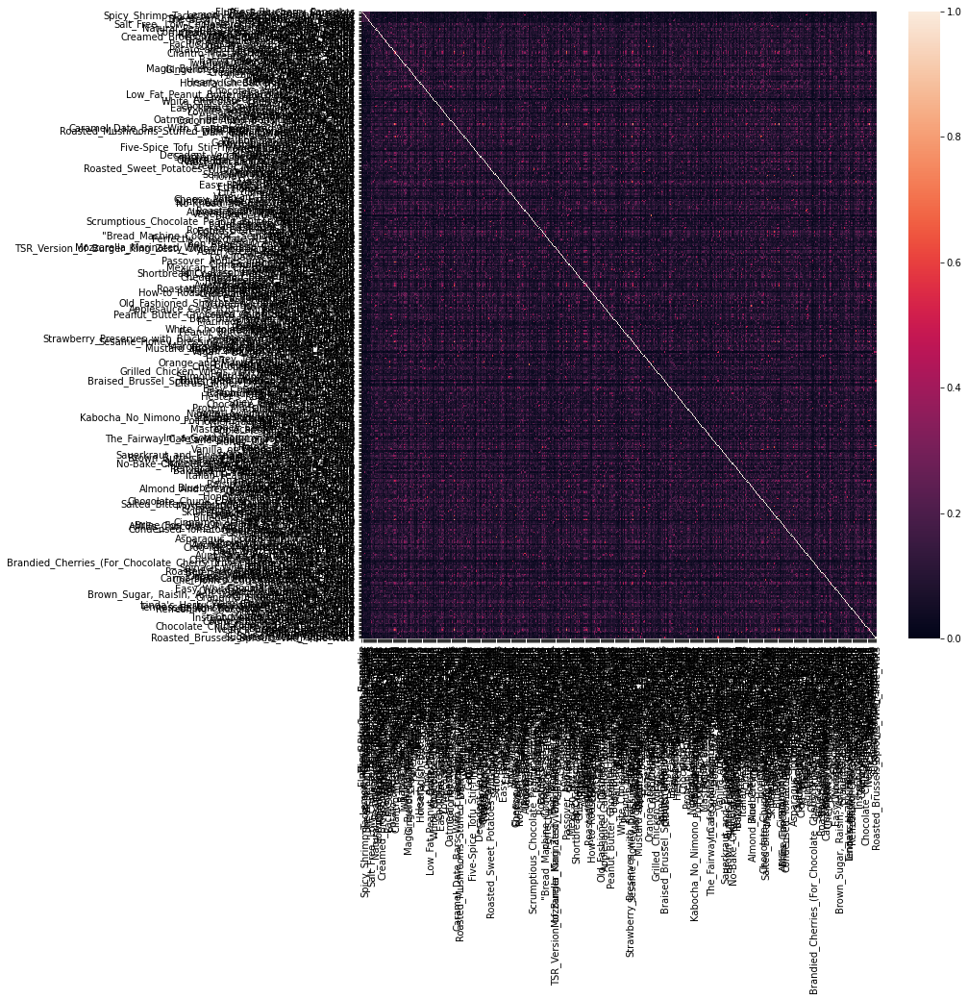

In [29]:
similarity  = cosine_similarity(df, df)
a4_dims = (12, 12)
fig, ax = pyplot.subplots(figsize=a4_dims)
sns.heatmap(ax=ax, data=similarity, xticklabels= recipe_name, yticklabels=recipe_name);

In [30]:
data=pd.read_csv(path_to_file)

### Process Documents
1. Process documents
2. Create doc2vec matrix
3. Plotting with TSNE

In [31]:
#process documents
recipe_name, final_processed_text, processed_text = process_corpus(data)
print(final_processed_text[0])

super thick fluffy blueberry pancakes mouth golden brown bursting blueberries breakfast ingredients scale tablespoons white vinegar flour tablespoons sugar teaspoon baking powder teaspoon baking teaspoon tablespoons melted butter fresh blueberries butter instructions vinegar minute making buttermilk whisk ingredients together whisk melted butter ingredients combined nonstick medium little smear butter essential giving yummy golden brown crust batter skillet spread flatlike pretty thick arrange blueberries little bubbles edges starting another minutes pancakes skyhigh fluffy cooked serve butter maple syrup honestly sometimes plain notes texture thick pancakes directed lighter slightly fluffy pancakes dairy almond another nondairy melted coconut place butter nutrition facts serves calories serving daily value total cholesterol sodium total carbohydrate dietary fiber sugars protein vitamin vitamin potassium phosphorus


In [32]:
doc2vec_df = run_doc2vec(final_processed_text, processed_text)
labels, tokens, word2vec_model = run_word2vec(processed_text)
print(len(tokens))

1345


### Plot word2vec TSNE

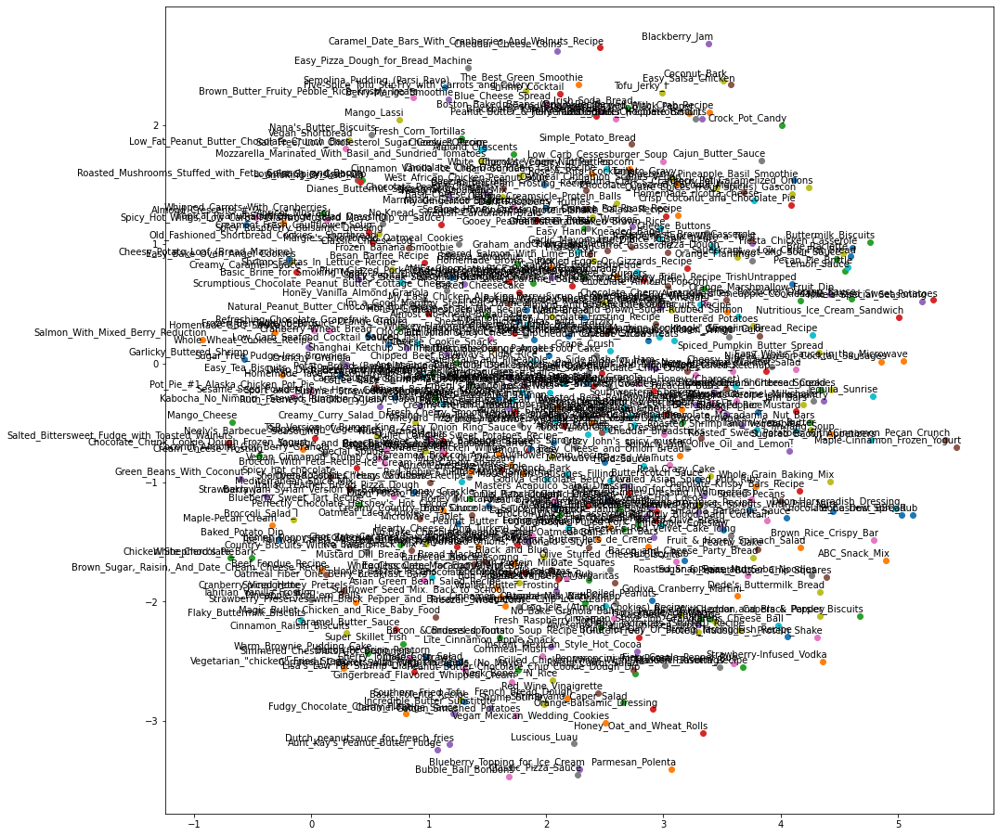

In [33]:
plot_doc2vec(doc2vec_df, recipe_name,50)

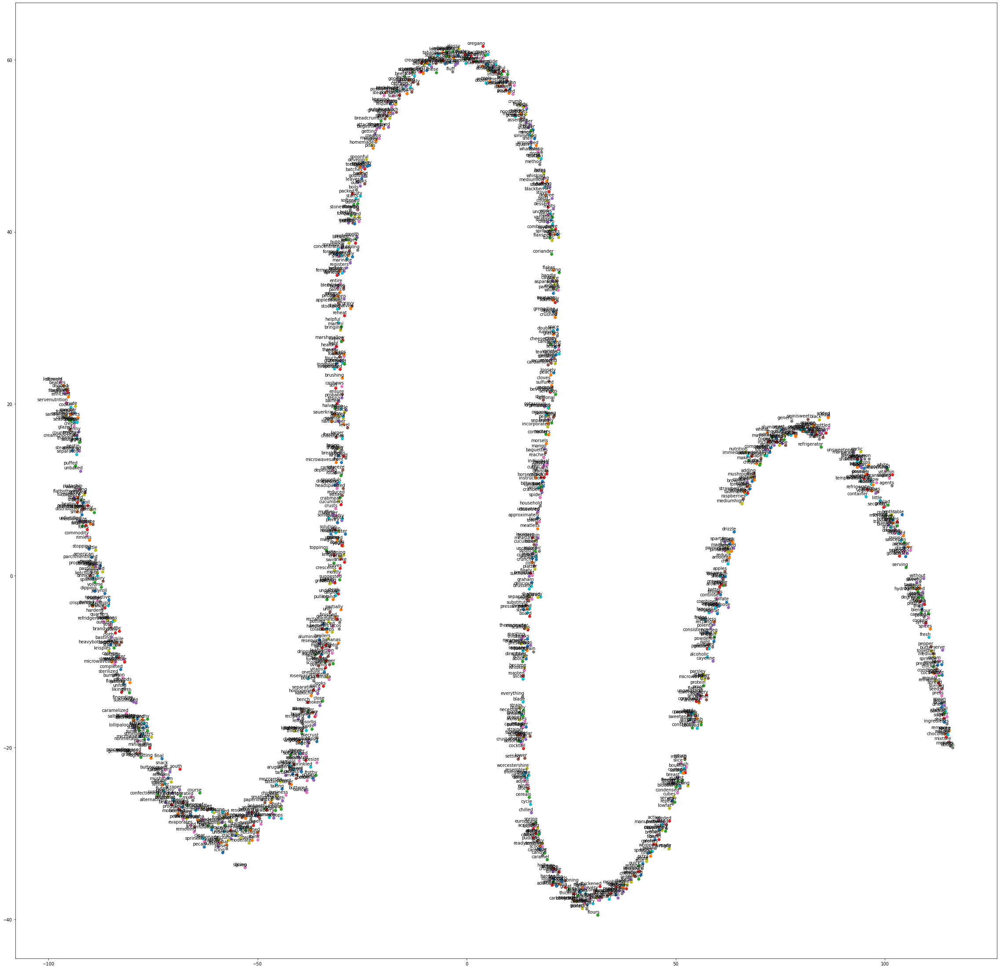

CPU times: user 1min 33s, sys: 1.74 s, total: 1min 34s
Wall time: 36.9 s


In [60]:
%%time
plot_word2vec(word2vec_model, labels, tokens,20)

## Knowledge Graph



In [37]:
!ls -l "/content/drive/My Drive/Colab_Notebooks/MSDS-453/Final_Project"

total 221242
-rw------- 1 root root    216479 Mar  1 22:22 kg_data_cleanup.csv
-rw------- 1 root root     15255 Mar  1 22:52 kg_data_cleanup_done.csv
-rw------- 1 root root       143 Mar  1 22:52 kg_data_cleanup.gsheet
-rw------- 1 root root    701048 Mar  2 16:43 Recipe_Book_final.csv
-rw------- 1 root root       143 Mar  8 22:07 Recipe_Book_final.gsheet
-rw------- 1 root root       143 Mar  1 05:51 Recipe_Book.gsheet
-rw------- 1 root root       143 Mar  2 16:33 Recipe_Book_v1.gsheet
-rw------- 1 root root   2920771 Mar  9 23:47 Recipe_Chatbot_Data_Analysis.ipynb
-rw------- 1 root root    158102 Mar  9 06:03 Recipe_Chatbot_Model_Development.ipynb
-rw------- 1 root root 222537053 Mar  1 01:34 recipes_with_nutritional_info.json


In [38]:
data.head(2)

,Doc_ID,Meal_ID,Ingredients_Directions
0,0,Fluffiest_Blueberry_Pancakes,Super thick and fluffy blueberry pancakes! Mel...
1,1,The_Best_Green_Smoothie,A healthy breakfast - The Best Green Smoothie\...


In [39]:
corpusJoined_orig = ' '.join([x for x in data['Ingredients_Directions']]).split('.')
corpusJoined_orig[:5]

['Super thick and fluffy blueberry pancakes! Melt in your mouth, golden brown, and bursting with blueberries for breakfast',
 '\nIngredients\nScale\n\n3/4 cup milk\n2 tablespoons white vinegar\n1 cup flour\n2 tablespoons sugar\n1 teaspoon baking powder\n1/2 teaspoon baking soda\n1/2 teaspoon salt\n1 egg\n2 tablespoons melted butter\n1+ cup fresh blueberries\nmore butter for the pan\n\nInstructions\n\nMix the milk and vinegar and let it sit for a minute or two (you’re making “buttermilk” here)',
 '\nWhisk the dry ingredients together',
 ' Whisk the egg, milk, and melted butter into the dry ingredients until just combined',
 '\nHeat a nonstick pan over medium heat']

In [40]:
data.head()
data.shape
data['Meal_ID'].unique()

,Doc_ID,Meal_ID,Ingredients_Directions
0,0,Fluffiest_Blueberry_Pancakes,Super thick and fluffy blueberry pancakes! Mel...
1,1,The_Best_Green_Smoothie,A healthy breakfast - The Best Green Smoothie\...
2,2,Lemon_Poppyseed_Zucchini_Bread,"Lemon Poppyseed Zucchini Bread with zucchini, ..."
3,3,Spicy_Shrimp_Tacos_with_Garlic_Cilantro_Lime_Slaw,The BEST Shrimp Tacos with Garlic Cilantro Lim...
4,4,Chipotle_Tahini_Bowls,Healthy and versatile bowls that come together...


(501, 3)

array(['Fluffiest_Blueberry_Pancakes', 'The_Best_Green_Smoothie',
       'Lemon_Poppyseed_Zucchini_Bread',
       'Spicy_Shrimp_Tacos_with_Garlic_Cilantro_Lime_Slaw',
       'Chipotle_Tahini_Bowls', 'Sheet_Pan_Chicken_Pitas_with_Tzatziki',
       'The_Best_Soft_Chocolate_Chip_Cookies', 'Raspberry_Crumble_Bars',
       'Best_Peach_Cobbler', 'Yogurt_Parfaits',
       'Salt_Free,_Low_Cholesterol_Sugar_Cookies_Recipe',
       'Honey_Sriracha_Chicken_Wings', 'Shrimp_and_Caper_Salad',
       'Natural_Peanut_Butter_Chocolate_Bon_Bons', 'Easy_Cheese_Sauce',
       'Easy_Chocolate_Frosting_Recipe',
       'Cornmeal_Crackers_with_Pumpkin_Seeds',
       'Chocolate-Orange_Angel_Food_Cake',
       'Rice_With_Lemon,_Capers_&_Parsley', "Cheryl's_Veggie-Nut_Patties",
       'Creamed_Broccoli_And_Cauliflower_Soup_Recipe',
       'Fudgy_Chocolate_Cherry_Float', "Aunt_Julie's_Pineapple_Cookies",
       'Broccoli_Chicken_Casserole_Recipe', 'Chicken_Diable',
       'Pacific_Wasabi_Sauce_for_Grilled_Tuna', 

### Function Entity Extraction

In [41]:
en_nlp = spacy.load('en')
import spacy
from nltk import Tree
def to_nltk_tree(node):
    if node.n_lefts + node.n_rights > 0:
        return Tree(node.orth_, [to_nltk_tree(child) for child in node.children])
    else:
        return node.orth_
def get_entities(sent):
  ## chunk 1
  ent1 = ""
  ent2 = ""
  prv_tok_dep = ""    # dependency tag of previous token in the sentence
  prv_tok_text = ""   # previous token in the sentence
  prefix = ""
  modifier = ""
  # https://stackoverflow.com/questions/36610179/how-to-get-the-dependency-tree-with-spacy
  doc = en_nlp(sent)
  # def to_nltk_tree(node):
  #     if node.n_lefts + node.n_rights > 0:
  #         return Tree(node.orth_, [to_nltk_tree(child) for child in node.children])
  #     else:
  #         return node.orth_
  def to_nltk_tree(node):
      if node.n_lefts + node.n_rights > 0:
          return Tree(node.dep_+ ":"+ node.orth_, [to_nltk_tree(child) for child in node.children])
      else:
          return node.dep_+ ":" + node.orth_
  print (sent)
  #[to_nltk_tree(sent.root).pretty_print() for sent in doc.sents]
  for sent_i in doc.sents:
      if ( type(to_nltk_tree(sent_i.root)) is str ):
          # no tree to print
          print ("Str only: ", sent_i)
      else:
          to_nltk_tree(sent_i.root).pretty_print()
  #############################################################
  for tok in nlp(sent):
    ## chunk 2
    # if token is a punctuation mark then move on to the next token
    if tok.dep_ != "punct":
      # check: token is a compound word or not
      if tok.dep_ == "compound":
        prefix = tok.text
        # if the previous word was also a 'compound' then add the current word to it
        if prv_tok_dep == "compound":
          prefix = prv_tok_text + " "+ tok.text
      # check: token is a modifier or not
      if tok.dep_.endswith("mod") == True:
        modifier = tok.text
        # if the previous word was also a 'compound' then add the current word to it
        if prv_tok_dep == "compound":
          modifier = prv_tok_text + " "+ tok.text
      ## chunk 3
      if tok.dep_.find("subj") == True:
        ent1 = modifier +" "+ prefix + " "+ tok.text
        prefix = ""
        modifier = ""
        prv_tok_dep = ""
        prv_tok_text = ""      
      ## chunk 4
      if tok.dep_.find("obj") == True:
        ent2 = modifier +" "+ prefix +" "+ tok.text
      ## chunk 5  
      # update variables
      prv_tok_dep = tok.dep_
      prv_tok_text = tok.text
  #############################################################
  return [ent1.strip(), ent2.strip()]

### Entity Pair Extraction from Corpus

In [42]:
%%time
entity_pairs = []

for i in tqdm(corpusJoined_orig):
  entity_pairs.append(get_entities(i))

  0%|          | 2/22080 [00:00<20:13, 18.19it/s]

Super thick and fluffy blueberry pancakes! Melt in your mouth, golden brown, and bursting with blueberries for breakfast
                         ROOT:pancakes                       
        _______________________|___________                   
       |            |                  amod:thick            
       |            |           ___________|___________       
compound:blueber punct:!  advmod:Super   cc:and   conj:fluffy
       ry                                                    

                              ROOT:Melt                         
                        __________|____________________          
                       |                         conj:bursting  
                       |                               |         
                    prep:in                        prep:with    
                       |                               |         
                   pobj:mouth                   pobj:blueberries
     __________________|__________            

  0%|          | 11/22080 [00:00<10:36, 34.66it/s]

 Arrange a few blueberries on top
    ROOT:Arrange                          
  _______|______________                   
 |               dobj:blueberries         
 |        ______________|____________      
 |   nummod:few                   prep:on 
 |       |                           |     
 :   quantmod:a                   pobj:top

 Cook until you see little bubbles on top and the edges starting to firm up
                                 ROOT:Cook                                                              
  ___________________________________|________________________________________                           
 |    |               advcl:see                                           conj:edges                    
 |    |         __________|______________________                     ________|___________               
 |    |        |          |                 dobj:bubbles             |               acl:starting       
 |    |        |          |           ___________|________

  0%|          | 21/22080 [00:00<09:16, 39.64it/s]



Nutrition Facts
Serves 2
Calories Per Serving: 509
% Daily Value
21% Total Fat 16
    ROOT:Facts                 
  ______|_____________          
 |             compound:Nutriti
 |                    on       
 |                    |         
 :                    :        
                               
                               

ROOT:Serves
     |      
  nummod:2 
     |      
     :     
           

        ROOT:Calories          
    __________|___________      
   |       prep:Per   appos:509
   |          |           |     
punct::  pobj:Serving     :    
                               

                          ROOT:Value                                             
     _________________________|______________________                             
    |            |            |                   appos:%                        
    |            |            |           ___________|____________                
    |            |            |          |               

  0%|          | 31/22080 [00:00<09:52, 37.20it/s]

6mg
45% Phosphorus 558
                    ROOT:Phosphorus                   
     ______________________|___________                
    |                               nsubj:mg          
    |          ________________________|_________      
    |         |                        |      appos:% 
    |         |                        |         |     
nummod:558 nummod:6                    :     nummod:45
                                                      

2mg" A healthy breakfast - The Best Green Smoothie
 
4
                                 ROOT:mg                                                             
    ________________________________|______________                                                   
   |        |                               appos:breakfast                                          
   |        |        ______________________________|______________________                            
   |        |       |      |        |              |                

  0%|          | 40/22080 [00:01<09:33, 38.44it/s]

 Coconut water is also nice although it has a bit more natural sugar
                                           ROOT:is                                                  
      ________________________________________|___________                                           
     |          |             |                       advcl:has                                     
     |          |             |                ___________|______________________                    
     |          |             |               |           |                  dobj:sugar             
     |          |             |               |           |           ___________|___________        
     |          |        nsubj:water          |           |          |                   amod:more  
     |          |             |               |           |          |                       |       
     |          |      compound:Coconut       |           |          |                  npadvmod:bit
     |          | 

  0%|          | 50/22080 [00:01<08:51, 41.43it/s]

 Drink this right after you blend it
               ROOT:Drink                               
  _________________|____________                         
 |      |                  advcl:blend                  
 |      |           ____________|___________________     
 :  dobj:this advmod:right  mark:after nsubj:you dobj:it

 You can keep it for later, but be sure shake it up
                               ROOT:keep                                           
    _______________________________|__________________________________              
   |       |       |      |        |          |                    conj:be         
   |       |       |      |        |          |                       |             
   |       |       |      |    nsubj:You   prep:for              advcl:shake       
   |       |       |      |        |          |            ___________|________     
aux:can dobj:it punct:, cc:but     :     pcomp:later advmod:sure   dobj:it   prt:up

 I don’t recommend drinking it 

  0%|          | 55/22080 [00:01<08:34, 42.83it/s]

8µg
94% Vitamin C 84
                ROOT:µg                                    
     ______________|____________                            
    |       |               npadvmod:%                     
    |       |       ____________|____________               
    |       |      |                      appos:C          
    |       |      |             ____________|________      
compound:8  :  nummod:94 compound:Vitamin         nummod:84
                                                           

5mg
13% Iron 2
         ROOT:mg                                
    ________|_________________                   
   |        |              appos:%              
   |        |         ________|__________        
   |        |        |             npadvmod:Iron
   |        |        |                   |       
nummod:5    :    nummod:13            nummod:2  
                                                

3mg
17% Potassium 784
         ROOT:mg                                      
    ___

  0%|          | 64/22080 [00:01<09:40, 37.91it/s]

 Transfer the mixture to a fine-mesh strainer set over the mixing bowl
                       ROOT:Transfer                                                          
  ___________________________|___________________________                                      
 |       |                                            prep:to                                 
 |       |                                               |                                     
 |       |                                         pobj:strainer                              
 |       |          _____________________________________|___________________                  
 |       |         |                       |                              acl:set             
 |       |         |                       |                                 |                 
 |       |         |                       |                             prep:over            
 |       |         |                       |                          

  0%|          | 72/22080 [00:01<09:42, 37.77it/s]

 Bake on the middle rack of the oven for about 1 hour and 10 minutes
                        ROOT:Bake                                 
  __________________________|_________________                     
 |            prep:on                         |                   
 |               |                            |                    
 |           pobj:rack                     prep:for               
 |      _________|__________                  |                    
 |     |         |       prep:of          pobj:hour               
 |     |         |          |        _________|____________        
 |     |         |      pobj:oven   |      nummod:1   conj:minutes
 |     |         |          |       |         |            |       
 :  det:the amod:middle  det:the  cc:and advmod:about  nummod:10  

 The outer crust of the bread will be firm to the touch and on the darker side of golden brown (see FAQs)
                                                   ROOT:be                        

  0%|          | 81/22080 [00:02<09:13, 39.75it/s]

5mg
12% Sodium 272
         ROOT:mg                                   
    ________|____________________                   
   |        |               appos:Sodium           
   |        |         ___________|___________       
   |        |        |                   compound:%
   |        |        |                       |      
nummod:5    :    nummod:272              nummod:12 
                                                   

8mg
15% Total Carbohydrate 41
                         ROOT:Carbohydrat                       
                                e                               
       _________________________|_________________________       
      |            |                      nmod:mg     compound:%
      |            |             ____________|_____       |      
compound:Total nummod:41     nummod:8              :  nummod:15 
                                                                

8g
5% Dietary Fiber 1
              ROOT:g                               

  0%|          | 91/22080 [00:02<10:18, 35.56it/s]

7mg" The BEST Shrimp Tacos with Garlic Cilantro Lime Slaw – ready in about 30 minutes and loaded with flavor and texture
ROOT:mg 
   |     
nummod:7

                                                        ROOT:Tacos                                                                                
    ________________________________________________________|______________________________________________                                        
   |       |          |              |           |                      |                              amod:ready                                 
   |       |          |              |           |                      |                         _________|___________________                    
   |       |          |              |           |                  prep:with                    |      prep:in           conj:loaded             
   |       |          |              |           |                      |                        |         |     

  0%|          | 95/22080 [00:02<10:10, 36.01it/s]

 Toss the shrimp in a small bowl with the spice mix to get it coated
                                  ROOT:Toss                                                                
  ____________________________________|__________________________________________________                   
 |          dobj:shrimp                                  |                               |                 
 |      _________|__________                             |                               |                  
 |     |                 prep:in                     prep:with                       advcl:get             
 |     |                    |                            |                       ________|__________        
 |     |                pobj:bowl                     pobj:mix                  |              ccomp:coated
 |     |          __________|_________           ________|___________           |                   |       
 :  det:the    det:a              amod:small det:the           

  0%|          | 105/22080 [00:02<09:04, 40.38it/s]

5g
19% Dietary Fiber 5
               ROOT:g                                       
    _____________|____________                               
   |      |                appos:%                          
   |      |       ____________|______________                
   |      |      |                      appos:Fiber         
   |      |      |             ______________|_________      
nummod:5  :  nummod:19 compound:Dietary             nummod:5
                                                            

3g
Sugars 3
         ROOT:g    
    _______|_____   
nummod:3         : 
                   

ROOT:Sugars
     |      
  nummod:3 

4g
56% Protein 27
         ROOT:g                                
    _______|_________________                   
   |       |              appos:%              
   |       |         ________|__________        
   |       |        |             appos:Protein
   |       |        |                   |       
nummod:4   :    nummod:56           nummod:2

  1%|          | 115/22080 [00:03<09:23, 38.99it/s]


Ingredients
Scale

Chipotle Tahini

1/2 cup olive oil
1/4 cup water
1/4 cup tahini
1–2 chipotles in adobo sauce 
1 small clove of garlic 
juice of 1 orange (about 1/4 cup)
1/2 teaspoon salt

Build the Bowls:

Roasted sweet potatoes (see notes for my favorite method!)
Soft-boiled eggs (see notes for my favorite method!)
Kale
Quinoa
Avocado
Anything else you want!

Instructions

Pulse all sauce ingredients in a food processor until smooth
    ROOT:Ingredients            
  _________|______________       
 |         |         appos:Scale
 |         |              |      
 :         :              :     
                                
                                

Str only:  Chipotle
               ROOT:oil                       
       ___________|_____________________       
      |           |     nmod:Tahini  nmod:cup 
      |           |          |          |      
compound:olive    :          :      nummod:1/2
                                              
                    

  1%|          | 124/22080 [00:03<09:46, 37.42it/s]

 Toss with 1 tablespoon cornstarch to coat (helps them stay crispy), and then toss with 1 tablespoon olive oil and 1/2 teaspoon salt
                                                                ROOT:Toss                                                                                                             
  __________________________________________________________________|__________________________________                                                                                
 |                  |                                                                           parataxis:helps                                                                       
 |                  |                       ___________________________________________________________|__________________________                                                     
 |                  |                      |       |       |        |                    |                                    conj:to

  1%|          | 134/22080 [00:03<09:18, 39.31it/s]

1mg
13% Total Carbohydrate 34
                ROOT:mg                                
    _______________|_______________                     
   |      |                 appos:Carbohydra           
   |      |                        te                  
   |      |         _______________|_____________       
   |      |        |               |         compound:%
   |      |        |               |             |      
nummod:1  :  compound:Total    nummod:34     nummod:13 
                                                       

6g
23% Dietary Fiber 6
               ROOT:g                                       
    _____________|____________                               
   |      |                appos:%                          
   |      |       ____________|______________                
   |      |      |                      appos:Fiber         
   |      |      |             ______________|_________      
nummod:6  :  nummod:23 compound:Dietary             nummod:6
         

  1%|          | 138/22080 [00:03<10:20, 35.34it/s]

 boneless skinless chicken breasts, cut into very thin strips
3 cloves garlic, grated
1 tablespoon olive oil
1–2 tablespoons lemon juice
1 teaspoon each of cumin, smoked paprika, and kosher salt
1/2 teaspoon curry powder
black pepper to taste

Peppers:

2–3 bell peppers, sliced
olive oil and salt

Tzatziki:

3/4 cup full-fat plain Greek yogurt
1/2 cup grated cucumber (about one half of a large cucumber)
1–2 tablespoons lemon juice
1–2 tablespoons olive oil
1 small clove garlic, grated
1 teaspoon dried dill
1/2 teaspoon kosher salt
pepper to taste

Other:

diced cucumbers
diced red onion
kalamata olives
feta cheese
some kind of flatbread (pita, naan, socca)

Instructions

Preheat the oven to 425 degrees
                             ROOT:cut                                              
    ____________________________|________________________________                   
   |                            |                            prep:into             
   |                            |  

  1%|          | 146/22080 [00:03<10:52, 33.59it/s]

 So much salty-briney-crunchy goodness
                    ROOT:goodness                      
                          |                             
                   compound:crunchy                    
     _____________________|______________________       
    |         |           |            |    advmod:much
    |         |           |            |         |      
    |         |           |            |     advmod:So 
    |         |           |            |         |      
amod:salty punct:- compound:briney  punct:-      :     



Notes

Store bought tzatziki also works great in this recipe to save you a few steps!
Freezer Meal Version

Toss Together:
1 lb
    ROOT:Notes    
  ______|_______   
 :              : 
                  
                  

                                                    ROOT:bought                                                    
      ___________________________________________________|___________________________________________________

  1%|          | 155/22080 [00:04<09:35, 38.10it/s]

3mg
3% Total Carbohydrate 9
                ROOT:mg                                
    _______________|_______________                     
   |      |                 appos:Carbohydra           
   |      |                        te                  
   |      |         _______________|_____________       
   |      |        |               |         compound:%
   |      |        |               |             |      
nummod:3  :  compound:Total     nummod:9      nummod:3 
                                                       

4g
7% Dietary Fiber 1
              ROOT:g                                       
    ____________|____________                               
   |      |               appos:%                          
   |      |      ____________|______________                
   |      |     |                      appos:Fiber         
   |      |     |             ______________|_________      
nummod:4  :  nummod:7 compound:Dietary             nummod:1
                   

  1%|          | 163/22080 [00:04<10:22, 35.23it/s]

 Just ultra thick, soft, classic chocolate chip cookies!
Ingredients
Units
Scale

8 tablespoons of salted butter
1/2 cup white sugar (I like to use raw cane sugar with a coarser texture)
1/4 cup packed light brown sugar
1 teaspoon vanilla
1 egg
1 1/2 cups all purpose flour (more as needed – see video)
1/2 teaspoon baking soda
1/4 teaspoon salt (but I always add a little extra)
3/4 cup chocolate chips (I use a combination of chocolate chips and chocolate chunks)

Instructions

Preheat the oven to 350 degrees
                                ROOT:ultra                                                             
      ______________________________|______________________________________________________________     
     |                         dobj:cookies                                                        |   
     |           ___________________|__________________________________                            |    
advmod:Just     |         |         |          |                 comp

  1%|          | 172/22080 [00:04<09:42, 37.60it/s]

 Use your hands to press the crumbles together into a dough
               ROOT:Use                                         
  ________________|____________                                  
 |      |                 xcomp:press                           
 |      |          ____________|__________________________       
 |      |         |            |              |       prep:into 
 |      |         |            |              |           |      
 |  dobj:hands    |            |        dobj:crumbles pobj:dough
 |      |         |            |              |           |      
 :  poss:your   aux:to  advmod:together    det:the      det:a   

 It should form one large ball that is easy to handle (right at the stage between “wet” dough and “dry” dough)
           ROOT:form                                                                                                                                                         
     __________|_____________________________                    

  1%|          | 181/22080 [00:04<09:15, 39.45it/s]

 They’ll be pale and puffy
         ROOT:be                               
    ________|_________________                  
   |    nsubj:They        acomp:pale           
   |        |         ________|__________       
aux:’ll     :      cc:and            conj:puffy


Let them cool on the pan for a good 30 minutes or so (I mean, okay, eat four or five but then let the rest of them cool)
     ROOT:Let                                                      
  ______|___________________                                        
 |                      ccomp:cool                                 
 |       ___________________|___________                            
 |      |         |                  prep:for                      
 |      |         |                     |                           
 |      |      prep:on             pobj:minutes                    
 |      |         |          ___________|_____________________      
 |      |      pobj:pan     |           |           |     nu

  1%|          | 186/22080 [00:04<08:39, 42.12it/s]

4g
5% Dietary Fiber 1
              ROOT:g                                       
    ____________|____________                               
   |      |               appos:%                          
   |      |      ____________|______________                
   |      |     |                      appos:Fiber         
   |      |     |             ______________|_________      
nummod:4  :  nummod:5 compound:Dietary             nummod:1
                                                           

4g
Sugars 20
         ROOT:g    
    _______|_____   
nummod:4         : 
                   

ROOT:Sugars
     |      
 nummod:20 

5g
6% Protein 3
         ROOT:g                                  
    _______|________________                      
   |       |             appos:%                 
   |       |        ________|___________          
   |       |       |             npadvmod:Protein
   |       |       |                    |         
nummod:5   :    nummod:6             nummo

  1%|          | 195/22080 [00:05<09:57, 36.65it/s]

 Place raspberries in a large colander
            ROOT:raspberries                         
      _____________|_______________                   
     |                          prep:in              
     |                             |                  
nsubj:Place                  pobj:colander           
     |              _______________|___________       
     :           det:a                     amod:large

 Run warm water over them for a minute, and then let the liquid drain out for about an hour until softened and thoroughly drained (see notes)
                                                      ROOT:Run                                                                               
  _______________________________________________________|_________                                                                           
 |     |      |        |          |          |                  conj:let                                                                     
 |     |  

  1%|          | 205/22080 [00:05<09:35, 37.99it/s]


Finish: Remove from oven
    ROOT:Finish             
  _______|___________        
 |       |      appos:Remove
 |       |           |       
 |       |       prep:from  
 |       |           |       
 :    punct::    pobj:oven  
                            

 They will need a little time to set up into “bar” formation, so chill them for a few hours to get them really solid
                                                                             ROOT:chill                                                                                                       
    _____________________________________________________________________________|____________________________________________________________________________                                 
   |        |         |                                           ccomp:need                                                       |                          |                               
   |        |         |         _______________

  1%|          | 213/22080 [00:05<09:49, 37.09it/s]

 And I found my fresh raspberry version to be very, very juicy
                                ROOT:found                                                      
    ________________________________|______________                                              
   |      |                                     ccomp:be                                        
   |      |       _________________________________|__________________________                   
   |    cc:And   |            nsubj:version                              acomp:juicy            
   |      |      |        __________|______________                ___________|___________       
nsubj:I   :    aux:to poss:my   amod:fresh  compound:raspber advmod:very   punct:,   advmod:very
                                                   ry                                           

 Like, kind of hard to eat
    ROOT:Like                                
  ______|_____________________                
 |      |                 amod:hard  

  1%|          | 223/22080 [00:05<09:22, 38.84it/s]

7mg
8% Sodium 192
         ROOT:mg                                   
    ________|____________________                   
   |        |               appos:Sodium           
   |        |         ___________|___________       
   |        |        |                   compound:%
   |        |        |                       |      
nummod:7    :    nummod:192               nummod:8 
                                                   

1mg
19% Total Carbohydrate 51
                ROOT:mg                                
    _______________|_______________                     
   |      |                 appos:Carbohydra           
   |      |                        te                  
   |      |         _______________|_____________       
   |      |        |               |         compound:%
   |      |        |               |             |      
nummod:1  :  compound:Total    nummod:51     nummod:19 
                                                       

3g
14% Dietary Fiber 3
 

  1%|          | 232/22080 [00:06<09:30, 38.30it/s]


Ingredients
Scale

Peach Filling
5–6 large fresh yellow peaches, sliced
1/4 cup sugar

Cobbler Topping

1/2 cup salted butter, melted
3/4 cup sugar
1 teaspoon vanilla
1 cup flour
1 teaspoon baking powder
a pinch of salt
1/4 cup turbinado sugar (optional, but really nice)
whipped cream or vanilla ice cream for serving

Instructions

Preheat the oven to 350 degrees
    ROOT:Ingredients           
  _________|_____________       
 |         |         dobj:Scale
 |         |             |      
 :         :             :     
                               
                               

               ROOT:Filling    
       _____________|________   
compound:Peach               : 
                               

                           ROOT:sliced                                                 
  ______________________________|___________________________________                    
 |                              |                               dobj:sugar             
 |         

  1%|          | 236/22080 [00:06<09:33, 38.10it/s]


Sprinkle the top with turbinado sugar
    ROOT:Sprinkle                 
  ________|______________          
 |        |          prep:with    
 |        |              |         
 |     dobj:top      pobj:sugar   
 |        |              |         
 :     det:the    compound:turbina
                         do       

 Bake another 10 minutes and then finish with a few minutes under the broiler (475-ish) for a few minutes to get it golden brown and slightly crunchy on top
                                                                                                         ROOT:Bake                                                                                                                          
  ___________________________________________________________________________________________________________|____________________                                                                                                           
 |    |                       |              

  1%|          | 245/22080 [00:06<09:14, 39.39it/s]

5mg
6% Sodium 148
         ROOT:mg                                   
    ________|____________________                   
   |        |               appos:Sodium           
   |        |         ___________|___________       
   |        |        |                   compound:%
   |        |        |                       |      
nummod:5    :    nummod:148               nummod:6 
                                                   

6mg
17% Total Carbohydrate 45
                ROOT:mg                                
    _______________|_______________                     
   |      |                 appos:Carbohydra           
   |      |                        te                  
   |      |         _______________|_____________       
   |      |        |               |         compound:%
   |      |        |               |             |      
nummod:6  :  compound:Total    nummod:45     nummod:17 
                                                       

9g
6% Dietary Fiber 1
  

  1%|          | 255/22080 [00:06<08:42, 41.77it/s]

7mg  'yogurt, greek, plain, nonfat',  'strawberries, raw',  'cereals ready-to-eat, granola, homemade' 'Layer all ingredients in a serving dish
                                                                                                ROOT:strawberrie                                                                                                                                  
                                                                                                       s                                                                                                                                          
    ___________________________________________________________________________________________________|___________________________________________________________________________________________________________________________                
   |       |         |                                                           |                                             

  1%|          | 265/22080 [00:06<08:18, 43.74it/s]

02, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
punct:02 punct:, punct:'  punct:' punct:: punct:0

023, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:023  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 7
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:7 punct:,

43, Nutrition fact: 'fat': 7
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod

  1%|          | 275/22080 [00:07<08:42, 41.70it/s]

                                                                                                                                                                                                                                                                                         ROOT:04                                                                                                                                                                                                                                                                                                                                                            
  __________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________|______________________________                                                

  1%|▏         | 286/22080 [00:07<08:03, 45.05it/s]

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

0, 'nrg': 384
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:384

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:,

  1%|▏         | 297/22080 [00:07<07:40, 47.34it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 2
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:2
   |       |           |             |        |       |                 |      
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                       on                                                     

7625, 'nrg': 94
                      ROOT:nrg                            
       __________________|_______________

  1%|▏         | 307/22080 [00:07<07:40, 47.33it/s]

0012499999999990002, 'sod': 0
                ROOT:00124999999                  
                    99990002                      
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

041666666666666005, 'sug': 0
                ROOT:04166666666                  
                    6666005                       
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

43395833333333306, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        

  1%|▏         | 317/22080 [00:08<07:42, 47.09it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1464
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1464

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 4
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    a

  1%|▏         | 322/22080 [00:08<09:06, 39.79it/s]

19  'chicken, broilers or fryers, wing, meat and skin, raw',  'salt, table',  'spices, pepper, black',  'oil, olive, salad or cooking',  'butter, without salt',  'sauce, hot chile, sriracha',  'honey',  'rice, white, long-grain, regular, unenriched, cooked without salt',  'soy sauce made from soy (tamari)',  'sauce, hoisin, ready-to-serve',  'salt, table',  'spices, coriander seed' 'Preheat oven to 400 degrees F
                                                                                                                                                                                                                                                                                                                                                                                                                                ROOT:cooked                                                                                                                                                             

  2%|▏         | 332/22080 [00:08<08:48, 41.11it/s]

',  'Transfer the wings from the baking sheet into the pan with the sauce
                        ROOT:Transfer                                                        
    __________________________|________________________________________________________       
   |       |       |          |               prep:from                  prep:into prep:with 
   |       |       |          |                   |                          |         |      
   |       |    punct:,   dobj:wings          pobj:sheet                  pobj:pan pobj:sauce
   |       |       |          |           ________|_____________             |         |      
punct:' punct:'    :       det:the    det:the            compound:baking  det:the   det:the  

',  'Toss until coated
        ROOT:coated                      
    _________|_____________               
   |         |          punct:,          
   |         |        _____|________      
   |         |       |          intj:Toss
   |         |       |       

  2%|▏         | 342/22080 [00:08<08:11, 44.26it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                            

  2%|▏         | 352/22080 [00:08<08:01, 45.11it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

005, Nutrition fact: 'fat': 13
Str only:  005
                                 ROOT:fact                          
    _________________________________|________________               
   |           |            |        |             amod:fat         
   |           |            |        |         _______|________      
punct:, compound:Nutriti punct::  punct:'  punct:' punct::  appos:13
               on                                                   

5, 'nrg': 119
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |             meta:5        
   |       |        |         ______|_______     
punct:' punct:: appos:119 punct:,        punct:'

0, 'pro': 0
         ROOT:0                         
  

  2%|▏         | 362/22080 [00:09<07:47, 46.47it/s]

36, 'sat': 21
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:36 punct:, punct:'  punct:' punct:: dep:21

506999999999998, 'sod': 6
        ROOT:50699999999                          
              9998                                
    ___________|______________________________     
   |                     appos:sod         appos:6
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

03, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat   

  2%|▏         | 373/22080 [00:09<07:37, 47.44it/s]

0, 'nrg': 128
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:128

875, 'pro': 0
                ROOT:875                        
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

1275, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:1275 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:1
   |        ________|________        |    
punct:, punct:'           punct:' punct::

75, 'sug': 34
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:75        
   |       |       |         ________|________     
punct:' punct:: appos:34 punct:,         

  2%|▏         | 383/22080 [00:09<07:32, 47.99it/s]

125, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:125
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

005, Nutrition fact: 'fat': 0
Str only:  005
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:, compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

006666666666666, 'nrg': 3
                ROOT:00666666666                  
                      6666                        
    ___________________|_____________              
   |       |                     appos:nrg        
   |       |            ____

  2%|▏         | 394/22080 [00:09<07:21, 49.11it/s]

176666666666666, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:1766666 punct:, punct:'  punct:' punct:: punct:0
    66666666                                             

030333333333333004, 'sod': 86
                 ROOT:03033333333                  
                     3333004                       
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:86     punct:'       punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

4533333333333331, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        _______________________________

  2%|▏         | 404/22080 [00:10<08:35, 42.06it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

32, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:32 punct:, punct:'  punct:' punct:: punct:0

108, 'sod': 6
               ROOT:108                  
    ______________|_________              
   |      |             appos:sod        
   |      |        _________|________     
punct:, intj:6 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'crustaceans, shrimp, raw (not previously frozen)',  'onions, spring or scallions (includes tops and bulb), raw',  'celery, raw',  'capers, canned',  'olives, ri

  2%|▏         | 409/22080 [00:10<08:29, 42.55it/s]

6266384, 'nrg': 771
          ROOT:6266384                          
     __________|___________                      
    |                  appos:nrg                
    |           ___________|________________     
appos:771   punct:,     punct:'  punct:' punct::

1064, 'pro': 182
        ROOT:1064                   
    ________|__________________      
   |        |     intj:pro appos:182
   |        |        |         |     
punct:,  punct:'  punct:'   punct:: 

343984, 'sat': 0
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:343984 punct:, punct:'  punct:' punct:: punct:0

91625584, 'sod': 1079
                   ROOT:91625584                  
    _____________________|___________              
   |        |                    appos:sod        
   |        |             ___________|________     
punct:, appos:1079    punct:'     punct:'  punct::

5489599999999, 'sug': 0
                ROOT:54895999999 

  2%|▏         | 419/22080 [00:10<08:03, 44.77it/s]

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

7475, Nutrition fact: 'fat': 0
                                       ROOT:fact                                         
       ____________________________________|________________________________              
      |          |           |             |        |       |            amod:fat        
      |          |           |             |        |       |        _______|________     
npadvmod:7475 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                             on                                                          

255, 'nrg': 24
                ROOT:255                   
    _______________|__________________      
   |       |       |        |     appos:nrg
   |       |       |        |         |     
punct:, punct

  2%|▏         | 435/22080 [00:10<07:36, 47.46it/s]

06, 'sod': 606
                ROOT:06                  
    _______________|________              
   |                    appos:sod        
   |        ________________|________     
punct:, punct:'          punct:'  punct::

Str only:  606
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

12, Nutrition fact: 'fat': 14
                                ROOT:fact                         
   _________________________________|_________________________     
  |       |           |             |        |    amod:fat  dep:14
  |       |           |             |        |       |        |    
dep:12 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                      on                                          

4, 'nrg': 160
                 ROOT:nrg                       
    ________________|_______________   

  2%|▏         | 445/22080 [00:10<07:40, 46.98it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 14
                ROOT:sat                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:14

912, 'sod': 0
                ROOT:912                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 123
                                 ROOT:fact                           
    _________________________

  2%|▏         | 455/22080 [00:11<07:36, 47.34it/s]

96, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:96 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

010624999999999999, 'nrg': 1
                ROOT:01062499999                 
                    9999999                      
    ___________________|____________              
   |       |                     conj:nrg        
   |       |            ____________|________     
punct:, appos:1     punct:'      punct:'  punct::

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
  

  2%|▏         | 460/22080 [00:11<08:16, 43.57it/s]

000255208333333, 'sod': 0
                ROOT:00025520833                  
                      3333                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

005208333333333, 'sug': 0
                ROOT:00520833333                  
                      3333                        
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

016015625000000002  'cocoa, dry powder, unsweetened',  'honey',  'peanut butter, smooth style, without salt' 'Measure out the cocoa powder into a mixing bowl
                                                                                                                 ROOT:cocoa                                                 

  2%|▏         | 470/22080 [00:11<08:08, 44.19it/s]

'Nutrition fact: 'fat': 141
                         ROOT:fact                                  
    _________________________|_________________________              
   |           |             |        |            appos:141        
   |           |             |        |                |             
   |           |             |        |             amod:fat        
   |           |             |        |        ________|________     
punct:' compound:Nutriti  punct::  punct:' punct:'           punct::
               on                                                   

35999999999999, 'nrg': 2352
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:3599999 punct:, punct:'  punct:' punct:: npadvmod:2352
    9999999                                                    

0, 'pro': 202
                 ROOT:0                 
            _______|_______________      
        intj:pro                i

  2%|▏         | 480/22080 [00:11<08:01, 44.83it/s]

0, 'sod': 168
                ROOT:sod                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:168

0, 'sug': 3340
                ROOT:sug                   
    _______________|___________________     
   |       |       |         |       meta:0
   |       |       |         |         |    
punct:' punct:' punct::  appos:3340 punct:,

68, Nutrition fact: 'fat': 131
                                ROOT:fact                                      
   _________________________________|________________________                   
  |       |           |             |        |            amod:fat             
  |       |           |             |        |        _______|__________        
  |       |           |             |        |       |             npadvmod:131
  |       |           |             |        |       |                  |       
dep:68 punct:, compound:Nutriti  punct::  punct:' punct:'            punct::   

  2%|▏         | 490/22080 [00:11<08:13, 43.79it/s]

',  'Tear cheese into small pieces and add to pan
                          ROOT:cheese                              
    ___________________________|______________________________      
   |       |        |          |         |     prep:into   conj:add
   |       |        |          |         |         |          |     
   |       |        |          |      punct:, pobj:pieces xcomp:pan
   |       |        |          |         |         |          |     
punct:' punct:' amod:Tear    cc:and      :     amod:small   aux:to 

',  'Heat over medium-low to medium heat until cheese is melted and mixture is smooth
                                                       ROOT:Heat                                                                                    
    _______________________________________________________|_______________________________________                                                  
   |       |       |                prep:over           prep:to                      

  2%|▏         | 501/22080 [00:12<07:46, 46.28it/s]

0, 'pro': 106
                ROOT:106                
    _______________|________             
   |       |             acl:pro        
   |       |        ________|_______     
punct:0 punct:: punct:,  punct:' punct:'

86000000000001, 'sat': 20
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:8600000 punct:, punct:'  punct:' punct:: dep:20
    0000001                                             

085, 'sod': 1391
                  ROOT:085                  
    _________________|_________              
   |        |              appos:sod        
   |        |         _________|________     
punct:, intj:1391 punct:'   punct:'  punct::

0, 'sug': 164
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:164 punct:,

97, Nutrition fact: 'fat': 0
                

  2%|▏         | 511/22080 [00:12<08:16, 43.44it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0029760000000000003, 'nrg': 0
                         ROOT:nrg                        
        ____________________|________________________     
nummod:002976000 punct:, punct:'  punct:' punct:: punct:0
   0000000003                                            

057600000000000005, 'pro': 0
                ROOT:05760000000                  
                    0000005                       
    ___________________|_____________________      
   |       |      

  2%|▏         | 516/22080 [00:12<08:07, 44.20it/s]

',  'Makes 2 c
        ROOT:Makes                 
    ________|_________________      
   |        |      punct:,  dobj:c 
   |        |         |       |     
punct:'  punct:'      :    nummod:2

 frosting
ROOT:frosting
      |       
      :      

'Nutrition fact: 'fat': 22
                         ROOT:fact                          
    _________________________|_________________________      
   |           |             |        |    amod:fat appos:22
   |           |             |        |       |        |     
punct:' compound:Nutriti  punct::  punct:' punct:'  punct:: 
               on                                           

682434949999998, 'nrg': 397
                         ROOT:nrg                          
        ____________________|_________________________      
npadvmod:6824349 punct:, punct:'  punct:' punct:: appos:397
    49999998                                               

17649499999993, 'pro': 5
        ROOT:17649499999                 
              9

  2%|▏         | 531/22080 [00:12<07:52, 45.57it/s]

39011999999997, 'pro': 30
                ROOT:39011999999                  
                      997                         
    ___________________|_____________________      
   |       |           |            |     amod:pro
   |       |           |            |        |     
punct:, punct:'     punct::      appos:30 punct:' 

404838749999996, 'sat': 13
                         ROOT:sat                            
        ____________________|__________________________       
npadvmod:4048387 punct:, punct:'  punct:' punct:: npadvmod:13
    49999996                                                 

956458849999999, 'sod': 1170
                   ROOT:95645884999                  
                         9999                        
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:1170     punct:'       punct:'  punct::

2673599999998, 'sug': 0
        

  2%|▏         | 541/22080 [00:13<07:40, 46.74it/s]

935, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
dep:935 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 3072
                ROOT:nrg                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:3072

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        


  2%|▏         | 546/22080 [00:13<08:47, 40.84it/s]

0, 'sod': 1162
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1162

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0  'cornmeal, degermed, unenriched, yellow',  'wheat flour, white, all-purpose, unenriched',  'seeds, pumpkin and squash seeds, whole, roasted, without salt',  'salt, table',  'sugars, granulated',  'spices, pepper, red or cayenne',  'butter, without salt',  'milk, fluid, 1% fat, without added vitamin a and vitamin d' 'In a large skillet, stir the cornmeal over moderate heat, shaking the pan occasionally, until lightly toasted, about 2 minutes
                                                                                                                                                                                                              

  3%|▎         | 556/22080 [00:13<08:52, 40.42it/s]

',  'Cover the dough and refrigerate until chilled and firm, about 1 hour
                               ROOT:Cover                                                                                  
    _______________________________|___________________________________________                                             
   |       |      |       |        |                                    conj:refrigerate                                   
   |       |      |       |        |                   ________________________|_______________________                     
   |       |      |       |        |              prep:until                                     npadvmod:hour             
   |       |      |       |        |                  |                                      __________|____________        
   |       |      |    punct:, dobj:dough        pobj:chilled                               |                    nummod:1  
   |       |      |       |        |         _________|

  3%|▎         | 566/22080 [00:13<08:14, 43.48it/s]

'Nutrition fact: 'fat': 2
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat appos:2
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

75, 'nrg': 581
                ROOT:75                    
    _______________|__________________      
   |       |       |        |     appos:nrg
   |       |       |        |         |     
punct:, punct:' punct:: appos:581  punct:' 

0, 'pro': 11
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:11
    _______|_______________        |    
punct:, punct:'         punct:' punct::

16, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:16 punct:, punct:'  punct:' 

  3%|▎         | 576/22080 [00:13<07:58, 44.95it/s]

14550000000000002, 'sod': 1
        ROOT:14550000000                          
             000002                               
    ___________|______________________________     
   |                     appos:sod         appos:1
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

255, Nutrition fact: 'fat': 9
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:9
   |       |           |             |        |       |                 

  3%|▎         | 586/22080 [00:14<07:43, 46.40it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 4650
                ROOT:sod                           
    _______________|_________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:4650

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |     

  3%|▎         | 596/22080 [00:14<07:37, 46.95it/s]

38, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:38 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

2325, 'nrg': 4
        ROOT:2325                
            |                     
         intj:nrg                
    ________|________________     
punct:,  punct:'  punct:' punct::

Str only:  4
5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

165, 'sat': 0
                 ROOT:sat                        
    ________________|_______________________

  3%|▎         | 606/22080 [00:14<08:04, 44.36it/s]

013999999999996, 'sod': 12
                 ROOT:01399999999                  
                       9996                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:12     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

06, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:06 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'     

  3%|▎         | 611/22080 [00:14<08:20, 42.86it/s]

',  'Heat oven to 375F (190C)
                              ROOT:oven                             
    ______________________________|___________________________       
   |       |          |           |     punct:,  prep:to  appos:190C
   |       |          |           |        |        |         |      
punct:' punct:' compound:Heat  punct:)     :    pobj:375F  punct:(  

',  'Sift together powdered sugar, flour, and cocoa
                                          ROOT:Sift                                           
    __________________________________________|___________________                             
   |       |           |           |                          dobj:sugar                      
   |       |           |           |           ___________________|__________                  
   |       |           |        punct:,       |          |               conj:flour           
   |       |           |           |          |          |         __________|__________     

  3%|▎         | 621/22080 [00:14<09:00, 39.73it/s]

',  'Bake 30 to 35 minutes or until cracks feel dry and top springs back when touched lightly
                                                              ROOT:feel                                                                                                                 
    ______________________________________________________________|_______________________________________________________________________________________________                       
   |        |           |            |         |            npadvmod:Bake                                                      |                                  |                     
   |        |           |            |         |        __________|__________________________                                  |                                  |                      
   |        |           |            |         |       |          |                   npadvmod:minutes                    dobj:springs                            | 

  3%|▎         | 631/22080 [00:15<08:20, 42.84it/s]

',  'Cover and freeze about 3 hours or until firm
                       ROOT:Cover                              
    _______________________|_________________                   
   |       |      |        |            conj:freeze            
   |       |      |        |         ________|___________       
   |       |      |        |        |    dobj:hours      |     
   |       |      |        |        |        |           |      
   |       |      |     punct:,     |     nummod:3   conj:until
   |       |      |        |        |        |           |      
punct:' punct:' cc:and     :      cc:or advmod:about pobj:firm 

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  pun

  3%|▎         | 641/22080 [00:15<07:54, 45.22it/s]

4225, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:4225 punct:, punct:'  punct:' punct:: punct:0

1305, 'sod': 2
        ROOT:1305                          
    ________|__________________________     
   |              appos:sod         appos:2
   |         _________|________        |    
punct:,  punct:'            punct:' punct::

25, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:25
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

315, Nutrition fact: 'fat': 2
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
 

  3%|▎         | 651/22080 [00:15<07:42, 46.34it/s]

615, 'nrg': 189
                 ROOT:nrg                          
    ________________|_________________________      
intj:615 punct:, punct:'  punct:' punct:: appos:189

0, 'pro': 39
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:39
    _______|_______________        |    
punct:, punct:'         punct:' punct::

735, 'sat': 0
                     ROOT:sat                        
      __________________|________________________     
npadvmod:735 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 604
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:604 punct:'  punct:'  punct::

5, 'sug': 2
                 ROOT:5                  
    _______________|________________      
   |       |       |       |    appos:sug
   |       |       |       |        |     
punct:, punct:' pu

  3%|▎         | 661/22080 [00:15<07:38, 46.75it/s]

0, 'sug': 201
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:201 punct:,

12000000000003, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1200000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    0000003                     on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'p

  3%|▎         | 671/22080 [00:16<08:23, 42.48it/s]

22, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:22 punct:, punct:'  punct:' punct:: punct:0

18, 'sod': 6
        ROOT:18                          
    _______|_________________________     
   |            appos:sod         appos:6
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 62
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:62 punct:,

489999999999995  'rice, white, long-grain, regular, unenriched, cooked without salt',  'water, bottled, generic',  'butter, without salt',  'salt, table',  'spices, pepper, black',  'lemon juice, raw',  'capers, canned',  'parsley, fresh' 'Add rice to a large pan of boiling water
                                                                                           RO

  3%|▎         | 676/22080 [00:16<08:28, 42.13it/s]

',  '(I usually use same pan I used to cook the rice
                                       ROOT:use                                                                           
    ______________________________________|__________________________________________                                      
   |       |       |          |                    |                              dobj:pan                                
   |       |       |          |                    |                 ________________|_________                            
   |       |       |          |                    |                |                      relcl:used                     
   |       |       |          |                    |                |         _________________|__________                 
   |       |       |          |                    |                |        |                        xcomp:cook          
   |       |       |          |                    |                |        |     

  3%|▎         | 691/22080 [00:16<07:50, 45.46it/s]

25, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:25 punct:, punct:'  punct:' punct:: punct:0

122, 'sod': 2
        ROOT:122                          
    _______|__________________________     
   |             appos:sod         appos:2
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

08, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:08 punc

  3%|▎         | 701/22080 [00:16<07:35, 46.95it/s]

56, 'nrg': 306
                  ROOT:nrg                          
     ________________|_________________________      
nummod:56 punct:, punct:'  punct:' punct:: appos:306

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

36, 'sat': 21
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:36 punct:, punct:'  punct:' punct:: dep:21

506999999999998, 'sod': 6
        ROOT:50699999999                          
              9998                                
    ___________|______________________________     
   |                     appos:sod         appos:6
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
  

  3%|▎         | 711/22080 [00:16<07:34, 46.98it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

98, 'nrg': 84
                  ROOT:nrg                         
     ________________|________________________      
nummod:98 punct:, punct:'  punct:' punct:: appos:84

0, 'pro': 3
                 ROOT:0                
            _______|_

  3%|▎         | 721/22080 [00:17<07:31, 47.27it/s]

053125, 'sat': 0
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:053125 punct:, punct:'  punct:' punct:: punct:0

006124999999999999, 'sod': 0
                ROOT:00612499999                  
                    9999999                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

125, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:125
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

38437499999999997, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
    

  3%|▎         | 726/22080 [00:17<07:31, 47.29it/s]

058750000000000004, 'nrg': 2
        ROOT:05875000000                
            0000004                     
               |                         
            intj:nrg                    
    ___________|____________________     
punct:,     punct:'      punct:' punct::

Str only:  2
75, 'pro': 0
                 ROOT:75                         
    ________________|________________________     
punct:, punct:' acomp:pro punct:' punct:: punct:0

2225, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:2225 punct:, punct:'  punct:' punct:: punct:0

009875, 'sod': 4
        ROOT:009875                          
    _________|___________________________     
   |                appos:sod         appos:4
   |          __________|________        |    
punct:,   punct:'             punct:' punct::

25, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |

  3%|▎         | 736/22080 [00:17<08:48, 40.37it/s]

',  'Transfer squash to a bowl and mash; measure 1/2 cup mashed squash and reserve
                                       ROOT:squash                                                     
    ________________________________________|______________________________________                     
   |       |       |          |                        |                      dep:measure              
   |       |       |          |                        |                           |                    
   |       |       |          |                        |                      dobj:squash              
   |       |       |          |                        |                  _________|____________        
   |       |       |          |                     prep:to              |         |       amod:mashed 
   |       |       |          |                        |                 |         |            |       
   |       |    punct:, nsubj:Transfer             pobj:bowl             |       

  3%|▎         | 746/22080 [00:17<08:30, 41.76it/s]

',  'Divide mixture into 4 equal portions and shape into patties
                                        ROOT:mixture                                             
    _________________________________________|____________________________________________        
   |       |           |           |                   prep:into                          |      
   |       |           |           |                       |                              |       
   |       |           |        punct:,              pobj:portions                    prep:into  
   |       |           |           |          _____________|__________________            |       
punct:' punct:' compound:Divide    :      nummod:4     amod:equal  cc:and conj:shape pobj:patties

',  'Heat oil in a large skillet over medium-high heat
                              ROOT:oil                                                 
    _____________________________|________________                                      
   |       | 

  3%|▎         | 756/22080 [00:17<07:55, 44.82it/s]

053333333333333, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
dep:053333333333 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
      333                       on                                                          

15, 'nrg': 13
                ROOT:nrg                        
    _______________|________________             
   |       |       |             meta:15        
   |       |       |         _______|_______     
punct:' punct:: appos:13 punct:,         punct:'

5, 'pro': 1
                 ROOT:1                 
                   |                     
                 dep:5                  

  3%|▎         | 766/22080 [00:18<07:40, 46.31it/s]

0175, 'sod': 15
                 ROOT:0175                  
    _________________|_________              
   |       |               appos:sod        
   |       |          _________|________     
punct:, appos:15  punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

775, Nutrition fact: 'fat': 38
                                  ROOT:fact                                  
    __________________________________|________________________               
   |        |           |             |        |            amod:fat         
   |        |           |             |        |        _______|________      
meta:775 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:38
                        on                                                   

15, 'nrg': 382
                 RO

  4%|▎         | 776/22080 [00:18<07:31, 47.17it/s]

0, 'pro': 7
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:7
    _______|_______________        |    
punct:, punct:'         punct:' punct::

5600000000000005, 'sat': 1
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:5600000 punct:, punct:'  punct:' punct:: dep:1
   000000005                                           

35925, 'sod': 0
                ROOT:35925                  
    ________________|__________              
   |       |               appos:sod        
   |       |         __________|________     
punct:, punct:0  punct:'    punct:'  punct::

25, 'sug': 1
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:25
   |       |       |        |        |     
punct:' punct:' punct::  appos:1  punct:, 

5550000000000002, Nutrition fact: 'fat': 5
              

  4%|▎         | 781/22080 [00:18<07:28, 47.49it/s]

3025, Nutrition fact: 'fat': 0
                                       ROOT:fact                                         
       ____________________________________|________________________________              
      |          |           |             |        |       |            amod:fat        
      |          |           |             |        |       |        _______|________     
npadvmod:3025 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                             on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat         

  4%|▎         | 797/22080 [00:18<07:21, 48.25it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0125, Nutrition fact: 'fat': 0
                                       ROOT:fact                                         
       ____________________________________|________________________________              
      |          |           |             |        |       |            amod:fat        
      |          |           |             |        |       |        _______|________     
npadvmod:0125 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                             on                                                          

00875, 'nrg': 0
                ROOT:00875                  
    ________________|__________              
   |       |               appos:nrg        
   |       |         __________|________     
punct:, 

  4%|▎         | 802/22080 [00:18<08:01, 44.15it/s]

0, 'sat': 1
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:1

8639999999999999, 'sod': 0
                ROOT:86399999999                  
                     99999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'broccoli, raw',  'cauliflower, raw',  'water, bottled, generic',  'salt, table',  'spices, basil, dried',  'butter, without salt',  'wheat flour, white, all-purpose, unenriched',  'milk, buttermilk, fluid, cultured, lowfat' 'In saucepan, combine broccoli, cauliflower, water, salt, and

  4%|▎         | 812/22080 [00:19<07:54, 44.85it/s]

',  'Pour over vegetable mix and stir till blended
                ROOT:Pour                                     
    ________________|__________________________________        
   |       |        |        |      prep:over      conj:stir  
   |       |        |        |          |              |       
   |       |        |     punct:,    pobj:mix    advcl:blended
   |       |        |        |          |              |       
punct:' punct:'   cc:and     :    amod:vegetable   mark:till  

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

68, 'nrg': 62
     

  4%|▎         | 822/22080 [00:19<07:40, 46.20it/s]

1, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
intj:1 punct:, punct:'  punct:' punct:: punct:0

278, 'sod': 64
                ROOT:sod                    
    _______________|__________________       
   |       |       |        |     nummod:278
   |       |       |        |         |      
punct:' punct:' punct::  appos:64  punct:,  

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

08, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:08 punct:, c

  4%|▍         | 832/22080 [00:19<07:28, 47.43it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                            

  4%|▍         | 842/22080 [00:19<07:29, 47.28it/s]

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

005, Nutrition fact: 'fat': 23
Str only:  005
                                 ROOT:fact                          
    _________________________________|________________               
   |           |            |        |             amod:fat         
   |           |            |        |         _______|________      
punct:, compound:Nutriti punct::  punct:'  punct:' punct::  appos:23
               on                                                   

04, 'nrg': 204
          ROOT:04                         
     ________|_______                      
    |             intj:nrg                
    |         _______|________________     
appos:204 punct:, punct:'  punct:' punct::

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |

  4%|▍         | 852/22080 [00:20<08:50, 39.98it/s]

0171875, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0171875 punct:, punct:'  punct:' punct:: punct:0

0303125, 'sod': 0
                ROOT:0303125                  
    _________________|___________              
   |       |                 appos:sod        
   |       |          ___________|________     
punct:, punct:0   punct:'     punct:'  punct::

3125, 'sug': 0
                ROOT:3125                          
    ________________|_________________              
   |       |        |             appos:sug        
   |       |        |         ________|________     
punct:, punct::  punct:0  punct:'           punct:'

053125000000000006, Nutrition fact: 'fat': 6
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |   

  4%|▍         | 857/22080 [00:20<10:33, 33.48it/s]

029, 'sod': 1398
                ROOT:sod                         
    _______________|_______________________       
   |       |       |           |       nummod:029
   |       |       |           |           |      
punct:' punct:' punct::  npadvmod:1398  punct:,  

0, 'sug': 35
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:35 punct:,

22  'cherries, sweet, raw',  'ice creams, chocolate',  'leavening agents, baking soda' 'LINE a dinner-sized plate with foil
                                                                                                         ROOT:LINE                                                                                                                                                            
                                                                                     ________________________

  4%|▍         | 861/22080 [00:20<10:43, 33.00it/s]

',  'Immediately coat with Magic Shell
                   ROOT:coat                           
    ___________________|_______________________         
   |       |           |            |      prep:with   
   |       |           |            |          |        
   |       |           |         punct:,   pobj:Shell  
   |       |           |            |          |        
punct:' punct:' advmod:Immediate    :    compound:Magic
                       ly                              

',  '(To assemble later, return to freezer until ready to serve
                                    ROOT:return                                                            
    _____________________________________|___________________________________________________________       
   |       |       |           |                             |                          |        prep:until
   |       |       |           |                             |                          |            |      
   |       

  4%|▍         | 873/22080 [00:20<10:12, 34.62it/s]

56, 'nrg': 174
                  ROOT:nrg                          
     ________________|_________________________      
nummod:56 punct:, punct:'  punct:' punct:: appos:174

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        |    
punct:, punct:'         punct:' punct::

92, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:92 punct:, punct:'  punct:' punct:: punct:0

10400000000000001, 'sod': 0
                ROOT:10400000000                  
                     000001                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 35
                ROOT:sug                 
    _______________|_________________     


  4%|▍         | 881/22080 [00:20<09:54, 35.66it/s]

81028725, 'sat': 13
                         ROOT:sat                            
        ____________________|__________________________       
npadvmod:8102872 punct:, punct:'  punct:' punct:: npadvmod:13
       5                                                     

9763035, 'sod': 156
                 ROOT:9763035                  
    __________________|___________              
   |       |                  appos:sod        
   |       |           ___________|________     
punct:, intj:156   punct:'     punct:'  punct::

205745, 'sug': 52
                ROOT:205745                  
    _________________|__________              
   |                        appos:sug        
   |        ____________________|________     
punct:, punct:'              punct:'  punct::

Str only:  52
123390699999995, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|____________________

  4%|▍         | 885/22080 [00:21<11:41, 30.22it/s]

464, 'sug': 0
                ROOT:sug                           
    _______________|_________________               
   |       |       |             nummod:464        
   |       |       |         ________|_________     
punct:' punct:: punct:0  punct:,            punct:'

0  'cheese, parmesan, hard',  'butter, without salt',  'wheat flour, white, all-purpose, unenriched',  'pineapple, raw, all varieties',  'sugars, powdered' 'Mix the butter and the cream cheese in a large bowl then slowly add sifted flour until the ingredients form a soft dough
ROOT:0
  |    
  :   

                                                                                                                                                 ROOT:butter                                                                                                                                                                  
    ___________________________________________________________________________________________________

  4%|▍         | 889/22080 [00:21<11:36, 30.43it/s]

',  'Sprinkle more powdered sugar as needed so the dought does not stick
            ROOT:'                              
              |                                  
          intj:sugar                            
    __________|__________________________        
punct:, amod:Sprinkle amod:powdered advcl:needed
   |          |             |            |       
   :       punct:'     advmod:more    mark:as   

        ROOT:stick                     
    ________|___________________        
   |        |         |    nsubj:dought
   |        |         |         |       
mark:so  aux:does  neg:not   det:the   

',  'Place a small spoonful (approx
     ROOT:'                                           
       |                                               
    punct:,                                           
  _____|__________                                     
 |          intj:spoonful                             
 |      __________|__________________________          
 |     |

  4%|▍         | 897/22080 [00:21<12:25, 28.40it/s]

58140679999999, 'nrg': 889
                ROOT:58140679999                  
                      999                         
    ___________________|_____________              
   |                             appos:nrg        
   |        _________________________|________     
punct:, punct:'                   punct:'  punct::

Str only:  889
04032, 'pro': 81
        ROOT:04032                  
    ________|__________________      
   |        |      amod:pro appos:81
   |        |         |        |     
punct:,  punct:'   punct:'  punct:: 

07956999999999, 'sat': 37
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:0795699 punct:, punct:'  punct:' punct:: dep:37
    9999999                                             

2172236, 'sod': 3120
                   ROOT:2172236                  
    ____________________|___________              
   |        |                   appos:sod        
   |        |   

  4%|▍         | 905/22080 [00:21<11:56, 29.55it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

92, 'sat': 114
                    ROOT:sat                        
      _________________|________________________     
npadvmod:92 punct:, punct:'  punct:' punct:: dep:114

704, 'sod': 32
                ROOT:704                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:32 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

16, Nutrition fact: 'fat': 2
                                ROOT:fact                                    
   _________________________________|____________

  4%|▍         | 913/22080 [00:22<11:40, 30.22it/s]

82, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:82 punct:, punct:'  punct:' punct:: punct:0

388, 'sod': 4
                 ROOT:388                        
    ________________|________________________     
punct:, punct:' appos:sod punct:' punct:: appos:4

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

68, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:68 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          pu

  4%|▍         | 921/22080 [00:22<10:28, 33.69it/s]

04592619, 'sod': 5
        ROOT:04592619                          
    __________|____________________________     
   |                  appos:sod         appos:5
   |           ___________|________        |    
punct:,    punct:'              punct:' punct::

10291, 'sug': 50
                ROOT:10291                  
    ________________|__________              
   |                       appos:sug        
   |        ___________________|________     
punct:, punct:'             punct:'  punct::

Str only:  50
26366349999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2636634 punct:, compound:Nutriti  punct::  punct:' punc

  4%|▍         | 925/22080 [00:22<12:51, 27.43it/s]

44  'broccoli, raw',  'rice, white, long-grain, regular, unenriched, cooked without salt',  'chicken, broiler or fryers, breast, skinless, boneless, meat only, raw',  'lemon juice, raw',  'salad dressing, mayonnaise, regular',  'cheese, cheddar',  'soup, cream of chicken, canned, condensed' 'Place thawed broccoli in bottom of 8 x 8 x 2 inch casserole dish
                                                                                                                                                                                                                                                                                                                          ROOT:cooked                                                                                                                                                                                                                                                                                             
    ___________________________

  4%|▍         | 933/22080 [00:22<11:35, 30.39it/s]

',  'Bake at 350 degrees for 35 to 45 min
                         ROOT:Bake                                       
    _________________________|________________________                    
   |       |       |      prep:at                  prep:for              
   |       |       |         |                        |                   
   |       |    punct:, pobj:degrees               pobj:45               
   |       |       |         |             ___________|___________        
punct:' punct:'    :     nummod:350  quantmod:35 quantmod:to quantmod:min

',  'Top may be sprinkled with additional cheese
                ROOT:sprinkled                                      
    __________________|_____________________________________         
   |       |          |           |          |          prep:with   
   |       |          |           |          |              |        
   |       |          |        punct:, nsubjpass:Top   pobj:cheese  
   |       |          |           |     

  4%|▍         | 942/22080 [00:23<10:23, 33.89it/s]

55335000000001, 'sug': 4
        ROOT:sug                         
    _______|____________________          
   |       |        |    nummod:553350000
   |       |        |         00001      
   |       |        |           |         
punct:' punct:'  punct::     punct:,     

Str only:  4
819415, Nutrition fact: 'fat': 0
                                         ROOT:fact                                         
        _____________________________________|________________________________              
       |           |           |             |        |       |            amod:fat        
       |           |           |             |        |       |        _______|________     
npadvmod:819415 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                               on                                                          

33, 'nrg': 153
                 ROOT:nrg                        
    ________________|________________             
   

  4%|▍         | 951/22080 [00:23<09:02, 38.97it/s]

336, 'nrg': 336
                  ROOT:nrg                           
    _________________|__________________              
   |       |         |               meta:336        
   |       |         |           _______|________     
punct:' punct:: npadvmod:336 punct:,          punct:'

0, 'pro': 63
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:63
    _______|_______________        |    
punct:, punct:'         punct:' punct::

0, 'sat': 1
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:1

5763999999999991, 'sod': 126
                  ROOT:57639999999                  
                       99991                        
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:126     punct:'       punct:' 

  4%|▍         | 962/22080 [00:23<08:02, 43.76it/s]

0625, 'sug': 0
                ROOT:0625                        
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

19218749999999998, Nutrition fact: 'fat': 82
                                          ROOT:fact                         
        ______________________________________|_________________________     
       |            |           |             |        |    amod:fat  cc:82 
       |            |           |             |        |       |        |    
npadvmod:1921874 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
   9999999998                   on                                          

64, 'nrg': 752
                  ROOT:nrg                          
     ________________|_________________________      
nummod:64 punct:, punct:'  punct:' punct:: appos:752

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|__

  4%|▍         | 972/22080 [00:23<07:50, 44.85it/s]

095, 'sat': 12
                     ROOT:sat                       
      __________________|_______________________     
npadvmod:095 punct:, punct:'  punct:' punct:: dep:12

452, 'sod': 431
                ROOT:452                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  431
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

315, Nutrition fact: 'fat': 29
                                 ROOT:fact                                     
    _________________________________|________________________                  
   |       |           |             |        |            amod:fat            
   |       |           |             |        |        _______|__________       
  

  4%|▍         | 977/22080 [00:23<08:43, 40.29it/s]

7199999999999998  'butter, without salt',  'honey',  'mustard, prepared, yellow',  'salt, table',  'spices, curry powder',  'chicken, broiler or fryers, breast, skinless, boneless, meat only, raw' 'Melt butter (or margarine), honey, mustard, salt, and curry powder in a large shallow pan
                                                                                                                                                                                                                                                   ROOT:mustard                                                                                                                                                                                                                                                                                            
    ________________________________________________________________________________________________________________________________________________________________________

  4%|▍         | 987/22080 [00:24<08:00, 43.86it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

04, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:04 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 12372
                ROOT:nrg                               
    _______________|___________________________         
punct:0 punct:, punct:'  punct:' punct:: npadvmod:12372

0, 'pro': 12
                 ROOT:0                
     

  5%|▍         | 998/22080 [00:24<07:35, 46.32it/s]

68, 'sat': 7
                ROOT:sat                      
    _______________|_______________________    
intj:68 punct:, punct:'  punct:' punct:: dep:7

392, 'sod': 36960
                  ROOT:392                           
    _________________|__________________              
   |       |         |              appos:sod        
   |       |         |          ________|________     
punct:, punct:: appos:36960 punct:'           punct:'

0, 'sug': 33
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:33 punct:,

60000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
      

  5%|▍         | 1008/22080 [00:24<07:28, 46.93it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

29, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:29 punct:, punct:'  punct:' punct:: punct:0

033, 'sod': 1
        ROOT:033                          
    _______|__________________________     
   |             appos:sod          intj:1
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

059999999999999006, Nutrition fact: 'fat': 35
                                          ROOT:fact                                  
        ______________

  5%|▍         | 1018/22080 [00:24<08:11, 42.88it/s]

0  'salad dressing, mayonnaise, regular',  'cream, sour, cultured',  'mustard, prepared, yellow',  'lime juice, raw',  'wasabi, root, raw',  'salt, table',  'spices, pepper, black' 'Whisk the mayonnaise, sour cream, mustard, lime juice, salt and pepper in a medium-glass or stainless steel bowl for 1 minute, or until smooth and well blended
ROOT:0
  |    
  :   

                                                                                                                                                                                ROOT:raw                                                                                                                                                                                            
    _______________________________________________________________________________________________________________________________________________________________________________|_______________________________________________________________________________   

  5%|▍         | 1028/22080 [00:24<07:49, 44.80it/s]

92, Nutrition fact: 'fat': 445
                                ROOT:fact                                   
   _________________________________|________________________                
  |       |           |             |        |            amod:fat          
  |       |           |             |        |        _______|_________      
dep:92 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:445
                      on                                                    

43999999999994, 'nrg': 4608
                ROOT:43999999999                          
                      994                                 
    ___________________|_____________________              
   |       |           |                 appos:nrg        
   |       |           |             ________|________     
punct:, punct:'    appos:4608    punct:'           punct::

0, 'pro': 55
                 ROOT:0                
            _______|_______________     
        intj:pro         

  5%|▍         | 1038/22080 [00:25<07:39, 45.81it/s]

011, 'sod': 55
                ROOT:011                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  55
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

05, Nutrition fact: 'fat': 0
Str only:  05
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:, compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

010624999999999999, 'nrg': 3
  

  5%|▍         | 1048/22080 [00:25<07:29, 46.81it/s]

25, 'pro': 2
        ROOT:25                 
    _______|________________     
   |       |    intj:pro appos:2
   |       |       |        |    
punct:, punct:' punct:'  punct::

34, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:34 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 8
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:8
   |        ________|________        |    
punct:, punct:'           punct:' punct::

25, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:25
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |   

  5%|▍         | 1058/22080 [00:25<07:33, 46.33it/s]

8400000000000001, 'nrg': 72
         ROOT:84000000000                         
              00001                               
    ____________|____________                      
   |                      intj:nrg                
   |             ____________|________________     
appos:72     punct:,      punct:'  punct:' punct::

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        |    
punct:, punct:'         punct:' punct::

88, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
punct:88 punct:, punct:'  punct:' punct:: punct:0

384, 'sod': 0
                ROOT:384                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0

  5%|▍         | 1068/22080 [00:25<07:39, 45.70it/s]

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'

  5%|▍         | 1078/22080 [00:26<07:32, 46.40it/s]

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 3
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat appos:3
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

4375, 'nrg': 726
                ROOT:4375                  
    ________________|_________              
   |                      appos:nrg        
   |     

  5%|▍         | 1088/22080 [00:26<07:58, 43.90it/s]

',  'bake at 350 for 25-35 minutes
                ROOT:bake                                          
    ________________|_______________________________                
   |       |        |        |                   prep:for          
   |       |        |        |                      |               
   |       |        |        |                 pobj:minutes        
   |       |        |        |                      |               
   |       |     punct:,  prep:at               nummod:35          
   |       |        |        |           ___________|__________     
punct:' punct:'     :     pobj:350 compound:25              punct:-

'Nutrition fact: 'fat': 141
                         ROOT:fact                                  
    _________________________|_________________________              
   |           |             |        |            appos:141        
   |           |             |        |                |             
   |           |             |        |   

  5%|▍         | 1098/22080 [00:26<07:44, 45.16it/s]

94, 'sat': 6
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:94 punct:, punct:'  punct:' punct:: dep:6

596, 'sod': 68
                ROOT:596                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  68
0, 'sug': 11
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:11 punct:,

56, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________  

  5%|▌         | 1109/22080 [00:26<07:23, 47.28it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 17626
                    ROOT:0                  
    __________________|________              
   |        |              appos:sod        
   |        |          ________|________     
punct:, intj:17626 punct:'  punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 pun

  5%|▌         | 1119/22080 [00:26<07:28, 46.77it/s]

999999999996, 'sug': 0
                ROOT:99999999999                          
                       6                                  
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 960
                ROOT:nrg                          
    _______________|

  5%|▌         | 1129/22080 [00:27<07:40, 45.53it/s]

6, 'sat': 0
                   ROOT:sat                        
     _________________|________________________     
npadvmod:6 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 2645
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2645

0, 'sug': 331
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:331 punct:,

43  'yogurt, greek, plain, nonfat',  'water, bottled, generic',  'mango nectar, canned',  'sugars, granulated',  'spices, saffron' 'Place all the ingredients in a blender and and process until smooth
                                                                                                                                        ROOT:canned                                                                     

  5%|▌         | 1139/22080 [00:27<07:36, 45.91it/s]

0, 'sug': 6
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:6 punct:,

480000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:4800000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    00000001                    on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
    

  5%|▌         | 1149/22080 [00:27<07:31, 46.40it/s]

49500000000000005, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:4950000 punct:, punct:'  punct:' punct:: punct:0
   0000000005                                            

063, 'sod': 22
                ROOT:063                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:22 punct:'   punct:'  punct::

5, 'sug': 56
                 ROOT:5                   
    _______________|_________________      
   |       |       |       |     appos:sug
   |       |       |       |         |     
punct:, punct:' punct:: appos:56  punct:' 

025, Nutrition fact: 'fat': 0
                                  ROOT:fact                                         
    __________________________________|________________________________              
   |        |           |             |        |       |            amod:

  5%|▌         | 1154/22080 [00:27<07:30, 46.50it/s]

559999999999999, 'nrg': 27
         ROOT:55999999999                          
               9999                                
    ____________|_____________                      
   |                      appos:nrg                
   |             _____________|________________     
appos:27     punct:,       punct:'  punct:' punct::

999999999999996, 'pro': 1
        ROOT:99999999999                 
              9996                       
    ___________|_____________________     
   |           |         amod:pro appos:1
   |           |            |        |    
punct:,     punct:'      punct:'  punct::

119999999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:1199999 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

153999999999999, 'sod': 13
                 ROOT:15399999999                  
                       9999           

  5%|▌         | 1164/22080 [00:27<07:50, 44.41it/s]

'Nutrition fact: 'fat': 6266
                                 ROOT:fact                                       
    _________________________________|______________________________              
   |           |            |        |           |               amod:fat        
   |           |            |        |           |           _______|________     
punct:' compound:Nutriti punct::  punct:'  npadvmod:6266 punct:'          punct::
               on                                                                

88, 'nrg': 55488
                  ROOT:nrg                               
     ________________|___________________________         
nummod:88 punct:, punct:'  punct:' punct:: npadvmod:55488

0, 'pro': 65
                 ROOT:0                
                   |                    
                intj:65                
    _______________|_______             
   |                    acl:pro        
   |        _______________|_______     
punct:: punct:,         pun

  5%|▌         | 1175/22080 [00:28<07:27, 46.75it/s]

18399999999997, 'sod': 480
                  ROOT:18399999999                  
                        997                         
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:480     punct:'       punct:'  punct::

0, 'sug': 322
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  case:322 punct:,

56, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:56 punct:, compound:Nutriti  punct::  punct:' punct:0 punc

  5%|▌         | 1185/22080 [00:28<07:20, 47.40it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 4
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:4
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 234
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:234 punct:,

74, Nutrition fact: 'fat': 400
                                ROOT:fact                                   
   _________________________________|_________________

  5%|▌         | 1195/22080 [00:28<08:08, 42.79it/s]

0  "denny's, hash browns",  'beef, grass-fed, ground, raw',  'cheese, cheddar',  'salt, table',  'spices, pepper, black' 'Preheat oven to 425F
                                                                                                                                                ROOT:browns                                                                                                                                                                          
    _________________________________________________________________________________________________________________________________________________|____________________________________________________________________________________________________________________________________________________________                    
   |          |          |       |       |                |                 |                                                                                       npadvmod:beef                           

  5%|▌         | 1205/22080 [00:28<07:57, 43.73it/s]

',  'Place on paper towel to remove excess grease before serving
                          ROOT:Place                                    
    __________________________|____________________                      
   |       |       |       prep:on            relcl:remove              
   |       |       |          |           _________|_____________        
   |       |    punct:,   pobj:towel     |    dobj:grease   prep:before 
   |       |       |          |          |         |             |       
punct:' punct:'    :    compound:paper aux:to amod:excess  pcomp:serving

',  'Serve warm as an appetizer
                ROOT:Serve                       
    ________________|____________________         
   |       |        |         |       prep:as    
   |       |        |         |          |        
   |       |        |      punct:, pobj:appetizer
   |       |        |         |          |        
punct:' punct:' oprd:warm     :        det:an    

',  'Enjoy
        ROOT:Enjoy     

  6%|▌         | 1215/22080 [00:29<07:33, 46.04it/s]

7422616, 'nrg': 898
                         ROOT:nrg                          
        ____________________|_________________________      
npadvmod:7422616 punct:, punct:'  punct:' punct:: punct:898

11216, 'pro': 88
        ROOT:11216                          
    ________|__________________________      
   |               intj:pro         appos:88
   |         _________|________        |     
punct:,  punct:'            punct:' punct:: 

0875664, 'sat': 24
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:0875664 punct:, punct:'  punct:' punct:: dep:24

1991332, 'sod': 308
                  ROOT:1991332                  
    ___________________|___________              
   |        |                  appos:sod        
   |        |           ___________|________     
punct:, appos:308   punct:'     punct:'  punct::

44256, 'sug': 0
                ROOT:44256                        
    ________________|_____

  6%|▌         | 1225/22080 [00:29<07:27, 46.61it/s]

933639999999, 'sug': 3
                ROOT:93363999999                  
                       9                          
    ___________________|_____________              
   |                             appos:sug        
   |        _________________________|________     
punct:, punct:'                   punct:'  punct::

Str only:  3
265862399999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2658623 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    99999999                    on                                                          

0, 'nrg': 0
                ROOT:nrg                

  6%|▌         | 1235/22080 [00:29<07:30, 46.27it/s]

36, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
nsubj:36 punct:, punct:'  punct:' punct:: punct:0

447999999999999, 'sod': 0
                ROOT:44799999999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

13999999999999901  'lemon juice, raw',  'butter, without salt',  'salt, table',  'spices, paprika',  'parsley, fresh' 'Combine all ingredients
                                                                                                                            ROOT:Combine 

  6%|▌         | 1246/22080 [00:29<07:14, 47.90it/s]

25, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:25
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

76875, Nutrition fact: 'fat': 34
                                   ROOT:fact                                     
     __________________________________|________________________                  
    |        |           |             |        |            amod:fat            
    |        |           |             |        |        _______|__________       
    |        |           |             |        |       |             npadvmod:34
    |        |           |             |        |       |                  |      
dep:76875 punct:, compound:Nutriti  punct::  punct:' punct:'            punct::  
                         on                                                      

56, 'nrg': 306
                  ROOT:nrg                          
     ___

  6%|▌         | 1256/22080 [00:29<07:19, 47.37it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 581
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:581
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

25, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:25
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 pu

  6%|▌         | 1261/22080 [00:30<07:30, 46.21it/s]

029375, 'nrg': 1
                ROOT:029375                  
    _________________|__________              
   |       |                appos:nrg        
   |       |          __________|________     
punct:, appos:1   punct:'    punct:'  punct::

375, 'pro': 0
                 ROOT:375                        
    ________________|________________________     
punct:, punct:' acomp:pro punct:' punct:: punct:0

11125000000000002, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:1112500 punct:, punct:'  punct:' punct:: punct:0
   0000000002                                            

0049375, 'sod': 2
        ROOT:0049375                          
    _________|____________________________     
   |                 appos:sod         appos:2
   |          ___________|________        |    
punct:,   punct:'              punct:' punct::

125, 'sug': 0
                ROOT:sug                   
    ____

  6%|▌         | 1271/22080 [00:30<07:50, 44.23it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

08, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:08 punct:, punct:'  punct:' punct:: punct:0

198, 'sod': 231
                ROOT:198                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  231
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

5700000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
      

  6%|▌         | 1281/22080 [00:30<07:38, 45.39it/s]

05, Nutrition fact: 'fat': 0
Str only:  05
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:, compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

68, 'nrg': 339
                ROOT:nrg                          
    _______________|_________________________      
intj:68 punct:, punct:'  punct:' punct:: appos:339

99999999999994, 'pro': 17
        ROOT:99999999999                  
              994                         
    ___________|_____________________      
   |           |         intj:pro appos:17
   |           |            |        |     
punct:,     punct:'      punct:'  punct:: 

34, 'sat': 0
               ROOT:sat     

  6%|▌         | 1291/22080 [00:30<07:26, 46.54it/s]

708, 'sod': 12
                ROOT:708                   
    _______________|__________________      
   |       |       |        |     appos:sod
   |       |       |        |         |     
punct:, punct:' punct::  appos:12  punct:' 

0, 'sug': 2
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:2 punct:,

2800000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2800000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   000000002                    

  6%|▌         | 1301/22080 [00:30<07:24, 46.70it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

66, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:66 punct:, punct:'  punct:' punct:: punct:0

097999999999999, 'sod': 4
                ROOT:09799999999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, appos:4     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

47999999999999904, Nutrition fact: 'fat': 0
       

  6%|▌         | 1311/22080 [00:31<07:42, 44.93it/s]

02  'mustard, prepared, yellow',  'salad dressing, mayonnaise, regular',  'spices, coriander seed',  'spices, chili powder',  'spices, cumin seed' 'Mix all ingredients together
                                                                                                                                                  ROOT:mustard                                                                                                                                                                                                       
    ___________________________________________________________________________________________________________________________________________________|______________________________________________________________________________________________________________________________________________________________________                                        
   |       |       |        |                        |                                                    

  6%|▌         | 1321/22080 [00:31<07:29, 46.21it/s]

0, 'pro': 24
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:24
    _______|_______________        |    
punct:, punct:'         punct:' punct::

96, 'sat': 310
                    ROOT:sat                        
      _________________|________________________     
npadvmod:96 punct:, punct:'  punct:' punct:: dep:310

08, 'sod': 16896
                    ROOT:08                  
    ___________________|________              
   |         |              appos:sod        
   |         |          ________|________     
punct:, appos:16896 punct:'  punct:'  punct::

0, 'sug': 15
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:15 punct:,

36, Nutrition fact: 'fat': 199
                                ROOT:fact                                   
   _____________________

  6%|▌         | 1331/22080 [00:31<07:22, 46.91it/s]

0, Nutrition fact: 'fat': 1
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat  intj:1
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

17, 'nrg': 24
                ROOT:nrg                        
    _______________|________________             
   |       |       |             meta:17        
   |       |       |         _______|_______     
punct:' punct::  dep:24  punct:,         punct:'

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

08, 'sat': 0
                    ROOT:sat                        
      ____________

  6%|▌         | 1341/22080 [00:31<08:37, 40.06it/s]

032, 'sod': 4
        ROOT:032                          
    _______|__________________________     
   |             appos:sod         appos:4
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

05  'wheat flour, white, all-purpose, unenriched',  'wheat germ, crude',  'leavening agents, baking powder, double-acting, sodium aluminum sulfate',  'salt, table',  'sugars, granulated',  'spices, cumin seed',  'spices, basil, dried',  'spices, thyme, dried',  'rice, white, long-grain, regular, unenriched, cooked without salt',  'oil, olive, salad or cooking',  'tomatoes, red, ripe, raw, year round average',  'olives, ripe, canned (small-extra large)' 'Preheat the oven to 350 degrees
                                                          

  6%|▌         | 1346/22080 [00:31<09:09, 37.70it/s]

',  'Pour the batter into a lightly oiled 9-by-5-by-3-inch loaf pan
                         ROOT:Pour                                                            
    _________________________|____________________                                             
   |       |       |         |                prep:into                                       
   |       |       |         |           _________|___________________                         
   |       |       |         |          |         |           pobj:9-by-5-by-3-               
   |       |       |         |          |         |                  inch                     
   |       |       |         |          |         |        ___________|_______________         
   |       |    punct:, dobj:batter     |         |       |                       amod:oiled  
   |       |       |         |          |         |       |                           |        
punct:' punct:'    :      det:the   pobj:loaf  pobj:pan det:a            

  6%|▌         | 1356/22080 [00:32<08:14, 41.92it/s]

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

765, Nutrition fact: 'fat': 2
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:2
   |       |           |             |        |       |                 |      
dep:765 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                       on                                                     

795, 'nrg': 103
                ROOT:nrg                          
    _______________|_________________________      
dep:795 punct:, punct:'  punct:' punct:: appos:103


  6%|▌         | 1366/22080 [00:32<07:44, 44.64it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 976
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:976
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compo

  6%|▌         | 1376/22080 [00:32<07:28, 46.12it/s]

0, 'nrg': 48
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:48

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 12
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:12 punct:,

570000000000002, Nutrition fact: 'fat': 0
                         

  6%|▋         | 1386/22080 [00:32<07:25, 46.45it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

025, Nutrition fact: 'fat': 0
                                  ROOT:fact                                         
    __________________________________|________________________________              
   |        |           |             |        |       |            amod:fat        
   |        |           |             |        |       |        _______|________     
meta:025 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                        on                                                          

0074999999999990005, 'nrg': 0
                         ROOT:nrg                        
        ____________________|________________________     
nummod:007499999 punct:, punct:'  punct:' punct:: punct:0
   9999990005                   

  6%|▋         | 1396/22080 [00:33<07:19, 47.06it/s]

005615999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0056159 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

0016848, 'sod': 0
                ROOT:0016848                  
    _________________|___________              
   |       |                 appos:sod        
   |       |          ___________|________     
punct:, punct:0   punct:'     punct:'  punct::

062400000000000004, 'sug': 0
                ROOT:06240000000                  
                    0000004                       
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

001248, Nutrition fact: 'fat': 0
                                 ROOT:fact                                    
        __________________________

  6%|▋         | 1406/22080 [00:33<07:18, 47.09it/s]

0, 'nrg': 238
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: punct:238

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 3
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:3

7279999999999998, 'sod': 0
                ROOT:72799999999                  
                     99998                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |     

  6%|▋         | 1416/22080 [00:33<07:18, 47.16it/s]

5, 'sug': 5
                 ROOT:5                  
    _______________|________________      
   |       |       |       |    appos:sug
   |       |       |       |        |     
punct:, punct:' punct:: appos:5  punct:' 

88, Nutrition fact: 'fat': 7
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:7
  |       |           |             |        |       |                 |      
dep:88 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                      on                                                     

2, 'nrg': 80
                 ROOT:nrg                            
    ________________|__________________________    

  6%|▋         | 1427/22080 [00:33<07:17, 47.16it/s]

0, 'pro': 109
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:109
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

44000000000001, 'sat': 6
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:4400000 punct:, punct:'  punct:' punct:: dep:6
    0000001                                            

336, 'sod': 31680
                    ROOT:336                  
    ___________________|_________              
   |         |               appos:sod        
   |         |          _________|________     
punct:, appos:31680 punct:'   punct:'  punct::

0, 'sug': 28
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  punct:28 punct:,

800000000000004, Nutrition fact: 'fat': 445
 

  7%|▋         | 1437/22080 [00:33<07:52, 43.72it/s]

72  'candies, semisweet chocolate',  'cream, whipped, cream topping, pressurized',  'butter, without salt',  'salt, table',  'nuts, almonds',  'nuts, almonds' 'In a heavy-gauge saucepan over low heat, combine chocolate morsels, cream, butter and salt, stirring until smooth; remove from heat
                                       ROOT:cream                                                       
    _______________________________________|_____________________________________________________        
   |                                  nmod:candies                                               |      
   |        _______________________________|_______________________________                      |       
   |       |       |            |                                   appos:chocolate              |      
   |       |       |            |                          ________________|___________          |       
   |       |       |        nummod:72                     |                

  7%|▋         | 1447/22080 [00:34<07:30, 45.80it/s]

305, 'sod': 20
        ROOT:305                           
    _______|__________________________      
   |             appos:sod         appos:20
   |        _________|________        |     
punct:, punct:'            punct:' punct:: 

0, 'sug': 99
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:99 punct:,

19, Nutrition fact: 'fat': 186
                                ROOT:fact                                   
   _________________________________|________________________                
  |       |           |             |        |            amod:fat          
  |       |           |             |        |        _______|_________      
dep:19 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:186
                      on                                                    

62, 'nrg': 2156
                ROOT:nrg

  7%|▋         | 1457/22080 [00:34<07:15, 47.31it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

24, 'sat': 14
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:24 punct:, punct:'  punct:' punct:: dep:14

338, 'sod': 4
                ROOT:338                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  4
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

02, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    __________________________

  7%|▋         | 1467/22080 [00:34<07:18, 46.98it/s]

0, Nutrition fact: 'fat': 999
                                 ROOT:fact                           
    _________________________________|__________________________      
   |       |           |             |        |    amod:fat appos:999
   |       |           |             |        |       |         |     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'   punct:: 
                       on                                            

6000000000001, 'nrg': 11592
            ROOT:60000000000                          
                   01                                 
      _____________|_____________                      
     |                       appos:nrg                
     |              _____________|________________     
appos:11592     punct:,       punct:'  punct:' punct::

0, 'pro': 423
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:423
    _______|_______________        |     
punct:

  7%|▋         | 1477/22080 [00:34<07:47, 44.08it/s]

6796249999999999, 'sod': 0
                ROOT:67962499999                  
                     99999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

125, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:125
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

7775000000000001  'wheat flour, white, all-purpose, unenriched',  'salt, table',  'sugars, granulated',  "leavening agents, yeast, baker's, active dry",  'water, bottled, generic',  'oil, olive, salad or cooking' 'Mix together
                                                                                                                                                        ROOT:flour                                      

  7%|▋         | 1482/22080 [00:34<07:50, 43.77it/s]

',  'for more crispy bake extra 3 minute
                ROOT:bake                                     
    ________________|_________________________________         
   |       |        |        |         |         advmod:extra 
   |       |        |        |         |              |        
   |       |        |     punct:, nsubj:crispy npadvmod:minute
   |       |        |        |         |              |        
punct:' punct:'  mark:for    :     amod:more       nummod:3   

'Nutrition fact: 'fat': 3
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat appos:3
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

69, 'nrg': 1365
                   ROOT:nrg                          
    __________________|__________________             


  7%|▋         | 1493/22080 [00:35<07:24, 46.33it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'     

  7%|▋         | 1503/22080 [00:35<07:17, 47.07it/s]

6000000000000001, 'nrg': 26
         ROOT:60000000000                          
              00001                                
    ____________|_____________                      
   |                      appos:nrg                
   |             _____________|________________     
appos:26     punct:,       punct:'  punct:' punct::

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

24, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:24 punct:, punct:'  punct:' punct:: punct:0

08, 'sod': 4
               ROOT:08                  
    ______________|________              
   |      |            appos:sod        
   |      |        ________|________     
punct:, intj:4 punct:'  punct:'  punct::

0, 'sug': 0
                ROOT:sug           

  7%|▋         | 1514/22080 [00:35<06:58, 49.16it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 13
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:13         
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                       on                                                  

5, 'nrg': 119
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |     

  7%|▋         | 1524/22080 [00:35<07:20, 46.65it/s]

',  'Preheat oven to broil
               ROOT:broil                                   
    _______________|_________                                
   |      |               punct:,                           
   |      |         _________|________                       
   |      |        |              intj:oven                 
   |      |        |          ________|____________          
punct:' aux:to     :      punct:'           compound:Preheat

',  'In a medium bowl combine the bacon, cheese, mustard and mayonnaise
                                        ROOT:combine                                                                    
    _________________________________________|___________________________                                                
   |       |       |              |                                  dobj:bacon                                         
   |       |       |              |                      ________________|___________                     

  7%|▋         | 1534/22080 [00:36<07:24, 46.20it/s]

96502224, 'sod': 6645
                   ROOT:96502224                  
    _____________________|___________              
   |        |                    appos:sod        
   |        |             ___________|________     
punct:, appos:6645    punct:'     punct:'  punct::

1228, 'sug': 0
                ROOT:1228                          
    ________________|_________________              
   |       |        |             appos:sug        
   |       |        |         ________|________     
punct:, punct::  punct:0  punct:'           punct:'

0, Nutrition fact: 'fat': 109
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:109        
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |      

  7%|▋         | 1544/22080 [00:36<07:25, 46.12it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

1400000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:1400000 punct:, punct:'  punct:' punct:: punct:0
   000000001                                             

066, 'sod': 330
                ROOT:066                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  330
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

30000000000000004, Nutrition fact: 'fat': 165
         

  7%|▋         | 1554/22080 [00:36<07:41, 44.44it/s]

28, Nutrition fact: 'fat': 7
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:7
  |       |           |             |        |       |                 |      
dep:28 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                      on                                                     

5296272, 'nrg': 1637
                ROOT:5296272                     
    _________________|______________________      
   |       |         |           |      appos:nrg
   |       |         |           |          |     
punct:, punct:'   punct::    appos:1637  punct:' 

4671199999998, 'pro': 54
        ROOT:46711999999                  
 

  7%|▋         | 1564/22080 [00:36<07:50, 43.59it/s]

',  'Divide the dough into eight portions; Roll each portion into a 9-inch log
                                     ROOT:Roll                                                          
    _____________________________________|___________________________________________                    
   |                    ccomp:Divide                               |                 |                  
   |        _________________|________________________             |                 |                   
   |       |       |         |           |        prep:into        |             prep:into              
   |       |       |         |           |            |            |                 |                   
   |       |       |      punct:,    dobj:dough pobj:portions dobj:portion        pobj:log              
   |       |       |         |           |            |            |          _______|___________        
punct:; punct:' punct:'      :        det:the    nummod:eight   det:each   de

  7%|▋         | 1574/22080 [00:36<07:38, 44.70it/s]

92, 'sat': 114
                    ROOT:sat                        
      _________________|________________________     
npadvmod:92 punct:, punct:'  punct:' punct:: dep:114

704, 'sod': 32
                ROOT:704                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:32 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

16, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:16 p

  7%|▋         | 1584/22080 [00:37<07:28, 45.66it/s]

0, 'nrg': 35
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:35

714285714285715, 'pro': 0
                ROOT:71428571428                        
                      5715                              
    ___________________|____________________________     
punct:, punct:'     amod:pro     punct:' punct:: punct:0

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:1
   |        ________|________        |    
punct:, punct:'           punct:' punct::

157407407407407, 'sug': 7
                ROOT:sug                         
    _______________|____________________          
   |       |       |        |    nummod:157407407
   |       |    

  7%|▋         | 1594/22080 [00:37<07:16, 46.90it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

68, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:68 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                 

  7%|▋         | 1599/22080 [00:37<07:58, 42.82it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 25
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:25 punct:,

140000000000004  'spices, basil, dried',  'oil, olive, salad or cooking',  'lime juice, raw',  'sugars, granulated',  'salt, table',  'spices, pepper, black',  'corn, sweet, white, raw',  'cherries, sweet, raw',  'pickles, cucumber, sour' 'In a jar with a tight fitting lid, combine the basil, oil, lime juice, sugar, salt and pepper, shake well
                                                                                                    ROOT:d

  7%|▋         | 1614/22080 [00:37<07:26, 45.79it/s]

0, 'pro': 107
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:107
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

52000000000001, 'sat': 10
                         ROOT:sat                         
        ____________________|________________________      
npadvmod:5200000 punct:, punct:'  punct:' punct:: punct:10
    0000001                                               

08, 'sod': 672
                ROOT:08                  
    _______________|________              
   |                    appos:sod        
   |        ________________|________     
punct:, punct:'          punct:'  punct::

Str only:  672
0, 'sug': 6
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:6 punct:,

720000000000001, Nutrition fact: 'fat': 40
        

  7%|▋         | 1624/22080 [00:38<07:11, 47.40it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

007083333333333001, 'nrg': 2
                ROOT:00708333333                 
                    3333001                      
    ___________________|____________              
   |                             conj:nrg        
   |        ________________________|________     
punct:, punct:'                  punct:'  punct::

Str only:  2
5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, p

  7%|▋         | 1634/22080 [00:38<07:11, 47.40it/s]

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

19, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:19 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________

  7%|▋         | 1644/22080 [00:38<07:06, 47.95it/s]

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

36, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
nsubj:36 punct:, punct:'  punct:' punct:: punct:0

447999999999999, 'sod': 0
                ROOT:44799999999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

13999999999999901, Nutrition fact: 'fat': 3
                     

  7%|▋         | 1654/22080 [00:38<07:10, 47.47it/s]

92, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:92 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

56, 'nrg': 174
                  ROOT:nrg                          
     ________________|_________________________      
nummod:56 punct:, punct:'  punct:' punct:: appos:174

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        |    
punct:, punct:'         punct:' punct::

92, 'sat': 0
                    ROOT:sat                        
      _______

  8%|▊         | 1659/22080 [00:38<07:58, 42.72it/s]

081, 'sod': 1872
                 ROOT:081                           
    ________________|_________________________       
punct:, punct:' appos:sod punct:' punct:: appos:1872

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

6400000000000001  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'raspberries, raw',  'sugars, powdered' 'Beat white chocolate pudding mix and 1 cup milk in medium bowl with whisk 2 min
    ROOT:64000000000        
         00001              
  _________|____________     
 :                   punct:'

                                                                                                                                            

  8%|▊         | 1669/22080 [00:39<07:44, 43.94it/s]

'Nutrition fact: 'fat': 11
                         ROOT:fact                                 
    _________________________|________________________              
   |           |             |        |            appos:11        
   |           |             |        |               |             
   |           |             |        |            amod:fat        
   |           |             |        |        _______|________     
punct:' compound:Nutriti  punct::  punct:' punct:'          punct::
               on                                                  

668125, 'nrg': 204
          ROOT:668125                         
     __________|_________                      
    |                 intj:nrg                
    |           _________|________________     
appos:204   punct:,   punct:'  punct:' punct::

3125, 'pro': 2
        ROOT:3125                 
    ________|_________________     
   |        |     amod:pro appos:2
   |        |        |        |    
punct:,  pu

  8%|▊         | 1679/22080 [00:39<07:38, 44.46it/s]

09, 'sod': 214
                  ROOT:09                  
    _________________|________              
   |        |             appos:sod        
   |        |         ________|________     
punct:, appos:214 punct:'  punct:'  punct::

0, 'sug': 25
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:25 punct:,

38, Nutrition fact: 'fat': 11
                  ROOT:fact                    
   ___________________|____________________     
dep:38 punct:, compound:Nutriti punct:: punct:'
                      on                       

        ROOT:11         
           |             
        amod:fat        
    _______|________     
punct:'          punct::

668125, 'nrg': 204
          ROOT:668125                         
     __________|_________                      
    |                 intj:nrg                
    |           _______

  8%|▊         | 1689/22080 [00:39<07:23, 46.00it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

48, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:48 punct:, punct:'  punct:' punct:: punct:0

023, 'sod': 1
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:023  dobj:1
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 5
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:5 punct:,

44, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________             

  8%|▊         | 1699/22080 [00:39<07:48, 43.46it/s]

445208333333333  'wheat flour, white, all-purpose, unenriched',  'wheat flour, white, all-purpose, unenriched',  'leavening agents, baking soda',  'salt, table',  'butter, without salt',  'milk, buttermilk, fluid, cultured, lowfat',  'wheat flour, white, all-purpose, unenriched' 'Preheat the oven to 400*
                                                                                                                                                                                                                                                                                 ROOT:unenriched                                                                                                                                                                                                                                                                                                                   
    ______________________________________________________________________________________________

  8%|▊         | 1709/22080 [00:39<07:41, 44.17it/s]

'Nutrition fact: 'fat': 3
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat appos:3
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

075, 'nrg': 1137
        ROOT:075                          
    _______|_________________              
   |       |             appos:nrg        
   |       |         ________|________     
punct:, punct:'  punct:'           punct::

Str only:  1137
5, 'pro': 32
                ROOT:32                 
                   |                     
                 dep:5                  
    _______________|________________     
punct:, punct:' intj:pro punct:' punct::

275, 'sat': 0
                     ROOT:sat                        
      __________________|________________________     
npadvmod:275 pun

  8%|▊         | 1719/22080 [00:40<07:24, 45.80it/s]

194, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:194  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

34, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:34 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                 

  8%|▊         | 1729/22080 [00:40<07:22, 45.97it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 23
                                ROOT:fact                                 
   _________________________________|________________________              
  |       |           |             |

  8%|▊         | 1740/22080 [00:40<07:10, 47.27it/s]

02, Nutrition fact: 'fat': 2
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:2
   |       |           |             |        |       |                 |      
meta:02 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                       on                                                     

7, 'nrg': 122
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |             meta:7        
   |       |        |         ______|_______     
punct:' punct:: appos:122 punct:,        punct:'

5, 'pro': 10
                ROOT:10                 
                   

  8%|▊         | 1745/22080 [00:40<08:03, 42.03it/s]

012124999999999999, 'sod': 0
                ROOT:01212499999                  
                    9999999                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

125, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:125
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

02125  'wheat flour, white, all-purpose, unenriched',  'sugars, granulated',  'spices, cinnamon, ground',  'oats',  'leavening agents, baking soda',  'water, bottled, generic',  'shortening confectionery, coconut (hydrogenated) and or palm kernel (hydrogenated)',  'vanilla extract',  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'nuts, walnuts, english',  'ice creams, vanilla' '1
                 

  8%|▊         | 1755/22080 [00:40<07:49, 43.26it/s]

',  '4
     ROOT:'        
       |            
    punct:,        
  _____|_______     
 |           intj:4
 |             |    
 :          punct:'

',  'Add the hot water to the oats stirring well
                        ROOT:Add                                                   
    _______________________|_____________________________________                   
   |       |       |                 |                        prep:to              
   |       |       |                 |                           |                  
   |       |       |                 |                       pobj:oats             
   |       |       |                 |                   ________|__________        
   |       |    punct:,          dobj:water             |              acl:stirring
   |       |       |        _________|_________         |                   |       
punct:' punct:'    :    det:the             amod:hot det:the           advmod:well 

',  '5
     ROOT:'        
       |    

  8%|▊         | 1765/22080 [00:41<07:57, 42.53it/s]

',  'Bake for 15 minutes
        ROOT:Bake                     
    ________|__________________        
   |        |        |      prep:for  
   |        |        |         |       
   |        |     punct:, pobj:minutes
   |        |        |         |       
punct:'  punct:'     :     nummod:15  

',  'Remove from oven and cool before moving to a wire rack
                        ROOT:Remove                                                     
    _________________________|_____________________________________                      
   |       |       |                    |                     prep:before               
   |       |       |                    |                          |                     
   |       |       |                    |                     pcomp:moving              
   |       |       |                    |                          |                     
   |       |       |                prep:from                   prep:to                 
   |       |

  8%|▊         | 1775/22080 [00:41<07:41, 44.01it/s]

845, 'nrg': 682
                   ROOT:nrg                        
     _________________|________________________     
nummod:845 punct:, punct:'  punct:' punct:: dep:682

5, 'pro': 19
                ROOT:19                 
                   |                     
                 dep:5                  
    _______________|________________     
punct:, punct:' intj:pro punct:' punct::

365000000000002, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:3650000 punct:, punct:'  punct:' punct:: punct:0
    00000002                                             

29100000000000004, 'sod': 3
                ROOT:29100000000                  
                     000004                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, appos:3     punct:'       punct:'  punct::

0, 'sug'

  8%|▊         | 1785/22080 [00:41<07:30, 45.09it/s]

0, 'sug': 201
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:201 punct:,

12000000000003, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1200000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    0000003                     on                                                          

029999999999999003, 'nrg': 6
        ROOT:02999999999                          
            9999003                               
    ___________|_____________      

  8%|▊         | 1796/22080 [00:41<07:13, 46.84it/s]

525000000000006, 'sat': 2
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:5250000 punct:, punct:'  punct:' punct:: dep:2
    00000006                                           

8485, 'sod': 4
        ROOT:8485                          
    ________|__________________________     
   |              appos:sod         appos:4
   |         _________|________        |    
punct:,  punct:'            punct:' punct::

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        __

  8%|▊         | 1806/22080 [00:42<07:17, 46.32it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 8
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:8
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition 

  8%|▊         | 1817/22080 [00:42<07:03, 47.86it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 12
                ROOT:nrg                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:12

0, 'pro': 0
         ROOT:0                         
    _______|_______              

  8%|▊         | 1822/22080 [00:42<07:15, 46.55it/s]

07, 'sat': 350
                ROOT:sat                        
    _______________|________________________     
meta:07 punct:, punct:'  punct:' punct:: dep:350

07000000000005, 'sod': 0
                ROOT:07000000000                  
                      005                         
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 1119
                ROOT:sug                   
    _______________|___________________     
   |       |       |         |       meta:0
   |       |       |         |         |    
punct:' punct:' punct::  appos:1119 punct:,

93, Nutrition fact: 'fat': 915
                                ROOT:fact                                   
   _________________________________|________________________                
  |       |           |             |        |            amod:fat          
 

  8%|▊         | 1832/22080 [00:42<07:05, 47.54it/s]

04, 'nrg': 548
                  ROOT:nrg                          
     ________________|_________________________      
nummod:04 punct:, punct:'  punct:' punct:: appos:548

0, 'pro': 9
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:9
    _______|_______________        |    
punct:, punct:'         punct:' punct::

24, 'sat': 17
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:24 punct:, punct:'  punct:' punct:: dep:17

924, 'sod': 212
                  ROOT:924                  
    _________________|_________              
   |        |              appos:sod        
   |        |         _________|________     
punct:, appos:212 punct:'   punct:'  punct::

0, 'sug': 56
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' pu

  8%|▊         | 1842/22080 [00:42<07:56, 42.49it/s]

',  'Wrap in waxed paper and refrigerate for a few hours or overnight
                       ROOT:Wrap                                                   
    _______________________|_____________________________                           
   |       |      |        |         |            conj:refrigerate                 
   |       |      |        |         |                   |                          
   |       |      |        |         |                prep:for                     
   |       |      |        |         |                   |                          
   |       |      |        |      prep:in            pobj:hours                    
   |       |      |        |         |         __________|________________          
   |       |      |     punct:,  pobj:paper   |          |         nummod:overnight
   |       |      |        |         |        |          |                |         
punct:' punct:' cc:and     :     amod:waxed det:a     amod:few          cc:or      



  8%|▊         | 1852/22080 [00:43<07:29, 45.03it/s]

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

26, Nutrition fact: 'fat': 2211
                                ROOT:fact                                       
   _________________________________|________________________                    
  |       |           |             |        |            amod:fat              
  |       |           |             |        |        _______|___________        
dep:26 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:2211
                      on                                                        

84, 'nrg': 19584
                       ROOT:84                 
    ______________________|_______              
   |          |                conj:nrg        
   |          |            _______|________     
punct:, npadvmod:19584 punct:' punct:'  punct::


  8%|▊         | 1862/22080 [00:43<07:18, 46.09it/s]

91, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:91 punct:, punct:'  punct:' punct:: punct:0

194, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:194  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

34, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:34 punct:, compound:Nutriti  punct::  punc

  8%|▊         | 1872/22080 [00:43<07:16, 46.33it/s]

0, 'nrg': 4
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: appos:4

333333333333333, 'pro': 0
                ROOT:33333333333                 
                      3333                       
    ___________________|____________________      
   |       |           |            |    intj:pro
   |       |           |            |       |     
punct:, punct:'     punct::      punct:0 punct:' 

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 55
                ROOT:sod                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:55

666666666666664, 'sug': 0
                ROOT:66666666666                          
                      6664                                
    ___________________|________________

  9%|▊         | 1882/22080 [00:43<07:23, 45.52it/s]

99999999999994, 'sug': 0
                ROOT:99999999999                          
                      994                                 
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

13999999999999901  'chicken, broiler or fryers, breast, skinless, boneless, meat only, raw',  'rice, white, long-grain, regular, unenriched, cooked without salt',  'water, bottled, generic' 'Place ingredients in the short cup
                                                                              ROOT:13999999999                                                                             
                                                                                   999901                                                                                  
  ______________________________________________

  9%|▊         | 1892/22080 [00:43<07:16, 46.27it/s]

4584, 'sod': 756
                  ROOT:4584                  
    __________________|_________              
   |        |               appos:sod        
   |        |          _________|________     
punct:, appos:756  punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 5
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:5
   |       |           |             |        |       |                 |      
punct:0 punct:, compound:

  9%|▊         | 1902/22080 [00:44<07:26, 45.23it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

375, 'sug': 0
                ROOT:sug                           
    _______________|_________________               
   |       |       |             nummod:375        
   |       |       |         ________|_________     
punct:' punct:: punct:0  punct:,            punct:'

0  'syrup, maple, canadian',  'cream, fluid, heavy whipping' 'Whip the cream till peaks form
ROOT:0
  |    
  :   

                                             ROOT:whipping       

  9%|▊         | 1912/22080 [00:44<07:21, 45.69it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 5
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:5
   |        ________|________        |    
punct:, punct:'           punct:' punct::

10291, 'sug': 33
                ROOT:10291                  
    ________________|__________              
   |                       appos:sug        
   |        ___________________|________     
punct:, punct:'             punct:'  punct::

Str only:  33
974040800000004, Nutrition fact: 'fat': 86
                                          ROOT:fact                                     
        ______________________________________|________________________                  
       |            |           |             |        |            amod:fat            
       |            |           |           

  9%|▊         | 1917/22080 [00:44<07:50, 42.85it/s]

0  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'bananas, raw',  'bananas, raw',  'syrup, maple, canadian',  'water, bottled, generic' 'Place all ingredients in the blender
ROOT:0
  |    
  :   

                                                                                          ROOT:fat                                                                                                                        
    _________________________________________________________________________________________|_______________________________________________________________________________________________________                      
   |       |       |                |                  |               prep:without                                                     intj:raw                                                     |                    
   |       |       |                |                  |                    |                              _____________________

  9%|▊         | 1927/22080 [00:44<07:31, 44.65it/s]

69, Nutrition fact: 'fat': 8
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:8
  |       |           |             |        |       |                 |      
dep:69 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                      on                                                     

879999999999999, 'nrg': 2400
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:8799999 punct:, punct:'  punct:' punct:: npadvmod:2400
    99999999                                                   

0, 'pro': 29
                 ROOT:0                
   

  9%|▉         | 1937/22080 [00:44<07:16, 46.11it/s]

024, 'sod': 24
                ROOT:024                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:24 punct:'   punct:'  punct::

0, 'sug': 330
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:330 punct:,

24, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:24 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'n

  9%|▉         | 1947/22080 [00:45<07:56, 42.29it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 18
                 ROOT:0                  
    _______________|________              
   |       |            appos:sod        
   |       |        ________|________     
punct:, intj:18 punct:'  punct:'  punct::

3376675335067, 'sug': 0
                ROOT:33766753350                          
                       67                                 
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0  'yogurt, 

  9%|▉         | 1957/22080 [00:45<08:00, 41.88it/s]

58599999999996, 'sat': 3
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:5859999 punct:, punct:'  punct:' punct:: dep:3
    9999996                                            

4398, 'sod': 1058
                ROOT:4398                           
    ________________|__________________              
   |       |        |              appos:sod        
   |       |        |          ________|________     
punct:, punct:: appos:1058 punct:'           punct:'

3999999999999, 'sug': 95
        ROOT:39999999999                   
               99                          
    ___________|______________________      
   |           |         appos:sug appos:95
   |           |             |        |     
punct:,     punct:'       punct:'  punct:: 

25600000000001, Nutrition fact: 'fat': 1983
                                          ROOT:fact                                       
        ____________________________

  9%|▉         | 1962/22080 [00:45<08:13, 40.76it/s]

36, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:36 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

110625, 'nrg': 10
        ROOT:110625                
             |                      
         appos:nrg                 
    _________|_________________     
punct:,   punct:'   punct:' punct::

Str only:  10
125, 'pro': 0
                ROOT:125                        
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

159375, 'sat': 0
                        ROOT:sat                        
        __________

  9%|▉         | 1971/22080 [00:45<09:57, 33.63it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:1
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nut

  9%|▉         | 1975/22080 [00:46<10:58, 30.55it/s]

4375, 'pro': 0
                ROOT:4375                 
    ________________|________________      
   |       |        |        |    amod:pro
   |       |        |        |       |     
punct:, punct:'  punct::  punct:0 punct:' 

06375, 'sat': 0
                       ROOT:sat                        
       ___________________|________________________     
npadvmod:06375 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

875, 'sug': 17
                ROOT:sug                    
    _______________|__________________       
   |       |       |        |     nummod:875
   |       |       |        |         |      
punct:' punct:' punct::  appos:17  punct:,  

399375, Nutrition fact: 'fat': 0
                                         ROOT:fact                                         
        _____________________________________|______

  9%|▉         | 1983/22080 [00:46<11:09, 30.04it/s]

29, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:29 punct:, punct:'  punct:' punct:: punct:0

033, 'sod': 1
        ROOT:033                          
    _______|__________________________     
   |             appos:sod          intj:1
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

059999999999999006, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |  

  9%|▉         | 1987/22080 [00:46<12:25, 26.97it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 32549
                ROOT:sod                            
    _______________|__________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:32549

999999999996, 'sug': 0
                ROOT:99999999999                          
                       6                                  
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
 

  9%|▉         | 1990/22080 [00:46<14:56, 22.40it/s]

98, 'nrg': 84
                  ROOT:nrg                         
     ________________|________________________      
nummod:98 punct:, punct:'  punct:' punct:: appos:84

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

36, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
nsubj:36 punct:, punct:'  punct:' punct:: punct:0



  9%|▉         | 1993/22080 [00:46<17:50, 18.76it/s]

447999999999999, 'sod': 0
                ROOT:44799999999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

13999999999999901  'sugars, granulated',  'syrups, corn, light',  'water, bottled, generic',  'water, bottled, generic',  'oil, corn, peanut, and olive',  'butter, without salt',  'vanilla extract',  'leavening agents, baking soda' 'Mix baking soda, teaspoon water and vanilla
                                                                                                                                                                        

  9%|▉         | 2002/22080 [00:47<15:10, 22.05it/s]

',  'Mix sugar, 1/2 cup water and corn syrup in a heavy pot
                                     ROOT:syrup                                                         
    _____________________________________|______________________________________________                 
   |       |                 |                         nmod:water                    prep:in            
   |       |                 |                     ________|___________                 |                
   |    punct:,          nmod:sugar               |        |      compound:cup       pobj:pot           
   |       |        _________|___________         |        |           |          ______|_________       
punct:'    :    punct:' compound:Mix  punct:,   cc:and conj:corn   nummod:1/2  det:a          amod:heavy

',  'Stirring constantly
        ROOT:Stirring                         
    __________|___________________________     
   |          |              |         punct:,
   |          |              |    

  9%|▉         | 2005/22080 [00:47<14:14, 23.49it/s]

',  'Quickly stir in baking soda mixture until light and fluffy
                               ROOT:stir                                                                     
    _______________________________|_______________________________________________________                   
   |       |          |            |                   prep:in                         prep:until            
   |       |          |            |                      |                                |                  
   |       |          |         punct:,              pobj:mixture                      pobj:light            
   |       |          |            |           ___________|_____________           ________|___________       
punct:' punct:' advmod:Quickly     :     amod:baking              compound:soda cc:and            conj:fluffy

',  'Pour onto greased half sheet pan, spray with cooking spray
                    ROOT:spray                                                                    

  9%|▉         | 2014/22080 [00:47<12:51, 26.00it/s]

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

0, 'nrg': 2304
                ROOT:nrg                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2304

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
pu

  9%|▉         | 2017/22080 [00:47<12:22, 27.01it/s]

36, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:36 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

68, 'nrg': 965
        ROOT:68                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  965
0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                

  9%|▉         | 2023/22080 [00:48<13:03, 25.61it/s]

79, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:79 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________

  9%|▉         | 2029/22080 [00:48<13:43, 24.34it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______            

  9%|▉         | 2035/22080 [00:48<13:30, 24.74it/s]

16666666666666602, 'sug': 0
                ROOT:sug                         
    _______________|____________________          
   |       |       |        |    nummod:166666666
   |       |       |        |        66666602    
   |       |       |        |           |         
punct:' punct:' punct::  punct:0     punct:,     

0, Nutrition fact: 'fat': 1008
                                 ROOT:fact                                       
    _________________________________|________________________                    
   |       |           |             |        |            amod:fat              
   |       |           |             |        |        _______|___________        
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:1008
                       on                                                        

0, 'nrg': 8928
                ROOT:nrg                              
    _______________|___________________________        
punct:0 punct:, p

  9%|▉         | 2043/22080 [00:48<11:35, 28.83it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 46
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:46         
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                       on                                                  

08, 'nrg': 408
          ROOT:08                         
     ________|_______                      
    |             intj:nrg           

  9%|▉         | 2049/22080 [00:49<12:24, 26.89it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

04, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:04 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 24
                ROOT:nrg                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:24

0, 'pro': 0
         ROOT:0                         
    _______|_______             

  9%|▉         | 2052/22080 [00:49<12:54, 25.85it/s]

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

06, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:06 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______           

  9%|▉         | 2059/22080 [00:49<13:26, 24.83it/s]

0  'pineapple, raw, all varieties',  'spices, ginger, ground',  'yogurt, vanilla, non-fat',  'seeds, flaxseed',  'orange juice, raw',  'beverages, almond milk, unsweetened, shelf stable' 'Combine all ingredients in a blender and blend until smooth
ROOT:0
  |    
  :   

                                                                                                                                                                                                                      ROOT:flaxseed                                                                                                                                                                                                                                                              
    ________________________________________________________________________________________________________________________________________________________________________________________________________________________|__________________________

  9%|▉         | 2066/22080 [00:49<12:25, 26.85it/s]

015, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:015  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 16
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:16 punct:,

25, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:25 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

24000000000000002, 'nrg': 18
                 R

  9%|▉         | 2072/22080 [00:50<12:22, 26.96it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

18, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:18 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 95
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:95

5, 'pro': 3
                 ROOT:3                 
                   |            

  9%|▉         | 2079/22080 [00:50<12:12, 27.31it/s]

                 ROOT:0                  
    _______________|________              
   |       |            appos:sod        
   |       |        ________|________     
punct:, intj:57 punct:'  punct:'  punct::

5, 'sug': 7
                 ROOT:5                  
    _______________|________________      
   |       |       |       |    appos:sug
   |       |       |       |        |     
punct:, punct:' punct:: appos:7  punct:' 

205, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
dep:205 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

723333333333333, 'nrg': 9

  9%|▉         | 2083/22080 [00:50<11:17, 29.50it/s]


5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

026666666666666002, Nutrition fact: 'fat': 0
                                 ROOT:fact                                          
        _____________________________|_________________________________              
       |            |       |        |     dep:026666666666         amod:fat        
       |            |       |        |          666002                 |            
       |            |       |        |            |             _______|________     
compound:Nutriti punct:: punct:'  punct:0      punct:,      punct:'          punct::
       on                                                                           

5, 'nrg': 112
                ROOT:nrg                       
    _______________|_______________             
   |       |       |             meta:5        
   |       |       |         ____

  9%|▉         | 2089/22080 [00:50<13:30, 24.67it/s]

0, 'sug': 20
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:20 punct:,

83, Nutrition fact: 'fat': 2
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:2
  |       |           |             |        |       |                 |      
dep:83 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                      on                                                     

16, 'nrg': 29
                  ROOT:nrg                       
     ________________|_______________________     
nu

  9%|▉         | 2092/22080 [00:50<13:12, 25.23it/s]

0, 'sod': 139
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:139
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0  'wheat flour, white, all-purpose, unenriched',  'cornmeal, degermed, unenriched, yellow',  'sugars, granulated',  'leavening agents, baking powder, double-acting, sodium aluminum sulfate',  'salt, table',  'corn, sweet, white, raw',  'corn, sweet, white, raw',  'animal fat, bacon grease',  'oil, canola' 'Preheat oven to 350F; lightly grease a standard loaf pan with butter
                                                                                                                                                             ROOT:0                                                               

 10%|▉         | 2098/22080 [00:51<15:29, 21.50it/s]

',  'Add the cream-style corn, corn, butter, and oil and stir just until combined
                                                                      ROOT:Add                                                                                               
    _____________________________________________________________________|_______________________________________________________________________________                     
   |       |       |                                                           dobj:corn                                                                 |                   
   |       |       |        _______________________________________________________|_________                                                            |                    
   |       |       |       |       |                         |                           conj:corn                                                       |                   
   |       |       |       |       |          

 10%|▉         | 2104/22080 [00:51<13:51, 24.01it/s]

83, 'sat': 2
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:83 punct:, punct:'  punct:' punct:: dep:2

5220000000000002, 'sod': 26
                 ROOT:52200000000                  
                      00002                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:26     punct:'       punct:'  punct::

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

42, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fa

 10%|▉         | 2110/22080 [00:51<13:12, 25.21it/s]

        ROOT:25                 
    _______|________________     
   |       |    intj:pro appos:2
   |       |       |        |    
punct:, punct:' punct:'  punct::

79, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:79 punct:, punct:'  punct:' punct:: punct:0

08625000000000001, 'sod': 2
        ROOT:08625000000                          
             000001                               
    ___________|______________________________     
   |                     appos:sod         appos:2
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

75, 'sug': 0
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:75        
   |       |       |         ________|________     
punct:' punct:: punct:0  punct:,           punct:'

6325000000000001, Nutrition fact: 'fat': 0
       

 10%|▉         | 2117/22080 [00:51<11:41, 28.46it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 16
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:16 punct:,

76, Nutrition fact: 'fat': 0
                                     ROOT:fact                                         
      ___________________________________|________________________________              
     |         |          

 10%|▉         | 2124/22080 [00:52<11:18, 29.40it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 488
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:488
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compo

 10%|▉         | 2131/22080 [00:52<11:42, 28.41it/s]

0, 'sod': 581
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:581
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

25, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:25
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

0, Nutrition fact: 'fat': 5
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:5
   |       |           |             |        |       |                 |      
punct:0 punct:, compound:Nutriti

 10%|▉         | 2134/22080 [00:52<11:39, 28.53it/s]

786375, 'sug': 13
                ROOT:786375                   
    _________________|___________________      
   |       |         |         |     appos:sug
   |       |         |         |         |     
punct:, punct:'   punct::   appos:13  punct:' 

6928085, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:6928085 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                                on                                                          

455, 'nrg': 33
        ROOT:nrg                 
    _______|________________      
   |       |        |    meta:455
   |       |        |       |  

 10%|▉         | 2140/22080 [00:52<14:50, 22.39it/s]

24, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:24 punct:, punct:'  punct:' punct:: punct:0

07, 'sod': 5
               ROOT:07                  
    ______________|________              
   |      |            appos:sod        
   |      |        ________|________     
punct:, intj:5 punct:'  punct:'  punct::

75, 'sug': 1
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:75        
   |       |       |         ________|________     
punct:' punct:: appos:1  punct:,           punct:'

24, Nutrition fact: 'fat': 51
                                ROOT:fact                                  
   _________________________________|________________________               
  |       |           |             |        |            amod:fat         
  |       |           |             |        |        _______|________     

 10%|▉         | 2143/22080 [00:52<16:48, 19.77it/s]

36000000000001, 'nrg': 468
                ROOT:36000000000                          
                      001                                 
    ___________________|_____________________              
   |       |           |                 appos:nrg        
   |       |           |             ________|________     
punct:, punct:'    appos:468     punct:'           punct::

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 20
                ROOT:sat                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:20

124000000000002, 'sod': 72
                 ROOT:12400000000                  
                       0002                        
    ____________________|_____________              
   |       |                      appos:sod        
 

 10%|▉         | 2148/22080 [00:53<17:58, 18.49it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 14
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat intj:14
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

0, 'nrg': 124
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:124

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|_______________

 10%|▉         | 2153/22080 [00:53<16:55, 19.63it/s]

0, 'sat': 1
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:1

031, 'sod': 0
                ROOT:031                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'nuts, pistachio nuts, raw',  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'cranberries, dried, sweetened',  'apricots, dried, sulfured, uncooked' 'Preheat the oven to 350 degrees F
ROOT:0
  |    
  :   

                                                                                                                                                               

 10%|▉         | 2159/22080 [00:53<15:27, 21.48it/s]

',  "Turn the parchment paper over so the pencil mark doesn't get onto the chocolate and place it on a sheet pan
                                                                           ROOT:Turn                                                                                                              
    ___________________________________________________________________________|________________________                                                                                           
   |       |       |        |                |                                                      advcl:get                                                                                     
   |       |       |        |                |                         _________________________________|___________________________________________________________                               
   |       |       |        |                |                        |        |        |      |         

 10%|▉         | 2162/22080 [00:53<15:22, 21.58it/s]

)',  'Stir the chocolate with a rubber spatula, return it to the microwave for another 30 seconds, then stir again
                                                              ROOT:Stir                                                                                                             
    ______________________________________________________________|__________________________________________________________________________________________________________        
   |       |       |       |       |         |         |          |                   |                                conj:return                                           |      
   |       |       |       |       |         |         |          |                   |                           __________|_________________________                       |       
   |       |       |       |       |         |         |          |               prep:with                      |       prep:to                   prep:for    

 10%|▉         | 2169/22080 [00:54<13:04, 25.37it/s]

',  'Sprinkle the top evenly with the cooled pistachios, the cranberries, and apricots
                                               ROOT:Sprinkle                                                                          
    _________________________________________________|__________________________________                                               
   |       |          |          |       |                                          prep:with                                         
   |       |          |          |       |                                              |                                              
   |       |          |          |       |                                       pobj:pistachios                                      
   |       |          |          |       |            __________________________________|_______________                               
   |       |          |       punct:, dobj:top       |            |         |                    con

 10%|▉         | 2178/22080 [00:54<09:44, 34.05it/s]

633, 'sod': 0
                ROOT:633                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

5, 'sug': 4
                 ROOT:5                  
    _______________|________________      
   |       |       |       |    appos:sug
   |       |       |       |        |     
punct:, punct:' punct:: appos:4  punct:' 

71, Nutrition fact: 'fat': 120
                                ROOT:fact                                   
   _________________________________|________________________                
  |       |           |             |        |            amod:fat          
  |       |           |             |        |        _______|_________      
dep:71 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:120
                      on                                                    

9729864

 10%|▉         | 2188/22080 [00:54<08:25, 39.38it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

07, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
meta:07 punct:, punct:'  punct:' punct:: punct:0

035, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:035 appos:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 29
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:29 punct:,

02, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________            

 10%|▉         | 2197/22080 [00:54<08:53, 37.26it/s]

25, 'sug': 17
                ROOT:sug                   
    _______________|__________________      
   |       |       |        |     nummod:25
   |       |       |        |         |     
punct:' punct:' punct::  appos:17  punct:, 

3675  'syrups, corn, light',  'sugars, granulated',  'oil, corn, peanut, and olive',  'candies, semisweet chocolate',  'salt, table' 'Preheat oven to 350F
                                                                                                                                   ROOT:granulated                                                                                                                                                                           
    ______________________________________________________________________________________________________________________________________|_______________________________________________________________________________________________________________________________________________________

 10%|▉         | 2206/22080 [00:55<08:22, 39.56it/s]

',  'Stir into semisweet chocolate, melted, until well coated
                            ROOT:'                                                
                              |                                                    
                           punct:,                                                
  ____________________________|_________                                           
 |                                 intj:coated                                    
 |       _______________________________|__________                                
 |      |           |                          ccomp:Stir                         
 |      |           |          ____________________|_____________________          
 |      |           |         |         |          |         |       prep:into    
 |      |           |         |         |          |         |           |         
 |      |           |         |         |          |         |     pobj:chocolate 
 |      |           

 10%|█         | 2216/22080 [00:55<07:50, 42.20it/s]

08562500000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0856250 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    0000001                     on                                                          

0, 'nrg': 96
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: punct:96

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
 

 10%|█         | 2226/22080 [00:55<08:01, 41.25it/s]

352, 'sod': 0
                ROOT:352                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 102
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:102        
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
punct:0 punct:, com

 10%|█         | 2231/22080 [00:55<07:51, 42.13it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 581
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:581
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

25, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:25
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct

 10%|█         | 2240/22080 [00:55<09:10, 36.01it/s]

',  'Use the dough hook of a stand mixer and mix the dough on low speed (2 on a KitchenAid mixer) for 8 to 10 minutes
                                                                        ROOT:Use                                                                                                              
    _______________________________________________________________________|______________________________________                                                                             
   |       |      |       |                  |                                                                 conj:mix                                                                       
   |       |      |       |                  |                                         ___________________________|________________________________________________________                    
   |       |      |       |                  |                                        |                        prep:

 10%|█         | 2248/22080 [00:56<09:32, 34.66it/s]

',  'It will increase by about 25 percent
                 ROOT:increase                                
    ___________________|_______________________________        
   |       |           |              |             prep:by   
   |       |           |              |                |       
   |       |           |              |           pobj:percent
   |       |           |              |                |       
   |       |           |           punct:,         nummod:25  
   |       |           |         _____|______          |       
punct:' nsubj:It    aux:will    :          intj:' advmod:about

',  'Lightly dust a work surface with flour and, using a bench scraper or spatula, empty the risen dough out of the container
                                                                     ROOT:'                                                                                                  
                                                                       |              

 10%|█         | 2257/22080 [00:56<09:02, 36.54it/s]

',  '45 minutes to 1 hour
                ROOT:minutes                  
    _________________|___________________      
   |       |         |          |     prep:to 
   |       |         |          |        |     
   |       |         |       punct:, pobj:hour
   |       |         |          |        |     
punct:' punct:'  nummod:45      :     nummod:1

',  'About 1 hour before baking, place a baking stone on the middle rack of the oven and a cast-iron skillet on the lower rack
                                                                                             ROOT:place                                                                                                              
    _____________________________________________________________________________________________|_____________________________                                                                                       
   |       |       |                     |                                           

 10%|█         | 2262/22080 [00:56<08:44, 37.82it/s]

',  'Sprinkle the pieces of dough with flour and lightly drape them with plastic wrap
                               ROOT:Sprinkle                                                                             
    _________________________________|____________________________________________________________                        
   |       |      |       |                       |                     |                     conj:drape                 
   |       |      |       |                       |                     |             ____________|_____________          
   |       |      |       |                  dobj:pieces                |            |            |         prep:with    
   |       |      |       |           ____________|__________           |            |            |             |         
   |       |      |    punct:,       |                    prep:of   prep:with        |            |         pobj:wrap    
   |       |      |       |          |                   

 10%|█         | 2274/22080 [00:56<08:46, 37.60it/s]

',  'Working from right to left, cup your hand over the log of dough arid press the heel of your hand down firmly to seal the seam
                                                                          ROOT:press                                                                                                           
       _______________________________________________________________________|________________________________________________________________________________________________                 
      |            |            |                                         csubj:cup                                                                 |                          |               
      |            |            |           __________________________________|________________________________________                             |                          |                
      |            |            |          |       |       |                  |                    

 10%|█         | 2278/22080 [00:56<08:47, 37.55it/s]

',  'Tightly roll two kitchen towels and slip them under the parchment paper on the sides of the two outer loaves to support and cradle the baguettes
                                                                                                ROOT:roll                                                                                                          
    ________________________________________________________________________________________________|___________________________________                                                                            
   |       |          |          |       |                    |                                                                     conj:slip                                                                      
   |       |          |          |       |                    |                            _____________________________________________|____________________________________________________                       


 10%|█         | 2291/22080 [00:57<08:17, 39.76it/s]

',  'Place 1/2 cup of ice in the hot cast-iron skillet and slide back onto the lower rack to produce steam
                                                       ROOT:cup                                                                                                                           
    ______________________________________________________|_________________________________________________________________________________________                                       
   |       |      |       |          |           |                   |                                                                          conj:slide                                
   |       |      |       |          |           |                   |                                                         _____________________|___________________                   
   |       |      |       |          |           |                prep:in                                                advmod:back           

 10%|█         | 2301/22080 [00:57<07:33, 43.65it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 12
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:12
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nu

 10%|█         | 2306/22080 [00:57<07:26, 44.31it/s]

9975, 'nrg': 1478
           ROOT:9975                          
     __________|_________                      
    |                appos:nrg                
    |           _________|________________     
appos:1478  punct:,   punct:'  punct:' punct::

75, 'pro': 41
                 ROOT:75                          
    ________________|________________________      
punct:, punct:' acomp:pro punct:' punct:: appos:41

9575, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:9575 punct:, punct:'  punct:' punct:: punct:0

6305000000000001, 'sod': 6
                ROOT:63050000000                  
                     00001                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, appos:6     punct:'       punct:'  punct::

5, 'sug': 1
                 ROOT:5                  
   

 10%|█         | 2316/22080 [00:57<08:18, 39.68it/s]

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0  'butter, salted',  'oats',  'sugars, granulated',  'wheat flour, white, all-purpose, unenriched',  'leavening agents, baking powder, double-acting, sodium aluminum sulfate',  'cream, fluid, heavy whipping',  'syrups, corn, light',  'salt, table' 'Melt the butter in a saucepan, set aside
ROOT:0
  |    
  :   

                                                                                                                                                                                                                                               ROOT:salted                                                                                                                                                                                                                                                                                

 11%|█         | 2326/22080 [00:58<08:08, 40.41it/s]

',  'Let them cool on the baking sheet
                ROOT:Let                                                 
    _______________|____________________                                  
   |       |       |                ccomp:cool                           
   |       |       |          __________|__________                       
   |       |       |         |                  prep:on                  
   |       |       |         |                     |                      
   |       |    punct:,      |                 pobj:sheet                
   |       |       |         |           __________|_____________         
punct:' punct:'    :     nsubj:them  det:the              compound:baking

',  'Remove with a metal spatula and serve!',  'You can add a center filling, like raspberry jam or chocolate (white, dark or milk) and make a sandwich
                                  ROOT:Remove                                                  
    ___________________________________|__

 11%|█         | 2336/22080 [00:58<07:39, 42.93it/s]

38, 'nrg': 303
                  ROOT:nrg                          
     ________________|_________________________      
nummod:38 punct:, punct:'  punct:' punct:: appos:303

5, 'pro': 13
                ROOT:13                 
                   |                     
                 dep:5                  
    _______________|________________     
punct:, punct:' intj:pro punct:' punct::

175, 'sat': 0
                     ROOT:sat                        
      __________________|________________________     
npadvmod:175 punct:, punct:'  punct:' punct:: punct:0

9495, 'sod': 1
        ROOT:9495                          
    ________|__________________________     
   |              appos:sod         appos:1
   |         _________|________        |    
punct:,  punct:'            punct:' punct::

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat

 11%|█         | 2346/22080 [00:58<07:16, 45.26it/s]

0, 'sug': 100
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:100 punct:,

56000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:5600000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    0000002                     on                                                          

3075, 'nrg': 113
                ROOT:3075                    
    ________________|___________________      
   |       |        |         |     appos:nrg
   |      

 11%|█         | 2356/22080 [00:58<06:57, 47.23it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 122
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:122 punct:'  punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 5
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |   

 11%|█         | 2366/22080 [00:58<07:10, 45.83it/s]

085, 'nrg': 120
                   ROOT:nrg                          
     _________________|_________________________      
nummod:085 punct:, punct:'  punct:' punct:: appos:120

625, 'pro': 0
                ROOT:625                 
    _______________|________________      
   |       |       |        |    intj:pro
   |       |       |        |       |     
punct:, punct:' punct::  punct:0 punct:' 

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 26
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:26
   |        ________|________        |    
punct:, punct:'           punct:' punct::

375, 'sug': 32
                ROOT:sug                           
    _______________|_________________               
   |       |       |             nummod:375        
   |       |       |         _____

 11%|█         | 2371/22080 [00:59<08:18, 39.50it/s]

08, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:08
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

0  'ground turkey, raw',  'onions, raw',  'potatoes, raw, skin',  'soup, chicken broth or bouillon, dry',  'celery, raw',  'salt, table',  'spices, basil, dried',  'spices, parsley, dried',  'spices, pepper, black',  'wheat flour, white, all-purpose, unenriched',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'cheese, parmesan, hard',  'cream, sour, cultured' 'In a nonstick skillet, cook turkey and onion over medium heat until meat is not longer pink; drain
                                                                                                                                                                                                                                                                                                  

 11%|█         | 2381/22080 [00:59<07:52, 41.73it/s]

',  'Reduce heat to low; add the cheese
                            ROOT:add                                            
    ___________________________|__________________________________________       
   |       |           |                       ccomp:Reduce               |     
   |       |           |                  __________|__________           |      
   |       |        punct:,              |                  prep:to  dobj:cheese
   |       |      _____|_______          |                     |          |      
punct:' punct:;  :           intj:'  dobj:heat              pobj:low   det:the  

',  'Cook and stir until cheese is melted
                                    ROOT:melted                                         
    _____________________________________|____________________________                   
   |        |             |              |      punct:,         nsubjpass:Cook          
   |        |             |              |         |        __________|________

 11%|█         | 2391/22080 [00:59<07:22, 44.52it/s]

44, 'nrg': 2176
                   ROOT:nrg                          
    __________________|__________________             
   |       |          |               meta:44        
   |       |          |           _______|_______     
punct:' punct:: npadvmod:2176 punct:,         punct:'

0, 'pro': 59
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:59
    _______|_______________        |    
punct:, punct:'         punct:' punct::

84, 'sat': 2
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:84 punct:, punct:'  punct:' punct:: dep:2

278, 'sod': 204
                ROOT:sod                     
    _______________|___________________       
   |       |       |         |     nummod:278
   |       |       |         |         |      
punct:' punct:' punct::  appos:204  punct:,  

0, 'sug': 230
                ROOT:sug                  
    _______________|_

 11%|█         | 2401/22080 [00:59<07:17, 44.93it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 53
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:53         
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                       on                                                  

760000000000005, 'nrg': 960
                         ROOT:nrg                             
        ____________________|___________________

 11%|█         | 2411/22080 [01:00<07:19, 44.76it/s]

0, 'pro': 23
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:23
    _______|_______________        |    
punct:, punct:'         punct:' punct::

799999999999997, 'sat': 1
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:7999999 punct:, punct:'  punct:' punct:: punct:1
    99999997                                             

428, 'sod': 2754
                   ROOT:428                  
    __________________|_________              
   |        |               appos:sod        
   |        |          _________|________     
punct:, appos:2754 punct:'   punct:'  punct::

0, 'sug': 45
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:45 punct:,

900000000000006, Nutrition fact: 'fat': 0
      

 11%|█         | 2421/22080 [01:00<07:04, 46.29it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

029999999999999003, 'nrg': 2
        ROOT:02999999999                
            9999003                     
               |                         
           appos:nrg                    
    ___________|____________________     
punct:,     punct:'      punct:' punct::

Str only:  2
0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________  

 11%|█         | 2432/22080 [01:00<06:57, 47.08it/s]

006999999999999001, 'sod': 2
        ROOT:00699999999                          
            9999001                               
    ___________|______________________________     
   |                     appos:sod         appos:2
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

04, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:04 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'         

 11%|█         | 2442/22080 [01:00<06:59, 46.83it/s]

74, 'sat': 2
                ROOT:sat                         
    _______________|________________              
   |       |       |             nsubj:74        
   |       |       |         _______|________     
punct:' punct::  dep:2   punct:,          punct:'

716, 'sod': 28
                ROOT:716                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:28 punct:'           punct:'

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

760000000000001, Nutrition fact: 'fat': 3
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            | 

 11%|█         | 2452/22080 [01:00<06:58, 46.93it/s]

93605509999999, 'nrg': 666
                  ROOT:93605509999                  
                        999                         
    _____________________|_____________              
   |        |                      appos:nrg        
   |        |             _____________|________     
punct:, appos:666     punct:'       punct:'  punct::

7802399999999, 'pro': 60
        ROOT:78023999999                  
               99                         
    ___________|_____________________      
   |           |         amod:pro appos:60
   |           |            |        |     
punct:,     punct:'      punct:'  punct:: 

80967749999999, 'sat': 27
                         ROOT:sat                         
        ____________________|________________________      
npadvmod:8096774 punct:, punct:'  punct:' punct:: punct:27
    9999999                                               

912917699999998, 'sod': 2340
                   ROOT:91291769999                  
                   

 11%|█         | 2462/22080 [01:01<07:16, 44.91it/s]

0, 'sug': 91
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  case:91 punct:,

83999999999999  'butter, without salt',  'horseradish, prepared',  'salt, table' 'Cream the butter until it is light and fluffy; the butter should be almost white in colour
                                                      ROOT:prepared                                                                  
    ________________________________________________________|____________________________________________________________________     
   |       |       |       |            nsubj:butter                                 |                  |           |            |   
   |       |       |       |        _________|______________                         |                  |           |            |    
   |       |       |       |       |                 nummod:83999999

 11%|█         | 2472/22080 [01:01<07:09, 45.63it/s]

94756, 'sug': 0
                ROOT:94756                          
    ________________|__________________              
   |       |        |              appos:sug        
   |       |        |          ________|________     
punct:, punct::  punct:0   punct:'           punct:'

1360776, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1360776 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                                on                                                          

36, 'nrg': 24
                ROOT:nrg                        
    _______________|________________             
   |    

 11%|█         | 2482/22080 [01:01<07:17, 44.75it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 27900
                ROOT:sod                               
    _______________|___________________________         
punct:0 punct:, punct:'  punct:' punct:: npadvmod:27900

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'strawberries, raw',  'sugars, granulated',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'yogurt, greek, plain, nonfat' 'Using a blender or food processor, blend the strawberries and sugar together
ROOT:0
  |    
  :   

                                                                                                                     ROOT:raw                                                                 

 11%|█▏        | 2492/22080 [01:01<07:06, 45.96it/s]

280000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:2800000 punct:, punct:'  punct:' punct:: punct:0
    00000001                                             

322, 'sod': 28
                ROOT:322                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:28 punct:'           punct:'

0, 'sug': 104
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:104 punct:,

02, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             

 11%|█▏        | 2497/22080 [01:01<07:20, 44.41it/s]

44, 'nrg': 1224
                   ROOT:nrg                          
    __________________|__________________             
   |       |          |               meta:44        
   |       |          |           _______|_______     
punct:' punct:: npadvmod:1224 punct:,         punct:'

0, 'pro': 98
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:98
    _______|_______________        |    
punct:, punct:'         punct:' punct::

64000000000001, 'sat': 18
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:6400000 punct:, punct:'  punct:' punct:: dep:18
    0000001                                             

54, 'sod': 1284
                  ROOT:54                  
    _________________|________              
   |        |             appos:sod        
   |        |         ________|________     
punct:, intj:1284 punct:'  punct:'  punct::



 11%|█▏        | 2507/22080 [01:02<07:39, 42.60it/s]

82328, 'sug': 3
                ROOT:sug                     
    _______________|__________________        
   |       |       |        |    nummod:82328
   |       |       |        |         |       
punct:' punct:' punct::  appos:3   punct:,   

6740952  'rice, white, long-grain, regular, unenriched, cooked without salt',  'water, bottled, generic',  'butter, without salt',  'salt, table' 'brint to a boil in a saucepan--once boiling, transfer to an oven proof container
                                                                                           ROOT:6740952                                                                                                                                                        
  ______________________________________________________________________________________________|_______________________                                                                                                                                        
 |     |  

 11%|█▏        | 2517/22080 [01:02<07:21, 44.26it/s]

12, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:12 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________

 11%|█▏        | 2527/22080 [01:02<07:08, 45.59it/s]

169, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:169  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

01, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:01 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg           

 11%|█▏        | 2537/22080 [01:02<07:52, 41.40it/s]

',  'In a small saucepan over low heat, melt the syrup and butter together
                                                ROOT:melt                                                       
    ________________________________________________|_________________________________________                   
   |       |       |           |           |                 prep:In                          |                 
   |       |       |           |           |                    |                             |                  
   |       |       |           |           |              pobj:saucepan                       |                 
   |       |       |           |           |         ___________|___________                  |                  
   |       |       |           |           |        |           |       prep:over             |                 
   |       |       |           |           |        |           |           |                 |                  
   |       |     

 12%|█▏        | 2547/22080 [01:03<07:25, 43.87it/s]

899, 'sod': 3
               ROOT:899                  
    ______________|_________              
   |      |             appos:sod        
   |      |        _________|________     
punct:, intj:3 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 153
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:153        
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'      

 12%|█▏        | 2557/22080 [01:03<07:13, 45.03it/s]

0, 'pro': 12
                 ROOT:0                
                   |                    
                intj:12                
    _______________|_______             
   |                    dep:pro        
   |        _______________|_______     
punct:: punct:,         punct:' punct:'

91, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:91 punct:, punct:'  punct:' punct:: punct:0

194, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:194  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

34, Nutrition fact: 'fat': 0
                                ROOT:fact                                         


 12%|█▏        | 2567/22080 [01:03<07:01, 46.34it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 768
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:768

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    ___________

 12%|█▏        | 2577/22080 [01:03<07:13, 44.96it/s]

352, 'sod': 16
                ROOT:352                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:16 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

08, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:08 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                     

 12%|█▏        | 2582/22080 [01:03<07:15, 44.79it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:1
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'cereals, 

 12%|█▏        | 2592/22080 [01:04<07:42, 42.18it/s]

',  'Combine cereal, popcorn, apricots and pecans in large bowl
                                     ROOT:cereal                                                          
    ______________________________________|_________________________________________________________       
   |       |         |          |         |              conj:popcorn                            prep:in  
   |       |         |          |         |          _________|_____________                        |      
   |       |         |          |      punct:,      |                 conj:apricots             pobj:bowl 
   |       |         |          |         |         |          _____________|____________           |      
punct:' punct:' amod:Combine punct:,      :      punct:,    cc:and                  conj:pecans amod:large

',  'Mix honey and margarine
                 ROOT:honey                               
    _________________|________________________________     
   |       |         |         |   

 12%|█▏        | 2602/22080 [01:04<07:23, 43.95it/s]

76, 'sat': 2
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:76 punct:, punct:'  punct:' punct:: dep:2

9, 'sod': 36
                 ROOT:9                  
    _______________|________              
   |       |            appos:sod        
   |       |        ________|________     
punct:, intj:36 punct:'  punct:'  punct::

0, 'sug': 2
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:2 punct:,

52, Nutrition fact: 'fat': 1
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |      

 12%|█▏        | 2617/22080 [01:04<07:07, 45.48it/s]

33, 'nrg': 156
                 ROOT:nrg                        
    ________________|________________             
   |       |        |             meta:33        
   |       |        |         _______|_______     
punct:' punct:: appos:156 punct:,         punct:'

5, 'pro': 2
         ROOT:2                         
    _______|_______                      
   |             meta:5                 
   |        _______|________________     
punct:: punct:, punct:' intj:pro punct:'

205, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
dep:205 punct:, punct:'  punct:' punct:: punct:0

011, 'sod': 6
        ROOT:011                          
    _______|__________________________     
   |             appos:sod         appos:6
   |        _________|________        |    
punct:, punct:'            punct:' punct::

5, 'sug': 34
                 ROOT:5                   
    _______________|_________________      
   |       |     

 12%|█▏        | 2622/22080 [01:04<07:06, 45.66it/s]

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

33, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:33 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 257
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:257

75, 'pro': 0
                 ROOT:75                         
    ______________

 12%|█▏        | 2633/22080 [01:04<07:17, 44.44it/s]

04, 'sat': 4
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:04 punct:, punct:'  punct:' punct:: dep:4

314, 'sod': 0
                ROOT:314                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'salad dressing, mayonnaise, regular',  'lemon juice, raw',  'dill weed, fresh',  'cream, sour, cultured',  'salt, table',  'spices, pepper, black',  'spices, garlic powder' 'Mix ingredients in large bowl using a wire whisk
ROOT:0
  |    
  :   

                                                                                        RO

 12%|█▏        | 2644/22080 [01:05<06:58, 46.48it/s]

52, 'sod': 4224
                   ROOT:52                  
    __________________|________              
   |        |              appos:sod        
   |        |          ________|________     
punct:, appos:4224 punct:'  punct:'  punct::

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

84, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:84 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

885, '

 12%|█▏        | 2654/22080 [01:05<06:55, 46.74it/s]

5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

03875, 'sat': 0
                       ROOT:sat                        
       ___________________|________________________     
npadvmod:03875 punct:, punct:'  punct:' punct:: punct:0

000625, 'sod': 0
                ROOT:000625                  
    _________________|__________              
   |       |                appos:sod        
   |       |          __________|________     
punct:, punct:0   punct:'    punct:'  punct::

625, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:625
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

0, Nutrition fact: 'fat': 4
                                 ROOT:fact                         
    _________________________________|_________________________     
 

 12%|█▏        | 2664/22080 [01:05<06:50, 47.28it/s]

8200000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:8200000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   000000001                    on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
   

 12%|█▏        | 2674/22080 [01:05<06:44, 48.02it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

030000000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0300000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
  00000000002                   on                                                          

02, 'nrg': 10
                 ROOT:nrg                            
    ________________|__________________________       
punct:02 punct:, punct:'  punct:' punct:: npadvmod:

 12%|█▏        | 2684/22080 [01:06<07:08, 45.23it/s]

',  'Mix well
        ROOT:Mix                    
    _______|____________________     
   |       |          |      punct:,
   |       |          |         |    
punct:' punct:'  advmod:well    :   

',  'Press into greased 9 x 13 inch pan
                ROOT:Press                                              
    ________________|_______________________                             
   |       |        |                   prep:into                       
   |       |        |                       |                            
   |       |        |                    pobj:pan                       
   |       |        |            ___________|____________                
   |       |        |           |                  compound:inch        
   |       |        |           |                        |               
   |       |     punct:,        |                    nummod:13          
   |       |        |           |            ____________|__________     
punct:' punct:'     :  

 12%|█▏        | 2694/22080 [01:06<07:03, 45.78it/s]

179722, Nutrition fact: 'fat': 46
                                         ROOT:fact                                  
        _____________________________________|________________________               
       |           |           |             |        |            amod:fat         
       |           |           |             |        |        _______|________      
npadvmod:179722 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:46
                               on                                                   

08, 'nrg': 408
          ROOT:08                         
     ________|_______                      
    |             intj:nrg                
    |         _______|________________     
appos:408 punct:, punct:'  punct:' punct::

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::



 12%|█▏        | 2704/22080 [01:06<07:39, 42.16it/s]

64, 'sod': 108
                 ROOT:64                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:108 punct:'  punct:'  punct::

0, 'sug': 9
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:9 punct:,

0  'sugars, granulated',  'syrups, corn, light',  'water, bottled, generic',  'cream, fluid, heavy whipping',  'butter, without salt',  'pascha, organic bitter-sweet dark chocolate chips, upc: 842638005022',  'vanilla extract',  'salt, table' 'Put the sugar, corn syrup, and water in a medium saucepan
                                                                                                                                       ROOT:0                                                                                                        

 12%|█▏        | 2709/22080 [01:06<07:47, 41.40it/s]

',  'Stir the chocolate, vanilla, and salt into the hot caramel until smooth
                                ROOT:Stir                                                                      
    ________________________________|____________________________________________________________________       
   |       |       |                      dobj:chocolate                                                 |     
   |       |       |        ____________________|_____________                                           |      
   |       |       |       |        |                    conj:vanilla                                    |     
   |       |       |       |        |            _____________|____________________                      |      
   |       |       |       |        |           |             |                conj:salt                 |     
   |       |       |       |        |           |             |                    |                     |      
   |       |       |   

 12%|█▏        | 2724/22080 [01:07<07:10, 44.95it/s]

0, 'sug': 100
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:100 punct:,

56000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:5600000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    0000002                     on                                                          

085, 'nrg': 120
                   ROOT:nrg                          
     _________________|_________________________      
nummod:085 punct:, punct:'  punct:' punct

 12%|█▏        | 2734/22080 [01:07<06:59, 46.13it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:1
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 32
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:32         
   |       |           |             |        |               |             
   |       |           |             |        |            

 12%|█▏        | 2739/22080 [01:07<06:56, 46.48it/s]

08, 'nrg': 408
          ROOT:08                         
     ________|_______                      
    |             intj:nrg                
    |         _______|________________     
appos:408 punct:, punct:'  punct:' punct::

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

48, 'sat': 28
                    ROOT:sat                         
      _________________|________________________      
npadvmod:48 punct:, punct:'  punct:' punct:: punct:28

676, 'sod': 8
                ROOT:676                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:8  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
  

 12%|█▏        | 2754/22080 [01:07<06:59, 46.10it/s]

0, 'sug': 22
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:22 punct:,

6796, Nutrition fact: 'fat': 0
                                       ROOT:fact                                         
       ____________________________________|________________________________              
      |          |           |             |        |       |            amod:fat        
      |          |           |             |        |       |        _______|________     
npadvmod:6796 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                             on                                                          

0, 'nrg': 12
                ROOT:nrg                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:12

0, 'pro': 0
         ROOT:0              

 12%|█▏        | 2759/22080 [01:07<07:31, 42.79it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 145
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:145 punct:'  punct:'  punct::

08, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:08
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

0  'wheat flour, white, all-purpose, unenriched',  'salt, table',  'honey',  "leavening agents, yeast, baker's, active dry",  'water, bottled, generic',  'oil, olive, salad or cooking' 'Gather your mise en place
ROOT:0
  |    
  :   

                                                                                                                                             

 13%|█▎        | 2769/22080 [01:08<08:15, 38.95it/s]

',  'About 10 mins Not too much flour but add little by little as needed',  'Rub oil on other mixing bowl and all over dough ball
                                                                                   ROOT:ball                                                                                                                          
    ___________________________________________________________________________________|______________________________________________________________________________________________________________________         
   |       |                                                                                     acl:mins                                                                                                     |       
   |       |        ________________________________________________________________________________|____________________________________________________________                                             |        
   |    

 13%|█▎        | 2779/22080 [01:08<07:34, 42.45it/s]

730000000000004, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:7300000 punct:, punct:'  punct:' punct:: punct:0
    00000004                                             

5820000000000001, 'sod': 6
                ROOT:58200000000                  
                     00001                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, appos:6     punct:'       punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

02, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________ 

 13%|█▎        | 2789/22080 [01:08<07:05, 45.33it/s]

0, 'nrg': 64
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:64

4375, 'pro': 0
                ROOT:4375                 
    ________________|________________      
   |       |        |        |    amod:pro
   |       |        |        |       |     
punct:, punct:'  punct::  punct:0 punct:' 

06375, 'sat': 0
                       ROOT:sat                        
       ___________________|________________________     
npadvmod:06375 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

875, 'sug': 17
                ROOT:sug                    
    _______________|__________________       
   |       |       |        |     nummod:875
   |       |       |        |         |      
punct:' punct:' punct::  appos:17  punct:,  

399375, Nutr

 13%|█▎        | 2799/22080 [01:08<06:58, 46.07it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______            

 13%|█▎        | 2804/22080 [01:08<07:42, 41.63it/s]

0, 'sat': 3
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:3

7279999999999998, 'sod': 0
                ROOT:72799999999                  
                     99998                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'cereals, oats, regular and quick, unenriched, cooked with water (includes boiling and microwaving), without salt',  'margarine, regular, 80% fat, composite, stick, without salt',  'peanut butter, smooth style, without salt',  'candies, marshmallows',  'candies, semisweet chocolate',  

 13%|█▎        | 2814/22080 [01:09<07:48, 41.14it/s]

',  'Press the mixture into prepared pan, using a rubber spatula to spread out
                                 ROOT:Press                                                                                          
    _________________________________|_____________________________________________________________                                   
   |       |       |       |         |         prep:into                                      advcl:using                            
   |       |       |       |         |             |                   ____________________________|__________________                
   |       |       |    punct:, dobj:mixture    pobj:pan         dobj:spatula                                    xcomp:spread        
   |       |       |       |         |             |          ________|______________                        _________|__________     
punct:' punct:' punct:,    :      det:the    amod:prepared det:a              compound:rubber             aux:to  

 13%|█▎        | 2824/22080 [01:09<07:16, 44.12it/s]

19, 'nrg': 153
                 ROOT:nrg                        
    ________________|________________             
   |       |        |             meta:19        
   |       |        |         _______|_______     
punct:' punct:: appos:153 punct:,         punct:'

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

03, 'sat': 3
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:03 punct:, punct:'  punct:' punct:: dep:3

2355, 'sod': 0
                ROOT:2355                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, punct:0  punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       

 13%|█▎        | 2834/22080 [01:09<07:05, 45.21it/s]

75, 'sug': 2
        ROOT:sug                          
    _______|_________________              
   |       |             nummod:75        
   |       |         ________|________     
punct:' punct::  punct:,           punct:'

Str only:  2
52, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:52 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

453592, 'nrg': 721
                  ROOT:453592                  
    ___________________|__________              
   |        |                 appos:nrg        
   |        |           __________|________     
punct:, appos

 13%|█▎        | 2844/22080 [01:09<07:03, 45.47it/s]

32, 'sat': 419
                    ROOT:sat                        
      _________________|________________________     
npadvmod:32 punct:, punct:'  punct:' punct:: dep:419

965, 'sod': 260
                ROOT:965                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  260
0, 'sug': 1289
                ROOT:sug                   
    _______________|___________________     
   |       |       |         |       meta:0
   |       |       |         |         |    
punct:' punct:' punct::  appos:1289 punct:,

47, Nutrition fact: 'fat': 7
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________  

 13%|█▎        | 2854/22080 [01:10<07:39, 41.88it/s]

26  'leeks, (bulb and lower leaf-portion), raw',  'spices, garlic powder',  'spices, thyme, dried',  'oil, olive, salad or cooking',  'shortening, vegetable, household, composite',  'potatoes, raw, skin',  'cream, whipped, cream topping, pressurized',  'mustard, prepared, yellow' 'Saute leeks, garlic and thyme in hot oil in stockpot on medium heat until tender
                                                                                                                                                                                                                                                              ROOT:pressurized                                                                                                                                                                                                                                                                                                                          
    ________________________________________________

 13%|█▎        | 2859/22080 [01:10<07:33, 42.38it/s]

',  'Cook 5 minutes or until heated through, stirring occasionally
                            ROOT:'                                                         
                              |                                                             
                           punct:,                                                         
  ____________________________|_________                                                    
 |                                 intj:heated                                             
 |         _____________________________|_________________________________________          
 |        |           |             nsubj:Cook                                    |        
 |        |           |        _________|________________________                 |         
 |        |           |       |         |          |      npadvmod:minutes  advcl:stirring 
 |        |           |       |         |          |             |                |         
 :  advm

 13%|█▎        | 2874/22080 [01:10<06:57, 46.01it/s]

060000000000000005, 'nrg': 30
                 ROOT:06000000000                  
                     0000005                       
    ____________________|_____________              
   |       |                      appos:nrg        
   |       |             _____________|________     
punct:, appos:30     punct:'       punct:'  punct::

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

53, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:53 punct:, punct:'  punct:' punct:: punct:0

024, 'sod': 6
               ROOT:024                  
    ______________|_________              
   |      |             appos:sod        
   |      |        _________|________     
punct:, intj:6 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug   

 13%|█▎        | 2884/22080 [01:10<06:52, 46.58it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

04, Nutrition fact: 'fat': 108
                                 ROOT:fact                                   
    _________________________________|________________________                
   |       |           |             |        |            amod:fat          
   |       |           |             |        |        _______|_________      
meta:04 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:108
                       on                                                    

0, 'nrg': 952
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:952

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |          

 13%|█▎        | 2894/22080 [01:10<06:46, 47.18it/s]

0, 'sat': 2455
                ROOT:sat                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2455

2960000000003, 'sod': 768
                  ROOT:29600000000                  
                         03                         
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:768     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 2
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:

 13%|█▎        | 2899/22080 [01:10<06:52, 46.47it/s]

99, 'nrg': 462
                ROOT:99                    
    _______________|__________________      
   |       |       |        |     appos:nrg
   |       |       |        |         |     
punct:, punct:' punct:: appos:462  punct:' 

0, 'pro': 5
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:5
    _______|_______________        |    
punct:, punct:'         punct:' punct::

76, 'sat': 24
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:76 punct:, punct:'  punct:' punct:: dep:24

897, 'sod': 15
                ROOT:897                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  15
0, 'sug': 14
                ROOT:sug                 
    _______________|_________________     
   |       |       |        | 

 13%|█▎        | 2909/22080 [01:11<07:12, 44.33it/s]

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

800000000000001  'onions, raw',  'margarine, regular, 80% fat, composite, stick, without salt',  'salt, table' 'Combine onions, margarine and salt in a crock pot
                                                                                                                ROOT:80000000000                                                                                                                                                                                     
                                                                                                                      0001                                                                                                                                                                                          

 13%|█▎        | 2919/22080 [01:11<07:02, 45.32it/s]

69690239999999, Nutrition fact: 'fat': 2200
                                          ROOT:fact                                       
        ______________________________________|________________________                    
       |            |           |             |        |            amod:fat              
       |            |           |             |        |        _______|___________        
dep:696902399999 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:2200
       99                       on                                                        

32, 'nrg': 19584
                  ROOT:nrg                               
     ________________|___________________________         
nummod:32 punct:, punct:'  punct:' punct:: npadvmod:19584

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::


 13%|█▎        | 2929/22080 [01:11<07:06, 44.87it/s]

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'oil, olive, salad or cooking',  'corn, sweet, white, raw',  'butter, without salt',  'cheese, parmesan, hard' 'Heat oil in deep pot over medium high heat
ROOT:0
  |    
  :   

                                                                                                                                            ROOT:butter                                                                                                                                                                      
    _______________________________________________________________________________________________

 13%|█▎        | 2939/22080 [01:11<07:00, 45.55it/s]

'Nutrition fact: 'fat': 27
                         ROOT:fact                                 
    _________________________|________________________              
   |           |             |        |            appos:27        
   |           |             |        |               |             
   |           |             |        |            amod:fat        
   |           |             |        |        _______|________     
punct:' compound:Nutriti  punct::  punct:' punct:'          punct::
               on                                                  

0, 'nrg': 238
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: punct:238

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 3
                ROOT:sat

 13%|█▎        | 2949/22080 [01:12<07:08, 44.60it/s]

96, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:96 punct:, punct:'  punct:' punct:: punct:0

28, 'sod': 23
        ROOT:23                          
           |                              
         dep:28                          
    _______|________________              
   |       |            appos:sod        
   |       |        ________|________     
punct:, punct:: punct:'           punct:'

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

96, Nutrition fact: 'fat': 34
                                ROOT:fact                                     
   _________________________________|________________________                  
  |       |           |             |        |            amod:fat            
  |       |           |   

 13%|█▎        | 2959/22080 [01:12<07:02, 45.31it/s]

03, Nutrition fact: 'fat': 19
                                ROOT:fact                                     
   _________________________________|________________________                  
  |       |           |             |        |            amod:fat            
  |       |           |             |        |        _______|__________       
  |       |           |             |        |       |             npadvmod:19
  |       |           |             |        |       |                  |      
dep:03 punct:, compound:Nutriti  punct::  punct:' punct:'            punct::  
                      on                                                      

201866479171752, 'nrg': 288
        ROOT:20186647917                
              1752                      
               |                         
            intj:nrg                    
    ___________|____________________     
punct:,     punct:'      punct:' punct::

Str only:  288
7498718672444, 'pro': 26
        ROOT:7498

 13%|█▎        | 2964/22080 [01:12<07:59, 39.90it/s]

005669899999999999, 'sod': 1
        ROOT:00566989999                          
            9999999                               
    ___________|______________________________     
   |                     appos:sod         appos:1
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

13398, 'sug': 6
                ROOT:sug                     
    _______________|__________________        
   |       |       |        |    nummod:13398
   |       |       |        |         |       
punct:' punct:' punct::  appos:6   punct:,   

8605789999999995  'oil, olive, salad or cooking',  'snacks, popcorn, air-popped (unsalted)',  'cherries, sweet, raw',  'pretzels, soft, unsalted',  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'butter, without salt',  'sugars, brown',  'syrups, corn, light',  'vanilla extract',  'salt, table' 'Place oil in a large pan with tight fitting lid (I use a Whirley Pop popcorn popper) over me

 13%|█▎        | 2974/22080 [01:12<07:59, 39.88it/s]

',  'Stir well and cook until all sugar has melted and mixture has thickened slightly
                                                ROOT:thickened                                                                
    __________________________________________________|___________________                                                     
   |       |           |           |                                  nsubj:Stir                                              
   |       |           |           |        ______________________________|___________________                                 
   |       |           |           |       |          |          |                        conj:cook                           
   |       |           |           |       |          |          |                            |                                
   |       |           |           |       |          |          |                       advcl:melted                         
   |       |          

 14%|█▎        | 2984/22080 [01:12<07:16, 43.74it/s]

7279999999999998, 'sod': 0
                ROOT:72799999999                  
                     99998                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          pu

 14%|█▎        | 2994/22080 [01:13<07:04, 44.94it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

46, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:46 punct:, punct:'  punct:' punct:: punct:0

052000000000000005, 'sod': 0
                ROOT:05200000000                  
                    0000005                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 17
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:17 punct:,

69, Nutrition fact: 'fat': 1
                  

 14%|█▎        | 3004/22080 [01:13<07:03, 45.09it/s]

1125, Nutrition fact: 'fat': 46
                                       ROOT:fact                                  
       ____________________________________|________________________               
      |          |           |             |        |            amod:fat         
      |          |           |             |        |        _______|________      
npadvmod:1125 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:46
                             on                                                   

6725, 'nrg': 817
          ROOT:6725                         
     _________|________                      
    |               intj:nrg                
    |          ________|________________     
appos:817  punct:,  punct:'  punct:' punct::

25, 'pro': 11
        ROOT:25                   
    _______|_________________      
   |       |    acomp:pro appos:11
   |       |        |        |     
punct:, punct:'  punct:'  punct:: 

6725, 'sat': 29
              

 14%|█▎        | 3014/22080 [01:13<06:49, 46.61it/s]

013999999999996, 'sod': 12
                 ROOT:01399999999                  
                       9996                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:12     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

06, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:06 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'     

 14%|█▎        | 3024/22080 [01:13<06:51, 46.32it/s]

25, 'pro': 0
                ROOT:25                  
    _______________|________________      
   |       |       |       |    acomp:pro
   |       |       |       |        |     
punct:, punct:' punct:: punct:0  punct:' 

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 52
                ROOT:sod                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: punct:52

75, 'sug': 65
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:75        
   |       |       |         ________|________     
punct:' punct:: appos:65 punct:,           punct:'

4475, Nutrition fact: 'fat': 0
                                       ROOT:fact                                         
       ____________________________________|___________

 14%|█▎        | 3034/22080 [01:14<07:02, 45.07it/s]

265, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
dep:265 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|_

 14%|█▍        | 3044/22080 [01:14<07:06, 44.61it/s]

',  'If finished, it should form a ball
                         ROOT:form                                              
    _________________________|_____________________________________________      
   |       |       |         |          punct:,         advcl:finished dobj:ball
   |       |       |         |        _____|_______           |            |     
punct:' punct:, nsubj:it aux:should  :          punct:'    mark:If       det:a  

',  'Grease a shallow pan with rum or butter
                        ROOT:Grease                                         
    _________________________|___________                                    
   |       |       |                  dobj:pan                              
   |       |       |          ___________|_________________                  
   |       |       |         |           |             prep:with            
   |       |       |         |           |                 |                 
   |       |    punct:,      |           |

 14%|█▍        | 3054/22080 [01:14<06:55, 45.84it/s]

080000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0800000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
     00001                      on                                                          

0425, 'nrg': 15
                 ROOT:0425                 
    _________________|________              
   |       |               conj:nrg        
   |       |          ________|________     
punct:, appos:15  punct:'  punct:'  punct::

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|_____

 14%|█▍        | 3059/22080 [01:14<07:40, 41.35it/s]

035, 'sod': 13
                ROOT:sod                    
    _______________|__________________       
   |       |       |        |     nummod:035
   |       |       |        |         |      
punct:' punct:' punct::  appos:13  punct:,  

0, 'sug': 31
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:31 punct:,

25  'rice, white, long-grain, regular, unenriched, cooked without salt',  'fast foods, coleslaw',  'chicken, broiler or fryers, breast, skinless, boneless, meat only, raw',  'carrots, raw',  'spices, coriander seed',  'salad dressing, italian dressing, commercial, regular' 'Prepare noodles as directed on package
                                                                                                                                                                                                                         

 14%|█▍        | 3069/22080 [01:14<07:26, 42.55it/s]

0, 'pro': 5
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:5
    _______|_______________        |    
punct:, punct:'         punct:' punct::

918, 'sat': 0
                     ROOT:sat                        
      __________________|________________________     
npadvmod:918 punct:, punct:'  punct:' punct:: punct:0

1694, 'sod': 2
        ROOT:1694                          
    ________|__________________________     
   |              appos:sod         appos:2
   |         _________|________        |    
punct:,  punct:'            punct:' punct::

2, 'sug': 0
                ROOT:sug                         
    _______________|________________              
   |       |       |             nummod:2        
   |       |       |         _______|________     
punct:' punct:: punct:0  punct:,          punct:'

11, Nutrition fact: 'fat': 56
                                ROOT:fact                         
   ____

 14%|█▍        | 3079/22080 [01:15<07:11, 44.00it/s]

84, Nutrition fact: 'fat': 11
                  ROOT:fact                    
   ___________________|____________________     
dep:84 punct:, compound:Nutriti punct:: punct:'
                      on                       

        ROOT:11         
           |             
        amod:fat        
    _______|________     
punct:'          punct::

004000000000001, 'nrg': 504
                         ROOT:nrg                             
        ____________________|__________________________        
nummod:004000000 punct:, punct:'  punct:' punct:: npadvmod:504
     000001                                                   

0, 'pro': 94
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:94
    _______|_______________        |    
punct:, punct:'         punct:' punct::

5, 'sat': 2
                   ROOT:sat                      
     _________________|_______________________    
npadvmod:5 punct:, punct:'  punct:' p

 14%|█▍        | 3089/22080 [01:15<06:56, 45.59it/s]

19, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:19 punct:, punct:'  punct:' punct:: punct:0

047, 'sod': 88
                 ROOT:047                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, appos:88 punct:'   punct:'  punct::

0, 'sug': 6
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:6 punct:,

07, Nutrition fact: 'fat': 3
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |         

 14%|█▍        | 3099/22080 [01:15<07:51, 40.29it/s]

8, 'nrg': 280
         ROOT:8                    
    _______|__________________      
   |       |    appos:nrg appos:280
   |       |        |         |     
punct:, punct:'  punct:'   punct:: 

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

48, 'sat': 3
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:48 punct:, punct:'  punct:' punct:: dep:3

464, 'sod': 1168
                   ROOT:464                  
    __________________|_________              
   |        |               appos:sod        
   |        |          _________|________     
punct:, appos:1168 punct:'   punct:'  punct::

0, 'sug': 12
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |     

 14%|█▍        | 3104/22080 [01:15<08:08, 38.88it/s]

',  'The remaining oil, and herbs get mixed together in a bowl for the final brushing later after formed, but just before going into the oven
                                                                            ROOT:get                                                                                                                                                         
    ___________________________________________________________________________|___________________________________________________________________________________________________________________________________________                   
   |       |      |           |                                       |                                               acomp:mixed                                                      |                                   |                 
   |       |      |           |                                       |                                 ___________________|__________         

 14%|█▍        | 3112/22080 [01:15<08:22, 37.76it/s]

',  'Place onto prepared baking sheet, cover loosely with plastic wrap and place in the refrigerator of up to 24 hours
                                                                           ROOT:cover                                                                                 
    ___________________________________________________________________________|________________________________                                                       
   |       |          |           |                  |                                                      prep:with                                                 
   |       |          |           |                  |                                                          |                                                      
   |       |          |           |                  |                                                      pobj:wrap                                                 
   |       |          |           |         

 14%|█▍        | 3121/22080 [01:16<07:58, 39.62it/s]

',  'Hope you enjoy this recipe as much as I do
                        ROOT:Hope                                                     
    ________________________|______________________                                    
   |       |       |                          ccomp:enjoy                             
   |       |       |         ______________________|___________                        
   |       |       |        |          |                  advmod:much                 
   |       |       |        |          |            ___________|_________              
   |       |    punct:,     |     dobj:recipe      |                  advcl:do        
   |       |       |        |          |           |            _________|________     
punct:' punct:'    :    nsubj:you   det:this   advmod:as    mark:as            nsubj:I

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________

 14%|█▍        | 3131/22080 [01:16<07:11, 43.88it/s]

86, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:86 punct:, punct:'  punct:' punct:: punct:0

12000000000000001, 'sod': 6
        ROOT:12000000000                          
             000001                               
    ___________|______________________________     
   |                     appos:sod         appos:6
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 3024
                                 ROOT:fact                                       
    _________________________________|________________________                    
   |       |           |             |        |            amod:fat      

 14%|█▍        | 3141/22080 [01:16<07:05, 44.52it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 4650
                ROOT:sod                           
    _______________|_________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:4650

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT

 14%|█▍        | 3151/22080 [01:16<06:58, 45.19it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

01, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:01 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

07, 'nrg': 3
                  ROOT:nrg                        
     ________________|________________________     
nummod:07 punct:, punct:'  punct:' punct:: appos:3

0, 'pro': 0
         ROOT:0                         
    _______|_______    

 14%|█▍        | 3161/22080 [01:17<06:55, 45.50it/s]

059999999999999006, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0599999 punct:, punct:'  punct:' punct:: punct:0
  99999999006                                            

088, 'sod': 1
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:088  dobj:1
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 4
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat appos:4
   |       |           |             |        |       |        |    
punct:0 punct:, co

 14%|█▍        | 3171/22080 [01:17<07:17, 43.25it/s]

19  'milk, buttermilk, fluid, cultured, lowfat',  'alcoholic beverage, distilled, vodka, 80 proof',  'shortening confectionery, coconut (hydrogenated) and or palm kernel (hydrogenated)' 'Add all three ingredients to a cocktail shaker filled with about 1/2 cup ice
                ROOT:hydrogenate                                                                                                                                                                                                                                                                                                                       
                       d                                                                                                                                                                                                                                                                                                                               
    ___________________|________________________

 14%|█▍        | 3181/22080 [01:17<07:08, 44.10it/s]

073823149999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
dep:073823149999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
      999                       on                                                          

0, 'nrg': 65
                ROOT:nrg                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:65

487345, 'pro': 0
                ROOT:487345                 
    _________________|_________________      
   |       |         |         |    intj:pro
   |       |         |         |       |     
punct:, punct:'   punct::   punct:0 pun

 14%|█▍        | 3191/22080 [01:17<07:27, 42.23it/s]

883093499999998, 'sod': 0
                ROOT:88309349999                  
                      9998                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'butter, without salt',  'onions, raw',  'celery, raw',  'carrots, raw',  'wheat flour, white, all-purpose, unenriched',  'cornstarch',  'soup, chicken broth or bouillon, dry',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'cheese, pasteurized process, american, without added vitamin d',  'spices, parsley, dried',  'spices, pepper, red or cayenne',  'broccoli, raw' 'Saute vegetables until tender
ROOT:0
  |    
  :   

  

 14%|█▍        | 3201/22080 [01:17<07:02, 44.66it/s]

',  'Add thawed broccoli
        ROOT:Add                      
    _______|___________________        
   |       |     punct:, dobj:broccoli
   |       |        |          |       
punct:' punct:'     :     amod:thawed 

',  'Heat through and serve
     ROOT:'                                 
       |                                     
    punct:,                                 
  _____|__________                           
 |            intj:Heat                     
 |      __________|___________________       
 :  punct:' advmod:through cc:and conj:serve

'Nutrition fact: 'fat': 2580
                                 ROOT:fact                               
    _________________________________|________________                    
   |           |            |        |             amod:fat              
   |           |            |        |         _______|___________        
punct:' compound:Nutriti punct::  punct:'  punct:' punct::  npadvmod:2580
               on            

 15%|█▍        | 3206/22080 [01:18<06:57, 45.23it/s]

0, 'pro': 21
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:21
    _______|_______________        |    
punct:, punct:'         punct:' punct::

12, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:12 punct:, punct:'  punct:' punct:: punct:0

804, 'sod': 72
        ROOT:804                           
    _______|__________________________      
   |             appos:sod         appos:72
   |        _________|________        |     
punct:, punct:'            punct:' punct:: 

0, 'sug': 81
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:81 punct:,

36, Nutrition fact: 'fat': 2
                                ROOT:fact                                    
   _________________________________|_________________

 15%|█▍        | 3221/22080 [01:18<06:46, 46.36it/s]

200000000000003, Nutrition fact: 'fat': 3
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:3
       |            |           |             |        |       |                 |      
npadvmod:2000000 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
    00000003                    on                                                     

719999999999999, 'nrg': 624
                  ROOT:71999999999                  
                        9999                        
    _____________________|_____________              
   |        |                      appos:nrg        
   |     

 15%|█▍        | 3231/22080 [01:18<06:44, 46.56it/s]

716, 'sod': 28
                ROOT:716                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:28 punct:'           punct:'

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

760000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:7600000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct:

 15%|█▍        | 3236/22080 [01:18<06:50, 45.92it/s]

0, 'pro': 63
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:63
    _______|_______________        |    
punct:, punct:'         punct:' punct::

36000000000001, 'sat': 13
                         ROOT:sat                            
        ____________________|__________________________       
npadvmod:3600000 punct:, punct:'  punct:' punct:: npadvmod:13
    0000001                                                  

248000000000001, 'sod': 91776
                   ROOT:24800000000                  
                         0001                        
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, intj:91776     punct:'       punct:'  punct::

0, 'sug': 67
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       

 15%|█▍        | 3251/22080 [01:19<06:43, 46.62it/s]

76, Nutrition fact: 'fat': 216
                                     ROOT:fact                                   
      ___________________________________|________________________                
     |         |           |             |        |            amod:fat          
     |         |           |             |        |        _______|_________      
     |         |           |             |        |       |             appos:216
     |         |           |             |        |       |                 |     
npadvmod:76 punct:, compound:Nutriti  punct::  punct:' punct:'           punct:: 
                           on                                                    

29534519999999, 'nrg': 2524
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:2953451 punct:, punct:'  punct:' punct:: npadvmod:2524
    9999999                                                    

2394799999997, 'pro': 1

 15%|█▍        | 3261/22080 [01:19<06:46, 46.31it/s]

042, 'sod': 12
        ROOT:sod                    
    _______|___________________      
   |       |     nummod:042 appos:12
   |       |         |         |     
punct:' punct:'   punct:,   punct:: 

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

24000000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2400000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   0000000002                   on                                

 15%|█▍        | 3266/22080 [01:19<07:11, 43.58it/s]

38830000000002, 'pro': 7
        ROOT:38830000000                 
              002                        
    ___________|_____________________     
   |           |         amod:pro appos:7
   |           |            |        |    
punct:,     punct:'      punct:'  punct::

994559, 'sat': 0
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:994559 punct:, punct:'  punct:' punct:: punct:0

11056305, 'sod': 93
                 ROOT:11056305                  
    ___________________|___________              
   |       |                   appos:sod        
   |       |            ___________|________     
punct:, appos:93    punct:'     punct:'  punct::

55335000000001, 'sug': 4
        ROOT:sug                         
    _______|____________________          
   |       |        |    nummod:553350000
   |       |        |         00001      
   |       |        |           |         
punct:' punct:'  punct:: 

 15%|█▍        | 3276/22080 [01:19<07:47, 40.23it/s]

',  'Will make a 9-10" pizza of average thickness, or a 13-14" thin crust pizza
                                                        ROOT:make                                                                                  
    ________________________________________________________|_______________                                                                        
   |       |       |        |                                           dobj:pizza                                                                 
   |       |       |        |       ________________________________________|_______________________________________                                
   |       |       |        |      |      |        |        |       |       |            |                      conj:pizza                         
   |       |       |        |      |      |        |        |       |       |            |           _______________|_________________________      
   |       |       |        |

 15%|█▍        | 3286/22080 [01:19<07:20, 42.64it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 8
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:8
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 13
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:13         
   |       |           |             |        |               |             
   |       |           |             |        |            

 15%|█▍        | 3296/22080 [01:20<06:59, 44.77it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 79050
                    ROOT:0                  
    __________________|________              
   |        |              appos:sod        
   |        |          ________|________     
punct:, intj:79050 punct:'  punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 pun

 15%|█▍        | 3306/22080 [01:20<06:58, 44.86it/s]

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

26, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:26 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 32
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:32

0, 'pro': 0
         ROOT:0                         
    _______|_______             

 15%|█▌        | 3316/22080 [01:20<06:42, 46.64it/s]

341875, 'sat': 0
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:341875 punct:, punct:'  punct:' punct:: punct:0

006958333333333001, 'sod': 0
                ROOT:00695833333                  
                    3333001                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0625, 'sug': 0
                ROOT:0625                        
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

008749999999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            

 15%|█▌        | 3326/22080 [01:20<07:05, 44.04it/s]

036458333333333, 'nrg': 12
                 ROOT:03645833333                 
                       3333                       
    ____________________|____________              
   |       |                      intj:nrg        
   |       |             ____________|________     
punct:, appos:12     punct:'      punct:'  punct::

520833333333332, 'pro': 0
                ROOT:52083333333                 
                      3332                       
    ___________________|____________________      
   |       |           |            |    intj:pro
   |       |           |            |       |     
punct:, punct:'     punct::      punct:0 punct:' 

44125000000000003, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:4412500 punct:, punct:'  punct:' punct:: punct:0
   0000000003                                            

0052291666666660006, 'sod': 0
                ROOT:00522916666           

 15%|█▌        | 3336/22080 [01:20<06:47, 45.97it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 104
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:104 punct:'  punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compo

 15%|█▌        | 3346/22080 [01:21<06:41, 46.65it/s]

16, 'nrg': 2288
                  ROOT:nrg                              
     ________________|___________________________        
nummod:16 punct:, punct:'  punct:' punct:: npadvmod:2288

0, 'pro': 393
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:393
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

12, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:12 punct:, punct:'  punct:' punct:: punct:0

41600000000000004, 'sod': 209040
                     ROOT:41600000000                  
                          000004                       
    ________________________|_____________              
   |         |                        appos:sod        
   |         |               _____________|________     
punct:, appos:209040     punct:'       punct:'  punct::

0, 'sug': 64
                ROOT:sug                 
   

 15%|█▌        | 3351/22080 [01:21<06:49, 45.74it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

08, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:08 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

36, 'nrg': 72
                ROOT:nrg                        
    _______________|________________             
   |       |       |             meta:36        
   |       |       |         _______|_______     
punct:' punct:: appos:72 punct:,      

 15%|█▌        | 3361/22080 [01:21<07:05, 44.04it/s]

',  'Spread on a baking sheet and bake 5 minutes, or until lightly browned, shaking the pan once or twice
                                                            ROOT:Spread                                                                                           
    _____________________________________________________________|___________________________                                                                      
   |       |      |       |              |                                               conj:bake                                                                
   |       |      |       |              |                        ___________________________|______________________________________                               
   |       |      |       |           prep:on                    |        |      |           |           conj:until            conj:shaking                       
   |       |      |       |              |                       |        |  

 15%|█▌        | 3371/22080 [01:21<06:44, 46.25it/s]

23999999999999902, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:2399999 punct:, punct:'  punct:' punct:: punct:0
   9999999902                                            

032, 'sod': 0
                ROOT:032                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

01, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |

 15%|█▌        | 3381/22080 [01:21<06:47, 45.88it/s]

47000000000000003, 'nrg': 8
                         ROOT:nrg                
        ____________________|________________     
npadvmod:4700000 punct:, punct:'  punct:' punct::
   0000000003                                    

Str only:  8
0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

37, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:37 punct:, punct:'  punct:' punct:: punct:0

032, 'sod': 4
        ROOT:032                          
    _______|__________________________     
   |             appos:sod         appos:4
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     me

 15%|█▌        | 3391/22080 [01:22<06:49, 45.60it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

189999999999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1899999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    99999999                    on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
    

 15%|█▌        | 3401/22080 [01:22<07:11, 43.24it/s]

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

1, 'nrg': 85
         ROOT:1                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  85
0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

899999999999999, 'sat': 0
                         ROOT:sat                        
        ________

 15%|█▌        | 3411/22080 [01:22<06:48, 45.68it/s]

012, 'sod': 63
                ROOT:012                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:63 punct:'   punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

2, Nutrition fact: 'fat': 0
                               ROOT:fact                                         
   ________________________________|________________________________              
  |      |           |             |        |       |            amod:fat        
  |      |           |             |        |       |        _______|________     
dep:2 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                     on                                                          

06375, 'nrg': 6
        

 15%|█▌        | 3421/22080 [01:22<06:55, 44.89it/s]

66666666666666, 'pro': 0
                ROOT:66666666666                          
                      666                                 
    ___________________|_____________________              
   |       |           |                 appos:pro        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 779
                ROOT:779                  
                   |                       
                punct:0                   
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

3333333333333, 'sug': 7
        ROOT:33333333333                  
               33                         
    ___________|____________

 16%|█▌        | 3431/22080 [01:23<06:58, 44.57it/s]

18, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:18 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

036875, 'nrg': 3
                ROOT:036875                  
    _________________|__________              
   |       |                appos:nrg        
   |       |          __________|________     
punct:, appos:3   punct:'    punct:'  punct::

375, 'pro': 0
                 ROOT:375                        
    ________________|________________________     
punct:, punct:' acomp:pro punct:' punct:: punct:0

053125, 'sat': 0
                        ROOT:sat     

 16%|█▌        | 3441/22080 [01:23<06:45, 45.91it/s]

'Nutrition fact: 'fat': 2
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat appos:2
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

721552, 'nrg': 290
                ROOT:721552                    
    _________________|____________________      
   |       |         |          |     appos:nrg
   |       |         |          |         |     
punct:, punct:'   punct::   appos:290  punct:' 

29888, 'pro': 6
        ROOT:29888                 
    ________|__________________     
   |        |      amod:pro appos:6
   |        |         |        |    
punct:,  punct:'   punct:'  punct::

0781328, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:078132

 16%|█▌        | 3451/22080 [01:23<06:59, 44.43it/s]

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'butter, without salt',  'oil, olive, salad or cooking' 'Over a saucepan of boiling water, using a heatproof bowl, melt the chocolates melts
ROOT:0
  |    
  :   

                                                                                                                                          ROOT:melt                                                                                                                                                                                                       
    ______________________________________

 16%|█▌        | 3456/22080 [01:23<06:55, 44.84it/s]

3737500000000002, 'sod': 165
                  ROOT:37375000000                  
                       00002                        
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:165     punct:'       punct:'  punct::

0, 'sug': 19
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:19 punct:,

5, Nutrition fact: 'fat': 202
                               ROOT:fact                                      
   ________________________________|________________________                   
  |      |           |             |        |            amod:fat             
  |      |           |             |        |        _______|__________        
  |      |           |             |        |       |             npadvmod:2

 16%|█▌        | 3466/22080 [01:23<07:20, 42.27it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 357
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: dep:357

88800000000003, 'sod': 0
                ROOT:88800000000                  
                      003                         
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'cheese, parmesan, hard',  'sugars, granulated',  'egg subst

 16%|█▌        | 3476/22080 [01:24<07:05, 43.68it/s]

',  'Run mixer again
                ROOT:mixer                     
    ________________|______________________     
   |       |        |           |       punct:,
   |       |        |           |          |    
punct:' punct:'  amod:Run  advmod:again    :   

',  'Add in rest of the eggs
        ROOT:Add                  
    _______|_________________      
   |       |        |     prep:in 
   |       |        |        |     
   |       |        |    pobj:rest
   |       |        |        |     
   |       |        |     prep:of 
   |       |        |        |     
   |       |     punct:, pobj:eggs
   |       |        |        |     
punct:' punct:'     :     det:the 

',  'Add in whip topping
                  ROOT:Add                   
    _________________|__________________      
   |       |         |      punct:,  prep:in 
   |       |         |         |        |     
punct:' punct:' acl:topping    :    pobj:whip

',  'Add lemon juice
        ROOT:Add                     

 16%|█▌        | 3486/22080 [01:24<06:54, 44.91it/s]

5 hours
ROOT:hours
    |      
 nummod:5 

'Nutrition fact: 'fat': 119
                         ROOT:fact                                  
    _________________________|_________________________              
   |           |             |        |            appos:119        
   |           |             |        |                |             
   |           |             |        |             amod:fat        
   |           |             |        |        ________|________     
punct:' compound:Nutriti  punct::  punct:' punct:'           punct::
               on                                                   

3346, 'nrg': 1811
                    ROOT:nrg                              
      _________________|___________________________        
nummod:3346 punct:, punct:'  punct:' punct:: npadvmod:1811

04, 'pro': 165
                ROOT:04                   
    _______________|_________________      
   |       |       |        |     intj:pro
   |       |       |        |  

 16%|█▌        | 3496/22080 [01:24<06:48, 45.45it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:1
   |        ________|________        |    
punct:, punct:'           punct:' punct::

23, 'sug': 122
                ROOT:sug                    
    _______________|___________________      
   |       |       |         |     nummod:23
   |       |       |         |         |     
punct:' punct:' punct::  appos:122  punct:, 

754, Nutrition fact: 'fat': 5
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           

 16%|█▌        | 3506/22080 [01:24<06:43, 46.03it/s]

012291666666666002, 'nrg': 1
                ROOT:01229166666                  
                    6666002                       
    ___________________|_____________              
   |       |                     appos:nrg        
   |       |            _____________|________     
punct:, appos:1     punct:'       punct:'  punct::

125, 'pro': 0
                ROOT:125                        
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

017708333333333, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0177083 punct:, punct:'  punct:' punct:: punct:0
    33333333                                             

0020416666666660003, 'sod': 0
                ROOT:00204166666                  
                    66660003                      
    ___________________|_____________              
   |       |                     appos:sod        
   |

 16%|█▌        | 3516/22080 [01:24<06:45, 45.72it/s]

6724, 'sug': 2
                ROOT:6724                  
    ________________|_________              
   |                      appos:sug        
   |        __________________|________     
punct:, punct:'            punct:'  punct::

Str only:  2
451707999999999, Nutrition fact: 'fat': 3
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:3
       |            |           |             |        |       |                 |      
npadvmod:4517079 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
    99999999                    on                                                     


 16%|█▌        | 3526/22080 [01:25<06:58, 44.38it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

53  'salt, table',  'sugars, brown',  'water, bottled, generic' 'In a medium bowl, combine the salt, sugar and water
                                          ROOT:table                                                
    __________________________________________|_______________________________________               
   |        |        |       |       |        |         |         |               amod:brown        
   |        |        |       |       

 16%|█▌        | 3536/22080 [01:25<07:03, 43.74it/s]

)'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________________      
   |       |           |             |        |       |       |    amod:fat
   |       |           |             |        |       |       |       |     
punct:) punct:' compound:Nutriti  punct::  punct:' punct:: punct:0 punct:' 
                       on                                                  

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:

 16%|█▌        | 3541/22080 [01:25<06:51, 45.04it/s]

0, 'sod': 12
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:12
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 34
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:34 punct:,

92, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:92 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
      

 16%|█▌        | 3551/22080 [01:25<07:44, 39.89it/s]

',  'Saute the chicken and mushrooms for 5-6 minutes, or until no pink remains in the chicken
                                               ROOT:Saute                                                                                    
    _______________________________________________|_____________________________________________________________________                     
   |       |       |      |      |                 |                                 prep:for                       conj:remains             
   |       |       |      |      |                 |                                    |                     ___________|____________        
   |       |       |      |      |                 |                               pobj:minutes              |           |         prep:in   
   |       |       |      |      |                 |                          __________|__________          |           |            |       
   |       |       |      |   punct:,         dobj:

 16%|█▌        | 3561/22080 [01:26<07:09, 43.10it/s]

0, 'pro': 23
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:23
    _______|_______________        |    
punct:, punct:'         punct:' punct::

04, 'sat': 1376
                    ROOT:sat                              
      _________________|___________________________        
npadvmod:04 punct:, punct:'  punct:' punct:: npadvmod:1376

4479999999999, 'sod': 384
                  ROOT:44799999999                  
                         99                         
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:384     punct:'       punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

92, Nutrition fact: 'f

 16%|█▌        | 3571/22080 [01:26<06:52, 44.83it/s]

0, Nutrition fact: 'fat': 18
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:18         
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                       on                                                  

5065536, 'nrg': 1197
                   ROOT:5065536                  
    ____________________|___________              
   |        |                   appos:nrg        
   |        |            ___________|________     
punct:, appos:1197   punct:'     punct:'  punct::

4828799999998, 'pro': 168
                  ROOT:48287999999                 
       

 16%|█▌        | 3581/22080 [01:26<06:42, 45.92it/s]

07275000000000001, 'sod': 0
                ROOT:07275000000                  
                     000001                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

75, 'sug': 0
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:75        
   |       |       |         ________|________     
punct:' punct:: punct:0  punct:,           punct:'

1275, Nutrition fact: 'fat': 0
                                       ROOT:fact                                         
       ____________________________________|________________________________              
      |          |           |             |        |       |            amod:fat        
      |          |           |             |        |       |        _______|________     

 16%|█▋        | 3591/22080 [01:26<06:39, 46.28it/s]

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

36, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
nsubj:36 punct:, punct:'  punct:' punct:: punct:0

447999999999999, 'sod': 0
                ROOT:44799999999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

13999999999999901, Nutrition fact: 'fat': 55
                    

 16%|█▋        | 3601/22080 [01:26<06:33, 46.95it/s]

9006248, Nutrition fact: 'fat': 43
                                          ROOT:fact                                  
        ______________________________________|________________________               
       |            |           |             |        |            amod:fat         
       |            |           |             |        |        _______|________      
npadvmod:9006248 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:43
                                on                                                   

3, 'nrg': 408
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |             meta:3        
   |       |        |         ______|_______     
punct:' punct:: appos:408 punct:,        punct:'

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, pu

 16%|█▋        | 3611/22080 [01:27<06:37, 46.46it/s]

16839603, 'sod': 275
                  ROOT:16839603                  
    ____________________|___________              
   |        |                   appos:sod        
   |        |            ___________|________     
punct:, appos:275    punct:'     punct:'  punct::

55714, 'sug': 12
                ROOT:sug                      
    _______________|___________________        
   |       |       |        |     nummod:55714
   |       |       |        |          |       
punct:' punct:' punct::  appos:12   punct:,   

757275, Nutrition fact: 'fat': 1
                                         ROOT:fact                                    
        _____________________________________|________________________                 
       |           |           |             |        |            amod:fat           
       |           |           |             |        |        _______|_________       
       |           |           |             |        |       |             npadvmod:1
 

 16%|█▋        | 3616/22080 [01:27<07:31, 40.91it/s]

                                                                                                                                                                                                                                                                                                                                                                                                ROOT:includes                                                                                                                                                                                                                                                                                                                                                                                           
    ___________________________________________________________________________________________________________________________________________________________________________________________________________________________

 16%|█▋        | 3625/22080 [01:27<07:57, 38.68it/s]

",  'Press this mixture firmly and evenly into the bottom of the pan using your fingers or the bottom of a measuring cup
                                                                      ROOT:Press                                                                                      
    ______________________________________________________________________|________________________________________________                                            
   |       |       |         |                    |                                   |                               advcl:using                                     
   |       |       |         |                    |                                   |                                    |                                           
   |       |       |         |                    |                               prep:into                           dobj:fingers                                    
   |       |       |         |            

 16%|█▋        | 3640/22080 [01:27<07:05, 43.35it/s]

23, 'nrg': 455
                  ROOT:nrg                        
     ________________|________________________     
nummod:23 punct:, punct:'  punct:' punct:: dep:455

0, 'pro': 12
                 ROOT:0                
                   |                    
                intj:12                
    _______________|_______             
   |                    dep:pro        
   |        _______________|_______     
punct:: punct:,         punct:' punct:'

91, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:91 punct:, punct:'  punct:' punct:: punct:0

194, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:194  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |      

 17%|█▋        | 3650/22080 [01:28<06:45, 45.42it/s]

0, 'sug': 1815
                 ROOT:sug                           
    ________________|_________________________       
nummod:0 punct:, punct:'  punct:' punct:: appos:1815

84, Nutrition fact: 'fat': 2211
                                ROOT:fact                                       
   _________________________________|________________________                    
  |       |           |             |        |            amod:fat              
  |       |           |             |        |        _______|___________        
dep:84 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:2211
                      on                                                        

84, 'nrg': 19584
                       ROOT:84                 
    ______________________|_______              
   |          |                conj:nrg        
   |          |            _______|________     
punct:, npadvmod:19584 punct:' punct:'  punct::

0, 'pro': 23
                 ROOT:0       

 17%|█▋        | 3655/22080 [01:28<06:47, 45.22it/s]

525000000000006, 'sat': 2
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:5250000 punct:, punct:'  punct:' punct:: dep:2
    00000006                                           

8485, 'sod': 4
        ROOT:8485                          
    ________|__________________________     
   |              appos:sod         appos:4
   |         _________|________        |    
punct:,  punct:'            punct:' punct::

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        __

 17%|█▋        | 3665/22080 [01:28<06:38, 46.20it/s]

56, 'nrg': 166
                  ROOT:nrg                             
     ________________|__________________________        
nummod:56 punct:, punct:'  punct:' punct:: npadvmod:166

0, 'pro': 5
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:5
    _______|_______________        |    
punct:, punct:'         punct:' punct::

94, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:94 punct:, punct:'  punct:' punct:: punct:0

725, 'sod': 9
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:725 appos:9
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

63, Nutri

 17%|█▋        | 3681/22080 [01:28<06:31, 47.04it/s]

5200000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:5200000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
     000002                     on                                                          

15375000000000003, 'nrg': 56
         ROOT:15375000000                         
              000003                              
    ____________|____________                      
   |                      intj:nrg                
   |             ____________|________________     
appos:56     punct:,      punct:'  punct:' punct::

875, 'pro': 1
        ROOT:875                 
    _______|_

 17%|█▋        | 3686/22080 [01:28<06:39, 46.00it/s]

0, 'sod': 145
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:145 punct:'  punct:'  punct::

08, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:08
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

0, Nutrition fact: 'fat': 2
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:2
   |       |           |             |        |       |                 |      
punct:0 punct:, compound:Nutriti

 17%|█▋        | 3696/22080 [01:29<07:14, 42.32it/s]

375, 'pro': 0
                 ROOT:375                        
    ________________|________________________     
punct:, punct:' acomp:pro punct:' punct:: punct:0

053125, 'sat': 0
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:053125 punct:, punct:'  punct:' punct:: punct:0

006124999999999999, 'sod': 0
                ROOT:00612499999                  
                    9999999                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

125, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:125
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

38437499999999997  'oats',  'shortening confectionery, coconut (hydro

 17%|█▋        | 3706/22080 [01:29<07:29, 40.88it/s]

',  'Toast for 5 more minutes on low heat, stirring occasionally
                        ROOT:Toast                                                  
    ________________________|______________________________________________          
   |       |       |        |                  prep:for                    |        
   |       |       |        |                     |                        |         
   |       |       |        |                pobj:minutes                  |        
   |       |       |        |           __________|___________             |         
   |       |       |        |          |                   prep:on         |        
   |       |       |        |          |                      |            |         
   |       |       |     punct:,    nummod:5              pobj:heat   acl:stirring  
   |       |       |        |          |                      |            |         
punct:' punct:' punct:,     :      amod:more               amod:low advmod:occas

 17%|█▋        | 3716/22080 [01:29<07:02, 43.49it/s]

',  'Store in airtight container
        ROOT:Store                         
    ________|_____________________          
   |        |         |        prep:in     
   |        |         |           |         
   |        |      punct:,  pobj:container 
   |        |         |           |         
punct:'  punct:'      :    compound:airtigh
                                  t        

'Nutrition fact: 'fat': 10
                         ROOT:fact                          
    _________________________|_________________________      
   |           |             |        |    amod:fat appos:10
   |           |             |        |       |        |     
punct:' compound:Nutriti  punct::  punct:' punct:'  punct:: 
               on                                           

76, 'nrg': 607
                ROOT:76                    
    _______________|__________________      
   |       |       |        |     appos:nrg
   |       |       |        |         |     
punct:, punct:' punct:

 17%|█▋        | 3727/22080 [01:29<06:43, 45.51it/s]

0, 'sat': 11
                ROOT:sat                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:11

686, 'sod': 0
                ROOT:686                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _____

 17%|█▋        | 3737/22080 [01:30<06:34, 46.47it/s]

0, 'nrg': 160
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:160

71428571428572, 'pro': 0
                ROOT:71428571428                         
                      572                                
    ___________________|____________________              
   |       |           |                 intj:pro        
   |       |           |             _______|________     
punct:, punct::     punct:0      punct:'          punct:'

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 5
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:5
   |        ________|________        |    
punct:, punct:'           punct:' punct::

208333333333333, 'sug': 35
                ROOT:sug                  

 17%|█▋        | 3747/22080 [01:30<06:30, 46.99it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 1642
                                 ROOT:fact                                       
    _________________________________|________________________                    
   |       |           |             |        |            amod:fat              
   |       |           |             |        |        _______|___________        
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:1642
                       on                                                        

2, 'nrg': 19044
                   ROOT:nrg                          
    __________________|__________________             
   |       |          |                meta:2        
   |       |          |            ______|_______     
punct:' punct:: npad

 17%|█▋        | 3757/22080 [01:30<06:28, 47.13it/s]

384, 'sat': 0
                     ROOT:sat                        
      __________________|________________________     
npadvmod:384 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 132
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:132
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

8, 'sug': 20
         ROOT:8                   
    _______|_________________      
   |       |    appos:sug appos:20
   |       |        |        |     
punct:, punct:'  punct:'  punct:: 

432, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
dep:432 punct:, compound:Nutrit

 17%|█▋        | 3762/22080 [01:30<07:08, 42.73it/s]

0  'wheat flour, white, all-purpose, unenriched',  'leavening agents, baking powder, double-acting, sodium aluminum sulfate',  'salt, table',  'oats',  'sugars, granulated',  'margarine, regular, 80% fat, composite, stick, without salt',  'jams and preserves, apricot' 'Place dry ingredients in a bowl
                                                                                                    ROOT:0                                                                                                                                
  ____________________________________________________________________________________________________|__________                                                                                                                          
 |                                                                                                           intj:flour                                                                                                            

 17%|█▋        | 3772/22080 [01:30<06:46, 45.01it/s]

5, 'pro': 19
                ROOT:19                 
                   |                     
                 dep:5                  
    _______________|________________     
punct:, punct:' intj:pro punct:' punct::

365000000000002, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:3650000 punct:, punct:'  punct:' punct:: punct:0
    00000002                                             

29100000000000004, 'sod': 3
                ROOT:29100000000                  
                     000004                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, appos:3     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punc

 17%|█▋        | 3782/22080 [01:31<06:45, 45.16it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|___

 17%|█▋        | 3792/22080 [01:31<06:33, 46.50it/s]

8485, 'sod': 4
        ROOT:8485                          
    ________|__________________________     
   |              appos:sod         appos:4
   |         _________|________        |    
punct:,  punct:'            punct:' punct::

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 768
                ROOT:nrg                         

 17%|█▋        | 3802/22080 [01:31<06:22, 47.83it/s]

0, 'pro': 10
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:10
    _______|_______________        |    
punct:, punct:'         punct:' punct::

88, 'sat': 1173
                 ROOT:sat                              
    ________________|___________________________        
punct:88 punct:, punct:'  punct:' punct:: npadvmod:1173

408, 'sod': 0
                ROOT:408                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                    

 17%|█▋        | 3812/22080 [01:31<07:07, 42.77it/s]

88  'cream, fluid, heavy whipping',  'sugars, brown',  'vanilla extract',  'nuts, pecans',  'butter, without salt' 'Butter a medium saucepan--this will make it easier to clean later
ROOT:88
   |    
   :   

                                                                                                                                                            ROOT:make                                                                                                                                                                                         
    ____________________________________________________________________________________________________________________________________________________________|_____________________________________________________________________________________________________________________________________________________________                                 
   |       |         |         |                                                         

 17%|█▋        | 3822/22080 [01:31<07:17, 41.71it/s]

',  'Moisten it with a damp towel
                ROOT:Moisten                                   
    _________________|_________________________                 
   |       |         |          |          prep:with           
   |       |         |          |              |                
   |       |         |       punct:,       pobj:towel          
   |       |         |          |       _______|__________      
punct:' punct:'   dobj:it       :    det:a            amod:damp

',  'Drop good-sized spoonfuls of the hot praline mixture onto the waxed paper, stirring the mixture occasionally as you go along to keep it well combined
                                                                                                     ROOT:spoonfuls                                                                                                                      
    _______________________________________________________________________________________________________|_________________

 17%|█▋        | 3832/22080 [01:32<06:50, 44.40it/s]

0, 'sug': 7
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:7 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 2112
                ROOT:nrg                           
    _______________|_________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:2112

0, 'pro': 0
         ROOT:0                         
    _______|_______

 17%|█▋        | 3837/22080 [01:32<06:58, 43.55it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

53, Nutrition fact: 'fat': 156
                                ROOT:fact                                   
   _________________________________|________________________                
  |       |           |             |        |            amod:fat          
  |       |           |             |        |        _______|_________      
dep:53 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:156
                      on                

 17%|█▋        | 3847/22080 [01:32<06:53, 44.06it/s]

04, 'nrg': 204
          ROOT:04                         
     ________|_______                      
    |             intj:nrg                
    |         _______|________________     
appos:204 punct:, punct:'  punct:' punct::

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

24, 'sat': 14
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:24 punct:, punct:'  punct:' punct:: dep:14

338, 'sod': 4
                ROOT:338                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  4
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     m

 17%|█▋        | 3857/22080 [01:32<07:20, 41.40it/s]

'Nutrition fact: 'fat': 1
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat  intj:1
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

4100000000000001, 'nrg': 24
                 ROOT:41000000000                  
                      00001                        
    ____________________|_____________              
   |       |                      appos:nrg        
   |       |             _____________|________     
punct:, appos:24     punct:'       punct:'  punct::

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

11, 'sat': 0
                    ROOT:sat            

 18%|█▊        | 3867/22080 [01:32<06:52, 44.12it/s]

9900000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:9900000 punct:, punct:'  punct:' punct:: punct:0
   000000001                                             

14700000000000002, 'sod': 6
        ROOT:14700000000                          
             000002                               
    ___________|______________________________     
   |                     appos:sod         appos:6
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

72, Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
        _____________________________|________________________              


 18%|█▊        | 3877/22080 [01:33<06:55, 43.86it/s]

01, 'nrg': 4
        ROOT:01                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  4
0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

11, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:11 punct:, punct:'  punct:' punct:: punct:0

004187499999999999, 'sod': 0
                ROOT:00418749999                  
                    9999999                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

375, 'sug': 0
                ROOT:sug                           
    ____

 18%|█▊        | 3887/22080 [01:33<06:35, 45.96it/s]

231
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

5700000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:5700000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   000000001                    on                                                          

0, 'nrg': 33
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:33

0, 'pro

 18%|█▊        | 3897/22080 [01:33<06:27, 46.90it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 13950
                ROOT:sod                            
    _______________|__________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:13950

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           | 

 18%|█▊        | 3907/22080 [01:33<06:24, 47.32it/s]

189999999999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1899999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    99999999                    on                                                          

07, 'nrg': 6
                  ROOT:nrg                           
     ________________|_________________________       
nummod:07 punct:, punct:'  punct:' punct:: npadvmod:6

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::



 18%|█▊        | 3912/22080 [01:33<06:55, 43.74it/s]

032, 'sod': 0
                ROOT:032                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

01  'beef, grass-fed, ground, raw',  'lard',  'spices, pepper, black',  'soy sauce made from soy (tamari)',  'water, bottled, generic',  'cabbage, raw' 'Brown meat on all sides in lard; pour off drippings
                                                                                                                                                                            ROOT:pour                                                                                                                                                                  

 18%|█▊        | 3927/22080 [01:34<06:41, 45.24it/s]

6129648, 'sat': 169
                         ROOT:sat                          
        ____________________|_________________________      
npadvmod:6129648 punct:, punct:'  punct:' punct:: punct:169

39393239999998, 'sod': 2159
                   ROOT:39393239999                  
                         998                         
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:2159     punct:'       punct:'  punct::

09792, 'sug': 0
                ROOT:09792                          
    ________________|__________________              
   |       |        |              appos:sug        
   |       |        |          ________|________     
punct:, punct::  punct:0   punct:'           punct:'

0, Nutrition fact: 'fat': 38
                                 ROOT:fact                                 
    _________________________________|________________

 18%|█▊        | 3937/22080 [01:34<06:32, 46.18it/s]

0175, 'nrg': 1
                      ROOT:nrg                      
       __________________|_______________________    
npadvmod:0175 punct:, punct:'  punct:' punct:: dep:1

5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

059999999999999006, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0599999 punct:, punct:'  punct:' punct:: punct:0
  99999999006                                            

008, 'sod': 0
                ROOT:sod                   
    _______________|_________________       
   |       |       |        |    nummod:008
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |       

 18%|█▊        | 3947/22080 [01:34<06:29, 46.57it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

31, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:31 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                 

 18%|█▊        | 3952/22080 [01:34<06:52, 43.94it/s]

12, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:12 punct:, punct:'  punct:' punct:: punct:0

24, 'sod': 128
                 ROOT:24                           
    ________________|_________________              
   |       |        |             appos:sod        
   |       |        |         ________|________     
punct:, punct:: appos:128 punct:'           punct:'

0, 'sug': 22
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:22 punct:,

8  'alcoholic beverage, distilled, whiskey, 86 proof',  'orange juice, raw',  'spices, ginger, ground' 'Combine the whiskey, orange juice and ginger liqueur in a cocktail shaker
                       ROOT:beverage                                                                                                                   
       

 18%|█▊        | 3962/22080 [01:35<06:44, 44.77it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

042524249999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0425242 punct:, compound:Nutriti 

 18%|█▊        | 3972/22080 [01:35<07:08, 42.26it/s]

2020188, 'nrg': 94
         ROOT:2020188                          
    __________|___________                      
   |                  appos:nrg                
   |           ___________|________________     
appos:94   punct:,     punct:'  punct:' punct::

970825, 'pro': 2
        ROOT:970825                 
    _________|__________________     
   |         |      amod:pro appos:2
   |         |         |        |    
punct:,   punct:'   punct:'  punct::

5457851, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:5457851 punct:, punct:'  punct:' punct:: punct:0

736803505, 'sod': 7
        ROOT:736803505                          
    __________|_____________________________     
   |                   appos:sod         appos:7
   |           ____________|________        |    
punct:,    punct:'               punct:' punct::

654365, 'sug': 0
                ROOT:654365                          


 18%|█▊        | 3982/22080 [01:35<07:19, 41.14it/s]

',  'Stir in melted butter, blend well
                 ROOT:blend                                       
    _________________|__________________________                   
   |       |         |         |            nsubj:Stir            
   |       |         |         |        ________|___________       
   |       |         |         |       |                 prep:in  
   |       |         |         |       |                    |      
   |       |         |      punct:,    |               pobj:butter
   |       |         |         |       |                    |      
punct:' punct:, advmod:well    :    punct:'            amod:melted

',  'Reserve 1c crumb mix
                       ROOT:mix                                     
    ______________________|__________________                        
   |          |        punct:,          compound:1c                 
   |          |           |         _________|_____________          
punct:' compound:crumb    :     punct:'          

 18%|█▊        | 3993/22080 [01:35<06:43, 44.86it/s]

',  'Cut into bars
        ROOT:Cut                  
    _______|_________________      
   |       |     punct:, prep:into
   |       |        |        |     
punct:' punct:'     :    pobj:bars

'Nutrition fact: 'fat': 1
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat  intj:1
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

76, 'nrg': 492
                ROOT:76                    
    _______________|__________________      
   |       |       |        |     appos:nrg
   |       |       |        |         |     
punct:, punct:' punct:: appos:492  punct:' 

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________    

 18%|█▊        | 3998/22080 [01:35<06:41, 45.04it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 25
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:25 punct:,

140000000000004, Nutrition fact: 'fat': 2
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |

 18%|█▊        | 4014/22080 [01:36<06:20, 47.49it/s]

0, 'pro': 52
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
intj:52 punct:, punct:'  punct:' punct::

7, 'sat': 3
                   ROOT:sat                      
     _________________|_______________________    
npadvmod:7 punct:, punct:'  punct:' punct:: dep:3

798, 'sod': 6
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:798 appos:6
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
 

 18%|█▊        | 4019/22080 [01:36<06:17, 47.84it/s]

84, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:84 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________

 18%|█▊        | 4030/22080 [01:36<06:06, 49.26it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

16, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:16 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

855, 'nrg': 622
                   ROOT:nrg                          
     _________________|_________________________      
nummod:855 punct:, punct:'  punct:' punct:: appos:622

5, 'pro': 5
                 ROOT:5                 
    _____________

 18%|█▊        | 4041/22080 [01:36<06:13, 48.29it/s]

3890000000000002, 'sod': 0
                ROOT:38900000000                          
                     00002                                
    ___________________|_____________________              
   |       |           |                 appos:sod        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

6666666666666661, 'sug': 1
                ROOT:sug                         
    _______________|____________________          
   |       |       |        |    nummod:666666666
   |       |       |        |        6666661     
   |       |       |        |           |         
punct:' punct:' punct::  appos:1     punct:,     

016666666666666, Nutrition fact: 'fat': 14
                         ROOT:fact                                  
        _____________________|__________________________________     
       |            |        |     dep:016666666666 amod:fat intj:14
       |            |        |     

 18%|█▊        | 4051/22080 [01:37<06:47, 44.26it/s]

)',  'Preheat oven to 450 degrees F
                ROOT:oven                                  
    ________________|_____________________________          
   |       |        |            |             prep:to     
   |       |        |            |                |         
   |       |        |            |              pobj:F     
   |       |        |            |                |         
   |       |     punct:,  compound:Preheat compound:degrees
   |       |        |            |                |         
punct:) punct:'     :         punct:'         nummod:450   

',  '2
     ROOT:'        
       |            
    punct:,        
  _____|_______     
 |           intj:2
 |             |    
 :          punct:'

)',  'Combine dry ingredients in a bowl
                        ROOT:ingredients                           
    ___________________________|______________________________      
   |       |       |           |            |        |     prep:in 
   |       |       |   

 18%|█▊        | 4061/22080 [01:37<06:44, 44.60it/s]

)',  'Turn dough onto a floured surface
                        ROOT:Turn                                         
    ________________________|_________________________                     
   |       |       |        |         |           prep:onto               
   |       |       |        |         |               |                    
   |       |       |        |      punct:,       pobj:surface             
   |       |       |        |         |       ________|____________        
punct:) punct:' punct:' dobj:dough    :    det:a              amod:floured

',  '7
     ROOT:'        
       |            
    punct:,        
  _____|_______     
 |           intj:7
 |             |    
 :          punct:'

)',  'Very gently pat (do not roll) until desired thickness (I like 1/2-1 inch thick biscuits)
                                                              ROOT:pat                                                                                                    
    __________

 18%|█▊        | 4071/22080 [01:37<06:32, 45.91it/s]

)',  'Place all ingredients in a saucepan
                ROOT:Place                                       
    ________________|_____________________________________        
   |       |        |         |           |            prep:in   
   |       |        |         |           |               |       
   |       |        |      punct:, dobj:ingredients pobj:saucepan
   |       |        |         |           |               |       
punct:) punct:'  punct:'      :        det:all          det:a    

',  '2
     ROOT:'        
       |            
    punct:,        
  _____|_______     
 |           intj:2
 |             |    
 :          punct:'

)',  'Cook on medium-low heat until butter is melted
                                 ROOT:Cook                                                          
    _________________________________|__________________________________________                     
   |       |       |       |                 prep:on                            |    

 19%|█▊        | 4086/22080 [01:37<06:24, 46.83it/s]

388, 'sod': 4
                 ROOT:388                        
    ________________|________________________     
punct:, punct:' appos:sod punct:' punct:: appos:4

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

68, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:68 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|___

 19%|█▊        | 4092/22080 [01:37<06:07, 48.91it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1464
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1464

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |        

 19%|█▊        | 4104/22080 [01:38<05:57, 50.28it/s]

12, 'nrg': 612
                  ROOT:nrg                          
     ________________|_________________________      
nummod:12 punct:, punct:'  punct:' punct:: appos:612

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

72, 'sat': 43
               ROOT:sat                       
   _______________|_______________________     
dep:72 punct:, punct:'  punct:' punct:: dep:43

013999999999996, 'sod': 12
                 ROOT:01399999999                  
                       9996                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:12     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |      

 19%|█▊        | 4116/22080 [01:38<06:02, 49.50it/s]

5, 'sug': 8
                 ROOT:5                  
    _______________|________________      
   |       |       |       |    appos:sug
   |       |       |       |        |     
punct:, punct:' punct:: appos:8  punct:' 

805, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
dep:805 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 768
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:768

0, 'pro': 0
         ROOT:0                         
    _______|____

 19%|█▊        | 4127/22080 [01:38<05:53, 50.85it/s]

1075, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:1075 punct:, punct:'  punct:' punct:: punct:0

8675, 'sod': 2
        ROOT:8675                          
    ________|__________________________     
   |              appos:sod         appos:2
   |         _________|________        |    
punct:,  punct:'            punct:' punct::

25, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:25
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

1875, Nutrition fact: 'fat': 0
                                       ROOT:fact                                         
       ____________________________________|________________________________              
      |          |           |             |        |       |            amod:fat        
      |          |           |             |   

 19%|█▊        | 4133/22080 [01:38<06:24, 46.73it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

12, 'sat': 7
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:12 punct:, punct:'  punct:' punct:: dep:7

169, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:169  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

01  'bacon, meatless',  'onions, raw',  'spinach, raw',  'cheese, feta',  'cheese, parmesan, hard',  'spices, pepper, red or cayenne',  'mushrooms, white, raw' 'Preheat oven to 375F
             

 19%|█▉        | 4143/22080 [01:38<06:38, 45.04it/s]

',  'Heat 2 teaspoons reserved bacon fat in heavy medium skillet over medium heat
                                        ROOT:reserved                                                               
    __________________________________________|_______________________________________________________________       
   |       |                   |                            |                     prep:in                 prep:over 
   |       |                   |                            |                        |                        |      
   |    punct:,         nsubj:teaspoons                  dobj:fat               pobj:skillet              pobj:heat 
   |       |        ___________|______________              |             ___________|____________            |      
punct:'    :    punct:'    nmod:Heat       nummod:2   compound:bacon amod:heavy              amod:medium amod:medium

',  'Add chopped onion and saute until tender, about 5 minutes
                          ROOT:c

 19%|█▉        | 4153/22080 [01:39<06:45, 44.19it/s]

',  'Turn mushrooms over
                ROOT:mushrooms                  
    __________________|_____________________     
   |       |          |            |     punct:,
   |       |          |            |        |    
punct:' punct:' compound:Turn  prep:over    :   

',  'Bake mushrooms until brown and liquid evaporates, about 20 minutes longer
                              ROOT:mushrooms                                                            
    ________________________________|__________________________________________________________          
   |       |          |             |           |              prep:until                advmod:longer  
   |       |          |             |           |                  |                           |         
   |       |          |             |           |           pobj:evaporates             npadvmod:minutes
   |       |          |             |           |                  |                           |         
   |       |   

 19%|█▉        | 4164/22080 [01:39<06:23, 46.70it/s]

95017920000001, 'nrg': 700
                  ROOT:95017920000                  
                        001                         
    _____________________|_____________              
   |        |                      appos:nrg        
   |        |             _____________|________     
punct:, appos:700     punct:'       punct:'  punct::

79964, 'pro': 26
        ROOT:79964                  
    ________|__________________      
   |        |      amod:pro appos:26
   |        |         |        |     
punct:,  punct:'   punct:'  punct:: 

512452399999997, 'sat': 10
                         ROOT:sat                         
        ____________________|________________________      
npadvmod:5124523 punct:, punct:'  punct:' punct:: punct:10
    99999997                                              

48251112, 'sod': 3322
                   ROOT:48251112                  
    _____________________|___________              
   |        |                    appos:sod        
   |  

 19%|█▉        | 4174/22080 [01:39<06:19, 47.21it/s]

78, Nutrition fact: 'fat': 1
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:1
  |       |           |             |        |       |                 |      
dep:78 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                      on                                                     

1056305, 'nrg': 65
                ROOT:1056305                 
    _________________|__________              
   |                         conj:nrg        
   |        ____________________|________     
punct:, punct:'              punct:'  punct::

Str only:  65
20385, 'pro': 8
                   ROOT:20385                
             __

 19%|█▉        | 4185/22080 [01:39<06:14, 47.85it/s]

948465080000002, 'sod': 1039
                   ROOT:94846508000                  
                         0002                        
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:1039     punct:'       punct:'  punct::

8596599999998, 'sug': 4
                ROOT:sug                         
    _______________|____________________          
   |       |       |        |    nummod:859659999
   |       |       |        |          9998      
   |       |       |        |           |         
punct:' punct:' punct::  appos:4     punct:,     

6379782, Nutrition fact: 'fat': 29
                                          ROOT:fact                                     
        ______________________________________|________________________                  
       |            |           |             |        |            amod:fat            
       |      

 19%|█▉        | 4196/22080 [01:40<06:00, 49.63it/s]

5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

055, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
intj:055 punct:, punct:'  punct:' punct:: punct:0

014750000000000001, 'sod': 0
                ROOT:01475000000                  
                    0000001                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

25, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:25
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

047499999999999, Nutrition fact: 'fat': 4
                                          ROOT:fact           

 19%|█▉        | 4207/22080 [01:40<06:20, 46.91it/s]

698084399999995  'yogurt, greek, plain, nonfat',  'milk, canned, condensed, sweetened',  'raisins, seeded',  'nuts, cashew nuts, raw',  'leavening agents, baking powder, double-acting, sodium aluminum sulfate',  'wheat flour, white, all-purpose, unenriched' 'Preheat oven to 200 degrees
                                                                                                                                                                                                                                                                ROOT:seeded                                                                                                                                                                                                                                                                                                             
    ____________________________________________________________________________________________________________________________________________

 19%|█▉        | 4218/22080 [01:40<06:02, 49.23it/s]

938000000000001, Nutrition fact: 'fat': 26
                                          ROOT:fact                                     
        ______________________________________|________________________                  
       |            |           |             |        |            amod:fat            
       |            |           |             |        |        _______|__________       
       |            |           |             |        |       |             npadvmod:26
       |            |           |             |        |       |                  |      
npadvmod:9380000 punct:, compound:Nutriti  punct::  punct:' punct:'            punct::  
    00000001                    on                                                      

56, 'nrg': 984
                  ROOT:nrg                          
     ________________|_________________________      
nummod:56 punct:, punct:'  punct:' punct:: appos:984

0, 'pro': 24
                 ROOT:0                
            

 19%|█▉        | 4229/22080 [01:40<05:51, 50.75it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 855
                                 ROOT:fact                           
    _________________________________|__________________________      
   |       |           |             |        |    amod:fat appos:855
   |       |           |             |        |       |         |     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'   punct:: 
                       on                                            

075, 'nrg': 10783
                ROOT:075                 
    _______________|________              
   |                     intj:nrg        
   |        ________________|________     
punct:, punct:'          punct:'  punct::

Str only:  10783
5, 'pro': 355
                ROOT:355                
                   |    

 19%|█▉        | 4235/22080 [01:40<05:53, 50.53it/s]

0, 'sod': 5856
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:5856

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

15375000000000003, 'nrg': 56
         ROOT:15375000000         

 19%|█▉        | 4246/22080 [01:41<06:19, 46.97it/s]

',  'Cover tightly with plastic wrap, refrigerate and allow to marinate for up to 8 hours
                                       ROOT:Cover                                                                                      
    _______________________________________|____________________________________________                                                
   |       |          |           |        |             |                       advmod:refrigera                                      
   |       |          |           |        |             |                              te                                             
   |       |          |           |        |             |            __________________|_______________                                
   |       |          |           |        |             |           |                              conj:allow                         
   |       |          |           |        |             |           |                      

 19%|█▉        | 4257/22080 [01:41<06:00, 49.43it/s]

37071999999995, 'sug': 0
                ROOT:37071999999                          
                      995                                 
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 66
                ROOT:nrg                        
    _______________|_

 19%|█▉        | 4269/22080 [01:41<06:01, 49.24it/s]

096, 'sod': 24
        ROOT:sod                    
    _______|___________________      
   |       |     nummod:096 appos:24
   |       |         |         |     
punct:' punct:'   punct:,   punct:: 

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

9600000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:9600000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   000000001                    on                                 

 19%|█▉        | 4274/22080 [01:41<06:04, 48.87it/s]

375, 'pro': 0
                 ROOT:375                        
    ________________|________________________     
punct:, punct:' acomp:pro punct:' punct:: punct:0

053125, 'sat': 0
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:053125 punct:, punct:'  punct:' punct:: punct:0

006124999999999999, 'sod': 0
                ROOT:00612499999                  
                    9999999                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

125, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:125
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

38437499999999997  'wheat flour, white, all-purpose, unenriched',  'c

 19%|█▉        | 4284/22080 [01:41<06:35, 45.03it/s]

) oven for 35 minutes
        ROOT:oven             
    ________|__________        
   |                prep:for  
   |                   |       
   |              pobj:minutes
   |                   |       
punct:)            nummod:35  

'Nutrition fact: 'fat': 3
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat appos:3
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

69, 'nrg': 1365
                   ROOT:nrg                          
    __________________|__________________             
   |       |          |               meta:69        
   |       |          |           _______|_______     
punct:' punct:: npadvmod:1365 punct:,         punct:'

0, 'pro': 38
                 ROOT:0                
            _______|______

 19%|█▉        | 4295/22080 [01:42<06:14, 47.53it/s]

6025, 'sod': 6
                ROOT:6025                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, appos:6  punct:'   punct:'  punct::

75, 'sug': 0
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:75        
   |       |       |         ________|________     
punct:' punct:: punct:0  punct:,           punct:'

5625, Nutrition fact: 'fat': 0
                                  ROOT:fact                                         
    __________________________________|________________________________              
   |        |           |             |        |       |            amod:fat        
   |        |           |             |        |       |        _______|________     
dep:5625 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                        on       

 20%|█▉        | 4307/22080 [01:42<05:54, 50.12it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 402
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:402 punct:,

24000000000007, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2400000 punct:, compou

 20%|█▉        | 4319/22080 [01:42<05:53, 50.30it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

006666666666666, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       | 

 20%|█▉        | 4331/22080 [01:42<05:51, 50.46it/s]

0, 'nrg': 1190
                ROOT:nrg                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1190

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 18
                ROOT:sat                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:18

64, 'sod': 0
                ROOT:64                          
    _______________|________________              
   |       |       |            appos:sod        
   |       |       |        ________|________     
punct:, punct:: punct:0 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |

 20%|█▉        | 4337/22080 [01:43<06:21, 46.52it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'cream, whipped, cream topping, pressurized',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'sugars, granulated',  'vanilla extract',  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966' 'In a large bowl, combine the Cream, Milk, Sugar, and Vanilla Extract
                                                                         ROOT:0                                                                                                                                                                                                                                                                                                                                                                                
  ___________________________________

 20%|█▉        | 4348/22080 [01:43<06:10, 47.82it/s]

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

84, 'sat': 16
                    ROOT:sat                            
      _________________|__________________________       
npadvmod:84 punct:, punct:'  punct:' punct:: npadvmod:16

598, 'sod': 10
                ROOT:598                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  10
0, 'sug': 9
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:9 punct:,

6, Nutrition fact: 'fat': 2
                               ROOT:fact                                    
   _______________________

 20%|█▉        | 4360/22080 [01:43<05:55, 49.90it/s]

0, 'nrg': 9216
                ROOT:nrg                           
    _______________|_________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:9216

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 2413
                ROOT:sug                   
    _______________|___________________     
   |       |       |         |       meta:0
   |       |       |         |         |    
punct:' punct:' punct::  appos:2413 punct:,

44, Nutrition fact: 'fat': 0
                  

 20%|█▉        | 4372/22080 [01:43<06:05, 48.44it/s]

53, Nutrition fact: 'fat': 1073
                                ROOT:fact                                       
   _________________________________|________________________                    
  |       |           |             |        |            amod:fat              
  |       |           |             |        |        _______|___________        
dep:53 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:1073
                      on                                                        

4675, 'nrg': 18796
                ROOT:4675                      
    ________________|_____________________      
   |       |        |          |      appos:nrg
   |       |        |          |          |     
punct:, punct:'  punct::  appos:18796  punct:' 

75, 'pro': 268
                 ROOT:75                           
    ________________|_________________________      
punct:, punct:' acomp:pro punct:' punct:: appos:268

4675, 'sat': 670
                      ROOT:

 20%|█▉        | 4383/22080 [01:43<06:02, 48.79it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

04, 'sat': 12
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:04 punct:, punct:'  punct:' punct:: dep:12

92, 'sod': 704
                 ROOT:92                           
    ________________|_________________              
   |       |        |             appos:sod        
   |       |        |         ________|________     
punct:, punct:: appos:704 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

64, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   

 20%|█▉        | 4388/22080 [01:44<06:06, 48.31it/s]

15000000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1500000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   0000000002                   on                                                          

51, 'nrg': 9
                ROOT:nrg                        
    _______________|________________             
   |       |       |             meta:51        
   |       |       |         _______|_______     
punct:' punct:: appos:9  punct:,         punct:'

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro               

 20%|█▉        | 4400/22080 [01:44<05:49, 50.52it/s]

75, 'sug': 34
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:75        
   |       |       |         ________|________     
punct:' punct:: appos:34 punct:,           punct:'

79875, Nutrition fact: 'fat': 0
                                        ROOT:fact                                         
       _____________________________________|________________________________              
      |           |           |             |        |       |            amod:fat        
      |           |           |             |        |       |        _______|________     
npadvmod:79875 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                              on                                                          

036875, 'nrg': 3
                ROOT:036875                  
    _________________|__________              
   |       |                appos:nrg

 20%|█▉        | 4411/22080 [01:44<06:21, 46.31it/s]


',  'Blend until smooth, remove mixture to a second bowl and set aside
                                    ROOT:remove                                                                            
    _____________________________________|__________________________________________________________________________        
   |       |         |         |         |              npadvmod:Blend                    prep:to                   |      
   |       |         |         |         |          __________|_____________                 |                      |       
   |       |         |         |      punct:,      |                    prep:until       pobj:bowl               conj:set  
   |       |         |         |         |         |                        |         _______|__________            |       
punct:' punct:, dobj:mixture cc:and      :      punct:'                pobj:smooth det:a           amod:second advmod:aside

',  'In a separate bowl, mix cornstarch with 1 cup water

 20%|██        | 4421/22080 [01:44<06:17, 46.84it/s]

',  '(Each vegetable puree will hold its shape)
                                 ROOT:hold                                                                 
    _________________________________|_______________________________________________________________       
   |       |       |        |              punct:,                  nsubj:puree                  dobj:shape
   |       |       |        |         ________|_______         __________|_____________              |      
punct:' punct:( aux:will punct:)     :             punct:' det:Each             compound:vegetab  poss:its 
                                                                                       le                  

',  'Serve warm
        ROOT:Serve                   
    ________|____________________     
   |        |          |      punct:,
   |        |          |         |    
punct:'  punct:'   acomp:warm    :   

'Nutrition fact: 'fat': 3
                         ROOT:fact                         
    __

 20%|██        | 4432/22080 [01:44<05:59, 49.05it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 24
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:24
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|_______________________

 20%|██        | 4443/22080 [01:45<05:51, 50.16it/s]

06, 'nrg': 3
                  ROOT:nrg                
     ________________|________________     
nummod:06 punct:, punct:'  punct:' punct::

Str only:  3
5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

43, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:43 punct:, punct:'  punct:' punct:: punct:0

0095, 'sod': 12
        ROOT:0095                           
    ________|__________________________      
   |              appos:sod         appos:12
   |         _________|________        |     
punct:,  punct:'            punct:' punct:: 

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

065, Nutrition fact: 'fat': 0
              

 20%|██        | 4454/22080 [01:45<06:18, 46.58it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 4
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat appos:4
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

5, 'nrg': 39
                ROOT:nrg                       
    _______________|_______________             
   |       |       |             meta:5        
   |       |       |         ______|_______     
punct:' punct:: punct:39 punct:,        punct:'

666666666666664, 'pro': 0
                ROOT:66666666666                         
 

 20%|██        | 4464/22080 [01:45<06:12, 47.26it/s]

',  'Top with crabmeat
        ROOT:Top                      
    _______|___________________        
   |       |     punct:,   prep:with  
   |       |        |          |       
punct:' punct:'     :    pobj:crabmeat

',  'Refrigerate overnight
        ROOT:Refrigerate                         
    ___________|_____________________________     
   |           |                |         punct:,
   |           |                |            |    
punct:'     punct:'      advmod:overnight    :   

'Nutrition fact: 'fat': 87
                         ROOT:fact                                 
    _________________________|________________________              
   |           |             |        |            appos:87        
   |           |             |        |               |             
   |           |             |        |            amod:fat        
   |           |             |        |        _______|________     
punct:' compound:Nutriti  punct::  punct:' punct:'          p

 20%|██        | 4474/22080 [01:45<06:09, 47.65it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 334
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:334
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

42, Nutrition fact: 'fat': 6
                                ROOT:fact                                    
   _________________________________|_______________________

 20%|██        | 4484/22080 [01:46<06:11, 47.37it/s]

053333333333333004, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0533333 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
  33333333004                   on                                                          

036875, 'nrg': 3
                ROOT:036875                  
    _________________|__________              
   |       |                appos:nrg        
   |       |          __________|________     
punct:, appos:3   punct:'    punct:'  punct::

375, 'pro': 0
                 ROOT:375                        
    ________________|________________________     
punct:, punct:' acomp:pro pun

 20%|██        | 4489/22080 [01:46<06:12, 47.27it/s]

035720369999999, 'sod': 1209
                   ROOT:03572036999                  
                         9999                        
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:1209     punct:'       punct:'  punct::

38967, 'sug': 6
        ROOT:38967                  
    ________|___________________     
   |        |      appos:sug appos:6
   |        |          |        |    
punct:,  punct:'    punct:'  punct::

820889699999999, Nutrition fact: 'fat': 1
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |           

 20%|██        | 4499/22080 [01:46<06:26, 45.53it/s]

',  'Gradually blend in the flour mixture
                   ROOT:blend                                               
    ___________________|______________________________                       
   |       |           |            |              prep:in                  
   |       |           |            |                 |                      
   |       |           |         punct:,         pobj:mixture               
   |       |           |            |        _________|_____________         
punct:' punct:' advmod:Gradually    :    det:the              compound:flour

',  'Stir in the walnuts
        ROOT:Stir                     
    ________|__________________        
   |        |        |      prep:in   
   |        |        |         |       
   |        |     punct:, pobj:walnuts
   |        |        |         |       
punct:'  punct:'     :      det:the   

',  'Cover and chill for at least 2 hours
     ROOT:'                                   
       |                

 20%|██        | 4509/22080 [01:46<06:32, 44.76it/s]

82, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:82 punct:, punct:'  punct:' punct:: punct:0

388, 'sod': 4
                 ROOT:388                        
    ________________|________________________     
punct:, punct:' appos:sod punct:' punct:: appos:4

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

68, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:68 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          pu

 20%|██        | 4520/22080 [01:46<06:13, 47.05it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

92, 'sat': 114
                    ROOT:sat                        
      _________________|________________________     
npadvmod:92 punct:, punct:'  punct:' punct:: dep:114

704, 'sod': 32
                ROOT:704                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:32 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

16, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|_______

 21%|██        | 4536/22080 [01:47<06:09, 47.45it/s]

5999999999999, 'nrg': 9180
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:5999999 punct:, punct:'  punct:' punct:: npadvmod:9180
     999999                                                    

0, 'pro': 213
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:213
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

84, 'sat': 86
                    ROOT:sat                         
      _________________|________________________      
npadvmod:84 punct:, punct:'  punct:' punct:: punct:86

00399999999999, 'sod': 24
                 ROOT:00399999999                  
                       999                         
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:24     punct:

 21%|██        | 4541/22080 [01:47<06:18, 46.35it/s]

95537815, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:9553781 punct:, punct:'  punct:' punct:: punct:0
       5                                                 

17945233500000002, 'sod': 12
                 ROOT:17945233500                  
                      000002                       
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:12     punct:'       punct:'  punct::

47378, 'sug': 1
        ROOT:47378                  
    ________|___________________     
   |        |      appos:sug appos:1
   |        |          |        |    
punct:,  punct:'    punct:'  punct::

474174, Nutrition fact: 'fat': 0
                                    ROOT:fact                                         
     ___________________________________|________________________________      

 21%|██        | 4552/22080 [01:47<06:33, 44.49it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 31025
                    ROOT:0                  
    __________________|________              
   |        |              appos:sod        
   |        |          ________|________     
punct:, intj:31025 punct:'  punct:'  punct::

6928, 'sug': 0
                ROOT:6928                  
    ________________|_________              
   |       |              appos:sug        
   |       |         _________|________     
punct:, punct:0  punc

 21%|██        | 4562/22080 [01:47<06:50, 42.72it/s]

',  'In a second bowl, combine the buttermilk and baking soda
                               ROOT:combine                                                        
    ________________________________|________________________________________________________       
   |       |       |      |         |              prep:In                     |             |     
   |       |       |      |         |                 |                        |             |      
   |       |       |      |      punct:,          pobj:bowl             dobj:buttermilk conj:baking
   |       |       |      |         |          _______|__________              |             |      
punct:' punct:' punct:, cc:and      :       det:a           amod:second     det:the      dobj:soda 

',  'Pour this into the remaining crumb mixture in halves, beating thoroughly after each addition
                                          ROOT:Pour                                                                                   
 

 21%|██        | 4573/22080 [01:48<06:15, 46.59it/s]

730000000000004, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:7300000 punct:, punct:'  punct:' punct:: punct:0
    00000004                                             

5820000000000001, 'sod': 6
                ROOT:58200000000                  
                     00001                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, appos:6     punct:'       punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

02, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________ 

 21%|██        | 4584/22080 [01:48<05:56, 49.12it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

05, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:05 punct:, punct:'  punct:' punct:: punct:0

0045000000000000005, 'sod': 0
                ROOT:00450000000                  
                    00000005                      
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

029999999999999003, Nutrition fact: 'fat': 0
  

 21%|██        | 4594/22080 [01:48<06:06, 47.67it/s]

4, 'nrg': 6
                ROOT:nrg                       
    _______________|_______________             
   |       |       |             meta:4        
   |       |       |         ______|_______     
punct:' punct::  dep:6   punct:,        punct:'

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

065, 'sat': 0
                     ROOT:sat                        
      __________________|________________________     
npadvmod:065 punct:, punct:'  punct:' punct:: punct:0

28550000000000003, 'sod': 0
                ROOT:28550000000                  
                     000003                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 

 21%|██        | 4604/22080 [01:48<06:03, 48.12it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

12, Nutrition fact: 'fat': 4
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:4
  |       |           |             |        |       |                 |      
dep:12 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                      on                                                     

32, 'nrg': 196
                  ROOT:nrg                          
     ________________|_________________________      
n

 21%|██        | 4615/22080 [01:48<05:59, 48.57it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1259
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1259

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'     

 21%|██        | 4625/22080 [01:49<06:15, 46.51it/s]

0, 'pro': 17
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:17
    _______|_______________        |    
punct:, punct:'         punct:' punct::

82, 'sat': 7
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:82 punct:, punct:'  punct:' punct:: dep:7

167, 'sod': 2
        ROOT:167                          
    _______|__________________________     
   |             appos:sod         appos:2
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

05  'nuts, walnuts, english',  'sugars, granulated',  'water, bottled, generic' 'Lightly grease a baking sheet
                                                     

 21%|██        | 4636/22080 [01:49<05:58, 48.70it/s]

',  'Let cool completely
        ROOT:Let                                 
    _______|____________________________          
   |             punct:,            ccomp:cool   
   |        ________|_______            |         
punct:'    :             punct:' advmod:completel
                                        y        

',  'store in an airtight container
                ROOT:store                                    
    ________________|___________________                       
   |       |        |                prep:in                  
   |       |        |                   |                      
   |       |     punct:,          pobj:container              
   |       |        |         __________|______________        
punct:' punct:'     :      det:an                amod:airtight

'Nutrition fact: 'fat': 152
                         ROOT:fact                                 
    _________________________|________________________              
   |           |          

 21%|██        | 4647/22080 [01:49<06:03, 48.00it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 6838
                 ROOT:sug                           
    ________________|_________________________       
nummod:0 punct:, punct:'  punct:' punct:: appos:6838

080000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0800000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punc

 21%|██        | 4652/22080 [01:49<06:11, 46.86it/s]

',  'With the motor running, gradually add the oil
                                 ROOT:add                                       
    ________________________________|______________________________________      
   |       |           |                     |              prep:With      |    
   |       |           |                     |                  |          |     
   |       |           |                     |            pcomp:running    |    
   |       |           |                     |                  |          |     
   |       |           |                  punct:,          nsubj:motor  dobj:oil
   |       |           |             ________|_______           |          |     
punct:' punct:, advmod:gradually    :             punct:'    det:the    det:the 

',  'Season the vinaigrette with salt and pepper, adding more to taste if needed
                                             ROOT:'                                                              
                    

 21%|██        | 4662/22080 [01:49<06:16, 46.31it/s]

125, 'pro': 0
                ROOT:125                        
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

159375, 'sat': 0
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:159375 punct:, punct:'  punct:' punct:: punct:0

018375000000000002, 'sod': 0
                ROOT:01837500000                  
                    0000002                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

375, 'sug': 1
                ROOT:sug                           
    _______________|_________________               
   |       |       |             nummod:375        
   |       |       |         ________|_________     
punct:' punct:: appos:1  punct:,            punct:'

153125, Nutrition fact: 'fat': 0

 21%|██        | 4673/22080 [01:50<06:05, 47.61it/s]

599583333333332, Nutrition fact: 'fat': 216
                                          ROOT:fact                                   
        ______________________________________|________________________                
       |            |           |             |        |            amod:fat          
       |            |           |             |        |        _______|_________      
       |            |           |             |        |       |             appos:216
       |            |           |             |        |       |                 |     
dep:599583333333 punct:, compound:Nutriti  punct::  punct:' punct:'           punct:: 
      332                       on                                                    

0, 'nrg': 1904
                ROOT:nrg                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1904

0, 'pro': 0
         ROOT:0                         
    _______|_______  

 21%|██        | 4684/22080 [01:50<05:56, 48.78it/s]

0, 'sod': 1162
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1162

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

035, 'nrg': 3
                   ROOT:nrg                
     _________________|________________     
nummod:035 punct

 21%|██▏       | 4694/22080 [01:50<06:52, 42.20it/s]

',  'Add 1 tablespoon peanut oil and swirl, then add tofu and stir-fry until tofu just begins to brown, about 1 minute
                                                                                      ROOT:Add                                                                                                             
    _____________________________________________________________________________________|_______________________________________________________________________                                           
   |       |       |         |         |           |                           |                             |                                              advcl:begins                                   
   |       |       |         |         |           |                           |                             |                             ______________________|___________________                       
   |       |       |         |         |           |           

 21%|██▏       | 4704/22080 [01:50<06:29, 44.57it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 3
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:3

7279999999999998, 'sod': 0
                ROOT:72799999999                  
                     99998                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 10
                                 ROOT:fa

 21%|██▏       | 4714/22080 [01:51<06:20, 45.62it/s]

4061351999999991, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
dep:406135199999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
      9991                      on                                                          

62, 'nrg': 104
                  ROOT:nrg                          
     ________________|_________________________      
nummod:62 punct:, punct:'  punct:' punct:: appos:104

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        |    
punct:, punct:'         punct:' punct::

38, '

 21%|██▏       | 4724/22080 [01:51<06:05, 47.43it/s]

084, 'sod': 162
        ROOT:084                            
    _______|___________________________      
   |             appos:sod         appos:162
   |        _________|________         |     
punct:, punct:'            punct:'  punct:: 

0, 'sug': 2
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:2 punct:,

7, Nutrition fact: 'fat': 68
                               ROOT:fact                         
   ________________________________|_________________________     
  |      |           |             |        |    amod:fat  dep:68
  |      |           |             |        |       |        |    
dep:7 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                     on                                          

26666666666667, 'nrg': 602
        ROOT:26666666666                
              667                       

 21%|██▏       | 4735/22080 [01:51<06:02, 47.86it/s]

8125, 'pro': 0
                      ROOT:pro                        
       __________________|________________________     
npadvmod:8125 punct:, punct:'  punct:' punct:: punct:0

265625, 'sat': 0
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:265625 punct:, punct:'  punct:' punct:: punct:0

007625, 'sod': 0
                ROOT:007625                  
    _________________|__________              
   |       |                appos:sod        
   |       |          __________|________     
punct:, punct:0   punct:'    punct:'  punct::

125, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:125
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

005, Nutrition fact: 'fat': 0
Str only:  005
                                 ROOT:fact                                 
    ________________

 21%|██▏       | 4740/22080 [01:51<06:03, 47.73it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 8
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: appos:8

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|___

 22%|██▏       | 4751/22080 [01:51<05:57, 48.43it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0025, Nutrition fact: 'fat': 9
                                       ROOT:fact                                    
       ____________________________________|________________________                 
      |          |           |             |        |            amod:fat           
      |          |           |             |        |        _______|_________       
      |          |           |             |        |       |             npadvmod:9
      |          |           |             |        |       |                 |      
npadvmod:0025 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                             on                                                     

066666666666666, 'nrg': 80
                 ROOT:06666666666     

 22%|██▏       | 4761/22080 [01:52<06:33, 43.98it/s]

',  'Let it stand for a few minutes
                ROOT:Let                                           
    _______________|___________________                             
   |       |       |              ccomp:stand                      
   |       |       |         __________|___________                 
   |       |       |        |                   prep:for           
   |       |       |        |                      |                
   |       |    punct:,     |                 pobj:minutes         
   |       |       |        |           ___________|__________      
punct:' punct:'    :     nsubj:it    det:a                 amod:few

',  'Then transfer to a mesh strainer lined with cheese cloth or a single layer of paper towels
                                          ROOT:transfer                                                                    
    ____________________________________________|_____________________________                                              
  

 22%|██▏       | 4773/22080 [01:52<06:03, 47.59it/s]

76, Nutrition fact: 'fat': 43
                                     ROOT:fact                                  
      ___________________________________|________________________               
     |         |           |             |        |            amod:fat         
     |         |           |             |        |        _______|________      
npadvmod:76 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:43
                           on                                                   

3, 'nrg': 408
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |             meta:3        
   |       |        |         ______|_______     
punct:' punct:: appos:408 punct:,        punct:'

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

41, 

 22%|██▏       | 4785/22080 [01:52<06:27, 44.62it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 9
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: appos:9

0, 'pro': 0
         ROOT:0                         
    _______|_______            

 22%|██▏       | 4790/22080 [01:52<06:35, 43.72it/s]

",  'Stir the salsa, soup, sour cream, cheese, corn, chicken and beans in a large bowl
                                                   ROOT:Stir                                                                                                    
    ___________________________________________________|________________________________________________________________________________________                 
   |       |       |            dobj:salsa                                                                                                      |               
   |       |       |        ________|__________________                                                                                         |                
   |       |       |       |        |              conj:soup                                                                                    |               
   |       |       |       |        |          ________|_________________                                 

 22%|██▏       | 4800/22080 [01:52<06:25, 44.77it/s]

',  'for 40 minutes or until the crust is golden brown
                       ROOT:is                                                    
    ______________________|_________________________________________________       
   |        |          punct:,                                  |           |     
   |        |        _____|_____________                        |           |      
   |        |       |     |          intj:for                   |           |     
   |        |       |     |       ______|__________             |           |      
   |        |       |     |      |            pobj:minutes nsubj:crust acomp:brown
   |        |       |     |      |                 |            |           |      
punct:' mark:until  :  punct:' cc:or           nummod:40     det:the   amod:golden

'Nutrition fact: 'fat': 53
                         ROOT:fact                                 
    _________________________|________________________              
   |           |             

 22%|██▏       | 4811/22080 [01:53<06:12, 46.41it/s]

8945984, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:8945984 punct:, punct:'  punct:' punct:: punct:0

09525432, 'sod': 3225
                   ROOT:09525432                  
    _____________________|___________              
   |        |                    appos:sod        
   |        |             ___________|________     
punct:, appos:3225    punct:'     punct:'  punct::

03912, 'sug': 18
                 ROOT:03912                  
    _________________|__________              
   |       |                appos:sug        
   |       |          __________|________     
punct:, appos:18  punct:'    punct:'  punct::

189039199999996, Nutrition fact: 'fat': 17
                                          ROOT:fact                                     
        ______________________________________|________________________                  
       |            |           |             |       

 22%|██▏       | 4821/22080 [01:53<06:02, 47.58it/s]

12, 'nrg': 384
                  ROOT:nrg                
     ________________|________________     
nummod:12 punct:, punct:'  punct:' punct::

Str only:  384
0, 'pro': 4
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:4
    _______|_______________        |    
punct:, punct:'         punct:' punct::

64, 'sat': 19
               ROOT:sat                       
   _______________|_______________________     
dep:64 punct:, punct:'  punct:' punct:: dep:19

472, 'sod': 64
                ROOT:472                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:64 punct:'           punct:'

0, 'sug': 6
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' 

 22%|██▏       | 4831/22080 [01:53<06:06, 47.06it/s]

97788, 'sug': 1
                ROOT:97788                  
    ________________|__________              
   |                       appos:sug        
   |        ___________________|________     
punct:, punct:'             punct:'  punct::

Str only:  1
0886208, Nutrition fact: 'fat': 8
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:8
       |            |           |             |        |       |                 |      
npadvmod:0886208 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                                on                                                     

0

 22%|██▏       | 4842/22080 [01:53<06:00, 47.84it/s]

191715625, 'sat': 1
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:1917156 punct:, punct:'  punct:' punct:: dep:1
       25                                              

55617492875, 'sod': 124
                  ROOT:55617492875                  
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:124     punct:'       punct:'  punct::

38343125, 'sug': 0
                ROOT:38343125                        
    __________________|__________________________     
punct:, punct:'   appos:sug   punct:' punct:: punct:0

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat       

 22%|██▏       | 4852/22080 [01:54<06:09, 46.61it/s]

',  'Trim any gristle from the steak, then cut into 1-in
                         ROOT:Trim                                           
    _________________________|__________________________________________      
   |       |       |         |         |         |       prep:from   dep:cut 
   |       |       |         |         |         |           |          |     
   |       |       |         |      punct:, dobj:gristle pobj:steak prep:into
   |       |       |         |         |         |           |          |     
punct:' punct:' punct:, advmod:then    :      det:any     det:the   pobj:1-in

',  'cubes
        ROOT:cubes        
    ________|_________     
   |        |      punct:,
   |        |         |    
punct:'  punct:'      :   

',  'Arrange the steak cubes on a platter or possibly individaule plates
                              ROOT:Arrange                                                                                    
    _______________________________|________

 22%|██▏       | 4862/22080 [01:54<06:32, 43.87it/s]

',  'Heat the oil in the pot ( or possibly in a saucepan on top of the stove) till it is very warm and beginning to bubble
                                                       ROOT:Heat                                                                                                          
    _______________________________________________________|______________________________________________________________________________                                 
   |       |       |      |      |       |       |         |                     conj:in                                                  |                               
   |       |       |      |      |       |       |         |             ___________|__________                                           |                                
   |       |       |      |      |       |       |         |            |                pobj:saucepan                                    |                               
   |       |       |

 22%|██▏       | 4872/22080 [01:54<06:34, 43.61it/s]

26396672, 'sod': 18
                 ROOT:26396672                  
    ___________________|___________              
   |       |                   appos:sod        
   |       |            ___________|________     
punct:, appos:18    punct:'     punct:'  punct::

14368, 'sug': 0
                ROOT:sug                     
    _______________|__________________        
   |       |       |        |    nummod:14368
   |       |       |        |         |       
punct:' punct:' punct::  punct:0   punct:,   

0  'oats',  'seeds, sesame seeds, whole, dried',  'seeds, sunflower seed kernels, dried',  'honey',  'oil, olive, salad or cooking',  'water, bottled, generic',  'raisins, seeded',  'shortening confectionery, coconut (hydrogenated) and or palm kernel (hydrogenated)' 'Preheat oven to 300F
ROOT:0
  |    
  :   

                                                                                                                                                                           

 22%|██▏       | 4882/22080 [01:54<06:23, 44.87it/s]

',  'Remove from oven & allow to cool
                ROOT:Remove                             
    _________________|____________________________       
   |       |         |         |        |     conj:allow
   |       |         |         |        |         |      
   |       |         |      punct:, prep:from xcomp:cool
   |       |         |         |        |         |      
punct:' punct:'     cc:&       :    pobj:oven   aux:to  

',  'Add raisins & stir
                     ROOT:raisins                              
    ______________________|________________________             
   |         |            |           |         punct:,        
   |         |            |           |       _____|_______     
punct:' compound:Add     cc:&     conj:stir  :          punct:'

',  'Store in a nicely sealed jar to keep fresh
                        ROOT:Store                                                     
    ________________________|________________________________________       

 22%|██▏       | 4893/22080 [01:54<06:04, 47.12it/s]

0, Nutrition fact: 'fat': 858
                                ROOT:fact                                 
   _________________________________|________________________              
  |       |           |             |        |            amod:fat        
  |       |           |             |        |        _______|________     
meta:0 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                      on                                                  

Str only:  858
24, 'nrg': 9900
                ROOT:24                     
    _______________|___________________      
   |       |       |        |      appos:nrg
   |       |       |        |          |     
punct:, punct:' punct:: appos:9900  punct:' 

0, 'pro': 306
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:306
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

36, 'sat': 120
                    R

 22%|██▏       | 4904/22080 [01:55<05:49, 49.19it/s]

666, 'sod': 136
                  ROOT:666                  
    _________________|_________              
   |        |              appos:sod        
   |        |         _________|________     
punct:, appos:136 punct:'   punct:'  punct::

0, 'sug': 41
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:41 punct:,

14, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:14 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          



 22%|██▏       | 4909/22080 [01:55<05:54, 48.50it/s]

0, 'sat': 387
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: dep:387

71200000000005, 'sod': 0
                ROOT:71200000000                  
                      005                         
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
  

 22%|██▏       | 4920/22080 [01:55<05:48, 49.30it/s]

0, 'pro': 141
                 ROOT:0                 
                   |                     
                intj:141                
    _______________|________             
   |                     acl:pro        
   |        ________________|_______     
punct:: punct:,          punct:' punct:'

44, 'sat': 9
               ROOT:sat                      
   _______________|_______________________    
dep:44 punct:, punct:'  punct:' punct:: dep:9

995999999999999, 'sod': 1564
                   ROOT:99599999999                  
                         9999                        
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:1564     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' 

 22%|██▏       | 4931/22080 [01:55<06:07, 46.68it/s]

0  'vinegar, red wine',  'tomatoes, red, ripe, raw, year round average',  'mustard, prepared, yellow',  'sugars, granulated',  'spices, garlic powder',  'salt, table',  'spices, pepper, black',  'oil, olive, salad or cooking' 'Process all ingredients EXCEPT OIL in a blender or food processor until smooth
                                                                                                                                                                                                                                            ROOT:granulated                                                                                                                                                                                                                                                                                   
    ___________________________________________________________________________________________________________________________________________________________________

 22%|██▏       | 4941/22080 [01:55<06:07, 46.69it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

056249999999999, 'nrg': 5
                ROOT:05624999999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:nrg        
   |       |  

 22%|██▏       | 4951/22080 [01:56<06:00, 47.54it/s]

5700000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:5700000 punct:, punct:'  punct:' punct:: punct:0
   000000001                                             

033, 'sod': 165
                 ROOT:033                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, intj:165 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

15000000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |  

 22%|██▏       | 4963/22080 [01:56<05:37, 50.75it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

02, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
punct:02 punct:, punct:'  punct:' punct:: punct:0

016, 'sod': 4
               ROOT:016                  
    ______________|_________              
   |      |             appos:sod        
   |      |        _________|________     
punct:, intj:4 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

16, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________

 23%|██▎       | 4975/22080 [01:56<05:36, 50.91it/s]

98, 'nrg': 84
                  ROOT:nrg                         
     ________________|________________________      
nummod:98 punct:, punct:'  punct:' punct:: appos:84

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

36, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
nsubj:36 punct:, punct:'  punct:' punct:: punct:0

447999999999999, 'sod': 0
                ROOT:44799999999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |      

 23%|██▎       | 4981/22080 [01:56<06:35, 43.25it/s]

0  'wheat flour, white, all-purpose, unenriched',  'sugars, granulated',  'cocoa, dry powder, unsweetened',  'leavening agents, baking powder, double-acting, sodium aluminum sulfate',  'salt, table',  'margarine, regular, 80% fat, composite, stick, without salt',  'seeds, flaxseed',  'water, bottled, generic',  'vanilla extract',  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'nuts, pecans' 'combine ground flax seeds with water, whisk and set aside
ROOT:0
  |    
  :   

                                                                                                                                                                                                                                                                                                                                                                                                                                                       ROOT:seeds                                                  

 23%|██▎       | 4996/22080 [01:57<06:19, 44.96it/s]

75, 'pro': 16
                 ROOT:75                          
    ________________|________________________      
punct:, punct:' acomp:pro punct:' punct:: appos:16

1375, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:1375 punct:, punct:'  punct:' punct:: punct:0

24250000000000002, 'sod': 2
        ROOT:24250000000                          
             000002                               
    ___________|______________________________     
   |                     appos:sod         appos:2
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

42500000000000004, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ___

 23%|██▎       | 5007/22080 [01:57<05:53, 48.33it/s]

12000000000003, Nutrition fact: 'fat': 141
                                          ROOT:fact                                   
        ______________________________________|________________________                
       |            |           |             |        |            amod:fat          
       |            |           |             |        |        _______|_________      
npadvmod:1200000 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:141
    0000003                     on                                                    

35999999999999, 'nrg': 2352
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:3599999 punct:, punct:'  punct:' punct:: npadvmod:2352
    9999999                                                    

0, 'pro': 202
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:202
    ____

 23%|██▎       | 5012/22080 [01:57<05:51, 48.59it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______            

 23%|██▎       | 5028/22080 [01:57<05:46, 49.25it/s]

144, 'sod': 0
                ROOT:144                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 8
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat appos:8
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

68, 'nrg': 110
                ROOT:nrg                          
   

 23%|██▎       | 5033/22080 [01:57<05:48, 48.85it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 3
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:3
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________

 23%|██▎       | 5044/22080 [01:58<05:44, 49.49it/s]

0699999999999, 'nrg': 9807
        ROOT:06999999999                             
               99                                    
    ___________|_____________                         
   |                     appos:nrg                   
   |            _____________|_________________       
punct:,     punct:'       punct:'  punct:: appos:9807

0, 'pro': 140
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:140
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

07, 'sat': 350
                ROOT:sat                        
    _______________|________________________     
meta:07 punct:, punct:'  punct:' punct:: dep:350

07000000000005, 'sod': 0
                ROOT:07000000000                  
                      005                         
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            ______

 23%|██▎       | 5056/22080 [01:58<06:23, 44.41it/s]

96  'spices, rosemary, dried',  'spices, cumin seed',  'spices, coriander seed',  'spices, oregano, dried',  'spices, cinnamon, ground',  'salt, table' 'Mix all ingredients in a bowl
                                                                                                                     ROOT:dried                                                                                                                                                      
    _____________________________________________________________________________________________________________________|_______________________________________________________________________________________________________________________________________                     
   |           |            |       |       |                                                                                   npadvmod:spices                                                                                                |                 |  

 23%|██▎       | 5067/22080 [01:58<06:04, 46.64it/s]

792, 'sod': 9
        ROOT:792                          
    _______|__________________________     
   |             appos:sod         appos:9
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 2
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:2
   |       |           |             |        |       |                 |      
punct:0 punct:, compound:Nutriti  punct::  

 23%|██▎       | 5078/22080 [01:58<05:54, 47.90it/s]

32, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:32 punct:, punct:'  punct:' punct:: punct:0

108, 'sod': 6
               ROOT:108                  
    ______________|_________              
   |      |             appos:sod        
   |      |        _________|________     
punct:, intj:6 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct

 23%|██▎       | 5089/22080 [01:59<05:43, 49.43it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

2, 'sat': 0
                   ROOT:sat                        
     _________________|________________________     
npadvmod:2 punct:, punct:'  punct:' punct:: punct:0

018000000000000002, 'sod': 0
                ROOT:01800000000                  
                    0000002                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

11999999999999901, Nutrition fact: 'fat': 0
        

 23%|██▎       | 5099/22080 [01:59<06:15, 45.17it/s]

',  'Peel the outer shell (press a knife into the chestnut slit and peel from there)
                                           ROOT:'                                                                         
                                             |                                                                             
                                         intj:slit                                                                        
   __________________________________________|______________________________________________________________________       
  |        |        |       |                                 nsubj:Peel                                            |     
  |        |        |       |        _____________________________|_____________________                            |      
  |        |        |       |       |                  |                         parataxis:press                    |     
  |        |        |       |       |              

 23%|██▎       | 5109/22080 [01:59<06:15, 45.14it/s]

',  'Add a pinch of salt, cinnamon and cloves to taste, and let cool
                                       ROOT:Add                                                                    
    ______________________________________|__________________________________________________________________       
   |       |       |      |       |                     dobj:pinch                                           |     
   |       |       |      |       |        _________________|_____________________________________           |      
   |       |       |      |       |       |              prep:of                                  |          |     
   |       |       |      |       |       |                 |                                     |          |      
   |       |       |      |       |       |             pobj:salt                                 |          |     
   |       |       |      |       |       |         ________|____________                         |          |      

 23%|██▎       | 5121/22080 [01:59<05:41, 49.59it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 774
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:774

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    ___________

 23%|██▎       | 5126/22080 [01:59<05:53, 48.01it/s]

08, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:08
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______ 

 23%|██▎       | 5136/22080 [02:00<06:25, 43.97it/s]

',  'Bake with the regular or rapid bake cycles
                        ROOT:Bake                                            
    ________________________|___________                                      
   |       |       |                prep:with                                
   |       |       |                    |                                     
   |       |       |               pobj:cycles                               
   |       |       |         ___________|__________________                   
   |       |    punct:,     |           |             amod:regular           
   |       |       |        |           |          ________|___________       
punct:' punct:'    :     det:the  compound:bake cc:or              conj:rapid

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fa

 23%|██▎       | 5147/22080 [02:00<06:01, 46.78it/s]

435, 'sat': 1
                     ROOT:sat                      
      __________________|_______________________    
npadvmod:435 punct:, punct:'  punct:' punct:: dep:1

169, 'sod': 10
                ROOT:169                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:10 punct:'           punct:'

5, 'sug': 1
                 ROOT:5                  
    _______________|________________      
   |       |       |       |    appos:sug
   |       |       |       |        |     
punct:, punct:' punct:: appos:1  punct:' 

47, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |     

 23%|██▎       | 5157/22080 [02:00<06:05, 46.29it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 3487
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:3487

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 23
                                ROOT:fact                                 
   _________________________________|________________________              
  |       |           |             |        |            amod:fat        
  |       |       

 23%|██▎       | 5167/22080 [02:00<06:00, 46.90it/s]

02, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:02 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 66
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: case:66

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|_

 23%|██▎       | 5177/22080 [02:00<06:02, 46.65it/s]

658, 'sod': 1232
                ROOT:658                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  1232
0, 'sug': 84
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:84 punct:,

98, Nutrition fact: 'fat': 2457
                                ROOT:fact                                       
   _________________________________|________________________                    
  |       |           |             |        |            amod:fat              
  |       |           |             |        |        _______|___________        
dep:98 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:2457
                      on                                                        

60

 23%|██▎       | 5188/22080 [02:01<05:54, 47.69it/s]

0, 'pro': 30
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:30
    _______|_______________        |    
punct:, punct:'         punct:' punct::

6, 'sat': 0
                   ROOT:sat                        
     _________________|________________________     
npadvmod:6 punct:, punct:'  punct:' punct:: punct:0

68, 'sod': 170
                 ROOT:68                           
    ________________|_________________              
   |       |        |             appos:sod        
   |       |        |         ________|________     
punct:, punct:: appos:170 punct:'           punct:'

0, 'sug': 848
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:848 punct:,

3, Nutrition fact: 'fat': 1218
                               ROOT:fact                                 

 24%|██▎       | 5199/22080 [02:01<05:46, 48.73it/s]

44, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:44 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

54, 'nrg': 108
                  ROOT:nrg                          
     ________________|_________________________      
nummod:54 punct:, punct:'  punct:' punct:: appos:108

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

8, 'sat': 0
                   ROOT:sat                        
     __________

 24%|██▎       | 5209/22080 [02:01<06:00, 46.80it/s]

08, 'sod': 4
               ROOT:08                  
    ______________|________              
   |      |            appos:sod        
   |      |        ________|________     
punct:, intj:4 punct:'  punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'spices, cloves, ground',  'spices, nutmeg, ground',  'spices, pepper, black',  'spices, cinnamon, ground' 'Combine in an airtight container and store in a dry place
ROOT:0
  |    
  :   

                                                                                                                                 ROOT:Combine                                                                                                                                                                                       
                                          

 24%|██▎       | 5219/22080 [02:01<06:04, 46.32it/s]

30000000000000004, Nutrition fact: 'fat': 4
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:4
       |            |           |             |        |       |                 |      
npadvmod:3000000 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
   0000000004                   on                                                     

800000000000001, 'nrg': 72
                 ROOT:80000000000                 
                       0001                       
    ____________________|____________              
   |       |                      intj:nrg        
   |       |    

 24%|██▎       | 5229/22080 [02:02<06:12, 45.20it/s]

192, 'sod': 0
                ROOT:192                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

060000000000000005, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0600000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punc

 24%|██▎       | 5239/22080 [02:02<06:03, 46.38it/s]

1, 'nrg': 4352
                   ROOT:nrg                         
    __________________|_________________             
   |       |          |               meta:1        
   |       |          |           ______|_______     
punct:' punct:: npadvmod:4352 punct:,        punct:'

0, 'pro': 9
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:9
    _______|_______________        |    
punct:, punct:'         punct:' punct::

520000000000001, 'sat': 1
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:5200000 punct:, punct:'  punct:' punct:: dep:1
    00000001                                           

19, 'sod': 442
                 ROOT:19                           
    ________________|_________________              
   |       |        |             appos:sod        
   |       |        |         ________|________     
punct:, punct:: appos:442

 24%|██▍       | 5245/22080 [02:02<05:51, 47.93it/s]

24841, 'sug': 448
                  ROOT:24841                  
    __________________|__________              
   |        |                appos:sug        
   |        |          __________|________     
punct:, appos:448  punct:'    punct:'  punct::

6875364999999, Nutrition fact: 'fat': 7
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:7
       |            |           |             |        |       |                 |      
npadvmod:6875364 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
     999999                     on                                                   

 24%|██▍       | 5256/22080 [02:02<06:45, 41.46it/s]

0, 'sod': 7
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:7
   |        ________|________        |    
punct:, punct:'           punct:' punct::

33506701340268, 'sug': 0
                ROOT:33506701340                          
                      268                                 
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0  'chicken, broiler or fryers, breast, skinless, boneless, meat only, raw',  'onions, raw',  'spices, garlic powder',  'oil, sesame, salad or cooking',  'spices, curry powder',  'salt, table',  'spices, pepper, black',  'spices, pepper, red or cayenne',  'soup, chicken broth or bouillon, dry',  'tomatoes, red, ripe, raw, year round average',  'tomatoes, red, ripe, raw, year round average',

 24%|██▍       | 5266/22080 [02:02<06:24, 43.69it/s]

',  'Serve immediately
        ROOT:Serve                         
    ________|__________________________     
   |        |             |         punct:,
   |        |             |            |    
punct:'  punct:'   advmod:immediate    :   
                          ly               

'Nutrition fact: 'fat': 3
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat appos:3
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

668, 'nrg': 168
                   ROOT:nrg                          
     _________________|_________________________      
nummod:668 punct:, punct:'  punct:' punct:: appos:168

0, 'pro': 31
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:31
    ___

 24%|██▍       | 5277/22080 [02:03<06:02, 46.33it/s]

48, 'sat': 1
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:48 punct:, punct:'  punct:' punct:: dep:1

541, 'sod': 138
                 ROOT:541                          
    ________________|_________________              
   |       |        |             appos:sod        
   |       |        |         ________|________     
punct:, punct:: appos:138 punct:'           punct:'

0, 'sug': 155
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:155 punct:,

94, Nutrition fact: 'fat': 0
                                     ROOT:fact                                         
      ___________________________________|________________________________              
     |         |           |             |        |       |            amod:fat        
     |         |           

 24%|██▍       | 5282/22080 [02:03<06:04, 46.11it/s]

2, 'nrg': 240
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |             meta:2        
   |       |        |         ______|_______     
punct:' punct:: appos:240 punct:,        punct:'

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 3
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:3

862, 'sod': 0
                ROOT:862                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     me

 24%|██▍       | 5299/22080 [02:03<05:37, 49.65it/s]

09, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:09 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________

 24%|██▍       | 5305/22080 [02:03<05:34, 50.21it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

12000000000000001, Nutrition fact: 'fat': 3
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:3
       |            |           |             |        |       |                 |      
npadvmod:1200000 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
   0000000001                   on                                                     

7199999999999998, 'nrg': 72


 24%|██▍       | 5316/22080 [02:03<05:47, 48.21it/s]

936000000000002, 'sod': 68832
                    ROOT:93600000000                  
                          0002                        
    _______________________|_____________              
   |         |                       appos:sod        
   |         |              _____________|________     
punct:, appos:68832     punct:'       punct:'  punct::

0, 'sug': 50
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:50 punct:,

39999999999999, Nutrition fact: 'fat': 4
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |        

 24%|██▍       | 5326/22080 [02:04<05:59, 46.62it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

31, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:31 punct:, punct:'  punct:' punct:: punct:0

042, 'sod': 7
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:042 appos:7
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

92, Nutrition fact: 'fat': 24
                                ROOT:fact                                     
   _________________________________|________________________                  
  |  

 24%|██▍       | 5337/22080 [02:04<05:58, 46.76it/s]

04, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:04 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

88, 'nrg': 410
                  ROOT:nrg                          
     ________________|_________________________      
nummod:88 punct:, punct:'  punct:' punct:: appos:410

0, 'pro': 8
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:8
    _______|_______________        |    
punct:, punct:'         punct:' punct::

5, 'sat': 0
                   ROOT:sat                        
     ____

 24%|██▍       | 5347/22080 [02:04<06:00, 46.35it/s]

',  'Shape dough into 1 inch balls; place on an ungreased baking sheet 2 inches apart
                                       ROOT:dough                                                                    
    _______________________________________|_________________________________________________________________         
   |       |          |           |        |        prep:into           appos:place                          |       
   |       |          |           |        |            |                    |                               |        
   |       |          |           |        |        pobj:balls            prep:on                       advmod:apart 
   |       |          |           |        |            |                    |                               |        
   |       |          |           |     punct:,   compound:inch          pobj:sheet                   npadvmod:inches
   |       |          |           |        |            |          __________|_______

 24%|██▍       | 5357/22080 [02:04<05:59, 46.47it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

63, Nutrition fact: 'fat': 2211
                                ROOT:fact                                       
   _________________________________|________________________                    
  |       |           |             |        |            amod:fat              
  |       |           |             |        |        _______|___________        
dep:63 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:2211
                      on                                                        

84, 'nrg': 19584
                       ROOT:84                 
    ______________________|_______              
   |          |                conj:nrg        
   |          |            _______|________     
punct:, npadvmod:19584 punct:' punct:'  punct::


 24%|██▍       | 5367/22080 [02:05<05:55, 47.00it/s]

91, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:91 punct:, punct:'  punct:' punct:: punct:0

194, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:194  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

34, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:34 punct:, compound:Nutriti  punct::  punc

 24%|██▍       | 5377/22080 [02:05<06:02, 46.12it/s]

56, 'nrg': 166
                  ROOT:nrg                             
     ________________|__________________________        
nummod:56 punct:, punct:'  punct:' punct:: npadvmod:166

0, 'pro': 5
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:5
    _______|_______________        |    
punct:, punct:'         punct:' punct::

94, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:94 punct:, punct:'  punct:' punct:: punct:0

725, 'sod': 9
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:725 appos:9
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

63  'corn

 24%|██▍       | 5382/22080 [02:05<06:27, 43.12it/s]

',  'The dough is the right consistency when a small piece of it can be rolled into a ball between your palms without the dough cracking
                                                                                    ROOT:is                                                                                                        
    ___________________________________________________________________________________|____________________________                                                                                
   |       |       |         |                     |                                                           advcl:rolled                                                                        
   |       |       |         |                     |                          ______________________________________|__________________________________________________________                     
   |       |       |         |                     |                         

 24%|██▍       | 5392/22080 [02:05<07:05, 39.18it/s]

)',  'As soon as the tortilla is pressed, place it on the griddle
                                            ROOT:place                                                                          
    ____________________________________________|________________________________________________________________________        
   |       |       |       |           |                                 advmod:soon                                     |      
   |       |       |       |           |                    __________________|____________                              |       
   |       |       |       |           |                   |                         advcl:pressed                    prep:on   
   |       |       |       |           |                   |         ______________________|______________               |       
   |       |       |       |        punct:,                |        |                      |       nsubjpass:tortil pobj:griddle
   |       |       |       |

 24%|██▍       | 5403/22080 [02:05<06:28, 42.96it/s]

0, 'sug': 9
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:9 punct:,

92, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:92 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                 

 25%|██▍       | 5413/22080 [02:06<06:42, 41.36it/s]

',  'Bring mixture to boiling
        ROOT:Bring                     
    ________|___________________        
   |        |         |    dobj:mixture
   |        |         |         |       
   |        |      punct:, acl:boiling 
   |        |         |         |       
punct:'  punct:'      :       aux:to   

',  'Reduce heat; cover and simmer for 10 minutes or until vegetable is tender
                                                 ROOT:is                                                         
    ________________________________________________|____________________________________________________         
   |         |          |                                nsubj:heat                                      |       
   |         |          |        ____________________________|___________                                |        
   |         |          |       |         |         |                conj:cover                          |       
   |         |          |       |  

 25%|██▍       | 5418/22080 [02:06<06:35, 42.17it/s]

',  'Add the milk all at once, whisking till smooth
                        ROOT:Add                                                       
    _______________________|___________________________________________________         
   |       |       |       |         |                   |               advcl:whisking
   |       |       |       |         |                   |                     |        
   |       |       |    punct:,  dobj:milk            prep:at              prep:till   
   |       |       |       |         |          _________|________             |        
punct:' punct:' punct:,    :      det:the  advmod:all         pcomp:once  pobj:smooth  

',  'Cook and stir till mixture is thickened and bubbly
                                              ROOT:thickened                                                    
    ________________________________________________|__________________________________________                  
   |        |            |             |     

 25%|██▍       | 5429/22080 [02:06<06:49, 40.70it/s]

'Nutrition fact: 'fat': 20
                         ROOT:fact                          
    _________________________|_________________________      
   |           |             |        |    amod:fat appos:20
   |           |             |        |       |        |     
punct:' compound:Nutriti  punct::  punct:' punct:'  punct:: 
               on                                           

160000000000004, 'nrg': 360
                  ROOT:16000000000                 
                        0004                       
    _____________________|____________              
   |        |                      conj:nrg        
   |        |             ____________|________     
punct:, appos:360     punct:'      punct:'  punct::

0, 'pro': 23
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:23
    _______|_______________        |    
punct:, punct:'         punct:' punct::

76, 'sat': 4
                    ROOT:sat    

 25%|██▍       | 5439/22080 [02:06<06:14, 44.41it/s]

0, 'sug': 81
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:81 punct:,

36, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:36 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

6000000000000001, 'nrg': 54
         ROOT:60000000000                          
              00001                                
    ____________|_____________                      
   |                      appos:nrg                
   |   

 25%|██▍       | 5450/22080 [02:07<05:54, 46.97it/s]

86, 'sat': 1
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:86 punct:, punct:'  punct:' punct:: dep:1

1219999999999999, 'sod': 34
                 ROOT:12199999999                  
                      99999                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:34     punct:'       punct:'  punct::

0, 'sug': 2
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:2 punct:,

04, Nutrition fact: 'fat': 23
                                 ROOT:fact                                  
    _________________________________|________________________               
   |       |           |             |        |            amod:fat         
   |   

 25%|██▍       | 5461/22080 [02:07<05:48, 47.71it/s]

15375000000000003, 'nrg': 56
         ROOT:15375000000                         
              000003                              
    ____________|____________                      
   |                      intj:nrg                
   |             ____________|________________     
appos:56     punct:,      punct:'  punct:' punct::

875, 'pro': 1
        ROOT:875                 
    _______|_________________     
   |       |     intj:pro  intj:1
   |       |        |        |    
punct:, punct:'  punct:'  punct::

61375, 'sat': 0
                       ROOT:sat                        
       ___________________|________________________     
npadvmod:61375 punct:, punct:'  punct:' punct:: punct:0

02425, 'sod': 0
                ROOT:02425                  
    ________________|__________              
   |       |               appos:sod        
   |       |         __________|________     
punct:, punct:0  punct:'    punct:'  punct::

25, 'sug': 0
                ROOT:sug        

 25%|██▍       | 5466/22080 [02:07<05:45, 48.05it/s]

0, 'sug': 12
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:12 punct:,

69, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:69 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______           

 25%|██▍       | 5477/22080 [02:07<06:05, 45.47it/s]

5760000000000001, 'sod': 0
                ROOT:57600000000                  
                     00001                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

18  'butter, without salt',  'sugars, powdered',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'vanilla extract' 'In a medium mixing bowl with an electric mixer on medium speed cream butter until smooth
                              ROOT:butter                                         
    _______________________________|___________________                            
   |            |                                 prep:w

 25%|██▍       | 5487/22080 [02:07<06:01, 45.84it/s]

4479999999999, 'sod': 384
                  ROOT:44799999999                  
                         99                         
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:384     punct:'       punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

92, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:92 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'     

 25%|██▍       | 5498/22080 [02:08<05:46, 47.84it/s]

75, 'pro': 1
                 ROOT:75                         
    ________________|________________________     
punct:, punct:' acomp:pro punct:' punct:: appos:1

0275, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:0275 punct:, punct:'  punct:' punct:: punct:0

193125, 'sod': 13
                 ROOT:193125                  
    __________________|__________              
   |       |                 appos:sod        
   |       |           __________|________     
punct:, appos:13   punct:'    punct:'  punct::

375, 'sug': 1
                ROOT:sug                           
    _______________|_________________               
   |       |       |             nummod:375        
   |       |       |         ________|_________     
punct:' punct:: appos:1  punct:,            punct:'

5862500000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                          

 25%|██▍       | 5508/22080 [02:08<06:20, 43.56it/s]

53  'sugars, brown',  'orange juice, raw',  'vanilla extract',  'spices, cinnamon, ground',  'spices, ginger, ground',  'salt, table',  'sweet potato, raw, unprepared',  'cranberries, dried, sweetened',  'butter, without salt',  'wheat flour, white, all-purpose, unenriched',  'nuts, pecans' 'Preheat oven to 400F
                                                                                                                                                                                                                                                                                                                                   ROOT:oven                                                                                                                                                                                                                                                                                                                                                  
    ___________

 25%|██▍       | 5518/22080 [02:08<06:12, 44.52it/s]

',  'Cut in remaining 4 tablespoons butter with a fork until coarse crumbs form
                                           ROOT:Cut                                                
    __________________________________________|___________________________________                  
   |       |       |                       prep:in                                |                
   |       |       |                          |                                   |                 
   |       |       |                     pobj:butter                              |                
   |       |       |           _______________|_____________                      |                 
   |       |       |          |               |         prep:with                 |                
   |       |       |          |               |             |                     |                 
   |       |    punct:,       |        compound:tablesp pobj:fork            advcl:crumbs          
   |       |    

 25%|██▌       | 5529/22080 [02:08<05:47, 47.56it/s]

0, 'sug': 4749
                 ROOT:sug                           
    ________________|_________________________       
nummod:0 punct:, punct:'  punct:' punct:: appos:4749

12, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:12 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0625, 'nrg': 14
                ROOT:0625                  
    ________________|_________              
   |                      appos:nrg        
   |        __________________|________     
punct:, punct:'            punct:'  punct::

Str only:  14
0, 'pro': 0
         ROOT:0              

 25%|██▌       | 5539/22080 [02:08<05:48, 47.50it/s]

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

06, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:06 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

045, 'nrg': 9
                   ROOT:nrg                        
     ____________

 25%|██▌       | 5549/22080 [02:09<05:46, 47.72it/s]

24000000000000002, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:2400000 punct:, punct:'  punct:' punct:: punct:0
   0000000002                                            

07050000000000001, 'sod': 0
                ROOT:07050000000                  
                     000001                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

09, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________

 25%|██▌       | 5560/22080 [02:09<05:40, 48.49it/s]

6803879999999991, 'nrg': 1170
           ROOT:68038799999                         
                99991                               
     _____________|____________                      
    |                       intj:nrg                
    |              ____________|________________     
appos:1170     punct:,      punct:'  punct:' punct::

2673599999998, 'pro': 21
        ROOT:26735999999                          
               98                                 
    ___________|_____________________________      
   |                     intj:pro         appos:21
   |            ____________|________        |     
punct:,     punct:'               punct:' punct:: 

3641832, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:3641832 punct:, punct:'  punct:' punct:: punct:0

24493967999999902, 'sod': 748
                  ROOT:24493967999                  
                       999902         

 25%|██▌       | 5571/22080 [02:09<05:36, 49.06it/s]

0, 'sug': 116
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:116 punct:,

08, Nutrition fact: 'fat': 69
                                ROOT:fact                          
   _________________________________|_________________________      
  |       |           |             |        |    amod:fat appos:69
  |       |           |             |        |       |        |     
dep:08 punct:, compound:Nutriti  punct::  punct:' punct:'  punct:: 
                      on                                           

12, 'nrg': 612
                  ROOT:nrg                          
     ________________|_________________________      
nummod:12 punct:, punct:'  punct:' punct:: appos:612

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        ___

 25%|██▌       | 5581/22080 [02:09<05:34, 49.40it/s]

92000000000002, 'sat': 2
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:9200000 punct:, punct:'  punct:' punct:: dep:2
    0000002                                            

328, 'sod': 24
                ROOT:328                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:24 punct:'           punct:'

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

08, Nutrition fact: 'fat': 78
                                ROOT:fact                          
   _________________________________|_________________________      
  |       |           |             |        |    amod:fat appos:78
  |       |          

 25%|██▌       | 5592/22080 [02:10<05:48, 47.25it/s]

',  'Place the potatoes, minced onion, parsley, garlic powder, seasoned salt, pepper, and olive oil in a large bowl; toss together until potatoes are evenly coated
                                                                                               ROOT:toss                                                                                                                                             
    _______________________________________________________________________________________________|___________________________________________________________________________________________________________________________                       
   |       |           |           |                                                                        advcl:Place                                                                                                        |                     
   |       |           |           |        _____________________________________________________

 25%|██▌       | 5597/22080 [02:10<05:49, 47.13it/s]

02, 'nrg': 8
                 ROOT:nrg                        
    ________________|________________________     
punct:02 punct:, punct:'  punct:' punct:: appos:8

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

22, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:22 punct:, punct:'  punct:' punct:: punct:0

008374999999999999, 'sod': 0
                ROOT:00837499999                  
                    9999999                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

75, 'sug': 0
                ROOT:sug                          
    _______________|_________________  

 25%|██▌       | 5614/22080 [02:10<05:31, 49.74it/s]

1, Nutrition fact: 'fat': 0
                               ROOT:fact                                         
   ________________________________|________________________________              
  |      |           |             |        |       |            amod:fat        
  |      |           |             |        |       |        _______|________     
dep:1 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                     on                                                          

030000000000000002, 'nrg': 15
         ROOT:03000000000                          
             0000002                               
    ____________|_____________                      
   |                      appos:nrg                
   |             _____________|________________     
appos:15     punct:,       punct:'  punct:' punct::

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro             

 25%|██▌       | 5620/22080 [02:10<05:25, 50.53it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0175, 'nrg': 1
                      ROOT:nrg                      
       __________________|_______________________    
npadvmod:0175 punct:, punct:'  punct:' punct:: dep:1

5, 'pro': 0
                 ROOT:5                         
    ____

 26%|██▌       | 5631/22080 [02:10<06:16, 43.64it/s]

66, 'sod': 0
                ROOT:66                          
    _______________|________________              
   |       |       |            appos:sod        
   |       |       |        ________|________     
punct:, punct:: punct:0 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'peanut butter, smooth style, without salt',  'sugars, brown',  'honey',  'cereals, oats, regular and quick, unenriched, cooked with water (includes boiling and microwaving), without salt' 'In a small microwavable bowl or mug, combine peanut butter and brown sugar until well mixed
ROOT:0
  |    
  :   

                                                                                                                                              ROOT:includes                                                   

 26%|██▌       | 5641/22080 [02:11<06:12, 44.10it/s]

",  '(To make the chews more gooey, add less cereal
                                ROOT:add                                                               
    _______________________________|_____________________________________________________________       
   |       |                   ccomp:make                                                        |     
   |       |        _______________|_____________________________________                        |      
   |       |       |      |                  |                      ccomp:gooey                  |     
   |       |       |      |                  |                 __________|___________            |      
   |       |       |      |               punct:,             |                 nsubj:chews dobj:cereal
   |       |       |      |         _________|_______         |                      |           |      
punct:" punct:, punct:( aux:To     :              punct:' amod:more               det:the   advmod:less

',  'To

 26%|██▌       | 5652/22080 [02:11<05:52, 46.61it/s]

0, 'nrg': 396
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:396

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 36
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:36
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 104
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:104 p

 26%|██▌       | 5657/22080 [02:11<05:49, 46.95it/s]

59125, Nutrition fact: 'fat': 0
                                        ROOT:fact                                         
       _____________________________________|________________________________              
      |           |           |             |        |       |            amod:fat        
      |           |           |             |        |       |        _______|________     
npadvmod:59125 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                              on                                                          

2225, 'nrg': 10
        ROOT:2225                
            |                     
         intj:nrg                
    ________|________________     
punct:,  punct:'  punct:' punct::

Str only:  10
375, 'pro': 0
                 ROOT:375                        
    ________________|________________________     
punct:, punct:' acomp:pro punct:' punct:: punct:0

37125, 'sat': 0
                       ROOT:sat   

 26%|██▌       | 5667/22080 [02:11<06:33, 41.68it/s]

',  'Cut in vegetable shortening using a pastry blender or a fork until mixture is crumbly
                                                   ROOT:Cut                                                           
    __________________________________________________|_________________________________________                       
   |       |       |           |                  acl:using                                     |                     
   |       |       |           |                      |                                         |                      
   |       |       |        prep:in              dobj:blender                                   |                     
   |       |       |           |            __________|__________________                       |                      
   |       |    punct:, pobj:shortening    |          |          |   conj:fork               advcl:is                 
   |       |       |           |           |          |          |       

 26%|██▌       | 5677/22080 [02:11<06:45, 40.46it/s]

',  'Combine powdered sugar, milk, vegetable oil and cinnamon in a small bowl
                                                   ROOT:sugar                                                                             
    ___________________________________________________|__________________________________________________________________                 
   |          |          |       |         |                                   conj:milk                               prep:in            
   |          |          |       |         |            ___________________________|________                              |                
   |          |          |    punct:, amod:Combine     |                                 conj:oil                     pobj:bowl           
   |          |          |       |         |           |              ______________________|___________           _______|_________       
punct:' amod:powdered punct:,    :      punct:'     punct:,   compound:vegetab       

 26%|██▌       | 5687/22080 [02:12<06:25, 42.51it/s]

730000000000004, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:7300000 punct:, punct:'  punct:' punct:: punct:0
    00000004                                             

5820000000000001, 'sod': 6
                ROOT:58200000000                  
                     00001                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, appos:6     punct:'       punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

02, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________ 

 26%|██▌       | 5699/22080 [02:12<05:46, 47.31it/s]

0, 'nrg': 4
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: appos:4

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 976
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:976
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nut

 26%|██▌       | 5711/22080 [02:12<05:26, 50.16it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

059999999999999006, 'nrg': 12
                ROOT:nrg                        
    _______________|___________________          
   |       |       |       |    nummod:059999999
   |       |       |       |       999999006    
   |       |       |       |           |         
punct:' punct:' punct::  dep:12     punct:,     

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
  

 26%|██▌       | 5717/22080 [02:12<05:24, 50.49it/s]

25, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:25
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

0, Nutrition fact: 'fat': 102
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:102        
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                       on                                                  

4, 'nrg': 904
                 ROOT:nrg                       
    ________________|_______________             
   |       |  

 26%|██▌       | 5729/22080 [02:13<05:22, 50.66it/s]

7620000000000005, 'sod': 1058
                   ROOT:76200000000                  
                        00005                        
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:1058     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 2
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:

 26%|██▌       | 5740/22080 [02:13<05:33, 49.01it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 4
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:4
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 234
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:234 punct:,

74, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:74 punct:, comp

 26%|██▌       | 5751/22080 [02:13<05:29, 49.57it/s]

0, 'nrg': 79
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:79

33333333333333, 'pro': 0
                ROOT:33333333333                 
                      333                        
    ___________________|____________________      
   |       |           |            |    amod:pro
   |       |           |            |       |     
punct:, punct:'     punct::      punct:0 punct:' 

0, 'sat': 1
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:1

2426666666666661, 'sod': 0
                ROOT:24266666666                  
                     66661                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
    

 26%|██▌       | 5761/22080 [02:13<05:42, 47.61it/s]

059999999999999006  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'pumpkin, raw',  'cream, fluid, heavy whipping' '1
                                                                                                                 ROOT:chips                                                                                                                                       
      _______________________________________________________________________________________________________________|_________________________________________________________________________________________________________                                    
     |          |           |                |           |        |        |           |            |       |                      |                             amod:sweet             |          |                       appos:raw                              
     |          |           |                |           |        |        |    

 26%|██▌       | 5771/22080 [02:13<05:48, 46.83it/s]

'Nutrition fact: 'fat': 15
                         ROOT:fact                          
    _________________________|_________________________      
   |           |             |        |    amod:fat appos:15
   |           |             |        |       |        |     
punct:' compound:Nutriti  punct::  punct:' punct:'  punct:: 
               on                                           

1216233, 'nrg': 264
                ROOT:1216233                 
    _________________|__________              
   |                         intj:nrg        
   |        ____________________|________     
punct:, punct:'              punct:'  punct::

Str only:  264
78433, 'pro': 3
        ROOT:78433                 
    ________|__________________     
   |        |      intj:pro appos:3
   |        |         |        |    
punct:,  punct:'   punct:'  punct::

781823299999999, 'sat': 9
                         ROOT:sat                      
        ____________________|_______________________   

 26%|██▌       | 5782/22080 [02:14<05:41, 47.71it/s]

00031249999999900005, 'sod': 0
                ROOT:00031249999                  
                   999900005                      
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

005208333333333, 'sug': 0
                ROOT:00520833333                  
                      3333                        
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

016666666666666, Nutrition fact: 'fat': 10
                         ROOT:fact                                  
        _____________________|__________________________________     
       |            |        |     dep:016666666666 amod:fat intj:10
       |            |        |           666           |        |   
     

 26%|██▌       | 5792/22080 [02:14<06:25, 42.24it/s]

',  'But really you can add any nut of your choice
                                      ROOT:add                                             
    _____________________________________|________________________________                  
   |       |      |          |           |        |       |            dobj:nut            
   |       |      |          |           |        |       |        _______|__________       
   |       |      |          |           |        |       |       |               prep:of  
   |       |      |          |           |        |       |       |                  |      
   |       |      |          |           |        |    punct:,    |             pobj:choice
   |       |      |          |           |        |       |       |                  |      
punct:' punct:' cc:But advmod:really nsubj:you aux:can    :    det:any           poss:your 

',  'Add 1/4 cup or a handful or whatever you need
                                 ROOT:cup                        

 26%|██▋       | 5803/22080 [02:14<06:00, 45.17it/s]

',  'In a non-stick sauce pan combine, milk, semolina, condensed milk, 1/2 tablespoon clarified butter, cardamom powder and grated nutmeg
                                                                       ROOT:'                                                                                                              
                                                                         |                                                                                                                  
                                                                      intj:In                                                                                                              
   ______________________________________________________________________|___________________________________________________________________________________________________________       
  |           |                                                                 pobj:combine                

 26%|██▋       | 5813/22080 [02:14<05:59, 45.28it/s]

',  'Add the raisins and nuts and mix them in quickly
                               ROOT:Add                                                         
    ______________________________|_________________________________________                     
   |       |      |    punct:,          dobj:raisins                     conj:mix               
   |       |      |       |        __________|___________           ________|___________         
punct:' punct:' cc:and    :    det:the     cc:and    conj:nuts dobj:them  prt:in  advmod:quickly

',  'Remove the pudding from the pan and put it in a container
                       ROOT:Remove                                                       
    ________________________|________________________________________                     
   |       |      |         |           |           |             conj:put               
   |       |      |         |           |           |         _______|___________         
   |       |      |         |    

 26%|██▋       | 5823/22080 [02:15<05:53, 46.01it/s]

0278125, 'nrg': 15
                 ROOT:0278125                 
    __________________|__________              
   |       |                  conj:nrg        
   |       |           __________|________     
punct:, appos:15   punct:'    punct:'  punct::

25, 'pro': 0
                ROOT:25                  
    _______________|________________      
   |       |       |       |    acomp:pro
   |       |       |       |        |     
punct:, punct:' punct:: punct:0  punct:' 

13, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:13 punct:, punct:'  punct:' punct:: punct:0

0091875, 'sod': 1
        ROOT:0091875                          
    _________|____________________________     
   |                 appos:sod         appos:1
   |          ___________|________        |    
punct:,   punct:'              punct:' punct::

4375, 'sug': 0
                ROOT:4375                        
    ________________|_

 26%|██▋       | 5833/22080 [02:15<05:49, 46.52it/s]

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

7625000000000001, Nutrition fact: 'fat': 5
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:5
       |            |           |             |        |       |                 |      
npadvmod:7625000 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
   000000001                    on                                                     

3325, 'nrg': 229
                ROOT:3325                    
    ________________|_

 26%|██▋       | 5843/22080 [02:15<05:48, 46.62it/s]

295, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
meta:295 punct:, punct:'  punct:' punct:: punct:0

06275, 'sod': 0
                ROOT:06275                  
    ________________|__________              
   |       |               appos:sod        
   |       |         __________|________     
punct:, punct:0  punct:'    punct:'  punct::

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 13
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:13         
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |   

 27%|██▋       | 5854/22080 [02:15<05:37, 48.03it/s]

008112, 'nrg': 0
                ROOT:008112                  
    _________________|__________              
   |       |                appos:nrg        
   |       |          __________|________     
punct:, punct:0   punct:'    punct:'  punct::

3744, 'pro': 0
                ROOT:3744                 
    ________________|________________      
   |       |        |        |    amod:pro
   |       |        |        |       |     
punct:, punct:'  punct::  punct:0 punct:' 

013727999999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0137279 punct:, punct:'  punct:' punct:: punct:0
  99999999999                                            

0008736, 'sod': 0
                ROOT:0008736                  
    _________________|___________              
   |       |                 appos:sod        
   |       |          ___________|________     
punct:, punct:0   punct:'     punct:'  punct::

 27%|██▋       | 5864/22080 [02:15<05:38, 47.95it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0043679999999999995, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0043679 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
  999999999995                  on                                                          

0, 'nrg': 24
                ROOT:nrg                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:24

0, 'pro': 0
  

 27%|██▋       | 5869/22080 [02:16<06:00, 44.95it/s]

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

16666666666666602, 'sug': 0
                ROOT:sug                         
    _______________|____________________          
   |       |       |        |    nummod:166666666
   |       |       |        |        66666602    
   |       |       |        |           |         
punct:' punct:' punct::  punct:0     punct:,     

0  'water, bottled, generic',  'butter, without salt',  'honey',  'wheat flours, bread, unenriched',  'oats',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'salt, table',  'wheat flours, bread, unenriched' 'Place ingredients in your bread machine in the order recommended by your manufacturer
ROOT:0
  |    
  :   

                                                                                                                                                                              

 27%|██▋       | 5880/22080 [02:16<05:44, 47.07it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 7
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:7
   |        ________|________        |    
punct:, punct:'           punct:' punct::

37087, 'sug': 0
                ROOT:37087                        
    ________________|_________________________     
punct:, punct:' appos:sug  punct:' punct:: punct:0

0, Nutrition fact: 'fat': 23
                                ROOT:fact                                 
   _________________________________|________________________              
  |       |           |             |        |            amod:fat        
  |       |           |             |        |        _______|________     
meta:0 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                      on             

 27%|██▋       | 5891/22080 [02:16<05:41, 47.42it/s]

875, 'pro': 0
                ROOT:875                        
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

1275, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:1275 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:1
   |        ________|________        |    
punct:, punct:'           punct:' punct::

75, 'sug': 34
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:75        
   |       |       |         ________|________     
punct:' punct:: appos:34 punct:,           punct:'

79875, Nutrition fact: 'fat': 7
                                        ROOT:fact                                    
       _________________________________

 27%|██▋       | 5901/22080 [02:16<05:41, 47.44it/s]

47, Nutrition fact: 'fat': 10
                                ROOT:fact                         
   _________________________________|_________________________     
  |       |           |             |        |    amod:fat  dep:10
  |       |           |             |        |       |        |    
dep:47 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                      on                                          

76, 'nrg': 607
                ROOT:76                    
    _______________|__________________      
   |       |       |        |     appos:nrg
   |       |       |        |         |     
punct:, punct:' punct:: appos:607  punct:' 

0, 'pro': 26
                 ROOT:0                
                   |                    
                intj:26                
    _______________|_______             
   |                    acl:pro        
   |        _______________|_______     
punct:: punct:,         punct:' punct:'

35, 'sat': 1
                 

 27%|██▋       | 5911/22080 [02:16<05:45, 46.79it/s]

193125, 'sod': 13
                 ROOT:193125                  
    __________________|__________              
   |       |                 appos:sod        
   |       |           __________|________     
punct:, appos:13   punct:'    punct:'  punct::

375, 'sug': 1
                ROOT:sug                           
    _______________|_________________               
   |       |       |             nummod:375        
   |       |       |         ________|_________     
punct:' punct:: appos:1  punct:,            punct:'

5862500000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:5862500 punct:, compound:Nutriti  punct::

 27%|██▋       | 5921/22080 [02:17<05:50, 46.04it/s]

781249999999996, 'pro': 0
                ROOT:78124999999                 
                      9996                       
    ___________________|____________________      
   |       |           |            |    intj:pro
   |       |           |            |       |     
punct:, punct:'     punct::      punct:0 punct:' 

854687499999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:8546874 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

017395833333333003, 'sod': 0
                ROOT:01739583333                  
                    3333003                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

15625, 'sug': 0
                ROOT:15625                          
    

 27%|██▋       | 5931/22080 [02:17<05:46, 46.61it/s]

024, 'sod': 24
                ROOT:024                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:24 punct:'   punct:'  punct::

0, 'sug': 330
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:330 punct:,

24, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:24 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

18812

 27%|██▋       | 5941/22080 [02:17<06:03, 44.41it/s]

2175, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:2175 punct:, punct:'  punct:' punct:: punct:0

007500000000000001, 'sod': 0
                ROOT:00750000000                  
                    0000001                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

25, 'sug': 2
        ROOT:sug                  
    _______|_________________      
   |       |        |    nummod:25
   |       |        |        |     
punct:' punct:'  punct::  punct:, 

Str only:  2
60375  'beef, grass-fed, ground, raw',  'pork, fresh, loin, tenderloin, separable lean only, raw',  'spices, garlic powder',  'salt, table' 'Add eveything in a bowl
                                                                                            ROOT:60375         

 27%|██▋       | 5956/22080 [02:17<05:45, 46.69it/s]

11216, 'pro': 88
        ROOT:11216                          
    ________|__________________________      
   |               intj:pro         appos:88
   |         _________|________        |     
punct:,  punct:'            punct:' punct:: 

0875664, 'sat': 24
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:0875664 punct:, punct:'  punct:' punct:: dep:24

1991332, 'sod': 308
                  ROOT:1991332                  
    ___________________|___________              
   |        |                  appos:sod        
   |        |           ___________|________     
punct:, appos:308   punct:'     punct:'  punct::

44256, 'sug': 0
                ROOT:44256                        
    ________________|_________________________     
punct:, punct:' appos:sug  punct:' punct:: punct:0

0, Nutrition fact: 'fat': 9
                                 ROOT:fact                                    
    _____________

 27%|██▋       | 5962/22080 [02:18<05:33, 48.33it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

060000000000000005, 'nrg': 30
                 ROOT:06000000000                  
                     0000005                       
    ____________________|_____________              
   |       |                      appos:nrg        
   |       |             _____________|________     
punct:, appos:30     punct:'       punct:'  punct::

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro           

 27%|██▋       | 5973/22080 [02:18<06:06, 43.98it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'sugars, granulated',  'syrups, corn, light',  'peanut butter, smooth style, without salt',  'cereals, oats, regular and quick, unenriched, cooked with water (includes boiling and microwaving), without salt',  'bacon, meatless' 'Line 13x9-inch pan with foil, with ends of foil extending over sides of pan
                                                                                           ROOT:0                                                                                                                                                                                                                                                                                                                                                                                       

 27%|██▋       | 5983/22080 [02:18<05:57, 44.99it/s]

',  'Cool
     ROOT:'          
       |              
    punct:,          
  _____|________      
 |          intj:Cool
 |              |     
 :           punct:' 

',  'Lift bars from pan, using foil handles
                ROOT:'                                   
                  |                                       
               punct:,                                   
  ________________|_______________________________        
 |            intj:bars                       intj:using 
 |      __________|___________________            |       
 |     |          |          |    prep:from  dobj:handles
 |     |          |          |        |           |       
 :  punct:' compound:Lift punct:,  pobj:pan compound:foil

',  'Remove foil
        ROOT:foil                        
    ________|________________________     
   |        |            |        punct:,
   |        |            |           |    
punct:'  punct:'  compound:Remove    :   

',  'Cut into 32 bars to serve


 27%|██▋       | 5993/22080 [02:18<05:45, 46.59it/s]

12000000000003, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1200000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    0000003                     on                                                          

68, 'nrg': 965
        ROOT:68                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  965
0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:

 27%|██▋       | 6004/22080 [02:18<05:33, 48.22it/s]

0, 'sug': 913
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:913 punct:,

92, Nutrition fact: 'fat': 14
                                ROOT:fact                         
   _________________________________|_________________________     
  |       |           |             |        |    amod:fat  dep:14
  |       |           |             |        |       |        |    
dep:92 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                      on                                          

24, 'nrg': 664
                ROOT:24                    
    _______________|__________________      
   |       |       |        |     appos:nrg
   |       |       |        |         |     
punct:, punct:' punct:: appos:664  punct:' 

0, 'pro': 23
                 ROOT:0                
            _______|_______________     
 

 27%|██▋       | 6014/22080 [02:19<06:00, 44.53it/s]

96502224, 'sod': 6645
                   ROOT:96502224                  
    _____________________|___________              
   |        |                    appos:sod        
   |        |             ___________|________     
punct:, appos:6645    punct:'     punct:'  punct::

1228, 'sug': 0
                ROOT:1228                          
    ________________|_________________              
   |       |        |             appos:sug        
   |       |        |         ________|________     
punct:, punct::  punct:0  punct:'           punct:'

0  'nuts, walnuts, english',  'raisins, seeded',  'raisins, seeded',  'cocoa, dry powder, unsweetened',  'raspberries, raw',  'vanilla extract',  'cocoa, dry powder, unsweetened' 'Soak rasins for 1 minute, then drain and lightly pat dry
ROOT:0
  |    
  :   

                                                                         ROOT:raisins                                                                
                                

 27%|██▋       | 6024/22080 [02:19<05:51, 45.73it/s]

84, 'sat': 86
                    ROOT:sat                         
      _________________|________________________      
npadvmod:84 punct:, punct:'  punct:' punct:: punct:86

00399999999999, 'sod': 24
                 ROOT:00399999999                  
                       999                         
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:24     punct:'       punct:'  punct::

0, 'sug': 36
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:36 punct:,

599999999999994, Nutrition fact: 'fat': 10
                                          ROOT:fact                         
        ______________________________________|_________________________     
       |            |           |             |        | 

 27%|██▋       | 6035/22080 [02:19<05:34, 47.96it/s]

055625, 'nrg': 30
                ROOT:055625                 
    _________________|_________              
   |                        conj:nrg        
   |        ___________________|________     
punct:, punct:'             punct:'  punct::

Str only:  30
5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

26, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
meta:26 punct:, punct:'  punct:' punct:: punct:0

018375, 'sod': 2
        ROOT:018375                          
    _________|___________________________     
   |                appos:sod         appos:2
   |          __________|________        |    
punct:,   punct:'             punct:' punct::

875, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:875
   |       |       |

 27%|██▋       | 6046/22080 [02:19<05:34, 47.95it/s]

0, 'sug': 21
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:21 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

05, 'nrg': 4
                ROOT:05                  
    _______________|________________      
   |       |       |       |    appos:nrg
   |       |       |       |        |     
punct:, punct:' punct:: appos:4  punct:' 

0, 'pro': 0
 

 27%|██▋       | 6051/22080 [02:19<05:41, 46.93it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 6
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:6 punct:,

36, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:36 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
            

 27%|██▋       | 6061/22080 [02:20<05:50, 45.69it/s]

                                                                                                                                                                                                        ROOT:03125                                                                                                                                                                                                                                                      
  __________________________________________________________________________________________________________________________________________________________________________________________________________|_____________                                                                                                                                                                                                                                               
 |     |                                                                             

 28%|██▊       | 6073/22080 [02:20<05:21, 49.83it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

12, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |     

 28%|██▊       | 6085/22080 [02:20<05:18, 50.28it/s]

84, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:84 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________

 28%|██▊       | 6097/22080 [02:20<05:18, 50.11it/s]

53125, 'sug': 0
                ROOT:53125                          
    ________________|__________________              
   |       |        |              appos:sug        
   |       |        |          ________|________     
punct:, punct::  punct:0   punct:'           punct:'

042187499999999996, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0421874 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
  99999999996                   on                                                          

255, 'nrg': 4
                ROOT:255                  
    _______________|_________________      
   |     

 28%|██▊       | 6103/22080 [02:21<05:29, 48.43it/s]

07350000000000001, 'sod': 3
                ROOT:07350000000                  
                     000001                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, appos:3     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

36, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:36 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct

 28%|██▊       | 6113/22080 [02:21<06:18, 42.15it/s]

                                                                                                                                                                                                                                                                                                                                                                  ROOT:dates                                                                                                                                                                                                                                                                                                                                                                                                               
        ____________________________________________________________________________________________________________________________________________________________________________________________________________________________________

 28%|██▊       | 6124/22080 [02:21<05:50, 45.51it/s]

855, 'nrg': 622
                   ROOT:nrg                          
     _________________|_________________________      
nummod:855 punct:, punct:'  punct:' punct:: appos:622

5, 'pro': 5
                 ROOT:5                 
    _______________|________________     
   |       |       |        |    appos:5
   |       |       |        |       |    
punct:, punct:' intj:pro punct:' punct::

4, 'sat': 0
              ROOT:sat                        
   ______________|________________________     
dep:4 punct:, punct:'  punct:' punct:: punct:0

07050000000000001, 'sod': 4
        ROOT:07050000000                          
             000001                               
    ___________|______________________________     
   |                     appos:sod         appos:4
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

5, 'sug': 139
                 ROOT:5                    
    _______________|__________________      
   | 

 28%|██▊       | 6135/22080 [02:21<05:35, 47.57it/s]

244999999999997, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2449999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    99999997                    on                                                          

36, 'nrg': 72
                ROOT:nrg                        
    _______________|________________             
   |       |       |             meta:36        
   |       |       |         _______|_______     
punct:' punct:: appos:72 punct:,         punct:'

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
  

 28%|██▊       | 6145/22080 [02:21<05:30, 48.17it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

8500000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:8500000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   000000001                    on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
   

 28%|██▊       | 6155/22080 [02:22<05:32, 47.89it/s]

0, 'sod': 72
                ROOT:72                  
                   |                      
                punct:0                  
    _______________|________              
   |                    appos:sod        
   |        ________________|________     
punct:, punct:'          punct:'  punct::

0, 'sug': 209
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:209 punct:,

52, Nutrition fact: 'fat': 276
                                ROOT:fact                                      
   _________________________________|________________________                   
  |       |           |             |        |            amod:fat             
  |       |           |             |        |        _______|__________        
dep:52 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:276
                      on

 28%|██▊       | 6165/22080 [02:22<05:36, 47.36it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 186
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: dep:186

976, 'sod': 0
                ROOT:976                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 78
                                 ROOT:fact                          
    _______________________

 28%|██▊       | 6175/22080 [02:22<05:38, 47.02it/s]

33, Nutrition fact: 'fat': 16
                                ROOT:fact                                  
   _________________________________|________________________               
  |       |           |             |        |            amod:fat         
  |       |           |             |        |        _______|________      
dep:33 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:16
                      on                                                   

14, 'nrg': 910
                  ROOT:nrg                             
     ________________|__________________________        
nummod:14 punct:, punct:'  punct:' punct:: npadvmod:910

5, 'pro': 39
                 ROOT:5                          
    _______________|________________________      
punct:, punct:' intj:pro punct:' punct:: appos:39

525000000000006, 'sat': 2
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:5250000 punct

 28%|██▊       | 6185/22080 [02:22<06:02, 43.79it/s]

',  'Make one dozen one inch cookies
        ROOT:cookies                          
    _________|________________________         
   |         |           |      compound:inch 
   |         |           |            |        
   |         |           |        nummod:one  
   |         |           |            |        
   |      punct:,    csubj:Make   nummod:one  
   |         |           |            |        
punct:'      :        punct:'   quantmod:dozen

',  'recipe makes 1 dozen
        ROOT:makes                        
    ________|_______________________       
   |     punct:,   nsubj:recipe dobj:dozen
   |        |           |           |      
punct:'     :        punct:'     nummod:1 

'Nutrition fact: 'fat': 23
                         ROOT:fact                                 
    _________________________|________________________              
   |           |             |        |            amod:fat        
   |           |             |        |        _______|____

 28%|██▊       | 6196/22080 [02:23<05:40, 46.60it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 12
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:12 punct:,

570000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
   

 28%|██▊       | 6207/22080 [02:23<05:27, 48.42it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 145
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:145 punct:'  punct:'  punct::

08, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:08
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct

 28%|██▊       | 6217/22080 [02:23<05:29, 48.21it/s]

760000000000001, Nutrition fact: 'fat': 4
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:4
       |            |           |             |        |       |                 |      
npadvmod:7600000 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
    00000001                    on                                                     

99875, 'nrg': 57
         ROOT:99875                          
    _________|__________                      
   |                appos:nrg                
   |          __________|________________     
appos:57  punct:,    punct:'  punct:' punct::



 28%|██▊       | 6223/22080 [02:23<05:56, 44.50it/s]

0, 'sod': 22662
                ROOT:sod                               
    _______________|___________________________         
punct:0 punct:, punct:'  punct:' punct:: npadvmod:22662

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'margarine, regular, 80% fat, composite, stick, without salt',  'syrup, maple, canadian',  'rice, white, long-grain, regular, unenriched, cooked without salt',  'oats',  'apricots, dried, sulfured, uncooked',  'nuts, walnuts, english' 'Place the chocolate, margarine & goldeb syrup in a large microwavable bowl & cook for approx 2 mins or until melted
ROOT:0
  |    
  :   

                                                                                                                                                 

 28%|██▊       | 6233/22080 [02:23<06:05, 43.39it/s]

',  'Alternatively, you can spoon the mix into paper cases & chill in the fridge
                                                   ROOT:spoon                                                                  
    ___________________________________________________|_________________________________________________________________       
   |       |           |            |        |         |         |       |                    prep:into               prep:in  
   |       |           |            |        |         |         |       |                        |                      |      
   |       |           |            |        |         |      punct:, dobj:mix                pobj:cases            pobj:fridge
   |       |           |            |        |         |         |       |            ____________|__________            |      
punct:' punct:' advmod:Alternati punct:, nsubj:you  aux:can      :    det:the  compound:paper    cc:&    conj:chill   det:the  
                    

 28%|██▊       | 6244/22080 [02:24<05:42, 46.30it/s]

5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

24000000000000002, 'sat': 22
                         ROOT:sat                            
        ____________________|__________________________       
npadvmod:2400000 punct:, punct:'  punct:' punct:: npadvmod:22
   0000000002                                                

7835, 'sod': 3
                ROOT:7835                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, appos:3  punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                

 28%|██▊       | 6254/22080 [02:24<05:44, 45.96it/s]

88000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:8800000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    0000001                     on                                                          

35000000000000003, 'nrg': 162
                  ROOT:35000000000                  
                       000003                       
    _____________________|_____________              
   |        |                      appos:nrg        
   |        |             _____________|________     
punct:, appos:162     punct:'       punct:'  punct::

5, 'pro': 3
                 ROOT:3            

 28%|██▊       | 6264/22080 [02:24<05:40, 46.39it/s]

4604, 'sod': 2
        ROOT:4604                          
    ________|__________________________     
   |              appos:sod         appos:2
   |         _________|________        |    
punct:,  punct:'            punct:' punct::

4, 'sug': 0
                ROOT:sug                         
    _______________|________________              
   |       |       |             nummod:4        
   |       |       |         _______|________     
punct:' punct:: punct:0  punct:,          punct:'

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                      

 28%|██▊       | 6274/22080 [02:24<05:53, 44.70it/s]

4, 'pro': 9
         ROOT:9                         
    _______|_______                      
   |             meta:4                 
   |        _______|________________     
punct:: punct:, punct:' intj:pro punct:'

138, 'sat': 3
                     ROOT:sat                      
      __________________|_______________________    
npadvmod:138 punct:, punct:'  punct:' punct:: dep:3

6756, 'sod': 1
        ROOT:6756                          
    ________|__________________________     
   |              appos:sod         appos:1
   |         _________|________        |    
punct:,  punct:'            punct:' punct::

2, 'sug': 1
                ROOT:sug                         
    _______________|________________              
   |       |       |             nummod:2        
   |       |       |         _______|________     
punct:' punct:: appos:1  punct:,          punct:'

565999999999999  'cheese, parmesan, hard',  'butter, without salt',  'spices, pepper, red or cayenne',  '

 28%|██▊       | 6284/22080 [02:25<06:16, 42.01it/s]

',  'Keep it in the fridge and serve it cold
                        ROOT:Keep                                                   
    ________________________|_____________________________________                   
   |       |       |        |        |      prep:in               |                 
   |       |       |        |        |         |                  |                  
   |       |       |        |     punct:, pobj:fridge         conj:serve            
   |       |       |        |        |         |          ________|___________       
punct:' punct:' dobj:it   cc:and     :      det:the   dobj:it            advmod:cold

',  'P
         ROOT:P        
    _______|_______     
   |       |    punct:,
   |       |       |    
punct:' punct:'    :   

S
Str only:  S
',  'If home-made cheese is needed, you may boil 2 gallons of buttermilk at a lower heat, with a pinch of salt and one lemon juice, stirring continuously
                                                         

 29%|██▊       | 6294/22080 [02:25<05:53, 44.64it/s]

com
Str only:  com
'Nutrition fact: 'fat': 234
                         ROOT:fact                          
    _________________________|_________________________      
   |           |             |        |    amod:fat intj:234
   |           |             |        |       |        |     
punct:' compound:Nutriti  punct::  punct:' punct:'  punct:: 
               on                                           

32562719999996, 'nrg': 3556
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:3256271 punct:, punct:'  punct:' punct:: npadvmod:3556
    9999996                                                    

16128, 'pro': 324
                ROOT:16128                         
    ________________|_________________              
   |       |        |              intj:pro        
   |       |        |          _______|________     
punct:, punct:: appos:324  punct:'          punct:'

31827999999996, '

 29%|██▊       | 6305/22080 [02:25<05:35, 47.00it/s]

24, 'sat': 14
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:24 punct:, punct:'  punct:' punct:: dep:14

338, 'sod': 4
                ROOT:338                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  4
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

02, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________  

 29%|██▊       | 6316/22080 [02:25<05:24, 48.58it/s]

99999999999997, 'pro': 7
        ROOT:99999999999                 
              997                        
    ___________|_____________________     
   |           |         amod:pro appos:7
   |           |            |        |    
punct:,     punct:'      punct:'  punct::

14, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:14 punct:, punct:'  punct:' punct:: punct:0

111999999999999, 'sod': 27
                 ROOT:11199999999                  
                       9999                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:27     punct:'       punct:'  punct::

999999999999996, 'sug': 1
                ROOT:99999999999                  
                      9996                        
    ___________________|_____________              
   |                    

 29%|██▊       | 6321/22080 [02:25<05:33, 47.32it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

98, 'nrg': 84
                  ROOT:nrg                         
     ________________|________________________      
nummod:98 punct:, punct:'  punct:' punct:: appos:84

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

36, 'sat': 0
                 ROOT:sat                        
    ___________

 29%|██▊       | 6331/22080 [02:26<05:53, 44.58it/s]

',  'Fluff the sugar with your fork a few times once all the molasses is mixed into the sugar
                                                 ROOT:mixed                                                                               
    _________________________________________________|______________________________________________________________________________       
   |        |         |                        npadvmod:Fluff                                                 |                     |     
   |        |         |        ______________________|____________________                                    |                     |      
   |        |         |       |         |        prep:with           advmod:once                              |                 prep:into 
   |        |         |       |         |            |                    |                                   |                     |      
   |        |      punct:,    |    appos:sugar   pobj:fork          n

 29%|██▊       | 6341/22080 [02:26<06:23, 41.00it/s]

0625, 'pro': 0
                ROOT:0625                 
    ________________|________________      
   |       |        |        |    amod:pro
   |       |        |        |       |     
punct:, punct:'  punct::  punct:0 punct:' 

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0038125, 'sod': 7
        ROOT:0038125                          
    _________|____________________________     
   |                 appos:sod         appos:7
   |          ___________|________        |    
punct:,   punct:'              punct:' punct::

8125, 'sug': 15
                ROOT:8125                  
    ________________|_________              
   |                      appos:sug        
   |        __________________|________     
punct:, punct:'            punct:'  punct::

Str only:  15
738125  'oil, corn, peanut, and olive',  'oil, corn, peanut, and olive',  'spartan, real semi-swe

 29%|██▉       | 6351/22080 [02:26<06:33, 39.94it/s]

',  'When you come back, stir mixture with a large spoon making sure all the peanuts are well coated
                                                         ROOT:stir                                                                                            
    _________________________________________________________|____________________________________________                                                     
   |       |       |         |          |                    |                                        prep:with                                               
   |       |       |         |          |                    |                                            |                                                    
   |       |       |         |          |                    |                                       pobj:making                                              
   |       |       |         |          |                    |                     ___________________

 29%|██▉       | 6361/22080 [02:26<06:01, 43.46it/s]

0, 'sat': 65
                ROOT:sat                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:65

16756264, 'sod': 0
                ROOT:16756264                  
    __________________|___________              
   |       |                  appos:sod        
   |       |           ___________|________     
punct:, punct:0    punct:'     punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 453
                                 ROOT:fact                                   
    _________________________________|________________________                
   |       |           |             |        |            amod:fat          
   |       |           |             |        |        _______|_________      
   |       |   

 29%|██▉       | 6371/22080 [02:26<05:40, 46.11it/s]

72973979999999, 'nrg': 1588
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:7297397 punct:, punct:'  punct:' punct:: npadvmod:1588
    9999999                                                    

7059799999997, 'pro': 22
        ROOT:70597999999                  
               97                         
    ___________|_____________________      
   |           |         intj:pro appos:22
   |           |            |        |     
punct:,     punct:'      punct:'  punct:: 

690939799999995, 'sat': 56
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:6909397 punct:, punct:'  punct:' punct:: dep:56
    99999995                                            

7103398, 'sod': 0
                ROOT:7103398                  
    _________________|___________              
   |       |                 appos:sod        
   |       

 29%|██▉       | 6376/22080 [02:27<05:50, 44.80it/s]

0, 'sug': 181
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:181 punct:,

42546019999997, Nutrition fact: 'fat': 226
                                          ROOT:fact                                   
        ______________________________________|________________________                
       |            |           |             |        |            amod:fat          
       |            |           |             |        |        _______|_________      
       |            |           |             |        |       |             appos:226
       |            |           |             |        |       |                 |     
npadvmod:4254601 punct:, compound:Nutriti  punct::  punct:' punct:'           punct:: 
    9999997                     on                                                    

4784856, 'nrg': 2626
    

 29%|██▉       | 6386/22080 [02:27<06:24, 40.85it/s]

',  'Cut in the butter with 2 knives or a pastry cutter until it resembles coarse meal
                                               ROOT:Cut                                                                              
    ______________________________________________|__________________________________________________________                         
   |       |       |         |                prep:with                                                      |                       
   |       |       |         |                    |                                                          |                        
   |       |       |      prep:in            pobj:knives                                              advcl:resembles                
   |       |       |         |          __________|_________________                            _____________|_______________         
   |       |    punct:, pobj:butter    |          |            conj:cutter                     |          

 29%|██▉       | 6397/22080 [02:27<06:00, 43.52it/s]

',  'Cook the muffins on the griddle (at medium to medium-high heat) until they are cooked through and golden brown, turning them once
                                                                           ROOT:Cook                                                                                                                                      
    ___________________________________________________________________________|___________________________________________________________________                                                                        
   |       |       |       |                 |                              prep:at                                                                |                                                                      
   |       |       |       |                 |                                 |                                                                   |                                                           

 29%|██▉       | 6407/22080 [02:27<05:41, 45.86it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1952
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1952

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |        

 29%|██▉       | 6417/22080 [02:28<05:32, 47.07it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 48
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:48

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________

 29%|██▉       | 6428/22080 [02:28<05:26, 47.99it/s]

851999999999999, 'sod': 0
                ROOT:85199999999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

8400000000000001, Nutrition fact: 'fat': 23
                                          ROOT:fact                                  
        ______________________________________|________________________               
       |            |           |             |        |            amod:fat         
       |            |           |             |        |        _______|________      
npadvmod:8400000 punct:, compound:Nutriti  punct::  pun

 29%|██▉       | 6438/22080 [02:28<05:24, 48.14it/s]

26, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
meta:26 punct:, punct:'  punct:' punct:: punct:0

46799999999999903, 'sod': 180
                  ROOT:46799999999                  
                       999903                       
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:180     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 30
                                ROOT:fact                                 
   _________________________________|________________________              
  |       |           |             |        |            amod:fat        
  |       | 

 29%|██▉       | 6448/22080 [02:28<05:43, 45.57it/s]

',  'Spray baking sheet with cooking spray
                  ROOT:sheet                                        
    __________________|______________________________________        
   |       |          |               |           |      prep:with  
   |       |          |               |           |          |       
   |       |          |               |        punct:, pcomp:cooking
   |       |          |               |           |          |       
punct:' punct:' compound:Spray compound:baking    :      dobj:spray 

',  'Combine apples with spices and toss
                ROOT:apples                                      
    _________________|___________________________                 
   |       |         |          |            prep:with           
   |       |         |          |                |                
   |       |         |       punct:,        pobj:spices          
   |       |         |          |       _________|__________      
punct:' punct:' amod:Combine  

 29%|██▉       | 6459/22080 [02:28<05:33, 46.79it/s]

66, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:66 punct:, punct:'  punct:' punct:: punct:0

07, 'sod': 2
        ROOT:07                          
    _______|_________________________     
   |            appos:sod         appos:2
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 25
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:25 punct:,

98, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:98 punc

 29%|██▉       | 6464/22080 [02:29<05:39, 46.04it/s]

06124999999999901, 'nrg': 18
                         ROOT:nrg                            
        ____________________|__________________________       
nummod:061249999 punct:, punct:'  punct:' punct:: npadvmod:18
    99999901                                                 

958333333333332, 'pro': 0
                ROOT:95833333333                 
                      3332                       
    ___________________|____________________      
   |       |           |            |    amod:pro
   |       |           |            |       |     
punct:, punct:'     punct::      punct:0 punct:' 

096249999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0962499 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

010208333333333, 'sod': 0
                ROOT:01020833333                  
                      3333                        
    

 29%|██▉       | 6474/22080 [02:29<05:35, 46.54it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 999
                                 ROOT:fact                           
    _________________________________|__________________________      
   |       |           |             |        |    amod:fat appos:999
   |       |           |             |        |       |         |     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'   punct:: 
                       on                                            

6000000000001, 'nrg': 11592
            ROOT:60000000000                          
                   01                                 
      _____________|_____________                      
     |                       appos:nrg                
     |              _____________|________________     
appos:11592     punct:

 29%|██▉       | 6484/22080 [02:29<06:12, 41.90it/s]

',  'Pour into a shallow pan & let cool
                     ROOT:Pour                                        
    _____________________|______________________________________       
   |       |     |       |           prep:into                  |     
   |       |     |       |               |                      |      
   |       |     |    punct:,         pobj:pan               conj:let 
   |       |     |       |        _______|__________            |      
punct:' punct:' cc:&     :     det:a           amod:shallow acomp:cool

',  'Melt chocolate and pour over mixture in pan
                ROOT:chocolate                            
    __________________|____________________________        
   |       |          |          |       |     conj:pour  
   |       |          |          |       |         |       
   |       |          |          |       |     prep:over  
   |       |          |          |       |         |       
   |       |          |          |       |    pobj:mi

 29%|██▉       | 6494/22080 [02:29<05:58, 43.51it/s]

01406487999998, 'sod': 49
                 ROOT:01406487999                  
                       998                         
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:49     punct:'       punct:'  punct::

89512, 'sug': 0
                ROOT:89512                  
    ________________|__________              
   |       |               appos:sug        
   |       |         __________|________     
punct:, punct:0  punct:'    punct:'  punct::

2721552, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmo

 29%|██▉       | 6504/22080 [02:29<05:48, 44.66it/s]

29768, 'pro': 95
        ROOT:29768                          
    ________|__________________________      
   |               intj:pro         appos:95
   |         _________|________        |     
punct:,  punct:'            punct:' punct:: 

934708, 'sat': 17
                        ROOT:sat                       
        ___________________|_______________________     
npadvmod:934708 punct:, punct:'  punct:' punct:: dep:17

24556784, 'sod': 4
        ROOT:24556784                          
    __________|____________________________     
   |                  appos:sod         appos:4
   |           ___________|________        |    
punct:,    punct:'              punct:' punct::

53592, 'sug': 19
                ROOT:53592                  
    ________________|__________              
   |                       appos:sug        
   |        ___________________|________     
punct:, punct:'             punct:'  punct::

Str only:  19
731251999999998, Nutrition fact: 'fat': 295
  

 30%|██▉       | 6514/22080 [02:30<05:56, 43.67it/s]

07184, 'sug': 11
                ROOT:sug                      
    _______________|___________________        
   |       |       |        |     nummod:07184
   |       |       |        |          |       
punct:' punct:' punct::  punct:11   punct:,   

838751199999999, Nutrition fact: 'fat': 120
                                          ROOT:fact                                   
        ______________________________________|________________________                
       |            |           |             |        |            amod:fat          
       |            |           |             |        |        _______|_________      
npadvmod:8387511 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:120
    99999999                    on                                                    

9729864, 'nrg': 2118
           ROOT:9729864                          
     ___________|___________                      
    |                   appos:nrg                
    

 30%|██▉       | 6524/22080 [02:30<06:09, 42.09it/s]

0, 'pro': 17
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:17
    _______|_______________        |    
punct:, punct:'         punct:' punct::

82, 'sat': 7
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:82 punct:, punct:'  punct:' punct:: dep:7

167, 'sod': 2
        ROOT:167                          
    _______|__________________________     
   |             appos:sod         appos:2
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

05  'sugars, powdered',  'spices, cinnamon, ground',  'spices, nutmeg, ground',  'butter, without salt',  'nuts, walnuts, english' 'Preheat oven to 350 degrees F
  

 30%|██▉       | 6529/22080 [02:30<06:12, 41.76it/s]

',  'Add sugar mixture; mix lightly
                   ROOT:mix                                      
    __________________|__________________________________         
   |       |          |               |             dep:mixture  
   |       |          |               |                  |        
   |       |          |            punct:,         compound:sugar
   |       |          |          _____|_______           |        
punct:' punct:; advmod:lightly  :          punct:'  compound:Add 

',  'Line 15x10-x1-inch baking pan with foil; spray lightly with cooking spray
                                       ROOT:spray                                                         
    _______________________________________|_______________________________________________________        
   |       |          |           |                  nsubj:pan                                 prep:with  
   |       |          |           |         _____________|_____________________________          

 30%|██▉       | 6539/22080 [02:30<05:48, 44.63it/s]

0, 'sug': 58
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:58 punct:,

685, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
dep:685 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

059999999999999006, 'nrg': 12
                ROOT:nrg                        
    _______________|___________________          
   |       |       |       |    nummod:059999999
   |       |       |       |       999999006    
   |      

 30%|██▉       | 6549/22080 [02:31<06:05, 42.52it/s]

0975, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:0975 punct:, punct:'  punct:' punct:: punct:0

428249999999999, 'sod': 0
                ROOT:42824999999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

052500000000000005, Nutrition fact: 'fat': 34
                                          ROOT:fact                                     
        ______________________________________|________________________                  
       |            |           |     

 30%|██▉       | 6559/22080 [02:31<05:54, 43.80it/s]

2, 'nrg': 3060
                   ROOT:nrg                         
    __________________|_________________             
   |       |          |               meta:2        
   |       |          |           ______|_______     
punct:' punct:: npadvmod:3060 punct:,        punct:'

0, 'pro': 71
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:71
    _______|_______________        |    
punct:, punct:'         punct:' punct::

28, 'sat': 28
               ROOT:sat                       
   _______________|_______________________     
dep:28 punct:, punct:'  punct:' punct:: dep:28

668, 'sod': 8
                ROOT:sod                   
    _______________|_________________       
   |       |       |        |    nummod:668
   |       |       |        |        |      
punct:' punct:' punct::  appos:8  punct:,  

0, 'sug': 12
                ROOT:sug                 
    _______________|_________________     
   |     

 30%|██▉       | 6569/22080 [02:31<05:49, 44.43it/s]

',  'Stir gently
        ROOT:Stir                      
    ________|______________________     
   |        |           |       punct:,
   |        |           |          |    
punct:'  punct:'  advmod:gently    :   

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

09071839999999999, 'nrg': 39
                 ROOT:09071839999                  
                      999999                       
    ____________________|_____________              
   |       |                      appos:nrg        
   |       |             _____________|________     
punc

 30%|██▉       | 6579/22080 [02:31<05:43, 45.06it/s]

09922324999999901, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0992232 punct:, punct:'  punct:' punct:: punct:0
   4999999901                                            

011339799999999999, 'sod': 0
                ROOT:01133979999                  
                    9999999                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

283495, 'sug': 0
                ROOT:283495                  
    _________________|__________              
   |       |                appos:sug        
   |       |          __________|________     
punct:, punct:0   punct:'    punct:'  punct::

7144073999999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______

 30%|██▉       | 6589/22080 [02:31<05:46, 44.65it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 108589
                ROOT:sod                                
    _______________|____________________________         
punct:0 punct:, punct:'  punct:' punct:: npadvmod:108589

92480000001, 'sug': 0
                ROOT:92480000001                  
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:

 30%|██▉       | 6599/22080 [02:32<06:05, 42.40it/s]

',  'With hands press into a 1-2cm thick rectangle and use sharp knife to cut into fingers
                                   ROOT:press                                                                            
    ___________________________________|_____________________________________________________                             
   |      |           |                |              prep:into                              |                           
   |      |           |                |                  |                                  |                            
   |      |           |                |            pobj:rectangle                           |                           
   |      |           |                |         _________|_____________                     |                            
   |      |           |                |        |                   amod:thick               |                           
   |      |           |                |        |   

 30%|██▉       | 6609/22080 [02:32<05:59, 43.03it/s]

',  'Keep an eye on shortbread for your preference
                ROOT:Keep                         
    ________________|_____________________         
   |       |        |        |         prep:on    
   |       |        |        |            |        
   |       |        |        |     pobj:shortbread
   |       |        |        |            |        
   |       |        |        |         prep:for   
   |       |        |        |            |        
   |       |     punct:,  dobj:eye pobj:preference
   |       |        |        |            |        
punct:' punct:'     :      det:an     poss:your   

'Nutrition fact: 'fat': 183
                         ROOT:fact                           
    _________________________|__________________________      
   |           |             |        |    amod:fat appos:183
   |           |             |        |       |         |     
punct:' compound:Nutriti  punct::  punct:' punct:'   punct:: 
               on                         

 30%|██▉       | 6619/22080 [02:32<05:53, 43.70it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 576
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:576
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

0, 'sug': 1676
                ROOT:sug                   
    _______________|___________________     
   |       |       |         |       meta:0
   |       |       |         |         |    
punct:' punct:' punct::  appos:1676 punct:,

16, Nutrition fact: 'fat': 2
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |   

 30%|███       | 6624/22080 [02:32<06:04, 42.38it/s]

7225  'alcoholic beverage, tequila sunrise, canned',  'orange juice, raw',  'syrups, grenadine' 'Place ice cubes in a glass
                                                                            ROOT:canned                                                                                             
    _____________________________________________________________________________|_____________________________________________________________________________________              
   |       |                           nsubj:beverage                                                               |                        |                      conj:raw        
   |       |           ______________________|___________________________________________________                   |                        |                  _______|________     
   |       |          |           |                   nummod:7225                          appos:sunrise         punct:,                 dobj:juice   

 30%|███       | 6634/22080 [02:32<05:52, 43.84it/s]

0, 'sod': 32
                 ROOT:0                  
    _______________|________              
   |       |            appos:sod        
   |       |        ________|________     
punct:, intj:32 punct:'  punct:'  punct::

31843, 'sug': 0
                ROOT:sug                     
    _______________|__________________        
   |       |       |        |    nummod:31843
   |       |       |        |         |       
punct:' punct:' punct::  punct:0   punct:,   

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                  

 30%|███       | 6644/22080 [02:33<06:15, 41.13it/s]

20644, 'pro': 0
                ROOT:20644                 
    ________________|_________________      
   |       |        |         |    intj:pro
   |       |        |         |       |     
punct:, punct:'  punct::   punct:0 punct:' 

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 260
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:260
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

24841, 'sug': 448
                  ROOT:24841                  
    __________________|__________              
   |        |                appos:sug        
   |        |          __________|________     
punct:, appos:448  punct:'    punct:'  punct::

6875364999999  'water, bottled, generic',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'salt,

 30%|███       | 6655/22080 [02:33<05:48, 44.30it/s]

',  'Let cool to room temperature before slicing
                         ROOT:Let                                           
    ________________________|__________                                      
   |       |       |               ccomp:room                               
   |       |       |         __________|_____________________________        
   |       |    punct:,     |          |             |          prep:before 
   |       |       |        |          |             |               |       
punct:' punct:'    :    nsubj:cool   aux:to   dobj:temperature pcomp:slicing

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::


 30%|███       | 6665/22080 [02:33<05:43, 44.93it/s]

63, 'sod': 1498
                   ROOT:63                  
    __________________|________              
   |        |              appos:sod        
   |        |          ________|________     
punct:, appos:1498 punct:'  punct:'  punct::

0, 'sug': 177
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:177 punct:,

66, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:66 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                      

 30%|███       | 6676/22080 [02:33<05:28, 46.96it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 25
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:25 punct:,

140000000000004, Nutrition fact: 'fat': 6
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |     

 30%|███       | 6686/22080 [02:34<05:37, 45.61it/s]

9500000000000002, 'nrg': 1131
                ROOT:95000000000                     
                     00002                           
    ___________________|________________________      
   |       |           |             |      appos:nrg
   |       |           |             |          |     
punct:, punct:'     punct::      appos:1131  punct:' 

0, 'pro': 50
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:50
    _______|_______________        |    
punct:, punct:'         punct:' punct::

114999999999995, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:1149999 punct:, punct:'  punct:' punct:: punct:0
    99999995                                             

507, 'sod': 195
        ROOT:507                            
    _______|___________________________      
   |             appos:sod         appos:195
   |        ___

 30%|███       | 6696/22080 [02:34<05:31, 46.41it/s]

0, 'sug': 21
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:21 punct:,

42, Nutrition fact: 'fat': 2
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:2
  |       |           |             |        |       |                 |      
dep:42 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                      on                                                     

38, 'nrg': 42
                  ROOT:nrg                       
     ________________|_______________________     
nu

 30%|███       | 6706/22080 [02:34<06:11, 41.38it/s]

427343749999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:4273437 punct:, punct:'  punct:' punct:: punct:0
    49999999                                             

008697916666666, 'sod': 0
                ROOT:00869791666                  
                      6666                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

078125, 'sug': 0
                ROOT:078125                  
    _________________|__________              
   |       |                appos:sug        
   |       |          __________|________     
punct:, punct:0   punct:'    punct:'  punct::

0109375  'seeds, sunflower seed kernels, dried',  'nuts, pine nuts, dried',  'seeds, pumpkin and squash seeds, whole, roasted, without salt',  'raisins, se

 30%|███       | 6716/22080 [02:34<05:50, 43.88it/s]

0, 'pro': 19
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:19
    _______|_______________        |    
punct:, punct:'         punct:' punct::

12, 'sat': 4
               ROOT:sat                      
   _______________|_______________________    
dep:12 punct:, punct:'  punct:' punct:: dep:4

098, 'sod': 8
               ROOT:098                  
    ______________|_________              
   |      |             appos:sod        
   |      |        _________|________     
punct:, intj:8 punct:'   punct:'  punct::

0, 'sug': 2
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:2 punct:,

42, Nutrition fact: 'fat': 92
                                ROOT:fact                          
   _________________________________|_________________________      
  |       |      

 30%|███       | 6721/22080 [02:34<05:40, 45.05it/s]

85, Nutrition fact: 'fat': 12
                                ROOT:fact                                     
   _________________________________|________________________                  
  |       |           |             |        |            amod:fat            
  |       |           |             |        |        _______|__________       
  |       |           |             |        |       |             npadvmod:12
  |       |           |             |        |       |                  |      
dep:85 punct:, compound:Nutriti  punct::  punct:' punct:'            punct::  
                      on                                                      

42, 'nrg': 285
                ROOT:42                    
    _______________|__________________      
   |       |       |        |     appos:nrg
   |       |       |        |         |     
punct:, punct:' punct:: appos:285  punct:' 

0, 'pro': 11
                 ROOT:0                
            _______|_______________     
  

 30%|███       | 6731/22080 [02:35<05:35, 45.78it/s]

294, 'sod': 46
                ROOT:294                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:46 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 1
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat  intj:1
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

76, 'nrg': 492
                ROOT:76                    
    _____

 31%|███       | 6741/22080 [02:35<06:17, 40.67it/s]

',  'Cut strawberries in half and combine with 1/4 cup sugar
                             ROOT:strawberrie                                                       
                                    s                                                               
    ________________________________|___________________________________________                     
   |       |         |              |            |        |                conj:combine             
   |       |         |              |            |        |                     |                    
   |       |         |              |            |        |                 prep:with               
   |       |         |              |            |        |                     |                    
   |       |         |              |         punct:,  prep:in              pobj:sugar              
   |       |         |              |            |        |          ___________|____________        
punct:' punct:' compound:C

 31%|███       | 6751/22080 [02:35<06:07, 41.76it/s]

',  'Cool slightly
        ROOT:Cool                        
    ________|________________________     
   |        |            |        punct:,
   |        |            |           |    
punct:'  punct:'  advmod:slightly    :   

',  'Split biscuits and top with strawberries and whipped cream
                           ROOT:biscuits                                                      
    _____________________________|______________________________________                       
   |       |        |            |          |        |              prep:with                 
   |       |        |            |          |        |                  |                      
   |       |        |            |          |        |           pobj:strawberrie             
   |       |        |            |          |        |                  s                     
   |       |        |            |          |        |       ___________|______________        
   |       |        |            |  

 31%|███       | 6761/22080 [02:35<05:47, 44.09it/s]

0, 'nrg': 10752
                ROOT:nrg                            
    _______________|__________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:10752

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 2815
                 ROOT:sug                           
    ________________|_________________________       
nummod:0 punct:, punct:'  punct:' punct:: appos:2815

6800000000003, Nutrition fact: 'fat': 2
                                          ROOT:fact              

 31%|███       | 6771/22080 [02:36<05:41, 44.79it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

68, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:68 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 6
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: appos:6

0, 'pro': 0
         ROOT:0                         
    _______|_______                 

 31%|███       | 6781/22080 [02:36<05:32, 45.95it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 37
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:37 punct:,

71, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:71 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
      

 31%|███       | 6791/22080 [02:36<05:26, 46.83it/s]

84, 'nrg': 19584
                       ROOT:84                 
    ______________________|_______              
   |          |                conj:nrg        
   |          |            _______|________     
punct:, npadvmod:19584 punct:' punct:'  punct::

0, 'pro': 23
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:23
    _______|_______________        |    
punct:, punct:'         punct:' punct::

04, 'sat': 1376
                    ROOT:sat                              
      _________________|___________________________        
npadvmod:04 punct:, punct:'  punct:' punct:: npadvmod:1376

4479999999999, 'sod': 384
                  ROOT:44799999999                  
                         99                         
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:384     punct:'       

 31%|███       | 6796/22080 [02:36<05:41, 44.74it/s]

0, 'sug': 119
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  case:119 punct:,

0, Nutrition fact: 'fat': 43
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:43         
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                       on                                                  

3, 'nrg': 408
                 ROOT:nrg                       
    ________________|_______________             
   |       |       

 31%|███       | 6806/22080 [02:36<06:22, 39.94it/s]

',  'Add flour, and mix thoroughly with wooden spoon
                             ROOT:flour                                                     
    _____________________________|_________________________________________                  
   |       |         |           |        |       |                     conj:mix            
   |       |         |           |        |       |            ____________|__________       
   |       |         |           |        |       |           |                   prep:with 
   |       |         |           |        |       |           |                       |      
   |       |         |           |        |    punct:,        |                   pobj:spoon
   |       |         |           |        |       |           |                       |      
punct:' punct:' compound:Add  punct:,   cc:and    :    advmod:thoroughl          amod:wooden
                                                              y                             

',  'Cover w

 31%|███       | 6816/22080 [02:37<06:20, 40.11it/s]

',  'Pinch ends together on one side, and tuck under
                                ROOT:ends                                          
    ________________________________|________________________________________       
   |           |           |        |        |         |       prep:on       |     
   |           |           |        |        |         |          |          |      
   |           |           |        |     punct:, nsubj:Pinch pobj:side  conj:tuck 
   |           |           |        |        |         |          |          |      
punct:' advmod:together punct:,   cc:and     :      punct:'   nummod:one prep:under

',  'Loosely braid dough ropes, then pinch tail ends together
                                            ROOT:ends                                                             
    ____________________________________________|_________________________________________________________         
   |       |         |             |                          

 31%|███       | 6826/22080 [02:37<05:55, 42.85it/s]

1, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
intj:1 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 372
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:372 punct:'  punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 8
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat appos:8
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                    

 31%|███       | 6836/22080 [02:37<05:46, 44.00it/s]

72, 'nrg': 2665
                   ROOT:nrg                          
    __________________|__________________             
   |       |          |               meta:72        
   |       |          |           _______|_______     
punct:' punct:: npadvmod:2665 punct:,         punct:'

0, 'pro': 55
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:55
    _______|_______________        |    
punct:, punct:'         punct:' punct::

25, 'sat': 1
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:25 punct:, punct:'  punct:' punct:: dep:1

585999999999999, 'sod': 26
                 ROOT:58599999999                  
                       9999                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:26     punct:'       pun

 31%|███       | 6846/22080 [02:37<05:47, 43.86it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

9, 'nrg': 39
                ROOT:nrg                       
    _______________|_______________             
   |       |       |             meta:9        
   |       |       |         ______|_______     
punct:' punct:: punct:39 punct:,      

 31%|███       | 6856/22080 [02:38<05:35, 45.31it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 3487
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:3487

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat 

 31%|███       | 6866/22080 [02:38<05:35, 45.29it/s]

0, Nutrition fact: 'fat': 6
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:6
   |       |           |             |        |       |                 |      
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                       on                                                     

4575, 'nrg': 2388
                      ROOT:nrg                              
       __________________|___________________________        
npadvmod:4575 punct:, punct:'  punct:' punct:: npadvmod:2388

75, 'pro': 67
                 ROOT:75                          
    ________________|________________________      
punct:, punct:' 

 31%|███       | 6871/22080 [02:38<06:12, 40.79it/s]

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 25
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:25 punct:,

140000000000004  'spices, garlic powder',  'onions, raw',  'butter, without salt',  'butter, without salt',  'wheat flour, white, all-purpose, unenriched',  'leavening agents, baking powder, double-acting, sodium aluminum sulfate',  'salt, table',  'parsley, fresh',  'dill weed, fresh',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'cheese, cheddar' 'Preheat oven to 450F
                                                                                                                                                                                                                             

 31%|███       | 6881/22080 [02:38<06:07, 41.37it/s]

',  'Pour into well-greased 8x8-inch pan
                ROOT:Pour                                                 
    ________________|__________________________                            
   |       |        |                      prep:into                      
   |       |        |                          |                           
   |       |        |                       pobj:pan                      
   |       |        |             _____________|___________                
   |       |     punct:,         |                    amod:greased        
   |       |        |            |              ___________|__________     
punct:' punct:'     :     nummod:8x8-inch advmod:well              punct:-

',  'Spread garlic and onions on top, then cover with cheese
                                    ROOT:cover                                                              
    ____________________________________|_____________________________________________________________       

 31%|███       | 6891/22080 [02:38<05:46, 43.81it/s]

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

84, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:84 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

16, 'nrg': 64
                  ROOT:nrg                       
     ________________|_______________________     
nummod:16 punct:, punct:'  punct:' punct:: dep:64

0, 'pro': 1
                 ROOT:0                
            _______|____________

 31%|███▏      | 6901/22080 [02:39<05:36, 45.10it/s]

48, 'sat': 28
                    ROOT:sat                         
      _________________|________________________      
npadvmod:48 punct:, punct:'  punct:' punct:: punct:28

676, 'sod': 8
                ROOT:676                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:8  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

04, Nutrition fact: 'fat': 23
                                 ROOT:fact                                  
    _________________________________|________________________               
   |       |           |             |        |            amod:fat         
   |       |           |             |        |        _______|_____

 31%|███▏      | 6911/22080 [02:39<05:33, 45.45it/s]

46, 'nrg': 910
        ROOT:46                    
    _______|__________________      
   |       |    appos:nrg appos:910
   |       |        |         |     
punct:, punct:'  punct:'   punct:: 

0, 'pro': 25
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:25
    _______|_______________        |    
punct:, punct:'         punct:' punct::

82, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:82 punct:, punct:'  punct:' punct:: punct:0

388, 'sod': 4
                 ROOT:388                        
    ________________|________________________     
punct:, punct:' appos:sod punct:' punct:: appos:4

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

68, Nutrition fact: 'fat':

 31%|███▏      | 6916/22080 [02:39<07:15, 34.83it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 976
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:976
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compo

 31%|███▏      | 6920/22080 [02:39<09:45, 25.91it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,



 31%|███▏      | 6924/22080 [02:39<09:17, 27.20it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

058750000000000004, 'nrg': 2
        ROOT:05875000000                
            0000004                     
               |                         
            intj:nrg                    
    ___________|____________________     
punct:,     punct:'      punct:' punct::

Str only:  2
75, 'pro': 0
                 ROOT:75                         
    ________________|________________________     
punct:, punct:' acomp:pro punct:' punct:: punct:0

2225, 'sa

 31%|███▏      | 6938/22080 [02:40<06:46, 37.28it/s]

08333333333333301, 'pro': 0
                ROOT:08333333333                         
                     333301                              
    ___________________|____________________              
   |       |           |                 amod:pro        
   |       |           |             _______|________     
punct:, punct::     punct:0      punct:'          punct:'

006458333333333, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0064583 punct:, punct:'  punct:' punct:: punct:0
    33333333                                             

00010416666666600001, 'sod': 0
                ROOT:00010416666                  
                   666600001                      
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

104166666666666, 'sug

 31%|███▏      | 6943/22080 [02:40<06:20, 39.75it/s]

69, Nutrition fact: 'fat': 21
                                ROOT:fact                         
   _________________________________|_________________________     
  |       |           |             |        |    amod:fat intj:21
  |       |           |             |        |       |        |    
dep:69 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                      on                                          

985, 'nrg': 266
                ROOT:985                    
    _______________|___________________      
   |       |       |         |     appos:nrg
   |       |       |         |         |     
punct:, punct:' punct::  appos:266  punct:' 

5, 'pro': 15
                ROOT:15                 
                   |                     
                 dep:5                  
    _______________|________________     
punct:, punct:' intj:pro punct:' punct::

095, 'sat': 12
                     ROOT:sat                       
      __________________|_______

 31%|███▏      | 6952/22080 [02:40<06:41, 37.68it/s]

',  'Spoon into piecrust-lined pan; dot with margarine
                        ROOT:dot                                                   
    _______________________|_______________________________________________         
   |       |       |              npadvmod:Spoon                           |       
   |       |       |        ____________|_____________                     |        
   |       |       |       |                      prep:into                |       
   |       |       |       |                          |                    |        
   |       |       |       |                       pobj:pan                |       
   |       |       |       |                          |                    |        
   |       |    punct:,    |                      amod:lined           prep:with   
   |       |       |       |             _____________|_________           |        
punct:' punct:;    :    punct:'  npadvmod:piecrus            punct:- pobj:margarine
                

 32%|███▏      | 6962/22080 [02:40<06:09, 40.97it/s]

'Nutrition fact: 'fat': 53
                         ROOT:fact                                 
    _________________________|________________________              
   |           |             |        |            appos:53        
   |           |             |        |               |             
   |           |             |        |            amod:fat        
   |           |             |        |        _______|________     
punct:' compound:Nutriti  punct::  punct:' punct:'          punct::
               on                                                  

580555000000004, 'nrg': 1454
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:5805550 punct:, punct:'  punct:' punct:: npadvmod:1454
    00000004                                                   

32935, 'pro': 24
        ROOT:32935                          
    ________|__________________________      
   |               intj:pro   

 32%|███▏      | 6972/22080 [02:41<05:43, 44.03it/s]

093, 'sod': 3
                ROOT:sod                   
    _______________|_________________       
   |       |       |        |    nummod:093
   |       |       |        |        |      
punct:' punct:' punct::  appos:3  punct:,  

0, 'sug': 40
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:40 punct:,

95, Nutrition fact: 'fat': 2
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:2
  |       |           |             |        |       |                 |      
dep:95 punct:, compound:Nutriti  punc

 32%|███▏      | 6982/22080 [02:41<05:44, 43.77it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 201
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:201 punct:,

12000000000003, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________             

 32%|███▏      | 6992/22080 [02:41<05:42, 44.05it/s]

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

061875, 'nrg': 21
                 ROOT:061875                  
    __________________|__________              
   |       |                 appos:nrg        
   |       |           __________|________     
punct:, appos:21   punct:'    punct:'  punct::

75, 'pro': 0
                 ROOT:75        

 32%|███▏      | 7002/22080 [02:41<05:36, 44.85it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

04, 'sat': 4
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:04 punct:, punct:'  punct:' punct:: dep:4

314, 'sod': 0
                ROOT:314                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    ____

 32%|███▏      | 7007/22080 [02:41<05:42, 44.01it/s]

625, 'sug': 36
                ROOT:sug                    
    _______________|__________________       
   |       |       |        |     nummod:625
   |       |       |        |         |      
punct:' punct:' punct::  appos:36  punct:,  

678125, Nutrition fact: 'fat': 0
                                         ROOT:fact                                         
        _____________________________________|________________________________              
       |           |           |             |        |       |            amod:fat        
       |           |           |             |        |       |        _______|________     
npadvmod:678125 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                               on                                                          

010312499999999999, 'nrg': 3
                ROOT:01031249999                 
                    9999999                      
    ___________________|____________    

 32%|███▏      | 7017/22080 [02:42<06:09, 40.75it/s]

',  'Set aside
        ROOT:Set                     
    _______|_____________________     
   |       |          |       punct:,
   |       |          |          |    
punct:' punct:'  advmod:aside    :   

',  'In a large skillet, over medium heat, saute sausage, stirring to crumble meat
                                 ROOT:'                                                 
                                   |                                                     
                                punct:,                                                 
  _________________________________|_____________________________________________        
 |     |                                  punct:'                                |      
 |     |                                     |                                   |       
 |     |                                  intj:In                                |      
 |     |                _____________________|_________                          | 

 32%|███▏      | 7027/22080 [02:42<05:55, 42.39it/s]

',  'Bake at 350 degrees until rice absorbs liquids and is tender, about1 hour and 15 minutes
                                                        ROOT:Bake                                                                              
    ________________________________________________________|______________________________________________________________                     
   |       |       |       |      prep:at                          advcl:absorbs                                     npadvmod:hour             
   |       |       |       |         |            _______________________|___________________                ______________|____________        
   |       |       |    punct:, pobj:degrees     |          |            |         |      conj:is           |              |       conj:minutes
   |       |       |       |         |           |          |            |         |         |              |              |            |       
punct:' punct:' punct:,    :     nummod

 32%|███▏      | 7037/22080 [02:42<05:55, 42.31it/s]

490816, 'nrg': 1306
                   ROOT:490816                  
    ____________________|__________              
   |        |                  appos:nrg        
   |        |            __________|________     
punct:, appos:1306   punct:'    punct:'  punct::

34496, 'pro': 69
        ROOT:34496                          
    ________|__________________________      
   |               intj:pro         appos:69
   |         _________|________        |     
punct:,  punct:'            punct:' punct:: 

8078088, 'sat': 34
                         ROOT:sat                            
        ____________________|__________________________       
npadvmod:8078088 punct:, punct:'  punct:' punct:: npadvmod:34

3369144, 'sod': 3352
                   ROOT:3369144                  
    ____________________|___________              
   |        |                   appos:sod        
   |        |            ___________|________     
punct:, appos:3352   punct:'     punct:'  punct::

04488,

 32%|███▏      | 7047/22080 [02:42<05:43, 43.74it/s]

042, 'sod': 81
        ROOT:sod                    
    _______|___________________      
   |       |     nummod:042 punct:81
   |       |         |         |     
punct:' punct:'   punct:,   punct:: 

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

35, Nutrition fact: 'fat': 6
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:6
  |       |           |             |        |       |                 |      
dep:35 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  

 32%|███▏      | 7057/22080 [02:43<05:33, 45.10it/s]

0, 'pro': 43
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:43
    _______|_______________        |    
punct:, punct:'         punct:' punct::

52, 'sat': 2
               ROOT:sat                      
   _______________|_______________________    
dep:52 punct:, punct:'  punct:' punct:: dep:2

924, 'sod': 136
                  ROOT:924                  
    _________________|_________              
   |        |              appos:sod        
   |        |         _________|________     
punct:, appos:136 punct:'   punct:'  punct::

0, 'sug': 121
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:121 punct:,

72, Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
        _____________________________|____________

 32%|███▏      | 7067/22080 [02:43<05:30, 45.40it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

98, 'nrg': 84
                  ROOT:nrg                         
     ________________|________________________      
nummod:98 punct:, punct:'  punct:' punct:: appos:84

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

36, 'sat': 0
                 ROOT:sat                        
    ___________

 32%|███▏      | 7072/22080 [02:43<05:34, 44.83it/s]

108000000000002, 'sod': 63096
                ROOT:10800000000                  
                      0002                        
    ___________________|_____________              
   |                             appos:sod        
   |        _________________________|________     
punct:, punct:'                   punct:'  punct::

Str only:  63096
0, 'sug': 46
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:46 punct:,

199999999999996, Nutrition fact: 'fat': 941
                                          ROOT:fact                                   
        ______________________________________|________________________                
       |            |           |             |        |            amod:fat          
       |            |           |             |        |        _______|_________      
npadvmod:1999999 punct:,

 32%|███▏      | 7082/22080 [02:43<05:53, 42.45it/s]

In a small bowl, mix together the cornstarch and broth until well combined
                                                   ROOT:mix                                                                 
    __________________________________________________|_________________________________________________                     
   |           |               prep:In                             |                                    |                   
   |           |                  |                                |                                    |                    
   |           |              pobj:bowl                     dobj:cornstarch                       advcl:combined            
   |           |           _______|_________           ____________|____________            ____________|_____________       
punct:, advmod:together det:a           amod:small det:the       cc:and     conj:broth mark:until                advmod:well

',  'set aside
        ROOT:set               

 32%|███▏      | 7092/22080 [02:43<05:42, 43.78it/s]

039999999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0399999 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

924, 'sod': 1078
                   ROOT:924                  
    __________________|_________              
   |        |               appos:sod        
   |        |          _________|________     
punct:, appos:1078 punct:'   punct:'  punct::

0, 'sug': 2
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:2 punct:,

66, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat

 32%|███▏      | 7102/22080 [02:44<05:39, 44.11it/s]

36, 'nrg': 180
                 ROOT:nrg                        
    ________________|________________             
   |       |        |             meta:36        
   |       |        |         _______|_______     
punct:' punct:: appos:180 punct:,         punct:'

0, 'pro': 9
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:9
    _______|_______________        |    
punct:, punct:'         punct:' punct::

180000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:1800000 punct:, punct:'  punct:' punct:: punct:0
    00000001                                             

14400000000000002, 'sod': 36
        ROOT:14400000000                           
             000002                                
    ___________|______________________________      
   |                     appos:sod         appos:36
   |            ___

 32%|███▏      | 7112/22080 [02:44<05:36, 44.50it/s]

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

42, Nutrition fact: 'fat': 23
                                ROOT:fact                                  
   _________________________________|________________________               
  |       |           |             |        |            amod:fat         
  |       |           |             |        |        _______|________      
dep:42 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:23
                      on                                                   

04, 'nrg': 204
          ROOT:04                         
     ________|_______                      
    |             intj:nrg                
    |         _______|________________     
appos:204 punct:, punct:'  punct:' punct::

0, 'pro': 0
         ROOT:0                         
    _

 32%|███▏      | 7122/22080 [02:44<05:34, 44.75it/s]

006875, 'sat': 0
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:006875 punct:, punct:'  punct:' punct:: punct:0

00025, 'sod': 0
                ROOT:00025                  
    ________________|__________              
   |       |               appos:sod        
   |       |         __________|________     
punct:, punct:0  punct:'    punct:'  punct::

25, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:25
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

0, Nutrition fact: 'fat': 188
                                 ROOT:fact                           
    _________________________________|__________________________      
   |       |           |             |        |    amod:fat appos:188
   |       |           |             |        |       |         |     
punct:0 punct:, compoun

 32%|███▏      | 7132/22080 [02:44<05:50, 42.65it/s]

',  'Add boiling water and stir until the sugar has dissolved
                                     ROOT:water                                                    
    _____________________________________|_____________________________________                     
   |      |        |            |                    |                  advcl:dissolved            
   |      |        |            |                    |            _____________|_____________       
   |      |        |         punct:,            amod:boiling     |             |        nsubj:sugar
   |      |        |       _____|________            |           |             |             |      
punct:' cc:and conj:stir  :           punct:'    nsubj:Add   mark:until     aux:has       det:the  

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |        

 32%|███▏      | 7142/22080 [02:44<05:41, 43.75it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

265, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             | 

 32%|███▏      | 7152/22080 [02:45<05:30, 45.12it/s]

71, Nutrition fact: 'fat': 1
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:1
  |       |           |             |        |       |                 |      
dep:71 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                      on                                                     

104374999999999, 'nrg': 18
         ROOT:10437499999                          
               9999                                
    ____________|_____________                      
   |                      appos:nrg                
   |             _____________|________________     
appos:18     punct:,       punct:'  punct:' punct::

3

 32%|███▏      | 7162/22080 [02:45<05:25, 45.87it/s]

001125, 'sod': 0
                ROOT:001125                  
    _________________|__________              
   |       |                appos:sod        
   |       |          __________|________     
punct:, punct:0   punct:'    punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0074999999999990005, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0074999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
  999999990005   

 32%|███▏      | 7172/22080 [02:45<06:03, 40.97it/s]

',  'Mix dressing, cilantro, lime peel and chili powder until well blended
                                           ROOT:blended                                                                           
    ____________________________________________|__________                                                                        
   |        |           |                               punct:,                                                                   
   |        |           |        __________________________|__________                                                             
   |        |           |       |                               intj:dressing                                                     
   |        |           |       |      _______________________________|___________________________                                 
   |        |           |       |     |         |          |                                conj:cilantro                         
   | 

 33%|███▎      | 7182/22080 [02:45<05:48, 42.80it/s]

45812792, 'sod': 539
                  ROOT:45812792                  
    ____________________|___________              
   |        |                   appos:sod        
   |        |            ___________|________     
punct:, appos:539    punct:'     punct:'  punct::

7744799999999, 'sug': 0
                ROOT:77447999999                  
                       99                         
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, Nutrition fact: 'fat': 614
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:614        
   |       |           |             |        |               |             
   |       |           |             |        |          

 33%|███▎      | 7192/22080 [02:46<05:30, 45.09it/s]

2, 'nrg': 420
         ROOT:2                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  420
0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

72, 'sat': 5
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:72 punct:, punct:'  punct:' punct:: dep:5

196, 'sod': 1752
                   ROOT:196                  
    __________________|_________              
   |        |               appos:sod        
   |        |          _________|________     
punct:, appos:1752 punct:'   punct:'  punct::

0, 'sug': 18
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |     

 33%|███▎      | 7202/22080 [02:46<05:23, 45.98it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

007083333333333001, 'nrg': 2
                ROOT:00708333333                 
                    3333001                      
    ___________________|____________              
   |                             conj:nrg        
   |        ___

 33%|███▎      | 7207/22080 [02:46<05:38, 43.89it/s]

18, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:18 punct:, punct:'  punct:' punct:: punct:0

033, 'sod': 38
                ROOT:033                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:38 punct:'   punct:'  punct::

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

094999999999999  'nuts, almonds',  'oil, corn, peanut, and olive',  'peanut butter, smooth style, without salt',  'rice, white, long-grain, regular, unenriched, cooked without salt' 'Heat almond bark
                                                                                                                                        ROOT:09499999999                                                                             

 33%|███▎      | 7217/22080 [02:46<05:39, 43.79it/s]

24556784, 'sod': 4
        ROOT:24556784                          
    __________|____________________________     
   |                  appos:sod         appos:4
   |           ___________|________        |    
punct:,    punct:'              punct:' punct::

53592, 'sug': 19
                ROOT:53592                  
    ________________|__________              
   |                       appos:sug        
   |        ___________________|________     
punct:, punct:'             punct:'  punct::

Str only:  19
731251999999998, Nutrition fact: 'fat': 448
                                          ROOT:fact                                   
        ______________________________________|________________________                
       |            |           |             |        |            amod:fat          
       |            |           |             |        |        _______|_________      
       |            |           |             |        |       |             appos:44

 33%|███▎      | 7227/22080 [02:46<05:32, 44.62it/s]

52, 'nrg': 1528
                  ROOT:nrg                              
     ________________|___________________________        
nummod:52 punct:, punct:'  punct:' punct:: npadvmod:1528

0, 'pro': 56
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:56
    _______|_______________        |    
punct:, punct:'         punct:' punct::

88, 'sat': 26
                 ROOT:sat                       
    ________________|_______________________     
punct:88 punct:, punct:'  punct:' punct:: dep:26

432, 'sod': 40
                ROOT:432                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:40 punct:'           punct:'

0, 'sug': 26
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       

 33%|███▎      | 7237/22080 [02:47<06:20, 39.05it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

16  'chicken, broiler or fryers, breast, skinless, boneless, meat only, raw',  'wheat flour, white, all-purpose, unenriched',  'cornmeal, degermed, unenriched, yellow',  'spices, paprika',  'salt, table',  'spices, pepper, black',  'soymilk, original and vanilla, unfortified',  'wheat flour, white, all-purpose, unenriched',  'oil, olive, salad or cooking',  'shortening, vegetable, household, composite',  'parsley, fresh',  'cream, whipped, cream topping, pressurized' 'Slice the mock chicken into small, round steaks
                                                                                                                                                                                                                                                                   

 33%|███▎      | 7247/22080 [02:47<06:00, 41.10it/s]

',  'Add 2 tablespoons of the oil to the heated skillet and cook 3 steaks at a time
                               ROOT:Add                                                                                           
    ______________________________|________________________________________________________________________________                
   |       |      |       |             dobj:tablespoons                       |                               conj:cook          
   |       |      |       |        ____________|____________                   |                         __________|_________      
   |       |      |       |       |                      prep:of            prep:to                     |                 prep:at 
   |       |      |       |       |                         |                  |                        |                    |     
   |       |      |    punct:,    |                      pobj:oil         pobj:skillet             dobj:steaks           pobj:t

 33%|███▎      | 7252/22080 [02:47<05:57, 41.52it/s]

'Nutrition fact: 'fat': 10
                         ROOT:fact                          
    _________________________|_________________________      
   |           |             |        |    amod:fat appos:10
   |           |             |        |       |        |     
punct:' compound:Nutriti  punct::  punct:' punct:'  punct:: 
               on                                           

3985966, 'nrg': 476
                  ROOT:3985966                 
    ___________________|__________              
   |        |                  intj:nrg        
   |        |           __________|________     
punct:, appos:476   punct:'    punct:'  punct::

2715999999999, 'pro': 89
        ROOT:27159999999                          
               99                                 
    ___________|_____________________________      
   |                     intj:pro         appos:89
   |            ____________|________        |     
punct:,     punct:'               punct:' punct:: 

3009249

 33%|███▎      | 7262/22080 [02:47<05:41, 43.38it/s]

194, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:194  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

34, Nutrition fact: 'fat': 35
                                ROOT:fact                                  
   _________________________________|________________________               
  |       |           |             |        |            amod:fat         
  |       |           |             |        |        _______|________      
dep:34 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:35
                      on                                                   

75, 'nrg': 7553
                ROOT:75                     
    _______________|_____________

 33%|███▎      | 7272/22080 [02:47<05:43, 43.17it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

33, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:33 punct:, punct:'  punct:' punct:: punct:0

048999999999999, 'sod': 2
        ROOT:04899999999                          
              9999                                
    ___________|______________________________     
   |                     appos:sod         appos:2
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

23999999999999902, Nutrition fact: 'fat': 0
                      

 33%|███▎      | 7282/22080 [02:48<05:25, 45.42it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

07, 'nrg': 6
                  ROOT:nrg                           
     ________________|_________________________       
nummod:07 punct:, punct:'  punct:' punct:: npadvmod:6

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

23999999999999902, 'sat': 0
                         ROOT:sat       

 33%|███▎      | 7298/22080 [02:48<05:14, 47.06it/s]

0, 'sug': 116
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:116 punct:,

39999999999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:3999999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    9999999                     on                                                          

15375000000000003, 'nrg': 56
         ROOT:15375000000                         
              000003                              
    ____________|____________      

 33%|███▎      | 7308/22080 [02:48<05:12, 47.27it/s]

0, 'sat': 7
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:7

456, 'sod': 0
                ROOT:456                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 256
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:256        
   |       |           |             |        |               |             
   |       |     

 33%|███▎      | 7313/22080 [02:48<05:13, 47.09it/s]

058750000000000004, 'nrg': 2
        ROOT:05875000000                
            0000004                     
               |                         
            intj:nrg                    
    ___________|____________________     
punct:,     punct:'      punct:' punct::

Str only:  2
75, 'pro': 0
                 ROOT:75                         
    ________________|________________________     
punct:, punct:' acomp:pro punct:' punct:: punct:0

2225, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:2225 punct:, punct:'  punct:' punct:: punct:0

009875, 'sod': 4
        ROOT:009875                          
    _________|___________________________     
   |                appos:sod         appos:4
   |          __________|________        |    
punct:,   punct:'             punct:' punct::

25, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |

 33%|███▎      | 7323/22080 [02:49<06:10, 39.84it/s]

0, 'sug': 67
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:67 punct:,

2  'celery, raw',  'onions, raw',  'oil, olive, salad or cooking',  'wheat flour, white, all-purpose, unenriched',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'spices, pepper, black',  'salt, table',  'cheese, parmesan, hard',  'beef, grass-fed, ground, raw',  'olives, ripe, canned (small-extra large)',  'delallo, italian seasoned breadcrumbs, upc: 072368104621',  'butter, without salt' 'Cook celery and onion in oil until soft
                                                                                                                                                                                                                                                                                                                                   

 33%|███▎      | 7333/22080 [02:49<05:50, 42.11it/s]

',  'Sprinkle on top of casserole
        ROOT:Sprinkle                       
    __________|_____________________         
   |          |          |       prep:on    
   |          |          |          |        
   |          |          |       pobj:top   
   |          |          |          |        
   |          |       punct:,    prep:of    
   |          |          |          |        
punct:'    punct:'       :    pobj:casserole

',  'Bake at 350 degrees for 20 to 30 minutes
                ROOT:Bake                                                  
    ________________|___________________________________                    
   |       |        |          |                     prep:for              
   |       |        |          |                        |                   
   |       |        |       prep:at                pobj:minutes            
   |       |        |          |                        |                   
   |       |     punct:,  pobj:degrees             

 33%|███▎      | 7343/22080 [02:49<05:31, 44.39it/s]

16, 'nrg': 64
                  ROOT:nrg                       
     ________________|_______________________     
nummod:16 punct:, punct:'  punct:' punct:: dep:64

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

76, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:76 punct:, punct:'  punct:' punct:: punct:0

067, 'sod': 6
                ROOT:sod                 
    _______________|________________      
   |       |       |        |    meta:067
   |       |       |        |       |     
punct:' punct:' punct::  appos:6 punct:, 

0, 'sug': 6
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:6 punct:,

 33%|███▎      | 7353/22080 [02:49<05:40, 43.23it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

15375000000000003, 'nrg': 56
         ROOT:15375000000                         
              000003                              
    ____________|____________                      
   |                      intj:nrg                
   |       

 33%|███▎      | 7363/22080 [02:50<05:37, 43.60it/s]

0, 'pro': 16
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:16
    _______|_______________        |    
punct:, punct:'         punct:' punct::

44, 'sat': 3
               ROOT:sat                      
   _______________|_______________________    
dep:44 punct:, punct:'  punct:' punct:: dep:3

09, 'sod': 214
                  ROOT:09                  
    _________________|________              
   |        |             appos:sod        
   |        |         ________|________     
punct:, appos:214 punct:'  punct:'  punct::

0, 'sug': 25
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:25 punct:,

38, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|__________________

 33%|███▎      | 7373/22080 [02:50<05:27, 44.94it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

13999999999999901, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1399999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   9999999901                   on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
  

 33%|███▎      | 7378/22080 [02:50<05:32, 44.28it/s]

9894577421783, 'sat': 561
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:9894577 punct:, punct:'  punct:' punct:: dep:561
     421783                                              

1853759739894, 'sod': 47152
                    ROOT:18537597398                  
                           94                         
    _______________________|_____________              
   |         |                       appos:sod        
   |         |              _____________|________     
punct:, appos:47152     punct:'       punct:'  punct::

85407592101, 'sug': 26
                ROOT:sug                          
    _______________|_____________________          
   |       |       |        |     nummod:854075921
   |       |       |        |            01       
   |       |       |        |            |         
punct:' punct:' punct::  appos:26     punct:,     

564988211786485, Nutrition fact: 'fat': 692
   

 33%|███▎      | 7388/22080 [02:50<05:27, 44.93it/s]

8, 'nrg': 1920
                  ROOT:8                            
    ________________|__________________              
   |       |        |              appos:nrg        
   |       |        |          ________|________     
punct:, punct:' appos:1920 punct:'           punct::

0, 'pro': 13
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:13
    _______|_______________        |    
punct:, punct:'         punct:' punct::

440000000000001, 'sat': 22
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:4400000 punct:, punct:'  punct:' punct:: dep:22
    00000001                                            

848, 'sod': 11904
                ROOT:sod                            
    _______________|__________________________       
dep:848 punct:, punct:'  punct:' punct:: appos:11904

0, 'sug': 0
                ROOT:sug                
    ________

 34%|███▎      | 7398/22080 [02:50<05:25, 45.06it/s]

0, 'sug': 184
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:184 punct:,

0, Nutrition fact: 'fat': 23
                                ROOT:fact                                 
   _________________________________|________________________              
  |       |           |             |        |            amod:fat        
  |       |           |             |        |        _______|________     
meta:0 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                      on                                                  

Str only:  23
04, 'nrg': 204
          ROOT:04                         
     ________|_______                      
    |             intj:nrg                
    |         _______|________________     
appos:204 punct:, punct:'  punct:' punct::

0, 'pro': 0
         ROOT:0            

 34%|███▎      | 7408/22080 [02:51<05:42, 42.80it/s]

487345, 'pro': 0
                ROOT:487345                 
    _________________|_________________      
   |       |         |         |    intj:pro
   |       |         |         |       |     
punct:, punct:'   punct::   punct:0 punct:' 

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

283495, 'sug': 0
                ROOT:283495                  
    _________________|__________              
   |       |                appos:sug        
   |       |          __________|________     
punct:, punct:0   punct:'    punct:'  punct::

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________ 

 34%|███▎      | 7418/22080 [02:51<06:09, 39.71it/s]

283495, 'sug': 1
                ROOT:283495                  
    _________________|__________              
   |                        appos:sug        
   |        ____________________|________     
punct:, punct:'              punct:'  punct::

Str only:  1
3834555999999991  'sugars, brown',  'water, bottled, generic',  'vanilla extract',  'salt, table',  'oats',  'nuts, almonds' 'Preheat oven to 275 degrees F
                                                                                                                                                                  ROOT:oats                                                                                                                                                                    
    __________________________________________________________________________________________________________________________________________________________________|______________________________________________________________________________

 34%|███▎      | 7423/22080 [02:51<06:07, 39.86it/s]

com/encyclopedia/sugar-syrup/index
                                  ROOT:index                                      
    __________________________________|_____________________________               
   |        |           |             |         |               nmod:syrup        
   |        |           |             |         |         __________|_________     
nmod:com punct:/ nmod:encyclopedi  punct:/   punct:/ nmod:sugar            punct:-
                        a                                                         

html" class="crosslink" debug="381 392">sugar syrup mixture
                  ROOT:mixture                                        
     __________________|_____________________________________          
    |        |         |          |          |          nummod:392">  
    |        |         |          |          |             sugar      
    |        |         |          |          |               |         
nmod:html punct:" nmod:class=" punct:" compound

 34%|███▎      | 7433/22080 [02:51<05:50, 41.73it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 72
                ROOT:72                  
                   |                      
                punct:0                  
    _______________|________              
   |                    appos:sod        
   |        ________________|________     
punct:, punct:'          punct:'  punct::

0, 'sug': 209
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:209 punct:,

52, Nutrition fact: 'fat': 0
                                ROOT:fact      

 34%|███▎      | 7443/22080 [02:51<05:45, 42.34it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 48
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:48

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________

 34%|███▍      | 7453/22080 [02:52<05:36, 43.41it/s]

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 86
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:86         
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                       on         

 34%|███▍      | 7463/22080 [02:52<05:45, 42.34it/s]

0, 'pro': 60
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:60
    _______|_______________        |    
punct:, punct:'         punct:' punct::

48, 'sat': 10
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:48 punct:, punct:'  punct:' punct:: dep:10

874, 'sod': 2
        ROOT:874                          
    _______|__________________________     
   |             appos:sod         appos:2
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 12
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:12 punct:,

44  'butter, without salt',  'cheese, parmesan, hard',  'wheat flour, white, all-purpose, unenriched',  'apricots, dried, sulfured, uncooked',  'shortenin

 34%|███▍      | 7473/22080 [02:52<05:36, 43.40it/s]

',  'Put on ungreased cookie sheet and bake 40 minutes at 350 degrees
                    ROOT:'                                                                                  
                      |                                                                                      
                   punct:,                                                                                  
  ____________________|__________                                                                            
 |                            intj:Put                                                                      
 |      _________________________|________________________________________________________                   
 |     |      |       |                       |                                       conj:bake             
 |     |      |       |                       |                              _____________|__________        
 |     |      |       |                       |       

 34%|███▍      | 7483/22080 [02:52<05:36, 43.44it/s]

58140679999999, 'nrg': 889
                ROOT:58140679999                  
                      999                         
    ___________________|_____________              
   |                             appos:nrg        
   |        _________________________|________     
punct:, punct:'                   punct:'  punct::

Str only:  889
04032, 'pro': 81
        ROOT:04032                  
    ________|__________________      
   |        |      amod:pro appos:81
   |        |         |        |     
punct:,  punct:'   punct:'  punct:: 

07956999999999, 'sat': 37
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:0795699 punct:, punct:'  punct:' punct:: dep:37
    9999999                                             

2172236, 'sod': 3120
                   ROOT:2172236                  
    ____________________|___________              
   |        |                   appos:sod        
   |        |   

 34%|███▍      | 7493/22080 [02:53<05:28, 44.42it/s]

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

765, Nutrition fact: 'fat': 2
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:2
   |       |           |             |        |       |                 |      
dep:765 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                       on                                                     

6024841, 'nrg': 1229
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:6024841 pun

 34%|███▍      | 7503/22080 [02:53<05:18, 45.76it/s]

0, 'sat': 186
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: dep:186

976, 'sod': 0
                ROOT:976                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 76
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:76         
   |       |           |             |        |               |             
   |      

 34%|███▍      | 7513/22080 [02:53<05:38, 43.04it/s]

05  'mustard, prepared, yellow',  'apricots, dried, sulfured, uncooked',  'mustard, prepared, yellow' 'Mix together in a bowl
                                                                                                         ROOT:Mix                                                                                                                      
    ________________________________________________________________________________________________________|_____________________________________________________________________________________________________________________      
   |           |                                                                                        amod:dried                                                                                                                |    
   |           |            ________________________________________________________________________________|____________________________________                                

 34%|███▍      | 7523/22080 [02:53<05:30, 44.00it/s]

0, 'sug': 2
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:2 punct:,

4, Nutrition fact: 'fat': 0
                               ROOT:fact                                         
   ________________________________|________________________________              
  |      |           |             |        |       |            amod:fat        
  |      |           |             |        |       |        _______|________     
dep:4 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                     on                                                          

33, 'nrg': 156
                 ROOT:nrg                        
    ________________|________________             
   |       |        |             meta:33        
   |       |        |         _______|_______     
punct:' punct:: appos:156 punct:,       

 34%|███▍      | 7528/22080 [02:53<05:49, 41.63it/s]

840000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:8400000 punct:, punct:'  punct:' punct:: punct:0
    00000001                                             

396, 'sod': 1980
                  ROOT:396                  
    _________________|_________              
   |        |              appos:sod        
   |        |         _________|________     
punct:, intj:1980 punct:'   punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

8  'cheese, cottage, creamed, large or small curd',  'vanilla extract',  'peanut butter, smooth style, without salt',  'sugars, granulated',  'cocoa, dry powder, unsweetened' 'Mix all of the ingredients in a bowl, and stir until well combined
                                

 34%|███▍      | 7538/22080 [02:54<05:44, 42.18it/s]

0, 'pro': 280
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:280
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

20000000000005, 'sat': 43
                         ROOT:sat                         
        ____________________|________________________      
npadvmod:2000000 punct:, punct:'  punct:' punct:: punct:43
    0000005                                               

296, 'sod': 9168
                   ROOT:296                  
    __________________|_________              
   |        |               appos:sod        
   |        |          _________|________     
punct:, appos:9168 punct:'   punct:'  punct::

0, 'sug': 67
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:67 punct:,

32000000000001, Nutrition fact: 'fat':

 34%|███▍      | 7548/22080 [02:54<05:26, 44.49it/s]

53, Nutrition fact: 'fat': 2
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:2
  |       |           |             |        |       |                 |      
dep:53 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                      on                                                     

74, 'nrg': 31
                  ROOT:nrg                         
    _________________|_________________             
   |       |         |              meta:74        
   |       |         |          _______|_______     
punct:' punct:: npadvmod:31 punct:,         punct:'

833333333333332, 'pro': 1
        ROOT:83333333333                

 34%|███▍      | 7558/22080 [02:54<05:21, 45.23it/s]

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

19, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:19 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

245416666666666, 'nrg': 4
        ROOT:24541666666                         
             

 34%|███▍      | 7568/22080 [02:54<05:17, 45.72it/s]

',  'Mix in melted butter
     ROOT:'                     
       |                         
    punct:,                     
  _____|_______                  
 |          intj:Mix            
 |      _______|__________       
 |     |               prep:in  
 |     |                  |      
 |     |             pobj:butter
 |     |                  |      
 :  punct:'          amod:melted

',  'Enjoy
        ROOT:Enjoy        
    ________|_________     
   |        |      punct:,
   |        |         |    
punct:'  punct:'      :   

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                               

 34%|███▍      | 7578/22080 [02:55<05:43, 42.24it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

24, 'sat': 14
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:24 punct:, punct:'  punct:' punct:: dep:14

338, 'sod': 4
                ROOT:338                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  4
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

02  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'sugars, granulated',  'cocoa, dry powder, unsweetened',  'spartan, real sem

 34%|███▍      | 7588/22080 [02:55<05:49, 41.48it/s]

',  'Top with whipped cream or mini marshmallows and a little chocolate powder
                                      ROOT:'                                                      
                                        |                                                          
                                     intj:Top                                                     
    ____________________________________|__________________________________                        
   |      |       |                 prep:with                              |                      
   |      |       |                     |                                  |                       
   |      |       |                 pobj:cream                             |                      
   |      |       |          ___________|_____________                     |                       
   |      |    punct:,      |           |      conj:marshmallow       conj:powder                 
   |      |       |       

 34%|███▍      | 7598/22080 [02:55<05:42, 42.26it/s]

0, 'nrg': 1536
                ROOT:nrg                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1536

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 402
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:402 punct:,

24000000000007, Nutrition fact: 'fat': 17
  

 34%|███▍      | 7608/22080 [02:55<05:26, 44.30it/s]

25, Nutrition fact: 'fat': 70
                                ROOT:fact                                  
   _________________________________|________________________               
  |       |           |             |        |            amod:fat         
  |       |           |             |        |        _______|________      
  |       |           |             |        |       |             appos:70
  |       |           |             |        |       |                |     
dep:25 punct:, compound:Nutriti  punct::  punct:' punct:'          punct:: 
                      on                                                   

00874999999999, 'nrg': 1225
                   ROOT:00874999999                  
                         999                         
    ______________________|_____________              
   |        |                       appos:nrg        
   |        |              _____________|________     
punct:, appos:1225     punct:'       punct:'  punct::

875

 35%|███▍      | 7618/22080 [02:55<05:33, 43.33it/s]

0, 'sod': 32549
                ROOT:sod                            
    _______________|__________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:32549

999999999996, 'sug': 0
                ROOT:99999999999                          
                       6                                  
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0  'salad dressing, mayonnaise, regular',  'lemon juice, raw',  'spices, garlic powder' 'Mix together all ingredients until smooth then thin with a milk a little at a time until salad dressing consistency
ROOT:0
  |    
  :   

                                                                                                                                   ROOT:dressing                                                                       

 35%|███▍      | 7628/22080 [02:56<05:26, 44.26it/s]

0, 'sug': 2
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:2 punct:,

56, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:56 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

024583333333333002, 'nrg': 2
                ROOT:02458333333                  
                    3333002                       
    ___________________|_____________              
   |                             appos:nrg        
   |        ____

 35%|███▍      | 7633/22080 [02:56<05:25, 44.44it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

51, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:51 punct:, punct:'  punct:' punct:: punct:0

008, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:008 appos:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

08  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'cream, fluid, heavy whipping',  'peanut butter, smooth style, without salt',  'pascha, organic bitter-sweet dark chocolate chips, upc: 8

 35%|███▍      | 7642/22080 [02:56<06:19, 38.08it/s]

',  'In a medium pot heat the milk, cream, peanut butter, and chocolate over medium heat
                                        ROOT:milk                                                                                 
    ________________________________________|___________________________________________                                           
   |       |       |       |       |                  |                             conj:cream                                    
   |       |       |       |       |                  |                      ___________|_____________                             
   |       |       |       |       |                  |                     |                    conj:butter                      
   |       |       |       |       |                  |                     |            _____________|___________________         
   |       |       |       |       |               prep:In                  |           |             |        |    conj:c

 35%|███▍      | 7651/22080 [02:56<06:09, 39.09it/s]

',  'Pour the custard through a fine mesh strainer to remove any solids
                                     ROOT:Pour                                                            
    _____________________________________|_____________________________________________                    
   |       |       |         |                  prep:through                      advcl:remove            
   |       |       |         |                       |                        _________|____________       
   |       |    punct:, dobj:custard           pobj:strainer                 |                 dobj:solids
   |       |       |         |            ___________|_____________          |                      |      
punct:' punct:'    :      det:the      det:a     amod:fine   compound:mesh aux:to                det:any  

',  'Divide the custard evenly across the four ramekins
                              ROOT:Divide                                               
    __________________________

 35%|███▍      | 7660/22080 [02:57<06:17, 38.18it/s]

                                                  ROOT:cover                                                                                                                    
    __________________________________________________|____________________________________________________________________________                                              
   |       |       |        |       |       |                   |                           |                                  conj:store                                       
   |       |       |        |       |       |                   |                           |            __________________________|_____________________________________        
   |       |       |        |       |       |                   |                           |           |            |                    advcl:chill                    |      
   |       |       |        |       |       |                   |                           |           |        

 35%|███▍      | 7670/22080 [02:57<05:46, 41.60it/s]

53395, 'pro': 4
        ROOT:53395                 
    ________|__________________     
   |        |      amod:pro appos:4
   |        |         |        |    
punct:,  punct:'   punct:'  punct::

7768907500000015, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:7768907 punct:, punct:'  punct:' punct:: punct:0
   500000015                                             

8972616750000001, 'sod': 62
                ROOT:89726167500                  
                     00001                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, intj:62     punct:'       punct:'  punct::

368900000000004, 'sug': 7
                ROOT:36890000000                  
                      0004                        
    ___________________|_____________              
   |                   

 35%|███▍      | 7680/22080 [02:57<05:28, 43.79it/s]

1390270000000005, Nutrition fact: 'fat': 29
                                          ROOT:fact                                     
        ______________________________________|________________________                  
       |            |           |             |        |            amod:fat            
       |            |           |             |        |        _______|__________       
       |            |           |             |        |       |             npadvmod:29
       |            |           |             |        |       |                  |      
npadvmod:1390270 punct:, compound:Nutriti  punct::  punct:' punct:'            punct::  
   000000005                    on                                                      

120606399999996, 'nrg': 339
          ROOT:12060639999                          
                9996                                
     ____________|_____________                      
    |                      appos:nrg                

 35%|███▍      | 7690/22080 [02:57<05:25, 44.20it/s]

362222087499999, 'sod': 0
                ROOT:36222208749                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

417475, Nutrition fact: 'fat': 7
                                    ROOT:fact                                    
     ___________________________________|________________________                 
    |         |           |             |        |            amod:fat           
    |         |           |             |        |        _______|_________       
    |         |           |             |        |       |             npadvmod:7


 35%|███▍      | 7700/22080 [02:57<05:27, 43.97it/s]

0, 'nrg': 219
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:219

42513, 'pro': 0
                ROOT:42513                        
    ________________|_________________________     
punct:, punct:'  intj:pro  punct:' punct:: punct:0

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

56699, 'sug': 56
                 ROOT:56699                  
    _________________|__________              
   |       |                appos:sug        
   |       |          __________|________     
punct:, appos:56  punct:'    punct:'  punct::

585602, Nutrition fact: 'fat': 0
                                         ROOT:fact     

 35%|███▍      | 7705/22080 [02:58<05:23, 44.43it/s]

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

56699, 'sug': 11
                 ROOT:56699                  
    _________________|__________              
   |       |                appos:sug        
   |       |          __________|________     
punct:, appos:11  punct:'    punct:'  punct::

6403047, Nutrition fact: 'fat': 0
                                     ROOT:fact                                         
      ___________________________________|________________________________              
     |         |           |             |        |       |            amod:fat        
     |         |           |             |        |       |        _______|________     
dep:6403047 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                           on                                                          

0, 'nrg': 0
            

 35%|███▍      | 7720/22080 [02:58<05:14, 45.67it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

265, Nutrition fact: 'fat': 37
                                 ROOT:fact                                  
    _________________________________|________________________               
   |       |           |             |        |     

 35%|███▍      | 7725/22080 [02:58<05:23, 44.43it/s]

6796, Nutrition fact: 'fat': 10
                                       ROOT:fact                         
       ____________________________________|_________________________     
      |          |           |             |        |    amod:fat intj:10
      |          |           |             |        |       |        |    
npadvmod:6796 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                             on                                          

825, 'nrg': 102
                   ROOT:nrg                          
     _________________|_________________________      
nummod:825 punct:, punct:'  punct:' punct:: appos:102

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

8525, 'sat': 6
                      ROOT:sat                           
       __________________|______________________

 35%|███▌      | 7735/22080 [02:58<05:48, 41.20it/s]

',  'Spread about half the potatoes in a round 2 litre casserole
                                               ROOT:Spread                                               
    ________________________________________________|____________________                                 
   |       |       |            dobj:potatoes                         prep:in                            
   |       |       |        __________|_____________                     |                                
   |       |    punct:,    |                   nummod:half         pobj:casserole                        
   |       |       |       |                        |           _________|_______________________         
punct:' punct:'    :    det:the               quantmod:about det:a   amod:round   nummod:2 compound:litre

',  'Mix chicken, soup and vegetables
               ROOT:'                                                 
                 |                                                     
        

 35%|███▌      | 7745/22080 [02:58<05:44, 41.60it/s]

',  'In fact, sometimes I assemble it and put it in the fridge for the next night
                                                         ROOT:assemble                                                                   
    ___________________________________________________________|______________________________________                                    
   |       |       |           |            |       |          |          |        |               conj:put                              
   |       |       |           |            |       |          |          |        |         _________|__________________                 
   |       |       |           |            |       |          |          |        |        |      prep:in            prep:for           
   |       |       |           |            |       |          |          |        |        |         |                  |                
   |       |       |           |            |       |          |       punct:,  prep:In

 35%|███▌      | 7755/22080 [02:59<05:33, 42.90it/s]

004000000000001, 'nrg': 504
                         ROOT:nrg                             
        ____________________|__________________________        
nummod:004000000 punct:, punct:'  punct:' punct:: npadvmod:504
     000001                                                   

0, 'pro': 94
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:94
    _______|_______________        |    
punct:, punct:'         punct:' punct::

5, 'sat': 2
                   ROOT:sat                      
     _________________|_______________________    
npadvmod:5 punct:, punct:'  punct:' punct:: dep:2

3646000000000003, 'sod': 189
                  ROOT:36460000000                  
                       00003                        
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:189     punct:'       punct:

 35%|███▌      | 7760/22080 [02:59<05:32, 43.01it/s]

81091015, 'sod': 1990
                   ROOT:81091015                  
    _____________________|___________              
   |        |                    appos:sod        
   |        |             ___________|________     
punct:, appos:1990    punct:'     punct:'  punct::

1349, 'sug': 1
                ROOT:1349                  
    ________________|_________              
   |                      appos:sug        
   |        __________________|________     
punct:, punct:'            punct:'  punct::

Str only:  1
5308730000000002, Nutrition fact: 'fat': 409
                                          ROOT:fact                                      
        ______________________________________|________________________                   
       |            |           |             |        |            amod:fat             
       |            |           |             |        |        _______|__________        
       |            |           |             |        |      

 35%|███▌      | 7770/22080 [02:59<05:41, 41.96it/s]

',  'Add cabbage and carrots and toss to coat evenly with mayonnaise mixture
                                    ROOT:cabbage                                                             
    _____________________________________|_________________________________                                   
   |       |         |         |         |                            conj:carrots                           
   |       |         |         |         |          _______________________|___________                       
   |       |         |         |         |         |                               conj:toss                 
   |       |         |         |         |         |           ________________________|____________          
   |       |         |         |         |         |          |                        |        prep:with    
   |       |         |         |         |         |          |                        |            |         
   |       |         |         |      p

 35%|███▌      | 7780/22080 [02:59<05:22, 44.31it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 3
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:3
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

18, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|_________________________

 35%|███▌      | 7790/22080 [03:00<05:15, 45.32it/s]

38, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:38 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________

 35%|███▌      | 7800/22080 [03:00<05:10, 45.92it/s]

008, 'sod': 0
                ROOT:sod                   
    _______________|_________________       
   |       |       |        |    nummod:008
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0025, Nutrition fact: 'fat': 0
                                       ROOT:fact                                         
       ____________________________________|________________________________              
      |          |           |             |        |       |            amod:fat        
      |          |           |             |        |       |        _______|________     
npadvmod:0025 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                             on                             

 35%|███▌      | 7810/22080 [03:00<05:31, 43.05it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

19, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:19 punct:, punct:'  punct:' punct:: punct:0

047, 'sod': 88
                 ROOT:047                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, appos:88 punct:'   punct:'  punct::

0, 'sug': 6
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:6 punct:,

07  'beets, raw',  'apricots, dried, sulfured, uncooked',  'molasses',  'fresh red onions, upc: 888670013229',  'oil, olive, salad or cooking' 'Preheat t

 35%|███▌      | 7820/22080 [03:00<05:37, 42.24it/s]

',  'Serve the relish with pot roast or pork
                         ROOT:Serve                                  
    _________________________|_______________________                 
   |       |       |         |                   prep:with           
   |       |       |         |                       |                
   |       |    punct:, dobj:relish              pobj:roast          
   |       |       |         |            ___________|__________      
punct:' punct:'    :      det:the   compound:pot   cc:or    conj:pork

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                    

 35%|███▌      | 7830/22080 [03:00<05:20, 44.42it/s]

766288299999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:7662882 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

02891649, 'sod': 17
                 ROOT:02891649                  
    ___________________|___________              
   |       |                   appos:sod        
   |       |            ___________|________     
punct:, appos:17    punct:'     punct:'  punct::

0097, 'sug': 90
                 ROOT:0097                  
    _________________|_________              
   |       |               appos:sug        
   |       |          _________|________     
punct:, appos:90  punct:'   punct:'  punct::

89983679999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              


 36%|███▌      | 7840/22080 [03:01<05:22, 44.22it/s]

214375000000004, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2143750 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    00000004                    on                                                          

0, 'nrg': 11
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:11

25, 'pro': 0
                ROOT:25                  
    _______________|________________      
   |       |       |       |    acomp:pro
   |       |       |       |        |     
punct:, punct:' punct:: punct:0  punct:' 

255, '

 36%|███▌      | 7845/22080 [03:01<05:45, 41.22it/s]

5920000000000005, 'sod': 0
                ROOT:59200000000                  
                     00005                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'wheat flour, white, all-purpose, unenriched',  'water, bottled, generic',  'butter, without salt',  'sugars, granulated',  'salt, table',  'oil, olive, salad or cooking' 'Mix milk, water, melted butter, and vanilla extract in a medium bowl
ROOT:0
  |    
  :   

                                                                                                                  

 36%|███▌      | 7855/22080 [03:01<05:35, 42.44it/s]

',  'Twirl pan around to spread out the batter thinly
                                             ROOT:pan                                              
    ____________________________________________|_________________                                  
   |       |          |              |          |            advcl:spread                          
   |       |          |              |          |        _________|__________________________       
   |       |          |              |       punct:,    |         |             |       dobj:batter
   |       |          |              |          |       |         |             |            |      
punct:' punct:' compound:Twirl advmod:around    :     aux:to   prt:out    advmod:thinly   det:the  

',  'Cook until edges are golden, and then flip to cook other side
                                                    ROOT:are                                                                  
    ____________________________________________

 36%|███▌      | 7865/22080 [03:01<05:22, 44.09it/s]

0, 'pro': 12
                 ROOT:0                
                   |                    
                intj:12                
    _______________|_______             
   |                    dep:pro        
   |        _______________|_______     
punct:: punct:,         punct:' punct:'

91, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:91 punct:, punct:'  punct:' punct:: punct:0

194, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:194  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

34, Nutrition fact: 'fat': 0
                                ROOT:fact                                         


 36%|███▌      | 7875/22080 [03:01<05:16, 44.90it/s]

0, Nutrition fact: 'fat': 2580
                                 ROOT:fact                                       
    _________________________________|________________________                    
   |       |           |             |        |            amod:fat              
   |       |           |             |        |        _______|___________        
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:2580
                       on                                                        

48, 'nrg': 22848
                ROOT:48                      
    _______________|____________________      
   |       |       |         |      appos:nrg
   |       |       |         |          |     
punct:, punct:' punct:: appos:22848  punct:' 

0, 'pro': 26
                 ROOT:0                
                   |                    
                intj:26                
    _______________|_______             
   |                    acl:pro        
   |     

 36%|███▌      | 7885/22080 [03:02<05:16, 44.85it/s]

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 25
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:25 punct:,

140000000000004, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1400000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    00000004                    on                                                          

0, 'nrg': 

 36%|███▌      | 7895/22080 [03:02<05:41, 41.59it/s]

5, 'nrg': 119
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |             meta:5        
   |       |        |         ______|_______     
punct:' punct:: appos:119 punct:,        punct:'

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 1
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:1

8639999999999999, 'sod': 0
                ROOT:86399999999                  
                     99999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
               

 36%|███▌      | 7905/22080 [03:02<05:26, 43.39it/s]

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'

 36%|███▌      | 7915/22080 [03:02<05:15, 44.89it/s]

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 6
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:6
   |       |           |             |        |       |                 |      
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
              

 36%|███▌      | 7925/22080 [03:03<05:07, 45.97it/s]

0, 'pro': 49
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:49
    _______|_______________        |    
punct:, punct:'         punct:' punct::

230000000000004, 'sat': 1
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:2300000 punct:, punct:'  punct:' punct:: dep:1
    00000004                                           

002, 'sod': 9
        ROOT:002                          
    _______|__________________________     
   |             appos:sod         appos:9
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

26, Nutrition fact: 'fat': 1
                                ROOT:fact          

 36%|███▌      | 7935/22080 [03:03<05:18, 44.38it/s]

44, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:44 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 32
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:32

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|____

 36%|███▌      | 7940/22080 [03:03<05:31, 42.63it/s]

073333333333333, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0733333 punct:, punct:'  punct:' punct:: punct:0
    33333333                                             

002791666666666, 'sod': 0
                ROOT:00279166666                          
                      6666                                
    ___________________|_____________________              
   |       |           |                 appos:sod        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

25, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:25
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

28250000000000003, Nutrition fact: 'fat': 0
                                          ROOT:fact                               

 36%|███▌      | 7950/22080 [03:03<05:19, 44.20it/s]

01, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:01 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

24000000000000002, 'nrg': 120
                  ROOT:24000000000                 
                       000002                      
    _____________________|____________              
   |        |                      conj:nrg        
   |        |             ____________|________     
punct:, appos:120     punct:'      punct:'  punct::

0, 'pro': 6
                ROOT:0                
                  |                    
                intj:6      

 36%|███▌      | 7960/22080 [03:03<05:50, 40.32it/s]

06999999999999901, 'sod': 3
                ROOT:06999999999                  
                     999901                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, appos:3     punct:'       punct:'  punct::

499999999999999, 'sug': 0
                ROOT:49999999999                  
                      9999                        
    ___________________|_____________________      
   |       |           |            |    appos:sug
   |       |           |            |        |     
punct:, punct:'     punct::      punct:0  punct:' 

0  'corn, sweet, white, raw',  'water, bottled, generic',  'salt, table',  'sugars, granulated' 'Husk and remove silks from sweet corn then rinse off with water
ROOT:0
  |    
  :   

                                                                                                                            ROOT:granulated     

 36%|███▌      | 7970/22080 [03:04<05:36, 41.94it/s]

'Nutrition fact: 'fat': 7
                         ROOT:fact                                    
    _________________________|________________________                 
   |           |             |        |            amod:fat           
   |           |             |        |        _______|_________       
   |           |             |        |       |             npadvmod:7
   |           |             |        |       |                 |      
punct:' compound:Nutriti  punct::  punct:' punct:'           punct::  
               on                                                     

28, 'nrg': 528
                  ROOT:nrg                          
     ________________|_________________________      
nummod:28 punct:, punct:'  punct:' punct:: appos:528

0, 'pro': 19
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:19
    _______|_______________        |    
punct:, punct:'         punct:' punct::

84, 'sat':

 36%|███▌      | 7980/22080 [03:04<05:21, 43.85it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 6
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:6
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nut

 36%|███▌      | 7985/22080 [03:04<05:24, 43.49it/s]

0, 'nrg': 16
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:16

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

19  'chicken, broiler or fryers, breast, skinless, boneless, meat only, r

 36%|███▌      | 7995/22080 [03:04<06:00, 39.04it/s]

',  'Combine chicken and vegetables with the mayonnaise mixture and pour into a 2qt
               ROOT:'                                                                                 
                 |                                                                                     
              punct:,                                                                                 
  _______________|_____________________                                                                
 |                                intj:chicken                                                        
 |      _______________________________|_________________________________________________________      
 |     |         |         |           |          |                 |                        conj:pour
 |     |         |         |           |          |                 |                            |     
 |     |         |         |           |          |             prep:with               

 36%|███▋      | 8005/22080 [03:05<05:39, 41.51it/s]

5763999999999991, 'sod': 126
                  ROOT:57639999999                  
                       99991                        
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:126     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct

 36%|███▋      | 8015/22080 [03:05<05:22, 43.58it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

7000000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:7000000 punct:, punct:'  punct:' punct:: punct:0
   000000001                                             

042, 'sod': 81
        ROOT:sod                    
    _______|___________________      
   |       |     nummod:042 punct:81
   |       |         |         |     
punct:' punct:'   punct:,   punct:: 

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

35, Nutrition fact: 'fat': 856
                                ROOT:fact                        

 36%|███▋      | 8025/22080 [03:05<05:19, 43.97it/s]

64, Nutrition fact: 'fat': 1
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:1
  |       |           |             |        |       |                 |      
dep:64 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                      on                                                     

8483873999999991, 'nrg': 142
          ROOT:84838739999                         
               99991                               
     ____________|____________                      
    |                      intj:nrg                
    |             ____________|________________     
appos:142     punct:,      punct:'  punct:' punct::


 36%|███▋      | 8035/22080 [03:05<05:13, 44.75it/s]

004187499999999999, 'sod': 0
                ROOT:00418749999                  
                    9999999                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

375, 'sug': 0
                ROOT:sug                           
    _______________|_________________               
   |       |       |             nummod:375        
   |       |       |         ________|_________     
punct:' punct:: punct:0  punct:,            punct:'

42375, Nutrition fact: 'fat': 165
                                        ROOT:fact                                   
       _____________________________________|________________________                
      |           |           |             |        |            amod:fat          
      |           |           |             |        |        _______|_________      
npadvmod:

 36%|███▋      | 8045/22080 [03:05<05:08, 45.46it/s]

25, 'pro': 0
                ROOT:25                  
    _______________|________________      
   |       |       |       |    acomp:pro
   |       |       |       |        |     
punct:, punct:' punct:: punct:0  punct:' 

035416666666666, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0354166 punct:, punct:'  punct:' punct:: punct:0
    66666666                                             

004083333333333001, 'sod': 0
                ROOT:00408333333                  
                    3333001                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

08333333333333301, 'sug': 0
                ROOT:sug                         
    _______________|____________________          
   |       |       |        |    nummod:0833333

 36%|███▋      | 8055/22080 [03:06<05:01, 46.58it/s]

0, Nutrition fact: 'fat': 1
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat  intj:1
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

26, 'nrg': 108
                 ROOT:nrg                        
    ________________|________________             
   |       |        |             meta:26        
   |       |        |         _______|_______     
punct:' punct:: appos:108 punct:,         punct:'

0, 'pro': 4
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:4
    _______|_______________        |    
punct:, punct:'         punct:' punct::

32, 'sat': 0
                    ROOT:sat                        
      ______

 37%|███▋      | 8065/22080 [03:06<05:17, 44.09it/s]

78960132, 'sod': 1480
                   ROOT:78960132                  
    _____________________|___________              
   |        |                    appos:sod        
   |        |             ___________|________     
punct:, appos:1480    punct:'     punct:'  punct::

97788, 'sug': 1
                ROOT:97788                  
    ________________|__________              
   |                       appos:sug        
   |        ___________________|________     
punct:, punct:'             punct:'  punct::

Str only:  1
0886208, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0886208 punct:, compound:Nutriti  punct::  pun

 37%|███▋      | 8070/22080 [03:06<06:05, 38.35it/s]

04  'water, bottled, generic',  'oil, olive, salad or cooking',  'sugars, granulated',  'salt, table',  'semolina, unenriched',  'wheat flours, bread, unenriched',  "leavening agents, yeast, baker's, active dry",  'water, bottled, generic',  'oil, olive, salad or cooking',  'sugars, granulated',  'salt, table',  'semolina, unenriched',  'wheat flours, bread, unenriched',  "leavening agents, yeast, baker's, active dry" "Bake according to manufacturer's instructions
                                                                                                                                                                                  ROOT:04                                                                                                                                                                                                                          
  _____________________________________________________________________________________________________________________________

 37%|███▋      | 8084/22080 [03:06<05:35, 41.67it/s]

',  'Holds up nice for sandwiches
                ROOT:Holds                                    
    ________________|_________________________________         
   |       |        |           |      punct:,     prep:for   
   |       |        |           |         |           |        
punct:' punct:'   prt:up   advmod:nice    :    pobj:sandwiches

',  "I'll make it again
                        ROOT:make                             
    ________________________|_____________________________     
   |       |       |        |        |         |       punct:,
   |       |       |        |        |         |          |    
punct:' punct:" nsubj:I  aux:'ll  dobj:it advmod:again    :   

"Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |    

 37%|███▋      | 8094/22080 [03:07<05:15, 44.35it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 1
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:1

8639999999999999, 'sod': 0
                ROOT:86399999999                  
                     99999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fac

 37%|███▋      | 8099/22080 [03:07<05:15, 44.27it/s]

19, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:19 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________

 37%|███▋      | 8109/22080 [03:07<05:19, 43.77it/s]

3765, 'sod': 3
               ROOT:3765                  
    _______________|_________              
   |      |              appos:sod        
   |      |         _________|________     
punct:, intj:3  punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 3
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat appos:3
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

4050000000000002, 'nrg': 742
                  ROOT:40500000000                  
                       000

 37%|███▋      | 8124/22080 [03:07<05:00, 46.48it/s]

5, 'pro': 2
         ROOT:2                         
    _______|_______                      
   |             meta:5                 
   |        _______|________________     
punct:: punct:, punct:' intj:pro punct:'

43, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:43 punct:, punct:'  punct:' punct:: punct:0

060000000000000005, 'sod': 3
                ROOT:06000000000                  
                    0000005                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, appos:3     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                    

 37%|███▋      | 8129/22080 [03:07<05:05, 45.71it/s]

0, Nutrition fact: 'fat': 20
                                 ROOT:fact                          
    _________________________________|_________________________      
   |       |           |             |        |    amod:fat appos:20
   |       |           |             |        |       |        |     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct:: 
                       on                                           

25, 'nrg': 178
                  ROOT:nrg                          
     ________________|_________________________      
nummod:25 punct:, punct:'  punct:' punct:: appos:178

5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

0, 'sat': 2
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:2

7960000000000003, 'sod': 0
                ROOT:79600000000   

 37%|███▋      | 8139/22080 [03:08<05:07, 45.31it/s]

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 6
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:6 punct:,

285000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2850000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    00000001                    on                                                          

0, 'nrg': 0
    

 37%|███▋      | 8154/22080 [03:08<04:59, 46.48it/s]

0, 'pro': 42
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:42
    _______|_______________        |    
punct:, punct:'         punct:' punct::

36, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
nsubj:36 punct:, punct:'  punct:' punct:: punct:0

502, 'sod': 4
        ROOT:502                          
    _______|__________________________     
   |             appos:sod         appos:4
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 4
                                 ROOT:fact                         
    _________________________________|_________________________     
  

 37%|███▋      | 8159/22080 [03:08<04:54, 47.21it/s]

84, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:84 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

75, 'nrg': 32
                ROOT:75                   
    _______________|_________________      
   |       |       |       |     appos:nrg
   |       |       |       |         |     
punct:, punct:' punct:: appos:32  punct:' 

5, 'pro': 4
                 ROOT:4                 
                   |                     
                 dep:5                  
    _______________|________________     
punct:, punct:' intj:pro punct:' punct::

05, 'sat': 0
     

 37%|███▋      | 8169/22080 [03:08<05:16, 43.90it/s]

'Nutrition fact: 'fat': 87
                         ROOT:fact                                 
    _________________________|________________________              
   |           |             |        |            appos:87        
   |           |             |        |               |             
   |           |             |        |            amod:fat        
   |           |             |        |        _______|________     
punct:' compound:Nutriti  punct::  punct:' punct:'          punct::
               on                                                  

77005199999999, 'nrg': 898
                         ROOT:nrg                          
        ____________________|_________________________      
npadvmod:7700519 punct:, punct:'  punct:' punct:: punct:898
    9999999                                                

11216, 'pro': 11
        ROOT:11216                          
    ________|__________________________      
   |               intj:pro         appos:11
   

 37%|███▋      | 8179/22080 [03:08<05:14, 44.25it/s]

1772416, 'sat': 26
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:1772416 punct:, punct:'  punct:' punct:: dep:26

541935879999997, 'sod': 1440
                   ROOT:54193587999                  
                         9997                        
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:1440     punct:'       punct:'  punct::

1545999999998, 'sug': 1
                ROOT:15459999999                  
                       98                         
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, punct:1     punct:'       punct:'  punct::

292737199999999, Nutrition fact: 'fat': 151
                                          ROOT:fact                        

 37%|███▋      | 8189/22080 [03:09<05:29, 42.19it/s]

95017920000001, 'nrg': 700
                  ROOT:95017920000                  
                        001                         
    _____________________|_____________              
   |        |                      appos:nrg        
   |        |             _____________|________     
punct:, appos:700     punct:'       punct:'  punct::

79964, 'pro': 26
        ROOT:79964                  
    ________|__________________      
   |        |      amod:pro appos:26
   |        |         |        |     
punct:,  punct:'   punct:'  punct:: 

512452399999997, 'sat': 10
                         ROOT:sat                         
        ____________________|________________________      
npadvmod:5124523 punct:, punct:'  punct:' punct:: punct:10
    99999997                                              

48251112, 'sod': 3322
                   ROOT:48251112                  
    _____________________|___________              
   |        |                    appos:sod        
   |  

 37%|███▋      | 8199/22080 [03:09<05:27, 42.41it/s]

',  'Stir in vanilla
        ROOT:Stir                     
    ________|__________________        
   |        |     punct:,   prep:in   
   |        |        |         |       
punct:'  punct:'     :    pobj:vanilla

',  'VARIATIONS:
        ROOT:VARIATIONS                
    ___________|___________________     
   |           |           |    punct:,
   |           |           |       |    
punct:'     punct:'     punct::    :   

',  'Rich and Adult: Increase cocoa to 2 tablespoons; follow recipe
                                   ROOT:Increase                                                                  
    _____________________________________|________________________________________________________________         
   |       |        |         |          |                     |                      prep:to             |       
   |       |        |         |          |                     |                         |                |        
   |       |        |         |

 37%|███▋      | 8209/22080 [03:09<05:11, 44.58it/s]

0, 'nrg': 96
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: punct:96

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 25
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:25 punct:,

140000000000004, Nutrition fact: 'fat': 1
                         

 37%|███▋      | 8214/22080 [03:09<05:06, 45.20it/s]

8749999999999991, 'sug': 0
                ROOT:87499999999                  
                     99991                        
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

15625, Nutrition fact: 'fat': 0
                                   ROOT:fact                                         
     __________________________________|________________________________              
    |        |           |             |        |       |            amod:fat        
    |        |           |             |        |       |        _______|________     
dep:15625 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                         on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
pu

 37%|███▋      | 8224/22080 [03:09<05:13, 44.14it/s]

22, 'sat': 1
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:22 punct:, punct:'  punct:' punct:: dep:1

545, 'sod': 107
                ROOT:545                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  107
0, 'sug': 12
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:12 punct:,

69, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________

 37%|███▋      | 8234/22080 [03:10<05:33, 41.52it/s]

42  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'sugars, powdered',  'alcoholic beverage, distilled, rum, 80 proof',  'cheese, parmesan, hard',  'spices, nutmeg, ground' 'Melt 8 oz chocolate as directed
                                                                                                                                                                                                            ROOT:chips                                                                                                                                                                                                                   
        ________________________________________________________________________________________________________________________________________________________________________________________________________|_______________________________________________________________________________________________________________________________________

 37%|███▋      | 8244/22080 [03:10<05:26, 42.43it/s]

9729864, 'nrg': 2118
           ROOT:9729864                          
     ___________|___________                      
    |                   appos:nrg                
    |            ___________|________________     
appos:2118   punct:,     punct:'  punct:' punct::

27464, 'pro': 30
        ROOT:27464                          
    ________|__________________________      
   |               intj:pro         appos:30
   |         _________|________        |     
punct:,  punct:'            punct:' punct:: 

254586399999997, 'sat': 75
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:2545863 punct:, punct:'  punct:' punct:: dep:75
    99999997                                            

61378640000001, 'sod': 0
                ROOT:61378640000                  
                      001                         
    ___________________|_____________              
   |       |                     appos:sod   

 37%|███▋      | 8254/22080 [03:10<05:10, 44.49it/s]

0, 'sug': 1643
                ROOT:sug                      
    _______________|______________________     
   |       |       |           |        meta:0
   |       |       |           |          |    
punct:' punct:' punct::  npadvmod:1643 punct:,

18, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:18 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 149
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:149

33333333333331, 'pro': 0
                ROOT:33

 37%|███▋      | 8264/22080 [03:10<05:10, 44.57it/s]

539784999999995, 'sat': 18
                         ROOT:sat                            
        ____________________|__________________________       
npadvmod:5397849 punct:, punct:'  punct:' punct:: npadvmod:18
    99999995                                                 

6086118, 'sod': 1560
                   ROOT:6086118                  
    ____________________|___________              
   |        |                   appos:sod        
   |        |            ___________|________     
punct:, appos:1560   punct:'     punct:'  punct::

35648, 'sug': 0
                ROOT:35648                          
    ________________|__________________              
   |       |        |              appos:sug        
   |       |        |          ________|________     
punct:, punct::  punct:0   punct:'           punct:'

907184, Nutrition fact: 'fat': 11
                                         ROOT:fact                                 
        _____________________________________|_

 37%|███▋      | 8274/22080 [03:11<05:32, 41.50it/s]

98  'ice creams, vanilla',  'candies, white chocolate',  'milk, fluid, 1% fat, without added vitamin a and vitamin d' 'In blender container, combine half of the ice cream, half of the candy, and 1/4 cup milk
                                                                                         ROOT:candies                                                                                                                               
    __________________________________________________________________________________________|___________________________________________________________________________________________________________                           
   |       |       |       |       |       |                                      |                                                |           |            dobj:milk                                     |                         
   |       |       |       |       |       |                                      |                     

 38%|███▊      | 8284/22080 [03:11<05:11, 44.22it/s]

0, 'sug': 56
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:56 punct:,

04, Nutrition fact: 'fat': 862
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
meta:04 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                       on                                                  

Str only:  862
08, 'nrg': 14400
                  ROOT:nrg                               
     ________________|___________________________         
nummod:08 punct:, punct:'  punct:' punct:: npadvmod:14400

0, 'pro': 157
                 ROOT:0                 
            _______|_

 38%|███▊      | 8289/22080 [03:11<05:36, 40.96it/s]

165000000000001, 'sat': 1
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:1650000 punct:, punct:'  punct:' punct:: dep:1
    00000001                                           

15875, 'sod': 80
                 ROOT:15875                  
    _________________|__________              
   |       |                appos:sod        
   |       |          __________|________     
punct:, appos:80  punct:'    punct:'  punct::

25, 'sug': 9
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:25
   |       |       |        |        |     
punct:' punct:' punct::  appos:9  punct:, 

5175  'strawberries, raw',  'lemon juice, raw',  'sugars, granulated' 'Special Equipment:',  'Large stainless-steel saucepan',  'Large nonmetallic bowl',  '78 x 1 lb (450g) dry, warm sterilized jars',  'Put a small plate in the refrigerator to chill before you begin


 38%|███▊      | 8298/22080 [03:11<05:55, 38.77it/s]

',  'Add the sugar and stir over a low heat until it completely dissolves
                                ROOT:Add                                                                      
    _______________________________|___________________________________                                        
   |       |      |       |        |                               conj:stir                                  
   |       |      |       |        |                 __________________|_____________                          
   |       |      |       |        |            prep:over                            |                        
   |       |      |       |        |                |                                |                         
   |       |      |    punct:, dobj:sugar       pobj:heat                     advcl:dissolves                 
   |       |      |       |        |         _______|________           _____________|_______________          
punct:' punct:' cc:and    :     de

 38%|███▊      | 8307/22080 [03:12<05:48, 39.52it/s]

'Nutrition fact: 'fat': 6
                         ROOT:fact                                    
    _________________________|________________________                 
   |           |             |        |            amod:fat           
   |           |             |        |        _______|_________       
   |           |             |        |       |             npadvmod:6
   |           |             |        |       |                 |      
punct:' compound:Nutriti  punct::  punct:' punct:'           punct::  
               on                                                     

123492, 'nrg': 653
        ROOT:123492                
             |                      
          intj:nrg                 
    _________|_________________     
punct:,   punct:'   punct:' punct::

Str only:  653
1724800000001, 'pro': 13
        ROOT:17248000000                  
               01                         
    ___________|_____________________      
   |           |         intj:

 38%|███▊      | 8317/22080 [03:12<05:27, 41.98it/s]

036750000000000005, 'sod': 0
                ROOT:03675000000                  
                    0000005                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

75, 'sug': 2
        ROOT:sug                          
    _______|_________________              
   |       |             nummod:75        
   |       |         ________|________     
punct:' punct::  punct:,           punct:'

Str only:  2
30625, Nutrition fact: 'fat': 0
                                        ROOT:fact                                         
       _____________________________________|________________________________              
      |           |           |             |        |       |            amod:fat        
      |           |           |             |        |       |        _______|________     
npadvmod:30625 punct

 38%|███▊      | 8327/22080 [03:12<05:33, 41.30it/s]

',  'Transfer to large glass measuring cup
              ROOT:'                                                
                |                                                    
             punct:,                                                
  ______________|____________                                        
 |                     intj:Transfer                                
 |      _____________________|_____________                          
 |     |                                prep:to                     
 |     |                                   |                         
 |     |                                pobj:cup                    
 |     |         __________________________|_______________          
 :  punct:' amod:large               compound:glass compound:measuri
                                                           ng       

',  'Pour half of Margarita base into blender
                ROOT:half                                      
    _________

 38%|███▊      | 8337/22080 [03:12<05:12, 44.01it/s]

899999999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:8999999 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

0, 'sod': 180
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:180
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |   

 38%|███▊      | 8347/22080 [03:12<05:05, 44.91it/s]

42, 'nrg': 440
                ROOT:42                    
    _______________|__________________      
   |       |       |        |     appos:nrg
   |       |       |        |         |     
punct:, punct:' punct:: appos:440  punct:' 

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        |    
punct:, punct:'         punct:' punct::

49, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:49 punct:, punct:'  punct:' punct:: punct:0

019, 'sod': 14
                ROOT:019                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  14
0, 'sug': 87
                ROOT:sug                 
    _______________|_________________     
   |       |       |        

 38%|███▊      | 8357/22080 [03:13<05:25, 42.21it/s]

125, 'sug': 2
        ROOT:sug                   
    _______|_________________       
   |       |        |    nummod:125
   |       |        |        |      
punct:' punct:'  punct::  punct:,  

Str only:  2
55625, Nutrition fact: 'fat': 0
                                        ROOT:fact                                         
       _____________________________________|________________________________              
      |           |           |             |        |       |            amod:fat        
      |           |           |             |        |       |        _______|________     
npadvmod:55625 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                              on                                                          

1875, 'nrg': 42
                 ROOT:1875                  
    _________________|_________              
   |       |               appos:nrg        
   |       |          _________|________     
punct:, app

 38%|███▊      | 8362/22080 [03:13<05:34, 41.05it/s]

',  'Add the flour slowly to the rest of the mixture until it reaches the right consistency to roll out
                                                                     ROOT:Add                                                                                          
    ____________________________________________________________________|_________________________________                                                              
   |       |          |          |        |               prep:to                                         |                                                            
   |       |          |          |        |                  |                                            |                                                             
   |       |          |          |        |              pobj:rest                                        |                                                            
   |       |          |          |        |          _

 38%|███▊      | 8372/22080 [03:13<05:39, 40.34it/s]

',  'They can be used as a substitute for graham crackers for a pie crust
                                       ROOT:used                                                                                 
    _______________________________________|_______________________________________                                               
   |       |          |           |        |         |                          prep:as                                          
   |       |          |           |        |         |                             |                                              
   |       |          |           |        |         |                      pobj:substitute                                      
   |       |          |           |        |         |       ______________________|______________                                
   |       |          |           |        |         |      |                                  prep:for                          
   |       | 

 38%|███▊      | 8382/22080 [03:13<05:16, 43.34it/s]

0966999999999, 'pro': 0
                         ROOT:pro                        
        ____________________|________________________     
npadvmod:0966999 punct:, punct:'  punct:' punct:: punct:0
     999999                                              

238135799999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:2381357 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

0, 'sod': 55
                ROOT:sod                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:55

565020000000004, 'sug': 192
                  ROOT:56502000000                  
                        0004                        
    _____________________|_____________              
   |        |                      appos:sug        
   |        |             _____________|________     
punct:, appos:192     

 38%|███▊      | 8392/22080 [03:13<05:15, 43.44it/s]

125, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:125
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

8437500000000001, Nutrition fact: 'fat': 229
                                          ROOT:fact                                   
        ______________________________________|________________________                
       |            |           |             |        |            amod:fat          
       |            |           |             |        |        _______|_________      
       |            |           |             |        |       |             appos:229
       |            |           |             |        |       |                 |     
npadvmod:8437500 punct:, compound:Nutriti  punct::  punct:' punct:'           punct:: 
   000000001                    on                                                    

94279450000002, 'n

 38%|███▊      | 8402/22080 [03:14<05:02, 45.25it/s]

006240000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0062400 punct:, punct:'  punct:' punct:: punct:0
  00000000001                                            

0005616, 'sod': 0
                ROOT:0005616                  
    _________________|___________              
   |       |                 appos:sod        
   |       |          ___________|________     
punct:, punct:0   punct:'     punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

003744, Nutrition fact: 'fat': 0
                                 ROOT:fact                                    
        _____________________________|___________________________              
       |            |       |        |     dep:003744         amod:fa

 38%|███▊      | 8412/22080 [03:14<05:19, 42.84it/s]

4452016, 'nrg': 1651
           ROOT:4452016                         
     ___________|__________                      
    |                   intj:nrg                
    |            __________|________________     
appos:1651   punct:,    punct:'  punct:' punct::

07488, 'pro': 46
        ROOT:07488                          
    ________|__________________________      
   |               intj:pro         appos:46
   |         _________|________        |     
punct:,  punct:'            punct:' punct:: 

8560536, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:8560536 punct:, punct:'  punct:' punct:: punct:0

703067599999999, 'sod': 9
        ROOT:70306759999                          
              9999                                
    ___________|______________________________     
   |                     appos:sod         appos:9
   |            _____________|________        |    
punct:,  

 38%|███▊      | 8422/22080 [03:14<05:10, 43.98it/s]

0, 'pro': 8
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:8
    _______|_______________        |    
punct:, punct:'         punct:' punct::

22, 'sat': 1
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:22 punct:, punct:'  punct:' punct:: dep:1

545, 'sod': 107
                ROOT:545                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  107
0, 'sug': 12
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:12 punct:,

69, Nutrition fact: 'fat': 188
                                ROOT:fact                         
   _________________________________|_______

 38%|███▊      | 8427/22080 [03:14<05:17, 43.04it/s]

26, Nutrition fact: 'fat': 29
                                ROOT:fact                                     
   _________________________________|________________________                  
  |       |           |             |        |            amod:fat            
  |       |           |             |        |        _______|__________       
  |       |           |             |        |       |             npadvmod:29
  |       |           |             |        |       |                  |      
dep:26 punct:, compound:Nutriti  punct::  punct:' punct:'            punct::  
                      on                                                      

165714285714284, 'nrg': 571
        ROOT:16571428571                    
              4284                          
    ___________|_______________________      
   |           |         appos:nrg appos:571
   |           |             |         |     
punct:,     punct:'       punct:'   punct:: 

4285714285714, 'pro': 10
        

 38%|███▊      | 8437/22080 [03:15<05:30, 41.33it/s]

',  'Cover with olive oil
        ROOT:Cover                   
    ________|__________________       
   |        |         |    prep:with 
   |        |         |        |      
   |        |      punct:,  pobj:oil 
   |        |         |        |      
punct:'  punct:'      :    amod:olive

',  'Marinate in refrigerator for 2-3 days
     ROOT:'                                             
       |                                                 
    punct:,                                             
  _____|___________                                      
 |           intj:Marinate                              
 |      ___________|______________________               
 |     |           |                   prep:for         
 |     |           |                      |              
 |     |           |                  pobj:days         
 |     |           |             _________|________      
 |     |        prep:in         |               nummod:3
 |     |           |         

 38%|███▊      | 8447/22080 [03:15<05:24, 42.07it/s]

1843862, Nutrition fact: 'fat': 1
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:1
       |            |           |             |        |       |                 |      
npadvmod:1843862 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                                on                                                     

44, 'nrg': 96
        ROOT:nrg                        
    _______|________________             
   |       |             meta:44        
   |       |         _______|_______     
punct:' punct::  punct:,         punct:'

Str only:  96
0, 'pro': 7
          

 38%|███▊      | 8457/22080 [03:15<05:23, 42.16it/s]

44, 'sat': 2
               ROOT:sat                      
   _______________|_______________________    
dep:44 punct:, punct:'  punct:' punct:: dep:2

76, 'sod': 696
                 ROOT:76                           
    ________________|_________________              
   |       |        |             appos:sod        
   |       |        |         ________|________     
punct:, punct:: appos:696 punct:'           punct:'

0, 'sug': 243
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  case:243 punct:,

60000000000002, Nutrition fact: 'fat': 432
                                          ROOT:fact                                   
        ______________________________________|________________________                
       |            |           |             |        |            amod:fat          
       |            |           |    

 38%|███▊      | 8462/22080 [03:15<05:48, 39.05it/s]

0  'salad dressing, mayonnaise, regular',  'sugars, granulated',  'catsup',  'lemon juice, raw',  'horseradish, prepared',  'spices, pepper, red or cayenne' 'In a small bowl, combine all ingredients, stir and transfer to a small jar, cover and chill for at least an hour, if you can wait that long
ROOT:0
  |    
  :   

                                                                                                                                               ROOT:dressing                                                                                                                                                                      
    _________________________________________________________________________________________________________________________________________________|______________                                                                                                                                                               
   |        |         |         

 38%|███▊      | 8477/22080 [03:15<05:09, 43.98it/s]

0, 'nrg': 192
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:192

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 50
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:50 punct:,

28000000000001, Nutrition fact: 'fat': 0
                      

 38%|███▊      | 8487/22080 [03:16<05:00, 45.23it/s]

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

81, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:81 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

14750000000000002, 'nrg': 13
         ROOT:14750000000                          
              000002                               
    ____________|_____________                      
   |                      appos:nrg                
   |        

 38%|███▊      | 8492/22080 [03:16<04:54, 46.06it/s]

09, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:09 punct:, punct:'  punct:' punct:: punct:0

006, 'sod': 31
                ROOT:006                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:31 punct:'   punct:'  punct::

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

6000000000000001, Nutrition fact: 'fat': 4
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           

 39%|███▊      | 8502/22080 [03:16<05:56, 38.12it/s]

66  'salt, table',  'water, bottled, generic',  'oil, corn, peanut, and olive' 'In a 3-gallon stockpot, dissolve 1/2 cup of the salt in 2 gallons of water and add the peanuts (the peanuts will float, but you can keep most of them submerged by using a dinner plate as a cap)
                                                                           ROOT:water                                                                                                    
    ___________________________________________________________________________|___________________________                                                                               
   |       |                                  |                                                       amod:bottled                                                                       
   |       |                                  |                                           _________________|____________________                                       

 39%|███▊      | 8506/22080 [03:16<06:20, 35.67it/s]

',  'Allow a peanut to cool, then crack open the shell to get at the kernels inside
                                                ROOT:crack                                                                                
    ________________________________________________|____________________________________________________                                  
   |         |                           |                                                           xcomp:open                           
   |         |                           |                                              _________________|____________                     
   |         |                      advcl:Allow                                        |                          xcomp:get               
   |         |          _________________|_____________________                        |         _____________________|____________        
   |         |         |       |         |                 ccomp:cool          

 39%|███▊      | 8515/22080 [03:16<05:57, 38.00it/s]

',  'When cool enough to handle, drain and eat immediately or store (in the shell) in a sealed container in the refrigerator or freezer
                                                                                       ROOT:'                                                                                                   
                                                                                         |                                                                                                       
                                                                                     intj:cool                                                                                                  
      ___________________________________________________________________________________|________________________________________________________________                                       
     |            |          |           |                 |                             |

 39%|███▊      | 8525/22080 [03:17<05:26, 41.47it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 512
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:512
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 907
                                 ROOT:fact                          
    _________________________________|_________________________     

 39%|███▊      | 8535/22080 [03:17<05:26, 41.48it/s]

0  'beans, snap, green, raw',  'spices, pepper, red or cayenne',  'rice vinegar, upc: 4979435030332',  'spices, garlic powder',  'oil, olive, salad or cooking',  'oil, sesame, salad or cooking',  'cherries, sweet, raw',  'spices, pepper, black' 'In a bowl toss all ingredients together
                                                                                                                                                                                                                                                            ROOT:0                                                                                                                                                                                                                                                                                                                            
  _________________________________________________________________________________________________________________________________________

 39%|███▊      | 8545/22080 [03:17<05:15, 42.96it/s]

787099199999998, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:7870991 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    99999998                    on                                                          

31, 'nrg': 6
                  ROOT:nrg                      
     ________________|_______________________    
nummod:31 punct:, punct:'  punct:' punct:: dep:6

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

22, 'sat': 0
  

 39%|███▊      | 8555/22080 [03:17<05:10, 43.50it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1420
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1420

0, 'sug': 16
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:16 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:

 39%|███▉      | 8565/22080 [03:18<05:12, 43.25it/s]

0, 'nrg': 476
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:476

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 7
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:7

456, 'sod': 0
                ROOT:456                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:

 39%|███▉      | 8575/22080 [03:18<05:11, 43.36it/s]

862, 'sod': 0
                ROOT:862                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

56, 'nrg': 17

 39%|███▉      | 8580/22080 [03:18<05:10, 43.52it/s]

42000000000000004, 'nrg': 36
         ROOT:42000000000                          
              000004                               
    ____________|_____________                      
   |                      appos:nrg                
   |             _____________|________________     
appos:36     punct:,       punct:'  punct:' punct::

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

44, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:44 punct:, punct:'  punct:' punct:: punct:0

192, 'sod': 0
                ROOT:192                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 

 39%|███▉      | 8590/22080 [03:18<05:40, 39.56it/s]

',  'Thoroughly combine all ingredients in the cheese layer
                            ROOT:'                                                       
                              |                                                           
                         intj:combine                                                    
    __________________________|____________________________________                       
   |           |              |              |                  prep:in                  
   |           |              |              |                     |                      
   |           |           punct:,    dobj:ingredients         pobj:layer                
   |           |              |              |             ________|_____________         
punct:' advmod:Thoroughl      :           det:all      det:the            compound:cheese
               y                                                                         

',  'Divide the mixtures into third

 39%|███▉      | 8600/22080 [03:19<05:22, 41.85it/s]

47000000000000003, 'nrg': 22
                 ROOT:47000000000                  
                      000003                       
    ____________________|_____________              
   |       |                      appos:nrg        
   |       |             _____________|________     
punct:, appos:22     punct:'       punct:'  punct::

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

78, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:78 punct:, punct:'  punct:' punct:: punct:0

079, 'sod': 34
                 ROOT:079                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, appos:34 punct:'   punct:'  punct::

0, 'sug': 0
                R

 39%|███▉      | 8605/22080 [03:19<05:18, 42.30it/s]

5783818745931, 'sod': 69704
                    ROOT:57838187459                  
                           31                         
    _______________________|_____________              
   |         |                       appos:sod        
   |         |              _____________|________     
punct:, appos:69704     punct:'       punct:'  punct::

21906875279, 'sug': 39
                ROOT:21906875279                  
    ___________________|_____________              
   |                             appos:sug        
   |        _________________________|________     
punct:, punct:'                   punct:'  punct::

Str only:  39
269982573945235, Nutrition fact: 'fat': 13
                                          ROOT:fact                                  
        ______________________________________|________________________               
       |            |           |             |        |            amod:fat         
       |            |           |         

 39%|███▉      | 8615/22080 [03:19<05:14, 42.78it/s]

30625, 'nrg': 170
                  ROOT:30625                  
    __________________|__________              
   |        |                appos:nrg        
   |        |          __________|________     
punct:, appos:170  punct:'    punct:'  punct::

4375, 'pro': 3
        ROOT:4375                 
    ________|_________________     
   |        |     amod:pro appos:3
   |        |        |        |    
punct:,  punct:'  punct:'  punct::

465, 'sat': 1
                ROOT:sat                      
    _______________|_______________________    
dep:465 punct:, punct:'  punct:' punct:: dep:1

240125, 'sod': 0
                ROOT:240125                  
    _________________|__________              
   |       |                appos:sod        
   |       |          __________|________     
punct:, punct:0   punct:'    punct:'  punct::

5625, 'sug': 0
                ROOT:5625                        
    ________________|________________________     
punct:, punct:' appos:sug pu

 39%|███▉      | 8625/22080 [03:19<05:06, 43.95it/s]

173682449999994, 'sod': 4290
                   ROOT:17368244999                  
                         9994                        
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:4290     punct:'       punct:'  punct::

98032, 'sug': 2
        ROOT:98032                  
    ________|___________________     
   |        |      appos:sug appos:2
   |        |          |        |    
punct:,  punct:'    punct:'  punct::

494755999999999, Nutrition fact: 'fat': 2211
                                          ROOT:fact                                       
        ______________________________________|________________________                    
       |            |           |             |        |            amod:fat              
       |            |           |             |        |        _______|___________        
dep:494755999999 punct:, comp

 39%|███▉      | 8635/22080 [03:19<05:03, 44.26it/s]

125, 'pro': 0
                ROOT:125                        
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

017708333333333, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0177083 punct:, punct:'  punct:' punct:: punct:0
    33333333                                             

0020416666666660003, 'sod': 0
                ROOT:00204166666                  
                    66660003                      
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

041666666666666005, 'sug': 0
                ROOT:04166666666                  
                    6666005                       
    ___________________|_____________              
   |       |                     appos:sug        
   |

 39%|███▉      | 8645/22080 [03:20<05:01, 44.62it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

01, 'nrg': 0
                  ROOT:nrg                        
     ________________|________________________     
nummod:01 punct:, punct:'  punct:' punct:: punct:0

25, 'pro': 0
                ROOT:25                  
    _______________|________________      
   |       |       |       |    acomp:pro
   |       |       |       |        |     
punct:, punct:' punct:: punct:0  punct:' 

014999999999999002, 'sat': 0
                         ROOT:sat         

 39%|███▉      | 8655/22080 [03:20<05:23, 41.56it/s]

31, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:31 punct:, punct:'  punct:' punct:: punct:0

8267500000000001, 'sod': 0
                ROOT:82675000000                  
                     00001                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

375, 'sug': 0
                ROOT:sug                           
    _______________|_________________               
   |       |       |             nummod:375        
   |       |       |         ________|_________     
punct:' punct:: punct:0  punct:,            punct:'

6062500000000001  "leavening agents, yeast, baker's, active dry",  'water, bottled, generic',  'butter, without salt',  'wheat flour, white, all-purpose, unenriched',  'sugars, granulated' 'Dissolve yeast in warm 

 39%|███▉      | 8660/22080 [03:20<05:27, 40.99it/s]

',  'Spread sugar out on a large piece of waxed paper
                                ROOT:sugar                                    
    ________________________________|________________________                  
   |       |           |            |         |           prep:on             
   |       |           |            |         |              |                 
   |       |           |            |         |          pobj:piece           
   |       |           |            |         |       _______|__________       
   |       |           |            |         |      |       |       prep:of  
   |       |           |            |         |      |       |          |      
   |       |           |            |      punct:,   |       |      pobj:paper
   |       |           |            |         |      |       |          |      
punct:' punct:' compound:Spread  prt:out      :    det:a amod:large amod:waxed

',  'Roll walnut-sized balls of dough into the sugar, pressing flat unt

 39%|███▉      | 8670/22080 [03:20<05:03, 44.24it/s]

86, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:86 punct:, punct:'  punct:' punct:: punct:0

12000000000000001, 'sod': 6
        ROOT:12000000000                          
             000001                               
    ___________|______________________________     
   |                     appos:sod         appos:6
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:

 39%|███▉      | 8680/22080 [03:20<05:13, 42.71it/s]

32, 'nrg': 1632
                  ROOT:nrg                              
     ________________|___________________________        
nummod:32 punct:, punct:'  punct:' punct:: npadvmod:1632

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

92, 'sat': 114
                    ROOT:sat                        
      _________________|________________________     
npadvmod:92 punct:, punct:'  punct:' punct:: dep:114

704, 'sod': 32
                ROOT:704                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:32 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' p

 39%|███▉      | 8690/22080 [03:21<05:01, 44.38it/s]

388, 'sod': 4
                 ROOT:388                        
    ________________|________________________     
punct:, punct:' appos:sod punct:' punct:: appos:4

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

68, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:68 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 768
                ROOT:nrg                          
    _______________

 39%|███▉      | 8700/22080 [03:21<05:22, 41.53it/s]

',  'Microwave at High 1 to 1 1/2 minutes or until chips are melted and mixture is smooth when stirred
                                                          ROOT:'                                                                                                  
                                                            |                                                                                                      
                                                         punct:,                                                                                                  
  __________________________________________________________|____________                                                                                          
 |                                                                 intj:Microwave                                                                                 
 |      _________________________________________________________________|______

 39%|███▉      | 8710/22080 [03:21<04:59, 44.66it/s]

07000000000005, 'sod': 0
                ROOT:07000000000                  
                      005                         
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 1119
                ROOT:sug                   
    _______________|___________________     
   |       |       |         |       meta:0
   |       |       |         |         |    
punct:' punct:' punct::  appos:1119 punct:,

93, Nutrition fact: 'fat': 560
                                ROOT:fact                                   
   _________________________________|________________________                
  |       |           |             |        |            amod:fat          
  |       |           |             |        |        _______|_________      
dep:93 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:560
          

 39%|███▉      | 8720/22080 [03:21<04:58, 44.75it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

12, 'sat': 7
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:12 punct:, punct:'  punct:' punct:: dep:7

169, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:169  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

01, Nutrition fact: 'fat': 224
                                 ROOT:fact                                   
    _________________________________|________________________                
   |   

 40%|███▉      | 8730/22080 [03:22<05:12, 42.76it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'alcoholic beverage, distilled, vodka, 80 proof' 'Combine Godiva White Chocolate Liqueur, Godiva Original Liqueur, and Ciroc Vodka in a cocktail shaker with ice and gently shake
                                                                                                                                                                       ROOT:chips                                                                                                                                                                                                                                          
    _________________________________________

 40%|███▉      | 8735/22080 [03:22<05:10, 43.03it/s]

72973979999999, 'nrg': 1588
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:7297397 punct:, punct:'  punct:' punct:: npadvmod:1588
    9999999                                                    

7059799999997, 'pro': 22
        ROOT:70597999999                  
               97                         
    ___________|_____________________      
   |           |         intj:pro appos:22
   |           |            |        |     
punct:,     punct:'      punct:'  punct:: 

690939799999995, 'sat': 56
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:6909397 punct:, punct:'  punct:' punct:: dep:56
    99999995                                            

7103398, 'sod': 0
                ROOT:7103398                  
    _________________|___________              
   |       |                 appos:sod        
   |       

 40%|███▉      | 8745/22080 [03:22<05:54, 37.60it/s]

0, 'sod': 3
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:3
   |        ________|________        |    
punct:, punct:'           punct:' punct::

401939999999999, 'sug': 0
                ROOT:40193999999                  
                      9999                        
    ___________________|_____________________      
   |       |           |            |    appos:sug
   |       |           |            |        |     
punct:, punct:'     punct::      punct:0  punct:' 

0  'beef, grass-fed, ground, raw',  'bacon, meatless',  'celery, raw',  'celery, raw',  'carrots, raw',  'onions, raw',  'spices, basil, dried',  'soup, chicken broth or bouillon, dry',  'broccoli, raw',  'cauliflower, raw',  'cheese, cheddar',  'cream, fluid, heavy whipping',  'spices, pepper, black',  'salt, table',  'cream, sour, cultured' 'Brown hamburger, drain and then set aside
              ROOT:0                                

 40%|███▉      | 8754/22080 [03:22<05:37, 39.53it/s]

',  'Then adf cheese, heavy cream, pepper and salt and stir until cheese melts
                                                 ROOT:cheese                                                                           
    __________________________________________________|_____________________________                                                    
   |       |         |           |          |         |                         conj:cream                                             
   |       |         |           |          |         |           __________________|__________________________________________         
   |       |         |           |          |         |          |         |        |                  |                   conj:stir   
   |       |         |           |          |         |          |         |        |                  |                       |        
   |       |         |           |          |         |          |         |        |                 

 40%|███▉      | 8764/22080 [03:22<05:15, 42.20it/s]

90035840000002, 'nrg': 1401
                ROOT:90035840000                     
                      002                            
    ___________________|________________________      
   |       |           |             |      appos:nrg
   |       |           |             |          |     
punct:, punct:'     punct::      appos:1401  punct:' 

59928, 'pro': 53
        ROOT:59928                          
    ________|__________________________      
   |               intj:pro         appos:53
   |         _________|________        |     
punct:,  punct:'            punct:' punct:: 

024904799999995, 'sat': 20
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:0249047 punct:, punct:'  punct:' punct:: dep:20
    99999995                                            

96502224, 'sod': 6645
                   ROOT:96502224                  
    _____________________|___________              
   |        |     

 40%|███▉      | 8774/22080 [03:23<05:03, 43.82it/s]

0, 'sug': 2
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:2 punct:,

7, Nutrition fact: 'fat': 0
                               ROOT:fact                                         
   ________________________________|________________________________              
  |      |           |             |        |       |            amod:fat        
  |      |           |             |        |       |        _______|________     
dep:7 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                     on                                                          

085, 'nrg': 8
                   ROOT:nrg                        
     _________________|________________________     
nummod:085 punct:, punct:'  punct:' punct:: appos:8

0, 'pro': 0
         ROOT:0                         
    _______|_______             

 40%|███▉      | 8784/22080 [03:23<04:57, 44.70it/s]

595, 'sat': 0
                     ROOT:sat                        
      __________________|________________________     
npadvmod:595 punct:, punct:'  punct:' punct:: punct:0

0235, 'sod': 44
                ROOT:0235                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, intj:44  punct:'   punct:'  punct::

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

035, Nutrition fact: 'fat': 0
                                  ROOT:fact                                         
    __________________________________|________________________________              
   |        |           |             |        |       |            amod:fat        
   |        |           |             |        |       |        _______|_____

 40%|███▉      | 8794/22080 [03:23<04:53, 45.23it/s]

56, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:56 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

059999999999999006, 'nrg': 4
                ROOT:nrg                         
    _______________|____________________          
   |       |       |        |    nummod:059999999
   |       |       |        |       999999006    
   |       |       |        |           |         
punct:' punct:' punct::  nsubj:4     punct:,     

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
  

 40%|███▉      | 8799/22080 [03:23<04:51, 45.58it/s]

872000000000003, 'sod': 137664
                     ROOT:87200000000                  
                           0003                        
    ________________________|_____________              
   |         |                        appos:sod        
   |         |               _____________|________     
punct:, appos:137664     punct:'       punct:'  punct::

0, 'sug': 100
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:100 punct:,

79999999999998, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _____

 40%|███▉      | 8809/22080 [03:23<04:54, 45.05it/s]

0, 'pro': 4
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:4
    _______|_______________        |    
punct:, punct:'         punct:' punct::

1, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
intj:1 punct:, punct:'  punct:' punct:: punct:0

278, 'sod': 64
                ROOT:sod                    
    _______________|__________________       
   |       |       |        |     nummod:278
   |       |       |        |         |      
punct:' punct:' punct::  appos:64  punct:,  

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

08, Nutrition fact: 'fat': 151
                                ROOT:fact                                      
   _________________________________|________________

 40%|███▉      | 8819/22080 [03:24<04:55, 44.84it/s]

1772416, Nutrition fact: 'fat': 129
                                          ROOT:fact                                   
        ______________________________________|________________________                
       |            |           |             |        |            amod:fat          
       |            |           |             |        |        _______|_________      
       |            |           |             |        |       |             appos:129
       |            |           |             |        |       |                 |     
npadvmod:1772416 punct:, compound:Nutriti  punct::  punct:' punct:'           punct:: 
                                on                                                    

89999999999998, 'nrg': 1224
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:8999999 punct:, punct:'  punct:' punct:: npadvmod:1224
    9999998                                

 40%|████      | 8834/22080 [03:24<04:46, 46.26it/s]

016, 'sod': 0
                ROOT:016                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

005, Nutrition fact: 'fat': 0
Str only:  005
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:, compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

0, 'nrg': 0
                ROOT:nrg        

 40%|████      | 8839/22080 [03:24<05:03, 43.70it/s]

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        |    
punct:, punct:'         punct:' punct::

32, 'sat': 9
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:32 punct:, punct:'  punct:' punct:: dep:9

736, 'sod': 32
                ROOT:736                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  32
0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

2800000000000002  'cheese, cheddar',  'wheat flour, white, all-purpose, unenriched',  'butter, without salt',  'salt, table',  'spices, pepper, red or

 40%|████      | 8849/22080 [03:24<05:32, 39.81it/s]

',  'Let stand for 2 minutes; remove to wire racks to cool
                                  ROOT:remove                                          
    ___________________________________|______________________________                  
   |            advcl:Let                                             |                
   |        ________|______________________________                   |                 
   |       |                 |                ccomp:stand             |                
   |       |                 |                     |                  |                 
   |       |                 |                  prep:for          xcomp:wire           
   |       |                 |                     |          ________|__________       
   |       |              punct:,             pobj:minutes   |        |      xcomp:cool
   |       |         ________|_________            |         |        |          |      
punct:; punct:'     :               punct:'     nummod:2

 40%|████      | 8859/22080 [03:25<05:11, 42.38it/s]

97788, 'sug': 1
                ROOT:97788                  
    ________________|__________              
   |                       appos:sug        
   |        ___________________|________     
punct:, punct:'             punct:'  punct::

Str only:  1
0886208, Nutrition fact: 'fat': 1
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:1
       |            |           |             |        |       |                 |      
npadvmod:0886208 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                                on                                                     

2

 40%|████      | 8869/22080 [03:25<05:03, 43.51it/s]

96, 'sat': 57
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:96 punct:, punct:'  punct:' punct:: dep:57

352, 'sod': 16
                ROOT:352                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:16 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

08, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |  

 40%|████      | 8874/22080 [03:25<05:09, 42.71it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0775, 'nrg': 1
         ROOT:1                 
           |                     
        det:0775                
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

055, 'sat': 0
                 ROOT:sat               

 40%|████      | 8889/22080 [03:25<05:03, 43.46it/s]

5, 'pro': 8
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: appos:8

5, 'sat': 0
                   ROOT:sat                        
     _________________|________________________     
npadvmod:5 punct:, punct:'  punct:' punct:: punct:0

085, 'sod': 4
        ROOT:085                          
    _______|__________________________     
   |             appos:sod          intj:4
   |        _________|________        |    
punct:, punct:'            punct:' punct::

25, 'sug': 29
                ROOT:sug                   
    _______________|__________________      
   |       |       |        |     nummod:25
   |       |       |        |         |     
punct:' punct:' punct::  appos:29  punct:, 

8775, Nutrition fact: 'fat': 2
                                       ROOT:fact                                    
       ____________________________________|________________________                

 40%|████      | 8894/22080 [03:25<05:03, 43.38it/s]

645, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
dep:645 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

09375000000000001, 'nrg': 21
                         ROOT:nrg                         
        ____________________|________________________      
npadvmod:0937500 punct:, punct:'  punct:' punct:: punct:21
   0000000001                                             

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, pu

 40%|████      | 8904/22080 [03:26<05:18, 41.32it/s]

004687500000000001, 'sod': 0
                ROOT:00468750000                  
                    0000001                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

9375, 'sug': 5
                ROOT:9375                  
    ________________|_________              
   |       |              appos:sug        
   |       |         _________|________     
punct:, appos:5  punct:'   punct:'  punct::

739375  'honey',  'spices, cinnamon, ground',  'apples, raw, with skin',  'grapes, red or green (european type, such as thompson seedless), raw',  'nuts, walnuts, english' 'In a bowl, mix the honey, cinnamon, apples, grape juice, and walnuts together until thoroughly combined
                                                                                                                                                   

 40%|████      | 8914/22080 [03:26<05:01, 43.67it/s]

0990625, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0990625 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                                on                                                          

36, 'nrg': 72
                ROOT:nrg                        
    _______________|________________             
   |       |       |             meta:36        
   |       |       |         _______|_______     
punct:' punct:: appos:72 punct:,         punct:'

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    ______

 40%|████      | 8924/22080 [03:26<04:48, 45.60it/s]

17500000000000002, 'sod': 5
        ROOT:17500000000                          
             000002                               
    ___________|______________________________     
   |                     appos:sod         appos:5
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

0, 'sug': 64
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:64 punct:,

95, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:95 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'         

 40%|████      | 8934/22080 [03:26<05:31, 39.63it/s]

0, 'pro': 17
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:17
    _______|_______________        |    
punct:, punct:'         punct:' punct::

82, 'sat': 7
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:82 punct:, punct:'  punct:' punct:: dep:7

167, 'sod': 2
        ROOT:167                          
    _______|__________________________     
   |             appos:sod         appos:2
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

05  'spices, paprika',  'spices, chili powder',  'salt, table',  'spices, coriander seed',  'spices, garlic powder',  'sugars, granulated',  'spices, curry powder',

 41%|████      | 8944/22080 [03:27<05:14, 41.77it/s]

79999999999998, 'nrg': 3456
                   ROOT:79999999999                 
                         998                        
    ______________________|____________              
   |        |                       conj:nrg        
   |        |              ____________|________     
punct:, appos:3456     punct:'      punct:'  punct::

0, 'pro': 190
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:190
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

08, 'sat': 28
                    ROOT:sat                         
      _________________|________________________      
npadvmod:08 punct:, punct:'  punct:' punct:: punct:28

224000000000004, 'sod': 1152
                   ROOT:22400000000                  
                         0004                        
    ______________________|_____________              
   |        |                       appos:sod        
   | 

 41%|████      | 8954/22080 [03:27<04:56, 44.34it/s]

0, 'sug': 127
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:127 punct:,

68, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:68 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______     

 41%|████      | 8964/22080 [03:27<04:58, 43.87it/s]

32, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:32 punct:, punct:'  punct:' punct:: punct:0

108, 'sod': 6
               ROOT:108                  
    ______________|_________              
   |      |             appos:sod        
   |      |        _________|________     
punct:, intj:6 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct

 41%|████      | 8974/22080 [03:27<04:50, 45.15it/s]

48000000000000004, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:4800000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   0000000004                   on                                                          

0, 'nrg': 96
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: punct:96

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 

 41%|████      | 8979/22080 [03:27<04:55, 44.29it/s]

198, 'sod': 6
                ROOT:198                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  6
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

36, Nutrition fact: 'fat': 1
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:1
  |       |           |             |        |       |                 |      
dep:36 punct:, compound:Nutriti  pu

 41%|████      | 8989/22080 [03:28<04:50, 45.01it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

72, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:72 punct:, punct:'  punct:' punct:: punct:0

096, 'sod': 0
                ROOT:sod                 
    _______________|________________      
   |       |       |        |    meta:096
   |       |       |        |       |     
punct:' punct:' punct::  punct:0 punct:, 

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

030000000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        _____________

 41%|████      | 8999/22080 [03:28<04:44, 45.94it/s]

030000000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0300000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
  00000000002                   on                                                          

21000000000000002, 'nrg': 9
                ROOT:21000000000                  
                     000002                       
    ___________________|_____________              
   |       |                     appos:nrg        
   |       |            _____________|________     
punct:, appos:9     punct:'       punct:'  punct::

0, 'pro': 0
         ROOT:0                         
    

 41%|████      | 9009/22080 [03:28<04:44, 45.88it/s]

096, 'sod': 12
                ROOT:sod                    
    _______________|__________________       
   |       |       |        |     nummod:096
   |       |       |        |         |      
punct:' punct:' punct::  appos:12  punct:,  

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

15000000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1500000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   0000000002             

 41%|████      | 9019/22080 [03:28<04:55, 44.13it/s]

'Nutrition fact: 'fat': 7
                         ROOT:fact                                    
    _________________________|________________________                 
   |           |             |        |            amod:fat           
   |           |             |        |        _______|_________       
   |           |             |        |       |             npadvmod:7
   |           |             |        |       |                 |      
punct:' compound:Nutriti  punct::  punct:' punct:'           punct::  
               on                                                     

56081165, 'nrg': 132
        ROOT:56081165                    
    __________|_____________________      
   |          |       appos:nrg appos:132
   |          |           |         |     
punct:,    punct:'     punct:'   punct:: 

392165, 'pro': 1
        ROOT:392165                 
    _________|__________________     
   |         |      intj:pro appos:1
   |         |         |        |    
p

 41%|████      | 9029/22080 [03:28<04:50, 44.88it/s]

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

283495, 'sug': 0
                ROOT:283495                  
    _________________|__________              
   |       |                appos:sug        
   |       |          __________|________     
punct:, punct:0   punct:'    punct:'  punct::

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

44225219999999904, 'nrg': 156
                        

 41%|████      | 9039/22080 [03:29<04:56, 43.93it/s]

',  'Add about 2 Tbs mixture to your bathwater for a soothing bath
        ROOT:Add                     
    _______|__________________        
   |       |     punct:,    dobj:2   
   |       |        |         |       
punct:' punct:'     :    advmod:about

              ROOT:mixture                               
      _____________|__________________                    
     |          prep:to            prep:for              
     |             |                  |                   
     |       pobj:bathwater       pobj:bath              
     |             |           _______|___________        
compound:Tbs   poss:your    det:a           amod:soothing

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________    

 41%|████      | 9049/22080 [03:29<04:55, 44.14it/s]

44, 'sat': 3
               ROOT:sat                      
   _______________|_______________________    
dep:44 punct:, punct:'  punct:' punct:: dep:3

09, 'sod': 214
                  ROOT:09                  
    _________________|________              
   |        |             appos:sod        
   |        |         ________|________     
punct:, appos:214 punct:'  punct:'  punct::

0, 'sug': 25
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:25 punct:,

38, Nutrition fact: 'fat': 129
                                ROOT:fact                                   
   _________________________________|________________________                
  |       |           |             |        |            amod:fat          
  |       |           |             |        |        _______|_________      
  |       |           |             |     

 41%|████      | 9059/22080 [03:29<05:00, 43.36it/s]

029999999999999003, 'nrg': 6
        ROOT:02999999999                          
            9999003                               
    ___________|_____________                      
   |                     appos:nrg                
   |            _____________|________________     
appos:6     punct:,       punct:'  punct:' punct::

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

1, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
intj:1 punct:, punct:'  punct:' punct:: punct:0

009000000000000001, 'sod': 0
                ROOT:00900000000                  
                    0000001                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________    

 41%|████      | 9064/22080 [03:29<05:18, 40.91it/s]

",  'Place in the refrigerator for several hours (or overnight wrapped in plastic)
                            ROOT:,                                                                         
    __________________________|___________                                                                  
   |     |                            intj:Place                                                           
   |     |      __________________________|____________________________________________                     
   |     |     |       |      |        prep:in        prep:for                    conj:wrapped             
   |     |     |       |      |           |              |               ______________|____________        
   |     |     |       |      |    pobj:refrigerato  pobj:hours         |              |         prep:in   
   |     |     |       |      |           r              |              |              |            |      
   |     |     |       |      |           |       

 41%|████      | 9074/22080 [03:30<05:33, 39.02it/s]

5532, 'pro': 91
        ROOT:5532                          
    ________|_________________________      
   |              intj:pro         appos:91
   |         ________|________        |     
punct:,  punct:'           punct:' punct:: 

171992, 'sat': 0
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:171992 punct:, punct:'  punct:' punct:: punct:0

45812792, 'sod': 539
                  ROOT:45812792                  
    ____________________|___________              
   |        |                   appos:sod        
   |        |            ___________|________     
punct:, appos:539    punct:'     punct:'  punct::

7744799999999, 'sug': 0
                ROOT:77447999999                  
                       99                         
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, punct:0 

 41%|████      | 9083/22080 [03:30<05:10, 41.86it/s]

48, 'nrg': 408
                ROOT:48                    
    _______________|__________________      
   |       |       |        |     appos:nrg
   |       |       |        |         |     
punct:, punct:' punct:: appos:408  punct:' 

0, 'pro': 32
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:32
    _______|_______________        |    
punct:, punct:'         punct:' punct::

88, 'sat': 6
                 ROOT:sat                      
    ________________|_______________________    
punct:88 punct:, punct:'  punct:' punct:: dep:6

18, 'sod': 428
                 ROOT:18                           
    ________________|_________________              
   |       |        |             appos:sod        
   |       |        |         ________|________     
punct:, punct:: appos:428 punct:'           punct:'

0, 'sug': 50
                ROOT:sug                 
    _______________|_________________     
   |       

 41%|████      | 9094/22080 [03:30<04:47, 45.10it/s]

0, 'sug': 1815
                 ROOT:sug                           
    ________________|_________________________       
nummod:0 punct:, punct:'  punct:' punct:: appos:1815

84, Nutrition fact: 'fat': 164
                                ROOT:fact                                   
   _________________________________|________________________                
  |       |           |             |        |            amod:fat          
  |       |           |             |        |        _______|_________      
  |       |           |             |        |       |             appos:164
  |       |           |             |        |       |                 |     
dep:84 punct:, compound:Nutriti  punct::  punct:' punct:'           punct:: 
                      on                                                    

92, 'nrg': 2744
                ROOT:92                     
    _______________|___________________      
   |       |       |        |      appos:nrg
   |       |       | 

 41%|████      | 9104/22080 [03:30<04:48, 44.92it/s]

77898835, 'sat': 9
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:7789883 punct:, punct:'  punct:' punct:: dep:9
       5                                               

448888349999999, 'sod': 0
                ROOT:44888834999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 5
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:5 punct:,

6699, Nutrition fact: 'fat': 0
                                  ROOT:fact                                         
    __________________________________|________________________________             

 41%|████▏     | 9114/22080 [03:30<05:17, 40.79it/s]

84  'potatoes, raw, skin',  'water, bottled, generic',  'wheat flours, bread, unenriched',  'leavening agents, baking powder, double-acting, sodium aluminum sulfate',  'salt, table',  'cheese, parmesan, hard',  'water, bottled, generic',  'oats' 'Preheat the oven to 200C
                                                                                                           ROOT:84                                                                                                                                                                                                                                                                                                                                                                                                                                        
  ____________________________________________________________________________________________________________|______________________________________________________________________________

 41%|████▏     | 9119/22080 [03:31<05:28, 39.41it/s]

',  "They're great when fresh out of the oven, so warm them up in a toaster oven when cooled
                                                        ROOT:'re                                                                                                 
    _______________________________________________________|___________________________                                                                           
   |       |        |           |         |                                        conj:warm                                                                     
   |       |        |           |         |        ____________________________________|__________________________________________________________________        
   |       |        |           |         |       |        |         |       |                advcl:fresh                     |                           |      
   |       |        |           |         |       |        |         |       |          _______

 41%|████▏     | 9128/22080 [03:31<05:15, 41.01it/s]

3125, 'pro': 0
                ROOT:3125                        
    ________________|________________________     
punct:, punct:'  intj:pro punct:' punct:: punct:0

7228125, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:7228125 punct:, punct:'  punct:' punct:: punct:0

007312499999999, 'sod': 2
        ROOT:00731249999                          
              9999                                
    ___________|______________________________     
   |                     appos:sod         appos:2
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

8125, 'sug': 0
                ROOT:8125                  
    ________________|_________              
   |       |              appos:sug        
   |       |         _________|________     
punct:, punct:0  punct:'   punct:'  punct::

0, Nutrition fact: 'fat': 0
                                 ROOT:

 41%|████▏     | 9138/22080 [03:31<05:12, 41.40it/s]

36, 'sug': 0
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:36        
   |       |       |         ________|________     
punct:' punct:: punct:0  punct:,           punct:'

0, Nutrition fact: 'fat': 2
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:2
   |       |           |             |        |       |                 |      
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                       on                                                     

822, 'nrg': 613
                 ROOT:nrg                        

 41%|████▏     | 9148/22080 [03:31<05:11, 41.46it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 976
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:976
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|_________________

 41%|████▏     | 9158/22080 [03:31<05:01, 42.92it/s]

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 7
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:7
   |       |           |             |        |       |                 |      
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                       on                                                     

200699929689407, 'nrg': 108
          ROOT:20069992968                         
                9407                               
     ____________|____________          

 41%|████▏     | 9163/22080 [03:32<05:03, 42.59it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:1
   |        ________|________        |    
punct:, punct:'           punct:' punct::

6800000000000002, 'sug': 0
                ROOT:68000000000                        
                     00002                              
    ___________________|____________________________     
punct:, punct:'    appos:sug     punct:' punct:: punct:0

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _____________________

 42%|████▏     | 9173/22080 [03:32<05:22, 39.98it/s]

0078125, 'sug': 0
                ROOT:0078125                  
    _________________|___________              
   |       |                 appos:sug        
   |       |          ___________|________     
punct:, punct:0   punct:'     punct:'  punct::

0  'rice, white, long-grain, regular, unenriched, cooked without salt',  'shortening confectionery, coconut (hydrogenated) and or palm kernel (hydrogenated)',  'butter, without salt',  'candies, marshmallows',  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966' 'Combine Rice Bubbles and 1/2 cup coconut in a large bowl
                                                                                                                    ROOT:0                                                                                                                                                                  
  ____________________________________________________________________________________________________________________|__

 42%|████▏     | 9183/22080 [03:32<05:03, 42.53it/s]

',  'Stir in white choc bits
                ROOT:Stir                                   
    ________________|____________________                    
   |       |        |                 prep:in               
   |       |        |                    |                   
   |       |     punct:,             pobj:bits              
   |       |        |          __________|___________        
punct:' punct:'     :     amod:white           compound:choc

',  'Allow to cool for 5 minutes or until slightly firm
                        ROOT:Allow                                              
    ________________________|________________                                    
   |       |       |                     xcomp:cool                             
   |       |       |         ________________|___________                        
   |       |       |        |                         prep:for                  
   |       |       |        |         ___________________|______________     

 42%|████▏     | 9193/22080 [03:32<04:59, 43.09it/s]

24, Nutrition fact: 'fat': 204
                                ROOT:fact                                   
   _________________________________|________________________                
  |       |           |             |        |            amod:fat          
  |       |           |             |        |        _______|_________      
dep:24 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:204
                      on                                                    

8, 'nrg': 1808
                 ROOT:8                     
    _______________|___________________      
   |       |       |        |      appos:nrg
   |       |       |        |          |     
punct:, punct:' punct:: appos:1808  punct:' 

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 186
                ROOT:sat   

 42%|████▏     | 9203/22080 [03:33<05:00, 42.85it/s]

51, 'sat': 30
               ROOT:sat                       
   _______________|_______________________     
dep:51 punct:, punct:'  punct:' punct:: dep:30

2934, 'sod': 6
        ROOT:2934                          
    ________|__________________________     
   |              appos:sod         appos:6
   |         _________|________        |    
punct:,  punct:'            punct:' punct::

6, 'sug': 0
                  ROOT:6                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

036000000000000004, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0360000 punct

 42%|████▏     | 9208/22080 [03:33<04:56, 43.36it/s]

78, Nutrition fact: 'fat': 560
                                ROOT:fact                                   
   _________________________________|________________________                
  |       |           |             |        |            amod:fat          
  |       |           |             |        |        _______|_________      
dep:78 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:560
                      on                                                    

0699999999999, 'nrg': 9807
        ROOT:06999999999                             
               99                                    
    ___________|_____________                         
   |                     appos:nrg                   
   |            _____________|_________________       
punct:,     punct:'       punct:'  punct:: appos:9807

0, 'pro': 140
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:140
    _______|

 42%|████▏     | 9218/22080 [03:33<04:55, 43.53it/s]

56, 'nrg': 174
                  ROOT:nrg                          
     ________________|_________________________      
nummod:56 punct:, punct:'  punct:' punct:: appos:174

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        |    
punct:, punct:'         punct:' punct::

92, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:92 punct:, punct:'  punct:' punct:: punct:0

10400000000000001, 'sod': 0
                ROOT:10400000000                  
                     000001                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 35
                ROOT:sug                 
    _______________|_________________     


 42%|████▏     | 9228/22080 [03:33<04:47, 44.64it/s]

00260052010402, 'sug': 0
                ROOT:00260052010                  
                      402                         
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, Nutrition fact: 'fat': 1
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat  intj:1
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

4332500000000001, 'nrg': 216
                  ROOT:43325000000                  
                       00001                        
    _____________________|_____________              
   |        |                      app

 42%|████▏     | 9238/22080 [03:33<05:30, 38.81it/s]

0, 'pro': 14
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:14
    _______|_______________        |    
punct:, punct:'         punct:' punct::

280000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:2800000 punct:, punct:'  punct:' punct:: punct:0
    00000001                                             

0, 'sod': 196
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:196 punct:'  punct:'  punct::

0, 'sug': 3897
                ROOT:sug                   
    _______________|___________________     
   |       |       |         |       meta:0
   |       |       |         |         |    
punct:' punct:' punct::  appos:3897 punct:,

46  'oil, olive, salad or cooking',  'vinegar, balsami

 42%|████▏     | 9248/22080 [03:34<05:11, 41.18it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 14
                ROOT:sat                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:14

912, 'sod': 0
                ROOT:912                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _____________

 42%|████▏     | 9258/22080 [03:34<04:50, 44.14it/s]

56, Nutrition fact: 'fat': 13
                                ROOT:fact                                  
   _________________________________|________________________               
  |       |           |             |        |            amod:fat         
  |       |           |             |        |        _______|________      
dep:56 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:13
                      on                                                   

6, 'nrg': 120
        ROOT:120                  
           |                       
         dep:6                    
    _______|_________________      
   |       |        |    appos:nrg
   |       |        |        |     
punct:, punct:'  punct::  punct:' 

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 1
                

 42%|████▏     | 9268/22080 [03:34<04:47, 44.50it/s]

0014375, 'sod': 0
                ROOT:0014375                  
    _________________|___________              
   |       |                 appos:sod        
   |       |          ___________|________     
punct:, punct:0   punct:'     punct:'  punct::

0625, 'sug': 0
                ROOT:0625                        
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

34, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:34 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg           

 42%|████▏     | 9278/22080 [03:34<04:40, 45.63it/s]

4
0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

125, 'sat': 0
                     ROOT:sat                        
      __________________|________________________     
npadvmod:125 punct:, punct:'  punct:' punct:: punct:0

0025, 'sod': 1
        ROOT:0025                          
    ________|__________________________     
   |              appos:sod         appos:1
   |         _________|________        |    
punct:,  punct:'            punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

08, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   ___________________________

 42%|████▏     | 9283/22080 [03:34<04:38, 45.94it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

005, Nutrition fact: 'fat': 0
Str only:  005
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:, compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

0775, 'nrg': 1
         ROOT:1                 
           |                     
        det:0775                
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

5, 'pro': 0
              

 42%|████▏     | 9293/22080 [03:35<05:00, 42.54it/s]

047499999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0474999 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

0027500000000000003, 'sod': 13
                 ROOT:00275000000                  
                     00000003                      
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:13     punct:'       punct:'  punct::

75, 'sug': 0
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:75        
   |       |       |         ________|________     
punct:' punct:: punct:0  punct:,           punct:'

0125  'wheat flour, white, all-purpose, unenriched',  'cornstarch',  'sugars, granulated',  'butter, without salt' "Sift fl

 42%|████▏     | 9303/22080 [03:35<04:57, 42.94it/s]

',  'Use 1 snake shape to make an O
                        ROOT:Use                                                   
    _______________________|__________________________________________              
   |       |       |                 |                            advcl:make       
   |       |       |                 |                        ________|________     
   |       |    punct:,          dobj:shape                  |               dobj:O
   |       |       |        _________|____________           |                 |    
punct:' punct:'    :    nummod:1            compound:snake aux:to            det:an

',  'Use 2 snake shapes to make an X
                        ROOT:Use                                                    
    _______________________|___________________________________________              
   |       |       |                  |                            xcomp:make       
   |       |       |                  |                        ________|_______

 42%|████▏     | 9313/22080 [03:35<04:47, 44.44it/s]

03, 'nrg': 244
                ROOT:03                    
    _______________|__________________      
   |       |       |        |     appos:nrg
   |       |       |        |         |     
punct:, punct:' punct:: appos:244  punct:' 

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

165, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
meta:165 punct:, punct:'  punct:' punct:: punct:0

006, 'sod': 6
               ROOT:006                  
    ______________|_________              
   |      |             appos:sod        
   |      |        _________|________     
punct:, intj:6 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       | 

 42%|████▏     | 9323/22080 [03:35<04:37, 45.98it/s]

0, 'sug': 100
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:100 punct:,

56000000000002, Nutrition fact: 'fat': 138
                                          ROOT:fact                                   
        ______________________________________|________________________                
       |            |           |             |        |            amod:fat          
       |            |           |             |        |        _______|_________      
       |            |           |             |        |       |             appos:138
       |            |           |             |        |       |                 |     
npadvmod:5600000 punct:, compound:Nutriti  punct::  punct:' punct:'           punct:: 
    0000002                     on                                                    

24, 'nrg': 1224
         

 42%|████▏     | 9333/22080 [03:36<05:16, 40.28it/s]

',  'Let rest until foamy, about 5 minutes
                  ROOT:Let                                                    
    _________________|_________________________________                        
   |        |                 |                    prep:until                 
   |        |                 |                        |                       
   |        |                 |                    pobj:foamy                 
   |        |                 |                ________|_____________          
   |        |                 |               |               npadvmod:minutes
   |        |                 |               |                      |         
   |        |              punct:,            |                   nummod:5    
   |        |         ________|_______        |                      |         
punct:' dobj:rest    :             punct:' punct:,              advmod:about  

',  'Sift together the flour and salt into a large bowl
                          

 42%|████▏     | 9343/22080 [03:36<05:01, 42.23it/s]

',  'Divide the dough into 6 pieces and gently roll into 6 circles on a lightly floured surface
                               ROOT:Divide                                                                         
    ________________________________|_____________________________________                                          
   |       |      |       |         |           |                     conj:roll                                    
   |       |      |       |         |           |             ____________|__________________                       
   |       |      |       |         |           |            |            |               prep:on                  
   |       |      |       |         |           |            |            |                  |                      
   |       |      |       |         |       prep:into        |        prep:into         pobj:surface               
   |       |      |       |         |           |            |            |          ____

 42%|████▏     | 9353/22080 [03:36<04:46, 44.46it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 8
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: appos:8

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|___

 42%|████▏     | 9358/22080 [03:36<04:49, 43.88it/s]

0, 'sod': 4
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:4
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 1
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat  intj:1
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

23, 'nrg': 455
                  ROOT:nrg                        
     ________________|________________________    

 42%|████▏     | 9368/22080 [03:36<04:37, 45.87it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1162
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1162

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 54
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:54         
   |       |   

 42%|████▏     | 9378/22080 [03:37<05:21, 39.48it/s]

0  'soup, chicken broth or bouillon, dry',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'cornmeal, degermed, unenriched, yellow',  'cheese, parmesan, hard',  'butter, without salt',  'spices, pepper, black' 'In a large saucepan, bring chicken broth and milk to a boil
ROOT:0
  |    
  :   

                                                                                                                                                                                                                             ROOT:cornmeal                                                                                                                                                                                                                                  
    _______________________________________________________________________________________________________________________________________________________________________________________________________________________________|_

 43%|████▎     | 9388/22080 [03:37<05:03, 41.88it/s]

12, 'sat': 4
               ROOT:sat                      
   _______________|_______________________    
dep:12 punct:, punct:'  punct:' punct:: dep:4

416, 'sod': 30591
                ROOT:416                      
    _______________|_____________________      
   |       |       |          |      appos:sod
   |       |       |          |          |     
punct:, punct:' punct::  appos:30591  punct:' 

999999999996, 'sug': 22
                 ROOT:99999999999                  
                        6                          
    ____________________|_____________              
   |       |                      appos:sug        
   |       |             _____________|________     
punct:, appos:22     punct:'       punct:'  punct::

4, Nutrition fact: 'fat': 54
                               ROOT:fact                                  
   ________________________________|________________________               
  |      |           |             |        |            amod:fat       

 43%|████▎     | 9398/22080 [03:37<04:48, 44.02it/s]

87, Nutrition fact: 'fat': 93
                                     ROOT:fact                                  
      ___________________________________|________________________               
     |         |           |             |        |            amod:fat         
     |         |           |             |        |        _______|________      
npadvmod:87 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:93
                           on                                                   

5, 'nrg': 19754
                   ROOT:nrg                          
    __________________|__________________             
   |       |          |                meta:5        
   |       |          |            ______|_______     
punct:' punct:: npadvmod:19754 punct:,        punct:'

0, 'pro': 379
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:379
    _______|_______________        |     
punct:, punc

 43%|████▎     | 9408/22080 [03:37<04:39, 45.28it/s]

26076475, 'sod': 1950
        ROOT:26076475                              
    __________|___________                          
   |                  appos:sod                    
   |           ___________|__________________       
punct:,    punct:'     punct:'  punct:: nummod:1950

4456, 'sug': 1
                ROOT:sug                    
    _______________|__________________       
   |       |       |        |    nummod:4456
   |       |       |        |         |      
punct:' punct:' punct::  punct:1   punct:,  

13398, Nutrition fact: 'fat': 23
                                        ROOT:fact                                  
       _____________________________________|________________________               
      |           |           |             |        |            amod:fat         
      |           |           |             |        |        _______|________      
npadvmod:13398 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:23
                 

 43%|████▎     | 9413/22080 [03:37<04:52, 43.35it/s]

8400000000000001, 'nrg': 72
         ROOT:84000000000                         
              00001                               
    ____________|____________                      
   |                      intj:nrg                
   |             ____________|________________     
appos:72     punct:,      punct:'  punct:' punct::

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        |    
punct:, punct:'         punct:' punct::

88, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
punct:88 punct:, punct:'  punct:' punct:: punct:0

384, 'sod': 0
                ROOT:384                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0

 43%|████▎     | 9423/22080 [03:38<05:44, 36.70it/s]

',  'Gently stir buttermilk into chilled dough; gather the mixture into a ball with your hands, and on a well-floured surface, roll or pat the dough into a 12 x 8 inch rectangle, approximately 3/4 inch thick
                                                                                                                 ROOT:gather                                                                                                                                      
    __________________________________________________________________________________________________________________|_________________________                                                                                                                   
   |       |      |                          |                                                 |           |          |                      conj:on                                                                                                              
   |       |  

 43%|████▎     | 9433/22080 [03:38<05:10, 40.78it/s]

0, 'pro': 38
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:38
    _______|_______________        |    
punct:, punct:'         punct:' punct::

730000000000004, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:7300000 punct:, punct:'  punct:' punct:: punct:0
    00000004                                             

5820000000000001, 'sod': 6
                ROOT:58200000000                  
                     00001                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, appos:6     punct:'       punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' pu

 43%|████▎     | 9443/22080 [03:38<04:52, 43.20it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|___

 43%|████▎     | 9453/22080 [03:38<04:53, 43.01it/s]

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 48
                ROOT:nrg                         


 43%|████▎     | 9463/22080 [03:39<04:47, 43.89it/s]

84, 'nrg': 19584
                       ROOT:84                 
    ______________________|_______              
   |          |                conj:nrg        
   |          |            _______|________     
punct:, npadvmod:19584 punct:' punct:'  punct::

0, 'pro': 23
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:23
    _______|_______________        |    
punct:, punct:'         punct:' punct::

04, 'sat': 1376
                    ROOT:sat                              
      _________________|___________________________        
npadvmod:04 punct:, punct:'  punct:' punct:: npadvmod:1376

4479999999999, 'sod': 384
                  ROOT:44799999999                  
                         99                         
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:384     punct:'       

 43%|████▎     | 9473/22080 [03:39<04:42, 44.58it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

63, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:63 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

2275, 'nrg': 19
                      ROOT:nrg                       
       __________________|_______________________     
npadvmod:2275 punct:, punct:'  punct:' punct:: dep:19

5, 'pro': 0
                 ROOT:5                         
    _____

 43%|████▎     | 9483/22080 [03:39<04:58, 42.24it/s]

8269999999999, 'sat': 9
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:8269999 punct:, punct:'  punct:' punct:: dep:9
     999999                                            

7461, 'sod': 2998
                   ROOT:7461                  
    ___________________|_________              
   |        |                appos:sod        
   |        |           _________|________     
punct:, appos:2998  punct:'   punct:'  punct::

7999999999997, 'sug': 269
                ROOT:79999999999                    
                       97                           
    ___________________|_______________________      
   |       |           |             |     appos:sug
   |       |           |             |         |     
punct:, punct:'     punct::      appos:269  punct:' 

89200000000005  'oil, olive, salad or cooking',  'sweet potato, raw, unprepared',  'syrup, maple, canadian',  'butter, without salt' 'Preheat oven 

 43%|████▎     | 9488/22080 [03:39<05:11, 40.49it/s]

',  '(Can be prepared 2 hours ahead
                        ROOT:prepared                                   
    __________________________|_________________________________         
   |       |       |          |              |             advmod:ahead 
   |       |       |          |              |                  |        
   |       |       |          |           punct:,         npadvmod:hours
   |       |       |          |         _____|_______           |        
punct:' punct:( aux:Can   auxpass:be   :          punct:'    nummod:2   

',  'Let stand uncovered at room temperature
                ROOT:Let                                             
    _______________|________________________                          
   |       |       |                 ccomp:uncovered                 
   |       |       |           _____________|_______________          
   |       |       |          |                          prep:at     
   |       |       |          |                     

 43%|████▎     | 9498/22080 [03:39<05:04, 41.37it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 7
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:7

456, 'sod': 0
                ROOT:456                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________

 43%|████▎     | 9508/22080 [03:40<05:02, 41.62it/s]

9024000000001, 'sug': 75
                ROOT:90240000000                   
                       01                          
    ___________________|______________________      
   |       |           |            |     appos:sug
   |       |           |            |         |     
punct:, punct:'     punct::      appos:75  punct:' 

84058239999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
dep:840582399999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
       99                       on                                                          

0, 'nrg': 428
                ROOT:nrg                    

 43%|████▎     | 9518/22080 [03:40<05:04, 41.19it/s]

36, 'sat': 21
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:36 punct:, punct:'  punct:' punct:: dep:21

506999999999998, 'sod': 6
        ROOT:50699999999                          
              9998                                
    ___________|______________________________     
   |                     appos:sod         appos:6
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

03  'water, bottled, generic',  'blackberries, raw',  'lemon juice, raw',  'pectin, unsweetened, dry mix',  'sugars, granulated',  'butter, without salt' 'Pour about 2 cups water into a large stock or soup pot
                                                               

 43%|████▎     | 9528/22080 [03:40<05:00, 41.74it/s]

',  'This should yield about 3 1/2 cups of juice
                              ROOT:yield                                                               
    ______________________________|___________________________________________________                  
   |        |          |                    |                                     dobj:cups            
   |        |          |                    |                               __________|__________       
   |        |          |                 punct:,                       nummod:1/2             prep:of  
   |        |          |           _________|______            ____________|__________           |      
punct:' nsubj:This aux:should     :              intj:' quantmod:about            compound:3 pobj:juice

',  '(If you need more liquid, add apple juice or water)
                                            ROOT:add                                                                    
    _____________________________________

 43%|████▎     | 9538/22080 [03:40<04:45, 43.94it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 16
                 ROOT:0                  
    _______________|________              
   |       |            appos:sod        
   |       |        ________|________     
punct:, intj:16 punct:'  punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition

 43%|████▎     | 9543/22080 [03:41<04:46, 43.73it/s]

0, 'sug': 84
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:84 punct:,

36, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:36 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

07375000000000001, 'nrg': 6
                ROOT:nrg                         
    _______________|____________________          
   |       |       |        |    nummod:073750000
   |       |       |        |        00000001    
   |       |   

 43%|████▎     | 9553/22080 [03:41<04:43, 44.14it/s]

23778124999998, 'pro': 0
                ROOT:23778124999                 
                      998                        
    ___________________|____________________      
   |       |           |            |    intj:pro
   |       |           |            |       |     
punct:, punct:'     punct::      punct:0 punct:' 

148834875, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:1488348 punct:, punct:'  punct:' punct:: punct:0
       75                                                

0248058125, 'sod': 99
        ROOT:0248058125                           
    ___________|_____________________________      
   |                    appos:sod         appos:99
   |            ____________|________        |     
punct:,     punct:'               punct:' punct:: 

22325, 'sug': 0
                ROOT:22325                  
    ________________|__________              
   |       |               appo

 43%|████▎     | 9563/22080 [03:41<04:33, 45.81it/s]

6000000000001, Nutrition fact: 'fat': 11
                            ROOT:fact                    
        ________________________|____________________     
npadvmod:6000000 punct:, compound:Nutriti punct:: punct:'
     000001                     on                       

        ROOT:11         
           |             
        amod:fat        
    _______|________     
punct:'          punct::

52, 'nrg': 102
        ROOT:52                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  102
0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

12, 'sat': 7
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:12 punct:, punct:'  punct:' punct:: dep:7

169, 'sod':

 43%|████▎     | 9573/22080 [03:41<04:40, 44.60it/s]

',  'Sprinkle on top of peaches
        ROOT:Sprinkle                     
    __________|____________________        
   |          |          |      prep:on   
   |          |          |         |       
   |          |          |      pobj:top  
   |          |          |         |       
   |          |       punct:,   prep:of   
   |          |          |         |       
punct:'    punct:'       :    pobj:peaches

',  'Bake for 40 minutes
        ROOT:Bake                     
    ________|__________________        
   |        |        |      prep:for  
   |        |        |         |       
   |        |     punct:, pobj:minutes
   |        |        |         |       
punct:'  punct:'     :     nummod:40  

'Nutrition fact: 'fat': 1
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat  intj:1
   |           |             |        |       |        |    
punct:

 43%|████▎     | 9583/22080 [03:41<04:40, 44.51it/s]

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

84, 'sat': 414
                    ROOT:sat                        
      _________________|________________________     
npadvmod:84 punct:, punct:'  punct:' punct:: dep:414

144, 'sod': 0
                ROOT:144                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 377
                                 ROOT:fact                                 
    _______

 43%|████▎     | 9588/22080 [03:42<05:02, 41.23it/s]

0, 'sug': 20
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:20 punct:,

821290275  'soy sauce made from soy (tamari)',  'marmalade, orange',  'orange juice, raw',  'spices, garlic powder',  'spices, ginger, ground',  'pork, fresh, loin, country-style ribs, separable lean only, raw' 'Whisk first 5 ingredients in large bowl
                                                                                                                                                                                                                     ROOT:raw                                                                                                                                                                                                                                                 
      _____________________________________________________

 43%|████▎     | 9598/22080 [03:42<05:09, 40.32it/s]

',  'Transfer ribs from marinade to racks
                   ROOT:ribs                                     
    ___________________|___________________________________       
   |       |           |         punct:,   prep:from    prep:to  
   |       |           |            |          |           |      
punct:' punct:' compound:Transfe    :    pobj:marinade pobj:racks
                       r                                         

',  'Roast ribs until golden brown, very tender and well glazed, rotating pans halfway through roasting and basting frequently with marinade, about 1 1/2 hours
                                                                           ROOT:rotating                                                                                                                                    
    _____________________________________________________________________________|____________________________________________________________                                    

 44%|████▎     | 9608/22080 [03:42<04:45, 43.63it/s]

96, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:96 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 784
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:784

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

96, 'sat': 0
                    ROOT:sat                        
      _________

 44%|████▎     | 9618/22080 [03:42<04:42, 44.17it/s]

06, 'sod': 2
        ROOT:06                          
    _______|_________________________     
   |            appos:sod         appos:2
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 20
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:20 punct:,

83, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:83 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

060000000000000005

 44%|████▎     | 9628/22080 [03:42<04:45, 43.68it/s]

08, 'nrg': 6
        ROOT:08                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  6
0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

16, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:16 punct:, punct:'  punct:' punct:: punct:0

047, 'sod': 0
                ROOT:047                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
pu

 44%|████▎     | 9633/22080 [03:43<05:10, 40.07it/s]

75762623999999, 'sod': 1823
                   ROOT:75762623999                  
                         999                         
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:1823     punct:'       punct:'  punct::

43984, 'sug': 0
                ROOT:43984                  
    ________________|__________              
   |       |               appos:sug        
   |       |         __________|________     
punct:, punct:0  punct:'    punct:'  punct::

0  'pork, fresh, loin, tenderloin, separable lean only, raw',  'spices, pepper, black',  'spices, pepper, black',  'salt, table',  'spices, oregano, dried',  'spices, basil, dried',  'spices, rosemary, dried',  'mustard, prepared, yellow',  'asparagus, raw' 'Put all ingredients except green vegetable in slow cooker on low for 6-8 hours or on high for 4-5 hours
                                      

 44%|████▎     | 9643/22080 [03:43<04:51, 42.68it/s]

9151804, 'sod': 601
        ROOT:9151804                            
    _________|_____________________________      
   |                 appos:sod         appos:601
   |          ___________|________         |     
punct:,   punct:'              punct:'  punct:: 

0094, 'sug': 0
                ROOT:0094                  
    ________________|_________              
   |       |              appos:sug        
   |       |         _________|________     
punct:, punct:0  punct:'   punct:'  punct::

0, Nutrition fact: 'fat': 3
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat appos:3
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

36, 'nrg': 288
                ROOT:nrg                

 44%|████▎     | 9658/22080 [03:43<04:32, 45.54it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

23999999999999902, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:2399999 punct:, punct:'  punct:' punct:: punct:0
   9999999902                                            

032, 'sod': 0
                ROOT:032                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

01, Nutrition fact: 'fat': 0
                                 ROOT

 44%|████▍     | 9663/22080 [03:43<04:40, 44.33it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

559999999999999, 'nrg': 42
         ROOT:55999999999                          
               9999                                
    ____________|_____________                      
   |                      appos:nrg                
   |             _____________|________________     
appos:42     punct:,       punct:'  punct:' punct::

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro              

 44%|████▍     | 9678/22080 [03:44<04:29, 45.96it/s]

21, 'sod': 13
                ROOT:21                  
    _______________|________              
   |       |            appos:sod        
   |       |        ________|________     
punct:, intj:13 punct:'  punct:'  punct::

999999999999998, 'sug': 0
                ROOT:99999999999                          
                      9998                                
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

13999999999999901, Nutrition fact: 'fat': 3
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________

 44%|████▍     | 9683/22080 [03:44<04:34, 45.15it/s]

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

42, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:42 punct:, punct:'  punct:' punct:: punct:0

198, 'sod': 990
                ROOT:198                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  990
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

9, Nutrition fact: 'fat': 0
                               ROOT:fact                                         
   _____________________________

 44%|████▍     | 9693/22080 [03:44<05:00, 41.17it/s]

5600000000000005  'water, bottled, generic',  'soup, chicken broth or bouillon, dry',  'spices, basil, dried',  'spices, garlic powder',  'cornstarch',  'water, bottled, generic',  'roland, seasoned rice wine vinegar, upc: 041224705142',  'spices, pepper, red or cayenne',  'spices, pepper, black',  'egg substitute, powder',  'oil, sesame, salad or cooking' 'Bring water, soup base, basil and garlic to a slow boil
                                                                                                                                                                                                                                                                                                                                                                                                         ROOT:seasoned                                                                                                                                                                                  

 44%|████▍     | 9703/22080 [03:44<04:48, 42.94it/s]

',  'Stir in sesame oil
        ROOT:Stir                        
    ________|____________________         
   |        |        |        prep:in    
   |        |        |           |        
   |        |     punct:,     pobj:oil   
   |        |        |           |        
punct:'  punct:'     :    compound:sesame

',  'Your cold will be diminished -- 
                            ROOT:diminished                                   
    _______________________________|__________________________________         
   |       |         |             |            punct:,         nsubjpass:cold
   |       |         |             |          _____|_______           |        
punct:' aux:will auxpass:be     punct:--     :          punct:'   poss:Your   

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod

 44%|████▍     | 9713/22080 [03:44<04:36, 44.73it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

98, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:98 punct:, punct:'  punct:' punct:: punct:0

41400000000000003, 'sod': 2868
                   ROOT:41400000000                  
                        000003                       
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:2868     punct:'       punct:'  punct::

0, 'sug': 2
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:2 punct:,

1, Nutrition fact: 'fat': 0
     

 44%|████▍     | 9723/22080 [03:45<04:28, 46.09it/s]

01, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:01 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

02, 'nrg': 10
                 ROOT:nrg                            
    ________________|__________________________       
punct:02 punct:, punct:'  punct:' punct:: npadvmod:10

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

51, 'sat': 0
               ROOT:sat                        
   __

 44%|████▍     | 9733/22080 [03:45<04:25, 46.52it/s]

00075, 'sod': 0
                ROOT:00075                  
    ________________|__________              
   |       |               appos:sod        
   |       |         __________|________     
punct:, punct:0  punct:'    punct:'  punct::

75, 'sug': 0
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:75        
   |       |       |         ________|________     
punct:' punct:: punct:0  punct:,           punct:'

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on          

 44%|████▍     | 9743/22080 [03:45<04:28, 45.93it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 5
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:5
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 2
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:2 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________

 44%|████▍     | 9753/22080 [03:45<04:24, 46.59it/s]

5700000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:5700000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   000000001                    on                                                          

07, 'nrg': 6
                  ROOT:nrg                           
     ________________|_________________________       
nummod:07 punct:, punct:'  punct:' punct:: npadvmod:6

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::


 44%|████▍     | 9763/22080 [03:46<04:34, 44.85it/s]

6143, 'sod': 8840
                   ROOT:6143                  
    ___________________|_________              
   |        |                appos:sod        
   |        |           _________|________     
punct:, punct:8840  punct:'   punct:'  punct::

0, 'sug': 240
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:240 punct:,

89, Nutrition fact: 'fat': 13
                                ROOT:fact                                  
   _________________________________|________________________               
  |       |           |             |        |            amod:fat         
  |       |           |             |        |        _______|________      
dep:89 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:13
                      on                                                   

6, 'nrg': 120
        R

 44%|████▍     | 9773/22080 [03:46<04:56, 41.52it/s]

                                                                                                                                                                                                                                                              ROOT:dried                                                                                                                                                                                                                                                                  
    ______________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________|__________________________________________________________________________________________________________________________________________________________________________________________________________________________

 44%|████▍     | 9783/22080 [03:46<04:37, 44.27it/s]

40194, 'nrg': 691
                  ROOT:40194                  
    __________________|__________              
   |        |                appos:nrg        
   |        |          __________|________     
punct:, appos:691  punct:'    punct:'  punct::

7278, 'pro': 17
        ROOT:7278                  
    ________|_________________      
   |        |     intj:pro appos:17
   |        |        |        |     
punct:,  punct:'  punct:'  punct:: 

0097, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:0097 punct:, punct:'  punct:' punct:: punct:0

45359200000000005, 'sod': 226
        ROOT:45359200000                            
             000005                                 
    ___________|_______________________________      
   |                     appos:sod         appos:226
   |            _____________|________         |     
punct:,     punct:'                punct:'  punct:: 

796000000000

 44%|████▍     | 9793/22080 [03:46<04:28, 45.80it/s]

0, 'sug': 164
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:164 punct:,

16, Nutrition fact: 'fat': 60
                                ROOT:fact                                  
   _________________________________|________________________               
  |       |           |             |        |            amod:fat         
  |       |           |             |        |        _______|________      
  |       |           |             |        |       |             appos:60
  |       |           |             |        |       |                |     
dep:16 punct:, compound:Nutriti  punct::  punct:' punct:'          punct:: 
                      on                                                   

48000000000001, 'nrg': 5184
                   ROOT:48000000000                  
                         001                

 44%|████▍     | 9798/22080 [03:46<04:43, 43.33it/s]

37, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:37 punct:, punct:'  punct:' punct:: punct:0

032, 'sod': 4
        ROOT:032                          
    _______|__________________________     
   |             appos:sod         appos:4
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

05, Nutrition fact: 'fat': 222
Str only:  05
                         ROOT:fact                                   
    _________________________|________________________                
   |           |             |        |            amod:fat          
   |           |             |        |        _______|_________      
   |           |             |        |       |

 44%|████▍     | 9808/22080 [03:47<04:35, 44.50it/s]

72, Nutrition fact: 'fat': 17
                         ROOT:fact                                     
        _____________________|________________________                  
       |            |        |        |            amod:fat            
       |            |        |        |        _______|__________       
       |            |        |      dep:72    |             npadvmod:17
       |            |        |        |       |                  |      
compound:Nutriti punct::  punct:'  punct:, punct:'            punct::  
       on                                                              

28, 'nrg': 8640
                   ROOT:nrg                          
    __________________|__________________             
   |       |          |               meta:28        
   |       |          |           _______|_______     
punct:' punct:: npadvmod:8640 punct:,         punct:'

0, 'pro': 440
                 ROOT:0                 
            _______|_______________      
    

 44%|████▍     | 9818/22080 [03:47<05:05, 40.12it/s]

336000000000006, 'sod': 1728
                   ROOT:33600000000                  
                         0006                        
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:1728     punct:'       punct:'  punct::

0, 'sug': 207
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:207 punct:,

36  'wheat flour, white, all-purpose, unenriched',  'spices, ginger, ground',  'leavening agents, baking soda',  'spices, cinnamon, ground',  'margarine, regular, 80% fat, composite, stick, without salt',  'sugars, brown',  'honey' 'Sieve the flour, baking soda, ginger, and cinnamon into a bowl
                                                                                                                    

 45%|████▍     | 9828/22080 [03:47<04:46, 42.78it/s]

',  "Bake at 180'C/350'F for approx 15minutes
                ROOT:Bake                                 
    ________________|_____________________________         
   |       |        |            |             prep:for   
   |       |        |            |                |        
   |       |     punct:,      prep:at       pobj:15minutes
   |       |        |            |                |        
punct:' punct:"     :     pobj:180'C/350'F compound:approx

",  'Remove from tray and cool on a rack
             ROOT:,                                
    ___________|_________                           
   |     |          intj:Remove                    
   |     |      _________|____________________      
   |     |     |         |          |     conj:cool
   |     |     |         |          |         |     
   |     |     |         |          |      prep:on 
   |     |     |         |          |         |     
   |     |     |         |      prep:from pobj:rack
   |     |     |        

 45%|████▍     | 9838/22080 [03:47<04:35, 44.37it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

16, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:16 punct:, punct:'  punct:' punct:: punct:0

047, 'sod': 0
                ROOT:047                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

059999999999999006, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ________

 45%|████▍     | 9848/22080 [03:47<04:28, 45.60it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

42, 'nrg': 84
                ROOT:42                   
    _______________|_________________      
   |       |       |       |     appos:nrg
   |       |       |       |         |     
punct:, punct:' punct:: appos:84  punct:' 

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

4, 'sat': 0
      

 45%|████▍     | 9858/22080 [03:48<04:25, 46.11it/s]

471, 'sod': 0
                ROOT:471                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                 

 45%|████▍     | 9863/22080 [03:48<04:29, 45.38it/s]

4375, 'pro': 0
                ROOT:4375                 
    ________________|________________      
   |       |        |        |    amod:pro
   |       |        |        |       |     
punct:, punct:'  punct::  punct:0 punct:' 

06375, 'sat': 0
                       ROOT:sat                        
       ___________________|________________________     
npadvmod:06375 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

875, 'sug': 17
                ROOT:sug                    
    _______________|__________________       
   |       |       |        |     nummod:875
   |       |       |        |         |      
punct:' punct:' punct::  appos:17  punct:,  

399375  'strawberries, raw',  'sugars, granulated',  'spices, pepper, black',  'vinegar, balsamic' 'Rinse the strawberries in cool water, place in a strainer or colander, and sh

 45%|████▍     | 9873/22080 [03:48<04:52, 41.77it/s]

',  'Roast for 8 to 10 minutes, until the juices are bubbling and the strawberries are hot but not mushy
                                                                    ROOT:Roast                                                                             
    ____________________________________________________________________|___________________________                                                        
   |       |       |       |                    |                                             advcl:bubbling                                               
   |       |       |       |                    |                        ___________________________|____________________________                           
   |       |       |       |                 prep:for                   |         |      |          |                         conj:are                     
   |       |       |       |                    |                       |         |      |          |            

 45%|████▍     | 9883/22080 [03:48<04:36, 44.17it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 37
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:37 punct:,

71, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             

 45%|████▍     | 9893/22080 [03:48<04:32, 44.74it/s]

030000000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0300000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
  00000000002                   on                                                          

0, 'nrg': 28
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: punct:28

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

16, 'sat'

 45%|████▍     | 9903/22080 [03:49<04:52, 41.57it/s]

',  'Cover & process until smooth
                    ROOT:until                                        
    ____________________|_________________                             
   |         |                         punct:,                        
   |         |           _________________|________                    
   |         |          |                      intj:Cover             
   |         |          |          ________________|___________        
punct:' amod:smooth     :      punct:'            cc:&    conj:process

',  'Transfer to a serving bowl & stir in the cranberries
                        ROOT:Transfer                                                  
    __________________________|________________________                                 
   |       |       |                                prep:to                            
   |       |       |                                   |                                
   |       |       |                               po

 45%|████▍     | 9913/22080 [03:49<04:35, 44.09it/s]

56, 'nrg': 306
                  ROOT:nrg                          
     ________________|_________________________      
nummod:56 punct:, punct:'  punct:' punct:: appos:306

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

36, 'sat': 21
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:36 punct:, punct:'  punct:' punct:: dep:21

506999999999998, 'sod': 6
        ROOT:50699999999                          
              9998                                
    ___________|______________________________     
   |                     appos:sod         appos:6
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
  

 45%|████▍     | 9923/22080 [03:49<04:23, 46.07it/s]

0, 'sug': 8
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:8 punct:,

73, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:73 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

9600000000000001, 'nrg': 72
         ROOT:96000000000                         
              00001                               
    ____________|____________                      
   |                      intj:nrg                
   |             

 45%|████▍     | 9933/22080 [03:49<04:23, 46.15it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 32549
                ROOT:sod                            
    _______________|__________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:32549

999999999996, 'sug': 0
                ROOT:99999999999                          
                       6                                  
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, Nutrition fact: 'fat': 22
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat intj:22
   |       |           |             |        | 

 45%|████▌     | 9938/22080 [03:50<04:53, 41.31it/s]

04  'chickpeas (garbanzo beans, bengal gram), mature seeds, raw',  'oil, olive, salad or cooking',  'sugars, granulated',  'spices, cardamom',  'nuts, pistachio nuts, raw',  'nuts, almonds' 'Sift the chick pea flour
                                                                                                                                                                                                         ROOT:almonds                                                                                                                                                                                                                                                
    __________________________________________________________________________________________________________________________________________________________________________________________________________|___________________________________________________________________________________________________________________________

 45%|████▌     | 9948/22080 [03:50<05:14, 38.56it/s]

',  '(To test this, dip in a wooden spoon and let coat slightly
                                           ROOT:dip                                                                                            
    __________________________________________|___________________________________________________________________________                      
   |       |       |      |           |                        |                       prep:in                            |                    
   |       |       |      |           |                        |                          |                               |                     
   |       |       |      |        punct:,                 advcl:test                 pobj:spoon                       conj:let                
   |       |       |      |      _____|_______         ________|__________         _______|___________            ________|____________         
punct:' punct:( punct:, cc:and  :          punct:'  aux:To           

 45%|████▌     | 9956/22080 [03:50<05:13, 38.69it/s]

',  '(It should still be pourable
                          ROOT:be                                                  
    _________________________|_________________________________________             
   |       |       |         |           |             |            punct:,        
   |       |       |         |           |             |          _____|_______     
punct:' punct:( nsubj:It aux:should advmod:still acomp:pourable  :          punct:'

)',  'Pour into a 9 inch square cake tin, tilt tin so barfee mix flows to the edges and allow to cold
                                ROOT:Pour                                          
    ________________________________|_________________________                      
   |       |       |       |        |        |            prep:into                
   |       |       |       |        |        |                |                     
   |       |       |       |        |        |             pobj:tin                
   |       |       

 45%|████▌     | 9966/22080 [03:50<04:47, 42.12it/s]

82328, 'sug': 18
                ROOT:sug                      
    _______________|___________________        
   |       |       |        |     nummod:82328
   |       |       |        |          |       
punct:' punct:' punct::  appos:18   punct:,   

200378999999998, Nutrition fact: 'fat': 216
                                          ROOT:fact                                   
        ______________________________________|________________________                
       |            |           |             |        |            amod:fat          
       |            |           |             |        |        _______|_________      
       |            |           |             |        |       |             appos:216
       |            |           |             |        |       |                 |     
npadvmod:2003789 punct:, compound:Nutriti  punct::  punct:' punct:'           punct:: 
    99999998                    on                                                    

0

 45%|████▌     | 9976/22080 [03:50<04:45, 42.44it/s]

9759099999999, 'pro': 0
                ROOT:97590999999                  
                       99                         
    ___________________|_____________              
   |       |                     appos:pro        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 3
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:3
   |        ________|________        |    
punct:, punct:'           punct:' punct::

9689300000000003, 'sug': 396
                ROOT:96893000000                  
                     00003                        
    ___________________|_____________              
   |                             appos:sug        
   |        _________________________|________ 

 45%|████▌     | 9986/22080 [03:51<04:37, 43.57it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 6
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:6
   |       |           |             |        |       |                 |      
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                       on                                                     

9675, 'nrg': 86
                 ROOT:9675                  
    _________________|_________              
   |     

 45%|████▌     | 9991/22080 [03:51<05:01, 40.08it/s]

75, 'pro': 1
                 ROOT:75                         
    ________________|________________________     
punct:, punct:' acomp:pro punct:' punct:: appos:1

8900000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:8900000 punct:, punct:'  punct:' punct:: punct:0
   000000001                                             

33981249999999996, 'sod': 0
                ROOT:33981249999                  
                     999996                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0625, 'sug': 0
                ROOT:0625                        
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

38875000000000004  'nuts, almonds',  'salt, table' 'Spread the almonds

 45%|████▌     | 10001/22080 [03:51<04:37, 43.54it/s]

24556784, 'sod': 4
        ROOT:24556784                          
    __________|____________________________     
   |                  appos:sod         appos:4
   |           ___________|________        |    
punct:,    punct:'              punct:' punct::

53592, 'sug': 19
                ROOT:53592                  
    ________________|__________              
   |                       appos:sug        
   |        ___________________|________     
punct:, punct:'             punct:'  punct::

Str only:  19
731251999999998, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:7312519 punct:, compound:Nutriti  punct::  punct:' pun

 45%|████▌     | 10011/22080 [03:51<05:12, 38.62it/s]

',  'Preheat oven to 325F',  '2
        ROOT:2                                                             
    ______|___________________                                              
   |                       punct:,                                         
   |       ___________________|_____________                                
   |      |                             intj:oven                          
   |      |        _________________________|_________________              
   |      |       |           |             |              prep:to         
   |      |       |           |             |                 |             
   |      |       |           |             |             pobj:325F        
   |      |       |           |             |         ________|________     
   |      |       |           |             |        |              punct:,
   |      |       |           |             |        |                 |    
punct:'   :    punct:' compound:Preheat  punct:'  

 45%|████▌     | 10016/22080 [03:51<04:59, 40.24it/s]

',  '6
         ROOT:6        
    _______|_______     
   |       |    punct:,
   |       |       |    
punct:' punct:'    :   

',  'Lightly press mixture into the mini-muffin pans
                ROOT:mixture                                                 
    _________________|__________________________________                      
   |       |         |             |                prep:into                
   |       |         |             |                    |                     
   |       |         |             |                pobj:pans                
   |       |         |             |            ________|____________         
   |       |         |             |           |              compound:muffin
   |       |         |             |           |                     |        
   |       |      punct:,    compound:press    |                   dep:-     
   |       |         |             |           |                     |        
punct:' punct:'      :       adv

 45%|████▌     | 10031/22080 [03:52<04:31, 44.34it/s]

7475000000000005, 'sod': 7
        ROOT:74750000000                          
             00005                                
    ___________|______________________________     
   |                     appos:sod         appos:7
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 1
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat  intj:1
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

23, 'nrg': 455
                  ROOT:nrg                    

 45%|████▌     | 10036/22080 [03:52<04:35, 43.68it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1259
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1259

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 10
                                 ROOT:fact                          
    _________________________________|_________________________      
   |       |           |             |        |  

 45%|████▌     | 10046/22080 [03:52<04:31, 44.29it/s]

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

4, Nutrition fact: 'fat': 0
                               ROOT:fact                                         
   ________________________________|________________________________              
  |      |           |             |        |       |            amod:fat        
  |      |           |             |        |       |        _______|________     
dep:4 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                     on                                                          

0, 'nrg': 12
                ROOT:nrg                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:12

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        ______

 46%|████▌     | 10056/22080 [03:52<04:31, 44.30it/s]

19277660000000002, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:1927766 punct:, punct:'  punct:' punct:: punct:0
   0000000002                                            

009071840000000001, 'sod': 2
        ROOT:00907184000                          
            0000001                               
    ___________|______________________________     
   |                     appos:sod         appos:2
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

26796, 'sug': 10
                ROOT:26796                  
    ________________|__________              
   |                       appos:sug        
   |        ___________________|________     
punct:, punct:'             punct:'  punct::

Str only:  10
648072200000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
      

 46%|████▌     | 10066/22080 [03:53<04:27, 44.98it/s]

0699999999997, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0699999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
     999997                     on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
      

 46%|████▌     | 10076/22080 [03:53<04:18, 46.47it/s]

9675000000001, 'sod': 0
                ROOT:96750000000                          
                       01                                 
    ___________________|_____________________              
   |       |           |                 appos:sod        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, 'sug': 2146
                 ROOT:sug                           
    ________________|_________________________       
nummod:0 punct:, punct:'  punct:' punct:: appos:2146

5325, Nutrition fact: 'fat': 3
                                  ROOT:fact                                    
    __________________________________|________________________                 
   |        |           |             |        |            amod:fat           
   |        |           |             |        |        _______|_________       
   |        |           |             |        |       |             npadvmod:3
   |      

 46%|████▌     | 10086/22080 [03:53<04:47, 41.68it/s]

',  'Beat butter and sugar in large bowl until creamy
                          ROOT:butter                                          
    ___________________________|_________________________________________       
   |       |        |          |          |         |     prep:in        |     
   |       |        |          |          |         |        |           |      
   |       |        |          |          |      punct:, pobj:bowl   prep:until
   |       |        |          |          |         |        |           |      
punct:' punct:' amod:Beat    cc:and   conj:sugar    :    amod:large pobj:creamy

',  'Mix in flour, cornstarch and vanilla
             ROOT:'                                                 
               |                                                     
            punct:,                                                 
  _____________|_______                                              
 |                  intj:Mix                                  

 46%|████▌     | 10091/22080 [03:53<04:56, 40.44it/s]

',  'Allow chocolate to set, then store in airtight container
                            ROOT:store                                                              
    ____________________________|__________________________________________________________          
   |         |                         advcl:Allow                                      prep:in     
   |         |          ____________________|__________________________                    |         
   |         |         |        |        punct:,                   ccomp:set         pobj:container 
   |         |         |        |           |              ____________|_______            |         
punct:, advmod:then punct:'  punct:'        :      nsubj:chocolate           aux:to compound:airtigh
                                                                                           t        

',  'Or, before serving, sprinkle with powdered sugar
                      ROOT:sprinkle                                     

 46%|████▌     | 10106/22080 [03:54<04:28, 44.54it/s]

32, 'nrg': 1632
                  ROOT:nrg                              
     ________________|___________________________        
nummod:32 punct:, punct:'  punct:' punct:: npadvmod:1632

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

92, 'sat': 114
                    ROOT:sat                        
      _________________|________________________     
npadvmod:92 punct:, punct:'  punct:' punct:: dep:114

704, 'sod': 32
                ROOT:704                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:32 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' p

 46%|████▌     | 10111/22080 [03:54<04:31, 44.03it/s]

0, 'sug': 2614
                 ROOT:sug                           
    ________________|_________________________       
nummod:0 punct:, punct:'  punct:' punct:: appos:2614

5600000000004, Nutrition fact: 'fat': 2
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:2
       |            |           |             |        |       |                 |      
npadvmod:5600000 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
     000004                     on                                                     

1525, 'nrg': 796
                      ROOT:nrg                          
  

 46%|████▌     | 10126/22080 [03:54<04:21, 45.78it/s]

0825, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:0825 punct:, punct:'  punct:' punct:: punct:0

003, 'sod': 3
               ROOT:003                  
    ______________|_________              
   |      |             appos:sod        
   |      |        _________|________     
punct:, intj:3 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct

 46%|████▌     | 10136/22080 [03:54<04:17, 46.44it/s]

10000000000001, 'nrg': 1242
           ROOT:10000000000                         
                 001                                
     _____________|____________                      
    |                       intj:nrg                
    |              ____________|________________     
appos:1242     punct:,      punct:'  punct:' punct::

0, 'pro': 45
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:45
    _______|_______________        |    
punct:, punct:'         punct:' punct::

36, 'sat': 8
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:36 punct:, punct:'  punct:' punct:: dep:8

1555, 'sod': 1
        ROOT:1555                          
    ________|__________________________     
   |              appos:sod         appos:1
   |         _________|________        |    
punct:,  punct:'            punct:' punct::

5, 'sug': 9
                 

 46%|████▌     | 10141/22080 [03:54<04:18, 46.26it/s]

0, 'sug': 46
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:46 punct:,

66375, Nutrition fact: 'fat': 11
                                   ROOT:fact                                 
     __________________________________|________________________              
    |        |           |             |        |            intj:11         
    |        |           |             |        |               |             
    |        |           |             |        |            amod:fat        
    |        |           |             |        |        _______|________     
dep:66375 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                         on                                                  

52, 'nrg': 102
        ROOT:52                 
           |                     
        intj:nrg               

 46%|████▌     | 10151/22080 [03:55<04:48, 41.40it/s]

',  'Sift flour, baking powder, salt, cream of tartar and sugar in medium bowl
                                                 ROOT:flour                                                                
    _________________________________________________|_____________________                                                 
   |       |          |          |       |                            conj:powder                                          
   |       |          |          |       |            _____________________|__________________                              
   |       |          |          |       |           |           |                        conj:salt                        
   |       |          |          |       |           |           |          __________________|__________                   
   |       |          |          |       |           |           |         |                         conj:cream            
   |       |          |          |       |        

 46%|████▌     | 10161/22080 [03:55<04:29, 44.24it/s]

23, 'nrg': 455
                  ROOT:nrg                        
     ________________|________________________     
nummod:23 punct:, punct:'  punct:' punct:: dep:455

0, 'pro': 12
                 ROOT:0                
                   |                    
                intj:12                
    _______________|_______             
   |                    dep:pro        
   |        _______________|_______     
punct:: punct:,         punct:' punct:'

91, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:91 punct:, punct:'  punct:' punct:: punct:0

194, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:194  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |      

 46%|████▌     | 10171/22080 [03:55<04:30, 44.08it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______            

 46%|████▌     | 10181/22080 [03:55<04:27, 44.51it/s]

802083333333333, 'pro': 0
                ROOT:80208333333                        
                      3333                              
    ___________________|____________________________     
punct:, punct:'     intj:pro     punct:' punct:: punct:0

009999999999999001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0099999 punct:, punct:'  punct:' punct:: punct:0
  99999999001                                            

043223958333333, 'sod': 0
                ROOT:04322395833                  
                      3333                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

026041666666666, 'sug': 0
                ROOT:02604166666                        
                      6666                              
    __

 46%|████▌     | 10191/22080 [03:55<04:24, 44.97it/s]

0475, Nutrition fact: 'fat': 46
                                       ROOT:fact                                  
       ____________________________________|________________________               
      |          |           |             |        |            amod:fat         
      |          |           |             |        |        _______|________      
npadvmod:0475 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:46
                             on                                                   

08, 'nrg': 408
          ROOT:08                         
     ________|_______                      
    |             intj:nrg                
    |         _______|________________     
appos:408 punct:, punct:'  punct:' punct::

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

48, 'sat': 28


 46%|████▌     | 10196/22080 [03:56<04:41, 42.18it/s]

74, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:74 punct:, punct:'  punct:' punct:: punct:0

514999999999999, 'sod': 35
                 ROOT:51499999999                  
                       9999                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:35     punct:'       punct:'  punct::

666666666666664, 'sug': 4
                ROOT:66666666666                  
                      6664                        
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, appos:4     punct:'       punct:'  punct::

229999999999999  'pumpkin, raw',  'spices, cinnamon, ground',  'lemon juice, raw',  'spices, nutmeg, ground',  'spices, ginger, ground',  'salt, tabl

 46%|████▌     | 10206/22080 [03:56<04:31, 43.80it/s]

',  '3
     ROOT:'        
       |            
    punct:,        
  _____|_______     
 |           intj:3
 |             |    
 :          punct:'

',  'Remove the lid and continue cooking on low for 1 hour or until thick
                               ROOT:Remove                                                                
    ________________________________|_______________________________                                       
   |       |      |       |         |                         conj:continue                               
   |       |      |       |         |                               |                                      
   |       |      |       |         |                         xcomp:cooking                               
   |       |      |       |         |          _____________________|__________                            
   |       |      |       |         |         |                             prep:for                      
   |       |      |    

 46%|████▋     | 10216/22080 [03:56<04:37, 42.78it/s]

0, 'pro': 11
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:11
    _______|_______________        |    
punct:, punct:'         punct:' punct::

6, 'sat': 0
                   ROOT:sat                        
     _________________|________________________     
npadvmod:6 punct:, punct:'  punct:' punct:: punct:0

6000000000000001, 'sod': 10
                 ROOT:60000000000                  
                      00001                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:10     punct:'       punct:'  punct::

0, 'sug': 32
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:32 punct:,

0, Nutrition fact: 'fat': 0
                 

 46%|████▋     | 10226/22080 [03:56<04:26, 44.47it/s]

36, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:36 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

07375000000000001, 'nrg': 6
                ROOT:nrg                         
    _______________|____________________          
   |       |       |        |    nummod:073750000
   |       |       |        |        00000001    
   |       |       |        |           |         
punct:' punct:' punct::  nsubj:6     punct:,     

75, 'pro': 0
                 ROOT:75                         
    ________________|________________________     
punct:, punct:' acomp:pro

 46%|████▋     | 10236/22080 [03:56<04:21, 45.37it/s]

5710000000000001, 'sod': 0
                ROOT:57100000000                          
                     00001                                
    ___________________|_____________________              
   |       |           |                 appos:sod        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

07, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:07 punct:, compound:Nutr

 46%|████▋     | 10246/22080 [03:57<04:13, 46.73it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1162
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1162

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat 

 46%|████▋     | 10256/22080 [03:57<04:49, 40.83it/s]

07495839999996  'wheat flours, bread, unenriched',  'sugars, granulated',  'salt, table',  "leavening agents, yeast, baker's, active dry",  'water, bottled, generic',  'honey' 'Blend the flour and salt
ROOT:07495839999
      996       
       |         
       :        

                                                                                                              ROOT:flours                                                                                                                                         
    _______________________________________________________________________________________________________________|_______________________                                                                                                                        
   |          |           |          |                                                                                              conj:unenriched                                                              

 46%|████▋     | 10261/22080 [03:57<04:57, 39.69it/s]

',  "If you're letting it rise at low temperature, leave step 4 in the fridge over night
                                        ROOT:leave                                                                                    
    ________________________________________|___________________________________________________________________________________       
   |       |       |       |                       advcl:letting                                          |          |          |     
   |       |       |       |        _____________________|____________________                            |          |          |      
   |       |       |       |       |        |            |                ccomp:rise                      |          |          |     
   |       |       |       |       |        |            |           _________|_____________              |          |          |      
   |       |       |       |       |        |            |          |                    prep:at  

 47%|████▋     | 10270/22080 [03:57<05:06, 38.50it/s]

',  'Add honey to bring out the glaze
                           ROOT:Add                              
    __________________________|_________________                  
   |       |        |         |            xcomp:bring           
   |       |        |         |        _________|__________       
   |       |        |      punct:,    |         |      dobj:glaze
   |       |        |         |       |         |          |      
punct:' punct:' dobj:honey    :     aux:to   prt:out    det:the  

',  'Place parchment paper in the pan and boil each side of the bagel for 30~60 seconds
                                 ROOT:paper                                                      
    _________________________________|________________________________________                    
   |       |      |       |          |           |                        conj:boil              
   |       |      |       |          |           |                   _________|___________        
   |       |  

 47%|████▋     | 10280/22080 [03:58<04:39, 42.14it/s]

32, 'nrg': 722
                  ROOT:nrg                          
     ________________|_________________________      
nummod:32 punct:, punct:'  punct:' punct:: appos:722

0, 'pro': 23
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:23
    _______|_______________        |    
punct:, punct:'         punct:' punct::

96, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:96 punct:, punct:'  punct:' punct:: punct:0

488, 'sod': 4
        ROOT:488                          
    _______|__________________________     
   |             appos:sod         appos:4
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct:: 

 47%|████▋     | 10290/22080 [03:58<04:27, 44.05it/s]

0, 'sug': 6
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:6 punct:,

285000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2850000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    00000001                    on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
    

 47%|████▋     | 10300/22080 [03:58<04:24, 44.52it/s]

08, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:08 punct:, punct:'  punct:' punct:: punct:0

026666666666666002, 'sod': 1
        ROOT:02666666666                          
            6666002                               
    ___________|______________________________     
   |                     appos:sod         appos:1
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

333333333333333, 'sug': 0
                ROOT:sug                         
    _______________|____________________          
   |       |       |        |    nummod:333333333
   |       |       |        |         333333     
   |       |       |        |           |         
punct:' punct:' punct::  punct:0     punct:,     

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|_________

 47%|████▋     | 10310/22080 [03:58<04:38, 42.23it/s]

0, 'nrg': 64
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:64

4375, 'pro': 0
                ROOT:4375                 
    ________________|________________      
   |       |        |        |    amod:pro
   |       |        |        |       |     
punct:, punct:'  punct::  punct:0 punct:' 

06375, 'sat': 0
                       ROOT:sat                        
       ___________________|________________________     
npadvmod:06375 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

875, 'sug': 17
                ROOT:sug                    
    _______________|__________________       
   |       |       |        |     nummod:875
   |       |       |        |         |      
punct:' punct:' punct::  appos:17  punct:,  

399375  'cat

 47%|████▋     | 10315/22080 [03:58<04:37, 42.40it/s]

',  'Reduce heat to low and simmer for 20-25 minutes or until sauce has thickened
                                           ROOT:thickened                                                                   
    _____________________________________________|_____________________                                                      
   |        |           |         |                                 punct:,                                                 
   |        |           |         |      ______________________________|__________________                                   
   |        |           |         |     |        |                                   intj:Reduce                            
   |        |           |         |     |        |             ___________________________|_______________                   
   |        |           |         |     |        |            |                |                       prep:for             
   |        |           |         |     

 47%|████▋     | 10330/22080 [03:59<04:22, 44.72it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 12
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:12
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 34
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:34 punct:,

92, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|__________________

 47%|████▋     | 10340/22080 [03:59<04:17, 45.65it/s]

96, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:96 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

02, 'nrg': 11
                 ROOT:nrg                         
    ________________|________________________      
punct:02 punct:, punct:'  punct:' punct:: appos:11

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

8900000000000001, 'sat': 0
                         ROOT:sat                        
 

 47%|████▋     | 10345/22080 [03:59<04:26, 43.96it/s]

0, 'sod': 460
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:460
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

693333333333333, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
dep:693333333333 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
      333                       on     

 47%|████▋     | 10355/22080 [03:59<04:23, 44.57it/s]

01, 'nrg': 5
        ROOT:01                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  5
0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

255, 'sat': 0
                     ROOT:sat                        
      __________________|________________________     
npadvmod:255 punct:, punct:'  punct:' punct:: punct:0

004, 'sod': 1
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:004 appos:1
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 

 47%|████▋     | 10365/22080 [03:59<04:34, 42.61it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

01  'spices, chili powder',  'spices, garlic powder',  'spices, onion powder',  'spices, oregano, dried',  'spices, cumin seed',  'salt, table' 'Combine all ingredients and mix well
                                                                                                  ROOT:dried                                                                                                                                                
    __________________________________________________________________________________________________|_______________________________________________________________________________________________________________________________________________       
   |           |            |       |       |                                              

 47%|████▋     | 10375/22080 [04:00<04:23, 44.45it/s]

132, 'sod': 154
                 ROOT:132                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, intj:154 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

379999999999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
dep:379999999999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
      999                       

 47%|████▋     | 10385/22080 [04:00<04:18, 45.29it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

125, 'sat': 0
                     ROOT:sat                        
      __________________|________________________     
npadvmod:125 punct:, punct:'  punct:' punct:: punct:0

0025, 'sod': 1
        ROOT:0025                          
    ________|__________________________     
   |              appos:sod         appos:1
   |         _________|________        |    
punct:,  punct:'            punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

08, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _____________________________

 47%|████▋     | 10395/22080 [04:00<04:30, 43.16it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

01, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:01 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

47000000000000003, 'nrg': 8
                         ROOT:nrg                
        ____________________|________________     
npadvmod:4700000 punct:, punct:'  punct:' punct::
   0000000003                                    

Str only:  8
0

 47%|████▋     | 10400/22080 [04:00<04:31, 42.96it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1162
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1162

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'lemon juice, raw',  'wheat flour, white, all-

 47%|████▋     | 10410/22080 [04:01<04:48, 40.46it/s]

',  'In a bowl, put in all dry ingredients
             ROOT:'                                            
               |                                                
            punct:,                                            
  _____________|________                                        
 |                   intj:put                                  
 |      ________________|____________________                   
 |     |       |     prep:In               prt:in              
 |     |       |        |                    |                  
 |     |       |    pobj:bowl         pobj:ingredients         
 |     |       |        |         ___________|____________      
 :  punct:' punct:,   det:a   det:all                  amod:dry

',  'Stir with a wisk
        ROOT:Stir                  
    ________|_________________      
   |        |        |    prep:with
   |        |        |        |     
   |        |     punct:, pobj:wisk
   |        |        |        |     
punct:

 47%|████▋     | 10420/22080 [04:01<04:42, 41.28it/s]

',  'Option: You can also add shredded cheddar cheese
                                    ROOT:add                                                               
    ___________________________________|____________________________________________                        
   |       |        |        |         |      punct:, dep:Option               dobj:cheese                 
   |       |        |        |         |         |        |             ____________|_____________          
punct:' punct:: nsubj:You aux:can advmod:also    :     punct:'   amod:shredded             compound:cheddar

',  'Add the cheese to dough at end
                ROOT:Add                                
    _______________|_______________________________      
   |       |    punct:,  dobj:cheese  prep:to   prep:at 
   |       |       |          |          |         |     
punct:' punct:'    :       det:the   pobj:dough pobj:end

',  'Fold in
        ROOT:Fold               
    ________|_______________     

 47%|████▋     | 10430/22080 [04:01<04:31, 42.86it/s]

545, 'sod': 107
                ROOT:545                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  107
0, 'sug': 12
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:12 punct:,

69, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:69 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                       

 47%|████▋     | 10440/22080 [04:01<04:19, 44.88it/s]

46, 'nrg': 910
        ROOT:46                    
    _______|__________________      
   |       |    appos:nrg appos:910
   |       |        |         |     
punct:, punct:'  punct:'   punct:: 

0, 'pro': 25
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:25
    _______|_______________        |    
punct:, punct:'         punct:' punct::

82, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:82 punct:, punct:'  punct:' punct:: punct:0

388, 'sod': 4
                 ROOT:388                        
    ________________|________________________     
punct:, punct:' appos:sod punct:' punct:: appos:4

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

68, Nutrition fact: 'fat':

 47%|████▋     | 10445/22080 [04:01<04:18, 44.96it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______            

 47%|████▋     | 10455/22080 [04:02<04:12, 45.98it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1162
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1162

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 72
                                 ROOT:fact                          
    _________________________________|_________________________      
   |       |           |             |        |    amod:fat appos:72
   |       |           |             |        |       |        |     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct:: 
                       on                                           

0, 'nrg': 634
                ROOT:nrg         

 47%|████▋     | 10465/22080 [04:02<04:47, 40.39it/s]

)
Str only:  )
',  'After you have sifted the flour, measure out 1 cup (225 ml), by spooning the flour into the 1 cup (225 ml) measuring cup and leveling it off with a knife
                                                                                                                  ROOT:measure                                                                                                                                       
    ___________________________________________________________________________________________________________________|_____________________________________________________________________                                                                         
   |       |       |       |           |                            |                                       |                                                                             prep:by                                                                    
   |       |       |       |           

 47%|████▋     | 10474/22080 [04:02<05:05, 37.97it/s]

',  'Place the cookie ball onto an ungreased, cookie sheet or jelly roll pan
                                                   ROOT:Place                                                                                
    ___________________________________________________|_______________________________________________________________________               
   |       |      |      |                |                              prep:onto                                             |             
   |       |      |      |                |                                  |                                                 |              
   |       |      |   punct:,         dobj:ball                          pobj:sheet                                        conj:roll         
   |       |      |      |        ________|____________            __________|_______________________               ___________|________      
punct:' punct:' cc:or    :    det:the           compound:cookie det:

 47%|████▋     | 10484/22080 [04:02<04:50, 39.86it/s]

23, 'nrg': 455
                  ROOT:nrg                        
     ________________|________________________     
nummod:23 punct:, punct:'  punct:' punct:: dep:455

0, 'pro': 12
                 ROOT:0                
                   |                    
                intj:12                
    _______________|_______             
   |                    dep:pro        
   |        _______________|_______     
punct:: punct:,         punct:' punct:'

91, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:91 punct:, punct:'  punct:' punct:: punct:0

194, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:194  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |      

 48%|████▊     | 10494/22080 [04:03<04:27, 43.30it/s]

006, 'sod': 6
               ROOT:006                  
    ______________|_________              
   |      |             appos:sod        
   |      |        _________|________     
punct:, intj:6 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 233
    

 48%|████▊     | 10504/22080 [04:03<04:15, 45.32it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

92, 'sat': 114
                    ROOT:sat                        
      _________________|________________________     
npadvmod:92 punct:, punct:'  punct:' punct:: dep:114

704, 'sod': 32
                ROOT:704                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:32 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

16, Nutrition fact: 'fat': 78
                                ROOT:fact                          
   _________________________________|_____________________

 48%|████▊     | 10509/22080 [04:03<04:46, 40.42it/s]

33  'seeds, pumpkin and squash seeds, whole, roasted, without salt',  'soup, chicken broth or bouillon, dry',  'onions, raw',  'butter, without salt',  'sugars, brown',  'salt, table',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'spices, pepper, black',  'spices, nutmeg, ground' 'Prepare the squash by quartering, then cut off the ends and scrape out the seeds
                                                                                                                                                                                                                                                                                                                                                                                           ROOT:Prepare                                                                                                                                                                                                                                   

 48%|████▊     | 10519/22080 [04:03<04:52, 39.56it/s]

',  'Saute onion over medium-high heat until golden brown and caramelized, about 15 minutes
                                                         ROOT:onion                                                                              
    _________________________________________________________|_____________________________________________________________                       
   |       |        |         |                prep:over                            |                                      |                     
   |       |        |         |                    |                                |                                      |                      
   |       |        |         |                pobj:heat                        prep:until                          npadvmod:minutes             
   |       |        |         |                    |                                |                           ___________|______________        
   |       |        |      pu

 48%|████▊     | 10524/22080 [04:03<04:52, 39.46it/s]

',  'Taste and add salt if needed
                ROOT:Taste                                        
    ________________|___________________________                   
   |       |        |         |              conj:add             
   |       |        |         |         ________|__________        
   |       |        |      punct:,     |              advcl:needed
   |       |        |         |        |                   |       
punct:' punct:'   cc:and      :    dobj:salt            mark:if   

',  'Heat on low, stirring often, until heated through
                                ROOT:Heat                                                           
    ________________________________|___________________________________________                     
   |       |       |       |     punct:,  prep:on  acl:stirring            advcl:heated             
   |       |       |       |        |        |          |            ___________|____________        
punct:' punct:' punct:, punct:, 

 48%|████▊     | 10539/22080 [04:04<04:25, 43.39it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 40
                                 ROOT:fact                          
    _________________________________|_________________________      
   |       |           |             |        |    amod:fat appos:40
   |       |           |             |        |       |        |     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct:: 
                       on                                           

32000000000001, 'nrg': 720
                ROOT:nrg                           
    _______________|______________________          
   |       |       |         |     nummod:320000000
   |       |       |         |          00001      
   |       |       |         |            |         
punct:' punct:' punct::  appos:720     punct:

 48%|████▊     | 10549/22080 [04:04<04:16, 45.03it/s]

76, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:76 punct:, punct:'  punct:' punct:: punct:0

067, 'sod': 6
                ROOT:sod                 
    _______________|________________      
   |       |       |        |    meta:067
   |       |       |        |       |     
punct:' punct:' punct::  appos:6 punct:, 

0, 'sug': 6
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:6 punct:,

78, Nutrition fact: 'fat': 46
                                ROOT:fact                                  
   _________________________________|________________________               
  |       |           |             |        |            amod:fat         
  |       |           |             |        |        _______|________      
dep:78 punct:, compound:Nutriti  punct::  p

 48%|████▊     | 10559/22080 [04:04<04:09, 46.27it/s]

0, 'nrg': 11
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:11

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:1
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 2
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:2 punct:,

91, Nutri

 48%|████▊     | 10564/22080 [04:04<04:14, 45.18it/s]

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 3
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat appos:3
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

299881799999999, 'nrg': 142
                         ROOT:nrg                             
        ____________________|__________________________        
npadvmod:2998817 punct:, punct:'  punct:' punct:: npadvmod:142
    99999999                                                  

88147999999998, 'pro': 11
        ROOT:88147999999                          
              998                     

 48%|████▊     | 10574/22080 [04:04<04:23, 43.66it/s]

75, 'pro': 0
                 ROOT:75                         
    ________________|________________________     
punct:, punct:' acomp:pro punct:' punct:: punct:0

029999999999999003, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0299999 punct:, punct:'  punct:' punct:: punct:0
  99999999003                                            

004, 'sod': 0
                ROOT:sod                   
    _______________|_________________       
   |       |       |        |    nummod:004
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

00125, Nutrition fact: 'fat': 0
                                        ROOT:fact                                  

 48%|████▊     | 10584/22080 [04:05<04:29, 42.73it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

00875  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'milk, fluid, 1% fat, without added vitamin a and vitamin d' 'Add skim milk powder to milk and beat until dissolved
                                                                                        ROOT:fat                                                                                                                                   
    _______________________________________________________________________________________|_____________________________________________________________________________________________________________                           
   |       |       |                                npadvmod:00875                                                                    |  

 48%|████▊     | 10594/22080 [04:05<04:37, 41.38it/s]

18, 'nrg': 1428
                   ROOT:nrg                          
    __________________|__________________             
   |       |          |               meta:18        
   |       |          |           _______|_______     
punct:' punct:: npadvmod:1428 punct:,         punct:'

0, 'pro': 115
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:115
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

08000000000001, 'sat': 21
                         ROOT:sat                         
        ____________________|________________________      
npadvmod:0800000 punct:, punct:'  punct:' punct:: punct:21
    0000001                                               

63, 'sod': 1498
                   ROOT:63                  
    __________________|________              
   |        |              appos:sod        
   |        |          ________|________     
punct:, appos:1498 punct:' 

 48%|████▊     | 10599/22080 [04:05<04:48, 39.75it/s]

',  'Meanwhile, combine the peanut butter, honey and brown sugar in a saucepan over medium heat, stirring continuously, until ingredients are thoroughly blended and sugar has completely melted (about 2 minutes)
                                                                                                                                              ROOT:combine                                                                                                                                                                 
    _______________________________________________________________________________________________________________________________________________|______________________________________________________________________________                                                                                          
   |       |           |            |       |       |                                 |                                            prep:in                  

 48%|████▊     | 10609/22080 [04:05<04:32, 42.14it/s]

7, 'sat': 3
                   ROOT:sat                      
     _________________|_______________________    
npadvmod:7 punct:, punct:'  punct:' punct:: dep:3

798, 'sod': 6
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:798 appos:6
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 2457
                                 ROOT:fact                                       
    _________________________________|________________________                    
   |       |           |             |        |            amod:fat              
   |       |           |             |        |        _______|___________        
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'

 48%|████▊     | 10619/22080 [04:05<04:23, 43.57it/s]

0, Nutrition fact: 'fat': 1578
                                 ROOT:fact                                       
    _________________________________|________________________                    
   |       |           |             |        |            amod:fat              
   |       |           |             |        |        _______|___________        
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:1578
                       on                                                        

2400000000002, 'nrg': 18336
                ROOT:24000000000                          
                       02                                 
    ___________________|_____________________              
   |       |           |                 appos:nrg        
   |       |           |             ________|________     
punct:, punct:'   appos:18336    punct:'           punct::

0, 'pro': 682
                 ROOT:0                 
            _______|______________

 48%|████▊     | 10629/22080 [04:06<04:18, 44.31it/s]

24, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:24 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 168
                ROOT:sod                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:168

0, 'sug': 3340
                ROOT:sug                   
    _______________|___________________     
   |       |       |         |       meta:0
   |       |       |         |         |    
punct:' punct:' punct::  appos:3340 punct:,

68, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:68 punct:, compound:Nutriti  punct::  punct:' punct:

 48%|████▊     | 10639/22080 [04:06<04:13, 45.06it/s]

6000000000001, 'nrg': 11592
            ROOT:60000000000                          
                   01                                 
      _____________|_____________                      
     |                       appos:nrg                
     |              _____________|________________     
appos:11592     punct:,       punct:'  punct:' punct::

0, 'pro': 423
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:423
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

35999999999996, 'sat': 76
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:3599999 punct:, punct:'  punct:' punct:: dep:76
    9999996                                             

11800000000001, 'sod': 14
                ROOT:11800000000                  
                      001                         
    ___________________|_________

 48%|████▊     | 10649/22080 [04:06<04:35, 41.51it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 31
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat intj:31
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

68, 'nrg': 8856
                ROOT:nrg                              
    _______________|___________________________        
intj:68 punct:, punct:'  punct:' punct:: npadvmod:8856

0, 'pro': 5
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:5
    _______|____________

 48%|████▊     | 10654/22080 [04:06<04:42, 40.49it/s]

',  'Add in flour and applesauce in that soda has been dissolved
                             ROOT:dissolved                                                 
    _______________________________|______________________                                   
   |       |         |             |                nsubjpass:Add                           
   |       |         |             |            __________|_________________________         
   |       |         |             |           |          |           |      conj:applesauce
   |       |         |             |           |          |           |             |        
   |       |         |             |           |          |           |          prep:in    
   |       |         |             |           |          |           |             |        
   |       |         |          punct:,        |          |        prep:in      pobj:soda   
   |       |         |             |           |          |           |             |        


 48%|████▊     | 10664/22080 [04:06<04:27, 42.67it/s]

0, 'nrg': 528
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:528

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 48
                 ROOT:0                  
    _______________|________              
   |       |            appos:sod        
   |       |        ________|________     
punct:, intj:48 punct:'  punct:'  punct::

0, 'sug': 139
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:139 p

 48%|████▊     | 10674/22080 [04:07<04:27, 42.62it/s]

1, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
intj:1 punct:, punct:'  punct:' punct:: punct:0

009000000000000001, 'sod': 0
                ROOT:00900000000                  
                    0000001                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

059999999999999006, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |     

 48%|████▊     | 10684/22080 [04:07<04:15, 44.67it/s]

025, Nutrition fact: 'fat': 0
                                  ROOT:fact                                         
    __________________________________|________________________________              
   |        |           |             |        |       |            amod:fat        
   |        |           |             |        |       |        _______|________     
meta:025 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                        on                                                          

89, 'nrg': 488
                ROOT:89                 
    _______________|_______              
   |                    intj:nrg        
   |        _______________|________     
punct:, punct:'         punct:'  punct::

Str only:  488
0, 'pro': 4
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:4
    _______|_______________        |    
punct:, punct:'         punct:' punct::

16, 

 48%|████▊     | 10694/22080 [04:07<04:05, 46.39it/s]

352, 'sod': 16
                ROOT:352                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:16 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

08, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:08 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                     

 48%|████▊     | 10704/22080 [04:07<04:20, 43.67it/s]

0, 'pro': 25
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:25
    _______|_______________        |    
punct:, punct:'         punct:' punct::

82, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:82 punct:, punct:'  punct:' punct:: punct:0

388, 'sod': 4
                 ROOT:388                        
    ________________|________________________     
punct:, punct:' appos:sod punct:' punct:: appos:4

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

68, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |     

 49%|████▊     | 10709/22080 [04:07<04:18, 44.03it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

035, Nutrition fact: 'fat': 0
                                  ROOT:fact                                         
    __________________________________|________________________________              
   |        |           |             |        |       |            amod:fat        
   |        |           |             |        |       |        _______|________     
meta:035 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                        on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______    

 49%|████▊     | 10719/22080 [04:08<04:46, 39.60it/s]

',  'Heat 1 tablespoon vegetable oil in a 12-inch skillet over medium-high heat
                      ROOT:'                                                                           
                        |                                                                               
                     punct:,                                                                           
  ______________________|________________________                                                       
 |                                            intj:oil                                                 
 |          _____________________________________|________________                                      
 |         |                        |                          prep:in                                 
 |         |                        |                             |                                     
 |         |                        |                        pobj:skillet           

 49%|████▊     | 10729/22080 [04:08<04:41, 40.29it/s]

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

011250000000000001, 'nrg': 91
         ROOT:01125000000                          
             0000001                               
    ____________|_____________                      
   |                      appos:nrg                
   |             _____________|________________     
appos:91     punct:,       punct:'  punct:' punct::

5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

061875, '

 49%|████▊     | 10739/22080 [04:08<04:32, 41.61it/s]

720000000000002, 'sat': 5
                         ROOT:sat                           
        ____________________|_________________________       
npadvmod:7200000 punct:, punct:'  punct:' punct:: npadvmod:5
    00000002                                                

796000000000001, 'sod': 40152
                    ROOT:79600000000                  
                          0001                        
    _______________________|_____________              
   |         |                       appos:sod        
   |         |              _____________|________     
punct:, appos:40152     punct:'       punct:'  punct::

0, 'sug': 29
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:29 punct:,

4, Nutrition fact: 'fat': 0
                               ROOT:fact                                         
   __________________________

 49%|████▊     | 10749/22080 [04:08<04:20, 43.45it/s]

31, Nutrition fact: 'fat': 2
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:2
  |       |           |             |        |       |                 |      
dep:31 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                      on                                                     

266666666666666, 'nrg': 20
                 ROOT:26666666666                  
                       6666                        
    ____________________|_____________              
   |       |                      appos:nrg        
   |       |             _____________|________     
punct:, appos:20     punct:'       punct:'  punct::

0

 49%|████▊     | 10759/22080 [04:09<04:16, 44.17it/s]

7279999999999998, 'sod': 0
                ROOT:72799999999                  
                     99998                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 2
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:2
   |       |       

 49%|████▉     | 10769/22080 [04:09<04:16, 44.05it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 204
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: dep:204

608, 'sod': 64
                ROOT:608                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  64
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|

 49%|████▉     | 10779/22080 [04:09<04:07, 45.65it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

029999999999999003, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0299999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
  99999999003                   on                                                          

0025, 'nrg': 1
                ROOT:0025                  
    ________________|_________              
   |       |              appos:nrg        
   |       |         _____

 49%|████▉     | 10784/22080 [04:09<04:27, 42.16it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

488, 'sod': 8
        ROOT:488                          
    _______|__________________________     
   |             appos:sod         appos:8
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

32  'raisins, seeded',  'nuts, walnuts, english',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'sugars, granulated' 'Combine cereal, nuts and 1/2 cup of the milk in bowl
                                                                                                                                           ROOT:granulated                                            

 49%|████▉     | 10794/22080 [04:10<04:17, 43.89it/s]

0, 'pro': 4
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:4
    _______|_______________        |    
punct:, punct:'         punct:' punct::

16, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:16 punct:, punct:'  punct:' punct:: punct:0

294, 'sod': 46
                ROOT:294                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:46 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 4
                                 ROOT:fact                         
    __________________

 49%|████▉     | 10804/22080 [04:10<04:22, 42.95it/s]

190625, Nutrition fact: 'fat': 2
                                         ROOT:fact                                    
        _____________________________________|________________________                 
       |           |           |             |        |            amod:fat           
       |           |           |             |        |        _______|_________       
       |           |           |             |        |       |             npadvmod:2
       |           |           |             |        |       |                 |      
npadvmod:190625 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                               on                                                     

9625, 'nrg': 127
          ROOT:9625                          
     _________|_________                      
    |               appos:nrg                
    |          _________|________________     
appos:127  punct:,   punct:'  punct:' punct::

5, 'pro': 10
    

 49%|████▉     | 10814/22080 [04:10<04:33, 41.16it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 16
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:16 punct:,

76  'beef, grass-fed, ground, raw',  'water, bottled, generic',  'butter, without salt',  'rice, white, long-grain, regular, unenriched, cooked without salt' 'Place the bouillon in the water and add rice
                                   ROOT:76                                                        
  ____________________________________|________                                                    
 |     |                                   intj:b

 49%|████▉     | 10819/22080 [04:10<04:27, 42.14it/s]

',  'Microwaves vary so keep on eye on the rice
                                     ROOT:vary                               
    _____________________________________|___________________                 
   |           |                |                        advcl:keep          
   |           |                |                   _________|__________      
   |           |                |                  |         |       prep:on 
   |           |                |                  |         |          |     
   |           |             punct:,               |       prt:on   pobj:rice
   |           |           _____|________          |         |          |     
punct:' nsubj:Microwaves  :           punct:'  advmod:so  pobj:eye   det:the 

',  'Fluff rice and serve
                       ROOT:rice                               
    _______________________|_______________________             
   |          |            |         |          punct:,        
   |          |           

 49%|████▉     | 10829/22080 [04:10<04:21, 43.05it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 16
                 ROOT:0                  
    _______________|________              
   |       |            appos:sod        
   |       |        ________|________     
punct:, intj:16 punct:'  punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 11
                                 ROOT:fact                                 
    _________________________________|________________________      

 49%|████▉     | 10839/22080 [04:11<04:14, 44.24it/s]

01, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:01 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

44, 'nrg': 205
                ROOT:nrg                        
    _______________|________________             
   |       |       |             meta:44        
   |       |       |         _______|_______     
punct:' punct:: dep:205  punct:,         punct:'

0, 'pro': 4
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:4
    _______|_______________        |    
punct:, punct:'         pun

 49%|████▉     | 10849/22080 [04:11<04:30, 41.47it/s]

',  'Remove from bag discard left over marinade
                   ROOT:left                                            
    ___________________|____________________________                     
   |       |           |          |            nsubj:Remove             
   |       |           |          |        _________|____________        
   |       |           |          |       |                  prep:from  
   |       |           |          |       |                      |       
   |       |           |       punct:,    |                 pobj:discard
   |       |           |          |       |                      |       
punct:' prt:over dobj:marinade    :    punct:'              compound:bag

',  'Wrap in foil and grill over low coals for about an hour until meat moves freely from the bone
                                          ROOT:'                                                              
                                            |                                   

 49%|████▉     | 10860/22080 [04:11<04:08, 45.24it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

64, 'nrg': 352
                  ROOT:nrg                          
     ________________|_________________________      
nummod:64 punct:, punct:'  punct:' punct:: appos:352

0, 'pro': 60
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:60
    _______|_______________        |    
punct:, punct:'         punct:' punct::

48, 'sat': 0
                    ROOT:sat                        
      _

 49%|████▉     | 10870/22080 [04:11<04:15, 43.96it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

31, 'nrg': 6
                  ROOT:nrg                      
     ________________|_______________________    
nummod:31 punct:, punct:'  punct:' punct:: dep:6

0, 'pro': 0
         ROOT:0                         
    _______|_______           

 49%|████▉     | 10880/22080 [04:12<04:38, 40.26it/s]

',  'Remove from heat, whisk in vanilla and set aside to cool
                      ROOT:'                                                           
                        |                                                               
                     punct:,                                                           
  ______________________|__________                                                     
 |                            intj:Remove                                              
 |      ___________________________|___________                                         
 |     |       |        |                  conj:whisk                                  
 |     |       |        |           ___________|_______________________                 
 |     |       |        |          |           |                    conj:set           
 |     |       |        |          |           |             __________|_________       
 |     |       |    prep:from      |        prep:in  

 49%|████▉     | 10890/22080 [04:12<04:16, 43.60it/s]

16, 'nrg': 816
                  ROOT:nrg                          
     ________________|_________________________      
nummod:16 punct:, punct:'  punct:' punct:: punct:816

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

96, 'sat': 57
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:96 punct:, punct:'  punct:' punct:: dep:57

352, 'sod': 16
                ROOT:352                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:16 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |   

 49%|████▉     | 10895/22080 [04:12<04:14, 44.03it/s]

0, 'sug': 1815
                 ROOT:sug                           
    ________________|_________________________       
nummod:0 punct:, punct:'  punct:' punct:: appos:1815

84, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:84 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 12
                ROOT:nrg                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:12

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                

 49%|████▉     | 10910/22080 [04:12<04:06, 45.26it/s]

07956999999999, 'sat': 37
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:0795699 punct:, punct:'  punct:' punct:: dep:37
    9999999                                             

2172236, 'sod': 3120
                   ROOT:2172236                  
    ____________________|___________              
   |        |                   appos:sod        
   |        |            ___________|________     
punct:, appos:3120   punct:'     punct:'  punct::

71296, 'sug': 1
        ROOT:71296                  
    ________|___________________     
   |        |      appos:sug appos:1
   |        |          |        |    
punct:,  punct:'    punct:'  punct::

814368, Nutrition fact: 'fat': 32
                                         ROOT:fact                                  
        _____________________________________|________________________               
       |           |           |             |        |      

 49%|████▉     | 10915/22080 [04:12<04:10, 44.51it/s]

0, 'nrg': 233
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:233

5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:1
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 58
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:58 punct:,

685, Nutrition fact: 'fat': 65
                           

 49%|████▉     | 10925/22080 [04:13<04:15, 43.65it/s]

0, 'sug': 13
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:13 punct:,

44, Nutrition fact: 'fat': 11
                  ROOT:fact                    
   ___________________|____________________     
dep:44 punct:, compound:Nutriti punct:: punct:'
                      on                       

        ROOT:11         
           |             
        amod:fat        
    _______|________     
punct:'          punct::

668125, 'nrg': 204
          ROOT:668125                         
     __________|_________                      
    |                 intj:nrg                
    |           _________|________________     
appos:204   punct:,   punct:'  punct:' punct::

3125, 'pro': 2
        ROOT:3125                 
    ________|_________________     
   |        |     amod:pro appos:2
   |        |        |        |    
punct:, 

 50%|████▉     | 10935/22080 [04:13<04:21, 42.69it/s]

',  'Sprinkle generously with salt and pepper
                 ROOT:Sprinkle                                       
    ___________________|____________________________                  
   |       |           |            |           prep:with            
   |       |           |            |               |                 
   |       |           |         punct:,        pobj:salt            
   |       |           |            |       ________|__________       
punct:' punct:' advmod:generousl    :    cc:and           conj:pepper
                       y                                             

',  'Spread carrots in single layer on large rimmed baking sheet; dot with butter
                                    ROOT:dot                                                                    
    ___________________________________|__________________________________________________________________       
   |       |       |                            ccomp:carrots                    

 50%|████▉     | 10945/22080 [04:13<04:08, 44.77it/s]

000521600000006, Nutrition fact: 'fat': 20
                                          ROOT:fact                                     
        ______________________________________|________________________                  
       |            |           |             |        |            amod:fat            
       |            |           |             |        |        _______|__________       
       |            |           |             |        |       |             npadvmod:20
       |            |           |             |        |       |                  |      
npadvmod:0005216 punct:, compound:Nutriti  punct::  punct:' punct:'            punct::  
    00000006                    on                                                      

25, 'nrg': 178
                  ROOT:nrg                          
     ________________|_________________________      
nummod:25 punct:, punct:'  punct:' punct:: appos:178

5, 'pro': 0
                 ROOT:5                         
    

 50%|████▉     | 10955/22080 [04:13<04:07, 44.89it/s]

0405, 'sod': 1
        ROOT:0405                          
    ________|__________________________     
   |              appos:sod         appos:1
   |         _________|________        |    
punct:,  punct:'            punct:' punct::

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

030000000000000002, Nutrition fact: 'fat': 17
                                          ROOT:fact                                     
        ______________________________________|________________________                  
       |            |           |             |        |            amod:fat            
       |            |           |             |        |        _______|__________       
       |            |           |             |        |       |             npadvmod:17
       |            |           |             |        |       |                  |      
npadvmod:030000

 50%|████▉     | 10965/22080 [04:13<04:23, 42.17it/s]

',  'Place sugars, butter or margarine, and milk in a saucepan
                                       ROOT:sugars                                                              
    ________________________________________|____________________________________________________________        
   |       |          |           |         |        |       |               |                       conj:milk  
   |       |          |           |         |        |       |               |                           |       
   |       |          |           |         |        |       |               |                        prep:in   
   |       |          |           |         |        |       |               |                           |       
   |       |          |           |         |        |    punct:,       conj:butter                pobj:saucepan
   |       |          |           |         |        |       |       ________|____________               |       
punct:' punct:' compound:Plac

 50%|████▉     | 10975/22080 [04:14<04:12, 44.06it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 402
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:402 punct:,

24000000000007, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2400000 punct:, compou

 50%|████▉     | 10985/22080 [04:14<04:05, 45.27it/s]

32, 'nrg': 1632
                  ROOT:nrg                              
     ________________|___________________________        
nummod:32 punct:, punct:'  punct:' punct:: npadvmod:1632

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

92, 'sat': 114
                    ROOT:sat                        
      _________________|________________________     
npadvmod:92 punct:, punct:'  punct:' punct:: dep:114

704, 'sod': 32
                ROOT:704                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:32 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' p

 50%|████▉     | 10996/22080 [04:14<03:55, 46.99it/s]

0, 'sug': 12
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:12 punct:,

69, Nutrition fact: 'fat': 93
                                ROOT:fact                                  
   _________________________________|________________________               
  |       |           |             |        |            amod:fat         
  |       |           |             |        |        _______|________      
dep:69 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:93
                      on                                                   

345, 'nrg': 1634
                ROOT:345                     
    _______________|____________________      
   |       |       |         |      appos:nrg
   |       |       |         |          |     
punct:, punct:' punct::  appos:1634  punct:' 

5, 'pro': 23
                ROOT:2

 50%|████▉     | 11001/22080 [04:14<03:59, 46.26it/s]

4, 'sat': 7
              ROOT:sat                      
   ______________|_______________________    
dep:4 punct:, punct:'  punct:' punct:: dep:7

596, 'sod': 12
                ROOT:596                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:12 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 76
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:76         
   |       |           |             |        |               |             
   |       |           |             |        |            amod

 50%|████▉     | 11011/22080 [04:14<04:07, 44.77it/s]

05, Nutrition fact: 'fat': 204
Str only:  05
                                 ROOT:fact                           
    _________________________________|________________                
   |           |            |        |             amod:fat          
   |           |            |        |         _______|_________      
punct:, compound:Nutriti punct::  punct:'  punct:' punct::  appos:204
               on                                                    

8, 'nrg': 1808
                 ROOT:8                     
    _______________|___________________      
   |       |       |        |      appos:nrg
   |       |       |        |          |     
punct:, punct:' punct:: appos:1808  punct:' 

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 186
                ROOT:sat                        
    __

 50%|████▉     | 11021/22080 [04:15<04:23, 41.96it/s]

',  'Scrape sides and bottom of bowl often
                            ROOT:sides                                 
    ____________________________|________________________________       
   |       |         |          |           |          |    conj:bottom
   |       |         |          |           |          |         |      
   |       |         |          |           |       punct:,   prep:of  
   |       |         |          |           |          |         |      
punct:' punct:' amod:Scrape   cc:and   advmod:often    :     pobj:bowl 

',  'When all sugar has been mixed in, icing will appear dry
                                             ROOT:appear                                                                 
    ______________________________________________|_______________________________________                                
   |       |       |         |         |          |         |                        advcl:mixed                         
   |       |       | 

 50%|████▉     | 11031/22080 [04:15<04:17, 42.97it/s]

0, Nutrition fact: 'fat': 2211
                                ROOT:fact                                 
   _________________________________|________________________              
  |       |           |             |        |            amod:fat        
  |       |           |             |        |        _______|________     
meta:0 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                      on                                                  

Str only:  2211
84, 'nrg': 19584
                       ROOT:84                 
    ______________________|_______              
   |          |                conj:nrg        
   |          |            _______|________     
punct:, npadvmod:19584 punct:' punct:'  punct::

0, 'pro': 23
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:23
    _______|_______________        |    
punct:, punct:'         punct:' punct::

04, 'sat': 1376
        

 50%|█████     | 11041/22080 [04:15<04:13, 43.54it/s]

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

53, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:53 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 1868
                ROOT:nrg                           
    _______________|__

 50%|█████     | 11046/22080 [04:15<04:13, 43.52it/s]

29625, 'nrg': 12
                       ROOT:nrg                       
       ___________________|_______________________     
npadvmod:29625 punct:, punct:'  punct:' punct:: dep:12

75, 'pro': 1
                 ROOT:75                         
    ________________|________________________     
punct:, punct:' acomp:pro punct:' punct:: appos:1

0275, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:0275 punct:, punct:'  punct:' punct:: punct:0

193125, 'sod': 13
                 ROOT:193125                  
    __________________|__________              
   |       |                 appos:sod        
   |       |           __________|________     
punct:, appos:13   punct:'    punct:'  punct::

375, 'sug': 1
                ROOT:sug                           
    _______________|_________________               
   |       |       |             nummod:375        
   |       |       |         ________|____

 50%|█████     | 11056/22080 [04:16<04:45, 38.57it/s]

',  'Toast in the oven for 4 minutes, stirring occasionally
                        ROOT:Toast                                        
    ________________________|____________________________________          
   |       |       |        |       prep:in    prep:for          |        
   |       |       |        |          |          |              |         
   |       |       |     punct:,   pobj:oven pobj:minutes   acl:stirring  
   |       |       |        |          |          |              |         
punct:' punct:' punct:,     :       det:the    nummod:4   advmod:occasiona
                                                                lly       

',  'While the rice is toasting, prepare the marshmallow mixture
                                    ROOT:prepare                                                                
    _____________________________________|______________________________________________                         
   |       |           |                    

 50%|█████     | 11066/22080 [04:16<04:22, 41.99it/s]

23813579999999998, 'nrg': 110
                ROOT:nrg                              
    _______________|_________________________          
   |       |       |          |       nummod:238135799
   |       |       |          |           99999998    
   |       |       |          |              |         
punct:' punct:' punct::  npadvmod:110     punct:,     

56304999999999, 'pro': 2
        ROOT:56304999999                 
              999                        
    ___________|_____________________     
   |           |         amod:pro appos:2
   |           |            |        |    
punct:,     punct:'      punct:'  punct::

287804649999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:2878046 punct:, punct:'  punct:' punct:: punct:0
    49999999                                             

065487344999999, 'sod': 0
                ROOT:06548734499                  
                    

 50%|█████     | 11076/22080 [04:16<04:10, 43.88it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

48, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:48 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 64
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:64

4375, 'pro': 0
                ROOT:4375                 
    ________________|______

 50%|█████     | 11086/22080 [04:16<04:07, 44.46it/s]

572037, 'sat': 0
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:572037 punct:, punct:'  punct:' punct:: punct:0

11113004, 'sod': 158
                  ROOT:11113004                  
    ____________________|___________              
   |        |                   appos:sod        
   |        |            ___________|________     
punct:, appos:158    punct:'     punct:'  punct::

7572, 'sug': 114
                  ROOT:7572                  
    __________________|_________              
   |        |               appos:sug        
   |        |          _________|________     
punct:, appos:114  punct:'   punct:'  punct::

2258054, Nutrition fact: 'fat': 42
                                          ROOT:fact                                  
        ______________________________________|________________________               
       |            |           |             |        |            amod:fat  

 50%|█████     | 11096/22080 [04:17<04:09, 44.05it/s]

699609749999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:6996097 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    49999999                    on                                                          

46351432499999906, 'nrg': 130
                         ROOT:nrg                             
        ____________________|__________________________        
npadvmod:4635143 punct:, punct:'  punct:' punct:: npadvmod:130
   2499999906                                                 

97468999999998, 'pro': 0
                ROOT:97468999999                  
                      998            

 50%|█████     | 11101/22080 [04:17<04:10, 43.81it/s]

45075704999999905, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:4507570 punct:, punct:'  punct:' punct:: punct:0
   4999999905                                            

016159214999999002, 'sod': 0
                ROOT:01615921499                  
                    9999002                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 5
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:5 punct:,

4516088499999995, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ____________________________________

 50%|█████     | 11111/22080 [04:17<04:24, 41.45it/s]

8236102  'oil, olive, salad or cooking',  'vinegar, balsamic',  'onions, raw',  'spices, basil, dried',  'spices, garlic powder',  'salt, table',  'spices, pepper, black' 'Combine all ingredients and mix well
                                                                                                                                                                                          ROOT:dried                                                                                                                                                                                                   
    __________________________________________________________________________________________________________________________________________________________________________________________|___________________________________________________________________________________________________________________________                                                                              
   |  

 50%|█████     | 11121/22080 [04:17<04:14, 43.09it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 2912
                ROOT:nrg                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2912

0, 'pro': 16
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:16
    _______|_______________        |    
punct:, punct:'         punct:' punct::

64, 'sat': 0
               ROOT:sat                        
   ___

 50%|█████     | 11131/22080 [04:17<04:04, 44.80it/s]

9380000000000001, 'sod': 84
                 ROOT:93800000000                  
                      00001                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:84     punct:'       punct:'  punct::

0, 'sug': 94
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:94 punct:,

92, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:92 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'   

 50%|█████     | 11141/22080 [04:18<04:10, 43.74it/s]

02, 'nrg': 10
                 ROOT:nrg                            
    ________________|__________________________       
punct:02 punct:, punct:'  punct:' punct:: npadvmod:10

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

51, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:51 punct:, punct:'  punct:' punct:: punct:0

008, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:008 appos:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

08, Nutrition fact: 'fat':

 51%|█████     | 11151/22080 [04:18<04:15, 42.77it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

98, 'nrg': 84
                  ROOT:nrg                         
     ________________|________________________      
nummod:98 punct:, punct:'  punct:' punct:: appos:84

0, 'pro': 3
                 ROOT:0                
            _______|_

 51%|█████     | 11156/22080 [04:18<04:24, 41.31it/s]

',  'Put the potatoes in a large saucepan of salted water
                           ROOT:Put                                  
    __________________________|___________________                    
   |       |       |          |                prep:in               
   |       |       |          |                   |                   
   |       |       |          |             pobj:saucepan            
   |       |       |          |          _________|____________       
   |       |       |          |         |         |         prep:of  
   |       |       |          |         |         |            |      
   |       |    punct:, dobj:potatoes   |         |        pobj:water
   |       |       |          |         |         |            |      
punct:' punct:'    :       det:the    det:a   amod:large  amod:salted

',  'Bring to a boil and simmer for 10 minutes
                ROOT:Bring                             
    ________________|________________                   
   |  

 51%|█████     | 11166/22080 [04:18<04:27, 40.75it/s]

',  'Meanwhile, pile the potatoes, broccoli, mushrooms, and cocktail onions on individual plates
                                                           ROOT:pile                                                                                 
    ___________________________________________________________|_____________________________________________________________________________         
   |       |           |            |       |            dobj:potatoes                                                                       |       
   |       |           |            |       |        __________|_____________________                                                        |        
   |       |           |            |       |       |          |               conj:broccoli                                              prep:on    
   |       |           |            |       |       |          |           __________|_____________                                          |        


 51%|█████     | 11176/22080 [04:18<04:11, 43.37it/s]

6250399999999, 'pro': 17
        ROOT:62503999999                  
               99                         
    ___________|_____________________      
   |           |         amod:pro appos:17
   |           |            |        |     
punct:,     punct:'      punct:'  punct:: 

485971599999996, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:4859715 punct:, punct:'  punct:' punct:: punct:0
    99999996                                             

176900879999999, 'sod': 68
        ROOT:17690087999                           
              9999                                 
    ___________|______________________________      
   |                     appos:sod         appos:68
   |            _____________|________        |     
punct:,     punct:'                punct:' punct:: 

0388, 'sug': 0
                ROOT:0388                  
    ________________|_________________      
   |    

 51%|█████     | 11186/22080 [04:19<04:09, 43.71it/s]

52803999999998, 'sug': 11
                ROOT:sug                          
    _______________|_____________________          
   |       |       |        |     nummod:528039999
   |       |       |        |          99998      
   |       |       |        |            |         
punct:' punct:' punct::  appos:11     punct:,     

566595999999999, Nutrition fact: 'fat': 2
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:2
       |            |           |             |        |       |                 |      
npadvmod:5665959 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
    

 51%|█████     | 11196/22080 [04:19<04:00, 45.27it/s]

0, 'sat': 3
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:3

7279999999999998, 'sod': 0
                ROOT:72799999999                  
                     99998                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |    

 51%|█████     | 11206/22080 [04:19<04:09, 43.54it/s]

92, 'nrg': 768
                  ROOT:nrg                          
     ________________|_________________________      
nummod:92 punct:, punct:'  punct:' punct:: appos:768

0, 'pro': 21
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:21
    _______|_______________        |    
punct:, punct:'         punct:' punct::

12, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:12 punct:, punct:'  punct:' punct:: punct:0

804, 'sod': 72
        ROOT:804                           
    _______|__________________________      
   |             appos:sod         appos:72
   |        _________|________        |     
punct:, punct:'            punct:' punct:: 

0, 'sug': 81
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  app

 51%|█████     | 11216/22080 [04:19<04:07, 43.91it/s]

'Nutrition fact: 'fat': 78
                         ROOT:fact                                 
    _________________________|________________________              
   |           |             |        |            appos:78        
   |           |             |        |               |             
   |           |             |        |            amod:fat        
   |           |             |        |        _______|________     
punct:' compound:Nutriti  punct::  punct:' punct:'          punct::
               on                                                  

45, 'nrg': 753
        ROOT:45                    
    _______|__________________      
   |       |    appos:nrg appos:753
   |       |        |         |     
punct:, punct:'  punct:'   punct:: 

0, 'pro': 10
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:10
    _______|_______________        |    
punct:, punct:'         punct:' punct::

0, 'sat': 6

 51%|█████     | 11226/22080 [04:20<04:01, 45.04it/s]

0, 'sod': 196
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:196 punct:'  punct:'  punct::

0, 'sug': 3897
                ROOT:sug                   
    _______________|___________________     
   |       |       |         |       meta:0
   |       |       |         |         |    
punct:' punct:' punct::  appos:3897 punct:,

46, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:46 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          



 51%|█████     | 11236/22080 [04:20<04:17, 42.09it/s]

',  'Add the chopped bacon and fry until crispy
                        ROOT:Add                                         
    _______________________|_______________________________________       
   |       |    punct:,           dobj:bacon                   prep:until
   |       |       |        __________|_________________           |      
punct:' punct:'    :    det:the  amod:chopped cc:and conj:fry pobj:crispy

',  'Remove the bacon with a slotted spoon and place in a paper towel-lined bowl to drain
                                                      ROOT:Remove                                                                              
    _______________________________________________________|_____________________________________________________________________________       
   |       |       |        |                                     prep:with                                                              |     
   |       |       |        |                           

 51%|█████     | 11246/22080 [04:20<04:04, 44.28it/s]

723766679999997, 'sod': 4983
                   ROOT:72376667999                  
                         9997                        
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:4983     punct:'       punct:'  punct::

8421, 'sug': 0
                ROOT:8421                          
    ________________|_________________              
   |       |        |             appos:sug        
   |       |        |         ________|________     
punct:, punct::  punct:0  punct:'           punct:'

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     


 51%|█████     | 11251/22080 [04:20<04:03, 44.50it/s]

968027549999995, 'nrg': 333
                  ROOT:96802754999                  
                        9995                        
    _____________________|_____________              
   |        |                      appos:nrg        
   |        |             _____________|________     
punct:, appos:333     punct:'       punct:'  punct::

39011999999997, 'pro': 30
                ROOT:39011999999                  
                      997                         
    ___________________|_____________________      
   |       |           |            |     amod:pro
   |       |           |            |        |     
punct:, punct:'     punct::      appos:30 punct:' 

404838749999996, 'sat': 13
                         ROOT:sat                            
        ____________________|__________________________       
npadvmod:4048387 punct:, punct:'  punct:' punct:: npadvmod:13
    49999996                                                 

956458849999999, 'sod': 1170
          

 51%|█████     | 11261/22080 [04:20<04:08, 43.58it/s]

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

2, 'nrg': 82
                 ROOT:nrg                
    ________________|________________     
nummod:2 punct:, punct:'  punct:' punct::

Str only:  82
0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

89, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:89 punct:, 

 51%|█████     | 11271/22080 [04:21<04:04, 44.18it/s]

712, 'sod': 0
                ROOT:712                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 1001
                                 ROOT:fact                                       
    _________________________________|________________________                    
   |       |           |             |        |            amod:fat              
   |       |           |             |        |        _______|___________        
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:1001
                       on                                                        

28, 'nrg': 11550
     

 51%|█████     | 11281/22080 [04:21<04:14, 42.50it/s]

5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

1125, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:1125 punct:, punct:'  punct:' punct:: punct:0

0025, 'sod': 0
                ROOT:0025                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, punct:0  punct:'   punct:'  punct::

625, 'sug': 3
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:625
   |       |       |        |        |      
punct:' punct:' punct::  appos:3  punct:,  

11875  'soy sauce made from soy (tamari)',  'onions, spring or scallions (includes tops and bulb), raw',  'roland, seasoned rice wine vinegar, upc: 041224705142',  'oil, sesame, sala

 51%|█████     | 11291/22080 [04:21<04:09, 43.19it/s]

384, 'sod': 192960
                     ROOT:384                  
    ____________________|_________              
   |         |                appos:sod        
   |         |           _________|________     
punct:, appos:192960 punct:'   punct:'  punct::

0, 'sug': 59
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:59 punct:,

519999999999996, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:5199999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   

 51%|█████     | 11301/22080 [04:21<04:00, 44.86it/s]

0, 'nrg': 10
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:10

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 10
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:10
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

0, Nutri

 51%|█████     | 11311/22080 [04:21<04:03, 44.17it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 66
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: case:66

0, 'pro': 0
         ROOT:0                         
    _______|_______           

 51%|█████▏    | 11316/22080 [04:22<04:13, 42.43it/s]

51, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:51 punct:, punct:'  punct:' punct:: punct:0

008, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:008 appos:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

08  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'nuts, macadamia nuts, raw' 'Line cookie sheet with waxed paper, letting paper hang over the sides
                                                                                                                                                                                   

 51%|█████▏    | 11326/22080 [04:22<04:21, 41.10it/s]

',  'Using a toothpick, swirl the melted chocolates together, making a marbled effect
                                ROOT:'                                                                              
                                  |                                                                                  
                               punct:,                                                                              
  ________________________________|____________                                                                      
 |                                         intj:Using                                                               
 |      _______________________________________|_________________________________________________                    
 |     |       |       |          |                      conj:swirl                         conj:making             
 |     |       |       |          |                          |                              

 51%|█████▏    | 11336/22080 [04:22<04:08, 43.27it/s]

345, 'sat': 58
                     ROOT:sat                            
      __________________|__________________________       
npadvmod:345 punct:, punct:'  punct:' punct:: npadvmod:58

345000000000006, 'sod': 0
                ROOT:34500000000                  
                      0006                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 186
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:186 punct:,

655, Nutrition fact: 'fat': 93
                                 ROOT:fact                             
    _________________________________|___________________________       
   |       |           |             |        |    amod:fat npadvm

 51%|█████▏    | 11346/22080 [04:22<04:09, 42.95it/s]

53, 'nrg': 962
                  ROOT:nrg                          
     ________________|_________________________      
nummod:53 punct:, punct:'  punct:' punct:: appos:962

0, 'pro': 10
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:10
    _______|_______________        |    
punct:, punct:'         punct:' punct::

6, 'sat': 16
                   ROOT:sat                            
     _________________|__________________________       
npadvmod:6 punct:, punct:'  punct:' punct:: npadvmod:16

162, 'sod': 7
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:162 appos:7
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 6
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:6 punct:,

12  'oil

 51%|█████▏    | 11356/22080 [04:23<04:12, 42.52it/s]

',  'Continue to whip
        ROOT:Continue                   
    __________|___________________       
   |          |       punct:, xcomp:whip
   |          |          |        |      
punct:'    punct:'       :      aux:to  

',  'Pour in remaining oil and buttermilk
                ROOT:Pour                                        
    ________________|_______________________                      
   |       |        |                    prep:in                 
   |       |        |                       |                     
   |       |     punct:,                 pobj:oil                
   |       |        |            ___________|____________         
punct:' punct:'     :     amod:remaining  cc:and  conj:buttermilk

',  'Whip until thoroughly mixed
        ROOT:Whip                         
    ________|____________________          
   |        |        |       prep:until   
   |        |        |           |         
   |        |     punct:,    amod:mixed   
   |        

 51%|█████▏    | 11366/22080 [04:23<04:01, 44.39it/s]

0, 'sat': 32
                ROOT:sat                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:32

176, 'sod': 0
                ROOT:176                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 2
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   

 52%|█████▏    | 11376/22080 [04:23<04:09, 42.84it/s]

36, 'nrg': 1632
                   ROOT:nrg                          
    __________________|__________________             
   |       |          |               meta:36        
   |       |          |           _______|_______     
punct:' punct:: npadvmod:1632 punct:,         punct:'

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

32, 'sat': 34
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:32 punct:, punct:'  punct:' punct:: dep:34

512, 'sod': 0
                ROOT:512                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug           

 52%|█████▏    | 11381/22080 [04:23<04:05, 43.55it/s]

0, 'nrg': 672
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: case:672

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        |    
punct:, punct:'         punct:' punct::

24, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:24 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 224
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:224 punct:'  punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 pu

 52%|█████▏    | 11391/22080 [04:23<04:08, 43.04it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

15000000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1500000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   0000000002                   on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
  

 52%|█████▏    | 11401/22080 [04:24<03:58, 44.81it/s]

36, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
nsubj:36 punct:, punct:'  punct:' punct:: punct:0

447999999999999, 'sod': 0
                ROOT:44799999999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

13999999999999901, Nutrition fact: 'fat': 2592
                                          ROOT:fact                                       
        ______________________________________|________________________                    
       |            |           |             |   

 52%|█████▏    | 11411/22080 [04:24<04:14, 41.91it/s]

',  'In a small bowl, combine peanut butter and jam; set aside
                                             ROOT:set                                                                        
    ____________________________________________|___________                                                                  
   |         |                                        ccomp:combine                                                          
   |         |           ___________________________________|_________________________________________________                
   |         |          |       |       |       |                    prep:In                                  |              
   |         |          |       |       |       |                       |                                     |               
   |         |          |       |       |    punct:,                pobj:bowl                            dobj:butter         
   |         |          |       |       |       |   

 52%|█████▏    | 11421/22080 [04:24<04:25, 40.15it/s]

',  'Place two teaspoons peanut butter and jam mixture onto center of circle
                          ROOT:Place                                                       
    __________________________|______________________________________________________       
   |       |       |          |                             |                    prep:onto 
   |       |       |          |                             |                        |      
   |       |       |          |                        dobj:butter              pobj:center
   |       |       |          |                _____________|___________             |      
   |       |    punct:, dobj:teaspoons        |             |      conj:mixture   prep:of  
   |       |       |          |               |             |           |            |      
punct:' punct:'    :      nummod:two   compound:peanut    cc:and   compound:jam pobj:circle

',  'Bring ends of dough up together and seal seams
                       ROOT:Bring     

 52%|█████▏    | 11431/22080 [04:24<04:18, 41.27it/s]

'Nutrition fact: 'fat': 24
                         ROOT:fact                          
    _________________________|_________________________      
   |           |             |        |    amod:fat appos:24
   |           |             |        |       |        |     
punct:' compound:Nutriti  punct::  punct:' punct:'  punct:: 
               on                                           

660000000000004, 'nrg': 286
                         ROOT:nrg                             
        ____________________|__________________________        
npadvmod:6600000 punct:, punct:'  punct:' punct:: npadvmod:286
    00000004                                                  

5, 'pro': 10
                ROOT:10                 
                   |                     
                 dep:5                  
    _______________|________________     
punct:, punct:' intj:pro punct:' punct::

665000000000001, 'sat': 4
                         ROOT:sat                      
        ___________

 52%|█████▏    | 11441/22080 [04:25<04:06, 43.08it/s]

42000000000000004, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:4200000 punct:, punct:'  punct:' punct:: punct:0
   0000000004                                            

006, 'sod': 24
        ROOT:006                           
    _______|__________________________      
   |             appos:sod         appos:24
   |        _________|________        |     
punct:, punct:'            punct:' punct:: 

0, 'sug': 26
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:26 punct:,

04, Nutrition fact: 'fat': 7
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |   

 52%|█████▏    | 11446/22080 [04:25<04:24, 40.22it/s]

4061351999999991  'apricots, dried, sulfured, uncooked',  'lemon juice, raw',  'soy sauce made from soy (tamari)',  'mustard, prepared, yellow',  'spices, pepper, red or cayenne',  'spices, ginger, ground',  'spices, garlic powder' 'Combine all ingredients
                                                                                                                                                                                                                         ROOT:Combine                                                                                                                                                                                                                                                            
                                                                                                                                                                                                                  ____________|______________________________________

 52%|█████▏    | 11456/22080 [04:25<04:12, 42.03it/s]

036875, 'nrg': 3
                ROOT:036875                  
    _________________|__________              
   |       |                appos:nrg        
   |       |          __________|________     
punct:, appos:3   punct:'    punct:'  punct::

375, 'pro': 0
                 ROOT:375                        
    ________________|________________________     
punct:, punct:' acomp:pro punct:' punct:: punct:0

053125, 'sat': 0
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:053125 punct:, punct:'  punct:' punct:: punct:0

006124999999999999, 'sod': 0
                ROOT:00612499999                  
                    9999999                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

125, 'sug': 0
                ROOT:sug                  

 52%|█████▏    | 11466/22080 [04:25<04:00, 44.08it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

31, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:31 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0425, 'nrg': 0
                ROOT:nrg                    
    _______________|__________________       
   |       |       |        |    nummod:0425
   |       |       |        |         |      
punct:' punct:' punct::  punct:0   punct:,  

75, 'pr

 52%|█████▏    | 11471/22080 [04:25<04:03, 43.64it/s]

055, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
intj:055 punct:, punct:'  punct:' punct:: punct:0

014750000000000001, 'sod': 0
                ROOT:01475000000                  
                    0000001                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

25, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:25
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

047499999999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |   

 52%|█████▏    | 11476/22080 [04:26<05:55, 29.80it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

08, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:08 punct:, punct:'  punct:' punct:: punct:0

0235, 'sod': 0
                ROOT:0235                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, punct:0  punct:'   punct:'  punct::



 52%|█████▏    | 11483/22080 [04:26<07:12, 24.51it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

029999999999999003, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0299999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
  99999999003                   on                                                          

005, 'nrg': 2
                   ROOT:nrg                
     _________________|________________     
nummod:005 punct:, punct:'  punct:' punct::

Str only:  2
5, 'pro': 0
 

 52%|█████▏    | 11486/22080 [04:26<07:22, 23.96it/s]

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

02  'tofu, raw, regular, prepared with calcium sulfate',  "leavening agents, yeast, baker's, active dry",  'salt, table',  'spices, garlic powder',  'spices, onion powder',  'spices, parsley, dried',  'spices, paprika',  'spices, tarragon, dried',  'dill weed, fresh',  'spices, basil, dried',  'spices, oregano, dried',  'spices, curry powder',  'mustard, prepared, yellow',  'spices, rosemary, dried',  'celery, raw',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'lemon juice, raw',  'wheat flour, white, all-purpose, unenriched',  'oil, olive, salad or cooking' 'Cut the tofu horizontally into three equal slabs
                                                                                                                                                                                                          

 52%|█████▏    | 11495/22080 [04:26<05:42, 30.88it/s]

',  'Stir the milk and lemon juice together in a small mixing bowl
                                        ROOT:Stir                                                   
    ________________________________________|_____________________________________                   
   |       |           |           |              dobj:juice                   prep:in              
   |       |           |           |                  |                           |                  
   |       |           |        punct:,           nmod:milk                   pobj:bowl             
   |       |           |           |         _________|__________          _______|___________       
punct:' punct:' advmod:together    :     det:the    cc:and   conj:lemon det:a amod:small amod:mixing

',  'Place the flour in mixing bowl
                ROOT:Place                        
    ________________|______________________        
   |       |        |          |        prep:in   
   |       |        |          |

 52%|█████▏    | 11505/22080 [04:27<04:54, 35.89it/s]

',  'Cook until bottoms are well browned, then turn pieces over and cook until browned
                                                           ROOT:turn                                                                                
    ___________________________________________________________|_____________________________________________________________________________        
   |       |         |           |           |        |        |        |                       nsubj:Cook                                   |      
   |       |         |           |           |        |        |        |        ___________________|____________                            |       
   |       |         |           |           |        |        |        |       |                            advcl:are                       |      
   |       |         |           |           |        |        |        |       |         _______________________|_____________              |       
   |       |    

 52%|█████▏    | 11514/22080 [04:27<04:25, 39.81it/s]

812270399999999, Nutrition fact: 'fat': 21
                                          ROOT:fact                         
        ______________________________________|_________________________     
       |            |           |             |        |    amod:fat intj:21
       |            |           |             |        |       |        |    
npadvmod:8122703 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
    99999999                    on                                          

599999999999998, 'nrg': 936
                         ROOT:nrg                          
        ____________________|_________________________      
nummod:599999999 punct:, punct:'  punct:' punct:: appos:936
     999998                                                

0, 'pro': 116
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:116
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 



 52%|█████▏    | 11524/22080 [04:27<04:05, 42.92it/s]

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

02, 'nrg': 10
                 ROOT:nrg                        

 52%|█████▏    | 11534/22080 [04:27<03:55, 44.70it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

25, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:25 punct:, punct:'  punct:' punct:: punct:0

005, 'sod': 2
        ROOT:005                          
    _______|__________________________     
   |             appos:sod          intj:2
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

16, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|_____

 52%|█████▏    | 11544/22080 [04:27<03:58, 44.23it/s]

04, Nutrition fact: 'fat': 3
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:3
   |       |           |             |        |       |                 |      
meta:04 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                       on                                                     

6, 'nrg': 72
        ROOT:72                  
           |                      
         dep:6                   
    _______|________________      
   |       |       |    appos:nrg
   |       |       |        |     
punct:, punct:' punct::  punct:' 

0, 'pro': 3
                 ROOT:0                
            _______|________

 52%|█████▏    | 11554/22080 [04:28<03:57, 44.37it/s]

6800000000000002, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:6800000 punct:, punct:'  punct:' punct:: punct:0
   000000002                                             

132, 'sod': 0
                ROOT:132                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |  

 52%|█████▏    | 11564/22080 [04:28<03:53, 45.07it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

36, 'nrg': 24
                ROOT:nrg                        
    _______________|________________             
   |       |       |             meta:36        
   |       |       |         _______|_______     
punct:' punct::  dep:24  punct:,         punct:'

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct

 52%|█████▏    | 11574/22080 [04:28<03:55, 44.55it/s]

192, 'sod': 0
                ROOT:192                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

48000000000000004, Nutrition fact: 'fat': 3
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:3
       |            | 

 52%|█████▏    | 11584/22080 [04:28<03:59, 43.82it/s]

38, 'nrg': 42
                  ROOT:nrg                       
     ________________|_______________________     
nummod:38 punct:, punct:'  punct:' punct:: dep:42

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        |    
punct:, punct:'         punct:' punct::

66, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:66 punct:, punct:'  punct:' punct:: punct:0

153999999999999, 'sod': 769
                  ROOT:15399999999                  
                        9999                        
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:769     punct:'       punct:'  punct::

9999999999999, 'sug': 0
                ROOT:sug                         
    _______________|__

 53%|█████▎    | 11594/22080 [04:29<03:52, 45.09it/s]

231999999999999, 'sod': 13
                ROOT:23199999999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, intj:13     punct:'       punct:'  punct::

999999999999998, 'sug': 0
                ROOT:99999999999                          
                      9998                                
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        


 53%|█████▎    | 11599/22080 [04:29<03:50, 45.38it/s]

0, 'pro': 189
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:189
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

06, 'sat': 35
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:06 punct:, punct:'  punct:' punct:: dep:35

535, 'sod': 2461
                   ROOT:535                  
    __________________|_________              
   |        |               appos:sod        
   |        |          _________|________     
punct:, appos:2461 punct:'   punct:'  punct::

0, 'sug': 291
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:291 punct:,

87, Nutrition fact: 'fat': 0
                                     ROOT:fact                                         
      _

 53%|█████▎    | 11614/22080 [04:29<03:45, 46.33it/s]

25625000000000003, Nutrition fact: 'fat': 28
                                          ROOT:fact                         
        ______________________________________|_________________________     
       |            |           |             |        |    amod:fat  dep:28
       |            |           |             |        |       |        |    
npadvmod:2562500 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
   0000000003                   on                                          

29, 'nrg': 10465
                  ROOT:nrg                               
     ________________|___________________________         
nummod:29 punct:, punct:'  punct:' punct:: npadvmod:10465

0, 'pro': 296
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:296
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

93, 'sat': 4
                    ROOT:sat                      
      _____

 53%|█████▎    | 11619/22080 [04:29<03:57, 44.03it/s]

8639999999999999, 'sod': 0
                ROOT:86399999999                  
                     99999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'butter, without salt',  'sugars, powdered',  'spices, cinnamon, ground' 'Sift the icing sugar and cinnamon and mix well
ROOT:0
  |    
  :   

                                                                                                 ROOT:Sift                                                                                                                 
   __________________________________________________________________________

 53%|█████▎    | 11629/22080 [04:29<03:54, 44.61it/s]

266383999999995, 'sat': 2748
                         ROOT:sat                              
        ____________________|___________________________        
npadvmod:2663839 punct:, punct:'  punct:' punct:: npadvmod:2748
    99999995                                                   

1687785599993, 'sod': 598
                  ROOT:16877855999                  
                         93                         
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:598     punct:'       punct:'  punct::

7414399999999, 'sug': 3
        ROOT:sug                         
    _______|____________________          
   |       |        |    nummod:741439999
   |       |        |          9999      
   |       |        |           |         
punct:' punct:'  punct::     punct:,     

Str only:  3
265862399999999, Nutrition fact: 'fat': 0
                                

 53%|█████▎    | 11639/22080 [04:30<04:11, 41.55it/s]

900022399999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:9000223 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
     99999                      on                                                          

27, 'nrg': 54
         ROOT:27                          
    ________|________                      
   |             appos:nrg                
   |         ________|________________     
appos:54 punct:,  punct:'  punct:' punct::

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|____________

 53%|█████▎    | 11644/22080 [04:30<04:27, 39.01it/s]

',  'Using rubber spatula, fold mixture, scraping up dry flour from bottom of bowl until shaggy ball forms
             ROOT:'                                                                                                              
               |                                                                                                                  
            punct:,                                                                                                              
  _____________|_________________________________                                                                                 
 |                                           intj:Using                                                                          
 |      _________________________________________|_______________________________                                                 
 |     |       |       |           |             |                         conj:scraping                      

 53%|█████▎    | 11652/22080 [04:30<04:40, 37.14it/s]

',  'About 30 minutes before baking, adjust oven rack to lowest position, place 6- to 8-quart heavy-bottomed Dutch oven (with lid) on rack, and heat oven to 500 degrees
                                                                                                           ROOT:adjust                                                                                                                                                
    ____________________________________________________________________________________________________________|___________________________________________________________________________________________________________________________________                   
   |       |       |       |      |        punct:,                                                |             |           |                                       |                                                       |                       |                 
   |       |       |       |      |      

 53%|█████▎    | 11661/22080 [04:30<04:31, 38.44it/s]

'Nutrition fact: 'fat': 3
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat appos:3
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

69, 'nrg': 1365
                   ROOT:nrg                          
    __________________|__________________             
   |       |          |               meta:69        
   |       |          |           _______|_______     
punct:' punct:: npadvmod:1365 punct:,         punct:'

0, 'pro': 38
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:38
    _______|_______________        |    
punct:, punct:'         punct:' punct::

730000000000004, 'sat': 0
                         ROOT:sat                        
        ______________

 53%|█████▎    | 11671/22080 [04:30<04:05, 42.34it/s]

68, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
intj:68 punct:, punct:'  punct:' punct:: punct:0

559999999999999, 'sod': 27
                 ROOT:55999999999                  
                       9999                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:27     punct:'       punct:'  punct::

999999999999996, 'sug': 0
                ROOT:99999999999                          
                      9996                                
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
 

 53%|█████▎    | 11681/22080 [04:31<04:05, 42.41it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 3
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:3
   |        ________|________        |    
punct:, punct:'           punct:' punct::

9689300000000003, 'sug': 0
                ROOT:96893000000                          
                     00003                                
    ___________________|_____________________              
   |       |           |    

 53%|█████▎    | 11691/22080 [04:31<04:05, 42.30it/s]

39122309999999905, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:3912230 punct:, punct:'  punct:' punct:: punct:0
   9999999905                                            

0, 'sod': 3
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:3
   |        ________|________        |    
punct:, punct:'           punct:' punct::

401939999999999, 'sug': 0
                ROOT:40193999999                  
                      9999                        
    ___________________|_____________________      
   |       |           |            |    appos:sug
   |       |           |            |        |     
punct:, punct:'     punct::      punct:0  punct:' 

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|____________________________

 53%|█████▎    | 11696/22080 [04:31<04:04, 42.39it/s]

01, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:01 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 128
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:128

875, 'pro': 0
                ROOT:875                        
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

1275, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvm

 53%|█████▎    | 11706/22080 [04:31<04:13, 40.95it/s]

',  'Remove pan from heat and cool preserves completely
                         ROOT:preserves                                           
    ___________________________|_______________                                    
   |           |                           nsubj:pan                              
   |           |                _______________|___________________                
   |           |               |               |               prep:from          
   |           |               |               |                   |               
   |           |            punct:,     compound:Remove        pobj:heat          
   |           |               |               |           ________|_________      
punct:' advmod:completel       :            punct:'     cc:and           conj:cool
               y                                                                  

',  'Preserves keep, covered and chilled, 1 month
                           ROOT:keep                       

 53%|█████▎    | 11716/22080 [04:31<04:01, 43.00it/s]

0, 'nrg': 1152
                ROOT:nrg                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1152

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 301
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:301 punct:,

68, Nutrition fact: 'fat': 0
               

 53%|█████▎    | 11726/22080 [04:32<03:51, 44.75it/s]

0, 'sug': 7
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:7 punct:,

17, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:17 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                 

 53%|█████▎    | 11736/22080 [04:32<03:55, 43.88it/s]

23999999999999902, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:2399999 punct:, punct:'  punct:' punct:: punct:0
   9999999902                                            

032, 'sod': 0
                ROOT:032                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

01  'honey',  'cereals, oats, regular and quick, unenriched, cooked with water (includes boiling and microwaving), without salt',  'honey',  'raisins, seeded' 'In a large bowl or gallon size zipper bag, mix ingredients
                                                                   

 53%|█████▎    | 11746/22080 [04:32<03:47, 45.45it/s]

0, 'sod': 28
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:28
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 556
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:556 punct:,

78, Nutrition fact: 'fat': 7
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:7
  |       |           |             |        |       |                 |      
dep:78 punct:, compound:Nutriti  punct::  

 53%|█████▎    | 11756/22080 [04:32<03:49, 44.91it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

02, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
punct:02 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 14
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:14
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 278
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:278 punct:,

39, Nutrition fact: 'fat': 10
                                ROOT:fact                         
   _________________________________|_________________________   

 53%|█████▎    | 11761/22080 [04:32<04:08, 41.58it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'mustard, prepared, yellow',  'oil, sesame, salad or cooking',  'rice vinegar, upc: 4979435030332',  'soy sauce made from soy (tamari)',  'spices, pepper, black',  'honey',  'oil, olive, salad or cooking',  'mustard, prepared, yellow',  'salt, table' 'Blend all ingredients and pour over spinach salad
                                                                                                                      ROOT:0                                                                                                                                                         
  ______________________________________________________________________________________________________________________|_______                                                                     

 53%|█████▎    | 11771/22080 [04:33<03:57, 43.42it/s]

266666666666666, 'nrg': 20
                 ROOT:26666666666                  
                       6666                        
    ____________________|_____________              
   |       |                      appos:nrg        
   |       |             _____________|________     
punct:, appos:20     punct:'       punct:'  punct::

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

321833333333333, 'sod': 0
                ROOT:32183333333                          
                      3333                                
    ___________________|_____________________              
   |       |           |                 appos:sod        
   |       |  

 53%|█████▎    | 11781/22080 [04:33<03:48, 45.14it/s]

0, 'sod': 2840
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2840

0, 'sug': 32
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:32 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

006666666666666, 'nrg': 3
                ROOT:0066666666

 53%|█████▎    | 11791/22080 [04:33<03:44, 45.77it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

23999999999999902, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:2399999 punct:, punct:'  punct:' punct:: punct:0
   9999999902                                            

032, 'sod': 0
                ROOT:032                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

01, Nutrition fact: 'fat': 0
                                 ROOT

 53%|█████▎    | 11801/22080 [04:33<03:45, 45.67it/s]

599583333333332, Nutrition fact: 'fat': 108
                                          ROOT:fact                                   
        ______________________________________|________________________                
       |            |           |             |        |            amod:fat          
       |            |           |             |        |        _______|_________      
dep:599583333333 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:108
      332                       on                                                    

0, 'nrg': 952
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:952

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 14
                ROOT:sat     

 53%|█████▎    | 11811/22080 [04:34<03:53, 43.98it/s]

189999999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:1899999 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

011, 'sod': 55
                ROOT:011                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  55
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

05, Nutrition fact: 'fat': 0
Str only:  05
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
 

 54%|█████▎    | 11821/22080 [04:34<04:00, 42.64it/s]

0  'spices, paprika',  'spices, pepper, black',  'salt, table',  'sugars, brown',  'spices, garlic powder',  'spices, onion powder',  'spices, pepper, red or cayenne' 'Combine all and use on any meat to add flavor and spice!'Nutrition fact: 'fat': 0
                                                                                         ROOT:0                                                                                                                                                                                                                                                                                                                                                                                                                                  
  _________________________________________________________________________________________|______________________________________________________________________________________________________________________________                  

 54%|█████▎    | 11831/22080 [04:34<03:47, 44.97it/s]

36, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
nsubj:36 punct:, punct:'  punct:' punct:: punct:0

048, 'sod': 0
                ROOT:048                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

015000000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |  

 54%|█████▎    | 11836/22080 [04:34<03:42, 45.95it/s]

0, 'nrg': 132
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:132

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 12
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:12
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 34
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:34 punct:,

 54%|█████▎    | 11846/22080 [04:34<03:49, 44.57it/s]

999999999999996, 'sug': 1
                ROOT:99999999999                  
                      9996                        
    ___________________|_____________              
   |                             appos:sug        
   |        _________________________|________     
punct:, punct:'                   punct:'  punct::

Str only:  1
119999999999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1199999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    99999999                    on                                                          

279999999999999, 'nrg': 111
                     

 54%|█████▎    | 11856/22080 [04:35<03:58, 42.89it/s]

08, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:08 punct:, punct:'  punct:' punct:: punct:0

8259999999999991, 'sod': 13
                 ROOT:82599999999                  
                      99991                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:13     punct:'       punct:'  punct::

999999999999998, 'sug': 2
        ROOT:99999999999                  
              9998                        
    ___________|______________________     
   |           |         appos:sug appos:2
   |           |             |        |    
punct:,     punct:'       punct:'  punct::

66  'rice, white, long-grain, regular, unenriched, cooked without salt',  'water, bottled, generic',  'salt, table' 'Combine everything in 3 quart or larger glass or ceramic casserole, or large mi

 54%|█████▎    | 11866/22080 [04:35<03:56, 43.18it/s]

25, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:25 punct:, punct:'  punct:' punct:: punct:0

122, 'sod': 2
        ROOT:122                          
    _______|__________________________     
   |             appos:sod         appos:2
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

08, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:08 punc

 54%|█████▍    | 11876/22080 [04:35<04:14, 40.16it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|___

 54%|█████▍    | 11881/22080 [04:35<04:24, 38.59it/s]

',  '2
     ROOT:'        
       |            
    punct:,        
  _____|_______     
 |           intj:2
 |             |    
 :          punct:'

',  'In a large bowl mix together the flour, 3/4 cup sugar, baking powder and salt
                                                                    ROOT:'                                                                                            
                                                                      |                                                                                                
                                                                   intj:In                                                                                            
        ______________________________________________________________|___________________________________________________                                             
       |                                pobj:mix                                                

 54%|█████▍    | 11894/22080 [04:36<04:14, 39.96it/s]

',  'Add the cinnamon and 2 tablespoons of sugar into the reserved 1/2 cup and mix together well
                                          ROOT:Add                                                                                                             
    _________________________________________|__________________________________________________________________________________________________                
   |       |      |       |            dobj:cinnamon                                              prep:into                                     |              
   |       |      |       |        __________|_______________________                                 |                                         |               
   |       |      |       |       |          |                conj:tablespoons                     pobj:cup                                     |              
   |       |      |       |       |          |           ____________|_____________           _______

 54%|█████▍    | 11899/22080 [04:36<04:07, 41.05it/s]

',  'Melt 2 tablespoons of margarine in the microwave for about 30 seconds
                          ROOT:tablespoons                                                   
    _____________________________|____________________________________________________        
   |       |        |            |            |          |              |          prep:for  
   |       |        |            |            |          |              |             |       
   |       |        |            |            |          |           prep:in     pobj:seconds
   |       |        |            |            |          |              |             |       
   |       |        |            |         punct:,    prep:of     pobj:microwave  nummod:30  
   |       |        |            |            |          |              |             |       
punct:' punct:' nmod:Melt     nummod:2        :    pobj:margarine    det:the     advmod:about

',  'Drizzle the melted margarine over the top of the cake
               

 54%|█████▍    | 11909/22080 [04:36<03:53, 43.48it/s]

68, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:68 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 576
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:576

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|

 54%|█████▍    | 11924/22080 [04:36<03:42, 45.66it/s]

0, 'sod': 1464
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1464

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
  

 54%|█████▍    | 11929/22080 [04:36<03:42, 45.69it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

16, 'sat': 17
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:16 punct:, punct:'  punct:' punct:: dep:17

256, 'sod': 0
                ROOT:256                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    

 54%|█████▍    | 11944/22080 [04:37<03:40, 45.87it/s]

059999999999999006, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0599999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
  99999999006                   on                                                          

0, 'nrg': 96
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: punct:96

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat':

 54%|█████▍    | 11949/22080 [04:37<03:38, 46.39it/s]

07166249999999999, 'sod': 22
                 ROOT:07166249999                  
                      999999                       
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:22     punct:'       punct:'  punct::

05, 'sug': 1
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:05        
   |       |       |         ________|________     
punct:' punct:: punct:1  punct:,           punct:'

9845000000000002, Nutrition fact: 'fat': 2
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_____

 54%|█████▍    | 11959/22080 [04:37<03:52, 43.58it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

04, 'sat': 4
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:04 punct:, punct:'  punct:' punct:: dep:4

314, 'sod': 0
                ROOT:314                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'oats',  'wheat flour, white, all-purpose, unenriched',  'sugars, brown',  'butter, without salt',  'leavening agents

 54%|█████▍    | 11969/22080 [04:37<03:55, 43.02it/s]

',  'Either roll dough out to 1/4 inch thick and cut with cookie cutters or press dough into the bottom of one 9x13 inch baking pan
                                                                                     ROOT:roll                                                                                                                       
    _____________________________________________________________________________________|_____________________________________________________                                                                       
   |       |          |            |        |       |                       |                                                               conj:cut                                                                 
   |       |          |            |        |       |                       |                                         _________________________|__________________________                                            
   |      

 54%|█████▍    | 11979/22080 [04:37<03:48, 44.26it/s]

0, 'pro': 12
                 ROOT:0                
                   |                    
                intj:12                
    _______________|_______             
   |                    dep:pro        
   |        _______________|_______     
punct:: punct:,         punct:' punct:'

91, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:91 punct:, punct:'  punct:' punct:: punct:0

194, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:194  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

34, Nutrition fact: 'fat': 0
                                ROOT:fact                                         


 54%|█████▍    | 11989/22080 [04:38<03:50, 43.81it/s]

0, 'sug': 139
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:139 punct:,

68, Nutrition fact: 'fat': 184
                                ROOT:fact                                   
   _________________________________|________________________                
  |       |           |             |        |            amod:fat          
  |       |           |             |        |        _______|_________      
  |       |           |             |        |       |             appos:184
  |       |           |             |        |       |                 |     
dep:68 punct:, compound:Nutriti  punct::  punct:' punct:'           punct:: 
                      on                                                    

32, 'nrg': 1632
                  ROOT:nrg                              
     ________________|______________________

 54%|█████▍    | 11999/22080 [04:38<03:46, 44.57it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 944
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:944
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

25, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:25
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 pu

 54%|█████▍    | 12004/22080 [04:38<04:08, 40.58it/s]

0  'butter, without salt',  'sugars, brown',  'vanilla extract',  'wheat flour, white, all-purpose, unenriched' 'In large mixer bowl, beat margarine and sugar until creamy
ROOT:0
  |    
  :   

        ROOT:unenriched                                                                                                                                                                                                                 
    ___________|_____________________________                                                                                                                                                                                            
   |           |           |            nsubj:butter                                                                                                                                                                                    
   |           |           |        _________|______________________________                             

 54%|█████▍    | 12014/22080 [04:38<04:03, 41.25it/s]

',  'Store in an airtight container
                ROOT:Store                                    
    ________________|___________________                       
   |       |        |                prep:in                  
   |       |        |                   |                      
   |       |     punct:,          pobj:container              
   |       |        |         __________|______________        
punct:' punct:'     :      det:an                amod:airtight

'Nutrition fact: 'fat': 184
                         ROOT:fact                           
    _________________________|__________________________      
   |           |             |        |    amod:fat appos:184
   |           |             |        |       |         |     
punct:' compound:Nutriti  punct::  punct:' punct:'   punct:: 
               on                                            

32, 'nrg': 1632
                  ROOT:nrg                              
     ________________|_____________________

 54%|█████▍    | 12024/22080 [04:39<03:49, 43.90it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 60
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:60
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 174
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  case:174 punct:,

60000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       | 

 55%|█████▍    | 12034/22080 [04:39<03:43, 44.91it/s]

075, 'nrg': 1137
        ROOT:075                          
    _______|_________________              
   |       |             appos:nrg        
   |       |         ________|________     
punct:, punct:'  punct:'           punct::

Str only:  1137
5, 'pro': 32
                ROOT:32                 
                   |                     
                 dep:5                  
    _______________|________________     
punct:, punct:' intj:pro punct:' punct::

275, 'sat': 0
                     ROOT:sat                        
      __________________|________________________     
npadvmod:275 punct:, punct:'  punct:' punct:: punct:0

485, 'sod': 5
               ROOT:485                  
    ______________|_________              
   |      |             appos:sod        
   |      |        _________|________     
punct:, intj:5 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        

 55%|█████▍    | 12044/22080 [04:39<04:06, 40.78it/s]

',  'Heat oil over medium heat in large nonstick or cast-iron skillet
                                        ROOT:oil                                                              
    _______________________________________|_______________________                                            
   |       |          |          |         |                    prep:in                                       
   |       |          |          |         |                       |                                           
   |       |          |          |         |                 pobj:nonstick                                    
   |       |          |          |         |           ____________|___________________________                
   |       |          |          |     prep:over      |            |                      conj:skillet        
   |       |          |          |         |          |            |                           |               
   |       |          |       punct:, 

 55%|█████▍    | 12054/22080 [04:39<03:50, 43.49it/s]

0, 'sug': 17
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:17 punct:,

46, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:46 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______           

 55%|█████▍    | 12064/22080 [04:39<03:41, 45.26it/s]

23999999999999902, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:2399999 punct:, punct:'  punct:' punct:: punct:0
   9999999902                                            

032, 'sod': 0
                ROOT:032                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

01, Nutrition fact: 'fat': 5
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |       

 55%|█████▍    | 12074/22080 [04:40<03:42, 45.00it/s]

38, 'nrg': 42
                  ROOT:nrg                       
     ________________|_______________________     
nummod:38 punct:, punct:'  punct:' punct:: dep:42

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        |    
punct:, punct:'         punct:' punct::

66, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:66 punct:, punct:'  punct:' punct:: punct:0

153999999999999, 'sod': 769
                  ROOT:15399999999                  
                        9999                        
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:769     punct:'       punct:'  punct::

9999999999999, 'sug': 0
                ROOT:sug                         
    _______________|__

 55%|█████▍    | 12084/22080 [04:40<03:58, 41.99it/s]

37071999999995, 'sug': 0
                ROOT:37071999999                          
                      995                                 
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, Nutrition fact: 'fat': 4
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat appos:4
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

5, 'nrg': 39
                ROOT:nrg                       
    _______________|_______________             
   |       |       |             meta:5        
   |       |       | 

 55%|█████▍    | 12089/22080 [04:40<04:14, 39.32it/s]

',  'Make small or medium size balls out of mixture and place on a greased cookie sheet sprayed with Pam
                                                        ROOT:balls                                                                       
    ________________________________________________________|_________________________________________                                    
   |       |        |                |                                  |                          prep:on                               
   |       |        |                |                                  |                             |                                   
   |       |        |                |                               prep:out                     pobj:sheet                             
   |       |        |                |                                  |                     ________|____________________________       
   |       |        |            nsubj:size                     

 55%|█████▍    | 12099/22080 [04:40<03:52, 42.94it/s]

23, 'nrg': 455
                  ROOT:nrg                        
     ________________|________________________     
nummod:23 punct:, punct:'  punct:' punct:: dep:455

0, 'pro': 12
                 ROOT:0                
                   |                    
                intj:12                
    _______________|_______             
   |                    dep:pro        
   |        _______________|_______     
punct:: punct:,         punct:' punct:'

91, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:91 punct:, punct:'  punct:' punct:: punct:0

194, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:194  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |      

 55%|█████▍    | 12109/22080 [04:41<03:49, 43.36it/s]

047, 'sod': 88
                 ROOT:047                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, appos:88 punct:'   punct:'  punct::

0, 'sug': 6
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:6 punct:,

07, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:07 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nr

 55%|█████▍    | 12119/22080 [04:41<03:42, 44.81it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 18
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:18 punct:,

855, Nutrition fact: 'fat': 27
                                 ROOT:fact                                  
    _________________________________|________________________               
   |       |           |             |        

 55%|█████▍    | 12129/22080 [04:41<03:38, 45.52it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|___

 55%|█████▍    | 12139/22080 [04:41<03:58, 41.72it/s]

0, 'sod': 7056
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:7056

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

28  'wheat flour, white, cake, enriched',  'nuts, pecans',  'shortening confectionery, coconut (hydrogenated) and or palm kernel (hydrogenated)',  'sugars, granulated',  'vanilla extract' 'Preheat oven to 350 degrees F (175 degrees C)
ROOT:28
   |    
   :   

                                                                                                                                                                ROOT:nuts                                                                                                                                                                        

 55%|█████▌    | 12149/22080 [04:41<03:46, 43.88it/s]

0, 'pro': 22
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:22
    _______|_______________        |    
punct:, punct:'         punct:' punct::

46, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:46 punct:, punct:'  punct:' punct:: punct:0

34800000000000003, 'sod': 6
        ROOT:34800000000                          
             000003                               
    ___________|______________________________     
   |                     appos:sod         appos:6
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

84, Nutrition fact: 'fat': 156
                      

 55%|█████▌    | 12159/22080 [04:42<03:37, 45.66it/s]

66, Nutrition fact: 'fat': 204
                                ROOT:fact                                   
   _________________________________|________________________                
  |       |           |             |        |            amod:fat          
  |       |           |             |        |        _______|_________      
dep:66 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:204
                      on                                                    

8, 'nrg': 1808
                 ROOT:8                     
    _______________|___________________      
   |       |       |        |      appos:nrg
   |       |       |        |          |     
punct:, punct:' punct:: appos:1808  punct:' 

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 186
                ROOT:sat   

 55%|█████▌    | 12169/22080 [04:42<03:36, 45.88it/s]

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 50
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:50 punct:,

28000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2800000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    0000001                     on                                                          

0, 'nrg': 6

 55%|█████▌    | 12179/22080 [04:42<03:38, 45.38it/s]

',  'Once bacon is partially cooked, add sprouts to skillet/fry pan
                                                              ROOT:cooked                                                                                     
    _______________________________________________________________|_________________________________________________                                          
   |        |            |            |             |              |             |                                conj:add                                    
   |        |            |            |             |              |             |                  _________________|___________                              
   |        |            |            |             |              |             |                 |                       xcomp:skillet                      
   |        |            |            |             |              |             |                 |          ___________________|_____

 55%|█████▌    | 12184/22080 [04:42<03:40, 44.98it/s]

59928, 'pro': 53
        ROOT:59928                          
    ________|__________________________      
   |               intj:pro         appos:53
   |         _________|________        |     
punct:,  punct:'            punct:' punct:: 

024904799999995, 'sat': 20
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:0249047 punct:, punct:'  punct:' punct:: dep:20
    99999995                                            

96502224, 'sod': 6645
                   ROOT:96502224                  
    _____________________|___________              
   |        |                    appos:sod        
   |        |             ___________|________     
punct:, appos:6645    punct:'     punct:'  punct::

1228, 'sug': 0
                ROOT:1228                          
    ________________|_________________              
   |       |        |             appos:sug        
   |       |        |         ________|_______

 55%|█████▌    | 12194/22080 [04:42<04:04, 40.43it/s]

',  'If it turns dark amber, it is burnt
                                     ROOT:burnt                                       
    _____________________________________|___________________________                  
   |       |       |         |           |         |            advcl:turns           
   |       |       |         |           |         |        _________|__________       
   |       |       |         |           |      punct:,    |         |      dobj:amber
   |       |       |         |           |         |       |         |          |      
punct:' punct:' punct:, nsubjpass:it auxpass:is    :    mark:If   nsubj:it  amod:dark 

',  'Add the butter and whisk it in quickly
                       ROOT:Add                                              
    ______________________|_____________________________                      
   |       |      |    punct:,  dobj:butter         conj:whisk               
   |       |      |       |          |          ________|__________

 55%|█████▌    | 12204/22080 [04:43<03:46, 43.51it/s]

0, 'sug': 251
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:251 punct:,

40000000000003, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:4000000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    0000003                     on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'p

 55%|█████▌    | 12214/22080 [04:43<03:37, 45.31it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 41850
                    ROOT:0                  
    __________________|________              
   |        |              appos:sod        
   |        |          ________|________     
punct:, intj:41850 punct:'  punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 4
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat appos:4
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
     

 55%|█████▌    | 12224/22080 [04:43<03:40, 44.62it/s]

84, 'nrg': 19584
                       ROOT:84                 
    ______________________|_______              
   |          |                conj:nrg        
   |          |            _______|________     
punct:, npadvmod:19584 punct:' punct:'  punct::

0, 'pro': 23
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:23
    _______|_______________        |    
punct:, punct:'         punct:' punct::

04, 'sat': 1376
                    ROOT:sat                              
      _________________|___________________________        
npadvmod:04 punct:, punct:'  punct:' punct:: npadvmod:1376

4479999999999, 'sod': 384
                  ROOT:44799999999                  
                         99                         
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:384     punct:'       

 55%|█████▌    | 12229/22080 [04:43<03:58, 41.27it/s]

887, 'sod': 65
        ROOT:sod                    
    _______|___________________      
   |       |     nummod:887 appos:65
   |       |         |         |     
punct:' punct:'   punct:,   punct:: 

0, 'sug': 62
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:62 punct:,

4  'oats',  'oat bran, raw',  'raisins, seeded',  'apples, raw, with skin',  'apricots, dried, sulfured, uncooked',  'seeds, sunflower seed kernels, dried',  'spices, cinnamon, ground' 'Toss all ingredients together
                                                                                                                                                                                                          ROOT:Toss                                                                                                                                                

 55%|█████▌    | 12244/22080 [04:44<03:43, 44.10it/s]

0, 'pro': 52
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
intj:52 punct:, punct:'  punct:' punct::

7, 'sat': 3
                   ROOT:sat                      
     _________________|_______________________    
npadvmod:7 punct:, punct:'  punct:' punct:: dep:3

798, 'sod': 6
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:798 appos:6
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 79
                                 ROOT:fact                          
    _________________________________|_________________________      
   |       |           |      

 55%|█████▌    | 12254/22080 [04:44<03:36, 45.38it/s]

32, Nutrition fact: 'fat': 10
                                ROOT:fact                         
   _________________________________|_________________________     
  |       |           |             |        |    amod:fat  dep:10
  |       |           |             |        |       |        |    
dep:32 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                      on                                          

68, 'nrg': 5856
                ROOT:nrg                              
    _______________|___________________________        
intj:68 punct:, punct:'  punct:' punct:: npadvmod:5856

0, 'pro': 49
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:49
    _______|_______________        |    
punct:, punct:'         punct:' punct::

92, 'sat': 3
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:92 punct:, punct:'  punct:' punct:: dep:3

 56%|█████▌    | 12259/22080 [04:44<03:35, 45.67it/s]

42000000000000004, 'sod': 12
        ROOT:42000000000                           
             000004                                
    ___________|______________________________      
   |                     appos:sod         appos:12
   |            _____________|________        |     
punct:,     punct:'                punct:' punct:: 

0, 'sug': 155
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:155 punct:,

88, Nutrition fact: 'fat': 8
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:8
  |

 56%|█████▌    | 12269/22080 [04:44<03:39, 44.75it/s]

0, 'pro': 133
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:133
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

84, 'sat': 28
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:84 punct:, punct:'  punct:' punct:: dep:28

686, 'sod': 56
                ROOT:686                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  56
0, 'sug': 16
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:16 punct:,

939999999999998, Nutrition fact: 'fat': 0
                                          ROOT:fact                                        

 56%|█████▌    | 12279/22080 [04:44<04:02, 40.49it/s]

059999999999999006  'wheat flour, white, all-purpose, unenriched',  'leavening agents, baking powder, double-acting, sodium aluminum sulfate',  'leavening agents, baking soda',  'salt, table',  'shortening, vegetable, household, composite',  'milk, buttermilk, fluid, cultured, lowfat' 'In a mixing bowl, combine flour, baking powder, baking soda, and salt
                                                                                                                                                                                                                                                                      ROOT:flour                                                                                                                                                                                                                                                                                    
    __________________________________________________________________________________________

 56%|█████▌    | 12289/22080 [04:45<04:02, 40.36it/s]

',  'Also, these biscuits need to be a little thicker than most because they wont rise as much with all that shortening
                                                                     ROOT:need                                                                                                                     
    _____________________________________________________________________|___________________________________________________________________                                                       
   |       |         |         |       |          |                   xcomp:be                                                           advcl:rise                                                
   |       |         |         |       |          |           ___________|______________                        _____________________________|____________________________________                  
   |       |         |         |       |          |          |                    acomp:thicke

 56%|█████▌    | 12299/22080 [04:45<03:42, 44.00it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

68, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:68 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 6
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: appos:6

0, 'pro': 0
         ROOT:0                         
    _______|_______                 

 56%|█████▌    | 12309/22080 [04:45<03:35, 45.28it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 314
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:314 punct:'  punct:'  punct::

75, 'sug': 0
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:75        
   |       |       |         ________|________     
punct:' punct:: punct:0  punct:,           punct:'

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |

 56%|█████▌    | 12319/22080 [04:45<03:41, 44.12it/s]

60000000000002, 'nrg': 1356
                   ROOT:60000000000                 
                         002                        
    ______________________|____________              
   |        |                       conj:nrg        
   |        |              ____________|________     
punct:, appos:1356     punct:'      punct:'  punct::

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 38
                ROOT:sat                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:38

364000000000004, 'sod': 12
        ROOT:36400000000                           
              0004                                 
    ___________|______________________________      
   |                     appos:sod         appos:12
   |            _____________|______

 56%|█████▌    | 12324/22080 [04:45<03:54, 41.64it/s]

00725, 'sod': 349
                  ROOT:00725                  
    __________________|__________              
   |        |                appos:sod        
   |        |          __________|________     
punct:, appos:349  punct:'    punct:'  punct::

5, 'sug': 8
                 ROOT:5                  
    _______________|________________      
   |       |       |       |    appos:sug
   |       |       |       |        |     
punct:, punct:' punct:: appos:8  punct:' 

805  'seeds, sesame seeds, whole, dried',  'salt, table' 'Place sesame seeds in a strainer and run water over the seeds, wetting them throughly
                                                                                                        ROOT:sesame                                                                                                                                            
     ________________________________________________________________________________________________________|_________

 56%|█████▌    | 12334/22080 [04:46<03:48, 42.71it/s]

'Nutrition fact: 'fat': 143
                         ROOT:fact                                 
    _________________________|________________________              
   |           |             |        |            intj:143        
   |           |             |        |               |             
   |           |             |        |            amod:fat        
   |           |             |        |        _______|________     
punct:' compound:Nutriti  punct::  punct:' punct:'          punct::
               on                                                  

04, 'nrg': 1650
                  ROOT:nrg                              
     ________________|___________________________        
nummod:04 punct:, punct:'  punct:' punct:: npadvmod:1650

0, 'pro': 51
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:51
    _______|_______________        |    
punct:, punct:'         punct:' punct::

06, 'sat': 20
     

 56%|█████▌    | 12344/22080 [04:46<03:56, 41.10it/s]

0, 'sod': 6975
                ROOT:sod                           
    _______________|_________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:6975

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'soy sauce made from soy (tamari)',  'sugars, brown',  'honey',  'vinegar, distilled',  'spices, ginger, ground',  'spices, garlic powder',  'chicken, broilers or fryers, wing, meat and skin, raw' 'preheat oven to 375F',  'combine all ingredients except chicken in a mixing bowl
ROOT:0
  |    
  :   

                                                                                                                                                                                                                              ROOT:combine                                                                    

 56%|█████▌    | 12354/22080 [04:46<03:50, 42.25it/s]

32, 'nrg': 176
                  ROOT:nrg                          
     ________________|_________________________      
nummod:32 punct:, punct:'  punct:' punct:: appos:176

0, 'pro': 30
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:30
    _______|_______________        |    
punct:, punct:'         punct:' punct::

24, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:24 punct:, punct:'  punct:' punct:: punct:0

032, 'sod': 16080
                    ROOT:032                  
    ___________________|_________              
   |         |               appos:sod        
   |         |          _________|________     
punct:, appos:16080 punct:'   punct:'  punct::

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    


 56%|█████▌    | 12364/22080 [04:46<03:42, 43.76it/s]

0, 'sod': 48
                 ROOT:0                  
    _______________|________              
   |       |            appos:sod        
   |       |        ________|________     
punct:, intj:48 punct:'  punct:'  punct::

0, 'sug': 139
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:139 punct:,

68, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:68 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 10

 56%|█████▌    | 12374/22080 [04:47<03:38, 44.45it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

01, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |  

 56%|█████▌    | 12384/22080 [04:47<03:32, 45.60it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

059999999999999006, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0599999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
  99999999006                   on                                                          

02, 'nrg': 10
                 ROOT:nrg                            
    ________________|__________________________       
punct:02 punct:, punct:'  punct:' punct:: npadvmod:

 56%|█████▌    | 12389/22080 [04:47<03:43, 43.44it/s]

40795519999998, 'sat': 48
                         ROOT:sat                            
        ____________________|__________________________       
npadvmod:4079551 punct:, punct:'  punct:' punct:: npadvmod:48
    9999998                                                  

10343159999999, 'sod': 1143
                   ROOT:10343159999                  
                         999                         
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:1143     punct:'       punct:'  punct::

0518399999999, 'sug': 0
                ROOT:05183999999                  
                       99                         
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0  'spices, garlic powder',  'salt, 

 56%|█████▌    | 12399/22080 [04:47<03:41, 43.77it/s]

',  'Place tofu strips directly on foil
                        ROOT:strips                                            
    _________________________|____________________________________________      
   |           |          punct:,           nsubj:tofu                 prep:on 
   |           |             |          ________|____________             |     
punct:' advmod:directly      :      punct:'            compound:Place pobj:foil

',  'Bake for 6 to 8 hours
                ROOT:Bake                                  
    ________________|____________________                   
   |       |        |                 prep:for             
   |       |        |                    |                  
   |       |        |                pobj:hours            
   |       |        |                    |                  
   |       |     punct:,              nummod:8             
   |       |        |          __________|___________       
punct:' punct:'     :     quantmod:6          

 56%|█████▌    | 12409/22080 [04:47<03:39, 44.12it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 6975
                ROOT:sod                           
    _______________|_________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:6975

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |     

 56%|█████▌    | 12419/22080 [04:48<03:39, 43.96it/s]

02, Nutrition fact: 'fat': 21
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat  dep:21
   |       |           |             |        |       |        |    
meta:02 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

6816976, 'nrg': 344
                  ROOT:6816976                  
    ___________________|___________              
   |        |                  appos:nrg        
   |        |           ___________|________     
punct:, appos:344   punct:'     punct:'  punct::

72992, 'pro': 36
        ROOT:72992                  
    ________|__________________      
   |        |      amod:pro appos:36
   |        |         |        |     
punct:,  punct:'   punct:'  punct:: 

6502336, 'sat': 3
                         ROOT:sat                      
        ____

 56%|█████▋    | 12430/22080 [04:48<03:37, 44.44it/s]

',  'Chill and serve
                ROOT:Chill                   
    ________________|____________________     
   |       |        |          |      punct:,
   |       |        |          |         |    
punct:' punct:'   cc:and   conj:serve    :   

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   | 

 56%|█████▋    | 12440/22080 [04:48<03:37, 44.33it/s]

72, 'sod': 24
                ROOT:72                           
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:24 punct:'           punct:'

0, 'sug': 249
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:249 punct:,

95999999999998, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:9599999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'      

 56%|█████▋    | 12450/22080 [04:48<03:31, 45.61it/s]

0, 'nrg': 128
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:128

875, 'pro': 0
                ROOT:875                        
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

1275, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:1275 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:1
   |        ________|________        |    
punct:, punct:'           punct:' punct::

75, 'sug': 34
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:75        
   |       |       |         ________|________     
punct:' punct:: appos:34 punct:,         

 56%|█████▋    | 12460/22080 [04:49<03:39, 43.74it/s]

29999999999998, 'sug': 11
                ROOT:sug                          
    _______________|_____________________          
   |       |       |        |     nummod:299999999
   |       |       |        |          99998      
   |       |       |        |            |         
punct:' punct:' punct::  appos:11     punct:,     

907000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:9070000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    00000002                    on                                                          

0, 'nrg': 0
                ROOT:nrg                        
 

 56%|█████▋    | 12470/22080 [04:49<03:35, 44.52it/s]

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

36, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
nsubj:36 punct:, punct:'  punct:' punct:: punct:0

42000000000000004, 'sod': 156
                  ROOT:42000000000                  
                       000004                       
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:156     punct:'       punct:'  punct::

0, 'sug': 375
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:375 punct:,

0, Nutrition fact: 'fat': 7
         

 57%|█████▋    | 12480/22080 [04:49<03:34, 44.71it/s]

62, Nutrition fact: 'fat': 2
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:2
  |       |           |             |        |       |                 |      
dep:62 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                      on                                                     

9625, 'nrg': 127
          ROOT:9625                          
     _________|_________                      
    |               appos:nrg                
    |          _________|________________     
appos:127  punct:,   punct:'  punct:' punct::

5, 'pro': 10
                ROOT:10                 
                   |                   

 57%|█████▋    | 12490/22080 [04:49<03:35, 44.47it/s]

11968749999999999, 'sod': 0
                ROOT:11968749999                  
                     999999                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

875, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:875
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 p

 57%|█████▋    | 12495/22080 [04:49<03:36, 44.33it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 102
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:102
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

69093818763753, 'sug': 0
                ROOT:sug                         
    _______________|____________________          
   |       |       |        |    nummod:690938187
   |       |       |        |         63753      


 57%|█████▋    | 12505/22080 [04:50<03:42, 43.09it/s]

76, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:76 punct:, punct:'  punct:' punct:: punct:0

064, 'sod': 4928
                  ROOT:064                  
    _________________|_________              
   |        |              appos:sod        
   |        |         _________|________     
punct:, intj:4928 punct:'   punct:'  punct::

0, 'sug': 115
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:115 punct:,

84, Nutrition fact: 'fat': 8
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |   

 57%|█████▋    | 12515/22080 [04:50<03:34, 44.56it/s]

4, Nutrition fact: 'fat': 0
                               ROOT:fact                                         
   ________________________________|________________________________              
  |      |           |             |        |       |            amod:fat        
  |      |           |             |        |       |        _______|________     
dep:4 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                     on                                                          

0, 'nrg': 6
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: appos:6

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|_______________

 57%|█████▋    | 12525/22080 [04:50<03:26, 46.20it/s]

0, 'sod': 3
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:3
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 8
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:8 punct:,

73, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:73 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

029999999999999003, 'nrg'

 57%|█████▋    | 12535/22080 [04:50<03:41, 43.00it/s]

0, 'nrg': 65
                ROOT:nrg                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:65

487345, 'pro': 0
                ROOT:487345                 
    _________________|_________________      
   |       |         |         |    intj:pro
   |       |         |         |       |     
punct:, punct:'   punct::   punct:0 punct:' 

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

283495, 'sug': 0
                ROOT:283495                  
    _________________|__________              
   |       |                appos:sug        
   |       |          __________|________     
punct:, punct:0   punct:'    punct:'  punct::

0, Nutrition fact: 'fat'

 57%|█████▋    | 12545/22080 [04:50<03:38, 43.61it/s]

00793786, 'sod': 0
                ROOT:00793786                  
    __________________|___________              
   |       |                  appos:sod        
   |       |           ___________|________     
punct:, punct:0    punct:'     punct:'  punct::

283495, 'sug': 2
                ROOT:283495                  
    _________________|__________              
   |                        appos:sug        
   |        ____________________|________     
punct:, punct:'              punct:'  punct::

Str only:  2
8236102, Nutrition fact: 'fat': 0
                                     ROOT:fact                                         
      ___________________________________|________________________________              
     |         |           |             |        |       |            amod:fat        
     |         |           |             |        |       |        _______|________     
dep:8236102 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::

 57%|█████▋    | 12550/22080 [04:51<03:39, 43.48it/s]

3398, 'pro': 0
                ROOT:3398                         
    ________________|________________              
   |       |        |             intj:pro        
   |       |        |         _______|________     
punct:, punct::  punct:0  punct:'          punct:'

019844650000000002, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0198446 punct:, punct:'  punct:' punct:: punct:0
  50000000002                                            

00170097, 'sod': 1
        ROOT:00170097                          
    __________|____________________________     
   |                  appos:sod         appos:1
   |           ___________|________        |    
punct:,    punct:'              punct:' punct::

13398, 'sug': 2
        ROOT:sug                     
    _______|__________________        
   |       |        |    nummod:13398
   |       |        |         |       
punct:' punct:'  punct::   punct

 57%|█████▋    | 12560/22080 [04:51<04:01, 39.37it/s]

',  'Sprinkle the remaining coconut over the mixture, and combine with your fingers
                               ROOT:Sprinkle                                                 
    _________________________________|________________________________________________        
   |       |       |      |          |                dobj:coconut               conj:combine
   |       |       |      |          |           __________|_____________             |       
   |       |       |      |          |          |          |         prep:over    prep:with  
   |       |       |      |          |          |          |             |            |       
   |       |       |      |       punct:,       |          |        pobj:mixture pobj:fingers
   |       |       |      |          |          |          |             |            |       
punct:' punct:' punct:, cc:and       :       det:the amod:remaining   det:the     poss:your  

',  'Place an 8-inch tart pan with a removable bottom on a baking

 57%|█████▋    | 12569/22080 [04:51<03:52, 40.83it/s]

',  'Let sit 10 minutes, and stir until the chocolate is melted and combined
                                           ROOT:Let                                                                      
    __________________________________________|____________________________________                                       
   |       |       |      |       |           |                                conj:stir                                 
   |       |       |      |       |           |                                    |                                      
   |       |       |      |       |       ccomp:sit                           advcl:melted                               
   |       |       |      |       |           |              ______________________|____________________________          
   |       |       |      |    punct:, npadvmod:minutes     |          |           |             |       nsubjpass:chocol
   |       |       |      |       |           |             |     

 57%|█████▋    | 12579/22080 [04:51<03:41, 42.96it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

04, Nutrition fact: 'fat': 311
                                 ROOT:fact                                   
    _________________________________|________________________                
   |       |           |             |        |            amod:fat          
   |       |           |             |        |        _______|_________      
   |       |           |             |        |       |             appos:311
   |       |           |             |        |       |                 |     
meta:04 punct:, compound:Nutriti  punct::  punct:' punct:'           punct:: 
                       on                                                    

8445, 'nrg': 2756
                      ROOT:nrg                              
       __________________|________________

 57%|█████▋    | 12589/22080 [04:52<03:35, 43.94it/s]

7759999999998, 'pro': 30
        ROOT:77599999999                  
               98                         
    ___________|_____________________      
   |           |         intj:pro appos:30
   |           |            |        |     
punct:,     punct:'      punct:'  punct:: 

2319068, 'sat': 75
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:2319068 punct:, punct:'  punct:' punct:: dep:75

59110679999999, 'sod': 0
                ROOT:59110679999                  
                      999                         
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 45
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct

 57%|█████▋    | 12599/22080 [04:52<03:38, 43.32it/s]

375  'mango nectar, canned',  'raspberries, raw',  'yogurt, greek, plain, nonfat',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'seeds, chia seeds, dried',  'mango nectar, canned' 'Blend ingredients in blender until smooth
                                                                                                                                                                                                                                  ROOT:canned                                                                                                                                                                                                                                                      
    ___________________________________________________________________________________________________________________________________________________________________________________________________________________________________|__________________________________________

 57%|█████▋    | 12604/22080 [04:52<03:37, 43.62it/s]

4, 'nrg': 32
                ROOT:nrg                       
    _______________|_______________             
   |       |       |             meta:4        
   |       |       |         ______|_______     
punct:' punct:: appos:32 punct:,        punct:'

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

74, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:74 punct:, punct:'  punct:' punct:: punct:0

0115, 'sod': 0
                ROOT:0115                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, punct:0  punct:'   punct:'  punct::

5, 'sug': 2
                 ROOT:5                  
    _______________|________________      
   |       |   

 57%|█████▋    | 12614/22080 [04:52<03:34, 44.13it/s]

1, 'sug': 3
                ROOT:sug                       
    _______________|_______________             
   |       |       |             meta:1        
   |       |       |         ______|_______     
punct:' punct:: appos:3  punct:,        punct:'

9690000000000003, Nutrition fact: 'fat': 2
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:2
       |            |           |             |        |       |                 |      
npadvmod:9690000 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
   000000003                    on                                                 

 57%|█████▋    | 12624/22080 [04:52<03:34, 44.11it/s]

2, 'pro': 3
         ROOT:3                         
    _______|_______                      
   |             meta:2                 
   |        _______|________________     
punct:: punct:, punct:' intj:pro punct:'

308, 'sat': 0
                     ROOT:sat                        
      __________________|________________________     
npadvmod:308 punct:, punct:'  punct:' punct:: punct:0

666, 'sod': 3
                ROOT:666                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  3
2, 'sug': 0
                ROOT:sug                         
    _______________|________________              
   |       |       |             nummod:2        
   |       |       |         _______|________     
punct:' punct:: punct:0  punct:,          punct:'

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                      

 57%|█████▋    | 12634/22080 [04:53<03:46, 41.70it/s]

16276041666666602  'cereals, oats, regular and quick, unenriched, cooked with water (includes boiling and microwaving), without salt',  'snacks, popcorn, air-popped (unsalted)',  'pretzels, soft, unsalted',  'nuts, walnuts, english',  'butter, without salt',  'sauce, worcestershire',  'salt, table',  'spices, garlic powder' 'Place first four ingredients in large microwaveable bowl
                                                                                                                                                                                                                                              ROOT:includes                                                                                                                                                                                                                                                                  
    ______________________________________________________________________________________________________

 57%|█████▋    | 12644/22080 [04:53<03:32, 44.34it/s]

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

8900000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:8900000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   000000001                    on                                                          

68, 'nrg': 62
                ROOT:nrg                         
    _______________|________________________      
intj:68 punct:, punct:'  punct:' punct:: appos:62

0, 'pro': 

 57%|█████▋    | 12654/22080 [04:53<03:34, 44.02it/s]

25, 'pro': 3
        ROOT:25                 
    _______|________________     
   |       |    intj:pro appos:3
   |       |       |        |    
punct:, punct:' punct:'  punct::

689999999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:6899999 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

31275000000000003, 'sod': 113
                  ROOT:31275000000                  
                       000003                       
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:113     punct:'       punct:'  punct::

4, 'sug': 0
                ROOT:sug                         
    _______________|________________              
   |       |       |             nummod:4        
   |       |       |         _______|________

 57%|█████▋    | 12664/22080 [04:53<03:36, 43.48it/s]

56, 'nrg': 306
                  ROOT:nrg                          
     ________________|_________________________      
nummod:56 punct:, punct:'  punct:' punct:: appos:306

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

36, 'sat': 21
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:36 punct:, punct:'  punct:' punct:: dep:21

506999999999998, 'sod': 6
        ROOT:50699999999                          
              9998                                
    ___________|______________________________     
   |                     appos:sod         appos:6
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
  

 57%|█████▋    | 12674/22080 [04:53<03:31, 44.45it/s]

0, 'sod': 167
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:167 punct:'  punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

71, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:71 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
      

 57%|█████▋    | 12684/22080 [04:54<03:46, 41.56it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

51, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:51 punct:, punct:'  punct:' punct:: punct:0

008, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:008 appos:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

08  'oil, corn, peanut, and olive',  'sugars, granulated',  'cream, whipped, cream topping, pressurized',  'water, bottled, generic',  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',

 57%|█████▋    | 12689/22080 [04:54<03:50, 40.82it/s]

',  'Set aside
        ROOT:Set                     
    _______|_____________________     
   |       |          |       punct:,
   |       |          |          |    
punct:' punct:'  advmod:aside    :   

Heat the sugar, cream of tartar and water in a 1 1/2-quart saucep an over medium-high heat
                                                              ROOT:Heat                                                                            
                     _____________________________________________|_____________________________________________                                    
                dobj:sugar                                                                                      |                                  
    ________________|__________________________________                                                         |                                   
   |       |                                      appos:cream                                              

 58%|█████▊    | 12698/22080 [04:54<04:03, 38.48it/s]

',  "Use a metal spoon to stir the mixture for 3 to 4 minutes, until it begins to get very syrupy in texture (even though I said texture, that doesn't mean you can touch, it's still too hot to handle at this point)
                                                                                                                                                           ROOT:'s                                                                                                                                                                                                                         
    __________________________________________________________________________________________________________________________________________________________|_______________________________________________________________________________________________________________________________________________________________________________________________                              
   |       |          | 

 58%|█████▊    | 12706/22080 [04:54<04:09, 37.62it/s]

',  'Grasp (or perhaps you would prefer to hold) a chocolate lollipop by the stick end and dip the hardened sugar end into the chocolate to completely cover
                                     ROOT:prefer                                                 
    ______________________________________|________________________________________________       
   |       |      |         |             |          |        |    punct:, nsubj:Grasp xcomp:hold
   |       |      |         |             |          |        |       |         |          |      
punct:' punct:( cc:or advmod:perhaps  nsubj:you  aux:would punct:)    :      punct:'     aux:to  

                                               ROOT:lollipop                                                                           
   __________________________________________________|__________________________________________________________                        
  |          |           |               |                               conj

 58%|█████▊    | 12716/22080 [04:55<03:46, 41.30it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 32
                ROOT:sat                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:32

176, 'sod': 0
                ROOT:176                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _____________

 58%|█████▊    | 12726/22080 [04:55<03:39, 42.71it/s]

68, Nutrition fact: 'fat': 3
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:3
  |       |           |             |        |       |                 |      
dep:68 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                      on                                                     

887916666666666, 'nrg': 44
                 ROOT:88791666666                 
                       6666                       
    ____________________|____________              
   |       |                      intj:nrg        
   |       |             ____________|________     
punct:, appos:44     punct:'      punct:'  punct::

9166666

 58%|█████▊    | 12736/22080 [04:55<03:28, 44.76it/s]

0, 'sod': 112
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:112 punct:'  punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 90
                                 ROOT:fact                          
    _________________________________|_________________________      
   |       |           |             |        |    amod:fat appos:90
   |       |           |             |        |       |        |     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct:: 
                       on                                           

72973979999999, 'nrg': 1588
                         ROOT:nrg                              
        __

 58%|█████▊    | 12746/22080 [04:55<03:58, 39.20it/s]

9311999999998, 'pro': 14
        ROOT:93119999999                          
               98                                 
    ___________|_____________________________      
   |                     intj:pro         appos:14
   |            ____________|________        |     
punct:,     punct:'               punct:' punct:: 

288148, 'sat': 60
                        ROOT:sat                       
        ___________________|_______________________     
npadvmod:288148 punct:, punct:'  punct:' punct:: dep:60

38443499999999, 'sod': 37
                 ROOT:38443499999                  
                       999                         
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:37     punct:'       punct:'  punct::

421339999999994, 'sug': 185
                ROOT:42133999999                  
                      9994                        
    ___

 58%|█████▊    | 12751/22080 [04:55<04:08, 37.61it/s]

',  'Return spices to bowl; whisk in vinegar, then yogurt
                                ROOT:whisk                                                   
    ________________________________|__________________________________________________       
   |       |       |       |                 ccomp:spices                 |            |     
   |       |       |       |         _____________|____________           |            |      
   |       |       |    punct:,     |             |         prep:to    prep:in     dep:yogurt
   |       |       |       |        |             |            |          |            |      
punct:' punct:; punct:,    :     punct:'   compound:Return pobj:bowl pobj:vinegar advmod:then

',  'Add wings; toss to coat
                ROOT:toss                                         
    ________________|________________________________________      
   |       |     punct:,          dep:wings               prep:to 
   |       |        |         ________|__________

 58%|█████▊    | 12759/22080 [04:56<04:15, 36.41it/s]

',  'Serve warm or at room temperature
                ROOT:Serve                                   
    ________________|_________________                        
   |       |        |            advmod:warm                 
   |       |        |         ________|_____________          
   |       |        |        |                   conj:at     
   |       |        |        |                      |         
   |       |     punct:,     |               pobj:temperature
   |       |        |        |                      |         
punct:' punct:'     :      cc:or              compound:room  

',  'If using a charcoal grill, build coals on one half of the grill floor
                                           ROOT:build                                                                                   
    ___________________________________________|_____________________________________________________________                            
   |       |       |        |         |         

 58%|█████▊    | 12769/22080 [04:56<03:42, 41.76it/s]

536, 'sod': 0
                ROOT:536                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 4
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat appos:4
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

23, 'nrg': 72
                  ROOT:nrg                         
   

 58%|█████▊    | 12779/22080 [04:56<03:37, 42.86it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

87, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:87 punct:, punct:'  punct:' punct:: punct:0

099, 'sod': 3
               ROOT:099                  
    ______________|_________              
   |      |             appos:sod        
   |      |        _________|________     
punct:, intj:3 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

18, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|__________

 58%|█████▊    | 12789/22080 [04:56<03:39, 42.40it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

16, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:16 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                 

 58%|█████▊    | 12799/22080 [04:57<03:35, 43.09it/s]

16, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:16 punct:, punct:'  punct:' punct:: punct:0

047, 'sod': 0
                ROOT:047                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

059999999999999006, Nutrition fact: 'fat': 3
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        

 58%|█████▊    | 12809/22080 [04:57<03:30, 44.10it/s]

0, 'nrg': 624
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:624

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        |    
punct:, punct:'         punct:' punct::

08, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:08 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 208
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:208
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0

 58%|█████▊    | 12814/22080 [04:57<03:30, 44.11it/s]

2, 'sug': 7
                ROOT:sug                         
    _______________|________________              
   |       |       |             nummod:2        
   |       |       |         _______|________     
punct:' punct:: appos:7  punct:,          punct:'

938000000000001, Nutrition fact: 'fat': 233
                                          ROOT:fact                                   
        ______________________________________|________________________                
       |            |           |             |        |            amod:fat          
       |            |           |             |        |        _______|_________      
       |            |           |             |        |       |             appos:233
       |            |           |             |        |       |                 |     
npadvmod:9380000 punct:, compound:Nutriti  punct::  punct:' punct:'           punct:: 
    00000001                    on                                             

 58%|█████▊    | 12824/22080 [04:57<03:35, 42.99it/s]

',  'Sit aside
        ROOT:Sit                     
    _______|_____________________     
   |       |          |       punct:,
   |       |          |          |    
punct:' punct:'  advmod:aside    :   

',  '2
     ROOT:'        
       |            
    punct:,        
  _____|_______     
 |           intj:2
 |             |    
 :          punct:'

bring big pot of water to a boil, then add neck bones
                          ROOT:bring                                            
    __________________________|_______________________________                   
   |             dobj:pot             prep:to              dep:add              
   |        ________|_________           |           _________|__________        
   |       |               prep:of   pobj:boil      |                dobj:bones 
   |       |                  |          |          |                    |       
punct:, amod:big          pobj:water   det:a   advmod:then         compound:neck

',  '3
     ROOT

 58%|█████▊    | 12834/22080 [04:57<03:33, 43.27it/s]

',  '6
         ROOT:6        
    _______|_______     
   |       |    punct:,
   |       |       |    
punct:' punct:'    :   

Add the rice, stir, and leave on the heat for 1 minute
                 ROOT:Add                                           
                    |                                                
                dobj:rice                                           
    ________________|_________                                       
   |       |              conj:stir                                 
   |       |         _________|___________________                   
   |       |        |         |               conj:leave            
   |       |        |         |          _________|___________       
   |       |        |         |      prep:on               prep:for 
   |       |        |         |         |                     |      
   |       |        |         |     pobj:heat            pobj:minute
   |       |        |         |         |          

 58%|█████▊    | 12844/22080 [04:58<03:28, 44.21it/s]

6858928, 'nrg': 988
                  ROOT:6858928                 
    ___________________|__________              
   |        |                  conj:nrg        
   |        |           __________|________     
punct:, appos:988   punct:'    punct:'  punct::

83056, 'pro': 190
                       ROOT:pro                  
       ___________________|_________________      
      |           |       |        |    punct:190
      |           |       |        |        |     
npadvmod:83056 punct:, punct:'  punct:'  punct:: 

055048, 'sat': 6
                        ROOT:sat                           
        ___________________|_________________________       
npadvmod:055048 punct:, punct:'  punct:' punct:: npadvmod:6

332144319999999, 'sod': 480
                  ROOT:33214431999                  
                        9999                        
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             

 58%|█████▊    | 12854/22080 [04:58<03:22, 45.53it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

07, 'nrg': 6
                  ROOT:nrg                           
     ________________|_________________________       
nummod:07 punct:, punct:'  punct:' punct:: npadvmod:6

0, 'pro': 0
         ROOT:0                         
    _______|___

 58%|█████▊    | 12864/22080 [04:58<03:35, 42.70it/s]

75, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:75 punct:, punct:'  punct:' punct:: punct:0

366, 'sod': 6
                ROOT:366                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:6  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

24  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'pretzels, soft, unsalted',  'cranberries, dried, sweetened',  'nuts, almonds' 'Heat candy melts over very low heat or in double boiler until melted
                                                                                                              

 58%|█████▊    | 12874/22080 [04:58<03:36, 42.55it/s]

',  'NOTE: White chocolate baking chips can be substituted for the candy melts but you will need to add 2 tsp of shortening when melting to make it of spreading consistency
                                                                                                            ROOT:substituted                                                                                                                                                   
    _______________________________________________________________________________________________________________|______________________________________________________________________________________                                                                      
   |       |        |        |           |                                        |                                              |                                                                    conj:need                                                                
   |      

 58%|█████▊    | 12879/22080 [04:58<03:36, 42.57it/s]

875, 'pro': 5
        ROOT:875                 
    _______|_________________     
   |       |     intj:pro appos:5
   |       |        |        |    
punct:, punct:'  punct:'  punct::

534999999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:5349999 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

469124999999999, 'sod': 170
                  ROOT:46912499999                  
                        9999                        
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:170     punct:'       punct:'  punct::

1, 'sug': 0
                ROOT:sug                       
    _______________|_______________             
   |       |       |             meta:1        
   |       |       |         ______|_______    

 58%|█████▊    | 12889/22080 [04:59<03:26, 44.57it/s]

96, Nutrition fact: 'fat': 856
                                ROOT:fact                                   
   _________________________________|________________________                
  |       |           |             |        |            amod:fat          
  |       |           |             |        |        _______|_________      
  |       |           |             |        |       |             appos:856
  |       |           |             |        |       |                 |     
dep:96 punct:, compound:Nutriti  punct::  punct:' punct:'           punct:: 
                      on                                                    

8000000000001, 'nrg': 9936
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:8000000 punct:, punct:'  punct:' punct:: npadvmod:9936
     000001                                                    

0, 'pro': 362
                 ROOT:0                 
         

 58%|█████▊    | 12899/22080 [04:59<03:38, 41.98it/s]

',  'Remove from the oven and beat for 2 minutes, I used an electric rotary whisk
                                           ROOT:used                                                               
    ___________________________________________|____________________________________________                        
   |       |       |       |            npadvmod:Remove                                     |                      
   |       |       |       |        ___________|_______________________                     |                       
   |       |       |       |       |           |            |      conj:beat                |                      
   |       |       |       |       |           |            |          |                    |                       
   |       |       |       |       |           |        prep:from   prep:for                |                      
   |       |       |       |       |           |            |          |                    |          

 58%|█████▊    | 12909/22080 [04:59<03:26, 44.48it/s]

9771178, 'nrg': 813
                       ROOT:nrg                             
       ___________________|__________________________        
nummod:9771178 punct:, punct:'  punct:' punct:: npadvmod:813

0636599999999, 'pro': 0
                ROOT:06365999999                 
                       99                        
    ___________________|____________________      
   |       |           |            |    amod:pro
   |       |           |            |       |     
punct:, punct:'     punct::      punct:0 punct:' 

9638829999999999, 'sat': 57
                         ROOT:sat                         
        ____________________|________________________      
npadvmod:9638829 punct:, punct:'  punct:' punct:: punct:57
   999999999                                              

253516219999995, 'sod': 12
        ROOT:25351621999                           
              9995                                 
    ___________|______________________________      
   |              

 59%|█████▊    | 12919/22080 [04:59<03:48, 40.01it/s]

07184, 'sug': 443
                ROOT:sug                       
    _______________|____________________        
   |       |       |         |     nummod:07184
   |       |       |         |          |       
punct:' punct:' punct::  punct:443   punct:,   

65833519999995  'fish, salmon, atlantic, wild, raw',  'oil, olive, salad or cooking',  'salt, table',  'strawberries, raw',  'blueberries, raw',  'blackberries, raw' 'Place berries in a small saucepan and heat on medium-low heat
ROOT:65833519999
      995       
       |         
       :        

                                                  ROOT:blueberries                                                                                                                                                                                                       
    _____________________________________________________|________________________________________________________                                                            

 59%|█████▊    | 12929/22080 [05:00<03:36, 42.31it/s]

',  'Serve hot with reduction sauce spooned over meat
                ROOT:spooned                                       
    _________________|________________________________________      
   |       |                 nsubj:Serve                      |    
   |       |          ____________|_____________              |     
   |       |         |            |         prep:with         |    
   |       |         |            |             |             |     
   |    punct:,      |            |         pobj:sauce    prep:over
   |       |         |            |             |             |     
punct:'    :      punct:'      amod:hot  compound:reducti pobj:meat
                                                on                 

'Nutrition fact: 'fat': 28
                         ROOT:fact                          
    _________________________|_________________________      
   |           |             |        |    amod:fat appos:28
   |           |             |        |       |   

 59%|█████▊    | 12939/22080 [05:00<03:21, 45.39it/s]

0, 'sat': 3
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:3

7279999999999998, 'sod': 0
                ROOT:72799999999                  
                     99998                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |    

 59%|█████▊    | 12949/22080 [05:00<03:24, 44.67it/s]

46, 'nrg': 49
                ROOT:46                   
    _______________|_________________      
   |       |       |       |     appos:nrg
   |       |       |       |         |     
punct:, punct:' punct:: appos:49  punct:' 

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

02, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
punct:02 punct:, punct:'  punct:' punct:: punct:0

023, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:023  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 7
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct

 59%|█████▊    | 12954/22080 [05:00<03:25, 44.43it/s]

041, 'sod': 1
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:041  dobj:1
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 14
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:14 punct:,

74, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:74 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

71, 'nrg': 62
                ROOT:71          

 59%|█████▊    | 12964/22080 [05:00<03:44, 40.58it/s]

',  'Lightly grease a medium casserole dish
                          ROOT:'                                     
                            |                                         
                       intj:grease                                   
    ________________________|_________________                        
   |          |          punct:,          dobj:dish                  
   |          |             |         ________|_____________          
punct:' advmod:Lightly      :      det:a amod:medium compound:cassero
                                                            le       

',  'Evenly spread the apple slices in the prepared dish
                              ROOT:spread                                                                   
    _______________________________|_____________________________________________________                    
   |       |          |            |                   |                              prep:in               
   |   

 59%|█████▉    | 12974/22080 [05:01<03:35, 42.30it/s]

5, 'pro': 1
                 ROOT:1                 
                   |                     
                 dep:5                  
    _______________|________________     
punct:, punct:' intj:pro punct:' punct::

4849999999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:4849999 punct:, punct:'  punct:' punct:: punct:0
   999999999                                             

1575, 'sod': 4
        ROOT:1575                          
    ________|__________________________     
   |              appos:sod         appos:4
   |         _________|________        |    
punct:,  punct:'            punct:' punct::

5, 'sug': 58
                 ROOT:5                   
    _______________|_________________      
   |       |       |       |     appos:sug
   |       |       |       |         |     
punct:, punct:' punct:: appos:58  punct:' 

455, Nutrition fact: 'fat': 0
                    

 59%|█████▉    | 12984/22080 [05:01<03:25, 44.37it/s]

25625000000000003, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2562500 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   0000000003                   on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
  

 59%|█████▉    | 12994/22080 [05:01<03:18, 45.70it/s]

0, 'sod': 7
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:7
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 139
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:139 punct:,

195, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
dep:195 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

029999

 59%|█████▉    | 13004/22080 [05:01<03:17, 45.93it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 36
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:36
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 104
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:104 punct:,

76, Nutrition fact: 'fat': 0
                                     ROOT:fact                                         
      ___________________________________|__

 59%|█████▉    | 13014/22080 [05:02<03:19, 45.37it/s]

255, Nutrition fact: 'fat': 8
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:8
   |       |           |             |        |       |                 |      
dep:255 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                       on                                                     

07, 'nrg': 455
                  ROOT:nrg                        
     ________________|________________________     
nummod:07 punct:, punct:'  punct:' punct:: dep:455

25, 'pro': 19
        ROOT:25                  
    _______|________________      
   |       |    intj:pro appos:19
   |       |       |        |     
punct:, punc

 59%|█████▉    | 13024/22080 [05:02<03:32, 42.68it/s]

676, 'sod': 8
                ROOT:676                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:8  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

04  'oil, olive, salad or cooking',  'spices, thyme, dried',  'salt, table',  'nuts, almonds' 'Preheat oven to 400
ROOT:04
   |    
   :   

                                                                                                                             ROOT:nuts                                                                                                                      
                                                 _________________________________________________________________

 59%|█████▉    | 13035/22080 [05:02<03:22, 44.74it/s]

',  'Immediately add the hot nuts to the oil/salt/ thyme mixture
                                         ROOT:add                                                               
    ________________________________________|_____________________________________                               
   |       |           |            |                 |                        prep:to                          
   |       |           |            |                 |                           |                              
   |       |           |            |                 |                      pobj:mixture                       
   |       |           |            |                 |                  _________|_____________                 
   |       |           |            |                 |                 |                 compound:thyme        
   |       |           |            |                 |                 |                       |                
   |       |           |   

 59%|█████▉    | 13045/22080 [05:02<03:14, 46.55it/s]

14, 'nrg': 6
                  ROOT:nrg                      
     ________________|_______________________    
nummod:14 punct:, punct:'  punct:' punct:: dep:6

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

18, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:18 punct:, punct:'  punct:' punct:: punct:0

054, 'sod': 2
        ROOT:054                          
    _______|__________________________     
   |             appos:sod         appos:2
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 p

 59%|█████▉    | 13050/22080 [05:02<03:18, 45.49it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 56
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat intj:56
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

6196214, 'nrg': 656
          ROOT:6196214                          
     __________|___________                      
    |                  appos:nrg                
    |           ___________|________________     
appos:656   punct:,     punct:'  punct:' punct::

57442, 'pro': 23
        ROOT:57442                  
    ________|_____

 59%|█████▉    | 13060/22080 [05:03<03:43, 40.44it/s]

',  'Thin the sauce with lemon juice, then stir in the paprika and cayenne pepper
                                    ROOT:stir                                                                        
    ____________________________________|____________________________________________                                 
   |       |         |         |              advcl:Thin                          prep:in                            
   |       |         |         |         _________|____________                      |                                
   |       |         |         |        |         |        prep:with            pobj:pepper                          
   |       |         |         |        |         |            |            _________|___________                     
   |       |         |      punct:,     |     dobj:sauce   pobj:juice      |                nmod:paprika             
   |       |         |         |        |         |            |           |          ___

 59%|█████▉    | 13070/22080 [05:03<03:26, 43.54it/s]

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

28, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:28 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 64
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:64

4375, 'pro': 0
                ROOT:4375                 
    ________________|______

 59%|█████▉    | 13080/22080 [05:03<03:20, 44.87it/s]

035416666666666, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0354166 punct:, punct:'  punct:' punct:: punct:0
    66666666                                             

004083333333333001, 'sod': 0
                ROOT:00408333333                  
                    3333001                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

08333333333333301, 'sug': 0
                ROOT:sug                         
    _______________|____________________          
   |       |       |        |    nummod:083333333
   |       |       |        |        33333301    
   |       |       |        |           |         
punct:' punct:' punct::  punct:0     punct:,     

25625000000000003, Nutrition fact: 'fat': 0
                           

 59%|█████▉    | 13090/22080 [05:03<03:18, 45.29it/s]

155, 'nrg': 3
                ROOT:155                  
    _______________|_________________      
   |       |       |        |    appos:nrg
   |       |       |        |        |     
punct:, punct:' punct::  appos:3  punct:' 

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

11, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:11 punct:, punct:'  punct:' punct:: punct:0

029500000000000002, 'sod': 0
                ROOT:02950000000                  
                    0000002                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

5, 'sug': 0
                  ROOT:5

 59%|█████▉    | 13095/22080 [05:03<03:31, 42.43it/s]

333333333333332, 'sug': 8
                ROOT:33333333333                  
                      3332                        
    ___________________|_____________________      
   |       |           |            |    appos:sug
   |       |           |            |        |     
punct:, punct:'     punct::      appos:8  punct:' 

959999999999999  'brussels sprouts, raw',  'dill weed, fresh',  'vinegar, red wine' 'Trim sprouts; halved if you like
ROOT:95999999999
      9999      
       |         
       :        

                                                                          ROOT:sprouts                                                                       
    ___________________________________________________________________________|____________________________________                                          
   |           |            |       |       |            amod:raw              |                                amod:fresh                                   
  

 59%|█████▉    | 13105/22080 [05:04<03:41, 40.58it/s]

'Nutrition fact: 'fat': 4
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat appos:4
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

082327999999999, 'nrg': 585
                ROOT:08232799999                  
                      9999                        
    ___________________|_____________              
   |                             appos:nrg        
   |        _________________________|________     
punct:, punct:'                   punct:'  punct::

Str only:  585
1336799999999, 'pro': 45
        ROOT:13367999999                          
               99                                 
    ___________|_____________________________      
   |                     intj:pro         appos:45
   |            ____________|

 59%|█████▉    | 13115/22080 [05:04<03:33, 41.96it/s]

0775, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:0775 punct:, punct:'  punct:' punct:: punct:0

00125, 'sod': 1
        ROOT:00125                          
    ________|___________________________     
   |               appos:sod         appos:1
   |         __________|________        |    
punct:,  punct:'             punct:' punct::

25, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:25
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |       

 59%|█████▉    | 13125/22080 [05:04<03:30, 42.52it/s]

0  'lime juice, raw',  'water, bottled, generic',  'oil, olive, salad or cooking',  'sugars, granulated',  'chives, raw',  'spices, ginger, ground',  'salt, table',  'spices, pepper, black' 'Combine all ingredients in a screw-top jar and shake vigorously until blended
ROOT:0
  |    
  :   

                                                                                                                                                                                                                                     ROOT:granulated                                                                                                                                                                                                                                                                         
    __________________________________________________________________________________________________________________________________________________________________________________________________

 59%|█████▉    | 13135/22080 [05:04<03:22, 44.11it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:1
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 27
                                ROOT:fact                                 
   _________________________________|________________________              
  |       |           |             |        |            amod:fat        
  |       |           |             |        |        _______|________     
meta:0 punct:, compound:Nutriti  punct::  punct:' punct:'      

 60%|█████▉    | 13145/22080 [05:05<03:25, 43.41it/s]

0, 'nrg': 192
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:192

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 50
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:50 punct:,

28000000000001, Nutrition fact: 'fat': 0
                      

 60%|█████▉    | 13155/22080 [05:05<03:20, 44.59it/s]

004, 'sod': 0
                ROOT:sod                   
    _______________|_________________       
   |       |       |        |    nummod:004
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

06, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:06 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

08, 'nr

 60%|█████▉    | 13165/22080 [05:05<03:14, 45.82it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 32549
                ROOT:sod                            
    _______________|__________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:32549

999999999996, 'sug': 0
                ROOT:99999999999                          
                       6                                  
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, Nutrition fact: 'fat': 0
                                 R

 60%|█████▉    | 13175/22080 [05:05<03:31, 42.08it/s]

000624  'asparagus, raw',  'oil, olive, salad or cooking',  'salt, table',  'spices, ginger, ground',  'spices, pepper, black',  'soy sauce made from soy (tamari)' 'Wash asparagus
                                                                                                                                                 ROOT:sauce                                                                                                                                                                                                                        
      _______________________________________________________________________________________________________________________________________________|______________________________________________________________________________________________________________________________________________________________________________________________________________________        
     |          |       |       |                                          

 60%|█████▉    | 13180/22080 [05:05<03:28, 42.63it/s]

816465599999999, 'nrg': 136
          ROOT:81646559999                         
                9999                               
     ____________|____________                      
    |                      intj:nrg                
    |             ____________|________________     
appos:136     punct:,      punct:'  punct:' punct::

0776, 'pro': 14
        ROOT:0776                          
    ________|_________________________      
   |              amod:pro         appos:14
   |         ________|________        |     
punct:,  punct:'           punct:' punct:: 

968536, 'sat': 0
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:968536 punct:, punct:'  punct:' punct:: punct:0

2721552, 'sod': 13
                 ROOT:2721552                  
    __________________|___________              
   |       |                  appos:sod        
   |       |           ___________|________     
punct:, appos:1

 60%|█████▉    | 13190/22080 [05:06<03:28, 42.58it/s]

8639999999999999, 'sod': 0
                ROOT:86399999999                  
                     99999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          pu

 60%|█████▉    | 13200/22080 [05:06<03:23, 43.57it/s]

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        |    
punct:, punct:'         punct:' punct::

88, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
punct:88 punct:, punct:'  punct:' punct:: punct:0

8460000000000001, 'sod': 0
                ROOT:84600000000                  
                     00001                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

08, Nutrition fact: 'fat': 0
                                ROO

 60%|█████▉    | 13211/22080 [05:06<03:18, 44.71it/s]

00125, Nutrition fact: 'fat': 0
                                        ROOT:fact                                         
       _____________________________________|________________________________              
      |           |           |             |        |       |            amod:fat        
      |           |           |             |        |       |        _______|________     
npadvmod:00125 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                              on                                                          

006666666666666, 'nrg': 3
                ROOT:00666666666                  
                      6666                        
    ___________________|_____________              
   |       |                     appos:nrg        
   |       |            _____________|________     
punct:, appos:3     punct:'       punct:'  punct::

666666666666666, 'pro': 0
                ROOT:66666666666                          

 60%|█████▉    | 13221/22080 [05:06<03:31, 41.85it/s]

',  'Pack in a stoneware crock, stamping is down with a wooden spoon
                                           ROOT:is                                                                               
    __________________________________________|________________________________________________________________                   
   |       |          |             |         |            npadvmod:Pack                                       |                 
   |       |          |             |         |        __________|___________                                  |                  
   |       |          |             |         |       |                   prep:in                          prep:with             
   |       |          |             |         |       |                      |                                 |                  
   |       |          |             |      punct:,    |                  pobj:crock                        pobj:spoon            
   |       |      

 60%|█████▉    | 13226/22080 [05:06<03:34, 41.32it/s]

',  'Remove and discard scum that forms each day
                        ROOT:scum                                                             
    ________________________|______________________________________________                    
   |       |       |                   |                              relcl:forms             
   |       |       |                   |                        ___________|___________        
   |       |    punct:,           nmod:Remove                  |                  npadvmod:day
   |       |       |         __________|___________            |                       |       
punct:' punct:'    :      cc:and              conj:discard nsubj:that               det:each  

',  'Fermentation is usually complete in 3 to 6 weeks
                       ROOT:is                                                       
    ______________________|______________________________________                     
   |          |           |           |                

 60%|█████▉    | 13236/22080 [05:07<03:33, 41.39it/s]

'Nutrition fact: 'fat': 2
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat appos:2
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

26796, 'nrg': 566
          ROOT:26796                         
     _________|_________                      
    |                intj:nrg                
    |          _________|________________     
appos:566  punct:,   punct:'  punct:' punct::

99, 'pro': 29
                 ROOT:99                  
    ________________|________________      
   |       |        |        |    appos:29
   |       |        |        |       |     
punct:, punct:' acomp:pro punct:' punct:: 

029888000000003, 'sat': 0
                         ROOT:sat                        
        ____________________|_______________

 60%|█████▉    | 13246/22080 [05:07<03:27, 42.53it/s]

0, 'sod': 20925
                ROOT:sod                               
    _______________|___________________________         
punct:0 punct:, punct:'  punct:' punct:: npadvmod:20925

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'raspberries, raw',  'vinegar, red wine',  'sugars, granulated' 'Combine all ingredients ina saucepan; bring to a boil
ROOT:0
  |    
  :   

                                                                    ROOT:bring                                                                                                                             
    ____________________________________________________________________|_____________________________________________________________________________________________________________________________      
   |                                    

 60%|██████    | 13256/22080 [05:07<03:22, 43.63it/s]

0, 'pro': 4
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:4
    _______|_______________        |    
punct:, punct:'         punct:' punct::

4399999999999995, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:4399999 punct:, punct:'  punct:' punct:: punct:0
   999999995                                             

069, 'sod': 3
                ROOT:sod                   
    _______________|_________________       
   |       |       |        |    nummod:069
   |       |       |        |        |      
punct:' punct:' punct::  appos:3  punct:,  

0, 'sug': 16
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:16 punct:,

32, Nutrition fact: 'fat': 0
                                

 60%|██████    | 13266/22080 [05:07<03:31, 41.72it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 768
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:768

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    ___________

 60%|██████    | 13271/22080 [05:07<03:30, 41.83it/s]

',  'Drizzle in warm water until mixture is sticky
                        ROOT:Drizzle                                      
    _________________________|________________________                     
   |       |       |      prep:in                     |                   
   |       |       |         |                        |                    
   |       |    punct:,  pobj:water                advcl:is               
   |       |       |         |            ____________|____________        
punct:' punct:'    :     amod:warm   mark:until nsubj:mixture acomp:sticky

',  'Scrape dough out of mixing bowl
                 ROOT:dough                     
    _________________|___________________        
   |       |         |         |      prep:out  
   |       |         |         |         |       
   |       |         |         |      prep:of   
   |       |         |         |         |       
   |       |         |      punct:, pcomp:mixing
   |       |         |         |     

 60%|██████    | 13281/22080 [05:08<03:29, 42.06it/s]

1375, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:1375 punct:, punct:'  punct:' punct:: punct:0

24250000000000002, 'sod': 2
        ROOT:24250000000                          
             000002                               
    ___________|______________________________     
   |                     appos:sod         appos:2
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

42500000000000004, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat  

 60%|██████    | 13291/22080 [05:08<03:21, 43.51it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 27900
                ROOT:sod                               
    _______________|___________________________         
punct:0 punct:, punct:'  punct:' punct:: npadvmod:27900

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                        

 60%|██████    | 13301/22080 [05:08<03:16, 44.63it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

48000000000000004, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:4800000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   0000000004                   on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
  

 60%|██████    | 13311/22080 [05:08<03:34, 40.79it/s]

0, 'sat': 417
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: dep:417

536, 'sod': 0
                ROOT:536                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'wheat flour, white, all-purpose, unenriched',  'leavening agents, baking powder, double-acting, sodium aluminum sulfate',  'salt, table',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'sugars, granulated',  'water, bottled, generic',  'butter, without salt',  'cheese, cheddar',  'onions, raw' 'Pre-heat oven to 375 degrees

 60%|██████    | 13321/22080 [05:09<03:27, 42.23it/s]

',  'Should look very sticky and lumpy
                           ROOT:look                                    
    ___________________________|______________________                   
   |       |        |       punct:,              acomp:sticky           
   |       |        |          |           ___________|___________       
punct:' punct:' aux:Should     :     advmod:very    cc:and    conj:lumpy

',  'Scoop into greased bread pan
                ROOT:Scoop                                      
    ________________|_______________________                     
   |       |        |                   prep:into               
   |       |        |                       |                    
   |       |     punct:,                 pobj:pan               
   |       |        |            ___________|___________         
punct:' punct:'     :      amod:greased           compound:bread

',  '(cooking spray works fine)
                            ROOT:works                              

 60%|██████    | 13331/22080 [05:09<03:16, 44.63it/s]

730000000000004, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:7300000 punct:, punct:'  punct:' punct:: punct:0
    00000004                                             

5820000000000001, 'sod': 6
                ROOT:58200000000                  
                     00001                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, appos:6     punct:'       punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

02, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________ 

 60%|██████    | 13341/22080 [05:09<03:08, 46.26it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 3
                            

 60%|██████    | 13351/22080 [05:09<03:12, 45.35it/s]

68535999999997, 'sug': 17
                ROOT:68535999999                  
                      997                         
    ___________________|_____________              
   |                             appos:sug        
   |        _________________________|________     
punct:, punct:'                   punct:'  punct::

Str only:  17
690088, Nutrition fact: 'fat': 0
                                    ROOT:fact                                         
     ___________________________________|________________________________              
    |         |           |             |        |       |            amod:fat        
    |         |           |             |        |       |        _______|________     
dep:690088 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                          on                                                          

0, 'nrg': 10752
                ROOT:nrg                            
    _______________|____

 61%|██████    | 13361/22080 [05:10<03:10, 45.72it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 96
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:96
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 2580
                                 ROOT:fact                                       
    _________________________________|________________________                    
   |       |           |             |        |            amod:fat              
   |       |           |             |        |        _______|___________        
punct:0 punct:, compound:Nutriti

 61%|██████    | 13371/22080 [05:10<03:11, 45.50it/s]

97, 'nrg': 533
                ROOT:97                    
    _______________|__________________      
   |       |       |        |     appos:nrg
   |       |       |        |         |     
punct:, punct:' punct:: appos:533  punct:' 

0, 'pro': 30
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:30
    _______|_______________        |    
punct:, punct:'         punct:' punct::

19, 'sat': 24
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:19 punct:, punct:'  punct:' punct:: dep:24

904, 'sod': 862
                 ROOT:904                          
    ________________|_________________              
   |       |        |             appos:sod        
   |       |        |         ________|________     
punct:, punct:: appos:862 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     


 61%|██████    | 13376/22080 [05:10<03:25, 42.36it/s]

0, 'sug': 81
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:81 punct:,

36  'sugars, granulated',  'vinegar, distilled',  'water, bottled, generic',  'soy sauce made from soy (tamari)',  'catsup',  'honey',  'cornstarch' 'Place the sugar, vinegar, water, soy sauce, honey, ketchup and cornstarch in a medium saucepan, and bring to a boil
                                            ROOT:granulated                                                    
    _______________________________________________|_____________________________                               
   |       |       |               |                           |            dobj:vinegar                       
   |       |       |               |                           |        _________|_____________                 
   |       |       |        npadvmod:sugars               

 61%|██████    | 13386/22080 [05:10<03:15, 44.53it/s]

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 6838
                 ROOT:sug                           
    ________________|_________________________       
nummod:0 punct:, punct:'  punct:' punct:: appos:6838

080000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0800000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
     00001                      on                                                          

0, 'nrg': 864
                ROOT:nrg                         

 61%|██████    | 13396/22080 [05:10<03:08, 45.99it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 184
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:184
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|_________________

 61%|██████    | 13406/22080 [05:11<03:08, 46.07it/s]

31, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:31 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

02, 'nrg': 17
                 ROOT:nrg                         
    ________________|________________________      
punct:02 punct:, punct:'  punct:' punct:: appos:17

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

18, 'sat': 0
                    ROOT:sat                        
      _________

 61%|██████    | 13416/22080 [05:11<03:07, 46.32it/s]

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

875, 'sug': 17
                ROOT:sug                    
    _______________|__________________       
   |       |       |        |     nummod:875
   |       |       |        |         |      
punct:' punct:' punct::  appos:17  punct:,  

399375, Nutrition fact: 'fat': 0
                                         ROOT:fact                                         
        _____________________________________|________________________________              
       |           |           |             |        |       |            amod:fat        
       |           |           |             |        |       |        _______|________     
npadvmod:399375 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                               on                                                          

00750000

 61%|██████    | 13426/22080 [05:11<03:13, 44.80it/s]

',  'Transfer to a small bowl, add all the remaining ingredients, and mix thoroughly with a fork
                                                  ROOT:add                                                                                                       
    _________________________________________________|____________________________________________________________________________________________                
   |       |       |      |       |            nsubj:Transfer                                        |                                         conj:mix          
   |       |       |      |       |        __________|____________                                   |                                ____________|_________      
   |       |       |      |       |       |                    prep:to                               |                               |                  prep:with
   |       |       |      |       |       |                       |                        

 61%|██████    | 13436/22080 [05:11<03:16, 44.01it/s]

0, 'nrg': 3
                ROOT:nrg                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:3

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

01, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:01 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:1
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nut

 61%|██████    | 13446/22080 [05:11<03:09, 45.50it/s]

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

75, 'sug': 0
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:75        
   |       |       |         ________|________     
punct:' punct:: punct:0  punct:,           punct:'

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:

 61%|██████    | 13451/22080 [05:12<03:07, 45.90it/s]

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

36, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
nsubj:36 punct:, punct:'  punct:' punct:: punct:0

447999999999999, 'sod': 0
                ROOT:44799999999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

13999999999999901  'raspberries, raw',  'sugars, granulated',  'r

 61%|██████    | 13461/22080 [05:12<03:23, 42.32it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

48, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:48 punct:, punct:'  punct:' punct:: punct:0

023, 'sod': 1
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:023  dobj:1
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 5
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:5 punct:,

44, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________             

 61%|██████    | 13471/22080 [05:12<03:11, 45.05it/s]

712500000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
dep:712500000000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
      002                       on                                                          

05, 'nrg': 4
                ROOT:05                  
    _______________|________________      
   |       |       |       |    appos:nrg
   |       |       |       |        |     
punct:, punct:' punct:: appos:4  punct:' 

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|_______________

 61%|██████    | 13481/22080 [05:12<03:30, 40.83it/s]

004, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:004 appos:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 6
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:6 punct:,

16  'butter, without salt',  'cookies, vanilla wafers, lower fat',  'sugars, brown',  'wheat flour, white, all-purpose, unenriched',  'milk, canned, condensed, sweetened',  'shortening confectionery, coconut (hydrogenated) and or palm kernel (hydrogenated)',  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'peanut butter, smooth style, without salt' 'Bottom Layer: Melt butter in medium saucepan
                                                                                                                                                                  

 61%|██████    | 13486/22080 [05:12<03:48, 37.59it/s]

',  "Do this just before spreading so coconut doesn't have time to soak up milk which makes it more difficult to spread
                                                                   ROOT:Do                                                                                                                            
    __________________________________________________________________|______________________________________                                                                                          
   |       |        |        |                                                                           advcl:have                                                                                   
   |       |        |        |           ____________________________________________________________________|________________________________                                                         
   |       |        |        |          |          |        |                     

 61%|██████    | 13496/22080 [05:13<03:32, 40.36it/s]

0, 'pro': 23
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:23
    _______|_______________        |    
punct:, punct:'         punct:' punct::

04, 'sat': 1376
                    ROOT:sat                              
      _________________|___________________________        
npadvmod:04 punct:, punct:'  punct:' punct:: npadvmod:1376

4479999999999, 'sod': 384
                  ROOT:44799999999                  
                         99                         
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:384     punct:'       punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

92, Nutrition fact: 'f

 61%|██████    | 13507/22080 [05:13<03:14, 43.99it/s]

5, 'sug': 37
                 ROOT:5                   
    _______________|_________________      
   |       |       |       |     appos:sug
   |       |       |       |         |     
punct:, punct:' punct:: appos:37  punct:' 

5, Nutrition fact: 'fat': 0
                               ROOT:fact                                         
   ________________________________|________________________________              
  |      |           |             |        |       |            amod:fat        
  |      |           |             |        |       |        _______|________     
dep:5 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                     on                                                          

0, 'nrg': 6336
                ROOT:nrg                           
    _______________|_________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:6336

0, 'pro': 0
         ROOT:0                         
    _______|_______ 

 61%|██████    | 13517/22080 [05:13<03:06, 45.81it/s]

83, 'sat': 2
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:83 punct:, punct:'  punct:' punct:: dep:2

5220000000000002, 'sod': 26
                 ROOT:52200000000                  
                      00002                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:26     punct:'       punct:'  punct::

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

42, Nutrition fact: 'fat': 27
                                ROOT:fact                                     
   _________________________________|________________________                  
  |       |           |             |        |            amod:fat            
 

 61%|██████▏   | 13527/22080 [05:13<03:09, 45.09it/s]

6, 'nrg': 3616
                 ROOT:6                     
    _______________|___________________      
   |       |       |        |      appos:nrg
   |       |       |        |          |     
punct:, punct:' punct:: appos:3616  punct:' 

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 373
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: dep:373

952, 'sod': 0
                ROOT:952                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |   

 61%|██████▏   | 13537/22080 [05:14<03:16, 43.43it/s]

0, 'sug': 186
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:186 punct:,

655, Nutrition fact: 'fat': 16
                                 ROOT:fact                                  
    _________________________________|________________________               
   |       |           |             |        |            amod:fat         
   |       |           |             |        |        _______|________      
dep:655 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:16
                       on                                                   

44, 'nrg': 191
                 ROOT:nrg                        
    ________________|________________             
   |       |        |             meta:44        
   |       |        |         _______|_______     
punct:' punct:: appos:191 punct:,         punct:'

0, '

 61%|██████▏   | 13547/22080 [05:14<03:16, 43.53it/s]

',  'Gently fold in blue cheese, breaking the chunks up as little as possible
                                             ROOT:fold                                                                        
    _____________________________________________|______________________________                                               
   |       |          |         |       |        |          |             advcl:breaking                                      
   |       |          |         |       |        |          |         __________|________________________                      
   |       |          |         |       |        |          |        |          |                  advmod:little              
   |       |          |         |       |        |          |        |          |             ___________|_____________        
   |       |          |         |       |     punct:,  dobj:cheese   |     dobj:chunks       |                      prep:as   
   |       |          |       

 61%|██████▏   | 13557/22080 [05:14<03:10, 44.79it/s]

26, 'sat': 3
                ROOT:sat                      
    _______________|_______________________    
meta:26 punct:, punct:'  punct:' punct:: dep:3

23, 'sod': 176
                 ROOT:23                           
    ________________|_________________              
   |       |        |             appos:sod        
   |       |        |         ________|________     
punct:, punct:: appos:176 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

16, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _____

 61%|██████▏   | 13567/22080 [05:14<03:10, 44.58it/s]

5999999999999, 'nrg': 9180
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:5999999 punct:, punct:'  punct:' punct:: npadvmod:9180
     999999                                                    

0, 'pro': 213
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:213
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

84, 'sat': 86
                    ROOT:sat                         
      _________________|________________________      
npadvmod:84 punct:, punct:'  punct:' punct:: punct:86

00399999999999, 'sod': 24
                 ROOT:00399999999                  
                       999                         
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:24     punct:

 61%|██████▏   | 13572/22080 [05:14<03:11, 44.47it/s]

17027262, 'sod': 1299
                   ROOT:17027262                  
    _____________________|___________              
   |        |                    appos:sod        
   |        |             ___________|________     
punct:, appos:1299    punct:'     punct:'  punct::

54108, 'sug': 0
                ROOT:54108                        
    ________________|_________________________     
punct:, punct:' appos:sug  punct:' punct:: punct:0

56699, Nutrition fact: 'fat': 24
                                        ROOT:fact                                     
       _____________________________________|________________________                  
      |           |           |             |        |            amod:fat            
      |           |           |             |        |        _______|__________       
      |           |           |             |        |       |             npadvmod:24
      |           |           |             |        |       |                 

 62%|██████▏   | 13582/22080 [05:15<03:20, 42.49it/s]

',  'Place the mixture in the refrigerator until chilled
                ROOT:Place                                            
    ________________|__________________________________________        
   |       |        |           |           prep:in            |      
   |       |        |           |              |               |       
   |       |     punct:,   dobj:mixture pobj:refrigerato advcl:chilled
   |       |        |           |              r               |      
   |       |        |           |              |               |       
punct:' punct:'     :        det:the        det:the        mark:until 

',  'Combine the vegetable shortening, sugar, and vanilla extract with an electric mixer until well blended
                                                                ROOT:Combine                                                                                              
    _________________________________________________________________|______________________

 62%|██████▏   | 13592/22080 [05:15<03:13, 43.80it/s]

69, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:69 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

3075, 'nrg': 113
                ROOT:3075                    
    ________________|___________________      
   |       |        |         |     appos:nrg
   |       |        |         |         |     
punct:, punct:'  punct::  appos:113  punct:' 

75, 'pro': 3
                 ROOT:75                         
    ________________|________________________     
punct:, punct:' acomp:pro punct:' punct:: appos:3

2275, 'sat': 0
                      ROOT:sat          

 62%|██████▏   | 13602/22080 [05:15<03:08, 45.04it/s]

152, 'sod': 16
                ROOT:152                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  16
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

 62%|██████▏   | 13612/22080 [05:15<03:20, 42.23it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

53  'pears, raw',  'sugars, granulated',  'orange juice, raw',  'spices, nutmeg, ground',  'orange juice, raw' 'Place pears into a large pot over medium heat, and add just enough water to cover the bottom of the pot and keep them from sti

 62%|██████▏   | 13617/22080 [05:15<03:27, 40.82it/s]

',  'Stir in the orange zest, nutmeg and orange juice
                        ROOT:juice                                                         
    ________________________|_____________                                                  
   |       |                          nmod:Stir                                            
   |       |        ______________________|____________                                     
   |       |       |                                prep:in                                
   |       |       |                                   |                                    
   |       |       |                               pobj:zest                               
   |       |       |         __________________________|_________________                   
   |    punct:,    |        |             |            |            conj:nutmeg            
   |       |       |        |             |            |        _________|___________       
punct:'    :    punct

 62%|██████▏   | 13627/22080 [05:16<03:24, 41.30it/s]

',  'The water should cover the jars by 1 inch
                           ROOT:cover                                
    ___________________________|________________________________      
   |       |        |          |           |          |      prep:by 
   |       |        |          |           |          |         |     
   |       |        |       punct:,   nsubj:water dobj:jars pobj:inch
   |       |        |          |           |          |         |     
punct:' punct:' aux:should     :        det:The    det:the   nummod:1

',  'Check with your local extension for exact processing times for your area
                        ROOT:Check                                                                
    ________________________|_______________________                                               
   |       |       |                            prep:with                                         
   |       |       |                                |                              

 62%|██████▏   | 13637/22080 [05:16<03:12, 43.96it/s]

0, 'nrg': 1536
                ROOT:nrg                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1536

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 402
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:402 punct:,

24000000000007, Nutrition fact: 'fat': 0
   

 62%|██████▏   | 13647/22080 [05:16<03:11, 43.94it/s]

041666666666666005, 'sug': 0
                ROOT:04166666666                  
                    6666005                       
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

43395833333333306, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:4339583 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   3333333306                   on                                                          

2, 'nrg': 3
                 ROOT:nrg                    

 62%|██████▏   | 13657/22080 [05:16<03:25, 40.90it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

435, 'sat': 0
                     ROOT:sat                        
      __________________|________________________     
npadvmod:435 punct:, punct:'  punct:' punct:: punct:0

015, 'sod': 0
                ROOT:015                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

5, 'sug': 5
                 ROOT:5                  
    _______________|________________      
   |       |       |       |    appos:sug
   |       |       |       |        |     
punct:, punct:' punct:: appos:5  punct:' 

2075  'wheat germ, crude',  'salt, table',  'butter, without salt',  'water, bottled, generic' 'In a food processor, pulse the flour and salt 5 o

 62%|██████▏   | 13662/22080 [05:16<03:28, 40.30it/s]

',  'Divide the dough in half and flatten slightly into 2 disks
                       ROOT:Divide                                                             
    ________________________|________________________________________________                   
   |       |      |         |          |          |                     conj:flatten           
   |       |      |         |          |          |             _____________|___________       
   |       |      |         |          |          |            |                     prep:into 
   |       |      |         |          |          |            |                         |      
   |       |      |      punct:,   dobj:dough  prep:in         |                     pobj:disks
   |       |      |         |          |          |            |                         |      
punct:' punct:' cc:and      :       det:the   pobj:half advmod:slightly               nummod:2 

',  'Flour the dough a little and place each disk between 2 pieces 

 62%|██████▏   | 13672/22080 [05:17<03:32, 39.49it/s]

',  'Fill the pie with the filling of your choice
                ROOT:Fill                                          
    ________________|___________________________                    
   |       |        |        |              prep:with              
   |       |        |        |                  |                   
   |       |        |        |             pobj:filling            
   |       |        |        |         _________|____________       
   |       |        |        |        |                   prep:of  
   |       |        |        |        |                      |      
   |       |     punct:,  dobj:pie    |                 pobj:choice
   |       |        |        |        |                      |      
punct:' punct:'     :     det:the  det:the               poss:your 

',  'Roll the second crust and place over the filling
                        ROOT:Roll                                           
    ________________________|____________________________________

 62%|██████▏   | 13682/22080 [05:17<03:22, 41.54it/s]

'Nutrition fact: 'fat': 16
                                 ROOT:fact                                  
    _________________________________|_________________________              
   |           |            |        |        |             amod:fat        
   |           |            |        |        |         _______|________     
punct:' compound:Nutriti punct::  punct:'  appos:16 punct:'          punct::
               on                                                           

77, 'nrg': 621
                 ROOT:nrg                        
    ________________|________________             
   |       |        |             meta:77        
   |       |        |         _______|_______     
punct:' punct:: appos:621 punct:,         punct:'

0, 'pro': 39
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:39
    _______|_______________        |    
punct:, punct:'         punct:' punct::

93, 'sat': 2
           

 62%|██████▏   | 13692/22080 [05:17<03:12, 43.64it/s]

0, 'sod': 1162
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1162

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 92
                                 ROOT:fact                          
    _________________________________|_________________________      
   |       |           |             |        |    amod:fat appos:92
   |       |           |             |        |       |        |     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct:: 
                       on                                           

16, 'nrg': 816
                  ROOT:nrg                          
     ________________|_________________________      
nummod:16 punct:, punct:'  punct:' punct:: punct:816

0, 'pro': 0
         ROOT:0     

 62%|██████▏   | 13697/22080 [05:17<03:12, 43.47it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 2
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:2
   |        ________|________        |    
punct:, punct:'           punct:' punct::

292208441688337, 'sug': 0
                ROOT:29220844168                  
                      8337                        
    ___________________|_____________              
   |       |                     appos:sug        
  

 62%|██████▏   | 13707/22080 [05:18<03:22, 41.37it/s]

',  'Let the mixture boil for 5 min
                ROOT:Let                                  
    _______________|_______________________                
   |       |       |                   ccomp:boil         
   |       |       |            ___________|_________      
   |       |       |           |                  prep:for
   |       |       |           |                     |     
   |       |    punct:,  nsubj:mixture            pobj:min
   |       |       |           |                     |     
punct:' punct:'    :        det:the               nummod:5

, stirring often
        ROOT:stirring             
    __________|____________        
punct:,               advmod:often

',  "You'll see big, slow bubbles as it boils
                                  ROOT:see                                                             
    _________________________________|__________________________________________________                
   |       |        |        |    punct:,        

 62%|██████▏   | 13717/22080 [05:18<03:11, 43.76it/s]

352, 'sod': 16
                ROOT:352                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:16 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

08, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:08 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                     

 62%|██████▏   | 13727/22080 [05:18<03:04, 45.26it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 134
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:134 punct:,

08, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |       

 62%|██████▏   | 13737/22080 [05:18<03:07, 44.39it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|___

 62%|██████▏   | 13747/22080 [05:18<03:06, 44.66it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 158
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:158 punct:'  punct:'  punct::

25, 'sug': 196
                ROOT:sug                    
    _______________|___________________      
   |       |       |         |     nummod:25
   |       |       |         |         |     
punct:' punct:' punct::  appos:196  punct:, 

34250000000003, Nutrition fact: 'fat': 32
                                          ROOT:fact                                  
        ______________________________________|________________________               
       |            |           |             |        |            amod:fat         
       |            |           |             |        |       

 62%|██████▏   | 13757/22080 [05:19<03:14, 42.87it/s]

0, 'nrg': 24
                ROOT:nrg                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:24

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

06  'butter, without salt',  'nuts, pecans',  'syrup, maple, canadian',  'cream

 62%|██████▏   | 13767/22080 [05:19<03:09, 43.77it/s]

'Nutrition fact: 'fat': 11
                         ROOT:fact                                 
    _________________________|________________________              
   |           |             |        |            appos:11        
   |           |             |        |               |             
   |           |             |        |            amod:fat        
   |           |             |        |        _______|________     
punct:' compound:Nutriti  punct::  punct:' punct:'          punct::
               on                                                  

52, 'nrg': 102
        ROOT:52                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  102
0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

12, 'sa

 62%|██████▏   | 13777/22080 [05:19<03:03, 45.19it/s]

024, 'sod': 0
                ROOT:024                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 147
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:147 punct:,

22, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:22 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nr

 62%|██████▏   | 13782/22080 [05:19<03:02, 45.57it/s]

0, 'pro': 23
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:23
    _______|_______________        |    
punct:, punct:'         punct:' punct::

04, 'sat': 99
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:04 punct:, punct:'  punct:' punct:: dep:99

588, 'sod': 60
        ROOT:588                           
    _______|__________________________      
   |             appos:sod         appos:60
   |        _________|________        |     
punct:, punct:'            punct:' punct:: 

0, 'sug': 57
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:57 punct:,

599999999999994  'cheese, parmesan, hard',  'oil, olive, salad or cooking',  'chicken, broiler or fryers, breast, skinless, boneless, meat only, raw

 62%|██████▏   | 13792/22080 [05:20<03:19, 41.62it/s]

',  'Cook 5 minutes, stirring occasionally
                 ROOT:minutes                                   
    __________________|________________________________          
   |       |          |       punct:, nmod:Cook  advcl:stirring 
   |       |          |          |        |            |         
punct:' nummod:5   punct:,       :     punct:'  advmod:occasiona
                                                      lly       

',  'Add mac and cheese dinner; stir until well blended
                        ROOT:stir                                                    
    ________________________|_________________________________________________        
   |       |       |              dep:dinner                              prep:until 
   |       |       |         _________|________________                       |       
   |       |    punct:,     |         |             nmod:mac             pobj:blended
   |       |       |        |         |         _______|__________          

 63%|██████▎   | 13802/22080 [05:20<03:20, 41.37it/s]

6238399999997, 'sug': 1
                ROOT:62383999999                  
                       97                         
    ___________________|_____________              
   |                             appos:sug        
   |        _________________________|________     
punct:, punct:'                   punct:'  punct::

Str only:  1
587572, Nutrition fact: 'fat': 13
                                    ROOT:fact                                  
     ___________________________________|________________________               
    |         |           |             |        |            amod:fat         
    |         |           |             |        |        _______|________      
dep:587572 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:13
                          on                                                   

5, 'nrg': 119
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |   

 63%|██████▎   | 13812/22080 [05:20<03:10, 43.48it/s]

3104, 'pro': 102
        ROOT:3104                   
    ________|__________________      
   |        |     intj:pro appos:102
   |        |        |         |     
punct:,  punct:'  punct:'   punct:: 

0582, 'sat': 2
                      ROOT:sat                        
       __________________|________________________     
npadvmod:0582 punct:, punct:'  punct:' punct:: punct:2

553722959999999, 'sod': 204
                  ROOT:55372295999                  
                        9999                        
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:204     punct:'       punct:'  punct::

1164, 'sug': 0
                ROOT:1164                          
    ________________|_________________              
   |       |        |             appos:sug        
   |       |        |         ________|________     
punct:, punct::  punct:0  punct:'      

 63%|██████▎   | 13822/22080 [05:20<03:17, 41.79it/s]

4382859, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:4382859 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                                on                                                          

793786, 'nrg': 71
                 ROOT:793786                  
    __________________|__________              
   |       |                 appos:nrg        
   |       |           __________|________     
punct:, appos:71   punct:'    punct:'  punct::

44073999999999, 'pro': 3
        ROOT:44073999999                         
              999                                
    ___________|________

 63%|██████▎   | 13832/22080 [05:20<03:09, 43.51it/s]

747180999999999, 'sat': 4
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:7471809 punct:, punct:'  punct:' punct:: punct:4
    99999999                                             

81091015, 'sod': 1990
                   ROOT:81091015                  
    _____________________|___________              
   |        |                    appos:sod        
   |        |             ___________|________     
punct:, appos:1990    punct:'     punct:'  punct::

1349, 'sug': 1
                ROOT:1349                  
    ________________|_________              
   |                      appos:sug        
   |        __________________|________     
punct:, punct:'            punct:'  punct::

Str only:  1
5308730000000002, Nutrition fact: 'fat': 460
                            ROOT:fact                    
        ________________________|____________________     
npadvmod:5308730 punct:, compound:Nutriti punct

 63%|██████▎   | 13837/22080 [05:21<03:39, 37.62it/s]

85999384962773  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'cereals, oats, regular and quick, unenriched, cooked with water (includes boiling and microwaving), without salt',  'cream, sour, cultured',  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966' 'Using butter or vegetable oil (spray oil like PAM can be used), lightly coat bottom and sides of an 8-inch pie plate
                                                                                                                                                                                                                                                                                                                                                                                                         ROOT:85999384962                                                                                                       

 63%|██████▎   | 13846/22080 [05:21<03:29, 39.22it/s]

',  'Combine reserved chocolate with the sour cream in a small bowl and mix well
                                     ROOT:chocolate                                                          
    _______________________________________|___________________________________________________________       
   |          |         |       |          |                prep:with                                  |     
   |          |         |       |          |                    |                                      |      
   |          |         |       |          |                pobj:cream                                 |     
   |          |         |       |          |            ________|________________                      |      
   |          |         |       |          |           |        |             prep:in                  |     
   |          |         |       |          |           |        |                |                     |      
   |          |         |    punct:

 63%|██████▎   | 13856/22080 [05:21<03:20, 41.00it/s]

',  'Before cutting each slice, dip the knife into the hot water to make it slip easier through the ice cream
                                                             ROOT:dip                                                                                     
    ____________________________________________________________|____________________________________                                                      
   |       |           |                  |           |                   |                      advcl:make                                               
   |       |           |                  |           |                   |                  ________|___________                                          
   |       |           |             prep:Before      |                   |                 |                ccomp:slip                                   
   |       |           |                  |           |                   |                 |         ___________

 63%|██████▎   | 13866/22080 [05:21<03:13, 42.47it/s]

07, 'sat': 350
                ROOT:sat                        
    _______________|________________________     
meta:07 punct:, punct:'  punct:' punct:: dep:350

07000000000005, 'sod': 0
                ROOT:07000000000                  
                      005                         
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 1119
                ROOT:sug                   
    _______________|___________________     
   |       |       |         |       meta:0
   |       |       |         |         |    
punct:' punct:' punct::  appos:1119 punct:,

93, Nutrition fact: 'fat': 7
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           


 63%|██████▎   | 13876/22080 [05:22<03:05, 44.25it/s]

68, 'nrg': 5376
                ROOT:nrg                           
    _______________|_________________________       
intj:68 punct:, punct:'  punct:' punct:: appos:5376

0, 'pro': 64
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:64
    _______|_______________        |    
punct:, punct:'         punct:' punct::

96, 'sat': 272
                    ROOT:sat                        
      _________________|________________________     
npadvmod:96 punct:, punct:'  punct:' punct:: dep:272

608, 'sod': 896
        ROOT:608                            
    _______|___________________________      
   |             appos:sod         appos:896
   |        _________|________         |     
punct:, punct:'            punct:'  punct:: 

0, 'sug': 91
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' pun

 63%|██████▎   | 13881/22080 [05:22<03:21, 40.75it/s]

0, 'sug': 373
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:373 punct:,

31  "leavening agents, yeast, baker's, active dry",  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'butter, without salt',  'sugars, granulated',  'salt, table',  'spices, cardamom',  'wheat flour, white, all-purpose, unenriched' 'This is the same ingredients as for the cinnamon rolls
                                                                                                                                                                                                                         ROOT:unenriched                                                                                                                                                                                                                                         

 63%|██████▎   | 13891/22080 [05:22<03:18, 41.32it/s]

'Nutrition fact: 'fat': 1
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat  intj:1
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

2, 'nrg': 52
                 ROOT:nrg                         
    ________________|________________________      
nummod:2 punct:, punct:'  punct:' punct:: punct:52

0, 'pro': 6
                ROOT:0                
                  |                    
                intj:6                
    ______________|_______             
   |                   acl:pro        
   |        ______________|_______     
punct:: punct:,        punct:' punct:'

48, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:48 punct:, punct:'  punct

 63%|██████▎   | 13901/22080 [05:22<03:04, 44.23it/s]

09, 'sod': 214
                  ROOT:09                  
    _________________|________              
   |        |             appos:sod        
   |        |         ________|________     
punct:, appos:214 punct:'  punct:'  punct::

0, 'sug': 25
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:25 punct:,

38, Nutrition fact: 'fat': 6266
                                ROOT:fact                                       
   _________________________________|________________________                    
  |       |           |             |        |            amod:fat              
  |       |           |             |        |        _______|___________        
dep:38 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:6266
                      on                                                        

88, 'nrg': 5548

 63%|██████▎   | 13911/22080 [05:22<02:58, 45.78it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 2413
                ROOT:sug                   
    _______________|___________________     
   |       |       |         |       meta:0
   |       |       |         |         |    
punct:' punct:' punct::  appos:2413 punct:,

44, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           | 

 63%|██████▎   | 13921/22080 [05:23<03:02, 44.74it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

13, 'nrg': 6
                  ROOT:nrg                      
     ________________|_______________________    
nummod:13 punct:, punct:'  punct:' punct:: dep:6

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

22, 'sat': 0
                    ROOT:sat                        
      ___________

 63%|██████▎   | 13931/22080 [05:23<03:19, 40.85it/s]

746, 'sod': 18
                ROOT:746                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:18 punct:'           punct:'

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

06  'pineapple, raw, all varieties',  'cornstarch',  'mustard, prepared, yellow',  'vinegar, cider',  'salad dressing, mayonnaise, regular',  'carrots, raw',  'raisins, seeded' 'In a medium pan, combine pineapple, cornstarch, mustard and salt
ROOT:06
   |    
   :   

                                                                                                                ROOT:mustard                                                                                                     
    ________

 63%|██████▎   | 13941/22080 [05:23<03:16, 41.43it/s]

2246984, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:2246984 punct:, punct:'  punct:' punct:: punct:0

020411639999999003, 'sod': 2
        ROOT:02041163999                          
            9999003                               
    ___________|______________________________     
   |                     appos:sod         appos:2
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

26796, 'sug': 22
                 ROOT:26796                  
    _________________|__________              
   |       |                appos:sug        
   |       |          __________|________     
punct:, appos:22  punct:'    punct:'  punct::

339405999999997, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________    

 63%|██████▎   | 13951/22080 [05:23<03:05, 43.83it/s]

0, Nutrition fact: 'fat': 2
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:2
   |       |           |             |        |       |                 |      
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                       on                                                     

38, 'nrg': 42
                  ROOT:nrg                       
     ________________|_______________________     
nummod:38 punct:, punct:'  punct:' punct:: dep:42

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        | 

 63%|██████▎   | 13961/22080 [05:23<02:57, 45.80it/s]

0, 'sod': 2
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:2
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

12, Nutrition fact: 'fat': 20
                                ROOT:fact                                     
   _________________________________|________________________                  
  |       |           |             |        |            amod:fat            
  |       |           |             |        |        _______|__________       
  |       |           |             |        |       |             npadvmod:20
  |       |           |             |        |       |                  |      
dep:12 punct:, compound:Nutriti  punct::  punct:

 63%|██████▎   | 13971/22080 [05:24<02:56, 45.94it/s]

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        |    
punct:, punct:'         punct:' punct::

38, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
meta:38 punct:, punct:'  punct:' punct:: punct:0

094, 'sod': 176
                 ROOT:094                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, intj:176 punct:'   punct:'  punct::

0, 'sug': 12
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:12 punct:,

14, Nutrition fact: 'fat': 10
                                ROOT:fact                         
   _________________________________|________________________

 63%|██████▎   | 13976/22080 [05:24<03:14, 41.68it/s]

0  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'beverages, protein powder whey based',  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'sugars, granulated',  'syrups, sugar free' 'Put it in a blender and whiz it --',  'Pour in festive glass -- top with whipped cream -- mistakenly think you are at Applebees and wonder why nobody is bussing your table
ROOT:0
  |    
  :   

                                 ROOT:fat                                                             
    ________________________________|_______________________________________                           
   |       |       |                |                  |               prep:without                   
   |       |       |                |                  |                    |                          
   |       |       |                |                  |                  pobj:a                      
   |       |       |                |                  |         

 63%|██████▎   | 13986/22080 [05:24<03:06, 43.48it/s]

6969696969697, 'pro': 303
        ROOT:69696969696                           
               97                                  
    ___________|______________________________      
   |                     intj:pro         appos:303
   |            ____________|________         |     
punct:,     punct:'               punct:'  punct:: 

030303030303, 'sat': 3
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:0303030 punct:, punct:'  punct:' punct:: dep:3
     30303                                             

03030303030303, 'sod': 606
                  ROOT:03030303030                  
                        303                         
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:606     punct:'       punct:'  punct::

060606060606, 'sug': 0
                ROOT:sug               

 63%|██████▎   | 14001/22080 [05:24<02:55, 46.08it/s]

83296875, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:8329687 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
       5                        on                                                          

0, 'nrg': 48
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:48

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
       

 63%|██████▎   | 14006/22080 [05:25<03:08, 42.91it/s]

0, 'sod': 59
                 ROOT:0                  
    _______________|________              
   |       |            appos:sod        
   |       |        ________|________     
punct:, intj:59 punct:'  punct:'  punct::

53395, 'sug': 0
                ROOT:53395                          
    ________________|__________________              
   |       |        |              appos:sug        
   |       |        |          ________|________     
punct:, punct::  punct:0   punct:'           punct:'

00283495  'grapes, red or green (european type, such as thompson seedless), raw',  'leavening agents, baking soda',  'sugars, granulated' 'Stir chilled ingredients together just before serving
                                                                                                                                                          ROOT:granulated                                                                                                                                

 63%|██████▎   | 14016/22080 [05:25<02:59, 44.97it/s]

0, 'sug': 46
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:46 punct:,

74, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:74 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______           

 64%|██████▎   | 14026/22080 [05:25<03:16, 40.94it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 25
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:25 punct:,

140000000000004  'bacon, meatless',  'wheat flour, white, all-purpose, unenriched',  'salt, table',  'spices, pepper, black',  'tomatoes, red, ripe, raw, year round average',  'water, bottled, generic' 'In a heavy skillet over medium-high heat, melt drippings
                                   ROOT:meatless                                                                                                                                                

 64%|██████▎   | 14036/22080 [05:25<03:09, 42.35it/s]

',  'Reduce heat to simmer and cook 5 minutes
                         ROOT:Reduce                                            
    __________________________|________________________________________          
   |        |       |                   |                |         conj:cook    
   |        |       |                   |                |             |         
   |        |       |                punct:,          prep:to   npadvmod:minutes
   |        |       |          _________|______          |             |         
punct:' dobj:heat cc:and      :              intj:' pobj:simmer     nummod:5    

',  'Serve warm
        ROOT:Serve                   
    ________|____________________     
   |        |          |      punct:,
   |        |          |         |    
punct:'  punct:'   acomp:warm    :   

'Nutrition fact: 'fat': 5
                         ROOT:fact                                    
    _________________________|________________________                 
   | 

 64%|██████▎   | 14046/22080 [05:25<03:03, 43.75it/s]

3125, 'pro': 2
        ROOT:3125                 
    ________|_________________     
   |        |     amod:pro appos:2
   |        |        |        |    
punct:,  punct:'  punct:'  punct::

4206250000000002, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:4206250 punct:, punct:'  punct:' punct:: punct:0
   000000002                                             

036375000000000005, 'sod': 0
                ROOT:03637500000                  
                    0000005                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

375, 'sug': 0
                ROOT:sug                           
    _______________|_________________               
   |       |       |             nummod:375        
   |       |       |         ________

 64%|██████▎   | 14056/22080 [05:26<02:55, 45.65it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

98, 'nrg': 84
                  ROOT:nrg                         
     ________________|________________________      
nummod:98 punct:, punct:'  punct:' punct:: appos:84

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

36, 'sat': 0
                 ROOT:sat                        
    ___________

 64%|██████▎   | 14061/22080 [05:26<02:54, 46.03it/s]

504, 'sod': 84
                 ROOT:504                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, appos:84 punct:'   punct:'  punct::

0, 'sug': 47
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:47 punct:,

04, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:04 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          



 64%|██████▎   | 14071/22080 [05:26<03:18, 40.28it/s]

                                                                                                                                                                                                                                                                                                                                                                                                                                                     ROOT:includes                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                     
    ____________________________________________________________

 64%|██████▍   | 14081/22080 [05:26<03:13, 41.29it/s]

',  'Continue to stir
        ROOT:Continue                   
    __________|___________________       
   |          |       punct:, xcomp:stir
   |          |          |        |      
punct:'    punct:'       :      aux:to  

',  'This takes about 20 minutes
                   ROOT:takes                             
    ___________________|___________________________        
   |        |                    |            dobj:minutes
   |        |                    |                 |       
   |        |                 punct:,          nummod:20  
   |        |           _________|_______          |       
punct:' nsubj:This     :              punct:' advmod:about

',  'After liquid is absorbed, remove from heat and stir in cheese, add steamed vegetables and serve
                                                    ROOT:remove                                                                                 
    _____________________________________________________|________________

 64%|██████▍   | 14091/22080 [05:26<03:01, 44.06it/s]

1, Nutrition fact: 'fat': 0
                               ROOT:fact                                         
   ________________________________|________________________________              
  |      |           |             |        |       |            amod:fat        
  |      |           |             |        |       |        _______|________     
dep:1 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                     on                                                          

4, 'nrg': 21
                ROOT:nrg                       
    _______________|_______________             
   |       |       |             meta:4        
   |       |       |         ______|_______     
punct:' punct::  dep:21  punct:,        punct:'

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

5, 'sa

 64%|██████▍   | 14101/22080 [05:27<02:57, 44.93it/s]

349, 'sod': 12
                ROOT:349                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:12 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

25, 'nrg': 3

 64%|██████▍   | 14111/22080 [05:27<02:58, 44.72it/s]

0, 'pro': 39
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:39
    _______|_______________        |    
punct:, punct:'         punct:' punct::

60000000000001, 'sat': 8
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:6000000 punct:, punct:'  punct:' punct:: punct:8
    0000001                                              

280000000000001, 'sod': 57360
                    ROOT:28000000000                  
                          0001                        
    _______________________|_____________              
   |         |                       appos:sod        
   |         |              _____________|________     
punct:, appos:57360     punct:'       punct:'  punct::

0, 'sug': 42
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |  

 64%|██████▍   | 14116/22080 [05:27<02:57, 44.89it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

02, 'nrg': 8
                 ROOT:nrg                        
    ________________|________________________     
punct:02 punct:, punct:'  punct:' punct:: appos:8

0, 'pro': 0
         ROOT:0                         
    _______|_______        

 64%|██████▍   | 14126/22080 [05:27<03:08, 42.20it/s]

0, 'pro': 51
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:51
    _______|_______________        |    
punct:, punct:'         punct:' punct::

0, 'sat': 1
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:1

464, 'sod': 24
                ROOT:464                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:24 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

96, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _____________________

 64%|██████▍   | 14136/22080 [05:28<03:01, 43.70it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 499
                                 ROOT:fact                           
    _________________________________|__________________________      
   |       |           |             |        |    amod:fat appos:499
   |       |           |             |        |       |         |     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'   punct:: 
                       on                                            

2485284584655, 'nrg': 7507
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:2485284 punct:, punct:'  punct:' punct:: npadvmod:7507
     584655                                                    

496668548354, 'pro': 690
        ROOT:4966

 64%|██████▍   | 14146/22080 [05:28<03:03, 43.18it/s]

',  'Enjoy!'Nutrition fact: 'fat': 0
                                         ROOT:fact                                         
    _________________________________________|________________________________              
   |       |           |            |        |        |    punct:,         amod:fat        
   |       |           |            |        |        |       |        _______|________     
punct:' punct:' compound:Enjoy!' punct::  punct:'  punct:0    :    punct:'          punct::
                   Nutrition                                                               

0, 'nrg': 528
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:528

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
       

 64%|██████▍   | 14156/22080 [05:28<02:58, 44.50it/s]

384, 'sod': 29568
                    ROOT:384                  
    ___________________|_________              
   |         |               appos:sod        
   |         |          _________|________     
punct:, appos:29568 punct:'   punct:'  punct::

0, 'sug': 695
        ROOT:sug                
    _______|________________     
   |       |        |     meta:0
   |       |        |       |    
punct:' punct:'  punct:: punct:,

Str only:  695
04, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:04 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 6

 64%|██████▍   | 14161/22080 [05:28<02:59, 44.23it/s]

51, 'nrg': 9
                ROOT:nrg                        
    _______________|________________             
   |       |       |             meta:51        
   |       |       |         _______|_______     
punct:' punct:: appos:9  punct:,         punct:'

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

5700000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:5700000 punct:, punct:'  punct:' punct:: punct:0
   000000001                                             

033, 'sod': 165
                 ROOT:033                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, intj:165 punct:'   punct:'  punct::

0, 'sug': 0
       

 64%|██████▍   | 14171/22080 [05:28<03:07, 42.19it/s]

',  'Bake for 25 to 30 minutes
                ROOT:Bake                                     
    ________________|______________________                    
   |       |        |                   prep:for              
   |       |        |                      |                   
   |       |        |                 pobj:minutes            
   |       |        |                      |                   
   |       |     punct:,               nummod:30              
   |       |        |           ___________|____________       
punct:' punct:'     :     quantmod:25              quantmod:to

',  'Give them a stir about halfway through cooking
                            ROOT:Give                                                                     
    ____________________________|____________________________________________________                      
   |       |         |       punct:,        dobj:stir                           prep:through              
   |       |         | 

 64%|██████▍   | 14186/22080 [05:29<02:57, 44.59it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 3
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:3

862, 'sod': 0
                ROOT:862                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|_______________________

 64%|██████▍   | 14191/22080 [05:29<02:56, 44.77it/s]

68, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:68 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

04, 'nrg': 22
        ROOT:04                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  22
0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

7800000000000002, 'sat': 0
                         ROOT:sa

 64%|██████▍   | 14201/22080 [05:29<03:15, 40.38it/s]

',  'Refrigerate 1 hour
                   ROOT:hour                     
    ___________________|_____________________     
   |       |           |            |     punct:,
   |       |           |            |        |    
punct:' punct:' nmod:Refrigerate nummod:1    :   

',  'Form into small crescents (or roll into balls if you wish) and bake on un-greased cookie sheets for 15 minutes
                                                             ROOT:Form                                                                                                      
    _____________________________________________________________|_______________________________________                                                                    
   |       |       |      |      |          |                                                        conj:roll                                                              
   |       |       |      |      |          |            ______________________________

 64%|██████▍   | 14211/22080 [05:29<03:10, 41.27it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

32, 'sat': 34
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:32 punct:, punct:'  punct:' punct:: dep:34

512, 'sod': 0
                ROOT:512                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    

 64%|██████▍   | 14221/22080 [05:30<02:56, 44.57it/s]

0, 'sug': 2614
                 ROOT:sug                           
    ________________|_________________________       
nummod:0 punct:, punct:'  punct:' punct:: appos:2614

5600000000004, Nutrition fact: 'fat': 1642
                                          ROOT:fact                                       
        ______________________________________|________________________                    
       |            |           |             |        |            amod:fat              
       |            |           |             |        |        _______|___________        
npadvmod:5600000 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:1642
     000004                     on                                                        

2, 'nrg': 19044
                   ROOT:nrg                          
    __________________|__________________             
   |       |          |                meta:2        
   |       |          |            ______|_______    

 64%|██████▍   | 14231/22080 [05:30<02:53, 45.32it/s]

516666666666666, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:5166666 punct:, punct:'  punct:' punct:: punct:0
    66666666                                             

32333333333333303, 'sod': 3
                ROOT:32333333333                  
                     333303                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, appos:3     punct:'       punct:'  punct::

333333333333333, 'sug': 0
                ROOT:sug                         
    _______________|____________________          
   |       |       |        |    nummod:333333333
   |       |       |        |         333333     
   |       |       |        |           |         
punct:' punct:' punct::  punct:0     punct:,     

5666666666666661, Nutrition fact: 'fat': 0
                               

 64%|██████▍   | 14236/22080 [05:30<02:51, 45.70it/s]

0, 'nrg': 934
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:934

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 4
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:4
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 234
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:234 pu

 65%|██████▍   | 14246/22080 [05:30<03:10, 41.18it/s]

',  'Add cream; stir in crabmeat as soon as it simmers
                                        ROOT:stir                                                             
    ________________________________________|____________________________________                              
   |       |        punct:,                               |                 advmod:soon                       
   |       |      _____|________                          |            __________|____________                 
   |       |     |          intj:cream                 prep:in        |                 advcl:simmers         
   |       |     |      ________|___________              |           |           ____________|__________      
punct:' punct:;  :  punct:'            compound:Add pobj:crabmeat advmod:as   mark:as                 nsubj:it

',  'When it is just at boiling point, stir in whiskey
                                 ROOT:stir                                                            
    __

 65%|██████▍   | 14256/22080 [05:30<03:14, 40.33it/s]

3495, Nutrition fact: 'fat': 1
                                       ROOT:fact                                    
       ____________________________________|________________________                 
      |          |           |             |        |            amod:fat           
      |          |           |             |        |        _______|_________       
      |          |           |             |        |       |             npadvmod:1
      |          |           |             |        |       |                 |      
npadvmod:3495 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                             on                                                     

185, 'nrg': 51
                   ROOT:nrg                         
     _________________|________________________      
nummod:185 punct:, punct:'  punct:' punct:: appos:51

0, 'pro': 4
                 ROOT:0                
            _______|_______________     
        intj:pro

 65%|██████▍   | 14266/22080 [05:31<03:01, 43.05it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

24, 'sat': 14
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:24 punct:, punct:'  punct:' punct:: dep:14

338, 'sod': 4
                ROOT:338                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  4
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

02, Nutrition fact: 'fat': 34
                                 ROOT:fact                                     
    _____________________________

 65%|██████▍   | 14276/22080 [05:31<02:52, 45.13it/s]

03, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:03 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

230625, 'nrg': 85
                 ROOT:230625                  
    __________________|__________              
   |       |                 appos:nrg        
   |       |           __________|________     
punct:, appos:85   punct:'    punct:'  punct::

3125, 'pro': 2
        ROOT:3125                 
    ________|_________________     
   |        |     amod:pro appos:2
   |        |        |        |    
punct:,  punct:'  punct:'  punct::

4206250000000002, 'sa

 65%|██████▍   | 14286/22080 [05:31<02:50, 45.67it/s]

09, 'sod': 214
                  ROOT:09                  
    _________________|________              
   |        |             appos:sod        
   |        |         ________|________     
punct:, appos:214 punct:'  punct:'  punct::

0, 'sug': 25
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:25 punct:,

38, Nutrition fact: 'fat': 64
                                ROOT:fact                                  
   _________________________________|________________________               
  |       |           |             |        |            amod:fat         
  |       |           |             |        |        _______|________      
  |       |           |             |        |       |             appos:64
  |       |           |             |        |       |                |     
dep:38 punct:, compound:Nutriti  punct::  punct

 65%|██████▍   | 14291/22080 [05:31<02:53, 44.96it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

06  'pumpkin, raw',  'water, bottled, generic',  'sugars, granulated',  'soy sauce made from soy (tamari)' 'Prepare the pumpkin
                ROOT:pumpkin                         
    _________________|__________________              
 

 65%|██████▍   | 14301/22080 [05:31<03:04, 42.14it/s]

',  '(Do not skip this step!',  ')
                               ROOT:skip                                  
    _______________________________|_________________________________      
   |       |       |      |        |        |       |    punct:, dobj:step
   |       |       |      |        |        |       |       |        |     
punct:' punct:' punct:( aux:Do  neg:not  punct:! punct:'    :     det:this

     ROOT:)        
       |            
    punct:,        
  _____|_______     
 :          punct:'

',  'Simmer for about 10-15 minutes until the pumpkin is nicely cooked, but not soft & mushy
                                                                 ROOT:Simmer                                                                                    
    __________________________________________________________________|_________________________________________________________________________                 
   |       |       |      |       |                   prep:for      

 65%|██████▍   | 14311/22080 [05:32<02:58, 43.64it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 6
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:6
   |        ________|________        |    
punct:, punct:'           punct:' punct::

72, 'sug': 0
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:72        
   |       |       |         ________|________     
punct:' punct:

 65%|██████▍   | 14321/22080 [05:32<02:51, 45.31it/s]

0, 'sug': 37
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:37 punct:,

71, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:71 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

06, 'nrg': 33
                  ROOT:nrg                
     ________________|________________     
nummod:06 punct:, punct:'  punct:' punct::

Str only:  33
0, 'pro': 5
                 ROOT:0                
            _______|_____________

 65%|██████▍   | 14331/22080 [05:32<02:58, 43.36it/s]

',  'Whisk together drained yogurt, maple syrup, vanilla, and cinnamon in large bowl until smooth
                                                                  ROOT:yogurt                                                                       
    ___________________________________________________________________|______________________________________________________________________       
   |       |       |                    amod:drained                                    conj:syrup                             prep:in        |     
   |       |       |            _____________|____________              ____________________|___________                          |           |      
   |       |    punct:,        |                     nsubj:Whisk       |           |               conj:vanilla               pobj:bowl   prep:until
   |       |       |           |                          |            |           |         ___________|_____________            |           |      
punct

 65%|██████▍   | 14341/22080 [05:32<03:02, 42.33it/s]

47619047619, Nutrition fact: 'fat': 3
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:3
       |            |           |             |        |       |                 |      
npadvmod:4761904 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
      7619                      on                                                     

822, 'nrg': 578
                 ROOT:nrg                          
    ________________|_________________________      
intj:822 punct:, punct:'  punct:' punct:: appos:578

1999999999999, 'pro': 99
        ROOT:19999999999                          
    

 65%|██████▍   | 14351/22080 [05:33<02:52, 44.86it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

06, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:06 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
       

 65%|██████▌   | 14356/22080 [05:33<03:16, 39.37it/s]

029999999999999003  'chicken, broiler or fryers, breast, skinless, boneless, meat only, raw',  'carrots, raw',  'peas, green, frozen, unprepared',  'celery, raw',  'butter, without salt',  'onions, raw',  'wheat flour, white, all-purpose, unenriched',  'salt, table',  'spices, pepper, black',  'celery, raw',  'soup, chicken broth or bouillon, dry',  'milk, fluid, 1% fat, without added vitamin a and vitamin d' 'Preheat oven to 425:
    ROOT:02999999999        
        9999003             
  _________|____________     
 :                   punct:'

                                                                                                                                   ROOT:peas                                                                                                                           
    ___________________________________________________________________________________________________________________________________|_______________________________________________

 65%|██████▌   | 14366/22080 [05:33<03:12, 40.10it/s]

',  'Simmer over medium-low heat until thick stirring all the time
                        ROOT:Simmer                                                               
    _________________________|____________________________________________________                 
   |       |       |                prep:over             |                       |               
   |       |       |                    |                 |                       |                
   |       |       |                pobj:heat             |                 advcl:stirring        
   |       |       |                    |                 |                       |                
   |       |    punct:,              amod:low         prep:until            npadvmod:time         
   |       |       |          __________|________         |           ____________|___________     
punct:' punct:'    :    amod:medium           punct:- amod:thick predet:all                det:the

Remove from heat when thick and set a

 65%|██████▌   | 14376/22080 [05:33<03:11, 40.22it/s]

'Nutrition fact: 'fat': 11
                         ROOT:fact                                 
    _________________________|________________________              
   |           |             |        |            appos:11        
   |           |             |        |               |             
   |           |             |        |            amod:fat        
   |           |             |        |        _______|________     
punct:' compound:Nutriti  punct::  punct:' punct:'          punct::
               on                                                  

8841104, 'nrg': 544
          ROOT:8841104                         
     __________|__________                      
    |                  intj:nrg                
    |           __________|________________     
appos:544   punct:,    punct:'  punct:' punct::

3104, 'pro': 102
        ROOT:3104                   
    ________|__________________      
   |        |     intj:pro appos:102
   |        |        |         | 

 65%|██████▌   | 14386/22080 [05:33<02:59, 42.92it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

19, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:19 punct:, punct:'  punct:' punct:: punct:0

047, 'sod': 88
                 ROOT:047                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, appos:88 punct:'   punct:'  punct::

0, 'sug': 6
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:6 punct:,

07, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|__

 65%|██████▌   | 14391/22080 [05:34<03:02, 42.22it/s]

7, Nutrition fact: 'fat': 2
                               ROOT:fact                                    
   ________________________________|________________________                 
  |      |           |             |        |            amod:fat           
  |      |           |             |        |        _______|_________       
  |      |           |             |        |       |             npadvmod:2
  |      |           |             |        |       |                 |      
dep:7 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                     on                                                     

04, 'nrg': 192
        ROOT:04                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  192
0, 'pro': 8
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:8
    _______|_________

 65%|██████▌   | 14401/22080 [05:34<02:59, 42.80it/s]

96, 'sat': 1491
                    ROOT:sat                              
      _________________|___________________________        
npadvmod:96 punct:, punct:'  punct:' punct:: npadvmod:1491

1519999999998, 'sod': 416
        ROOT:15199999999                            
               98                                   
    ___________|_______________________________      
   |                     appos:sod         appos:416
   |            _____________|________         |     
punct:,     punct:'                punct:'  punct:: 

0, 'sug': 2
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:2 punct:,

08, Nutrition fact: 'fat': 2
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |      

 65%|██████▌   | 14411/22080 [05:34<02:49, 45.35it/s]

99, 'nrg': 5915
                ROOT:99                     
    _______________|___________________      
   |       |       |        |      appos:nrg
   |       |       |        |          |     
punct:, punct:' punct:: appos:5915  punct:' 

0, 'pro': 167
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:167
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

83, 'sat': 2
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:83 punct:, punct:'  punct:' punct:: dep:2

5220000000000002, 'sod': 26
                 ROOT:52200000000                  
                      00002                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:26     punct:'       punct:'  punct::

0, 'sug': 4
           

 65%|██████▌   | 14421/22080 [05:34<02:48, 45.50it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

98, 'nrg': 84
                  ROOT:nrg                         
     ________________|________________________      
nummod:98 punct:, punct:'  punct:' punct:: appos:84

0, 'pro': 3
                 ROOT:0                
            _______|_

 65%|██████▌   | 14431/22080 [05:34<02:47, 45.78it/s]

666666666666666, 'pro': 0
                ROOT:66666666666                          
                      6666                                
    ___________________|_____________________              
   |       |           |                 appos:pro        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

20416666666666602, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:2041666 punct:, punct:'  punct:' punct:: punct:0
   6666666602                                            

012249999999999001, 'sod': 23
                 ROOT:01224999999                  
                     9999001                       
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:23     punct:'       punct:'  punct::

6249999999

 65%|██████▌   | 14441/22080 [05:35<02:53, 44.03it/s]

4, Nutrition fact: 'fat': 54
                               ROOT:fact                                  
   ________________________________|________________________               
  |      |           |             |        |            amod:fat         
  |      |           |             |        |        _______|________      
dep:4 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:54
                     on                                                   

510000000000005, 'nrg': 2346
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:5100000 punct:, punct:'  punct:' punct:: npadvmod:2346
    00000005                                                   

0, 'pro': 189
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:189
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

06, 'sat'

 65%|██████▌   | 14451/22080 [05:35<02:54, 43.75it/s]

'Nutrition fact: 'fat': 1
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat  intj:1
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

17, 'nrg': 24
                ROOT:nrg                        
    _______________|________________             
   |       |       |             meta:17        
   |       |       |         _______|_______     
punct:' punct::  dep:24  punct:,         punct:'

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

08, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:08 pu

 65%|██████▌   | 14461/22080 [05:35<02:48, 45.16it/s]

01, 'sod': 4
               ROOT:01                  
    ______________|________              
   |      |            appos:sod        
   |      |        ________|________     
punct:, intj:4 punct:'  punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

32, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:32 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

47000000000000003, 'nrg': 8
 

 66%|██████▌   | 14471/22080 [05:35<02:49, 45.01it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

51, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:51 punct:, punct:'  punct:' punct:: punct:0

008, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:008 appos:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

08, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |     

 66%|██████▌   | 14476/22080 [05:35<02:50, 44.64it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

23999999999999902, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2399999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   9999999902                   on                                                          

04, 'nrg': 3
        ROOT:04                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' pun

 66%|██████▌   | 14486/22080 [05:36<02:47, 45.36it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

19, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:19 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
            

 66%|██████▌   | 14496/22080 [05:36<02:56, 42.89it/s]

',  'Mix cornstarch in water till dissolved Slowly add in a little of the cornstarch mix to berry mix while it cooks over medium temperature Continue adding cornstarch till syrup is desired thickness Serve over waffles or possibly pancakes',  'Makes about 2 1/2 c
                                                                                   ROOT:add                                                                                                     
    __________________________________________________________________________________|__________________________________________________________________________________                        
   |       |                                |                                                         prep:in                                   |                        |                      
   |       |                                |                                                            |                                      |           

 66%|██████▌   | 14506/22080 [05:36<02:45, 45.63it/s]

34019399999999905, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:3401939 punct:, punct:'  punct:' punct:: punct:0
   9999999905                                            

07484267999999901, 'sod': 13
                 ROOT:07484267999                  
                      999901                       
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:13     punct:'       punct:'  punct::

607759999999999, 'sug': 32
        ROOT:60775999999                   
              9999                         
    ___________|______________________      
   |           |         appos:sug appos:32
   |           |             |        |     
punct:,     punct:'       punct:'  punct:: 

72666279999999, Nutrition fact: 'fat': 0
                                          ROOT:fact        

 66%|██████▌   | 14516/22080 [05:36<02:50, 44.36it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 2
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:2
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'butter, w

 66%|██████▌   | 14526/22080 [05:37<02:59, 42.07it/s]

',  'Using buttered spatula or wax paper, evenly press mixture into 13x9x2-inch pan coated with cooking spray
                                                      ROOT:coated                                                                                  
    _______________________________________________________|________________________________________________________________________________        
   |                                                 nsubj:mixture                                                                          |      
   |        _______________________________________________|_________________________________________________________________               |       
   |       |          |             |           |                                advcl:Using                                 |              |      
   |       |          |             |           |           __________________________|___________                           |              |       

 66%|██████▌   | 14536/22080 [05:37<02:53, 43.58it/s]

56699, 'nrg': 901
          ROOT:56699                          
     _________|__________                      
    |                appos:nrg                
    |          __________|________________     
appos:901  punct:,    punct:'  punct:' punct::

5141000000001, 'pro': 5
        ROOT:51410000000                 
               01                        
    ___________|_____________________     
   |           |         intj:pro appos:5
   |           |            |        |    
punct:,     punct:'      punct:'  punct::

10291, 'sat': 0
                       ROOT:sat                        
       ___________________|________________________     
npadvmod:10291 punct:, punct:'  punct:' punct:: punct:0

15875720000000001, 'sod': 226
        ROOT:15875720000                            
             000001                                 
    ___________|_______________________________      
   |                     appos:sod         appos:226
   |            _____________|______

 66%|██████▌   | 14546/22080 [05:37<02:45, 45.60it/s]

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

5, Nutrition fact: 'fat': 394
                               ROOT:fact                                   
   ________________________________|________________________                
  |      |           |             |        |            amod:fat          
  |      |           |             |        |        _______|_________      
dep:5 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:394
                     on                                                    

56000000000006, 'nrg': 4584
           ROOT:56000000000                         
                 006                                
     _____________|____________                      
    |                       intj:nrg                
    |              ____________|________________  

 66%|██████▌   | 14556/22080 [05:37<03:00, 41.57it/s]

',  'Take cornmeal by the handful and add in to water very slowly, controlling the flow to a thin stream through your fingers
                                                    ROOT:'                                                                                 
                                                      |                                                                                     
                                               intj:controlling                                                                            
                                ______________________|_____________________________________________________________________________        
                         nsubj:cornmeal                                                      |                |                     |      
   ____________________________|______________________                                       |                |                     |       
  |       |        |        pre

 66%|██████▌   | 14561/22080 [05:37<03:02, 41.13it/s]

',  'Let cold 5 - 10 min or possibly till polenta solidifies
                         ROOT:Let                                                           
    ________________________|_______________                                                 
   |       |       |                    ccomp:min                                           
   |       |       |         _______________|_________________________                       
   |       |       |        |       |    nummod:5                 conj:till                 
   |       |       |        |       |       |             ____________|____________          
   |       |    punct:,     |       |    prep:10         |                  pobj:solidifies 
   |       |       |        |       |       |            |                         |         
punct:' punct:'    :    amod:cold cc:or  punct:-  advmod:possibly           compound:polenta

',  'Cut cooled polenta into slices 1 inch wide and 6 inches long
                             RO

 66%|██████▌   | 14571/22080 [05:38<02:59, 41.80it/s]

',  'Fry polenta slices on both sides till light golden brown
                               ROOT:slices                                                        
    ________________________________|___________________________________________                   
   |       |         |              |            |     prep:on              prep:till             
   |       |         |              |            |        |                     |                  
   |       |         |              |         punct:, pobj:sides            pobj:brown            
   |       |         |              |            |        |           __________|___________       
punct:' punct:' compound:Fry compound:polenta    :     det:both  amod:light            amod:golden

',  'Drain on paper towels
        ROOT:Drain                       
    ________|____________________         
   |        |         |       prep:on    
   |        |         |          |        
   |        |      punct:,  pobj:towels  
  

 66%|██████▌   | 14581/22080 [05:38<02:47, 44.74it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|___

 66%|██████▌   | 14591/22080 [05:38<02:57, 42.17it/s]

035, 'sod': 33
                ROOT:sod                    
    _______________|__________________       
   |       |       |        |     nummod:035
   |       |       |        |         |      
punct:' punct:' punct::  appos:33  punct:,  

0, 'sug': 7
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:7 punct:,

59  'wheat flour, white, all-purpose, unenriched',  'leavening agents, baking powder, double-acting, sodium aluminum sulfate',  'salt, table',  'butter, without salt',  'milk, fluid, 1% fat, without added vitamin a and vitamin d' 'Mix dry ingredients, cut in margarine until crumbly
                                                                                                           ROOT:unenriched                                                                                                                                    

 66%|██████▌   | 14601/22080 [05:38<02:50, 43.99it/s]

'Nutrition fact: 'fat': 2
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat appos:2
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

46, 'nrg': 910
        ROOT:46                    
    _______|__________________      
   |       |    appos:nrg appos:910
   |       |        |         |     
punct:, punct:'  punct:'   punct:: 

0, 'pro': 25
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:25
    _______|_______________        |    
punct:, punct:'         punct:' punct::

82, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:82 punct:, punct:'  punct:' punct:: punct:0

388, 'sod': 4
         

 66%|██████▌   | 14611/22080 [05:39<02:42, 45.86it/s]

0, 'sod': 1952
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1952

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
  

 66%|██████▌   | 14621/22080 [05:39<02:48, 44.31it/s]

0, 'pro': 23
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:23
    _______|_______________        |    
punct:, punct:'         punct:' punct::

04, 'sat': 1376
                    ROOT:sat                              
      _________________|___________________________        
npadvmod:04 punct:, punct:'  punct:' punct:: npadvmod:1376

4479999999999, 'sod': 384
                  ROOT:44799999999                  
                         99                         
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:384     punct:'       punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

92, Nutrition fact: 'f

 66%|██████▋   | 14631/22080 [05:39<02:46, 44.78it/s]

0, 'sug': 431
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:431 punct:,

46  'cheese, parmesan, hard',  'honey',  'orange juice, raw' 'Combine all ingredients
                                                                             ROOT:Combine                                                                              
                                                          ________________________|___________________________________________________________________________          
                                                    nsubj:honey                                                                                               |        
    _____________________________________________________|_______________________________________________________________________________________             |         
   |    

 66%|██████▋   | 14641/22080 [05:39<02:40, 46.28it/s]

71296, 'sug': 1
        ROOT:71296                  
    ________|___________________     
   |        |      appos:sug appos:1
   |        |          |        |    
punct:,  punct:'    punct:'  punct::

814368, Nutrition fact: 'fat': 0
                                         ROOT:fact                                         
        _____________________________________|________________________________              
       |           |           |             |        |       |            amod:fat        
       |           |           |             |        |       |        _______|________     
npadvmod:814368 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                               on                                                          

0, 'nrg': 386
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:386

625, 'pro': 0
                ROOT:625 

 66%|██████▋   | 14646/22080 [05:39<03:05, 40.10it/s]

036250000000000004, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0362500 punct:, punct:'  punct:' punct:: punct:0
  00000000004                                            

0012499999999990002, 'sod': 0
                ROOT:00124999999                  
                    99990002                      
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

041666666666666005, 'sug': 0
                ROOT:04166666666                  
                    6666005                       
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

43395833333333306  'onions, raw',  'lime juice, raw',  'sauc

 66%|██████▋   | 14656/22080 [05:40<02:53, 42.73it/s]

',  "Note: I put everything in the Vita-Mix and blend- I don't know if a regular blender will work, but perhaps
        ROOT:Note                
    ________|________________     
   |        |        |    punct:,
   |        |        |       |    
punct:'  punct:"  punct::    :   

                                   ROOT:put                              
    __________________________________|__________                         
   |           |                              prep:in                    
   |           |                                 |                        
   |           |                              pobj:Mix                   
   |           |            _____________________|_________________       
nsubj:I dobj:everything det:the compound:Vita punct:-  cc:and conj:blend-

                               ROOT:know                                                                 
    _______________________________|______________________________                     

 66%|██████▋   | 14666/22080 [05:40<02:46, 44.48it/s]

042499999999999004, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0424999 punct:, punct:'  punct:' punct:: punct:0
  99999999004                                            

0007916666666660001, 'sod': 0
                ROOT:00079166666                  
                    66660001                      
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

208333333333333, 'sug': 0
                ROOT:sug                         
    _______________|____________________          
   |       |       |        |    nummod:208333333
   |       |       |        |         333333     
   |       |       |        |           |         
punct:' punct:' punct::  punct:0     punct:,     

17041666666666602, Nutrition fact: 'fat': 0
                         

 66%|██████▋   | 14676/22080 [05:40<02:41, 45.93it/s]

08, 'nrg': 44
        ROOT:08                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  44
0, 'pro': 7
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:7
    _______|_______________        |    
punct:, punct:'         punct:' punct::

5600000000000005, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:5600000 punct:, punct:'  punct:' punct:: punct:0
   000000005                                             

008, 'sod': 4020
                ROOT:sod                      
    _______________|____________________       
   |       |       |         |      nummod:008
   |       |       |         |          |      
punct:' punct:' punct::  appos:4020  punct:,  

0, 'sug': 1
                ROOT:sug                
    _______________|

 67%|██████▋   | 14686/22080 [05:40<02:43, 45.15it/s]

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0025, Nutrition fact: 'fat': 1
                                       ROOT:fact                                    
       ____________________________________|________________________                 
      |          |           |             |        |            amod:fat           
      |          |           |             |        |        _______|_________       
      |          |           |             |        |       |             npadvmod:1
      |          |           |             |        |       |                 |      
npadvmod:0025 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                             on                                                     

02, 'nrg': 18
                 ROOT:nrg                            
    ________________|__________________________      

 67%|██████▋   | 14696/22080 [05:40<02:43, 45.24it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 10
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:10
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

0, Nutrition fact: 'fat': 1983
                                 ROOT:fact                                       
    _________________________________|______________________

 67%|██████▋   | 14706/22080 [05:41<02:40, 45.86it/s]

36, Nutrition fact: 'fat': 67
                                ROOT:fact                                     
   _________________________________|________________________                  
  |       |           |             |        |            amod:fat            
  |       |           |             |        |        _______|__________       
  |       |           |             |        |       |             npadvmod:67
  |       |           |             |        |       |                  |      
dep:36 punct:, compound:Nutriti  punct::  punct:' punct:'            punct::  
                      on                                                      

5, 'nrg': 595
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |             meta:5        
   |       |        |         ______|_______     
punct:' punct:: appos:595 punct:,        punct:'

0, 'pro': 0
         ROOT:0                         
    _______|_______

 67%|██████▋   | 14711/22080 [05:41<02:59, 40.99it/s]

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 25
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:25 punct:,

140000000000004  'apples, raw, with skin',  'sugars, granulated',  'spices, cinnamon, ground',  'spices, nutmeg, ground',  'water, bottled, generic',  'apple juice, canned or bottled, unsweetened, without added ascorbic acid',  'lemon juice, raw',  'amazonas rainforest product, tapioca starch, upc: 742987126365' 'To blanch apples: Place 3 qts of your apples in a large pot of boiling water with a couple of tablespoons of lemon juice for 5 minutes
                                                                                                                                                                   

 67%|██████▋   | 14721/22080 [05:41<02:59, 41.10it/s]

',  'Add ULTRA Gel gradually with a wire whisk and stir until smooth, cook until thick and bubbly
                                                   ROOT:Add                                                                                    
    __________________________________________________|____________________________________________________                                     
   |       |           |           |       |          |                  |                             conj:stir                               
   |       |           |           |       |          |                  |                        _________|_________________                   
   |       |           |           |       |          |                  |                       |         |             conj:cook             
   |       |           |           |       |          |                  |                       |         |                 |                  
   |       |           |           

 67%|██████▋   | 14731/22080 [05:41<02:51, 42.83it/s]

8400000000000001, 'sod': 24
        ROOT:84000000000                           
             00001                                 
    ___________|______________________________      
   |                     appos:sod         appos:24
   |            _____________|________        |     
punct:,     punct:'                punct:' punct:: 

0, 'sug': 311
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:311 punct:,

76, Nutrition fact: 'fat': 0
                                     ROOT:fact                                         
      ___________________________________|________________________________              
     |         |           |             |        |       |            amod:fat        
     |         |           |             |        |       |        _______|________     
npadvmod:76 punct:, compound:Nutriti  punc

 67%|██████▋   | 14741/22080 [05:41<02:47, 43.69it/s]

09, 'nrg': 18
                ROOT:nrg                    
    _______________|____________________     
   |       |       |          |      meta:09
   |       |       |          |         |    
punct:' punct:' punct::  npadvmod:18 punct:,

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

30000000000000004, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:3000000 punct:, punct:'  punct:' punct:: punct:0
   0000000004                                            

027, 'sod': 0
                ROOT:027                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug        

 67%|██████▋   | 14751/22080 [05:42<02:41, 45.39it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

07, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:07 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______           

 67%|██████▋   | 14761/22080 [05:42<02:39, 45.86it/s]

25, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:25 punct:, punct:'  punct:' punct:: punct:0

275, 'sod': 50
                ROOT:275                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:50 punct:'           punct:'

0, 'sug': 119
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  case:119 punct:,

3, Nutrition fact: 'fat': 20
                               ROOT:fact                                     
   ________________________________|________________________                  
  |      |           |             |        |            amod:fat            
  |      |           |             |        |        _______|_

 67%|██████▋   | 14771/22080 [05:42<02:56, 41.41it/s]

0, 'nrg': 2040
                ROOT:nrg                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2040

0, 'pro': 36
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:36
    _______|_______________        |    
punct:, punct:'         punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'milk, fluid, 1% fat, without added vitamin a and vitamin

 67%|██████▋   | 14776/22080 [05:42<02:56, 41.28it/s]

',  'Enjoy'Nutrition fact: 'fat': 4
                        ROOT:fact                                            
    ________________________|________________________________                 
   |       |       |        |            |                amod:fat           
   |       |       |        |            |            _______|_________       
   |       |       |     punct:,  compound:Enjoy'    |             npadvmod:4
   |       |       |        |        Nutrition       |                 |     
   |       |       |        |            |           |                 |      
punct:' punct:: punct:'     :          dep:'      punct:'           punct::  

74, 'nrg': 204
                 ROOT:nrg                        
    ________________|________________             
   |       |        |             meta:74        
   |       |        |         _______|_______     
punct:' punct:: appos:204 punct:,         punct:'

0, 'pro': 16
                 ROOT:0                
            ___

 67%|██████▋   | 14786/22080 [05:43<02:50, 42.83it/s]

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 37
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:37 punct:,

71, Nutrition fact: 'fat': 5
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:5
  |       |           |             |        |       |                 |      
dep:71 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                      on           

 67%|██████▋   | 14796/22080 [05:43<02:47, 43.55it/s]

75, 'pro': 0
                 ROOT:75                         
    ________________|________________________     
punct:, punct:' acomp:pro punct:' punct:: punct:0

0275, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:0275 punct:, punct:'  punct:' punct:: punct:0

007375, 'sod': 0
                ROOT:007375                  
    _________________|__________              
   |       |                appos:sod        
   |       |          __________|________     
punct:, punct:0   punct:'    punct:'  punct::

125, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:125
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

023749999999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        _______________________

 67%|██████▋   | 14806/22080 [05:43<02:56, 41.29it/s]

11999999999999901  'tomatoes, red, ripe, raw, year round average',  'pickles, cucumber, sour',  'dill weed, fresh',  'salad dressing, mayonnaise, regular' 'Using equal proportions of tomato and cucumber, chop everything up into small bits
                                                       ROOT:average                                                                    
    ________________________________________________________|______________________________________________________________________     
   |          |             |           |       |           |                         nmod:tomatoes                                |   
   |          |             |           |       |           |             __________________|__________                            |    
   |          |             |           |       |           |            |       |                  conj:red                       |   
   |          |             |           |       |           |            |     

 67%|██████▋   | 14816/22080 [05:43<02:49, 42.73it/s]

31, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:31 punct:, punct:'  punct:' punct:: punct:0

042, 'sod': 7
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:042 appos:7
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

92, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:92 punct:, compound:Nutriti  punct::  punc

 67%|██████▋   | 14826/22080 [05:43<02:48, 43.08it/s]

6400000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:6400000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   000000001                    on                                                          

0020833333333330002, 'nrg': 0
                ROOT:00208333333                  
                    33330002                      
    ___________________|_____________              
   |       |                     appos:nrg        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

08333333333333301, 'pro': 0
                ROOT:08333333

 67%|██████▋   | 14836/22080 [05:44<03:06, 38.93it/s]

615, 'sod': 88
                ROOT:615                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:88 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

08  'cheese, cheddar',  'cheese, parmesan, hard',  'margarine, regular, 80% fat, composite, stick, without salt',  'water, bottled, generic',  'wheat flour, white, all-purpose, unenriched',  'salt, table',  'oats',  'seeds, sunflower seed kernels, dried' 'Beat cheeses, margarine and water in large bowl until well blended
                                                                                                                                                                                                                                

 67%|██████▋   | 14841/22080 [05:44<03:01, 39.89it/s]

',  'Preheat oven to 400 degrees and lightly grease cookie sheets
                         ROOT:,                                                                        
    _______________________|_____________                                                               
   |     |                           intj:oven                                                         
   |     |      _________________________|_______________________________________                       
   |     |     |           |             |       prep:to                    conj:sheets                
   |     |     |           |             |          |               _____________|_____________         
   |     |     |           |             |     pobj:degrees        |                    compound:grease
   |     |     |           |             |          |              |                           |        
punct:'  :  punct:' compound:Preheat   cc:and   nummod:400  compound:cookie              advmod:li

 67%|██████▋   | 14851/22080 [05:44<02:52, 41.98it/s]

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

26, Nutrition fact: 'fat': 460
                  ROOT:fact                    
   ___________________|____________________     
dep:26 punct:, compound:Nutriti punct:: punct:'
                      on                       

        ROOT:460        
           |             
        amod:fat        
    _______|________     
punct:'          punct::

8447955001221, 'nrg': 6929
                         ROOT:nrg                           
        ____________________|_________________________       
npadvmod:8447955 punct:, punct:'  punct:' punct:: appos:6929
     001221                                                 

996924813865, 'pro': 637
                ROOT:99692481386                 
                       5                         
    ___________________|_____

 67%|██████▋   | 14861/22080 [05:44<02:41, 44.83it/s]

48, 'sat': 483
                    ROOT:sat                        
      _________________|________________________     
npadvmod:48 punct:, punct:'  punct:' punct:: dep:483

168, 'sod': 0
                ROOT:168                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |    

 67%|██████▋   | 14871/22080 [05:45<02:50, 42.34it/s]

0, Nutrition fact: 'fat': 1
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat  intj:1
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

23, 'nrg': 455
                  ROOT:nrg                        
     ________________|________________________     
nummod:23 punct:, punct:'  punct:' punct:: dep:455

0, 'pro': 12
                 ROOT:0                
                   |                    
                intj:12                
    _______________|_______             
   |                    dep:pro        
   |        _______________|_______     
punct:: punct:,         punct:' punct:'

91, 'sat': 0
                    ROOT:sat                        
      _________________|____

 67%|██████▋   | 14881/22080 [05:45<02:43, 44.01it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 32549
                ROOT:sod                            
    _______________|__________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:32549

999999999996, 'sug': 0
                ROOT:99999999999                          
                       6                                  
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, Nutrition fact: 'fat': 10
                                 ROOT:fact                          
    _________________________________|_________________________      
   |       |           |             |        |    amod:fat appos:10
   |       |           |             |       

 67%|██████▋   | 14891/22080 [05:45<02:51, 41.98it/s]

4100000000001, 'nrg': 6187
                         ROOT:nrg                              
        ____________________|___________________________        
nummod:410000000 punct:, punct:'  punct:' punct:: npadvmod:6187
      0001                                                     

0, 'pro': 219
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:219
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

88000000000002, 'sat': 47
                         ROOT:sat                         
        ____________________|________________________      
npadvmod:8800000 punct:, punct:'  punct:' punct:: punct:47
    0000002                                               

126999999999995, 'sod': 92
        ROOT:12699999999                           
              9995                                 
    ___________|______________________________      
   |                     appos:sod         ap

 67%|██████▋   | 14901/22080 [05:45<02:45, 43.29it/s]

3599999999999999, 'nrg': 124
                ROOT:35999999999                    
                     99999                          
    ___________________|_______________________      
   |       |           |             |     appos:nrg
   |       |           |             |         |     
punct:, punct:'     punct::      appos:124  punct:' 

0, 'pro': 10
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:10
    _______|_______________        |    
punct:, punct:'         punct:' punct::

28, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:28 punct:, punct:'  punct:' punct:: punct:0

14, 'sod': 120
        ROOT:14                            
    _______|__________________________      
   |            appos:sod         appos:120
   |        ________|________         |     
punct:, punct:'           punct:'  punct:: 

0, 'sug': 6
          

 68%|██████▊   | 14911/22080 [05:45<02:47, 42.87it/s]

0, 'sod': 1
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:1
   |        ________|________        |    
punct:, punct:'           punct:' punct::

125, 'sug': 2
        ROOT:sug                   
    _______|_________________       
   |       |        |    nummod:125
   |       |        |        |      
punct:' punct:'  punct::  punct:,  

Str only:  2
2800000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2800000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   000000002                    on                     

 68%|██████▊   | 14921/22080 [05:46<02:39, 44.84it/s]

95875, 'nrg': 33
                 ROOT:95875                  
    _________________|__________              
   |       |                appos:nrg        
   |       |          __________|________     
punct:, appos:33  punct:'    punct:'  punct::

625, 'pro': 1
        ROOT:625                 
    _______|_________________     
   |       |     amod:pro  intj:1
   |       |        |        |    
punct:, punct:'  punct:'  punct::

195, 'sat': 0
                     ROOT:sat                        
      __________________|________________________     
npadvmod:195 punct:, punct:'  punct:' punct:: punct:0

256125, 'sod': 0
                ROOT:256125                          
    _________________|__________________              
   |       |         |              appos:sod        
   |       |         |          ________|________     
punct:, punct::   punct:0   punct:'           punct:'

5, 'sug': 0
                  ROOT:5                         
    ________________|____________

 68%|██████▊   | 14926/22080 [05:46<02:38, 45.17it/s]

05, 'sug': 1
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:05        
   |       |       |         ________|________     
punct:' punct:: punct:1  punct:,           punct:'

9845000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:9845000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   000000002                    on                                                          

0625, 'nrg': 14
                ROOT:0625                  
    ________________|_________              
   |                

 68%|██████▊   | 14936/22080 [05:46<02:44, 43.55it/s]

13, 'sat': 1
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:13 punct:, punct:'  punct:' punct:: dep:1

615, 'sod': 88
                ROOT:615                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:88 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

08  'salt, table',  'rice, white, long-grain, regular, unenriched, cooked without salt',  'butter, without salt' 'Bring a large pot of water to a boil on high heat
                                                                                                                     ROOT:cooked                                                                                       

 68%|██████▊   | 14946/22080 [05:46<02:53, 41.18it/s]

',  'Rinse the rice with warm water and shake dry
                       ROOT:Rinse                                
    _______________________|_______________________________       
   |       |      |        |          |     prep:with      |     
   |       |      |        |          |         |          |      
   |       |      |     punct:,   dobj:rice pobj:water conj:shake
   |       |      |        |          |         |          |      
punct:' punct:' cc:and     :       det:the  amod:warm  acomp:dry 

',  'Return the rice to the pot
                ROOT:Return                   
    _________________|___________________      
   |       |         |          |     prep:to 
   |       |         |          |        |     
   |       |      punct:,   dobj:rice pobj:pot
   |       |         |          |        |     
punct:' punct:'      :       det:the  det:the 

',  'Cover and steam for 5 minutes
                ROOT:Cover                     
    ________________|_______________

 68%|██████▊   | 14956/22080 [05:47<02:51, 41.53it/s]

',  'To reheat, spread the cooked rice on a cookie sheet, dot with butter, cover with foil and reheat in 350 F
                                                                           ROOT:spread                                                                                              
    ____________________________________________________________________________|______________________________________________________________                                      
   |       |       |           |                 |                   |                           |                                          dep:dot                                 
   |       |       |           |                 |                   |                           |                          ___________________|___________________                  
   |       |       |           |                 |                   |                           |                         |         |                         conj

 68%|██████▊   | 14961/22080 [05:47<02:46, 42.67it/s]

44, 'nrg': 205
                ROOT:nrg                        
    _______________|________________             
   |       |       |             meta:44        
   |       |       |         _______|_______     
punct:' punct:: dep:205  punct:,         punct:'

0, 'pro': 4
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:4
    _______|_______________        |    
punct:, punct:'         punct:' punct::

25, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:25 punct:, punct:'  punct:' punct:: punct:0

122, 'sod': 2
        ROOT:122                          
    _______|__________________________     
   |             appos:sod         appos:2
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       | 

 68%|██████▊   | 14971/22080 [05:47<02:52, 41.14it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

02  'oats',  'water, bottled, generic',  'milk, fluid, 1% fat, without added vitamin a and vitamin d' 'Start making this the night before you want to eat it
                                                                                                         ROOT:Start                                                                                                                                                                         
                                                                                  ___________________________|___________________________________________________________________________________________________________________________________                                            
                                                    

 68%|██████▊   | 14981/22080 [05:47<02:57, 39.95it/s]

',  'Now, turn your crock pot on low, go to bed and when you wake up in the morning, breakfast is done and you have fulfilled your maternal duty to feed your children something for breakfast besides Nacho Cheese Doritos
                                                                                                                                       ROOT:turn                                                                                                                                                                                                  
    _______________________________________________________________________________________________________________________________________|________________________________________________                                                                                                                                                       
   |       |        |         |       |       |                 |                       |            

 68%|██████▊   | 14991/22080 [05:47<02:43, 43.39it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|___

 68%|██████▊   | 15001/22080 [05:48<02:47, 42.37it/s]

09, 'sod': 214
                  ROOT:09                  
    _________________|________              
   |        |             appos:sod        
   |        |         ________|________     
punct:, appos:214 punct:'  punct:'  punct::

0, 'sug': 25
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:25 punct:,

38  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'candies, semisweet chocolate',  'milk, buttermilk, fluid, cultured, lowfat' 'Combine first two ingredients in a saucepan over low heat until chocolate melt (takes about 3-5 minutes)
                                                                                                                                                                        ROOT:Combine                                                                                                          

 68%|██████▊   | 15011/22080 [05:48<02:37, 44.84it/s]

18, 'sod': 428
                 ROOT:18                           
    ________________|_________________              
   |       |        |             appos:sod        
   |       |        |         ________|________     
punct:, punct:: appos:428 punct:'           punct:'

0, 'sug': 50
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:50 punct:,

76, Nutrition fact: 'fat': 170
                                     ROOT:fact                                   
      ___________________________________|________________________                
     |         |           |             |        |            amod:fat          
     |         |           |             |        |        _______|_________      
npadvmod:76 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:170
                           on                        

 68%|██████▊   | 15021/22080 [05:48<02:42, 43.55it/s]

0, 'pro': 32
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:32
    _______|_______________        |    
punct:, punct:'         punct:' punct::

44, 'sat': 5
               ROOT:sat                      
   _______________|_______________________    
dep:44 punct:, punct:'  punct:' punct:: dep:5

372, 'sod': 1864
                 ROOT:372                           
    ________________|__________________              
   |       |        |              appos:sod        
   |       |        |          ________|________     
punct:, punct:: appos:1864 punct:'           punct:'

0, 'sug': 46
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:46 punct:,

96  'salad dressing, mayonnaise, regular',  'catsup',  'spices, garlic powder',  'sauce, worcestershire',  'spices, pepp

 68%|██████▊   | 15026/22080 [05:48<02:38, 44.42it/s]

0, 'pro': 24
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:24
    _______|_______________        |    
punct:, punct:'         punct:' punct::

96, 'sat': 310
                    ROOT:sat                        
      _________________|________________________     
npadvmod:96 punct:, punct:'  punct:' punct:: dep:310

08, 'sod': 16896
                    ROOT:08                  
    ___________________|________              
   |         |              appos:sod        
   |         |          ________|________     
punct:, appos:16896 punct:'  punct:'  punct::

0, 'sug': 15
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:15 punct:,

36, Nutrition fact: 'fat': 4
                                ROOT:fact                                    
   ______________________

 68%|██████▊   | 15036/22080 [05:48<02:37, 44.84it/s]

88, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:88 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

24000000000000002, 'nrg': 120
                  ROOT:24000000000                 
                       000002                      
    _____________________|____________              
   |        |                      conj:nrg        
   |        |             ____________|________     
punct:, appos:120     punct:'      punct:'  punct::

0, 'pro': 6
                ROOT:0                
                  |                    
                intj:6            

 68%|██████▊   | 15046/22080 [05:49<02:36, 44.98it/s]

0, 'sod': 779
                ROOT:779                  
                   |                       
                punct:0                   
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

3333333333333, 'sug': 7
        ROOT:33333333333                  
               33                         
    ___________|______________________     
   |           |         appos:sug appos:7
   |           |             |        |    
punct:,     punct:'       punct:'  punct::

979999999999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        __

 68%|██████▊   | 15056/22080 [05:49<03:00, 38.91it/s]

',  'Add ingredients in the order suggested by the manufacturer
                ROOT:suggested                                            
    __________________|__________________________________________          
   |       |                   csubj:Add                         |        
   |       |           ____________|____________                 |         
   |       |          |                  dobj:ingredients        |        
   |       |          |                         |                |         
   |       |          |                      prep:in          agent:by    
   |       |          |                         |                |         
   |    punct:,       |                     pobj:order    pobj:manufacture
   |       |          |                         |                r        
   |       |          |                         |                |         
punct:'    :       punct:'                   det:the          det:the     

',  'Set Cycle: Dough, Size: 2

 68%|██████▊   | 15065/22080 [05:49<02:47, 41.85it/s]

',  'Bake until well-browned, about 15 minutes
                        ROOT:Bake                                               
    ________________________|__________                                          
   |       |       |               prep:until                                   
   |       |       |                   |                                         
   |       |       |              pobj:minutes                                  
   |       |       |         __________|_________________________________        
   |       |    punct:,     |                  amod:browned          nummod:15  
   |       |       |        |           ____________|__________          |       
punct:' punct:'    :     punct:,  advmod:well               punct:- advmod:about

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |  

 68%|██████▊   | 15075/22080 [05:49<02:42, 43.21it/s]

24, 'sat': 14
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:24 punct:, punct:'  punct:' punct:: dep:14

338, 'sod': 4
                ROOT:338                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  4
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

02, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________  

 68%|██████▊   | 15085/22080 [05:50<02:36, 44.74it/s]

29625, 'nrg': 12
                       ROOT:nrg                       
       ___________________|_______________________     
npadvmod:29625 punct:, punct:'  punct:' punct:: dep:12

75, 'pro': 1
                 ROOT:75                         
    ________________|________________________     
punct:, punct:' acomp:pro punct:' punct:: appos:1

0275, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:0275 punct:, punct:'  punct:' punct:: punct:0

193125, 'sod': 13
                 ROOT:193125                  
    __________________|__________              
   |       |                 appos:sod        
   |       |           __________|________     
punct:, appos:13   punct:'    punct:'  punct::

375, 'sug': 1
                ROOT:sug                           
    _______________|_________________               
   |       |       |             nummod:375        
   |       |       |         ________|____

 68%|██████▊   | 15095/22080 [05:50<02:44, 42.47it/s]

625, 'sug': 52
                ROOT:sug                    
    _______________|__________________       
   |       |       |        |     nummod:625
   |       |       |        |         |      
punct:' punct:' punct::  punct:52  punct:,  

198125, Nutrition fact: 'fat': 0
                                         ROOT:fact                                         
        _____________________________________|________________________________              
       |           |           |             |        |       |            amod:fat        
       |           |           |             |        |       |        _______|________     
npadvmod:198125 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                               on                                                          

0, 'nrg': 144
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: dep:144

0, 'pr

 68%|██████▊   | 15105/22080 [05:50<02:38, 43.95it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 4650
                ROOT:sod                           
    _______________|_________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:4650

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 6
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             | 

 68%|██████▊   | 15115/22080 [05:50<02:34, 45.00it/s]

119999999999999, Nutrition fact: 'fat': 28
                                          ROOT:fact                         
        ______________________________________|_________________________     
       |            |           |             |        |    amod:fat  dep:28
       |            |           |             |        |       |        |    
npadvmod:1199999 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
    99999999                    on                                          

29, 'nrg': 10465
                  ROOT:nrg                               
     ________________|___________________________         
nummod:29 punct:, punct:'  punct:' punct:: npadvmod:10465

0, 'pro': 296
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:296
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

93, 'sat': 4
                    ROOT:sat                      
      _______

 69%|██████▊   | 15125/22080 [05:50<02:32, 45.56it/s]

677, 'sod': 69
                ROOT:677                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  69
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

 69%|██████▊   | 15130/22080 [05:51<02:50, 40.88it/s]

',  'Since they ripen one by one, pick and store them in the refrigerator
                                      ROOT:ripen                                                                          
    ______________________________________|______________________________________________                                  
   |        |          |         |                  |                 |              conj:pick                            
   |        |          |         |                  |                 |          ________|_________                        
   |        |          |         |                  |                 |         |              conj:store                 
   |        |          |         |                  |                 |         |         _________|_____________          
   |        |          |         |                  |            npadvmod:one   |        |                    prep:in     
   |        |          |         |                  |         

 69%|██████▊   | 15140/22080 [05:51<02:49, 41.00it/s]

',  'Stir the berries occasionally to prevent sticking and clumping
                                 ROOT:Stir                                                              
    _________________________________|_______________________________                                    
   |       |           |             |          |              advcl:prevent                            
   |       |           |             |          |          __________|_____________                      
   |       |           |          punct:,  dobj:berries   |                  dobj:sticking              
   |       |           |             |          |         |           _____________|_____________        
punct:' punct:' advmod:occasiona     :       det:the    aux:to     cc:and                  conj:clumping
                      lly                                                                               

',  'Just before it has become the consistency that you want, add the lemon juice and st

 69%|██████▊   | 15151/22080 [05:51<02:33, 45.10it/s]

639999999999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:6399999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    99999999                    on                                                          

0, 'nrg': 290
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:290

25, 'pro': 0
                ROOT:25                  
    _______________|________________      
   |       |       |       |    acomp:pro
   |       |       |       |        |     
punct:, punct:' punct:: punct:0  punct:' 

0,

 69%|██████▊   | 15161/22080 [05:51<02:41, 42.74it/s]

006124999999999999, 'sod': 0
                ROOT:00612499999                  
                    9999999                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

125, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:125
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

38437499999999997  'nuts, pecans',  'butter, without salt',  'spices, cinnamon, ground',  'spices, pepper, red or cayenne',  'sugars, granulated',  'salt, table' 'Preheat oven to 325 degrees Fahrenheit
                                                                                                                                        ROOT:38437499999                                                                       

 69%|██████▊   | 15171/22080 [05:52<02:38, 43.57it/s]

'Nutrition fact: 'fat': 156
                                 ROOT:fact                                   
    _________________________________|__________________________              
   |           |            |        |         |             amod:fat        
   |           |            |        |         |         _______|________     
punct:' compound:Nutriti punct::  punct:'  appos:156 punct:'          punct::
               on                                                            

9, 'nrg': 1506
                   ROOT:nrg                         
    __________________|_________________             
   |       |          |               meta:9        
   |       |          |           ______|_______     
punct:' punct:: npadvmod:1506 punct:,        punct:'

0, 'pro': 20
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:20
    _______|_______________        |    
punct:, punct:'         punct:' punct::

0,

 69%|██████▉   | 15181/22080 [05:52<02:32, 45.21it/s]

338, 'sod': 4
                ROOT:338                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  4
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

02, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:02 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          


 69%|██████▉   | 15191/22080 [05:52<02:30, 45.85it/s]

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

08, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:08 punct:, punct:'  punct:' punct:: punct:0

8259999999999991, 'sod': 13
                 ROOT:82599999999                  
                      99991                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:13     punct:'       punct:'  punct::

999999999999998, 'sug': 2
        ROOT:99999999999                  
              9998                        
    ___________|______________________     
   |           |         appos:sug appos:2
   |           |             |        |    
punct:,     punct:'      

 69%|██████▉   | 15196/22080 [05:52<02:31, 45.54it/s]

140000000000004, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1400000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    00000004                    on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
    

 69%|██████▉   | 15206/22080 [05:52<02:52, 39.95it/s]

',  'Using fork, stir in milk to make ragged dough
                        ROOT:stir                                                              
    ________________________|________________________________________________                   
   |       |       |                  |                     |            advcl:make            
   |       |       |                  |                     |        ________|___________       
   |       |    punct:,           nsubj:fork             prep:in    |                dobj:dough
   |       |       |         _________|__________           |       |                    |      
punct:' punct:,    :     punct:'             amod:Using pobj:milk aux:to            amod:ragged

',  'Set aside
        ROOT:Set                     
    _______|_____________________     
   |       |          |       punct:,
   |       |          |          |    
punct:' punct:'  advmod:aside    :   

',  'In large bowl, toss together peaches, sugar, flour and lemon

 69%|██████▉   | 15216/22080 [05:53<02:49, 40.48it/s]

0, 'pro': 9
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:9
    _______|_______________        |    
punct:, punct:'         punct:' punct::

799999999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:7999999 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

203, 'sod': 0
                ROOT:203                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 90
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:90 punct:,

44, Nutrition fact: 'fat': 

 69%|██████▉   | 15226/22080 [05:53<02:36, 43.87it/s]

0, 'sug': 1815
                 ROOT:sug                           
    ________________|_________________________       
nummod:0 punct:, punct:'  punct:' punct:: appos:1815

84, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:84 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

15375000000000003, 'nrg': 56
         ROOT:15375000000                         
              000003                              
    ____________|____________                      
   |                      intj:nrg                
   |             ____________|________________     
appos:56

 69%|██████▉   | 15236/22080 [05:53<02:29, 45.73it/s]

053125, 'sat': 0
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:053125 punct:, punct:'  punct:' punct:: punct:0

006124999999999999, 'sod': 0
                ROOT:00612499999                  
                    9999999                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

125, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:125
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

38437499999999997, Nutrition fact: 'fat': 41
                                          ROOT:fact                                  
        ______________________________________|________________________               
       |         

 69%|██████▉   | 15246/22080 [05:53<02:33, 44.49it/s]

76, 'nrg': 5460
                ROOT:76                     
    _______________|___________________      
   |       |       |        |      appos:nrg
   |       |       |        |          |     
punct:, punct:' punct:: appos:5460  punct:' 

0, 'pro': 154
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:154
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

92000000000002, 'sat': 2
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:9200000 punct:, punct:'  punct:' punct:: dep:2
    0000002                                            

328, 'sod': 24
                ROOT:328                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:24 punct:'           punct:'

0, 'sug': 

 69%|██████▉   | 15256/22080 [05:53<02:36, 43.51it/s]

0, 'sod': 9
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:9
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 26
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:26 punct:,

19, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:19 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 3
       

 69%|██████▉   | 15266/22080 [05:54<02:35, 43.95it/s]

0, 'pro': 26
                 ROOT:0                
                   |                    
                intj:26                
    _______________|_______             
   |                    acl:pro        
   |        _______________|_______     
punct:: punct:,         punct:' punct:'

88, 'sat': 1605
                 ROOT:sat                              
    ________________|___________________________        
punct:88 punct:, punct:'  punct:' punct:: npadvmod:1605

856, 'sod': 448
                 ROOT:856                          
    ________________|_________________              
   |       |        |             appos:sod        
   |       |        |         ________|________     
punct:, punct:: appos:448 punct:'           punct:'

0, 'sug': 2
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:2 punct:,

24, Nutrition fact

 69%|██████▉   | 15271/22080 [05:54<02:47, 40.59it/s]

0, 'sug': 152
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:152 punct:,

28  'oil, canola',  'brussels sprouts, raw',  'bacon, meatless',  'spices, thyme, dried',  'mustard, prepared, yellow',  'cheese, blue' 'Heat oil in saute pan on medium-high heat
                                                                                                                                                        ROOT:28                                                                                                                                                                                                                                         
  _________________________________________________________________________________________________________________________________________________________|_______________________                 

 69%|██████▉   | 15281/22080 [05:54<02:40, 42.31it/s]

0, 'nrg': 496
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:496

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 4
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:4

124, 'sod': 0
                ROOT:124                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:

 69%|██████▉   | 15291/22080 [05:54<02:33, 44.13it/s]

0, 'sug': 93
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:93 punct:,

12, Nutrition fact: 'fat': 85
                                ROOT:fact                                     
   _________________________________|________________________                  
  |       |           |             |        |            amod:fat            
  |       |           |             |        |        _______|__________       
dep:12 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:85
                      on                                                      

02, 'nrg': 890
                 ROOT:nrg                        
    ________________|________________________     
punct:02 punct:, punct:'  punct:' punct:: dep:890

0, 'pro': 33
                 ROOT:0                
            _______|_______________     
      

 69%|██████▉   | 15301/22080 [05:55<02:30, 45.05it/s]

08, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:08 punct:, punct:'  punct:' punct:: punct:0

324, 'sod': 12
                ROOT:324                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:12 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

24000000000000002, Nutrition fact: 'fat': 8
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |   

 69%|██████▉   | 15311/22080 [05:55<02:46, 40.60it/s]

4, Nutrition fact: 'fat': 70
                               ROOT:fact                                  
   ________________________________|________________________               
  |      |           |             |        |            amod:fat         
  |      |           |             |        |        _______|________      
  |      |           |             |        |       |             appos:70
  |      |           |             |        |       |                |     
dep:4 punct:, compound:Nutriti  punct::  punct:' punct:'          punct:: 
                     on                                                   

59934367154125, 'nrg': 866
        ROOT:59934367154                    
              125                           
    ___________|_______________________      
   |           |         appos:nrg appos:866
   |           |             |         |     
punct:,     punct:'       punct:'   punct:: 

2496156017331, 'pro': 52
                 ROOT:24961560173         

 69%|██████▉   | 15321/22080 [05:55<02:36, 43.31it/s]

43, 'nrg': 110
                 ROOT:nrg                        
    ________________|________________             
   |       |        |             meta:43        
   |       |        |         _______|_______     
punct:' punct:: appos:110 punct:,         punct:'

25, 'pro': 9
        ROOT:25                 
    _______|________________     
   |       |    intj:pro appos:9
   |       |       |        |    
punct:, punct:' punct:'  punct::

12375, 'sat': 1
                       ROOT:sat                      
       ___________________|_______________________    
npadvmod:12375 punct:, punct:'  punct:' punct:: dep:1

510875, 'sod': 524
                  ROOT:510875                  
    ___________________|__________              
   |        |                 appos:sod        
   |        |           __________|________     
punct:, appos:524   punct:'    punct:'  punct::

25, 'sug': 13
                ROOT:sug                   
    _______________|__________________      
   |  

 69%|██████▉   | 15331/22080 [05:55<02:30, 44.87it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 6
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:6
   |       |           |             |        |       |                 |      
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                       on                                                     

8100000000000005, 'nrg': 1485
                         ROOT:nrg                              
        ______________

 69%|██████▉   | 15341/22080 [05:55<02:33, 43.86it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 3487
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:3487

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 11
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:11         
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
punct

 70%|██████▉   | 15346/22080 [05:56<02:30, 44.62it/s]

01, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:01 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 193
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:193

3125, 'pro': 0
                ROOT:3125                        
    ________________|________________________     
punct:, punct:'  intj:pro punct:' punct:: punct:0

19125, 'sat': 0
                       ROOT:sat                        
       ___________________|________________________     

 70%|██████▉   | 15356/22080 [05:56<02:28, 45.20it/s]

0, 'sod': 314
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:314 punct:'  punct:'  punct::

75, 'sug': 0
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:75        
   |       |       |         ________|________     
punct:' punct:: punct:0  punct:,           punct:'

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                      

 70%|██████▉   | 15366/22080 [05:56<02:39, 42.10it/s]

',  'Gradually add powdered sugar, beating at low speed until blended
                                 ROOT:add                                                             
    ________________________________|____________________________________________                      
   |       |           |            |        |          |                  advcl:beating              
   |       |           |            |        |          |            ____________|_____________        
   |       |           |            |        |          |        prep:at                       |      
   |       |           |            |        |          |           |                          |       
   |       |           |            |     punct:,   dobj:sugar  pobj:speed               advcl:blended
   |       |           |            |        |          |           |                          |       
punct:' punct:' advmod:Gradually punct:,     :    amod:powdered  amod:low                  mark:until 

 70%|██████▉   | 15376/22080 [05:56<02:33, 43.71it/s]

4479999999999, 'sod': 384
                  ROOT:44799999999                  
                         99                         
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:384     punct:'       punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

92, Nutrition fact: 'fat': 21
                                ROOT:fact                         
   _________________________________|_________________________     
  |       |           |             |        |    amod:fat  dep:21
  |       |           |             |        |       |        |    
dep:92 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                      on                                          

 70%|██████▉   | 15386/22080 [05:56<02:29, 44.79it/s]

47288, 'pro': 0
                ROOT:47288                        
    ________________|_________________________     
punct:, punct:'  intj:pro  punct:' punct:: punct:0

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 9
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:9
   |        ________|________        |    
punct:, punct:'           punct:' punct::

07184, 'sug': 443
                ROOT:sug                       
    _______________|____________________        
   |       |       |         |     nummod:07184
   |       |       |         |          |       
punct:' punct:' punct::  punct:443   punct:,   

65833519999995, Nutrition fact: 'fat': 33
                                          ROOT:fact                                  
        ______________________________________|_______

 70%|██████▉   | 15396/22080 [05:57<02:34, 43.29it/s]

66, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:66 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 12
                ROOT:nrg                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:12

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|__________

 70%|██████▉   | 15406/22080 [05:57<02:35, 42.97it/s]

',  'Roll dough out to a 1/4" thick rectangle on a floured cutting board
                                    ROOT:dough                                                           
    ____________________________________|____________________                                             
   |       |          |                                   prt:out                                        
   |       |          |                                      |                                            
   |       |          |                                   prep:to                                        
   |       |          |                                      |                                            
   |       |          |                                pobj:rectangle                                    
   |       |          |          ____________________________|___________________                         
   |       |          |         |       |         |          |             

 70%|██████▉   | 15416/22080 [05:57<02:29, 44.45it/s]

469119999994, 'sug': 26
                ROOT:sug                          
    _______________|_____________________          
   |       |       |        |     nummod:469119999
   |       |       |        |           994       
   |       |       |        |            |         
punct:' punct:' punct::  appos:26     punct:,     

126899199999993, Nutrition fact: 'fat': 2580
                                          ROOT:fact                                       
        ______________________________________|________________________                    
       |            |           |             |        |            amod:fat              
       |            |           |             |        |        _______|___________        
npadvmod:1268991 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:2580
    99999993                    on                                                        

48, 'nrg': 22848
                ROOT:48                      
    ______

 70%|██████▉   | 15426/22080 [05:57<02:30, 44.34it/s]

94, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:94 punct:, punct:'  punct:' punct:: punct:0

8820000000000001, 'sod': 36
        ROOT:88200000000                           
             00001                                 
    ___________|______________________________      
   |                     appos:sod         appos:36
   |            _____________|________        |     
punct:,     punct:'                punct:' punct:: 

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

32, Nutrition fact: 'fat': 5
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           

 70%|██████▉   | 15436/22080 [05:58<02:24, 46.00it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 41850
                    ROOT:0                  
    __________________|________              
   |        |              appos:sod        
   |        |          ________|________     
punct:, intj:41850 punct:'  punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 pun

 70%|██████▉   | 15441/22080 [05:58<02:33, 43.23it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

51  'apricots, dried, sulfured, uncooked',  'sugars, granulated' 'Wash and pit the apricots
                                                      ROOT:granulated                                                                                        
    _________________________________________________________|____________________________________________________________________________                    
   |       |       |                                   nsubj:apricots                                                                     |                  
   |       |       |        _________________________________|_____________________                                                       |                   
   |       |       |       |            |             

 70%|██████▉   | 15451/22080 [05:58<02:37, 42.15it/s]

6266384, 'nrg': 2186
           ROOT:6266384                          
     ___________|___________                      
    |                   appos:nrg                
    |            ___________|________________     
appos:2186   punct:,     punct:'  punct:' punct::

31344, 'pro': 30
        ROOT:31344                          
    ________|__________________________      
   |               intj:pro         appos:30
   |         _________|________        |     
punct:,  punct:'            punct:' punct:: 

753537599999998, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:7535375 punct:, punct:'  punct:' punct:: punct:0
    99999998                                             

15422128000000002, 'sod': 90
        ROOT:15422128000                           
             000002                                
    ___________|______________________________      
   |                     appos:sod 

 70%|███████   | 15461/22080 [05:58<02:41, 40.95it/s]

0, 'sug': 703
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:703 punct:,

9200000000001  'salad dressing, mayonnaise, regular',  'onions, raw',  'mustard, prepared, yellow',  'vinegar, red wine',  'vinegar, red wine',  'sugars, granulated' 'Place mayonnaise in a bowl
                                                                                                                                                                  ROOT:92000000000                                                                                                                                                                                                                  
                                                                                                                                                                         01              

 70%|███████   | 15471/22080 [05:58<02:34, 42.81it/s]

08, 'sat': 25
                    ROOT:sat                            
      _________________|__________________________       
npadvmod:08 punct:, punct:'  punct:' punct:: npadvmod:25

84, 'sod': 1408
                   ROOT:84                  
    __________________|________              
   |        |              appos:sod        
   |        |          ________|________     
punct:, appos:1408 punct:'  punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

28, Nutrition fact: 'fat': 2
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |   

 70%|███████   | 15481/22080 [05:59<02:27, 44.68it/s]

17, 'nrg': 3
                  ROOT:nrg                      
     ________________|_______________________    
nummod:17 punct:, punct:'  punct:' punct:: dep:3

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

189999999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:1899999 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

011, 'sod': 55
                ROOT:011                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  55
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |    

 70%|███████   | 15491/22080 [05:59<02:24, 45.66it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 2
                ROOT:nrg                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:2

0, 'pro': 0
         ROOT:0                         
    _______|_______                  

 70%|███████   | 15501/22080 [05:59<02:24, 45.49it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 12
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:12 punct:,

570000000000002  'water, bottled, generic',  'strawberries, raw',  'orange juice, raw' 'Place all ingredients in blender; blend until smooth
ROOT:57000000000
      0002      
       |         
       :        

                                                                                        ROOT:blend                                                                                                               
    ___________________________

 70%|███████   | 15511/22080 [05:59<02:21, 46.50it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

46, 'nrg': 49
                ROOT:46                   
    _______________|_________________      
   |       |       |       |     appos:nrg
   |       |       |       |         |     
punct:, punct:' punct:: appos:49  punct:' 

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

02, 'sat': 0
     

 70%|███████   | 15521/22080 [06:00<02:33, 42.68it/s]

007500000000000001, 'sod': 0
                ROOT:00750000000                  
                    0000001                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

25, 'sug': 2
        ROOT:sug                  
    _______|_________________      
   |       |        |    nummod:25
   |       |        |        |     
punct:' punct:'  punct::  punct:, 

Str only:  2
60375  'sauerkraut, canned, solids and liquids',  'butter, without salt',  'pineapple juice, canned or bottled, unsweetened, without added ascorbic acid',  'pineapple, raw, all varieties',  'parsley, fresh' 'Rinse sauerkraut in warm water and drain
                                                 ROOT:butter                                                                                            
    __________________________________________________|_

 70%|███████   | 15531/22080 [06:00<02:29, 43.75it/s]

18248, 'pro': 4
        ROOT:18248                         
    ________|__________________________     
   |               intj:pro         appos:4
   |         _________|________        |    
punct:,  punct:'            punct:' punct::

1276872000000004, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:1276872 punct:, punct:'  punct:' punct:: punct:0
   000000004                                             

15422128000000002, 'sod': 2998
                   ROOT:15422128000                  
                        000002                       
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:2998     punct:'       punct:'  punct::

24312, 'sug': 8
        ROOT:sug                     
    _______|__________________        
   |       |        |    nummod:24312
   |       

 70%|███████   | 15541/22080 [06:00<02:24, 45.12it/s]

02, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:02 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

30000000000000004, 'nrg': 132
                  ROOT:30000000000                  
                       000004                       
    _____________________|_____________              
   |        |                      appos:nrg        
   |        |             _____________|________     
punct:, appos:132     punct:'       punct:'  punct::

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            in

 70%|███████   | 15551/22080 [06:00<02:24, 45.03it/s]

21, 'sod': 28
        ROOT:21                           
    _______|_________________________      
   |            appos:sod         appos:28
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

0, 'sug': 227
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:227 punct:,

5, Nutrition fact: 'fat': 0
                               ROOT:fact                                         
   ________________________________|________________________________              
  |      |           |             |        |       |            amod:fat        
  |      |           |             |        |       |        _______|________     
dep:5 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                     on                                                          

029375, 'nrg'

 70%|███████   | 15561/22080 [06:00<02:31, 43.04it/s]

',  'Refrigerate, but let set out at room temperature before serving
                        ROOT:Refrigerate                                               
    ___________________________|________________________________                        
   |       |       |           |            |                conj:let                  
   |       |       |           |            |                   |                       
   |       |       |           |            |               xcomp:set                  
   |       |       |           |            |        ___________|_______________        
   |       |       |           |            |       |        prep:at            |      
   |       |       |           |            |       |           |               |       
   |       |       |           |         punct:,    |    pobj:temperature  prep:before 
   |       |       |           |            |       |           |               |       
punct:' punct:' punct:,      cc:but         : 

 71%|███████   | 15571/22080 [06:01<02:31, 43.06it/s]

2558399999999, 'pro': 51
        ROOT:25583999999                  
               99                         
    ___________|_____________________      
   |           |         intj:pro appos:51
   |           |            |        |     
punct:,     punct:'      punct:'  punct:: 

868245200000004, 'sat': 42
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:8682452 punct:, punct:'  punct:' punct:: dep:42
    00000004                                            

78960132, 'sod': 1480
                   ROOT:78960132                  
    _____________________|___________              
   |        |                    appos:sod        
   |        |             ___________|________     
punct:, appos:1480    punct:'     punct:'  punct::

97788, 'sug': 1
                ROOT:97788                  
    ________________|__________              
   |                       appos:sug        
   |        _____________

 71%|███████   | 15576/22080 [06:01<02:35, 41.79it/s]

0, 'sug': 94
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:94 punct:,

92, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:92 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 8
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: appos:8

666666666666666, 'pro': 0
                ROOT:66666666666                         

 71%|███████   | 15586/22080 [06:01<02:27, 44.11it/s]

125, 'pro': 0
                ROOT:125                        
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

017708333333333, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0177083 punct:, punct:'  punct:' punct:: punct:0
    33333333                                             

0020416666666660003, 'sod': 0
                ROOT:00204166666                  
                    66660003                      
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

041666666666666005, 'sug': 0
                ROOT:04166666666                  
                    6666005                       
    ___________________|_____________              
   |       |                     appos:sug        
   |

 71%|███████   | 15596/22080 [06:01<02:24, 44.78it/s]

010624999999999002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0106249 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
  99999999002                   on                                                          

24000000000000002, 'nrg': 96
                ROOT:24000000000                 
                     000002                      
    ___________________|____________              
   |                             conj:nrg        
   |        ________________________|________     
punct:, punct:'                  punct:'  punct::

Str only:  96
0, 'pro': 3
                 ROOT:0             

 71%|███████   | 15606/22080 [06:02<02:44, 39.24it/s]

12, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:12 punct:, punct:'  punct:' punct:: punct:0

096, 'sod': 24
        ROOT:sod                    
    _______|___________________      
   |       |     nummod:096 appos:24
   |       |         |         |     
punct:' punct:'   punct:,   punct:: 

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

9600000000000001  'butter, without salt',  'candies, marshmallows',  'cereals, oats, regular and quick, unenriched, cooked with water (includes boiling and microwaving), without salt',  'cereals, oats, regular and quick, unenriched, cooked with water (includes boiling and microwaving), without salt',  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'oil, olive, salad or cooking' 'Prepare a 13

 71%|███████   | 15611/22080 [06:02<02:45, 39.01it/s]

',  'Be careful and dont let it burn
                              ROOT:Be                                   
    _____________________________|______________________                 
   |       |          |          |       |           conj:let           
   |       |          |          |       |       _______|_________       
   |       |          |          |    punct:,   |       |     ccomp:burn
   |       |          |          |       |      |       |         |      
punct:' punct:' acomp:careful  cc:and    :    aux:do  neg:nt   nsubj:it 

',  'Add the marshmallows to the browned butter and consistently stir until melted all the way
                                                ROOT:Add                                                                                                 
    _______________________________________________|______________________________________________________________                                        
   |       |      |       |           |     

 71%|███████   | 15620/22080 [06:02<02:44, 39.30it/s]

',  'When mostly melted, add oil and mix well
                                 ROOT:add                                                           
    ________________________________|_________________________________________________________       
   |       |       |       |        |     punct:,             advcl:melted                 conj:mix 
   |       |       |       |        |        |          ___________|_____________             |      
punct:' punct:' punct:, dobj:oil  cc:and     :    advmod:When              advmod:mostly advmod:well

',  'Transfer white chocolate to a decorator bag and snip the end, drizzle it over the Rice Krispy treats and serve
                                                                        ROOT:chocolate                                                                                      
    __________________________________________________________________________|________________________________________                                      

 71%|███████   | 15629/22080 [06:02<02:39, 40.54it/s]

5, 'nrg': 795
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |             meta:5        
   |       |        |         ______|_______     
punct:' punct:: appos:795 punct:,        punct:'

0, 'pro': 4
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:4
    _______|_______________        |    
punct:, punct:'         punct:' punct::

5, 'sat': 0
                   ROOT:sat                        
     _________________|________________________     
npadvmod:5 punct:, punct:'  punct:' punct:: punct:0

14, 'sod': 200
        ROOT:14                            
    _______|__________________________      
   |            appos:sod         appos:200
   |        ________|________         |     
punct:, punct:'           punct:'  punct:: 

0, 'sug': 143
                ROOT:sug                  
    _______________|__________________     
   |       |  

 71%|███████   | 15639/22080 [06:02<02:29, 43.08it/s]

9, 'sod': 36
                 ROOT:9                  
    _______________|________              
   |       |            appos:sod        
   |       |        ________|________     
punct:, intj:36 punct:'  punct:'  punct::

0, 'sug': 2
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:2 punct:,

52, Nutrition fact: 'fat': 7
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:7
  |       |           |             |        |       |                 |      
dep:52 punct:, compound:Nutriti  punct::  punct:' punc

 71%|███████   | 15649/22080 [06:03<02:27, 43.70it/s]

75, 'pro': 268
                 ROOT:75                           
    ________________|_________________________      
punct:, punct:' acomp:pro punct:' punct:: appos:268

4675, 'sat': 670
                      ROOT:sat                        
       __________________|________________________     
npadvmod:4675 punct:, punct:'  punct:' punct:: dep:670

9675000000001, 'sod': 0
                ROOT:96750000000                          
                       01                                 
    ___________________|_____________________              
   |       |           |                 appos:sod        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, 'sug': 2146
                 ROOT:sug                           
    ________________|_________________________       
nummod:0 punct:, punct:'  punct:' punct:: appos:2146

5325, Nutrition fact: 'fat': 27
                                  ROOT:fact           

 71%|███████   | 15659/22080 [06:03<02:34, 41.45it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'mustard, prepared, yellow',  'wheat flour, white, all-purpose, unenriched',  'mustard, prepared, yellow',  'horseradish, prepared',  'spices, pepper, black',  'sugars, powdered',  'salt, table',  'water, bottled, generic' 'Combine all ingredients EXCEPT water and mix well
ROOT:0
  |    
  :   

                                                                                                                                                                                                                                       ROOT:Combine                                                                                                                                                                                                                                             

 71%|███████   | 15669/22080 [06:03<02:23, 44.74it/s]

5700000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:5700000 punct:, punct:'  punct:' punct:: punct:0
   000000001                                             

033, 'sod': 165
                 ROOT:033                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, intj:165 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

15000000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |  

 71%|███████   | 15674/22080 [06:03<02:24, 44.36it/s]

51, 'nrg': 9
                ROOT:nrg                        
    _______________|________________             
   |       |       |             meta:51        
   |       |       |         _______|_______     
punct:' punct:: appos:9  punct:,         punct:'

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

5700000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:5700000 punct:, punct:'  punct:' punct:: punct:0
   000000001                                             

033, 'sod': 165
                 ROOT:033                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, intj:165 punct:'   punct:'  punct::

0, 'sug': 0
       

 71%|███████   | 15689/22080 [06:03<02:16, 46.97it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

4, Nutrition fact: 'fat': 0
                               ROOT:fact                                         
   ________________________________|________________________________              
  |      |           |             |        |       |            amod:fat        
  |      |           |             |        |       |        _______|________     
dep:4 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                     on                                                          

8400000000000001, 'nrg': 72
         ROOT:84000000000                         
              00001                               
    ____________|____________                      
   |                      intj:nrg                
   |             _______

 71%|███████   | 15699/22080 [06:04<02:15, 47.15it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

041666666666666005, 'sug': 2
                ROOT:04166666666                  
                    6666005                       
    ___________________|_____________              
   |                             appos:sug        
   |        _________________________|________     
punct:, punct:'                   punct:'  punct::

Str only:  2
445208333333333, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
     

 71%|███████   | 15704/22080 [06:04<02:15, 47.05it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 2
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:2
   |        ________|________        |    
punct:, punct:'           punct:' punct::

83495, 'sug': 0
                ROOT:sug                     
    _______________|__________________        
   |       |       |        |    nummod:83495
   |       |       |        |         |       
punct:' punct:' punct::  punct:

 71%|███████   | 15714/22080 [06:04<02:36, 40.63it/s]

',  'Add in the salmon, skin side down and top it with half the lime juice and half of the salt
                                                                      ROOT:side                                                                      
    ______________________________________________________________________|___________________                                                        
   |       |        |         |       |       |                |                           conj:top                                                  
   |       |        |         |       |       |                |                     _________|____________________                                   
   |       |        |         |       |       |                |                    |                          prep:with                             
   |       |        |         |       |       |                |                    |                              |                                  
 

 71%|███████   | 15724/22080 [06:04<02:26, 43.45it/s]

12, 'sat': 7
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:12 punct:, punct:'  punct:' punct:: dep:7

169, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:169  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

01, Nutrition fact: 'fat': 43
                                 ROOT:fact                                  
    _________________________________|________________________               
   |       |           |             |        |            amod:fat         
   |       |           |             |        |        _______|________      
meta:01 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:4

 71%|███████▏  | 15734/22080 [06:05<02:30, 42.29it/s]

02125, 'nrg': 7
                ROOT:nrg                     
    _______________|__________________        
   |       |       |        |    nummod:02125
   |       |       |        |         |       
punct:' punct:' punct::  nsubj:7   punct:,   

5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

1275, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:1275 punct:, punct:'  punct:' punct:: punct:0

002375, 'sod': 0
                ROOT:002375                  
    _________________|__________              
   |       |                appos:sod        
   |       |          __________|________     
punct:, punct:0   punct:'    punct:'  punct::

625, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:625
   |       

 71%|███████▏  | 15739/22080 [06:05<02:39, 39.66it/s]

0, 'sod': 27900
                ROOT:sod                               
    _______________|___________________________         
punct:0 punct:, punct:'  punct:' punct:: npadvmod:27900

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  "leavening agents, yeast, baker's, active dry",  'salt, table',  'sugars, granulated',  'water, bottled, generic',  'oil, olive, salad or cooking',  'wheat flour, white, all-purpose, unenriched' 'Mix ingredients until a dough is formed that is not sticky
ROOT:0
  |    
  :   

                                                                                                                                                                                                                       ROOT:granulated                                                                                   

 71%|███████▏  | 15749/22080 [06:05<02:37, 40.10it/s]

',  'Before applying toppings, sauce, and cheese, make several small holes in the dough so that it can cook all the way through
                                                                                           ROOT:make                                                                                                                      
    ___________________________________________________________________________________________|_______________________________________________________________________                                                    
   |       |           |                             prep:Before                                           |                     |                                     |                                                  
   |       |           |                                  |                                                |                     |                                     |                                              

 71%|███████▏  | 15759/22080 [06:05<02:27, 42.99it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|___

 71%|███████▏  | 15769/22080 [06:05<02:26, 42.95it/s]

0, 'sod': 1
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:1
   |        ________|________        |    
punct:, punct:'           punct:' punct::

700969999999999, 'sug': 169
                  ROOT:70096999999                  
                        9999                        
    _____________________|_____________              
   |        |                      appos:sug        
   |        |             _____________|________     
punct:, appos:169     punct:'       punct:'  punct::

75680599999998, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
dep:7568059

 71%|███████▏  | 15779/22080 [06:06<02:24, 43.57it/s]

592, 'nrg': 4009
                 ROOT:592                           
    ________________|__________________              
   |       |        |              appos:nrg        
   |       |        |          ________|________     
punct:, punct:' appos:4009 punct:'           punct::

75328, 'pro': 0
                ROOT:75328                 
    ________________|_________________      
   |       |        |         |    intj:pro
   |       |        |         |       |     
punct:, punct:'  punct::   punct:0 punct:' 

0, 'sat': 62
                ROOT:sat                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:62

63198336, 'sod': 9
        ROOT:63198336                          
    __________|____________________________     
   |                  appos:sod         appos:9
   |           ___________|________        |    
punct:,    punct:'              punct:' punct::

07184, 'sug': 0
                ROOT:sug               

 71%|███████▏  | 15784/22080 [06:06<02:26, 43.06it/s]

092028, 'sod': 272
                  ROOT:092028                  
    ___________________|__________              
   |        |                 appos:sod        
   |        |           __________|________     
punct:, appos:272   punct:'    punct:'  punct::

15520000000004, 'sug': 36
                 ROOT:15520000000                  
                       004                         
    ____________________|_____________              
   |       |                      appos:sug        
   |       |             _____________|________     
punct:, appos:36     punct:'       punct:'  punct::

740952  'sugars, granulated',  'water, bottled, generic',  'butter, without salt',  'salt, table' 'Fold in heavy skillet
                                                                    ROOT:740952                                                                                                   
  _______________________________________________________________________|_____________          

 72%|███████▏  | 15794/22080 [06:06<02:23, 43.94it/s]

0, 'sug': 201
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:201 punct:,

12000000000003, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1200000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    0000003                     on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'p

 72%|███████▏  | 15804/22080 [06:06<02:18, 45.25it/s]

48, 'sat': 28
                    ROOT:sat                         
      _________________|________________________      
npadvmod:48 punct:, punct:'  punct:' punct:: punct:28

676, 'sod': 8
                ROOT:676                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:8  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

04, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        | 

 72%|███████▏  | 15814/22080 [06:06<02:30, 41.72it/s]

0  'nuts, walnuts, english',  'shortening confectionery, coconut (hydrogenated) and or palm kernel (hydrogenated)',  'peanut butter, smooth style, without salt',  'oats',  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'honey' 'Preheat oven to 350 F
ROOT:0
  |    
  :   

                                                                                                                                                                                                                                    ROOT:confectione                                                                                                                                                                                                                              
                                                                                                                                                                                                                                           r

 72%|███████▏  | 15819/22080 [06:07<02:37, 39.69it/s]

',  'In a large mixing bowl, use a wooden spoon or spatula to stir together peanut butter, oats, ground nuts, toasted coconut, chocolate chips, and honey until well-combined and all ingredients are evenly distributed
                                                                                                                                                  ROOT:use                                                                                                                                                                                            
    _________________________________________________________________________________________________________________________________________________|______________________________________________________________________________________________________________________________________________________________________                           
   |       |       |      |       |              |                             |                

 72%|███████▏  | 15829/22080 [06:07<02:36, 40.02it/s]

',  'Keep in fridge in an airtight container for up to 4 days
                         ROOT:Keep                                                                       
    _________________________|__________________________________________________________                  
   |       |       |         |                   |                                   prep:for            
   |       |       |         |                   |                                      |                 
   |       |       |         |                prep:in                               pobj:days            
   |       |       |         |                   |                                      |                 
   |       |    punct:,   prep:in          pobj:container                            nummod:4            
   |       |       |         |         __________|______________              __________|__________       
punct:' punct:'    :    pobj:fridge det:an                amod:airtight quantmod:up   

 72%|███████▏  | 15839/22080 [06:07<02:27, 42.33it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 186
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: dep:186

976, 'sod': 0
                ROOT:976                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 263
                                 ROOT:fact                           
    _____________________

 72%|███████▏  | 15849/22080 [06:07<02:20, 44.49it/s]

76, Nutrition fact: 'fat': 10
                                     ROOT:fact                         
      ___________________________________|_________________________     
     |         |           |             |        |    amod:fat  dep:10
     |         |           |             |        |       |        |    
npadvmod:76 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                           on                                          

76, 'nrg': 607
                ROOT:76                    
    _______________|__________________      
   |       |       |        |     appos:nrg
   |       |       |        |         |     
punct:, punct:' punct:: appos:607  punct:' 

0, 'pro': 26
                 ROOT:0                
                   |                    
                intj:26                
    _______________|_______             
   |                    acl:pro        
   |        _______________|_______     
punct:: punct:,         punct:' punct:'



 72%|███████▏  | 15859/22080 [06:07<02:21, 44.05it/s]

172500000000003, 'sod': 0
                ROOT:17250000000                  
                      0003                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 93
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:93 punct:,

3275, Nutrition fact: 'fat': 0
                                       ROOT:fact                                         
       ____________________________________|________________________________              
      |          |           |             |        |       |            amod:fat        
      |          |           |             |        |       |        _______|________     
npadvmod:3275 punct:, compound:Nutriti  punct:

 72%|███████▏  | 15869/22080 [06:08<02:25, 42.59it/s]

',  'Cook, stirring frequently till thick, about 10-15 min
                        ROOT:'                                                                             
                          |                                                                                 
                       punct:,                                                                             
  ________________________|______________                                                                   
 |                                    intj:min                                                             
 |      _________________________________|____________________________________________________              
 |     |       |          |                        advcl:stirring                         nummod:10        
 |     |       |          |               _______________|____________             ___________|________     
 |     |       |    npadvmod:Cook        |                        prep:ti

 72%|███████▏  | 15874/22080 [06:08<02:25, 42.79it/s]

65333333333334, Nutrition fact: 'fat': 35
                                          ROOT:fact                                  
        ______________________________________|________________________               
       |            |           |             |        |            amod:fat         
       |            |           |             |        |        _______|________      
npadvmod:6533333 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:35
    3333334                     on                                                   

004374999999996, 'nrg': 612
                ROOT:nrg                              
    _______________|_________________________          
   |       |       |          |       nummod:004374999
   |       |       |          |            999996     
   |       |       |          |              |         
punct:' punct:' punct::  npadvmod:612     punct:,     

9375, 'pro': 8
        ROOT:9375                         
    ________|_______

 72%|███████▏  | 15884/22080 [06:08<02:33, 40.47it/s]

',  'When mixture comes to a boil, reduce heat and simmer for 15 minutes, stirring often
                                            ROOT:reduce                                                                                 
    _____________________________________________|______________________________________________________________________________         
   |       |       |           |                         advcl:comes                       |                      |             |       
   |       |       |           |                  ____________|___________                 |                      |             |        
   |       |       |           |                 |            |        prep:to             |                   prep:for         |       
   |       |       |           |                 |            |           |                |                      |             |        
   |       |       |        punct:,              |            |       pobj:boil       

 72%|███████▏  | 15894/22080 [06:08<02:24, 42.71it/s]

4968536, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:4968536 punct:, punct:'  punct:' punct:: punct:0

04762716, 'sod': 8
                ROOT:04762716                  
    __________________|___________              
   |       |                  appos:sod        
   |       |           ___________|________     
punct:, appos:8    punct:'     punct:'  punct::

50485, 'sug': 4
        ROOT:sug                     
    _______|__________________        
   |       |        |    nummod:50485
   |       |        |         |       
punct:' punct:'  punct::   punct:,   

Str only:  4
4735511, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |

 72%|███████▏  | 15904/22080 [06:09<02:23, 43.09it/s]

0, 'nrg': 18
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:18

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

06, Nutrition fact: 'fat': 0
                                 ROOT:fact  

 72%|███████▏  | 15914/22080 [06:09<02:17, 44.77it/s]

0, 'sod': 3
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:3
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

012291666666666002, 

 72%|███████▏  | 15924/22080 [06:09<02:15, 45.42it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |        

 72%|███████▏  | 15934/22080 [06:09<02:17, 44.55it/s]

239999999999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2399999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    99999999                    on                                                          

36, 'nrg': 180
                 ROOT:nrg                        
    ________________|________________             
   |       |        |             meta:36        
   |       |        |         _______|_______     
punct:' punct:: appos:180 punct:,         punct:'

0, 'pro': 9
                 ROOT:0                
            _______|_______________     
        intj:pro                 int

 72%|███████▏  | 15944/22080 [06:09<02:21, 43.45it/s]

008112, 'sat': 0
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:008112 punct:, punct:'  punct:' punct:: punct:0

0051792, 'sod': 0
                ROOT:0051792                  
    _________________|___________              
   |       |                 appos:sod        
   |       |          ___________|________     
punct:, punct:0   punct:'     punct:'  punct::

3744, 'sug': 0
                ROOT:3744                        
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0031200000000000004  'sauce, hoisin, ready-to-serve',  'orange juice, raw',  'spices, garlic powder' 'Mix well
                                                                                 ROOT:spices                                                                                                                               
    ____________________________________________________

 72%|███████▏  | 15949/22080 [06:10<02:19, 44.10it/s]

488, 'sod': 94944
                  ROOT:488                           
    _________________|__________________              
   |       |         |              appos:sod        
   |       |         |          ________|________     
punct:, punct:: appos:94944 punct:'           punct:'

0, 'sug': 1604
                 ROOT:sug                           
    ________________|_________________________       
nummod:0 punct:, punct:'  punct:' punct:: appos:1604

48, Nutrition fact: 'fat': 7
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:7
  |       |           |             |        |       |                 |      
dep:48 punct:, compound:Nutriti  

 72%|███████▏  | 15959/22080 [06:10<02:19, 43.80it/s]

0, 'pro': 6
                ROOT:0                
                  |                    
                intj:6                
    ______________|_______             
   |                   acl:pro        
   |        ______________|_______     
punct:: punct:,        punct:' punct:'

12, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:12 punct:, punct:'  punct:' punct:: punct:0

096, 'sod': 24
        ROOT:sod                    
    _______|___________________      
   |       |     nummod:096 appos:24
   |       |         |         |     
punct:' punct:'   punct:,   punct:: 

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

9600000000000001  'onions, raw',  'water, bottled, generic' 'Put onion and water in a small microwave proof bowl
ROOT:96000000000

 72%|███████▏  | 15969/22080 [06:10<02:20, 43.57it/s]

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

01, 'nrg': 4
        ROOT:01                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  4
0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

11, 'sat': 0
                    ROOT:sat                        
      _________________|___________

 72%|███████▏  | 15979/22080 [06:10<02:26, 41.59it/s]

0, 'sod': 144
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:144 punct:'  punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'phyllo dough',  'butter, without salt',  'nuts, walnuts, english',  'sugars, granulated',  'water, bottled, generic',  'sugars, granulated',  'water, bottled, generic',  'lemon juice, raw',  'water, bottled, generic' 'Butter baking pans thoroughly
ROOT:0
  |    
  :   

                                       ROOT:butter                                                           
    ________________________________________|____________________________________________________             
   |                        nmod:dough              

 72%|███████▏  | 15989/22080 [06:11<02:27, 41.35it/s]

',  'dough over nut filling, brushing each layer with butter between each sheet
                        ROOT:dough                                                  
    ________________________|___________________________________                     
   |       |       |        |           |                  acl:brushing             
   |       |       |        |           |            ___________|____________        
   |       |       |        |           |           |                    prep:with  
   |       |       |        |           |           |                        |       
   |       |       |        |           |           |                   pobj:butter 
   |       |       |        |           |           |                        |       
   |       |       |        |       prep:over       |                   prep:between
   |       |       |        |           |           |                        |       
   |       |       |     punct:,   pobj:filling dobj:layer       

 72%|███████▏  | 15999/22080 [06:11<02:21, 43.07it/s]

'Nutrition fact: 'fat': 54
                         ROOT:fact                                 
    _________________________|________________________              
   |           |             |        |            appos:54        
   |           |             |        |               |             
   |           |             |        |            amod:fat        
   |           |             |        |        _______|________     
punct:' compound:Nutriti  punct::  punct:' punct:'          punct::
               on                                                  

431039999999996, 'nrg': 2712
                ROOT:43103999999                     
                      9996                           
    ___________________|________________________      
   |       |           |             |      appos:nrg
   |       |           |             |          |     
punct:, punct:'     punct::      appos:2712  punct:' 

48016, 'pro': 64
        ROOT:48016                          
    ___

 73%|███████▎  | 16009/22080 [06:11<02:19, 43.38it/s]

11199999999997, 'sod': 96
                 ROOT:11199999999                  
                       997                         
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:96     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

48, Nutrition fact: 'fat': 591
                                ROOT:fact                                   
   _________________________________|________________________                
  |       |           |             |        |            amod:fat          
  |       |           |             |        |        _______|_________      
dep:48 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:591
                     

 73%|███████▎  | 16019/22080 [06:11<02:13, 45.51it/s]

0, 'nrg': 26112
                ROOT:nrg                               
    _______________|___________________________         
punct:0 punct:, punct:'  punct:' punct:: npadvmod:26112

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 6838
                 ROOT:sug                           
    ________________|_________________________       
nummod:0 punct:, punct:'  punct:' punct:: appos:6838

080000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact      

 73%|███████▎  | 16024/22080 [06:11<02:17, 43.97it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 1920
                ROOT:nrg                           
    _______________|_________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:1920

0, 'pro': 0
         ROOT:0                         
    _______|_______

 73%|███████▎  | 16034/22080 [06:11<02:11, 46.12it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 12
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:12
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nu

 73%|███████▎  | 16044/22080 [06:12<02:12, 45.67it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

16666666666666602, 'sug': 0
                ROOT:sug                         
    _______________|____________________          
   |       |       |        |    nummod:166666666
   |       |       |        |        66666602    
   |       |       |        |           |         
punct:' punct:' p

 73%|███████▎  | 16055/22080 [06:12<02:15, 44.58it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 603
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:603 punct:,

36, Nutrition fact: 'fat': 453
                                ROOT:fact                                   
   _________________________________|________________________                
  |       |           |             |   

 73%|███████▎  | 16065/22080 [06:12<02:13, 44.98it/s]

2, Nutrition fact: 'fat': 0
                               ROOT:fact                                         
   ________________________________|________________________________              
  |      |           |             |        |       |            amod:fat        
  |      |           |             |        |       |        _______|________     
dep:2 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                     on                                                          

5925, 'nrg': 25
                ROOT:5925                   
    ________________|__________________      
   |       |        |        |     appos:nrg
   |       |        |        |         |     
punct:, punct:'  punct::  appos:25  punct:' 

5, 'pro': 2
         ROOT:2                         
    _______|_______                      
   |             meta:5                 
   |        _______|________________     
punct:: punct:, punct:' intj:pro punct:'

055, 'sat': 0

 73%|███████▎  | 16076/22080 [06:12<02:10, 45.85it/s]

04, 'sat': 1376
                    ROOT:sat                              
      _________________|___________________________        
npadvmod:04 punct:, punct:'  punct:' punct:: npadvmod:1376

4479999999999, 'sod': 384
                  ROOT:44799999999                  
                         99                         
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:384     punct:'       punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

92, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |     

 73%|███████▎  | 16086/22080 [06:13<02:15, 44.22it/s]

',  'Set aside
        ROOT:Set                     
    _______|_____________________     
   |       |          |       punct:,
   |       |          |          |    
punct:' punct:'  advmod:aside    :   

',  'In large skillet, over medium heat, saute/fry sausage and green and red peppers 8 min or possibly till browned
                     ROOT:'                                                                                                                                                                      
                       |                                                                                                                                                                          
                    punct:,                                                                                                                                                                      
  _____________________|_________________________________________________                    

 73%|███████▎  | 16091/22080 [06:13<02:13, 44.94it/s]

02375, 'nrg': 4
                ROOT:02375                  
    ________________|__________              
   |       |               appos:nrg        
   |       |         __________|________     
punct:, appos:4  punct:'    punct:'  punct::

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

22875, 'sat': 0
                       ROOT:sat                        
       ___________________|________________________     
npadvmod:22875 punct:, punct:'  punct:' punct:: punct:0

004, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:004 appos:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |     

 73%|███████▎  | 16101/22080 [06:13<02:12, 45.11it/s]

0, 'sug': 16
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:16 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

08, 'nrg': 44
        ROOT:08                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  44
0, 'pro': 7
                 ROOT:0        

 73%|███████▎  | 16111/22080 [06:13<02:18, 43.06it/s]

',  'Serve with crackers
        ROOT:Serve                      
    ________|____________________        
   |        |      punct:,   prep:with  
   |        |         |          |       
punct:'  punct:'      :    pobj:crackers

'Nutrition fact: 'fat': 117
                         ROOT:fact                                  
    _________________________|_________________________              
   |           |             |        |            appos:117        
   |           |             |        |                |             
   |           |             |        |             amod:fat        
   |           |             |        |        ________|________     
punct:' compound:Nutriti  punct::  punct:' punct:'           punct::
               on                                                   

16281359999998, 'nrg': 1778
                   ROOT:16281359999                 
                         998                        
    ______________________|____________          

 73%|███████▎  | 16121/22080 [06:13<02:18, 43.02it/s]

20188, 'pro': 0
        ROOT:20188                         
    ________|__________________________     
   |               intj:pro         punct:0
   |         _________|________        |    
punct:,  punct:'            punct:' punct::

816465599999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:8164655 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

018143680000000002, 'sod': 4
                ROOT:01814368000                  
                    0000002                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, appos:4     punct:'       punct:'  punct::

53592, 'sug': 22
                ROOT:53592                  
    ________________|__________              
   |                       appos:sug        
   |      

 73%|███████▎  | 16131/22080 [06:14<02:12, 44.91it/s]

895, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
dep:895 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 5
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: appos:5

625, 'pro': 0
                ROOT:625                 
    _______________|________________      
   |       |       |        |    intj:pro
   |       |       |        |       |     
punct:, punct:' punct::  punct:0 punct:' 

1275, 'sat': 0
                      ROOT:sat                        
     

 73%|███████▎  | 16141/22080 [06:14<02:09, 45.78it/s]

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 78
                                 ROOT:fact                          
    _________________________________|_________________________      
   |       |           |             |        |    amod:fat appos:78
   |       |           |             |        |       |        |     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct:: 
                       on                                           

45, 'nrg': 753
        ROOT:45                    
    _______|__________________      
   |       |    appos:nrg appos:753
   |       |        |       

 73%|███████▎  | 16151/22080 [06:14<02:21, 41.86it/s]

',  'Add flour, 1 cup at a time, stirring with a wooden spoon after each addition, until dough almost comes away from the sides of the bowl
                                                                              ROOT:comes                                                                                                                  
    ______________________________________________________________________________|_______________________________________________________________________________________________________                 
   |        |           |            |                     punct:,                                                                                                                   advmod:away          
   |        |           |            |         _______________|______________________________                                                                                             |                
   |        |           |            |        

 73%|███████▎  | 16161/22080 [06:14<02:12, 44.54it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 40
                                 ROOT:fact                          
    _________________________________|_________________________      
   |       |           |             |        |    amod:fat appos:40
   |       |           |             |        |       |        |     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct:: 
                       on                                           

5, 'nrg': 357
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |             meta:5        
   |       |        |         ______|_______     
punct:' punct:: appos:357 punct:,        punct:'

0, 'pro': 0
         ROOT:0                         
    _______|_______

 73%|███████▎  | 16171/22080 [06:15<02:12, 44.54it/s]

72, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:72 punct:, punct:'  punct:' punct:: punct:0

24000000000000002, 'sod': 12
        ROOT:24000000000                           
             000002                                
    ___________|______________________________      
   |                     appos:sod         appos:12
   |            _____________|________        |     
punct:,     punct:'                punct:' punct:: 

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |          

 73%|███████▎  | 16181/22080 [06:15<02:08, 45.87it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 2
                            

 73%|███████▎  | 16186/22080 [06:15<02:20, 42.08it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

68  'syrups, corn, light',  'sugars, brown',  'peanut butter, smooth style, without salt',  'cereals, oats, regular and quick, unenriched, cooked with water (includes boiling and microwaving), without salt',  'shortening confectionery, coconut (hydrogenated) and or palm kernel (hydrogenated)' 'Measure corn syrup and sugar into a 3 quart saucepan
                                                                                                                                                                                                                             ROOT:cooked                                                                                                                                                                                                        

 73%|███████▎  | 16196/22080 [06:15<02:15, 43.48it/s]

'Nutrition fact: 'fat': 8
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat appos:8
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

16, 'nrg': 11580
                ROOT:16                      
    _______________|____________________      
   |       |       |         |      appos:nrg
   |       |       |         |          |     
punct:, punct:' punct:: appos:11580  punct:' 

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct

 73%|███████▎  | 16206/22080 [06:15<02:15, 43.48it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 576
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:576
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

0, 'sug': 1676
                ROOT:sug                   
    _______________|___________________     
   |       |       |         |       meta:0
   |       |       |         |         |    
punct:' punct:' punct::  appos:1676 punct:,

16, Nutrition fact: 'fat': 4471
                                ROOT:fact                                       
   _________________________________|________________________                    
  |       |           |             |        |            amod:fat              
  |       |           |             |        |        _______|___________        
dep:16 punc

 73%|███████▎  | 16216/22080 [06:16<02:13, 43.79it/s]

68, 'nrg': 498
        ROOT:68                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  498
0, 'pro': 17
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:17
    _______|_______________        |    
punct:, punct:'         punct:' punct::

82, 'sat': 2
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:82 punct:, punct:'  punct:' punct:: dep:2

175, 'sod': 27
                 ROOT:175                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, appos:27 punct:'   punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
pu

 73%|███████▎  | 16226/22080 [06:16<02:13, 43.93it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'butter, without salt',  'cheese, parmesan, hard',  'sugars, powdered',  'vanilla extract' 'In a large mixing bowl cream together the butter, cream cheese, and vanilla
ROOT:0
  |    
  :   

                                                                                        ROOT:extract                                                                                                               
    _________________________________________________________________________________________|_________________________________                                                                                     
   |           |            |       |                                                                                     nmod:butter                            

 74%|███████▎  | 16236/22080 [06:16<02:11, 44.30it/s]

47378, 'sug': 0
                ROOT:47378                        
    ________________|_________________________     
punct:, punct:' appos:sug  punct:' punct:: punct:0

0680388, Nutrition fact: 'fat': 29
                                          ROOT:fact                                     
        ______________________________________|________________________                  
       |            |           |             |        |            amod:fat            
       |            |           |             |        |        _______|__________       
       |            |           |             |        |       |             npadvmod:29
       |            |           |             |        |       |                  |      
npadvmod:0680388 punct:, compound:Nutriti  punct::  punct:' punct:'            punct::  
                                on                                                      

290703399999995, 'nrg': 444
          ROOT:29070339999                        

 74%|███████▎  | 16246/22080 [06:16<02:09, 45.06it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 4
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:4
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 234
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:234 punct:,

74, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|_____________

 74%|███████▎  | 16251/22080 [06:16<02:21, 41.18it/s]

53  'ground turkey, raw',  'butter, without salt',  'salt, table',  'spices, pepper, black' 'Remove giblets and neck from turkey; wash, and set aside
                                                                                                ROOT:turkey                                                                                                                          
    _________________________________________________________________________________________________|______________________________________________________                                                                          
   |           |           |         |          |       |        |                |                  |          |                                      appos:table                                                                   
   |           |           |         |          |       |        |                |                  |          |        ___________________________________|__

 74%|███████▎  | 16261/22080 [06:17<02:29, 38.91it/s]

',  'Spoon remaining dressing into body cavity; do not pack
                       ROOT:pack                                                   
    _______________________|________________________________                        
   |       |      |        |        |                ccomp:remaining               
   |       |      |        |        |          _____________|______________         
   |       |      |        |        |         |                      xcomp:dressing
   |       |      |        |        |         |                            |        
   |       |      |        |        |         |                        prep:into   
   |       |      |        |        |         |                            |        
   |       |      |        |     punct:, nsubj:Spoon                  pobj:cavity  
   |       |      |        |        |         |                            |        
punct:' punct:; aux:do  neg:not     :      punct:'                   compound:body 

',  'Inser

 74%|███████▎  | 16271/22080 [06:17<02:26, 39.58it/s]

',  'Roast uncovered and brushing occasionally with remaining butter and pan drippings; about 4 hours, or until meat thermometer registers 185F
                                                        ROOT:uncovered                                                                                                                                   
    __________________________________________________________|_________________________________________________________________________________________________________________                          
   |      |       |       |      |       |         |          |                                        conj:brushing                                  |                         |                        
   |      |       |       |      |       |         |          |                ______________________________|____________                            |                         |                         
   |      |       |       |      |       |    

 74%|███████▎  | 16281/22080 [06:17<02:18, 41.90it/s]

',  'Notes: Approximate baking time is 18 minutes per pound
        ROOT:Notes                
    ________|_________________     
   |        |         |    punct:,
   |        |         |       |    
punct:'  punct:'   punct::    :   

                     ROOT:is                                      
        ________________|_______________________                   
       |                |                  attr:minutes           
       |                |             __________|___________       
       |            nsubj:time       |                   prep:per 
       |                |            |                      |      
advmod:Approxima compound:baking nummod:18              pobj:pound
       te                                                         

'Nutrition fact: 'fat': 555
                         ROOT:fact                                 
    _________________________|________________________              
   |           |             |        |            amod:f

 74%|███████▍  | 16286/22080 [06:17<02:15, 42.91it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

92, 'sat': 114
                    ROOT:sat                        
      _________________|________________________     
npadvmod:92 punct:, punct:'  punct:' punct:: dep:114

704, 'sod': 32
                ROOT:704                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:32 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

16, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|_______

 74%|███████▍  | 16296/22080 [06:18<02:10, 44.38it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0175, 'nrg': 1
                      ROOT:nrg                      
       __________________|_______________________    
npadvmod:0175 punct:, punct:'  punct:' punct:: dep:1

5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

059999999999999006, 'sat': 0
                         ROOT:sat                        
        ____________________|____________

 74%|███████▍  | 16306/22080 [06:18<02:21, 40.89it/s]

',  'Pour the oats out onto a large baking sheet and add the butter to the pot
                                       ROOT:Pour                                                               
    _______________________________________|_____________________________________________________               
   |       |       |      |       |        |               |                                  conj:add         
   |       |       |      |       |        |               |                            _________|________      
   |       |       |      |       |        |           prep:onto                       |               prep:to 
   |       |       |      |       |        |               |                           |                  |     
   |       |       |      |    punct:, dobj:oats       pobj:sheet                 dobj:butter          pobj:pot
   |       |       |      |       |        |        _______|_____________              |                  |     
punct:' punct:' prt:o

 74%|███████▍  | 16316/22080 [06:18<02:17, 42.05it/s]

875, 'nrg': 148
                   ROOT:nrg                          
     _________________|_________________________      
nummod:875 punct:, punct:'  punct:' punct:: appos:148

75, 'pro': 0
                 ROOT:75                         
    ________________|________________________     
punct:, punct:' acomp:pro punct:' punct:: punct:0

0, 'sat': 2
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:2

33, 'sod': 0
                ROOT:33                          
    _______________|________________              
   |       |       |            appos:sod        
   |       |       |        ________|________     
punct:, punct:: punct:0 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition f

 74%|███████▍  | 16326/22080 [06:18<02:14, 42.73it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

09, 'nrg': 18
                ROOT:nrg                    
    _______________|____________________     
   |       |       |          |      meta:09
   |       |       |          |         |    
punct:' punct:' punct::  npadvmod:18 punct:,

0, 

 74%|███████▍  | 16336/22080 [06:19<02:11, 43.59it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

639999999999999, 'sat': 38
                         ROOT:sat                         
        ____________________|________________________      
npadvmod:6399999 punct:, punct:'  punct:' punct:: punct:38
    99999999                                              

23466666666666, 'sod': 10
                 ROOT:23466666666                  
                       666                         
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:10     punct:'       punct:'  punct::

666666666666666, 'sug': 0
                ROOT:66666666666                          
                      6666                                
    ___________________|______

 74%|███████▍  | 16341/22080 [06:19<02:10, 43.87it/s]

5, 'sug': 69
                 ROOT:5                   
    _______________|_________________      
   |       |       |       |     appos:sug
   |       |       |       |         |     
punct:, punct:' punct:: appos:69  punct:' 

5975, Nutrition fact: 'fat': 0
                                       ROOT:fact                                         
       ____________________________________|________________________________              
      |          |           |             |        |       |            amod:fat        
      |          |           |             |        |       |        _______|________     
npadvmod:5975 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                             on                                                          

02125, 'nrg': 61
                ROOT:nrg                      
    _______________|___________________        
   |       |       |        |     nummod:02125
   |       |       |        |       

 74%|███████▍  | 16351/22080 [06:19<02:06, 45.27it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 24
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:24
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 69
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  punct:69 punct:,

84, Nutrition fact: 'fat': 35
                                ROOT:fact                                  
   _________________________________|________________________               
  |       |           |             |        |            amod:fat         
  |       |           |             |        |        _______|________      
dep:84 punct:, compound:Nutriti  punct::  punct:' p

 74%|███████▍  | 16361/22080 [06:19<02:04, 45.79it/s]

14, 'nrg': 43
                  ROOT:nrg                       
     ________________|_______________________     
nummod:14 punct:, punct:'  punct:' punct:: dep:43

5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

73, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:73 punct:, punct:'  punct:' punct:: punct:0

026000000000000002, 'sod': 0
                ROOT:02600000000                  
                    0000002                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 8
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |     

 74%|███████▍  | 16371/22080 [06:19<02:15, 42.28it/s]

'Nutrition fact: 'fat': 1
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat  intj:1
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

360776, 'nrg': 108
                        ROOT:nrg                          
        ___________________|_________________________      
npadvmod:360776 punct:, punct:'  punct:' punct:: appos:108

86207999999999, 'pro': 5
                         ROOT:pro                
        ____________________|________________     
       |            |       |        |    nsubj:5
       |            |       |        |       |    
npadvmod:8620799 punct:, punct:'  punct:' punct::
    9999999                                      

443104, 'sat': 0
                        ROOT:sat                        
        ___

 74%|███████▍  | 16381/22080 [06:20<02:05, 45.39it/s]

14700000000000002, 'sod': 6
        ROOT:14700000000                          
             000002                               
    ___________|______________________________     
   |                     appos:sod         appos:6
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

72, Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
        _____________________________|________________________              
       |            |       |        |      dep:72         amod:fat        
       |            |       |        |        |        _______|________     
compound:Nutriti punct:: punct:'  punct:0  punct:, punct:'          punct::
       on                       

 74%|███████▍  | 16391/22080 [06:20<02:02, 46.34it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

189999999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:1899999 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

011, 'sod': 55
                ROOT:011                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  55
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

05, Nutrition fact: 'fat': 0
Str only:  05
          

 74%|███████▍  | 16401/22080 [06:20<02:02, 46.47it/s]

24, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:24 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

39, 'nrg': 8
                ROOT:nrg                        
    _______________|________________             
   |       |       |             meta:39        
   |       |       |         _______|_______     
punct:' punct:: appos:8  punct:,         punct:'

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:

 74%|███████▍  | 16411/22080 [06:20<02:06, 44.75it/s]

0, 'sod': 334
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:334
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

42, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:42 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

02375, 'nrg': 4
  

 74%|███████▍  | 16421/22080 [06:20<02:06, 44.66it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 5
                            

 74%|███████▍  | 16426/22080 [06:21<02:13, 42.23it/s]

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

42  'watermelon, raw',  'raspberries, raw',  'sugars, granulated',  'lemon juice, raw',  'syrups, corn, light' 'Combine all ingredients in a blender; cover and blend until smooth
                                                                              ROOT:42                                                                                     
  _______________________________________________________________________________|_________                                                                                
 |     |                                                                                intj:raw                                                                          
 |     |            ___________________________________________________________________

 74%|███████▍  | 16436/22080 [06:21<02:11, 42.84it/s]

5750000000000001, 'nrg': 115
          ROOT:57500000000                          
               00001                                
     ____________|_____________                      
    |                      appos:nrg                
    |             _____________|________________     
appos:115     punct:,       punct:'  punct:' punct::

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        |    
punct:, punct:'         punct:' punct::

349999999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:3499999 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

0625, 'sod': 5
                ROOT:0625                  
    ________________|_________              
   |       |              appos:sod        
   |       |         ______

 75%|███████▍  | 16451/22080 [06:21<02:03, 45.65it/s]

0, 'sug': 65
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:65 punct:,

28, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:28 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 10752
                ROOT:nrg                            
    _______________|__________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:10752

0, 'pro': 0
         ROOT:0                         
    _______|__

 75%|███████▍  | 16456/22080 [06:21<02:03, 45.48it/s]

088541666666666, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0885416 punct:, punct:'  punct:' punct:: punct:0
    66666666                                             

010208333333333, 'sod': 0
                ROOT:01020833333                  
                      3333                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

208333333333333, 'sug': 0
                ROOT:sug                         
    _______________|____________________          
   |       |       |        |    nummod:208333333
   |       |       |        |         333333     
   |       |       |        |           |         
punct:' punct:' punct::  punct:0     punct:,     

640625, Nutrition fact: 'fat': 0
                                         RO

 75%|███████▍  | 16466/22080 [06:21<02:03, 45.52it/s]

                              ROOT:Combine                                       
   ________________________________|___________________________                   
  |           |                 prep:in                    conj:shake            
  |           |                    |                           |                  
  |    dobj:ingredients         pobj:jar                   xcomp:mix             
  |           |            ________|__________         ________|___________       
cc:and     det:all      det:a  amod:screw  amod:top aux:to            advmod:well

',  'Serve chilled
        ROOT:chilled            
    _________|____________       
   |      punct:,    nsubj:Serve
   |         |            |      
punct:'      :         punct:'  

'Nutrition fact: 'fat': 165
                         ROOT:fact                                 
    _________________________|________________________              
   |           |             |        |            intj:165        
  

 75%|███████▍  | 16476/22080 [06:22<02:06, 44.22it/s]

0, 'pro': 54
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:54
    _______|_______________        |    
punct:, punct:'         punct:' punct::

08, 'sat': 3
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:08 punct:, punct:'  punct:' punct:: dep:3

821999999999999, 'sod': 598
                  ROOT:82199999999                  
                        9999                        
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:598     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 7
                   

 75%|███████▍  | 16486/22080 [06:22<02:13, 41.80it/s]

0, 'sug': 291
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:291 punct:,

62  'wheat flour, white, all-purpose, unenriched',  'wheat flour, white, all-purpose, unenriched',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'oats',  'cornmeal, degermed, unenriched, yellow',  'butter, without salt',  'salt, table',  'leavening agents, baking powder, double-acting, sodium aluminum sulfate' 'Mix all ingredients together well, using a pastry blender
                                                                                                                                                                                                                                                                                                                         ROOT:unenriched                                                   

 75%|███████▍  | 16491/22080 [06:22<02:17, 40.59it/s]

',  'Use greased baking sheet and bake at 425 degrees F for 10-12 minutes
                       ROOT:greased                                                                  
    ________________________|____________________________________________                             
   |      |       |         |              |                         conj:bake                       
   |      |       |         |              |                _____________|__________                  
   |      |       |         |              |            prep:at                  prep:for            
   |      |       |         |              |               |                        |                 
   |      |       |         |              |             pobj:F                pobj:minutes          
   |      |       |         |              |               |              __________|___________      
   |      |    punct:,  nsubj:Use      dobj:sheet   compound:degrees     |                  nummod:12
   |

 75%|███████▍  | 16501/22080 [06:22<02:13, 41.68it/s]

46, 'nrg': 910
        ROOT:46                    
    _______|__________________      
   |       |    appos:nrg appos:910
   |       |        |         |     
punct:, punct:'  punct:'   punct:: 

0, 'pro': 25
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:25
    _______|_______________        |    
punct:, punct:'         punct:' punct::

82, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:82 punct:, punct:'  punct:' punct:: punct:0

388, 'sod': 4
                 ROOT:388                        
    ________________|________________________     
punct:, punct:' appos:sod punct:' punct:: appos:4

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

68, Nutrition fact: 'fat':

 75%|███████▍  | 16511/22080 [06:22<02:07, 43.74it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

68, Nutrition fact: 'fat': 80
                                ROOT:fact                                     
   _________________________________|________________________                  
  |       |           |             |        |            amod:fat            
  |       |           |             |        |        _______|__________       
dep:68 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:80
                      on                                                      

58, 'nrg': 3468
                   ROOT:nrg                          
    __________________|__________________             
   |       |          |               meta:58        
   |       |          |           _______|_______     
punct:' punct:: npadvmod:3468 punct:,  

 75%|███████▍  | 16521/22080 [06:23<02:04, 44.67it/s]

20000000000005, 'sat': 22
                         ROOT:sat                            
        ____________________|__________________________       
npadvmod:2000000 punct:, punct:'  punct:' punct:: npadvmod:22
    0000005                                                  

788, 'sod': 36
                ROOT:sod                    
    _______________|__________________       
   |       |       |        |     nummod:788
   |       |       |        |         |      
punct:' punct:' punct::  appos:36  punct:,  

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 33
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:33         
   

 75%|███████▍  | 16536/22080 [06:23<01:59, 46.21it/s]

32, 'nrg': 1632
                  ROOT:nrg                              
     ________________|___________________________        
nummod:32 punct:, punct:'  punct:' punct:: npadvmod:1632

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

92, 'sat': 114
                    ROOT:sat                        
      _________________|________________________     
npadvmod:92 punct:, punct:'  punct:' punct:: dep:114

704, 'sod': 32
                ROOT:704                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:32 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' p

 75%|███████▍  | 16541/22080 [06:23<02:00, 46.03it/s]

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 15
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:15

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                


 75%|███████▍  | 16551/22080 [06:23<02:05, 44.21it/s]

0, 'nrg': 934
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:934

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 4
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:4
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 234
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:234 pu

 75%|███████▌  | 16561/22080 [06:24<02:17, 40.27it/s]

0625, 'sug': 2
        ROOT:0625                  
    ________|__________________     
   |        |     appos:sug appos:2
   |        |         |        |    
punct:,  punct:'   punct:'  punct::

379375  'spices, basil, dried',  'spinach, raw',  'yogurt, greek, plain, nonfat',  'blueberries, raw',  'pineapple, raw, all varieties',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'beverages, protein powder whey based',  'sweetener, syrup, agave',  'spices, cinnamon, ground' 'Toss all of the ingredients into a blender or Vitamix and blend until smooth but still a bit chunky
                                         ROOT:379375                                                         
  ____________________________________________|___________                                                    
 |                                                    intj:dried                                             
 |      __________________________________________________|______________

 75%|███████▌  | 16571/22080 [06:24<02:05, 43.77it/s]

24000000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2400000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   0000000002                   on                                                          

06, 'nrg': 3
                  ROOT:nrg                
     ________________|________________     
nummod:06 punct:, punct:'  punct:' punct::

Str only:  3
5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

43, 'sat': 0
                    ROOT:sat                        
      _____

 75%|███████▌  | 16581/22080 [06:24<02:03, 44.66it/s]

053746875000000006, 'sod': 16
                 ROOT:05374687500                  
                     0000006                       
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:16     punct:'       punct:'  punct::

537499999999998, 'sug': 1
                ROOT:sug                         
    _______________|____________________          
   |       |       |        |    nummod:537499999
   |       |       |        |         999998     
   |       |       |        |           |         
punct:' punct:' punct::  punct:1     punct:,     

488375, Nutrition fact: 'fat': 0
                                         ROOT:fact                                         
        _____________________________________|________________________________              
       |           |           |             |        |       |            amod:fat        
       |        

 75%|███████▌  | 16591/22080 [06:24<02:04, 44.17it/s]

5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

2225, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:2225 punct:, punct:'  punct:' punct:: punct:0

0037500000000000003, 'sod': 0
                ROOT:00375000000                  
                    00000003                      
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

5, 'sug': 4
                 ROOT:5                  
    _______________|________________      
   |       |       |       |    appos:sug
   |       |       |       |        |     
punct:, punct:' punct:: appos:4  punct:' 

0625, Nutrition fact: 'fat': 2
                                       ROOT:fact              

 75%|███████▌  | 16601/22080 [06:25<02:03, 44.30it/s]

0, 'sug': 12
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:12 punct:,

69, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:69 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

189393939393939, 'nrg': 42
                 ROOT:18939393939                 
                       3939                       
    ____________________|____________              
   |       |                      conj:nrg        
   |       |

 75%|███████▌  | 16611/22080 [06:25<02:01, 45.10it/s]

060000000000000005, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0600000 punct:, punct:'  punct:' punct:: punct:0
  00000000005                                            

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 28
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  punct:28 punct:,

140000000000004, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |       

 75%|███████▌  | 16616/22080 [06:25<02:10, 42.02it/s]

022500000000000003  'sugars, powdered',  'butter, without salt',  'cheese, parmesan, hard',  'wheat flour, white, all-purpose, unenriched',  'vanilla extract',  'nuts, almonds' 'Cream together the sugar butter and cream cheese
                                                                                                                   ROOT:sugars                                                                                                                                                              
    ____________________________________________________________________________________________________________________|________________________________________________________________________________________________________________                                                    
   |       |       |       |       |         |         |       |           |                       |                    |          |                 |                       |                        |   

 75%|███████▌  | 16626/22080 [06:25<02:17, 39.67it/s]

',  'Freeze the remainder
        ROOT:Freeze                       
    _________|____________________         
   |         |      punct:, dobj:remainder
   |         |         |          |        
punct:'   punct:'      :       det:the    

',  'Serve dusted with icing sugar
        ROOT:dusted                        
    _________|_______________________       
   |         |           |       prep:with 
   |         |           |           |      
   |      punct:,   nsubj:Serve pcomp:icing
   |         |           |           |      
punct:'      :        punct:'    dobj:sugar

',  'If only baking a few biscuits place them on the front ofthe baking sheet well spaced
                                              ROOT:spaced                                                                         
      _____________________________________________|___________                                                                    
     |                                                  

 75%|███████▌  | 16636/22080 [06:25<02:09, 42.02it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 14
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:14
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 684
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:684 punct:,

67, Nutrition fact: 'fat': 162
                                ROOT:fact                                      
   _________________________________|________________________                   
  |       |           |             |        |            amod:fat             
  |       |           |             |        |        _______|__________        
  |       |           |     

 75%|███████▌  | 16646/22080 [06:26<02:09, 41.91it/s]

57499999999999, 'nrg': 980
        ROOT:57499999999                
              999                       
               |                         
           appos:nrg                    
    ___________|____________________     
punct:,     punct:'      punct:' punct::

Str only:  980
0, 'pro': 89
                ROOT:89                 
    _______________|_______              
   |                     meta:0         
   |                       |             
   |                    intj:pro        
   |        _______________|________     
punct:: punct:,         punct:'  punct:'

375, 'sat': 41
                ROOT:sat                         
    _______________|________________              
   |       |       |             meta:375        
   |       |       |         _______|________     
punct:' punct::  dep:41  punct:,          punct:'

025, 'sod': 3440
                  ROOT:025                  
    _________________|_________              
   |        |              ap

 75%|███████▌  | 16651/22080 [06:26<02:08, 42.23it/s]

12375, 'sod': 14
                ROOT:12375                  
    ________________|__________              
   |                       appos:sod        
   |        ___________________|________     
punct:, punct:'             punct:'  punct::

Str only:  14
5, 'sug': 1
                 ROOT:5                  
    _______________|________________      
   |       |       |       |    appos:sug
   |       |       |       |        |     
punct:, punct:' punct:: appos:1  punct:' 

9575, Nutrition fact: 'fat': 0
                                       ROOT:fact                                         
       ____________________________________|________________________________              
      |          |           |             |        |       |            amod:fat        
      |          |           |             |        |       |        _______|________     
npadvmod:9575 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                             on  

 75%|███████▌  | 16661/22080 [06:26<02:09, 41.73it/s]

0, 'pro': 148
                ROOT:148                
    _______________|________             
   |       |             acl:pro        
   |       |        ________|_______     
punct:0 punct:: punct:,  punct:' punct:'

04999999999998, 'sat': 26
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:0499999 punct:, punct:'  punct:' punct:: dep:26
    9999998                                             

613999999999997, 'sod': 7
        ROOT:61399999999                          
              9997                                
    ___________|______________________________     
   |                     appos:sod         appos:7
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

0, 'sug': 30
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punc

 76%|███████▌  | 16671/22080 [06:26<02:11, 41.00it/s]

',  'Spread the chocolate popcorn out onto several large baking sheets in a single layer
                                              ROOT:popcorn                                                                       
    _______________________________________________|___________________________________________________________                   
   |       |       |            csubj:Spread                              prep:onto                         prep:in              
   |       |       |        _________|_____________                           |                                |                  
   |       |    punct:,    |                 dobj:chocolate              pobj:sheets                       pobj:layer            
   |       |       |       |                       |              ____________|_____________            _______|___________       
punct:' prt:out    :    punct:'                 det:the     amod:several  amod:large compound:baking det:a            amod:singl

 76%|███████▌  | 16681/22080 [06:26<02:07, 42.45it/s]

12000000000003, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1200000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    0000003                     on                                                          

68, 'nrg': 965
        ROOT:68                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  965
0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:

 76%|███████▌  | 16691/22080 [06:27<02:04, 43.41it/s]

96, 'sat': 57
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:96 punct:, punct:'  punct:' punct:: dep:57

352, 'sod': 16
                ROOT:352                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:16 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

08, Nutrition fact: 'fat': 2
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________

 76%|███████▌  | 16701/22080 [06:27<02:01, 44.11it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 4650
                ROOT:sod                           
    _______________|_________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:4650

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 8
                                 ROOT

 76%|███████▌  | 16706/22080 [06:27<02:00, 44.69it/s]

                ROOT:15                          
    _______________|________________              
   |       |       |            appos:sod        
   |       |       |        ________|________     
punct:, punct:: punct:0 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 214
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:214        
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
punct:0 punct:, compound:Nutriti  punc

 76%|███████▌  | 16721/22080 [06:27<01:58, 45.13it/s]

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

375, 'nrg': 84
                ROOT:nrg                         
    _______________|________________              
   |       |       |             meta:375        
   |       |       |         _______|________     
punct:' punct:: appos:84 punct:,          punct:'

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

305, 'sat': 0
                  

 76%|███████▌  | 16731/22080 [06:28<01:54, 46.58it/s]

0, 'sod': 3
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:3
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

09375000000000001, '

 76%|███████▌  | 16741/22080 [06:28<01:55, 46.39it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

11, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:11 punct:, punct:'  punct:' punct:: punct:0

096, 'sod': 12
                ROOT:sod                    
    _______________|__________________       
   |       |       |        |     nummod:096
   |       |       |        |         |      
punct:' punct:' punct::  appos:12  punct:,  

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

15000000000000002, Nutrition fact: 'fat': 108
                                          ROOT:fact                                   
        _______

 76%|███████▌  | 16746/22080 [06:28<02:03, 43.03it/s]

0  'potatoes, raw, skin',  'onions, raw',  'spices, oregano, dried',  'salt, table',  'spices, pepper, black',  'butter, without salt',  'cheese, parmesan, hard' 'Layer the potatoes, onion, oregano, salt, pepper, and butter in a crockpot
ROOT:0
  |    
  :   

                                                                                                                                                                                ROOT:butter                                                                                                                                                                                                 
    _________________________________________________________________________________________________________________________________________________________________________________|________________________________________________________________________________________________________________________________________________________________________________

 76%|███████▌  | 16761/22080 [06:28<01:54, 46.50it/s]

24, 'nrg': 896
                ROOT:24                    
    _______________|__________________      
   |       |       |        |     appos:nrg
   |       |       |        |         |     
punct:, punct:' punct:: appos:896  punct:' 

0, 'pro': 24
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:24
    _______|_______________        |    
punct:, punct:'         punct:' punct::

64, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:64 punct:, punct:'  punct:' punct:: punct:0

9380000000000001, 'sod': 84
                 ROOT:93800000000                  
                      00001                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:84     punct:'       punct:'  punct::

0, 'sug': 94
                ROOT:sug       

 76%|███████▌  | 16766/22080 [06:28<01:53, 46.66it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

060000000000000005, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0600000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
  00000000005                   on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
 

 76%|███████▌  | 16776/22080 [06:29<01:54, 46.31it/s]

23999999999999902, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:2399999 punct:, punct:'  punct:' punct:: punct:0
   9999999902                                            

032, 'sod': 0
                ROOT:032                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

01, Nutrition fact: 'fat': 23
                                 ROOT:fact                                  
    _________________________________|________________________               
   |       |           |             |        |            amod:fat         
   |       |           |

 76%|███████▌  | 16786/22080 [06:29<01:57, 45.14it/s]

6522614168091, 'nrg': 8084
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:6522614 punct:, punct:'  punct:' punct:: npadvmod:8084
     168091                                                    

996412282842, 'pro': 743
        ROOT:99641228284                
               2                        
               |                         
           advmod:pro                   
    ___________|____________________     
punct:,     punct:'      punct:' punct::

Str only:  743
8196699300215, 'sat': 341
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:8196699 punct:, punct:'  punct:' punct:: dep:341
     300215                                              

5910984189501, 'sod': 28701
                    ROOT:59109841895                  
                           01                         
    _______________________|

 76%|███████▌  | 16796/22080 [06:29<02:03, 42.87it/s]

',  'Pour over pretzels and toss to coat evenly
                  ROOT:Pour                                         
    __________________|____________________________                  
   |       |          |          |             prep:over            
   |       |          |          |                 |                 
   |       |          |          |           pobj:pretzels          
   |       |          |          |       __________|___________      
   |       |          |          |      |                  conj:toss
   |       |          |          |      |                      |     
   |       |          |       punct:,   |                   prep:to 
   |       |          |          |      |                      |     
punct:' punct:' advmod:evenly    :    cc:and               pobj:coat

',  'Spread pretzels in prepared pan
                 ROOT:pretzels                       
    ___________________|______________________        
   |       |           |           |     

 76%|███████▌  | 16806/22080 [06:29<01:59, 43.99it/s]

251, 'sod': 453
                  ROOT:251                  
    _________________|_________              
   |        |              appos:sod        
   |        |         _________|________     
punct:, appos:453 punct:'   punct:'  punct::

6, 'sug': 0
                  ROOT:6                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

45, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:45 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 193
                ROOT:nrg                        

 76%|███████▌  | 16816/22080 [06:29<01:58, 44.59it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

079999999999999, 'sat': 4
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:0799999 punct:, punct:'  punct:' punct:: dep:4
    99999999                                           

779333333333333, 'sod': 1
        ROOT:77933333333                          
              3333                                
    ___________|______________________________     
   |                     appos:sod         appos:1
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

333333333333333, 'sug': 0
                ROOT:sug                         
    _______________|____________________          
   |       |       |        |    nummod:333333333
   |       |    

 76%|███████▌  | 16826/22080 [06:30<02:05, 41.90it/s]

16, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:16 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

39, 'nrg': 8
                ROOT:nrg                        
    _______________|________________             
   |       |       |             meta:39        
   |       |       |         _______|_______     
punct:' punct:: appos:8  punct:,         punct:'

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:

 76%|███████▋  | 16836/22080 [06:30<02:05, 41.82it/s]

',  'In a large bowl, stir together the oats, almonds, pecans, and walnuts
                                                                ROOT:stir                                                                          
    ________________________________________________________________|__________________________                                                     
   |       |       |           |           |              |                                dobj:oats                                               
   |       |       |           |           |              |                    ________________|___________________                                 
   |       |       |           |           |           prep:In                |       |                      appos:almonds                         
   |       |       |           |           |              |                   |       |         ___________________|____________                    
   |       |       |           |  

 76%|███████▋  | 16841/22080 [06:30<02:01, 43.29it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 8
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:8

248, 'sod': 0
                ROOT:248                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|_______________________

 76%|███████▋  | 16856/22080 [06:30<01:56, 44.95it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 687
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: dep:687

3333333333333, 'pro': 0
                ROOT:33333333333                 
                       33                        
    ___________________|____________________      
   |       |           |            |    intj:pro
   |       |           |            |       |     
punct:, punct:'     punct:

 76%|███████▋  | 16861/22080 [06:31<01:58, 44.23it/s]

394, 'sod': 18
                ROOT:394                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:18 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 53
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:53         
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
punct:0 punct:, com

 76%|███████▋  | 16871/22080 [06:31<01:54, 45.42it/s]

75, 'pro': 7
                 ROOT:75                         
    ________________|________________________     
punct:, punct:' acomp:pro punct:' punct:: appos:7

5, 'sat': 5
                   ROOT:sat                      
     _________________|_______________________    
npadvmod:5 punct:, punct:'  punct:' punct:: dep:5

052, 'sod': 0
                ROOT:052                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

2475, Nutrition fact: 'fat': 57
                                       ROOT:fact                                     
       ____________________________________|________________________                  
      |       

 76%|███████▋  | 16886/22080 [06:31<01:51, 46.59it/s]

287499999999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2874999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    99999999                    on                                                          

89, 'nrg': 488
                ROOT:89                 
    _______________|_______              
   |                    intj:nrg        
   |        _______________|________     
punct:, punct:'         punct:'  punct::

Str only:  488
0, 'pro': 4
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:4
    _______|______________

 76%|███████▋  | 16891/22080 [06:31<01:51, 46.41it/s]

44099999999999906, 'sod': 69
                 ROOT:44099999999                  
                      999906                       
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:69     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'    

 77%|███████▋  | 16901/22080 [06:31<01:59, 43.34it/s]

',  'Heat for 45 seconds at a time until the oil is melted
                         ROOT:Heat                                                  
    _________________________|_________________________________                      
   |       |       |      prep:for    prep:at             advcl:melted              
   |       |       |         |           |          ___________|_____________        
   |       |    punct:, pobj:seconds pobj:time     |           |       nsubjpass:oil
   |       |       |         |           |         |           |             |       
punct:' punct:'    :     nummod:45     det:a   mark:until  auxpass:is     det:the   

',  'Add vanilla and stir well to be sure it is combined
                                    ROOT:Add                                                                
    ___________________________________|____________________________                                         
   |       |         |         |       |                        co

 77%|███████▋  | 16911/22080 [06:32<02:01, 42.40it/s]

'Nutrition fact: 'fat': 102
                         ROOT:fact                                  
    _________________________|_________________________              
   |           |             |        |            appos:102        
   |           |             |        |                |             
   |           |             |        |             amod:fat        
   |           |             |        |        ________|________     
punct:' compound:Nutriti  punct::  punct:' punct:'           punct::
               on                                                   

4, 'nrg': 904
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |             meta:4        
   |       |        |         ______|_______     
punct:' punct:: appos:904 punct:,        punct:'

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        ______

 77%|███████▋  | 16921/22080 [06:32<01:56, 44.40it/s]

51, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:51 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 7
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:7
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 139
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:139 punct:,

195, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
dep:195 punct:, 

 77%|███████▋  | 16931/22080 [06:32<01:52, 45.82it/s]

9, 'nrg': 1517
                   ROOT:nrg                         
    __________________|_________________             
   |       |          |               meta:9        
   |       |          |           ______|_______     
punct:' punct:: npadvmod:1517 punct:,        punct:'

5, 'pro': 65
        ROOT:65                         
    _______|_______                      
   |             meta:5                 
   |        _______|________________     
punct:: punct:, punct:' intj:pro punct:'

875, 'sat': 4
                     ROOT:sat                      
      __________________|_______________________    
npadvmod:875 punct:, punct:'  punct:' punct:: dep:4

7475000000000005, 'sod': 7
        ROOT:74750000000                          
             00005                                
    ___________|______________________________     
   |                     appos:sod         appos:7
   |            _____________|________        |    
punct:,     punct:'                punct

 77%|███████▋  | 16936/22080 [06:32<02:03, 41.51it/s]

437, 'sod': 1
        ROOT:437                          
    _______|__________________________     
   |             appos:sod         appos:1
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 6
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:6 punct:,

22  'sugars, granulated',  'cream, fluid, heavy whipping',  'pascha, organic bitter-sweet dark chocolate chips, upc: 842638005022',  'salt, table',  'vanilla extract' 'In a dry heavy saucepan cook the sugar over moderate heat, undisturbed, until it begins to melt, cook it, swirling the pan, until it is a deep golden caramel
                                                                                                                                                                       ROOT:granulated                                        

 77%|███████▋  | 16946/22080 [06:32<02:02, 41.76it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 100
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:100 punct:,

56000000000002, Nutrition fact: 'fat': 32
                                          ROOT:fact                                  
        ______________________________________|________________________               
       |   

 77%|███████▋  | 16961/22080 [06:33<01:52, 45.33it/s]

625, Nutrition fact: 'fat': 28
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat  dep:28
   |       |           |             |        |       |        |    
dep:625 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

346665049999995, 'nrg': 510
                  ROOT:34666504999                  
                        9995                        
    _____________________|_____________              
   |        |                      appos:nrg        
   |        |             _____________|________     
punct:, appos:510     punct:'       punct:'  punct::

29099999999994, 'pro': 11
        ROOT:29099999999                  
              994                         
    ___________|_____________________      
   |           |         amod:pro appos:11
   |      

 77%|███████▋  | 16966/22080 [06:33<01:52, 45.55it/s]

0, 'sod': 290
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:290 punct:'  punct:'  punct::

625, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:625
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                        

 77%|███████▋  | 16976/22080 [06:33<01:57, 43.61it/s]

',  'Chill for one hour
     ROOT:'                      
       |                          
    punct:,                      
  _____|________                  
 |          intj:Chill           
 |      ________|__________       
 |     |                prep:for 
 |     |                   |      
 |     |               pobj:hour 
 |     |                   |      
 :  punct:'            nummod:one

'Nutrition fact: 'fat': 18
                         ROOT:fact                                 
    _________________________|________________________              
   |           |             |        |            intj:18         
   |           |             |        |               |             
   |           |             |        |            amod:fat        
   |           |             |        |        _______|________     
punct:' compound:Nutriti  punct::  punct:' punct:'          punct::
               on                                                  

56, 'nrg': 192
      

 77%|███████▋  | 16986/22080 [06:33<01:52, 45.10it/s]

04, 'sat': 12
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:04 punct:, punct:'  punct:' punct:: dep:12

92, 'sod': 704
                 ROOT:92                           
    ________________|_________________              
   |       |        |             appos:sod        
   |       |        |         ________|________     
punct:, punct:: appos:704 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

64, Nutrition fact: 'fat': 1
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|____

 77%|███████▋  | 16996/22080 [06:34<01:56, 43.51it/s]

09, 'nrg': 6
                ROOT:nrg                
    _______________|_______________      
   |       |       |       |   nummod:09
   |       |       |       |       |     
punct:' punct:' punct::  dep:6  punct:, 

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

18, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:18 punct:, punct:'  punct:' punct:: punct:0

012, 'sod': 63
                ROOT:012                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, intj:63 punct:'   punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |    

 77%|███████▋  | 17006/22080 [06:34<01:55, 43.96it/s]

22875, 'sat': 0
                       ROOT:sat                        
       ___________________|________________________     
npadvmod:22875 punct:, punct:'  punct:' punct:: punct:0

004, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:004 appos:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

29125, Nutrition fact: 'fat': 0
                                        ROOT:fact                                         
       _____________________________________|________________________________              
      |           |           |             |        |       |            amod:fat        
      |           |           |             |        |       |        _______|________     

 77%|███████▋  | 17016/22080 [06:34<01:58, 42.59it/s]

                                                                                                                                                                                           ROOT:oven                                                                                                                                                                                                                              
    ___________________________________________________________________________________________________________________________________________________________________________________________|__________________________________________________________________________________________________________________________________________________________________________________________________                                 
   |           |            |                             nsubj:butter                                                                                           

 77%|███████▋  | 17021/22080 [06:34<01:56, 43.37it/s]

16, 'nrg': 816
                  ROOT:nrg                          
     ________________|_________________________      
nummod:16 punct:, punct:'  punct:' punct:: punct:816

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

96, 'sat': 57
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:96 punct:, punct:'  punct:' punct:: dep:57

352, 'sod': 16
                ROOT:352                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:16 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |   

 77%|███████▋  | 17036/22080 [06:34<01:49, 45.94it/s]

0, 'sug': 2
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:2 punct:,

52, Nutrition fact: 'fat': 2
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:2
  |       |           |             |        |       |                 |      
dep:52 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                      on                                                     

46, 'nrg': 910
        ROOT:46                    
    _______|__________________      
   |       |    appos:nrg appos:910

 77%|███████▋  | 17041/22080 [06:35<01:51, 45.38it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'     

 77%|███████▋  | 17051/22080 [06:35<02:01, 41.39it/s]

047499999999999  'butter, without salt',  'sugars, brown',  'sugars, granulated',  'vanilla extract',  'wheat flour, white, all-purpose, unenriched',  'leavening agents, baking soda',  'salt, table',  'mini semi-sweet chocolate baking chips, upc: 719283140692',  'yogurt, greek, plain, nonfat' 'In a mixing bowl of a stand mixer, beat the butter and both sugars together until light and fluffy
                                                                                                                                                                                                                                                                                                    ROOT:granulated                                                                                                                                                                                                                                                                                                           

 77%|███████▋  | 17061/22080 [06:35<01:54, 43.85it/s]

'Nutrition fact: 'fat': 2211
                                 ROOT:fact                               
    _________________________________|________________                    
   |           |            |        |             amod:fat              
   |           |            |        |         _______|___________        
punct:' compound:Nutriti punct::  punct:'  punct:' punct::  npadvmod:2211
               on                                                        

84, 'nrg': 19584
                       ROOT:84                 
    ______________________|_______              
   |          |                conj:nrg        
   |          |            _______|________     
punct:, npadvmod:19584 punct:' punct:'  punct::

0, 'pro': 23
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:23
    _______|_______________        |    
punct:, punct:'         punct:' punct::

04, 'sat': 1376
                    ROOT:sat    

 77%|███████▋  | 17071/22080 [06:35<01:52, 44.46it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 576
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:576
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

0, 'sug': 1676
                ROOT:sug                   
    _______________|___________________     
   |       |       |         |       meta:0
   |       |       |         |         |    
punct:' punct:' punct::  appos:1676 punct:,

16, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:16

 77%|███████▋  | 17081/22080 [06:36<01:50, 45.07it/s]

0, 'nrg': 24
                ROOT:nrg                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:24

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

06, Nutrition fact: 'fat': 1
                                 ROOT:fact        

 77%|███████▋  | 17091/22080 [06:36<01:47, 46.53it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

34, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:34 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                 

 77%|███████▋  | 17101/22080 [06:36<01:48, 45.96it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 32549
                ROOT:sod                            
    _______________|__________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:32549

999999999996, 'sug': 0
                ROOT:99999999999                          
                       6                                  
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, Nutrition fact: 'fat': 2176
                                 ROOT:fact                                       
    _________________________________|________________________                    
   |       |           |             |        |            amod:fat              
   |

 77%|███████▋  | 17106/22080 [06:36<01:50, 45.02it/s]

9555, 'nrg': 144
                    ROOT:nrg                          
      _________________|_________________________      
nummod:9555 punct:, punct:'  punct:' punct:: appos:144

54999999999998, 'pro': 24
        ROOT:54999999999                  
              998                         
    ___________|_____________________      
   |           |         intj:pro appos:24
   |           |            |        |     
punct:,     punct:'      punct:'  punct:: 

9655, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:9655 punct:, punct:'  punct:' punct:: punct:0

28665, 'sod': 88
                 ROOT:28665                  
    _________________|__________              
   |       |                appos:sod        
   |       |          __________|________     
punct:, appos:88  punct:'    punct:'  punct::

2, 'sug': 7
                ROOT:sug                         
    _______________|_______________

 78%|███████▊  | 17116/22080 [06:36<01:59, 41.55it/s]

 grated Parmesan cheese - keep stirring till cheese is mixed in - season with black pepper to taste
                                 ROOT:keep                           
        _____________________________|_______________________         
       |                |            |          |      xcomp:stirring
       |                |            |          |            |        
       |                |            |     amod:grated   prep:till   
       |                |            |          |            |        
compound:Parmesa compound:cheese  punct:-       :       pobj:cheese  
       n                                                             

                            ROOT:mixed                        
     ___________________________|_______________________       
    |                 |                 prep:with       |     
    |                 |                     |           |      
    |              prep:in             pobj:pepper advcl:taste
    |          ____

 78%|███████▊  | 17126/22080 [06:37<01:54, 43.16it/s]

2719199999997, 'pro': 226
        ROOT:27191999999                   
               97                          
    ___________|______________________      
   |           |         amod:pro appos:226
   |           |            |         |     
punct:,     punct:'      punct:'   punct:: 

70528159999998, 'sat': 46
                         ROOT:sat                         
        ____________________|________________________      
npadvmod:7052815 punct:, punct:'  punct:' punct:: punct:46
    9999998                                               

6746168, 'sod': 324885
                     ROOT:6746168                  
    ______________________|___________              
   |         |                    appos:sod        
   |         |             ___________|________     
punct:, appos:324885   punct:'     punct:'  punct::

26999999996, 'sug': 236
                ROOT:sug                          
    _______________|_____________________          
   |       |       |        | 

 78%|███████▊  | 17136/22080 [06:37<02:04, 39.68it/s]

32  'butter, without salt',  'milk, canned, condensed, sweetened',  'nuts, walnuts, english',  'vanilla extract',  'salt, table',  'pascha, organic bitter-sweet dark chocolate chips, upc: 842638005022',  'cream, whipped, cream topping, pressurized' 'Line an 8-inch square pan with aluminum foil
                                                                                                                                                                                                                                                                                                           ROOT:upc                                                                                                                                                                                                                                                                                            
    _____________________________________________________________________________________________________________

 78%|███████▊  | 17145/22080 [06:37<02:07, 38.58it/s]

)',  'Transfer the mixture into the prepared pan and smooth with a spatula
                               ROOT:Transfer                                                          
    _________________________________|_________________________________________________________        
   |       |       |      |          |            |                   |                   conj:smooth 
   |       |       |      |          |            |                   |                        |       
   |       |       |      |          |            |               prep:into                prep:with  
   |       |       |      |          |            |                   |                        |       
   |       |       |      |       punct:,    dobj:mixture          pobj:pan               pobj:spatula
   |       |       |      |          |            |           ________|___________             |       
punct:) punct:' punct:' cc:and       :         det:the    det:the           amod:prepared    det:

 78%|███████▊  | 17154/22080 [06:37<02:03, 40.00it/s]

676, 'sod': 8
                ROOT:676                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:8  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

04, Nutrition fact: 'fat': 36
                                 ROOT:fact                                  
    _________________________________|________________________               
   |       |           |             |        |            amod:fat         
   |       |           |             |        |        _______|________      
   |       |           |             |        |       |             appos:36
   |       |           |             |        |       |                |     
meta:04 punct

 78%|███████▊  | 17164/22080 [06:38<01:55, 42.57it/s]

3, 'nrg': 765
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |             meta:3        
   |       |        |         ______|_______     
punct:' punct:: appos:765 punct:,        punct:'

0, 'pro': 17
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:17
    _______|_______________        |    
punct:, punct:'         punct:' punct::

82, 'sat': 7
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:82 punct:, punct:'  punct:' punct:: dep:7

167, 'sod': 2
        ROOT:167                          
    _______|__________________________     
   |             appos:sod         appos:2
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |       

 78%|███████▊  | 17174/22080 [06:38<01:53, 43.20it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

53, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:53 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                 

 78%|███████▊  | 17184/22080 [06:38<01:48, 45.12it/s]

0, 'pro': 96
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:96
    _______|_______________        |    
punct:, punct:'         punct:' punct::

0, 'sat': 240
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: dep:240

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 144
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:144 punct:,

0, Nutrition fact: 'fat': 1
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat  in

 78%|███████▊  | 17189/22080 [06:38<01:53, 43.08it/s]

6000000000000001  'cheese, parmesan, hard',  'candies, marshmallows',  'orange juice, raw',  'orange juice, raw',  'spices, ginger, ground' 'Blend all ingredients until smooth
                                                                                                                                         ROOT:Blend                                                                                                                                                                                           
                                                                                                                                 ____________|__________________________________________________________________________________________________________________________________________________________________________________________       
                                                                                                                          nsubj:candies                  

 78%|███████▊  | 17199/22080 [06:38<01:51, 43.81it/s]

396893, 'nrg': 631
                  ROOT:396893                  
    ___________________|__________              
   |        |                 appos:nrg        
   |        |           __________|________     
punct:, appos:631   punct:'    punct:'  punct::

0598699999999, 'pro': 3
        ROOT:05986999999                         
               99                                
    ___________|_____________________________     
   |                     amod:pro         appos:3
   |            ____________|________        |    
punct:,     punct:'               punct:' punct::

572037, 'sat': 0
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:572037 punct:, punct:'  punct:' punct:: punct:0

11113004, 'sod': 158
                  ROOT:11113004                  
    ____________________|___________              
   |        |                   appos:sod        
   |        |            ___________|________    

 78%|███████▊  | 17209/22080 [06:39<01:46, 45.56it/s]

125, 'sug': 1
        ROOT:125                  
    _______|__________________     
   |       |     appos:sug appos:1
   |       |         |        |    
punct:, punct:'   punct:'  punct::

301875, Nutrition fact: 'fat': 0
                                         ROOT:fact                                         
        _____________________________________|________________________________              
       |           |           |             |        |       |            amod:fat        
       |           |           |             |        |       |        _______|________     
npadvmod:301875 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                               on                                                          

03125, 'nrg': 7
                ROOT:03125                  
    ________________|__________              
   |       |               appos:nrg        
   |       |         __________|________     
punct:, appos:7  punct

 78%|███████▊  | 17219/22080 [06:39<01:56, 41.76it/s]

02, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
punct:02 punct:, punct:'  punct:' punct:: punct:0

005875, 'sod': 0
                ROOT:005875                  
    _________________|__________              
   |       |                appos:sod        
   |       |          __________|________     
punct:, punct:0   punct:'    punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0074999999999990005  'water, bottled, generic',  'mustard, prepared, yellow',  'butter, without salt',  'salt, table',  'wheat flours, bread, unenriched',  'wheat flour, white, all-purpose, unenriched',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'sugars, brown',  'dill weed, fresh',  'wheat flours, bread, unenriched' "Place all ingredients in

 78%|███████▊  | 17229/22080 [06:39<01:50, 43.71it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 8
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:8
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition 

 78%|███████▊  | 17239/22080 [06:39<01:51, 43.45it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

15000000000000002, Nutrition fact: 'fat': 11
                            ROOT:fact                    
        ________________________|____________________     
npadvmod:1500000 punct:, compound:Nutriti punct:: punct:'
   0000000002                   on                       

        ROOT:11         
           |             
        amod:fat        
    _______|________     
punct:'          punct::

52, 'nrg': 102
        ROOT:52                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  102
0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________   

 78%|███████▊  | 17249/22080 [06:39<01:50, 43.58it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 4
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    a

 78%|███████▊  | 17259/22080 [06:40<01:50, 43.47it/s]

84, Nutrition fact: 'fat': 1
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:1
  |       |           |             |        |       |                 |      
dep:84 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                      on                                                     

23, 'nrg': 455
                  ROOT:nrg                        
     ________________|________________________     
nummod:23 punct:, punct:'  punct:' punct:: dep:455

0, 'pro': 12
                 ROOT:0                
                   |                    
                intj:12                
    _______________|_______            

 78%|███████▊  | 17269/22080 [06:40<01:46, 45.24it/s]

54125, 'sat': 0
                       ROOT:sat                        
       ___________________|________________________     
npadvmod:54125 punct:, punct:'  punct:' punct:: punct:0

2896875, 'sod': 20
        ROOT:2896875                           
    _________|____________________________      
   |                 appos:sod         appos:20
   |          ___________|________        |     
punct:,   punct:'              punct:' punct:: 

0625, 'sug': 2
        ROOT:0625                  
    ________|__________________     
   |        |     appos:sug appos:2
   |        |         |        |    
punct:,  punct:'   punct:'  punct::

379375, Nutrition fact: 'fat': 0
                                         ROOT:fact                                         
        _____________________________________|________________________________              
       |           |           |             |        |       |            amod:fat        
       |           |           |            

 78%|███████▊  | 17279/22080 [06:40<01:44, 46.08it/s]

0020833333333330002, 'nrg': 0
                ROOT:00208333333                  
                    33330002                      
    ___________________|_____________              
   |       |                     appos:nrg        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

08333333333333301, 'pro': 0
                ROOT:08333333333                         
                     333301                              
    ___________________|____________________              
   |       |           |                 amod:pro        
   |       |           |             _______|________     
punct:, punct::     punct:0      punct:'          punct:'

006458333333333, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0064583 punct:, punct:'  punct:' punct:: punct:0
    33333333                                             

00010416666666600001, 

 78%|███████▊  | 17284/22080 [06:40<01:52, 42.73it/s]

125, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:125
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

017499999999999002  'wheat flour, white, all-purpose, unenriched',  'shortening, vegetable, household, composite',  'milk, buttermilk, fluid, cultured, lowfat' 'Preheat oven to 450 degrees F
                       ROOT:flour                                
    _______________________|_____________________________         
   |          |            |      nummod:017499999 npadvmod:white
   |          |            |         999999002           |       
   |          |            |             |               |        
punct:' compound:wheat  punct:,          :            punct:,    

                                                                                          ROOT:oven                                                                          

 78%|███████▊  | 17294/22080 [06:40<01:55, 41.45it/s]

',  'Mold it with your hands so it holds together
                        ROOT:Mold                                               
    ________________________|_____________________________                       
   |       |       |        |     prep:with               |                     
   |       |       |        |         |                   |                      
   |       |       |     punct:,  pobj:hands         advcl:holds                
   |       |       |        |         |          _________|_____________         
punct:' punct:' dobj:it     :     poss:your  mark:so   nsubj:it  advmod:together

',  'Flatten and fold over twice
                ROOT:Flatten                                           
    _________________|_______________________________                   
   |       |         |       punct:,             conj:fold             
   |       |         |          |          __________|__________        
punct:' punct:'    cc:and       :    advmod:over        

 78%|███████▊  | 17304/22080 [06:41<01:54, 41.81it/s]

',  'Yum!'Nutrition fact: 'fat': 3
                        ROOT:fact                                             
    ________________________|_________________________________                 
   |       |       |        |            |                 amod:fat           
   |       |       |        |            |             _______|_________       
   |       |       |     punct:,  amod:Yum!'Nutrit    |             npadvmod:3
   |       |       |        |           ion           |                 |     
   |       |       |        |            |            |                 |      
punct:' punct:: punct:'     :          dep:'       punct:'           punct::  

69, 'nrg': 1365
                   ROOT:nrg                          
    __________________|__________________             
   |       |          |               meta:69        
   |       |          |           _______|_______     
punct:' punct:: npadvmod:1365 punct:,         punct:'

0, 'pro': 38
                 ROOT:0    

 78%|███████▊  | 17314/22080 [06:41<01:48, 44.10it/s]

8240000000001, 'sod': 192
                 ROOT:82400000000                  
                        01                         
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, intj:192     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 2
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:2
   |       |  

 78%|███████▊  | 17319/22080 [06:41<01:54, 41.57it/s]

',  'Add crushed ice and blend 1 minute
                 ROOT:crushed                                  
    __________________|________________________________         
   |       |          |          |        |        conj:blend  
   |       |          |          |        |            |        
   |       |          |       punct:, nsubj:Add npadvmod:minute
   |       |          |          |        |            |        
punct:' dobj:ice    cc:and       :     punct:'      nummod:1   

',  'Serve chilled
        ROOT:chilled            
    _________|____________       
   |      punct:,    nsubj:Serve
   |         |            |      
punct:'      :         punct:'  

'Nutrition fact: 'fat': 1
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat  intj:1
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  p

 78%|███████▊  | 17329/22080 [06:42<02:50, 27.88it/s]

876000000000003, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:8760000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    00000003                    on                                                          

0, 'nrg': 48
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:48

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0


 79%|███████▊  | 17339/22080 [06:42<02:13, 35.48it/s]

0, 'sod': 8
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:8
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0325, 'nrg': 1
     

 79%|███████▊  | 17349/22080 [06:42<01:54, 41.18it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0032, 'sug': 0
                ROOT:0032                  
    ________________|_________________      
   |       |        |        |    appos:sug
   |       |        |        |        |     
punct:, punct:'  punct::  punct:0  punct:' 

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           

 79%|███████▊  | 17359/22080 [06:42<02:00, 39.18it/s]

0  'nuts, cashew nuts, raw',  'shortening confectionery, coconut (hydrogenated) and or palm kernel (hydrogenated)',  'vanilla extract',  'orange juice, raw',  'syrup, maple, canadian',  'beverages, protein powder whey based' 'In a food processor add cashews and coconut and process until smooth and creamy (thick peanut butter consistency)
ROOT:0
  |    
  :   

                                                                          ROOT:nuts                                                                                                                     
    __________________________________________________________________________|_____________________________________                                                                                     
   |           |           |       |       |        |                                                            amod:raw                                                                               
   |           |           |     

 79%|███████▊  | 17369/22080 [06:43<01:53, 41.49it/s]

',  'Place on prepared baking sheet or plate
                           ROOT:Place                                    
    ___________________________|___________________________               
   |       |        |          |                        prep:on          
   |       |        |          |                           |              
   |       |        |       punct:,                    pobj:sheet        
   |       |        |          |             ______________|__________    
punct:' punct:' conj:plate     :      amod:prepared compound:baking cc:or

',  'Do the same with remaining dough
                ROOT:Do                         
    _______________|____________________         
   |       |       |        |       prep:with   
   |       |       |        |           |        
   |       |    punct:, dobj:same   pobj:dough  
   |       |       |        |           |        
punct:' punct:'    :     det:the  amod:remaining

',  'Place the dough balls into the refrigerator

 79%|███████▊  | 17379/22080 [06:43<01:51, 42.25it/s]

865, Nutrition fact: 'fat': 2662
                                 ROOT:fact                                       
    _________________________________|________________________                    
   |       |           |             |        |            amod:fat              
   |       |           |             |        |        _______|___________        
dep:865 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:2662
                       on                                                        

4, 'nrg': 23504
                   ROOT:nrg                          
    __________________|__________________             
   |       |          |                meta:4        
   |       |          |            ______|_______     
punct:' punct:: npadvmod:23504 punct:,        punct:'

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct

 79%|███████▉  | 17389/22080 [06:43<01:45, 44.37it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

1325, Nutrition fact: 'fat': 0
                                       ROOT:fact                                         
       ____________________________________|________________________________              
      |          |           |             |        |       |            amod:fat        
      |          |           |             |        |       |        _______|________     
npadvmod:1325 punct:, compound:Nutriti  punct::  punct:' punct:0 

 79%|███████▉  | 17399/22080 [06:43<01:44, 44.82it/s]

0, 'nrg': 17
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:17

857142857142858, 'pro': 0
                         ROOT:pro                        
        ____________________|________________________     
npadvmod:8571428 punct:, punct:'  punct:' punct:: punct:0
    57142858                                             

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

578703703703703, 'sug': 3
                ROOT:57870370370                  
                      3703                        
    ___________________|_____________              
   |                             appos:sug        
   |        __________

 79%|███████▉  | 17404/22080 [06:43<02:03, 37.80it/s]

469696969696969, 'sug': 0
                ROOT:46969696969                          
                      6969                                
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0  'chicken, broiler or fryers, breast, skinless, boneless, meat only, raw',  'oil, olive, salad or cooking',  'beans, snap, green, raw',  'celery, raw',  'salt, table',  'sugars, brown',  'spices, pepper, black',  'sauce, oyster, ready-to-serve',  'sauce, hoisin, ready-to-serve',  'soup, chicken broth or bouillon, dry',  'cornstarch',  'soy sauce made from soy (tamari)',  'mushrooms, white, raw',  'nuts, walnuts, english' 'In a large heavy skillet, heat oil
                                                                                                                                                          

 79%|███████▉  | 17414/22080 [06:44<01:54, 40.88it/s]

',  'Add Hammons Black Walnuts; heat through
                             ROOT:heat                                                     
    _____________________________|____________________                                      
   |       |         |           |                ccomp:Add                                
   |       |         |           |         ___________|______________                       
   |       |         |        punct:,     |                     dobj:Walnuts               
   |       |         |           |        |            ______________|_____________         
punct:' punct:; prep:through     :     punct:' compound:Hammons              compound:Black

',  'If desired, garnish with walnuts and serve on hot cooked rice
                              ROOT:'                                          
                                |                                              
                           intj:garnish                                       
  

 79%|███████▉  | 17424/22080 [06:44<01:46, 43.61it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 417
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: dep:417

536, 'sod': 0
                ROOT:536                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________

 79%|███████▉  | 17434/22080 [06:44<01:42, 45.12it/s]

26, Nutrition fact: 'fat': 5
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:5
  |       |           |             |        |       |                 |      
dep:26 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                      on                                                     

78, 'nrg': 544
                 ROOT:nrg                        
    ________________|________________             
   |       |        |             meta:78        
   |       |        |         _______|_______     
punct:' punct:: appos:544 punct:,         punct:'

0, 'pro': 23
                 ROOT:0                
            _______|__

 79%|███████▉  | 17444/22080 [06:44<01:45, 44.06it/s]

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 11
                ROOT:nrg                         


 79%|███████▉  | 17454/22080 [06:44<01:42, 44.95it/s]

98, 'nrg': 84
                  ROOT:nrg                         
     ________________|________________________      
nummod:98 punct:, punct:'  punct:' punct:: appos:84

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

36, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
nsubj:36 punct:, punct:'  punct:' punct:: punct:0

447999999999999, 'sod': 0
                ROOT:44799999999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |      

 79%|███████▉  | 17464/22080 [06:45<01:42, 44.90it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

54, 'nrg': 35
                  ROOT:nrg                         
     ________________|________________________      
nummod:54 punct:, punct:'  punct:' punct:: appos:35

0, 'pro': 0
         ROOT:0                         
    _______|_______ 

 79%|███████▉  | 17474/22080 [06:45<01:43, 44.37it/s]

840000000000002, 'sat': 3
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:8400000 punct:, punct:'  punct:' punct:: dep:3
    00000002                                           

312, 'sod': 22944
                    ROOT:312                  
    ___________________|_________              
   |         |               appos:sod        
   |         |          _________|________     
punct:, appos:22944 punct:'   punct:'  punct::

0, 'sug': 16
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:16 punct:,

8, Nutrition fact: 'fat': 0
                               ROOT:fact                                         
   ________________________________|________________________________              
  |      |           |             |        |       |            amod:fat

 79%|███████▉  | 17484/22080 [06:45<01:42, 44.80it/s]

02, 'nrg': 11
                 ROOT:nrg                         
    ________________|________________________      
punct:02 punct:, punct:'  punct:' punct:: appos:11

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

8900000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:8900000 punct:, punct:'  punct:' punct:: punct:0
   000000001                                             

002, 'sod': 1005
                   ROOT:002                  
    __________________|_________              
   |        |               appos:sod        
   |        |          _________|________     
punct:, appos:1005 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |      

 79%|███████▉  | 17494/22080 [06:45<01:45, 43.46it/s]

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

3900000000000001, Nutrition fact: 'fat': 915
                                          ROOT:fact                                   
        ______________________________________|________________________                
       |            |           |             |        |            amod:fat          
       |            |           |             |        |        _______|_________      
       |            |           |             |        |       |             appos:915
       |            |           |             |        |       |                 |     
npadvmod:3900000 punct:, compound:Nutriti  punct::  punct:' punct:'           punct:: 
   000000001                    on                                                    

5999999999999, 'nrg': 9180
        

 79%|███████▉  | 17499/22080 [06:46<01:47, 42.77it/s]

',  'Bake at 275 degrees for 30 minutes
                ROOT:Bake                          
    ________________|_______________________        
   |       |        |       prep:at      prep:for  
   |       |        |          |            |       
   |       |     punct:,  pobj:degrees pobj:minutes
   |       |        |          |            |       
punct:' punct:'     :      nummod:275   nummod:30  

',  'Turn; bake 20-25 minutes longer or until chicken juices run clear
                ROOT:'                                                                                           
                  |                                                                                               
               punct:,                                                                                           
  ________________|___________________                                                                            
 |                                intj:bake                    

 79%|███████▉  | 17509/22080 [06:46<01:43, 44.25it/s]

068954399999996, 'sod': 762
                  ROOT:06895439999                  
                        9996                        
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:762     punct:'       punct:'  punct::

0345599999999, 'sug': 0
                ROOT:03455999999                  
                       99                         
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, Nutrition fact: 'fat': 2211
                                ROOT:fact                                 
   _________________________________|________________________              
  |       |           |             |        |            amod:fat        
  |       |           |             |        |        _______

 79%|███████▉  | 17519/22080 [06:46<01:43, 44.10it/s]

0, 'pro': 5
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:5
    _______|_______________        |    
punct:, punct:'         punct:' punct::

04, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:04 punct:, punct:'  punct:' punct:: punct:0

672, 'sod': 0
                ROOT:672                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

21000000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                        

 79%|███████▉  | 17529/22080 [06:46<01:39, 45.66it/s]

7199999999999998, Nutrition fact: 'fat': 4
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:4
       |            |           |             |        |       |                 |      
npadvmod:7199999 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
   999999998                    on                                                     

199999999999999, 'nrg': 84
        ROOT:19999999999                
              9999                      
               |                         
            intj:nrg                    
    ___________|____________________     
punct:,     pun

 79%|███████▉  | 17539/22080 [06:46<01:49, 41.63it/s]

',  'Drizzle the dressing over the salad mixture
                ROOT:Drizzle                                              
    _________________|_____________________                                
   |       |         |               dobj:dressing                        
   |       |         |           __________|____________                   
   |       |         |          |                   prep:over             
   |       |         |          |                       |                  
   |       |      punct:,       |                  pobj:mixture           
   |       |         |          |           ____________|___________       
punct:' punct:'      :       det:the    det:the                 amod:salad

',  'Top with the pecan bits
         ROOT:'                              
           |                                  
        intj:Top                             
    _______|_________________                 
   |       |             prep:with           
   |      

 79%|███████▉  | 17549/22080 [06:47<01:45, 42.88it/s]

68, 'nrg': 120
        ROOT:68                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  120
0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        |    
punct:, punct:'         punct:' punct::

98, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:98 punct:, punct:'  punct:' punct:: punct:0

18, 'sod': 56
                ROOT:18                           
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:56 punct:'           punct:'

0, 'sug': 27
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
 

 80%|███████▉  | 17554/22080 [06:47<01:45, 42.80it/s]

0, 'sug': 11
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:11 punct:,

145, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
dep:145 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

49, 'nrg': 84
                  ROOT:nrg                         
     ________________|________________________      
nummod:49 punct:, punct:'  punct:' punct:: appos:84

0, 'pro': 1
                 ROOT:0                
            _

 80%|███████▉  | 17564/22080 [06:47<01:42, 44.20it/s]

0, 'pro': 31
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:31
    _______|_______________        |    
punct:, punct:'         punct:' punct::

360000000000003, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:3600000 punct:, punct:'  punct:' punct:: punct:0
    00000003                                             

448, 'sod': 1792
                 ROOT:448                           
    ________________|__________________              
   |       |        |              appos:sod        
   |       |        |          ________|________     
punct:, punct:: appos:1792 punct:'           punct:'

0, 'sug': 1944
                ROOT:sug                   
    _______________|___________________     
   |       |       |         |       meta:0
   |       |       |         |         |    
punct:' punct:' punct::  appos:1944 punct:,

3

 80%|███████▉  | 17574/22080 [06:47<01:42, 44.15it/s]

16000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1600000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    0000001                     on                                                          

0, 'nrg': 128
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:128

875, 'pro': 0
                ROOT:875                        
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

1275, 'sat': 0
                      ROOT:sat                     

 80%|███████▉  | 17584/22080 [06:47<01:40, 44.91it/s]

0, 'sat': 1
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:1

2426666666666661, 'sod': 0
                ROOT:24266666666                  
                     66661                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 1098
                                ROOT:fact                                 
   _________________________________|________________________              
  |       |           |             |        |            amod:fat        
  |       |           |         

 80%|███████▉  | 17594/22080 [06:48<01:48, 41.38it/s]

620000000000005  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'water, bottled, generic',  'oil, olive, salad or cooking',  'salt, table',  'wheat flours, bread, unenriched',  'potatoes, raw, skin',  'sugars, granulated',  'spices, pepper, black',  "leavening agents, yeast, baker's, active dry" 'Add all ingredients to bread machine in order listed, or as recommended by your bread machine
                                                                                                                                                                                                                                                                                                               ROOT:unenriched                                                                                                                                                                                                                                                                                  

 80%|███████▉  | 17604/22080 [06:48<01:42, 43.48it/s]

0, 'sug': 431
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:431 punct:,

46, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:46 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______     

 80%|███████▉  | 17614/22080 [06:48<01:41, 44.20it/s]

0, 'sat': 3
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:3

7279999999999998, 'sod': 0
                ROOT:72799999999                  
                     99998                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |    

 80%|███████▉  | 17624/22080 [06:48<01:42, 43.42it/s]

8100000000000005, 'nrg': 1485
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:8100000 punct:, punct:'  punct:' punct:: npadvmod:1485
   000000005                                                   

0, 'pro': 49
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:49
    _______|_______________        |    
punct:, punct:'         punct:' punct::

230000000000004, 'sat': 1
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:2300000 punct:, punct:'  punct:' punct:: dep:1
    00000004                                           

002, 'sod': 9
        ROOT:002                          
    _______|__________________________     
   |             appos:sod         appos:9
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 1


 80%|███████▉  | 17629/22080 [06:49<01:41, 43.93it/s]

46799999999999903, 'sod': 180
                  ROOT:46799999999                  
                       999903                       
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:180     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punc

 80%|███████▉  | 17639/22080 [06:49<01:40, 44.28it/s]

98, 'nrg': 84
                  ROOT:nrg                         
     ________________|________________________      
nummod:98 punct:, punct:'  punct:' punct:: appos:84

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

36, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
nsubj:36 punct:, punct:'  punct:' punct:: punct:0

447999999999999, 'sod': 0
                ROOT:44799999999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |      

 80%|███████▉  | 17649/22080 [06:49<01:51, 39.58it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'spices, paprika',  'spices, pepper, black',  'salt, table',  'sugars, granulated',  'spices, chili powder',  'spices, garlic powder',  'spices, onion powder',  'spices, pepper, red or cayenne' 'The night before you plan to smoke, mix all ingredients
                                                                                                                                                                                          ROOT:spices                                                                                                                                                                                                                                                                     
    _______________________________________________________________

 80%|███████▉  | 17659/22080 [06:49<01:44, 42.39it/s]

0, 'pro': 538
          ROOT:0                         
    ________|_______                      
   |             intj:pro                
   |         _______|________________     
intj:538 punct:, punct:'  punct:' punct::

5600000000001, 'sat': 79
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:5600000 punct:, punct:'  punct:' punct:: dep:79
     000001                                             

96800000000002, 'sod': 3264
                   ROOT:96800000000                  
                         002                         
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:3264     punct:'       punct:'  punct::

0, 'sug': 391
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       

 80%|████████  | 17669/22080 [06:49<01:45, 41.66it/s]

720000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:7200000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    00000001                    on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
    

 80%|████████  | 17679/22080 [06:50<01:39, 44.37it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 2815
                 ROOT:sug                           
    ________________|_________________________       
nummod:0 punct:, punct:'  punct:' punct:: appos:2815

6800000000003, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
dep:680000000000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          pun

 80%|████████  | 17689/22080 [06:50<01:37, 44.81it/s]

04, 'nrg': 20
        ROOT:04                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  20
0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

02, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
punct:02 punct:, punct:'  punct:' punct:: punct:0

016, 'sod': 4
               ROOT:016                  
    ______________|_________              
   |      |             appos:sod        
   |      |        _________|________     
punct:, intj:4 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' pun

 80%|████████  | 17699/22080 [06:50<01:36, 45.19it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

32, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:32 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

31, 'nrg': 6
                  ROOT:nrg                      
     ________________|_______________________    
nummod:31 punct:, punct:'  punct:' punct:: dep:6

0, 'pro': 0
         ROOT:0                         
    _______|_______                

 80%|████████  | 17709/22080 [06:50<01:38, 44.26it/s]

',  'Cool slightly and spoon warm sauce over vanilla ice cream
                                     ROOT:sauce                                                             
    _____________________________________|_______________________________________________                    
   |        |        |                   |                                           prep:over              
   |        |        |                   |                                               |                   
   |        |     punct:,            amod:Cool                                       pobj:cream             
   |        |        |        ___________|___________________               _____________|___________        
punct:' amod:warm    :    punct:' advmod:slightly cc:and conj:spoon compound:vanilla            compound:ice

',  'Garnish with more blueberries if desired
             ROOT:'                                            
               |                                            

 80%|████████  | 17719/22080 [06:51<01:36, 45.35it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 2815
                 ROOT:sug                           
    ________________|_________________________       
nummod:0 punct:, punct:'  punct:' punct:: appos:2815

6800000000003, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        

 80%|████████  | 17729/22080 [06:51<01:39, 43.93it/s]

48  'spices, garlic powder',  'oil, olive, salad or cooking',  'onions, spring or scallions (includes tops and bulb), raw',  'salad dressing, mayonnaise, regular' 'Mix the garlic, chopped green onion and the oil thoroughly
                                                                                                                                 ROOT:onions                                                                                                                                                      
    __________________________________________________________________________________________________________________________________|______________________________________________________________________________________________________________________________________                      
   |                                                                  nmod:spices                                                                                                       |         

 80%|████████  | 17734/22080 [06:51<01:38, 44.14it/s]

08, Nutrition fact: 'fat': 54
                                ROOT:fact                                  
   _________________________________|________________________               
  |       |           |             |        |            amod:fat         
  |       |           |             |        |        _______|________      
dep:08 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:54
                      on                                                   

0, 'nrg': 476
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:476

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 7
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:,

 80%|████████  | 17744/22080 [06:51<01:37, 44.41it/s]

008, 'sod': 4
                ROOT:sod                   
    _______________|_________________       
   |       |       |        |    nummod:008
   |       |       |        |        |      
punct:' punct:' punct::  appos:4  punct:,  

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

5825, Nutrition fact: 'fat': 330
                                       ROOT:fact                                   
       ____________________________________|________________________                
      |          |           |             |        |            amod:fat          
      |          |           |             |        |        _______|_________      
npadvmod:5825 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:330
                             on                                                    

56,

 80%|████████  | 17754/22080 [06:51<01:41, 42.44it/s]

'Nutrition fact: 'fat': 114
                         ROOT:fact                                  
    _________________________|_________________________              
   |           |             |        |            appos:114        
   |           |             |        |                |             
   |           |             |        |             amod:fat        
   |           |             |        |        ________|________     
punct:' compound:Nutriti  punct::  punct:' punct:'           punct::
               on                                                   

24000000000002, 'nrg': 4896
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:2400000 punct:, punct:'  punct:' punct:: npadvmod:4896
    0000002                                                    

0, 'pro': 146
                 ROOT:0                 
            _______|_______________      
        intj:pro                i

 80%|████████  | 17764/22080 [06:52<01:36, 44.90it/s]

96800000000002, 'sod': 3264
                   ROOT:96800000000                  
                         002                         
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:3264     punct:'       punct:'  punct::

0, 'sug': 391
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:391 punct:,

68, Nutrition fact: 'fat': 47
                                ROOT:fact                                 
   _________________________________|________________________              
  |       |           |             |        |            amod:fat        
  |       |           |             |        |        _______|________     
dep:68 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
      

 80%|████████  | 17774/22080 [06:52<01:35, 44.97it/s]

0, 'pro': 342
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:342
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

72, 'sat': 5
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:72 punct:, punct:'  punct:' punct:: dep:5

376, 'sod': 1344
                  ROOT:376                  
    _________________|_________              
   |        |              appos:sod        
   |        |         _________|________     
punct:, intj:1344 punct:'   punct:'  punct::

0, 'sug': 53
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:53 punct:,

760000000000005, Nutrition fact: 'fat': 5
                                          ROOT:fact                                    
        _

 81%|████████  | 17784/22080 [06:52<01:36, 44.70it/s]

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

42, Nutrition fact: 'fat': 47
                                ROOT:fact                                 
   _________________________________|________________________              
  |       |           |             |        |            amod:fat        
  |       |           |             |        |        _______|________     
dep:42 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                      on                                                  

Str only:  47
040000000000006, 'nrg': 4032
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:0400000 punct:, punct:'  punct:' punct:: npadvmod:4032
    00000006                                                 

 81%|████████  | 17794/22080 [06:52<01:40, 42.52it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1562400
                ROOT:sod                                 
    _______________|____________________________          
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1562400

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'ice creams, strawberry',  'strawberries, raw',  'leavening agents, baking soda',  'alcoholic beverage, tequila sunrise, canned' 'In a Blender: Place all ingredients in a blender
ROOT:0
  |    
  :   

                                                                                                      ROOT:canned                                                                                                           

 81%|████████  | 17804/22080 [06:53<01:43, 41.30it/s]

',  'Add the Tequila Rose and Margarita Mix and mix well
                               ROOT:Add                                                     
    ______________________________|___________________________________________________       
   |       |      |       |                dobj:Rose                                  |     
   |       |      |       |        ____________|_______________________               |      
   |       |      |    punct:,    |            |           |        conj:Mix       conj:mix 
   |       |      |       |       |            |           |           |              |      
punct:' punct:' cc:and    :    det:the  compound:Tequila cc:and compound:Margari advmod:well
                                                                       ta                   

',  'If you want a stronger drink, add the tequila and stir until well mixed
                                       ROOT:add                                                                   
   

 81%|████████  | 17814/22080 [06:53<01:37, 43.96it/s]

52, 'sat': 96
               ROOT:sat                         
   _______________|________________________      
dep:52 punct:, punct:'  punct:' punct:: punct:96

32000000000001, 'sod': 1120
                   ROOT:32000000000                  
                         001                         
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:1120     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 5
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat        

 81%|████████  | 17824/22080 [06:53<01:35, 44.58it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 2054688
         ROOT:0                                
    _______|____________________________        
   |            appos:sod         appos:2054688
   |        ________|________           |       
punct:, punct:'           punct:'    punct::   

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' pun

 81%|████████  | 17829/22080 [06:53<01:41, 41.83it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'ice creams, vanilla',  'spices, cinnamon, ground',  'cereals, oats, regular and quick, unenriched, cooked with water (includes boiling and microwaving), without salt',  'syrup, maple, canadian' 'Scoop your ice cream into a small bowl
ROOT:0
  |    
  :   

                                                                                                                                                                                   ROOT:Scoop                                                                                                                                                                                                                                          
                                                                                               

 81%|████████  | 17844/22080 [06:53<01:33, 45.39it/s]

02, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:02 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

09, 'nrg': 18
                ROOT:nrg                    
    _______________|____________________     
   |       |       |          |      meta:09
   |       |       |          |         |    
punct:' punct:' punct::  npadvmod:18 punct:,

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

30

 81%|████████  | 17849/22080 [06:54<01:33, 45.11it/s]

725, 'sod': 9
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:725 appos:9
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

63, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:63 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 107
                ROOT:nrg               

 81%|████████  | 17859/22080 [06:54<01:37, 43.23it/s]

',  "Blend in confectioner's sugar along with milk and molasses
                ROOT:Blend                                                 
    ________________|__________________________________                     
   |       |        |          prep:in             prep:along              
   |       |        |             |                    |                    
   |       |        |         pobj:sugar           prep:with               
   |       |        |             |                    |                    
   |       |     punct:,   poss:confectione        pobj:milk               
   |       |        |             r                    |                   
   |       |        |             |            ________|____________        
punct:' punct:"     :          case:'s      cc:and            conj:molasses

",  'Beat in flavoring or orange rind
             ROOT:,                                     
    ___________|________                                 
   |     |        

 81%|████████  | 17869/22080 [06:54<01:35, 44.15it/s]

0, 'nrg': 1728
                ROOT:nrg                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1728

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 452
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:452 punct:,

52000000000004, Nutrition fact: 'fat': 0
   

 81%|████████  | 17879/22080 [06:54<01:36, 43.59it/s]

6875, 'sug': 0
                ROOT:6875                          
    ________________|_________________              
   |       |        |             appos:sug        
   |       |        |         ________|________     
punct:, punct::  punct:0  punct:'           punct:'

793125, Nutrition fact: 'fat': 0
                                    ROOT:fact                                         
     ___________________________________|________________________________              
    |         |           |             |        |       |            amod:fat        
    |         |           |             |        |       |        _______|________     
dep:793125 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                          on                                                          

0425, 'nrg': 122
                  ROOT:0425                 
    __________________|________              
   |        |               conj:nrg        
   |       

 81%|████████  | 17889/22080 [06:54<01:38, 42.49it/s]

25, 'pro': 0
                ROOT:25                  
    _______________|________________      
   |       |       |       |    acomp:pro
   |       |       |       |        |     
punct:, punct:' punct:: punct:0  punct:' 

629999999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:6299999 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

11327083333333302, 'sod': 0
                ROOT:11327083333                  
                     333302                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

020833333333333003, 'sug': 0
                ROOT:sug                         
    _______________|____________________          
   |       |       |        |    nummod:0208333

 81%|████████  | 17899/22080 [06:55<01:41, 41.01it/s]

',  'Chill fish in brine solution
                  ROOT:fish                          
    __________________|______________________         
   |       |          |           |       prep:in    
   |       |          |           |          |        
   |       |          |        punct:, pobj:solution 
   |       |          |           |          |        
punct:' punct:' compound:Chill    :    compound:brine

',  'Brine chunks of fish of fish 1" thick for about 5 up to 8 hrs, 1/2" thick for about 4 hrs, and for thinner filets or possibly pcs 2-3 hrs
                                                                                      ROOT:pcs                                                                                                                                        
    _____________________________________________________________________________________|________________________________________________________________________________________________________________________

 81%|████████  | 17909/22080 [06:55<01:35, 43.77it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 111600
                ROOT:sod                             
    _______________|__________________________        
punct:0 punct:, punct:'  punct:' punct:: appos:111600

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'      

 81%|████████  | 17914/22080 [06:55<01:36, 43.30it/s]

14750000000000002, 'nrg': 13
         ROOT:14750000000                          
              000002                               
    ____________|_____________                      
   |                      appos:nrg                
   |             _____________|________________     
appos:13     punct:,       punct:'  punct:' punct::

5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

21250000000000002, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:2125000 punct:, punct:'  punct:' punct:: punct:0
   0000000002                                            

0245, 'sod': 0
                ROOT:0245                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, punct:0  punct:'   punct:'  punc

 81%|████████  | 17929/22080 [06:55<01:30, 45.84it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

24000000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2400000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   0000000002                   on                                                          

01, 'nrg': 4
        ROOT:01                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' pun

 81%|████████  | 17934/22080 [06:56<01:34, 43.86it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 64
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:64
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'water, bottled, generic',  'cocoa, dry powder, unsweetened',  'sugars, granulated',  'rice, white, long-grain, regular, unenriched, cooked without salt',  'milk, canned, condensed, sweetened' 'Put rice and water together in a medium sized pot
                                                                                 ROOT:0                                                           

 81%|████████▏ | 17944/22080 [06:56<01:34, 43.86it/s]

',  'Serve, share and enjoy
     ROOT:'                                        
       |                                            
    punct:,                                        
  _____|________                                    
 |          intj:Serve                             
 |      ________|_________________                  
 |     |        |             conj:share           
 |     |        |         ________|__________       
 :  punct:'  punct:,   cc:and            conj:enjoy

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

0, 'nrg': 0
  

 81%|████████▏ | 17954/22080 [06:56<01:29, 46.10it/s]

43, 'sat': 3
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:43 punct:, punct:'  punct:' punct:: dep:3

47, 'sod': 9
        ROOT:47                          
    _______|_________________________     
   |            appos:sod         appos:9
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

75, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:75 punct:, compound

 81%|████████▏ | 17964/22080 [06:56<01:27, 47.14it/s]

44, 'nrg': 205
                ROOT:nrg                        
    _______________|________________             
   |       |       |             meta:44        
   |       |       |         _______|_______     
punct:' punct:: dep:205  punct:,         punct:'

0, 'pro': 4
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:4
    _______|_______________        |    
punct:, punct:'         punct:' punct::

25, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:25 punct:, punct:'  punct:' punct:: punct:0

122, 'sod': 2
        ROOT:122                          
    _______|__________________________     
   |             appos:sod         appos:2
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       | 

 81%|████████▏ | 17974/22080 [06:56<01:32, 44.38it/s]

0, 'sug': 83
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:83 punct:,

12  'butter, without salt',  'sugars, granulated',  'honey',  'rice, white, long-grain, regular, unenriched, cooked without salt' 'Put all ingredients in a saucepan and boil
                                                                                                            ROOT:granulated                                                                                                                                               
    _______________________________________________________________________________________________________________|____________________________________________________________                                                                                           
   |       |                                       |             

 81%|████████▏ | 17984/22080 [06:57<01:30, 45.42it/s]

9638829999999999, 'sat': 57
                         ROOT:sat                         
        ____________________|________________________      
npadvmod:9638829 punct:, punct:'  punct:' punct:: punct:57
   999999999                                              

253516219999995, 'sod': 12
        ROOT:25351621999                           
              9995                                 
    ___________|______________________________      
   |                     appos:sod         appos:12
   |            _____________|________        |     
punct:,     punct:'                punct:' punct:: 

47378, 'sug': 0
                ROOT:47378                        
    ________________|_________________________     
punct:, punct:' appos:sug  punct:' punct:: punct:0

0680388, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              


 81%|████████▏ | 17994/22080 [06:57<01:29, 45.90it/s]

0, 'nrg': 42
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:42

95833333333333, 'pro': 0
                ROOT:95833333333                 
                      333                        
    ___________________|____________________      
   |       |           |            |    amod:pro
   |       |           |            |       |     
punct:, punct:'     punct::      punct:0 punct:' 

042499999999999004, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0424999 punct:, punct:'  punct:' punct:: punct:0
  99999999004                                            

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

583333333333333, 'sug': 11
                ROOT:sug                          
    _

 82%|████████▏ | 18004/22080 [06:57<01:38, 41.51it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

72  'tomatoes, red, ripe, raw, year round average',  'water, bottled, generic',  'sugars, granulated',  'salt, table',  'salt, table' 'Place tomato paste in pan or bowl and gradually stir in water
                                                                                                                                                                                                             ROOT:granulated                                                                                                                                                                                                                        
    ______________________________________________________________________________________________________________________________________________

 82%|████████▏ | 18014/22080 [06:57<01:33, 43.68it/s]

34019399999999905, 'nrg': 30
                         ROOT:nrg                
        ____________________|________________     
npadvmod:3401939 punct:, punct:'  punct:' punct::
   9999999905                                    

Str only:  30
617459999999994, 'pro': 1
                   ROOT:61745999999                
                         9994                      
             _____________|____________________     
        advmod:pro                          appos:1
    ________|__________________________        |    
punct:,  punct:'                    punct:' punct::

4968536, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:4968536 punct:, punct:'  punct:' punct:: punct:0

04762716, 'sod': 8
                ROOT:04762716                  
    __________________|___________              
   |       |                  appos:sod        
   |       |           ___________|________     
punct:,

 82%|████████▏ | 18024/22080 [06:58<01:28, 45.62it/s]

0, 'sod': 3
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:3
   |        ________|________        |    
punct:, punct:'           punct:' punct::

401939999999999, 'sug': 0
                ROOT:40193999999                  
                      9999                        
    ___________________|_____________________      
   |       |           |            |    appos:sug
   |       |           |            |        |     
punct:, punct:'     punct::      punct:0  punct:' 

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'        

 82%|████████▏ | 18034/22080 [06:58<01:27, 46.38it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 27900
                ROOT:sod                               
    _______________|___________________________         
punct:0 punct:, punct:'  punct:' punct:: npadvmod:27900

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |    

 82%|████████▏ | 18039/22080 [06:58<01:43, 38.88it/s]

0  'butter, without salt',  'mustard, prepared, yellow',  'onions, raw',  'spices, ginger, ground',  'salt, table',  'spices, pepper, black',  'beans, snap, green, raw',  'spices, pepper, red or cayenne',  'shortening confectionery, coconut (hydrogenated) and or palm kernel (hydrogenated)',  'spices, coriander seed',  'lemon juice, raw' 'In a skillet or wok heat the butter over moderate heat and melt it
ROOT:0
  |    
  :   

                                                                                                                                                                                                                                                                                                                                           ROOT:raw                                                                                                                                                                                                                                       

 82%|████████▏ | 18049/22080 [06:58<01:38, 41.03it/s]

'Nutrition fact: 'fat': 46
                         ROOT:fact                                 
    _________________________|________________________              
   |           |             |        |            appos:46        
   |           |             |        |               |             
   |           |             |        |            amod:fat        
   |           |             |        |        _______|________     
punct:' compound:Nutriti  punct::  punct:' punct:'          punct::
               on                                                  

08, 'nrg': 408
          ROOT:08                         
     ________|_______                      
    |             intj:nrg                
    |         _______|________________     
appos:408 punct:, punct:'  punct:' punct::

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:

 82%|████████▏ | 18059/22080 [06:58<01:34, 42.49it/s]

011, 'sod': 55
                ROOT:011                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  55
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

05, Nutrition fact: 'fat': 1
Str only:  05
                         ROOT:fact                                    
    _________________________|________________________                 
   |           |             |        |            amod:fat           
   |           |             |        |        _______|_________       
   |           |             |        |       |             npadvmod:1
   |           |             |        |       |                 |      
punct:, compound:Nutriti  punct::  punct:' punct:'           

 82%|████████▏ | 18069/22080 [06:59<01:29, 44.93it/s]

08, 'nrg': 6
        ROOT:08                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  6
0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

16, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:16 punct:, punct:'  punct:' punct:: punct:0

047, 'sod': 0
                ROOT:047                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
pu

 82%|████████▏ | 18079/22080 [06:59<01:27, 45.48it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

8400000000000001, 'nrg': 72
         ROOT:84000000000                         
              00001                               
    ____________|____________                      
   |                      intj:nrg                
   |        

 82%|████████▏ | 18089/22080 [06:59<01:30, 44.22it/s]

3007336, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:3007336 punct:, punct:'  punct:' punct:: punct:0

226796, 'sod': 27
                 ROOT:226796                  
    __________________|__________              
   |       |                 appos:sod        
   |       |           __________|________     
punct:, appos:27   punct:'    punct:'  punct::

215519999999998, 'sug': 14
                ROOT:21551999999                  
                      9998                        
    ___________________|_____________              
   |                             appos:sug        
   |        _________________________|________     
punct:, punct:'                   punct:'  punct::

Str only:  14
787099199999998, Nutrition fact: 'fat': 4
                                          ROOT:fact                                    
        ______________________________________|_______________________

 82%|████████▏ | 18099/22080 [06:59<01:28, 45.13it/s]

2000000000003, 'nrg': 25312
                         ROOT:nrg                               
        ____________________|___________________________         
npadvmod:2000000 punct:, punct:'  punct:' punct:: npadvmod:25312
     000003                                                     

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 2617
                ROOT:sat                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2617

6639999999998, 'sod': 0
                ROOT:66399999999                  
                       98                         
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'

 82%|████████▏ | 18104/22080 [06:59<01:29, 44.52it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

07375000000000001, 'nrg': 6
                ROOT:nrg                         
    _______________|____________________          
   |       |       |        |    nummod:073750000
   |       |       |        |        00000001    
   |       |    

 82%|████████▏ | 18114/22080 [07:00<01:34, 41.82it/s]

',  'Beat with an electric mixer on medium speed until combined and slightly fluffy
                        ROOT:Beat                                                               
    ________________________|____________________________________________                        
   |       |       |                prep:with                            |                      
   |       |       |                    |                                |                       
   |       |       |                pobj:mixer                       prep:until                 
   |       |       |         ___________|____________                    |                       
   |       |       |        |           |         prep:on          amod:combined                
   |       |       |        |           |            |         __________|______________         
   |       |    punct:,     |           |        pobj:speed   |                    conj:fluffy  
   |       |       |        |          

 82%|████████▏ | 18124/22080 [07:00<01:31, 43.13it/s]

'Nutrition fact: 'fat': 87
                         ROOT:fact                                 
    _________________________|________________________              
   |           |             |        |            appos:87        
   |           |             |        |               |             
   |           |             |        |            amod:fat        
   |           |             |        |        _______|________     
punct:' compound:Nutriti  punct::  punct:' punct:'          punct::
               on                                                  

94, 'nrg': 1066
                ROOT:94                     
    _______________|___________________      
   |       |       |        |      appos:nrg
   |       |       |        |          |     
punct:, punct:' punct:: appos:1066  punct:' 

0, 'pro': 60
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:60
    _______|_______________        |    
punct:

 82%|████████▏ | 18134/22080 [07:00<01:29, 44.07it/s]

12997642357297, 'sat': 24
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:1299764 punct:, punct:'  punct:' punct:: dep:24
    2357297                                             

39936417278215, 'sod': 2050
                   ROOT:39936417278                  
                         215                         
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:2050     punct:'       punct:'  punct::

124090257435, 'sug': 1
                ROOT:12409025743                  
                       5                          
    ___________________|_____________              
   |                             appos:sug        
   |        _________________________|________     
punct:, punct:'                   punct:'  punct::

Str only:  1
154999487468977, Nutrition fact: 'fat': 29
 

 82%|████████▏ | 18144/22080 [07:00<01:31, 43.17it/s]

55999999999995, 'nrg': 4992
           ROOT:55999999999                         
                 995                                
     _____________|____________                      
    |                       intj:nrg                
    |              ____________|________________     
appos:4992     punct:,      punct:'  punct:' punct::

0, 'pro': 60
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:60
    _______|_______________        |    
punct:, punct:'         punct:' punct::

31999999999999, 'sat': 253
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:3199999 punct:, punct:'  punct:' punct:: dep:253
    9999999                                              

13600000000002, 'sod': 832
                  ROOT:13600000000                  
                        002                         
    _____________________|_____________  

 82%|████████▏ | 18154/22080 [07:01<01:29, 43.70it/s]

008, 'sod': 42
                ROOT:sod                    
    _______________|__________________       
   |       |       |        |     nummod:008
   |       |       |        |         |      
punct:' punct:' punct::  appos:42  punct:,  

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

8, Nutrition fact: 'fat': 0
                               ROOT:fact                                         
   ________________________________|________________________________              
  |      |           |             |        |       |            amod:fat        
  |      |           |             |        |       |        _______|________     
dep:8 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                     on                                                          

36, 'nrg': 144

 82%|████████▏ | 18159/22080 [07:01<01:29, 43.73it/s]

3500000000001, 'nrg': 17319
                    ROOT:35000000000                  
                           01                         
    _______________________|_____________              
   |         |                       appos:nrg        
   |         |              _____________|________     
punct:, appos:17319     punct:'       punct:'  punct::

0, 'pro': 230
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:230
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

0, 'sat': 154
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: dep:154

928, 'sod': 0
                 ROOT:sod                        
    ________________|________________________     
intj:928 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 99
                ROOT:sug                 
    _______________|_____________

 82%|████████▏ | 18169/22080 [07:01<01:37, 40.27it/s]

',  'Add mustard seeds; cook 2 min or til seeds begin to pop
                                                ROOT:begin                                                         
    ________________________________________________|_________________________________________________________      
   |         |          punct:,                                                npadvmod:cook                  |    
   |         |        _____|_________                                     ___________|_________               |     
   |         |       |           intj:seeds                              |                   cc:min       xcomp:pop
   |         |       |      _________|___________________________        |            _________|______        |     
punct:' nsubj:seeds  :  punct:' compound:Add compound:mustard punct:; conj:til    nummod:2          cc:or   aux:to 

',  'Add milk, syrup, and turmeric; simmer til reduced to 1/2 c (about 10 min)
                                            

 82%|████████▏ | 18179/22080 [07:01<01:33, 41.89it/s]

0, Nutrition fact: 'fat': 13
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:13         
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                       on                                                  

5, 'nrg': 119
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |             meta:5        
   |       |        |         ______|_______     
punct:' punct:: appos:119 punct:,        punct:'

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
  

 82%|████████▏ | 18189/22080 [07:01<01:27, 44.23it/s]

189999999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:1899999 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

011, 'sod': 55
                ROOT:011                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  55
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

05, Nutrition fact: 'fat': 2
Str only:  05
                         ROOT:fact                                    
    _________________________|________________________                 
   |           |             |        |            amod:fat           
   |           |

 82%|████████▏ | 18199/22080 [07:02<01:25, 45.46it/s]

0, 'nrg': 107
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:107

14285714285714, 'pro': 0
                ROOT:14285714285                         
                      714                                
    ___________________|____________________              
   |       |           |                 intj:pro        
   |       |           |             _______|________     
punct:, punct::     punct:0      punct:'          punct:'

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 3
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:3
   |        ________|________        |    
punct:, punct:'           punct:' punct::

472222222222222, 'sug': 23
                ROOT:47222222222          

 82%|████████▏ | 18209/22080 [07:02<01:23, 46.41it/s]

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

2, Nutrition fact: 'fat': 0
                               ROOT:fact                                         
   ________________________________|________________________________              
  |      |           |             |        |       |            amod:fat        
  |      |           |             |        |       |        _______|________     
dep:2 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                     on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
 

 83%|████████▎ | 18219/22080 [07:02<01:32, 41.74it/s]

88, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
punct:88 punct:, punct:'  punct:' punct:: punct:0

384, 'sod': 0
                ROOT:384                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

12000000000000001  'spices, garlic powder',  'spices, chili powder',  'salt, table',  'spices, paprika',  'chicken, broiler or fryers, breast, skinless, boneless, meat only, raw',  'lime juice, raw' 'In a small bowl, combine the garlic powder, chili powder, salt and paprika
                                                                    

 83%|████████▎ | 18229/22080 [07:02<01:30, 42.35it/s]

04, 'nrg': 20
        ROOT:04                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  20
0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

02, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
punct:02 punct:, punct:'  punct:' punct:: punct:0

016, 'sod': 4
               ROOT:016                  
    ______________|_________              
   |      |             appos:sod        
   |      |        _________|________     
punct:, intj:4 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' pun

 83%|████████▎ | 18234/22080 [07:02<01:28, 43.27it/s]

066, 'sod': 77
                ROOT:066                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  77
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

189999999999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1899999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    99999999            

 83%|████████▎ | 18244/22080 [07:03<01:27, 43.84it/s]

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

96, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:96 punct:, punct:'  punct:' punct:: punct:0

5880000000000001, 'sod': 24
        ROOT:58800000000                           
             00001                                 
    ___________|______________________________      
   |                     appos:sod         appos:24
   |            _____________|________        |     
punct:,     punct:'                punct:' punct:: 

0, 'sug': 2
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:2 punct:,

88, Nutrition fact: 'fat': 11
                  

 83%|████████▎ | 18254/22080 [07:03<01:25, 44.85it/s]

1164, 'sug': 0
                ROOT:1164                          
    ________________|_________________              
   |       |        |             appos:sug        
   |       |        |         ________|________     
punct:, punct::  punct:0  punct:'           punct:'

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

007083333333333001, 'nrg': 2
                ROOT:00708333333                 
                    3333001                      
    ___________________|____________              
   |   

 83%|████████▎ | 18265/22080 [07:03<01:23, 45.45it/s]

',  'Serve over ice
        ROOT:Serve                  
    ________|__________________      
   |        |      punct:, prep:over
   |        |         |        |     
punct:'  punct:'      :     pobj:ice

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

6000000000000001, 'nrg': 48
         ROOT:60000000000                          
              00001                                
    ____________|_____________                      
   |                      appos:nrg                
   |             _____________|________________     
appos:48     punc

 83%|████████▎ | 18275/22080 [07:03<01:23, 45.57it/s]

0, 'sod': 72
                ROOT:72                  
                   |                      
                punct:0                  
    _______________|________              
   |                    appos:sod        
   |        ________________|________     
punct:, punct:'          punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 1
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat  intj:1
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

18, 'nrg': 108
               

 83%|████████▎ | 18280/22080 [07:03<01:25, 44.46it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 402
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:402 punct:,

24000000000007  'nuts, almonds',  'nuts, cashew nuts, raw',  'nuts, walnuts, english',  'nuts, pecans',  'seeds, pumpkin and squash seeds, whole, roasted, without salt',  'pineapple, raw, all varieties',  'figs, dried, uncooke

 83%|████████▎ | 18295/22080 [07:04<01:29, 42.43it/s]

0, 'pro': 30
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:30
    _______|_______________        |    
punct:, punct:'         punct:' punct::

24, 'sat': 5
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:24 punct:, punct:'  punct:' punct:: dep:5

437, 'sod': 1
        ROOT:437                          
    _______|__________________________     
   |             appos:sod         appos:1
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 6
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:6 punct:,

22, Nutrition fact: 'fat': 65
                                ROOT:fact                                  
   _________________________________|_____________________

 83%|████████▎ | 18300/22080 [07:04<01:26, 43.52it/s]

865, Nutrition fact: 'fat': 76
                                 ROOT:fact                                  
    _________________________________|________________________               
   |       |           |             |        |            amod:fat         
   |       |           |             |        |        _______|________      
dep:865 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:76
                       on                                                   

3, 'nrg': 765
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |             meta:3        
   |       |        |         ______|_______     
punct:' punct:: appos:765 punct:,        punct:'

0, 'pro': 17
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:17
    _______|_______________        |    
punct:, punct:'         punct:' punct::

82, 'sat': 7
             

 83%|████████▎ | 18310/22080 [07:04<01:26, 43.76it/s]

736, 'sod': 0
                ROOT:736                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

33, Nutrition fact: 'fat': 6
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:6
  |       |           |             |        |       |                 |      
dep:33 p

 83%|████████▎ | 18320/22080 [07:04<01:24, 44.28it/s]

5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

6675, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:6675 punct:, punct:'  punct:' punct:: punct:0

011250000000000001, 'sod': 1
        ROOT:01125000000                          
            0000001                               
    ___________|______________________________     
   |                     appos:sod         appos:1
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

5, 'sug': 12
                 ROOT:5                   
    _______________|_________________      
   |       |       |       |     appos:sug
   |       |       |       |         |     
punct:, punct:' punct:: appos:12  punct:' 

1875, Nutrition fact: 'fat': 0
                                       ROOT:fact         

 83%|████████▎ | 18330/22080 [07:05<01:26, 43.43it/s]

7, Nutrition fact: 'fat': 23
                               ROOT:fact                                  
   ________________________________|________________________               
  |      |           |             |        |            amod:fat         
  |      |           |             |        |        _______|________      
dep:7 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:23
                     on                                                   

33625, 'nrg': 408
                  ROOT:33625                  
    __________________|__________              
   |        |                appos:nrg        
   |        |          __________|________     
punct:, appos:408  punct:'    punct:'  punct::

625, 'pro': 5
        ROOT:625                 
    _______|_________________     
   |       |     amod:pro appos:5
   |       |        |        |    
punct:, punct:'  punct:'  punct::

83625, 'sat': 14
                       ROOT:sat                       
   

 83%|████████▎ | 18340/22080 [07:05<01:33, 40.06it/s]

32533333333333, 'sod': 0
                ROOT:32533333333                          
                      333                                 
    ___________________|_____________________              
   |       |           |                 appos:sod        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'water, bottled, generic',  'oil, olive, salad or cooking',  'cranberries, dried, sweetened',  'salt, table',  'wheat flour, white, all-purpose, unenriched',  'wheat flours, bread, unenriched',  'sugars, brown',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'wheat flours, bread, unenriched' 'Add ingredients to bread machine pan in the order suggested by manufacturer
        

 83%|████████▎ | 18350/22080 [07:05<01:27, 42.42it/s]

0, 'sod': 10
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:10
   |        ________|________        |    
punct:, punct:'           punct:' punct::

666666666666666, 'sug': 0
                ROOT:66666666666                          
                      6666                                
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, Nutrition fact: 'fat': 27
                                ROOT:fact                                 
   _________________________________|________________________              
  |       |           |             |        |            amod:fat        
  |       |           |             |        |        _______|________     
meta:0 punct:, compound:Nutriti  punct::  punct:' punct:'   

 83%|████████▎ | 18360/22080 [07:05<01:25, 43.68it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

28, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:28 punct:, punct:'  punct:' punct:: punct:0

14, 'sod': 8
        ROOT:14                          
    _______|_________________________     
   |            appos:sod         appos:8
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 116
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:116 punct:,

08, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________

 83%|████████▎ | 18370/22080 [07:06<01:22, 45.11it/s]

0, Nutrition fact: 'fat': 2
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:2
   |       |           |             |        |       |                 |      
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                       on                                                     

46, 'nrg': 910
        ROOT:46                    
    _______|__________________      
   |       |    appos:nrg appos:910
   |       |        |         |     
punct:, punct:'  punct:'   punct:: 

0, 'pro': 25
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:25
    

 83%|████████▎ | 18380/22080 [07:06<01:21, 45.30it/s]

334, 'sod': 3
                ROOT:334                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  3
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

42, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:42 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'n

 83%|████████▎ | 18390/22080 [07:06<01:23, 44.24it/s]

125, 'pro': 1
                ROOT:1                  
    ______________|_______               
   |                   meta:125         
   |        ______________|________      
   |       |              |     intj:pro
   |       |              |        |     
punct:: punct:,        punct:'  punct:' 

54125, 'sat': 0
                       ROOT:sat                        
       ___________________|________________________     
npadvmod:54125 punct:, punct:'  punct:' punct:: punct:0

2896875, 'sod': 20
        ROOT:2896875                           
    _________|____________________________      
   |                 appos:sod         appos:20
   |          ___________|________        |     
punct:,   punct:'              punct:' punct:: 

0625, 'sug': 2
        ROOT:0625                  
    ________|__________________     
   |        |     appos:sug appos:2
   |        |         |        |    
punct:,  punct:'   punct:'  punct::

379375, Nutrition fact: 'fat': 0
                

 83%|████████▎ | 18400/22080 [07:06<01:31, 40.22it/s]

017499999999999002  'asparagus, raw',  'peppers, sweet, green, raw',  'onions, raw',  'butter, without salt',  'yogurt, greek, plain, nonfat',  'sauce, worcestershire',  'spices, tarragon, dried',  'lemon juice, raw',  'crustaceans, crab, alaska king, imitation, made from surimi',  'cheese, parmesan, hard' 'Place asparagus in a 1 1/2-qt shallow baking dish
ROOT:01749999999
    9999002     
       |         
       :        

                                                                                                                               ROOT:peppers                                                                                                                                            
    ________________________________________________________________________________________________________________________________|___________________________________                                                                                                                
   |      

 83%|████████▎ | 18410/22080 [07:06<01:26, 42.26it/s]

5443104, 'nrg': 90
                         ROOT:nrg                
        ____________________|________________     
npadvmod:5443104 punct:, punct:'  punct:' punct::

Str only:  90
7184, 'pro': 9
        ROOT:7184                 
    ________|_________________     
   |        |     amod:pro appos:9
   |        |        |        |    
punct:,  punct:'  punct:'  punct::

979024, 'sat': 0
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:979024 punct:, punct:'  punct:' punct:: punct:0

18143679999999998, 'sod': 9
        ROOT:18143679999                          
             999998                               
    ___________|______________________________     
   |                     appos:sod         appos:9
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

07184, 'sug': 8
                ROOT:sug                     
    _______________|_____________

 83%|████████▎ | 18420/22080 [07:07<01:24, 43.53it/s]

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

4475, Nutrition fact: 'fat': 0
                                       ROOT:fact                                         
       ____________________________________|________________________________              
      |          |           |             |        |       |            amod:fat        
      |          |           |             |        |       |        _______|________     
npadvmod:4475 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                             on                                                          

01, 'nrg': 4
        ROOT:01                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  4
0, 'pro': 0
         ROOT:0                         
    _______|___

 83%|████████▎ | 18430/22080 [07:07<01:22, 44.27it/s]

48, 'sat': 28
                    ROOT:sat                         
      _________________|________________________      
npadvmod:48 punct:, punct:'  punct:' punct:: punct:28

676, 'sod': 8
                ROOT:676                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:8  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

04, Nutrition fact: 'fat': 1
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|

 84%|████████▎ | 18440/22080 [07:07<01:21, 44.52it/s]

0, 'nrg': 4
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: appos:4

333333333333333, 'pro': 0
                ROOT:33333333333                 
                      3333                       
    ___________________|____________________      
   |       |           |            |    intj:pro
   |       |           |            |       |     
punct:, punct:'     punct::      punct:0 punct:' 

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 55
                ROOT:sod                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:55

666666666666664, 'sug': 0
                ROOT:66666666666                          
                      6664                                
    ___________________|________________

 84%|████████▎ | 18450/22080 [07:07<01:23, 43.51it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

012291666666666002, 'nrg': 1
                ROOT:01229166666                  
                    6666002                       
    ___________________|_____________              
   |       |                     appos:nrg        
   |       

 84%|████████▎ | 18455/22080 [07:08<01:22, 43.85it/s]

18429999999995, 'pro': 25
        ROOT:18429999999                          
              995                                 
    ___________|_____________________________      
   |                     intj:pro         appos:25
   |            ____________|________        |     
punct:,     punct:'               punct:' punct:: 

922782799999997, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:9227827 punct:, punct:'  punct:' punct:: punct:0
    99999997                                             

7348190399999991, 'sod': 1799
                   ROOT:73481903999                  
                        99991                        
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:1799     punct:'       punct:'  punct::

6262599999998, 'sug': 21
                ROOT:su

 84%|████████▎ | 18465/22080 [07:08<01:30, 40.14it/s]

5774997437344881  'wheat flour, white, all-purpose, unenriched',  'salt, table',  'spices, paprika',  'spices, pepper, black',  'fish, halibut, greenland, raw',  'onions, raw',  'butter, without salt',  'cream, sour, cultured',  'spices, basil, dried',  'parsley, fresh' 'Mix flour with salt, paprika, and pepper
                                                                                                                                                                                                                                                                                                                       ROOT:unenriched                                                                                                                                                                                                                                                                                                                              
    ______________________________________

 84%|████████▎ | 18475/22080 [07:08<01:22, 43.46it/s]

'Nutrition fact: 'fat': 14
                    ROOT:14                               
    ___________________|____________                       
   |       |                     dep:fact                 
   |       |            ____________|________________      
   |       |           |            |        |    amod:fat
   |       |           |            |        |       |     
punct:' punct:: compound:Nutriti punct::  punct:' punct:' 
                       on                                 

76, 'nrg': 5460
                ROOT:76                     
    _______________|___________________      
   |       |       |        |      appos:nrg
   |       |       |        |          |     
punct:, punct:' punct:: appos:5460  punct:' 

0, 'pro': 154
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:154
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

92000000000002, 'sat': 2
      

 84%|████████▎ | 18485/22080 [07:08<01:21, 43.85it/s]

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

30000000000000004, 'nrg': 6
                ROOT:30000000000   

 84%|████████▍ | 18495/22080 [07:08<01:21, 44.14it/s]

98, 'nrg': 84
                  ROOT:nrg                         
     ________________|________________________      
nummod:98 punct:, punct:'  punct:' punct:: appos:84

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

36, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
nsubj:36 punct:, punct:'  punct:' punct:: punct:0

447999999999999, 'sod': 0
                ROOT:44799999999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |      

 84%|████████▍ | 18505/22080 [07:09<01:19, 44.77it/s]

7472, 'sug': 0
                ROOT:7472                          
    ________________|_________________              
   |       |        |             appos:sug        
   |       |        |         ________|________     
punct:, punct::  punct:0  punct:'           punct:'

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

16, 'nrg': 64
                  ROOT:nrg                       
     ________________|_______________________     
nummod:16 punct:, punct:'  punct:' punct:: dep:64

0, 'pro': 1
         

 84%|████████▍ | 18515/22080 [07:09<01:21, 43.97it/s]

96, 'sat': 1491
                    ROOT:sat                              
      _________________|___________________________        
npadvmod:96 punct:, punct:'  punct:' punct:: npadvmod:1491

1519999999998, 'sod': 416
        ROOT:15199999999                            
               98                                   
    ___________|_______________________________      
   |                     appos:sod         appos:416
   |            _____________|________         |     
punct:,     punct:'                punct:'  punct:: 

0, 'sug': 2
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:2 punct:,

08, Nutrition fact: 'fat': 65
                                ROOT:fact                                  
   _________________________________|________________________               
  |       |           |             |        |         

 84%|████████▍ | 18525/22080 [07:09<01:17, 45.82it/s]

029999999999999003, 'nrg': 2
        ROOT:02999999999                
            9999003                     
               |                         
           appos:nrg                    
    ___________|____________________     
punct:,     punct:'      punct:' punct::

Str only:  2
0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

16, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:16 punct:, punct:'  punct:' punct:: punct:0

014999999999999002, 'sod': 1
        ROOT:01499999999                          
            9999002                               
    ___________|______________________________     
   |                     appos:sod         appos:1
   |            _____________|________        |    
punct:,     punct:'          

 84%|████████▍ | 18530/22080 [07:09<01:24, 41.95it/s]

708333333333333, 'sug': 0
                ROOT:sug                         
    _______________|____________________          
   |       |       |        |    nummod:708333333
   |       |       |        |         333333     
   |       |       |        |           |         
punct:' punct:' punct::  punct:0     punct:,     

010624999999999002  'wheat flour, white, all-purpose, unenriched',  'leavening agents, baking powder, double-acting, sodium aluminum sulfate',  'salt, table',  'sugars, granulated',  'butter, without salt',  'water, bottled, generic' 'In a mixing bowl, combine flour, baking powder, salt, and sugar
                                                                                ROOT:01062499999                                                                                                                                                                                                                                                                                    

 84%|████████▍ | 18540/22080 [07:09<01:26, 40.69it/s]

',  'Cut out using a floured round biscuit cutter
                        ROOT:Cut                                                   
    _______________________|________________                                        
   |       |       |       |           xcomp:using                                 
   |       |       |       |                |                                       
   |       |       |    punct:,        dobj:cutter                                 
   |       |       |       |        ________|_____________________________          
punct:' punct:' prt:out    :     det:a amod:floured compound:round compound:biscuit

',  'Place on an ungreased baking pan and bake in a preaheated 375F oven for 18-20 minutes, or until golden brown
                                                                     ROOT:Place                                                                                               
    _________________________________________________________________

 84%|████████▍ | 18555/22080 [07:10<01:18, 44.65it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1952
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1952

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |        

 84%|████████▍ | 18560/22080 [07:10<01:19, 44.51it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 48
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:48

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________

 84%|████████▍ | 18570/22080 [07:10<01:16, 45.86it/s]

4479999999999, 'sod': 384
                  ROOT:44799999999                  
                         99                         
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:384     punct:'       punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

92, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:92 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'     

 84%|████████▍ | 18580/22080 [07:10<01:24, 41.33it/s]

 butter
ROOT:butter
     |      
     :     

',  'Add in one beaten egg and 1/4 c
                       ROOT:Add                                           
    ______________________|_________________________________________       
   |       |      |       |                prep:in                  |     
   |       |      |       |                   |                     |      
   |       |      |    punct:,             pobj:egg               conj:c  
   |       |      |       |          _________|__________           |      
punct:' punct:' cc:and    :     nummod:one          amod:beaten nummod:1/4

 molasses
ROOT:molasses
      |       
      :      

',  'Add in liquid mix to dry ingredients and mix well
                       ROOT:Add                                         
    ______________________|_______________________________________       
   |       |      |       |       prep:in       prep:to           |     
   |       |      |       |          |             |       

 84%|████████▍ | 18590/22080 [07:11<01:21, 42.99it/s]

23, 'nrg': 455
                  ROOT:nrg                        
     ________________|________________________     
nummod:23 punct:, punct:'  punct:' punct:: dep:455

0, 'pro': 12
                 ROOT:0                
                   |                    
                intj:12                
    _______________|_______             
   |                    dep:pro        
   |        _______________|_______     
punct:: punct:,         punct:' punct:'

91, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:91 punct:, punct:'  punct:' punct:: punct:0

194, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:194  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |      

 84%|████████▍ | 18600/22080 [07:11<01:18, 44.40it/s]

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

085, Nutrition fact: 'fat': 0
Str only:  085
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:, compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|_______________

 84%|████████▍ | 18610/22080 [07:11<01:15, 45.79it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1259
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1259

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 10
                                 ROOT:fact                          
    _________________________________|_________________________      
   |       |           |             |        |    amod:fat appos:10
   |       |           |             |        |       |        |     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct:: 
                       on                                    

 84%|████████▍ | 18620/22080 [07:11<01:16, 45.45it/s]

0, 'nrg': 528
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:528

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 48
                 ROOT:0                  
    _______________|________              
   |       |            appos:sod        
   |       |        ________|________     
punct:, intj:48 punct:'  punct:'  punct::

0, 'sug': 139
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:139 p

 84%|████████▍ | 18630/22080 [07:12<01:16, 45.19it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

029999999999999003, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0299999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
  99999999003                   on                                                          

04, 'nrg': 3
        ROOT:04                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' pu

 84%|████████▍ | 18640/22080 [07:12<01:16, 44.77it/s]

065, 'sat': 0
                     ROOT:sat                        
      __________________|________________________     
npadvmod:065 punct:, punct:'  punct:' punct:: punct:0

0415, 'sod': 3
                ROOT:0415                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, appos:3  punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

025, Nutrition fact: 'fat': 0
                                  ROOT:fact                                         
    __________________________________|________________________________              
   |        |           |             |        |       |            amod:fat        
   |        |           |             |        |       |        _______|______

 84%|████████▍ | 18650/22080 [07:12<01:17, 44.27it/s]

',  'Spread cauliflower onto rimmed baking sheet
                ROOT:cauliflower                                               
    ___________________|_________________________________                       
   |       |           |            |                prep:onto                 
   |       |           |            |                    |                      
   |       |           |         punct:,             pobj:sheet                
   |       |           |            |          __________|_____________         
punct:' punct:' compound:Spread     :    amod:rimmed            compound:baking

',  'Toss with dressing
        ROOT:Toss                       
    ________|___________________         
   |        |     punct:,   prep:with   
   |        |        |          |        
punct:'  punct:'     :    pcomp:dressing

',  'Bake 18 min
     ROOT:'                     
       |                         
    punct:,                     
  _____|________                 
 |  

 85%|████████▍ | 18660/22080 [07:12<01:14, 46.20it/s]

0, 'sug': 14
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:14 punct:,

280000000000001, Nutrition fact: 'fat': 108
                                          ROOT:fact                                   
        ______________________________________|________________________                
       |            |           |             |        |            amod:fat          
       |            |           |             |        |        _______|_________      
npadvmod:2800000 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:108
    00000001                    on                                                    

0, 'nrg': 952
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:952

0, 'pro': 0
         ROOT:0         

 85%|████████▍ | 18670/22080 [07:12<01:20, 42.25it/s]

282494105893242, 'sat': 6
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:2824941 punct:, punct:'  punct:' punct:: dep:6
    05893242                                           

099841043195537, 'sod': 512
                  ROOT:09984104319                  
                        5537                        
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:512     punct:'       punct:'  punct::

5310225643588, 'sug': 0
                ROOT:53102256435                          
                       88                                 
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

28874987186724405 

 85%|████████▍ | 18680/22080 [07:13<01:17, 43.82it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

74, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:74 punct:, punct:'  punct:' punct:: punct:0

384, 'sod': 44
        ROOT:384                           
    _______|__________________________      
   |             appos:sod         appos:44
   |        _________|________        |     
punct:, punct:'            punct:' punct:: 

0, 'sug': 63
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:63 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    __________________________

 85%|████████▍ | 18690/22080 [07:13<01:16, 44.09it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 2
                ROOT:nrg                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:2

232142857142857, 'pro': 0
        ROOT:23214285714                           
              2857                                 
    ___________|_____________                       
   |                     advmod:pro                
   |            _____________|_________________     
punct:0     punct:,   

 85%|████████▍ | 18695/22080 [07:13<01:23, 40.52it/s]

002213541666666, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0022135 punct:, punct:'  punct:' punct:: punct:0
    41666666                                             

000255208333333, 'sod': 0
                ROOT:00025520833                  
                      3333                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

005208333333333, 'sug': 0
                ROOT:00520833333                  
                      3333                        
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

016015625000000002  'raspberries, raw',  'sugars, granulated',  'water

 85%|████████▍ | 18705/22080 [07:13<01:22, 41.09it/s]

',  'Cover with a tight-fitting lid and let simmer for 20-minutes
                                        ROOT:Cover                                                                    
    ________________________________________|___________________________________________________________               
   |       |      |           |             |            prep:with                                      |             
   |       |      |           |             |                |                                          |              
   |       |      |           |             |             pobj:lid                                      |             
   |       |      |           |             |         _______|___________                               |              
   |       |      |           |          punct:,     |              amod:fitting                     conj:let         
   |       |      |           |             |        |        ___________|__________           ___

 85%|████████▍ | 18715/22080 [07:14<01:20, 41.66it/s]

88, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:88 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 26112
                ROOT:nrg                               
    _______________|___________________________         
punct:0 punct:, punct:'  punct:' punct:: npadvmod:26112

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
   

 85%|████████▍ | 18725/22080 [07:14<01:15, 44.53it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 16
                 ROOT:0                  
    _______________|________              
   |       |            appos:sod        
   |       |        ________|________     
punct:, intj:16 punct:'  punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nu

 85%|████████▍ | 18735/22080 [07:14<01:15, 44.16it/s]

23, 'nrg': 455
                  ROOT:nrg                        
     ________________|________________________     
nummod:23 punct:, punct:'  punct:' punct:: dep:455

0, 'pro': 12
                 ROOT:0                
                   |                    
                intj:12                
    _______________|_______             
   |                    dep:pro        
   |        _______________|_______     
punct:: punct:,         punct:' punct:'

91, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:91 punct:, punct:'  punct:' punct:: punct:0

194, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:194  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |      

 85%|████████▍ | 18745/22080 [07:14<01:15, 44.17it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 48
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:48

0, 'pro': 0
         ROOT:0                         
    _______|_______        

 85%|████████▍ | 18750/22080 [07:14<01:14, 44.68it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 32549
                ROOT:sod                            
    _______________|__________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:32549

999999999996, 'sug': 0
                ROOT:99999999999                          
                       6                                  
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, Nutrition fact: 'fat': 2
                                 R

 85%|████████▍ | 18760/22080 [07:15<01:22, 40.12it/s]

69  'nuts, almonds',  'sugars, granulated',  'salt, table',  'wheat flour, white, all-purpose, unenriched',  'butter, without salt' 'Heat the oven to 350 degrees F and arrange a rack in the middle
                                                                                                                                                            ROOT:almonds                                                                                                                                                                                             
    _____________________________________________________________________________________________________________________________________________________________|______________________________________                                                                                                                                                              
   |       |       |            |                 |                                   

 85%|████████▌ | 18769/22080 [07:15<01:31, 36.29it/s]

',  'Transfer to the reserved bowl
             ROOT:'                                      
               |                                          
            punct:,                                      
  _____________|__________                                
 |                  intj:Transfer                        
 |      __________________|___________                    
 |     |                           prep:to               
 |     |                              |                   
 |     |                          pobj:bowl              
 |     |                   ___________|___________        
 :  punct:'            det:the              amod:reserved

',  'To shape the cookies, form small pieces of dough about the size of cherries
                                ROOT:form                                                                                            
    ________________________________|_____________________________________________________________________

 85%|████████▌ | 18779/22080 [07:15<01:21, 40.31it/s]

550000000000004, 'nrg': 621
                         ROOT:nrg                          
        ____________________|_________________________      
npadvmod:5500000 punct:, punct:'  punct:' punct:: appos:621
    00000004                                               

0, 'pro': 22
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:22
    _______|_______________        |    
punct:, punct:'         punct:' punct::

68, 'sat': 4
                ROOT:sat                      
    _______________|_______________________    
intj:68 punct:, punct:'  punct:' punct:: dep:4

07775, 'sod': 0
                ROOT:07775                  
    ________________|__________              
   |       |               appos:sod        
   |       |         __________|________     
punct:, punct:0  punct:'    punct:'  punct::

75, 'sug': 4
                ROOT:sug                          
    _______________|_________________             

 85%|████████▌ | 18789/22080 [07:15<01:15, 43.31it/s]

0, 'sug': 100
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:100 punct:,

56000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:5600000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    0000002                     on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'p

 85%|████████▌ | 18799/22080 [07:15<01:15, 43.60it/s]

91, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:91 punct:, punct:'  punct:' punct:: punct:0

194, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:194  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

34, Nutrition fact: 'fat': 80
                                ROOT:fact                                     
   _________________________________|________________________                  
  |       |           |             |        |            amod:fat            
  |       |           |             |        |        _______|__________       
dep:34 punct:, compound:Nutriti  punct::  punct:' punct:' pun

 85%|████████▌ | 18804/22080 [07:16<01:24, 38.60it/s]

07  'sugars, granulated',  'nuts, pecans',  'butter, without salt',  'vanilla extract',  'leavening agents, baking soda',  'salt, table' 'Heat sugar in a 4-qt
                                                                                                                                                             ROOT:granulated                                                                                                                                                                
    ________________________________________________________________________________________________________________________________________________________________|___________________________________________________________________________________                                                                                     
   |       |       |       |                 |                    |                        |                                  |          |                                    

 85%|████████▌ | 18814/22080 [07:16<01:15, 43.04it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 402
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:402 punct:,

24000000000007, Nutrition fact: 'fat': 196
                                          ROOT:fact                                   
        ______________________________________|________________________                
       |

 85%|████████▌ | 18824/22080 [07:16<01:12, 44.93it/s]

12, 'nrg': 612
                  ROOT:nrg                          
     ________________|_________________________      
nummod:12 punct:, punct:'  punct:' punct:: appos:612

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

72, 'sat': 43
               ROOT:sat                       
   _______________|_______________________     
dep:72 punct:, punct:'  punct:' punct:: dep:43

013999999999996, 'sod': 12
                 ROOT:01399999999                  
                       9996                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:12     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |      

 85%|████████▌ | 18834/22080 [07:16<01:11, 45.32it/s]

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

5899999999999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:5899999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   999999999                    on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
   

 85%|████████▌ | 18844/22080 [07:17<01:18, 41.14it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'plums, raw',  'apple juice, canned or bottled, unsweetened, without added ascorbic acid',  'spices, rosemary, dried',  'sugars, brown',  'salt, table',  'pork, fresh, loin, tenderloin, separable lean only, raw' 'Heat oven to 325 degrees F
ROOT:0
  |    
  :   

                                                                                                                                                                           

 85%|████████▌ | 18854/22080 [07:17<01:16, 42.00it/s]

',  'Bring to a boil over medium heat and cook until lightly thickened
                               ROOT:Bring                                                                        
    _______________________________|______________________________________________________                        
   |       |       |                       prep:to                                        |                      
   |       |       |                          |                                           |                       
   |       |       |                      pobj:boil                                       |                      
   |       |       |       ___________________|_________                                  |                       
   |       |       |      |                         prep:over                             |                      
   |       |       |      |                             |                                 |                       
   |       | 

 85%|████████▌ | 18864/22080 [07:17<01:12, 44.65it/s]

15, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:15 punct:, punct:'  punct:' punct:: punct:0

028, 'sod': 0
                ROOT:028                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 16
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:16 punct:,

37, Nutrition fact: 'fat': 3
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |  

 85%|████████▌ | 18874/22080 [07:17<01:09, 46.03it/s]

36, 'nrg': 8
                ROOT:nrg                        
    _______________|________________             
   |       |       |             meta:36        
   |       |       |         _______|_______     
punct:' punct::  dep:8   punct:,         punct:'

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

11999999999999901, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:1199999 punct:, punct:'  punct:' punct:: punct:0
   9999999901                                            

176, 'sod': 2
        ROOT:176                          
    _______|__________________________     
   |             appos:sod         appos:2
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 0
             

 86%|████████▌ | 18884/22080 [07:17<01:08, 46.43it/s]

0, 'sug': 5
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:5 punct:,

82, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:82 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                 

 86%|████████▌ | 18894/22080 [07:18<01:11, 44.51it/s]

54128599999999, 'sat': 4
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:5412859 punct:, punct:'  punct:' punct:: punct:4
    9999999                                              

749108239999999, 'sod': 360
                  ROOT:74910823999                  
                        9999                        
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:360     punct:'       punct:'  punct::

60564, 'sug': 0
                ROOT:sug                     
    _______________|__________________        
   |       |       |        |    nummod:60564
   |       |       |        |         |       
punct:' punct:' punct::  punct:0   punct:,   

0  'beets, raw',  'horseradish, prepared',  'sugars, granulated' 'Mix ingredients in blender until coarsely chopped
                           

 86%|████████▌ | 18904/22080 [07:18<01:09, 45.96it/s]

12246984, 'sod': 353
                  ROOT:12246984                  
    ____________________|___________              
   |        |                   appos:sod        
   |        |            ___________|________     
punct:, appos:353    punct:'     punct:'  punct::

80176, 'sug': 30
                ROOT:sug                      
    _______________|___________________        
   |       |       |        |     nummod:80176
   |       |       |        |          |       
punct:' punct:' punct::  appos:30   punct:,   

662819199999998, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:6628191 punct:, compound:Nutriti  punct::  pun

 86%|████████▌ | 18909/22080 [07:18<01:10, 45.21it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

19  'parsley, fresh',  'lemon juice, raw',  'sauce, worcestershire',  'butter, without salt' 'Let butter soften to room temperature
                                               ROOT:parsley                                               

 86%|████████▌ | 18919/22080 [07:18<01:09, 45.30it/s]

'Nutrition fact: 'fat': 5
                         ROOT:fact                                    
    _________________________|________________________                 
   |           |             |        |            amod:fat           
   |           |             |        |        _______|_________       
   |           |             |        |       |             npadvmod:5
   |           |             |        |       |                 |      
punct:' compound:Nutriti  punct::  punct:' punct:'           punct::  
               on                                                     

64, 'nrg': 264
                  ROOT:nrg                          
     ________________|_________________________      
nummod:64 punct:, punct:'  punct:' punct:: punct:264

0, 'pro': 21
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:21
    _______|_______________        |    
punct:, punct:'         punct:' punct::

36, 'sat':

 86%|████████▌ | 18929/22080 [07:18<01:10, 44.49it/s]

125, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:125
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

38437499999999997, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:3843749 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   9999999997                   on                                                          

0, 'nrg': 4
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: appos:

 86%|████████▌ | 18939/22080 [07:19<01:24, 36.96it/s]

1273199999998, 'pro': 1
        ROOT:12731999999                 
               98                        
    ___________|_____________________     
   |           |         intj:pro appos:1
   |           |            |        |    
punct:,     punct:'      punct:'  punct::

927766, 'sat': 114
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:927766 punct:, punct:'  punct:' punct:: dep:114

50703243999999, 'sod': 24
        ROOT:50703243999                           
              999                                  
    ___________|______________________________      
   |                     appos:sod         appos:24
   |            _____________|________        |     
punct:,     punct:'                punct:' punct:: 

94756, 'sug': 0
                ROOT:94756                          
    ________________|__________________              
   |       |        |              appos:sug        
   |       |

 86%|████████▌ | 18948/22080 [07:19<01:18, 39.65it/s]

',  '(About 5 minutes) Add shrimp stock and green onions and bring to a simmer
                ROOT:minutes                                 
    _________________|________________________________        
   |       |         |           punct:,           nummod:5  
   |       |         |         _____|_______          |       
punct:' punct:(   punct:)     :          punct:' advmod:About

                        ROOT:Add                         
   ________________________|_______________________       
  |                        |                   conj:bring
  |                        |                       |      
  |                    dobj:stock               prep:to  
  |            ____________|___________            |      
  |           |            |      conj:onions pobj:simmer
  |           |            |           |           |      
cc:and compound:shrimp   cc:and    amod:green    det:a   

',  'Cook until shrimp are pink, and mushrooms done
                           RO

 86%|████████▌ | 18953/22080 [07:19<01:16, 40.66it/s]

7744799999999, 'sug': 0
                ROOT:77447999999                  
                       99                         
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

19, 'nrg': 32
                ROOT:nrg                        
    _______________|________________             
   |       |       

 86%|████████▌ | 18963/22080 [07:19<01:13, 42.57it/s]

48, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:48 punct:, punct:'  punct:' punct:: punct:0

10500000000000001, 'sod': 12
        ROOT:10500000000                           
             000001                                
    ___________|______________________________      
   |                     appos:sod         appos:12
   |            _____________|________        |     
punct:,     punct:'                punct:' punct:: 

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

17, Nutrition fact: 'fat': 11
                  ROOT:fact                    
   ___________________|____________________     
dep:17 punct:, compound:Nutriti punct:: punct:'
                      on                       

        ROOT:11         
           | 

 86%|████████▌ | 18973/22080 [07:20<01:10, 44.30it/s]

89, 'nrg': 3315
                      ROOT:89                 
    _____________________|_______              
   |          |               intj:nrg        
   |          |           _______|________     
punct:, npadvmod:3315 punct:' punct:'  punct::

0, 'pro': 783
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:783
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

9000000000001, 'sat': 3
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:9000000 punct:, punct:'  punct:' punct:: dep:3
     000001                                            

939, 'sod': 4641
                 ROOT:939                           
    ________________|_________________________       
punct:, punct:' appos:sod punct:' punct:: appos:4641

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
 

 86%|████████▌ | 18988/22080 [07:20<01:07, 45.50it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

12000000000000001, Nutrition fact: 'fat': 3
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:3
       |            |           |             |        |       |                 |      
npadvmod:1200000 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
   0000000001                   on                                                     

7199999999999998, 'nrg': 72


 86%|████████▌ | 18998/22080 [07:20<01:06, 46.41it/s]

08, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:08 punct:, punct:'  punct:' punct:: punct:0

324, 'sod': 12
                ROOT:324                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:12 punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

24000000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       | 

 86%|████████▌ | 19003/22080 [07:20<01:07, 45.42it/s]

48000000000000004, 'nrg': 36
                ROOT:nrg                             
    _______________|________________________          
   |       |       |          |      nummod:480000000
   |       |       |          |          00000004    
   |       |       |          |             |         
punct:' punct:' punct::  npadvmod:36     punct:,     

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

08, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:08 punct:, punct:'  punct:' punct:: punct:0

192, 'sod': 0
                ROOT:192                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'   

 86%|████████▌ | 19018/22080 [07:20<01:06, 45.87it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

02, 'nrg': 10
                 ROOT:nrg                            
    ________________|__________________________       
punct:02 punct:, punct:'  punct:' punct:: npadvmod:10

0, 'pro': 0
         ROOT:0                         
    _______|__

 86%|████████▌ | 19023/22080 [07:21<01:07, 45.47it/s]

375, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
dep:375 punct:, punct:'  punct:' punct:: punct:0

183, 'sod': 3
                ROOT:183                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  3
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

12, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:12 pu

 86%|████████▌ | 19033/22080 [07:21<01:11, 42.75it/s]

0  'sugars, granulated',  'sugars, brown',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'peanut butter, smooth style, without salt',  'vanilla extract' 'Add sugars and milk to medium saucepan and cook over medium-high heat until boiling
                                                     ROOT:0                                                                                                                                                                                                                                                                                      
  _____________________________________________________|____________________________________________________________________________________________                                                                                                                                                                                              
 |                                                                 

 86%|████████▌ | 19043/22080 [07:21<01:08, 44.48it/s]

0, 'sug': 201
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:201 punct:,

12000000000003, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1200000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    0000003                     on                                                          

0, 'nrg': 528
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:52

 86%|████████▋ | 19053/22080 [07:21<01:08, 44.34it/s]

0, 'pro': 4
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:4
    _______|_______________        |    
punct:, punct:'         punct:' punct::

11, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:11 punct:, punct:'  punct:' punct:: punct:0

7725000000000001, 'sod': 53
                 ROOT:77250000000                  
                      00001                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:53     punct:'       punct:'  punct::

5, 'sug': 6
                 ROOT:5                  
    _______________|________________      
   |       |       |       |    appos:sug
   |       |       |       |        |     
punct:, punct:' punct:: appos:6  punct:' 

345, Nutrition fact: 'fat': 197
           

 86%|████████▋ | 19058/22080 [07:21<01:06, 45.27it/s]

32, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:32 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 12
                ROOT:nrg                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:12

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|__________

 86%|████████▋ | 19068/22080 [07:22<01:13, 41.00it/s]

',  'Combine the mayonnaise, onion, horseradish and reserved cooking liquid
                                         ROOT:Combine                                                                      
    __________________________________________|____________                                                                 
   |       |       |                                  dobj:liquid                                                          
   |       |       |            ___________________________|_____________                                                   
   |       |       |           |                                  nmod:mayonnaise                                          
   |       |       |           |               __________________________|____________                                      
   |       |       |           |              |            |                      conj:onion                               
   |       |       |           |              |      

 86%|████████▋ | 19078/22080 [07:22<01:10, 42.32it/s]

5034871200000001, 'sod': 938
        ROOT:50348712000                            
             00001                                  
    ___________|_______________________________      
   |                     appos:sod         appos:938
   |            _____________|________         |     
punct:,     punct:'                punct:'  punct:: 

9354399999999, 'sug': 64
                ROOT:93543999999                  
                       99                         
    ___________________|_____________              
   |                             appos:sug        
   |        _________________________|________     
punct:, punct:'                   punct:'  punct::

Str only:  64
5007824, Nutrition fact: 'fat': 330
                                          ROOT:fact                                   
        ______________________________________|________________________                
       |            |           |             |        |            amod:fat          
    

 86%|████████▋ | 19088/22080 [07:22<01:09, 42.99it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

33, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:33 punct:, punct:'  punct:' punct:: punct:0

012562499999999999, 'sod': 1
        ROOT:01256249999                          
            9999999                               
    ___________|______________________________     
   |                     appos:sod         appos:1
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

125, 'sug': 1
        ROOT:125                  
    _______|__________________     
   |       |     appos:sug appos:1
   |       |         |        |    
punct:, punct:'   punct:'  punct::

27125, Nutrition fact: 'fat': 0
                                        ROOT:fact          

 86%|████████▋ | 19098/22080 [07:22<01:06, 44.66it/s]

4, Nutrition fact: 'fat': 527
                               ROOT:fact                         
   ________________________________|_________________________     
  |      |           |             |        |    amod:fat dep:527
  |      |           |             |        |       |        |    
dep:4 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                     on                                          

64, 'nrg': 6396
               ROOT:nrg                           
   _______________|_________________________       
dep:64 punct:, punct:'  punct:' punct:: appos:6396

0, 'pro': 362
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:362
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

28000000000003, 'sat': 298
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:2800000 punct:, punct:'  

 87%|████████▋ | 19108/22080 [07:23<01:05, 45.47it/s]

0, 'sod': 20160
                ROOT:sod                               
    _______________|___________________________         
punct:0 punct:, punct:'  punct:' punct:: npadvmod:20160

0, 'sug': 112
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:112 punct:,

0, Nutrition fact: 'fat': 11
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:11         
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                  

 87%|████████▋ | 19118/22080 [07:23<01:12, 41.01it/s]

 Combine all of the ingredients except for the olives
      ROOT:Combine              
  _________|______________       
 |      dobj:all     prep:except
 |         |              |      
 |      prep:of        prep:for 
 |         |              |      
 |  pobj:ingredients pobj:olives
 |         |              |      
 :      det:the        det:the  

',  'Pinch off a small amount of the dough and form into a 1 inch ball
                               ROOT:Pinch                                                           
    _______________________________|_____________________________________________                    
   |       |       |      |        |                 |                       conj:form              
   |       |       |      |        |                 |                           |                   
   |       |       |      |        |            dobj:amount                  prep:into              
   |       |       |      |        |         ________|__________  

 87%|████████▋ | 19128/22080 [07:23<01:06, 44.15it/s]

808, 'sod': 1724
                  ROOT:808                  
    _________________|_________              
   |        |              appos:sod        
   |        |         _________|________     
punct:, intj:1724 punct:'   punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

26, Nutrition fact: 'fat': 92
                                ROOT:fact                         
   _________________________________|_________________________     
  |       |           |             |        |    amod:fat  dep:92
  |       |           |             |        |       |        |    
dep:26 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                      on                                          

16, 'nrg': 816
                  ROOT:nrg                          
     ________________|__________

 87%|████████▋ | 19138/22080 [07:23<01:06, 43.98it/s]

0, 'pro': 12
                 ROOT:0                
                   |                    
                intj:12                
    _______________|_______             
   |                    dep:pro        
   |        _______________|_______     
punct:: punct:,         punct:' punct:'

91, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:91 punct:, punct:'  punct:' punct:: punct:0

194, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:194  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

34, Nutrition fact: 'fat': 0
                                ROOT:fact                                         


 87%|████████▋ | 19148/22080 [07:23<01:05, 44.63it/s]

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

30000000000000004, 'nrg': 6
                ROOT:30000000000                  
                     000004                       
    ___________________|_____________              
   |       |                     appos:nrg        
   |       |            _____________|________     
punct:, appos:6 

 87%|████████▋ | 19158/22080 [07:24<01:06, 43.64it/s]

013727999999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0137279 punct:, punct:'  punct:' punct:: punct:0
  99999999999                                            

003681599999999, 'sod': 0
                ROOT:00368159999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

062400000000000004, 'sug': 0
                ROOT:06240000000                  
                    0000004                       
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

011856, Nutrition fact: 'fat': 24
                              

 87%|████████▋ | 19163/22080 [07:24<01:13, 39.53it/s]

0  'tomatoes, red, ripe, raw, year round average',  'sugars, granulated',  'salt, table',  'spices, garlic powder',  'spices, oregano, dried',  'spices, pepper, black',  'oil, olive, salad or cooking' 'Open can and combine ingredients and stir until completely mixed
ROOT:0
  |    
  :   

                                                                                                                                                                                                                                                     ROOT:average                                                                                                                                                                                                                                                                                 
    _______________________________________________________________________________________________________________________________________________________________________________

 87%|████████▋ | 19173/22080 [07:24<01:09, 41.67it/s]

8765718, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:8765718 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                                on                                                          

0, 'nrg': 72
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:72

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
        

 87%|████████▋ | 19183/22080 [07:24<01:05, 44.12it/s]

0, 'sod': 6975
                ROOT:sod                           
    _______________|_________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:6975

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

060000000000000005, 'nrg': 30
                 ROOT:06000000000         

 87%|████████▋ | 19193/22080 [07:25<01:04, 44.64it/s]

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

24, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:24 punct:, punct:'  punct:' punct:: punct:0

5760000000000001, 'sod': 0
                ROOT:57600000000                  
                     00001                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

44, Nutrition fact: 'fat': 1
                          

 87%|████████▋ | 19203/22080 [07:25<01:03, 45.17it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

18, Nutrition fact: 'fat': 27
                                ROOT:fact                                  
   _________________________________|________________________               
  |       |           |             |        |            amod:fat         
  |       |           |             |        |        _______|________      
dep:18 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:27
                      on                                                   

0, 'nrg': 238
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: punct:238

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro   

 87%|████████▋ | 19213/22080 [07:25<01:04, 44.47it/s]

03, 'nrg': 206
                ROOT:03                    
    _______________|__________________      
   |       |       |        |     appos:nrg
   |       |       |        |         |     
punct:, punct:' punct:: appos:206  punct:' 

0, 'pro': 23
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:23
    _______|_______________        |    
punct:, punct:'         punct:' punct::

35, 'sat': 3
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:35 punct:, punct:'  punct:' punct:: dep:3

608, 'sod': 764
                ROOT:608                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  764
0, 'sug': 5
                ROOT:sug                
    _______________|________________     
   |       |       |        |     

 87%|████████▋ | 19223/22080 [07:25<01:07, 42.45it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

12, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:12 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0020833333333330002, 'nrg': 0
                ROOT:00208333333                  
                    33330002                      
    ___________________|_____________              
   |       |                     appos:nrg        
   |       |   

 87%|████████▋ | 19233/22080 [07:25<01:05, 43.29it/s]

',  'Divide the grapes into 4 pint glasses half filled with ice
                        ROOT:Divide                                                        
    _________________________|_____________________                                         
   |       |       |         |                 prep:into                                   
   |       |       |         |                     |                                        
   |       |       |         |                pobj:glasses                                 
   |       |       |         |          ___________|_______________________                 
   |       |       |         |         |           |                   acl:filled          
   |       |       |         |         |           |             __________|__________      
   |       |    punct:, dobj:grapes    |           |            |                 prep:with
   |       |       |         |         |           |            |                     |     
punct:' pun

 87%|████████▋ | 19243/22080 [07:26<01:04, 44.12it/s]

48, 'nrg': 208
                ROOT:48                    
    _______________|__________________      
   |       |       |        |     appos:nrg
   |       |       |        |         |     
punct:, punct:' punct:: appos:208  punct:' 

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        |    
punct:, punct:'         punct:' punct::

18, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:18 punct:, punct:'  punct:' punct:: punct:0

164, 'sod': 6
        ROOT:164                          
    _______|__________________________     
   |             appos:sod         appos:6
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 46
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
 

 87%|████████▋ | 19248/22080 [07:26<01:05, 43.46it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 261
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:261

94938, 'pro': 0
                ROOT:94938                 
    ____________

 87%|████████▋ | 19263/22080 [07:26<01:02, 45.25it/s]

'Nutrition fact: 'fat': 1
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat  intj:1
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

12, 'nrg': 348
                  ROOT:nrg                        
     ________________|________________________     
nummod:12 punct:, punct:'  punct:' punct:: dep:348

0, 'pro': 5
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:5
    _______|_______________        |    
punct:, punct:'         punct:' punct::

84, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:84 punct:, punct:'  punct:' punct:: punct:0

20800000000000002, 'sod': 0
                ROOT:208

 87%|████████▋ | 19268/22080 [07:26<01:02, 45.11it/s]

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 25
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:25 punct:,

140000000000004, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1400000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    00000004                    on                                                          

035, 'nrg'

 87%|████████▋ | 19278/22080 [07:27<01:08, 41.13it/s]

',  'Start the Dough program on your bread machine
                        ROOT:Start                                                                  
    ________________________|_________________________________________________                       
   |       |       |                    |                                  prep:on                  
   |       |       |                    |                                     |                      
   |       |    punct:,            dobj:program                          pobj:machine               
   |       |       |         ___________|_____________              __________|_____________         
punct:' punct:'    :     det:the                compound:Dough poss:your              compound:bread

',  'When dough is finished, then place on lightly floured surface and roll into large rectangle
                                           ROOT:place                                                                     
    ______________

 87%|████████▋ | 19288/22080 [07:27<01:06, 41.99it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 10
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:10
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|_______________________

 87%|████████▋ | 19298/22080 [07:27<01:02, 44.28it/s]

0, 'sug': 12
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:12 punct:,

570000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:5700000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    00000002                    on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 

 87%|████████▋ | 19308/22080 [07:27<01:01, 45.27it/s]

435, 'sat': 1
                     ROOT:sat                      
      __________________|_______________________    
npadvmod:435 punct:, punct:'  punct:' punct:: dep:1

169, 'sod': 10
                ROOT:169                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:10 punct:'           punct:'

5, 'sug': 1
                 ROOT:5                  
    _______________|________________      
   |       |       |       |    appos:sug
   |       |       |       |        |     
punct:, punct:' punct:: appos:1  punct:' 

47, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |     

 87%|████████▋ | 19318/22080 [07:27<00:59, 46.10it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:1
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition 

 88%|████████▊ | 19323/22080 [07:28<01:03, 43.18it/s]

999999999996, 'sug': 0
                ROOT:99999999999                          
                       6                                  
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0  'raspberries, raw',  'sugars, granulated',  'lemon juice, raw' 'Combine berries with sugar and citrus juice, crushing them lightly with the back of a spoon
                                         ROOT:0                                                             
  _________________________________________|____________                                                     
 |                                                   intj:raw                                               
 |      ________________________________________________|___________________________________                 
 |     |       |       

 88%|████████▊ | 19338/22080 [07:28<01:02, 44.11it/s]

86784, 'pro': 5
                   ROOT:86784                
             __________|_________________     
        advmod:pro                    appos:5
    ________|____________________        |    
punct:,  punct:'              punct:' punct::

443104, 'sat': 0
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:443104 punct:, punct:'  punct:' punct:: punct:0

086182479999999, 'sod': 4
                ROOT:08618247999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, appos:4     punct:'       punct:'  punct::

53592, 'sug': 20
                ROOT:53592                  
    ________________|__________              
   |                       appos:sug        
   |        ___________________|________     
punct:, punct:'            

 88%|████████▊ | 19343/22080 [07:28<01:00, 45.08it/s]

080000000001, Nutrition fact: 'fat': 8
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:8
       |            |           |             |        |       |                 |      
npadvmod:0800000 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
     00001                      on                                                     

26, 'nrg': 756
                 ROOT:nrg                        
    ________________|________________             
   |       |        |             meta:26        
   |       |        |         _______|_______     
punct:' punct:: appos:756 punct:,   

 88%|████████▊ | 19353/22080 [07:28<01:01, 44.45it/s]

',  'When frozen, scrape with fork until fluffy and serve, as desired
                                   ROOT:scrape                                                                    
    ____________________________________|_____________________________________________________                     
   |       |      |           |                     |           |          |              conj:serve              
   |       |      |           |                     |           |          |          ________|____________        
   |       |      |        punct:,             advcl:frozen prep:with  prep:until    |               advcl:desired
   |       |      |      _____|_________            |           |          |         |                     |       
punct:' punct:, cc:and  :            punct:'   advmod:When  pobj:fork pobj:fluffy punct:,               mark:as   

'Nutrition fact: 'fat': 2
                         ROOT:fact                         
    _________________________|_____

 88%|████████▊ | 19363/22080 [07:28<00:59, 45.30it/s]

425, 'sat': 0
                     ROOT:sat                        
      __________________|________________________     
npadvmod:425 punct:, punct:'  punct:' punct:: punct:0

049, 'sod': 1
        ROOT:049                          
    _______|__________________________     
   |             appos:sod         appos:1
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

075, Nutrition fact: 'fat': 0
                                  ROOT:fact                                         
    __________________________________|________________________________              
   |        |           |             |        |       |            amod:fat        
   |        |           |             |        |       |        _______|________    

 88%|████████▊ | 19373/22080 [07:29<01:00, 44.95it/s]

00875, 'nrg': 0
                ROOT:00875                  
    ________________|__________              
   |       |               appos:nrg        
   |       |         __________|________     
punct:, punct:0  punct:'    punct:'  punct::

75, 'pro': 0
                 ROOT:75                         
    ________________|________________________     
punct:, punct:' acomp:pro punct:' punct:: punct:0

029999999999999003, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0299999 punct:, punct:'  punct:' punct:: punct:0
  99999999003                                            

004, 'sod': 0
                ROOT:sod                   
    _______________|_________________       
   |       |       |        |    nummod:004
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

0, 'sug': 0
                ROOT:sug                
    _______________|________________  

 88%|████████▊ | 19383/22080 [07:29<00:59, 45.08it/s]

',  'Add lemon juice; toss again
                 ROOT:toss                                               
    _________________|_____________________________                       
   |       |         |          |            parataxis:Add               
   |       |         |          |        __________|_____________         
   |       |         |       punct:,    |                    dobj:juice  
   |       |         |          |       |                        |        
punct:' punct:; advmod:again    :    punct:'               compound:lemon

'Nutrition fact: 'fat': 1
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat  intj:1
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

3267566, 'nrg': 78
                 ROOT:3267566        

 88%|████████▊ | 19393/22080 [07:29<01:00, 44.74it/s]

0, 'sat': 1
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:1

8639999999999999, 'sod': 0
                ROOT:86399999999                  
                     99999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |    

 88%|████████▊ | 19403/22080 [07:29<00:59, 45.17it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 1
                            

 88%|████████▊ | 19413/22080 [07:30<01:02, 42.98it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

090208333333333  "denny's, hash browns",  'cream, sour, cultured',  'soup, cream of chicken, canned, condensed',  'cookies, graham crackers, plain or honey, lowfat',  'cheese, cheddar',  'onions, raw',  'butter, without salt' 'Preheat oven to 350
                                                                                                                                                                                                                                                     ROOT:browns                                                                                                                                                                                                                                                  
    ______________________________

 88%|████████▊ | 19423/22080 [07:30<01:00, 43.63it/s]

55584160000001, 'nrg': 1787
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:5558416 punct:, punct:'  punct:' punct:: npadvmod:1787
    0000001                                                    

15248, 'pro': 22
        ROOT:15248                  
    ________|__________________      
   |        |      intj:pro appos:22
   |        |         |        |     
punct:,  punct:'   punct:'  punct:: 

5888816, 'sat': 15
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:5888816 punct:, punct:'  punct:' punct:: dep:15

322337760000002, 'sod': 4245
                   ROOT:32233776000                  
                         0002                        
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:42

 88%|████████▊ | 19428/22080 [07:30<01:01, 43.46it/s]

9971144, 'sod': 70
        ROOT:9971144                           
    _________|____________________________      
   |                 appos:sod         appos:70
   |          ___________|________        |     
punct:,   punct:'              punct:' punct:: 

30676, 'sug': 7
                ROOT:30676                  
    ________________|__________              
   |                       appos:sug        
   |        ___________________|________     
punct:, punct:'             punct:'  punct::

Str only:  7
733743599999999, Nutrition fact: 'fat': 17
                                          ROOT:fact                                     
        ______________________________________|________________________                  
       |            |           |             |        |            amod:fat            
       |            |           |             |        |        _______|__________       
       |            |           |             |        |       |             npa

 88%|████████▊ | 19438/22080 [07:30<00:59, 44.38it/s]

71628, 'pro': 6
        ROOT:71628                 
    ________|__________________     
   |        |      amod:pro appos:6
   |        |         |        |    
punct:,  punct:'   punct:'  punct::

475025799999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:4750257 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

0, 'sod': 713
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:713
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

27342, 'sug': 25
                ROOT:27342                   
    ________________|___________________      
   |       |        |         |     appos:sug
   |       |        |         |         |     
punct:, punct:'  punct::   appos:25  punct:' 

9227828, Nutrition fact: 'fat': 87
                        

 88%|████████▊ | 19448/22080 [07:30<01:00, 43.29it/s]

26, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:26 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

226796, 'nrg': 90
         ROOT:226796                          
    __________|__________                      
   |                 appos:nrg                
   |           __________|________________     
appos:90   punct:,    punct:'  punct:' punct::

7184, 'pro': 2
        ROOT:7184                 
    ________|_________________     
   |        |     amod:pro appos:2
   |        |        |        |    
punct:,  punct:'  punct:'  punct::

4947559999999998, 'sa

 88%|████████▊ | 19458/22080 [07:31<01:11, 36.67it/s]

04, 'sat': 1376
                    ROOT:sat                              
      _________________|___________________________        
npadvmod:04 punct:, punct:'  punct:' punct:: npadvmod:1376

4479999999999, 'sod': 384
                  ROOT:44799999999                  
                         99                         
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:384     punct:'       punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

92  'oats',  'wheat flour, white, all-purpose, unenriched',  'nuts, walnuts, english',  "leavening agents, yeast, baker's, active dry",  'salt, table',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'shortening confection

 88%|████████▊ | 19467/22080 [07:31<01:06, 39.30it/s]

',  'Pour the peanut butter over the oats and stir until evenly combined
                       ROOT:Pour                                                
    _______________________|_____________________________________________        
   |       |      |        |               dobj:butter               conj:stir  
   |       |      |        |         ___________|____________            |       
   |       |      |        |        |           |        prep:over   prep:until 
   |       |      |        |        |           |            |           |       
   |       |      |     punct:,     |           |        pobj:oats pobj:combined
   |       |      |        |        |           |            |           |       
punct:' punct:' cc:and     :     det:the compound:peanut  det:the  advmod:evenly

',  'Spread out onto 4 baking sheets
                ROOT:Spread                                             
    _________________|____________________________                       
   |     

 88%|████████▊ | 19472/22080 [07:31<01:03, 41.23it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

9225000000000001, 'nrg': 341
                ROOT:nrg                           
    _______________|______________________          
   |       |       |         |     nummod:922500000
   |       |       |         |         0000001     
   |   

 88%|████████▊ | 19482/22080 [07:31<01:01, 42.41it/s]

73, 'sat': 10
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:73 punct:, punct:'  punct:' punct:: dep:10

750499999999999, 'sod': 3
                ROOT:75049999999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, appos:3     punct:'       punct:'  punct::

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

574999999999999, Nutrition fact: 'fat': 1
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |       

 88%|████████▊ | 19492/22080 [07:31<01:00, 42.97it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1162
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1162

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 2
                                 ROOT:fact                                    
    _

 88%|████████▊ | 19502/22080 [07:32<00:59, 43.54it/s]

0, 'sug': 12
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:12 punct:,

69, Nutrition fact: 'fat': 204
                                ROOT:fact                                   
   _________________________________|________________________                
  |       |           |             |        |            amod:fat          
  |       |           |             |        |        _______|_________      
dep:69 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:204
                      on                                                    

8, 'nrg': 1808
                 ROOT:8                     
    _______________|___________________      
   |       |       |        |      appos:nrg
   |       |       |        |          |     
punct:, punct:' punct:: appos:1808  punct:' 

0, 'pro': 0
         ROOT:0        

 88%|████████▊ | 19517/22080 [07:32<00:56, 45.38it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 150
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:150 punct:,

84, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:84 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::


 88%|████████▊ | 19527/22080 [07:32<00:55, 45.78it/s]

0, 'nrg': 1488
                ROOT:nrg                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1488

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 12
                ROOT:sat                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:12

372, 'sod': 0
                ROOT:372                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |  

 88%|████████▊ | 19532/22080 [07:32<01:03, 40.17it/s]

0, 'sug': 26
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:26 punct:,

88  'peas, green, frozen, unprepared',  'oil, olive, salad or cooking',  'salt, table',  'noodles, japanese, soba, dry',  'soy sauce made from soy (tamari)',  'rice vinegar, upc: 4979435030332',  'oil, sesame, salad or cooking',  'honey',  'seeds, sesame seeds, whole, dried' 'Preheat oven to 375 degrees F
                                                                                                                                                                                                                                                                                                                ROOT:dried                                                                                                                                                         

 89%|████████▊ | 19542/22080 [07:33<01:03, 40.04it/s]

',  'To serve, toss noodles, snap peas, and dressing together
                                            ROOT:serve                                                    
    ____________________________________________|___________________                                       
   |      |       |           |                                 conj:toss                                 
   |      |       |           |                  ___________________|_____________________________         
   |      |       |        punct:,              |          |        |       |    conj:peas  conj:dressing 
   |      |       |      _____|_______          |          |        |       |        |            |        
punct:' aux:To punct:,  :          punct:' dobj:noodles punct:,  punct:,  cc:and amod:snap advmod:together

',  'Sprinkle with remaining sesame seeds
                ROOT:Sprinkle                                          
    __________________|__________________________                      

 89%|████████▊ | 19552/22080 [07:33<00:59, 42.14it/s]

93968, 'sug': 11
                 ROOT:93968                  
    _________________|__________              
   |       |                appos:sug        
   |       |          __________|________     
punct:, appos:11  punct:'    punct:'  punct::

3398, Nutrition fact: 'fat': 13
                                       ROOT:fact                                  
       ____________________________________|________________________               
      |          |           |             |        |            amod:fat         
      |          |           |             |        |        _______|________      
npadvmod:3398 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:13
                             on                                                   

5, 'nrg': 119
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |             meta:5        
   |       |        |         ______|_______     
punct

 89%|████████▊ | 19562/22080 [07:33<00:56, 44.39it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 41850
                    ROOT:0                  
    __________________|________              
   |        |              appos:sod        
   |        |          ________|________     
punct:, intj:41850 punct:'  punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 p

 89%|████████▊ | 19567/22080 [07:33<00:58, 43.12it/s]

02, 'nrg': 11
                 ROOT:nrg                         
    ________________|________________________      
punct:02 punct:, punct:'  punct:' punct:: appos:11

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

8900000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:8900000 punct:, punct:'  punct:' punct:: punct:0
   000000001                                             

002, 'sod': 1005
                   ROOT:002                  
    __________________|_________              
   |        |               appos:sod        
   |        |          _________|________     
punct:, appos:1005 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |      

 89%|████████▊ | 19583/22080 [07:34<00:53, 46.42it/s]

0, 'sug': 8
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:8 punct:,

0, Nutrition fact: 'fat': 9
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |       |             npadvmod:9
   |       |           |             |        |       |                 |      
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                       on                                                     

066666666666666, 'nrg': 80
                 ROOT:06666666666                  
                       6666          

 89%|████████▊ | 19588/22080 [07:34<00:53, 46.76it/s]

06375, 'sat': 0
                       ROOT:sat                        
       ___________________|________________________     
npadvmod:06375 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

875, 'sug': 17
                ROOT:sug                    
    _______________|__________________       
   |       |       |        |     nummod:875
   |       |       |        |         |      
punct:' punct:' punct::  appos:17  punct:,  

399375, Nutrition fact: 'fat': 8
                                         ROOT:fact                                    
        _____________________________________|________________________                 
       |           |           |             |        |            amod:fat           
       |           |           |             |        |        _______|_________       
       |           |       

 89%|████████▉ | 19598/22080 [07:34<00:55, 44.67it/s]

'Nutrition fact: 'fat': 2
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat appos:2
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

16, 'nrg': 98
                  ROOT:nrg                            
     ________________|__________________________       
nummod:16 punct:, punct:'  punct:' punct:: npadvmod:98

0, 'pro': 8
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:8
    _______|_______________        |    
punct:, punct:'         punct:' punct::

11, 'sat': 1
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:11 punct:, punct:'  punct:' punct:: dep:1

343, 'sod': 466
                 ROOT:343      

 89%|████████▉ | 19608/22080 [07:34<00:54, 45.61it/s]

5740000000000001, 'sod': 14
        ROOT:57400000000                           
             00001                                 
    ___________|______________________________      
   |                     appos:sod         appos:14
   |            _____________|________        |     
punct:,     punct:'                punct:' punct:: 

0, 'sug': 206
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:206 punct:,

36, Nutrition fact: 'fat': 2
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:2
  | 

 89%|████████▉ | 19618/22080 [07:34<00:59, 41.11it/s]

',  'Using a pastry blender, fork, or two knives, cut in butter till fine and crumbly
                                                              ROOT:cut                                                                          
    _____________________________________________________________|____________________________________________________________                   
   |       |       |            advcl:Using                                                                 |                 |                 
   |       |       |        _________|___________________________                                           |                 |                  
   |       |       |       |                                dobj:blender                                    |                 |                 
   |       |       |       |          ___________________________|___________________                       |                 |                  
   |       |       |       |         |   

 89%|████████▉ | 19628/22080 [07:35<01:00, 40.45it/s]

',  'Roll dough out on a lightly floured board to 3/4 thickness
                          ROOT:dough                                                
    __________________________|_____________________________________________         
   |       |       |          |              prep:on                        |       
   |       |       |          |                 |                           |        
   |       |       |          |             pobj:board                   prep:to    
   |       |       |          |          _______|____________               |        
   |       |    punct:, compound:Roll   |               amod:floured  pobj:thickness
   |       |       |          |         |                    |              |        
punct:' prt:out    :       punct:'    det:a            advmod:lightly   nummod:3/4  

',  'Using a 2 1/2 cutter, push straight down; dont twist
                              ROOT:twist                                                                    

 89%|████████▉ | 19638/22080 [07:35<00:55, 44.18it/s]

82, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:82 punct:, punct:'  punct:' punct:: punct:0

388, 'sod': 4
                 ROOT:388                        
    ________________|________________________     
punct:, punct:' appos:sod punct:' punct:: appos:4

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

68, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:68 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          pu

 89%|████████▉ | 19648/22080 [07:35<00:53, 45.70it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 314
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:314 punct:'  punct:'  punct::

75, 'sug': 0
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:75        
   |       |       |         ________|________     
punct:'

 89%|████████▉ | 19658/22080 [07:35<00:53, 45.63it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 80
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:80         
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                       on                                                  

64, 'nrg': 714
                  ROOT:nrg                          
     ________________|_________________________      
nummod:64 punct:,

 89%|████████▉ | 19663/22080 [07:35<01:00, 39.90it/s]

0825, 'sat': 1
                      ROOT:sat                      
       __________________|_______________________    
npadvmod:0825 punct:, punct:'  punct:' punct:: dep:1

00725, 'sod': 349
                  ROOT:00725                  
    __________________|__________              
   |        |                appos:sod        
   |        |          __________|________     
punct:, appos:349  punct:'    punct:'  punct::

5, 'sug': 8
                 ROOT:5                  
    _______________|________________      
   |       |       |       |    appos:sug
   |       |       |       |        |     
punct:, punct:' punct:: appos:8  punct:' 

805  'spices, garlic powder',  'butter, without salt',  'crustaceans, shrimp, raw (not previously frozen)',  'spices, basil, dried',  'spices, coriander seed',  'spices, pepper, red or cayenne',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'wheat flour, white, all-purpose, unenriched',  'cheese, parmesan, hard' 'In large s

 89%|████████▉ | 19673/22080 [07:36<00:58, 41.39it/s]

',  'Add milk, flour, and parmesan, bring to a boil, stirring; boil 1 minute
                                                           ROOT:boil                                                                             
                                                     __________|_________________________________________________________________________         
                                               ccomp:bring                                                                               |       
    ________________________________________________|_______________________________________________________________________             |        
   |       |       |       |          |             |          |                     advcl:Add                              |            |       
   |       |       |       |          |             |          |                         |                                  |            |        
   |       |       |       |          |     

 89%|████████▉ | 19683/22080 [07:36<00:55, 43.58it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

24, 'sat': 14
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:24 punct:, punct:'  punct:' punct:: dep:14

338, 'sod': 4
                ROOT:338                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  4
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

02, Nutrition fact: 'fat': 3
                                 ROOT:fact                                    
    _______________________________

 89%|████████▉ | 19693/22080 [07:36<00:54, 43.99it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

36, 'nrg': 24
                ROOT:nrg                        
    _______________|________________             
   |       |       |             meta:36        
   |       |       |         _______|_______     
punct:' punct::  dep:24  punct:,         punct:'

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct

 89%|████████▉ | 19703/22080 [07:36<00:52, 45.02it/s]

64, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:64 punct:, punct:'  punct:' punct:: punct:0

216, 'sod': 12
        ROOT:216                           
    _______|__________________________      
   |             appos:sod         appos:12
   |        _________|________        |     
punct:, punct:'            punct:' punct:: 

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 5
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             

 89%|████████▉ | 19713/22080 [07:37<00:52, 45.45it/s]

44, 'nrg': 1224
                   ROOT:nrg                          
    __________________|__________________             
   |       |          |               meta:44        
   |       |          |           _______|_______     
punct:' punct:: npadvmod:1224 punct:,         punct:'

0, 'pro': 98
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:98
    _______|_______________        |    
punct:, punct:'         punct:' punct::

64000000000001, 'sat': 18
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:6400000 punct:, punct:'  punct:' punct:: dep:18
    0000001                                             

54, 'sod': 1284
                  ROOT:54                  
    _________________|________              
   |        |             appos:sod        
   |        |         ________|________     
punct:, intj:1284 punct:'  punct:'  punct::



 89%|████████▉ | 19718/22080 [07:37<00:52, 44.68it/s]

041666666666666005, 'sug': 0
                ROOT:04166666666                  
                    6666005                       
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

007083333333333001, Nutrition fact: 'fat': 4
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:4
       |            |           |             |        |       |                 |      
npadvmod:0070833 punct:, compound:Nutriti  punct::  punct:' punct:'           punct:: 

 89%|████████▉ | 19728/22080 [07:37<00:58, 40.17it/s]

',  'Mix flour, sugar, baking powder, baking soda, salt and cinnamon together in a large bowl
                                                                     ROOT:flour                                                                                                      
    _____________________________________________________________________|__________________________________________________________________________________                          
   |       |         |          |       |               conj:sugar                                                                                          |                        
   |       |         |          |       |        ___________|__________________________                                                                     |                         
   |       |         |          |       |       |                                 conj:powder                                                               |                   

 89%|████████▉ | 19738/22080 [07:37<00:59, 39.54it/s]

',  'Add 1/2 cup chopped nuts of your choice if you wish
                            ROOT:chopped                                         
    _____________________________|_______________________________                 
   |           |                 |        dobj:nuts              |               
   |           |                 |            |                  |                
   |           |             nsubj:cup     prep:of               |               
   |           |                 |            |                  |                
   |        punct:,          nummod:1/2  pobj:choice         advcl:wish          
   |      _____|_______          |            |          ________|__________      
punct:'  :          punct:' compound:Add  poss:your  mark:if            nsubj:you

',  'Just before baking, sprinkle scone wedges with granulated sugar for a sweeter taste
                                ROOT:sprinkle                                                                  

 89%|████████▉ | 19748/22080 [07:37<00:54, 43.15it/s]

0, Nutrition fact: 'fat': 1
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat  intj:1
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

5375, 'nrg': 568
                  ROOT:5375                  
    __________________|_________              
   |        |               appos:nrg        
   |        |          _________|________     
punct:, appos:568  punct:'   punct:'  punct::

75, 'pro': 16
                 ROOT:75                          
    ________________|________________________      
punct:, punct:' acomp:pro punct:' punct:: appos:16

1375, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:1375 pu

 89%|████████▉ | 19758/22080 [07:38<00:54, 42.56it/s]

0, 'sod': 624
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:624
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

0, 'sug': 1815
                 ROOT:sug                           
    ________________|_________________________       
nummod:0 punct:, punct:'  punct:' punct:: appos:1815

84, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:84 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 2
                ROOT:nrg                      
   

 90%|████████▉ | 19768/22080 [07:38<00:53, 43.34it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 15108
                ROOT:sod                               
    _______________|___________________________         
punct:0 punct:, punct:'  punct:' punct:: npadvmod:15108

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                        

 90%|████████▉ | 19778/22080 [07:38<00:51, 44.47it/s]

0, 'sod': 27900
                ROOT:sod                               
    _______________|___________________________         
punct:0 punct:, punct:'  punct:' punct:: npadvmod:27900

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

029999999999999003, 'nrg': 6
        ROOT:02999999999      

 90%|████████▉ | 19788/22080 [07:38<00:50, 44.99it/s]

0, 'pro': 26
                 ROOT:0                
                   |                    
                intj:26                
    _______________|_______             
   |                    acl:pro        
   |        _______________|_______     
punct:: punct:,         punct:' punct:'

35, 'sat': 1
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:35 punct:, punct:'  punct:' punct:: dep:1

899, 'sod': 3
               ROOT:899                  
    ______________|_________              
   |      |             appos:sod        
   |      |        _________|________     
punct:, intj:3 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 11
                                 ROOT:fact                 

 90%|████████▉ | 19798/22080 [07:39<00:53, 42.97it/s]

0, Nutrition fact: 'fat': 55
                                ROOT:fact                                 
   _________________________________|________________________              
  |       |           |             |        |            amod:fat        
  |       |           |             |        |        _______|________     
meta:0 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                      on                                                  

Str only:  55
25, 'nrg': 1703
                  ROOT:nrg                              
     ________________|___________________________        
nummod:25 punct:, punct:'  punct:' punct:: npadvmod:1703

0, 'pro': 103
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:103
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

35000000000001, 'sat': 6
                         ROOT:sat                      
        ____

 90%|████████▉ | 19803/22080 [07:39<00:52, 43.36it/s]

'Nutrition fact: 'fat': 1
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat  intj:1
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

24, 'nrg': 208
        ROOT:24                    
    _______|__________________      
   |       |    appos:nrg appos:208
   |       |        |         |     
punct:, punct:'  punct:'   punct:: 

0, 'pro': 4
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:4
    _______|_______________        |    
punct:, punct:'         punct:' punct::

76, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:76 punct:, punct:'  punct:' punct:: punct:0

188, 'sod': 352
        

 90%|████████▉ | 19813/22080 [07:39<00:50, 44.49it/s]

527999999999999, 'sod': 552
                  ROOT:52799999999                  
                        9999                        
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:552     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:

 90%|████████▉ | 19823/22080 [07:39<00:52, 42.89it/s]

',  'Cook:'Nutrition fact: 'fat': 0
                                        ROOT:fact                                         
    ________________________________________|________________________________              
   |       |           |           |        |        |    punct:,         amod:fat        
   |       |           |           |        |        |       |        _______|________     
punct:' punct:' compound:Cook:' punct::  punct:'  punct:0    :    punct:'          punct::
                   Nutrition                                                              

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:s

 90%|████████▉ | 19833/22080 [07:39<00:51, 43.87it/s]

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 50
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:50 punct:,

28000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2800000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    0000001                     on                                                          

0, 'nrg': 7

 90%|████████▉ | 19838/22080 [07:39<00:56, 39.63it/s]

                                                                                                                                                                                                                                                                                         ROOT:unsweetened                                                                                                                                                                                                                                                                                                                                                
    ____________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________|_____________________________________________________________________________

 90%|████████▉ | 19848/22080 [07:40<00:57, 38.54it/s]

',  'Scrape any excess fudge back into the mixing bowl
                        ROOT:Scrape                                                       
    _________________________|__________________________________________                   
   |       |       |                    |                          advmod:back            
   |       |       |                    |                               |                  
   |       |       |                    |                           prep:into             
   |       |       |                    |                               |                  
   |       |    punct:,             dobj:fudge                      pobj:bowl             
   |       |       |          __________|___________           _________|___________       
punct:' punct:'    :      det:any              amod:excess det:the             amod:mixing

',  'Smooth the tops of the fudge pieces
                ROOT:Smooth                                             
    ___

 90%|████████▉ | 19858/22080 [07:40<00:53, 41.70it/s]

43, 'sat': 3
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:43 punct:, punct:'  punct:' punct:: dep:3

47, 'sod': 9
        ROOT:47                          
    _______|_________________________     
   |            appos:sod         appos:9
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

75, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:75 punct:, compound

 90%|████████▉ | 19868/22080 [07:40<00:51, 43.12it/s]

0, 'nrg': 12
                ROOT:nrg                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:12

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

53, Nutrition fact: 'fat': 0
                                ROOT:fact         

 90%|█████████ | 19878/22080 [07:40<00:48, 45.24it/s]

08, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:08
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

0, Nutrition fact: 'fat': 102
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:102        
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                       on                                                  

4, 'nrg': 904
                 ROOT:nrg                       
    ________________|_______________             
   |       |  

 90%|█████████ | 19888/22080 [07:41<00:47, 46.12it/s]

91, 'sat': 3
                    ROOT:sat                      
      _________________|_______________________    
npadvmod:91 punct:, punct:'  punct:' punct:: dep:3

5835, 'sod': 1
        ROOT:5835                          
    ________|__________________________     
   |              appos:sod         appos:1
   |         _________|________        |    
punct:,  punct:'            punct:' punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

525, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
dep:52

 90%|█████████ | 19898/22080 [07:41<00:50, 43.26it/s]

',  'Remove from pan
        ROOT:Remove                  
    _________|__________________      
   |         |      punct:, prep:from
   |         |         |        |     
punct:'   punct:'      :     pobj:pan

',  'Add salsa, taco seasoning and cream cheese to pain
                            ROOT:pain                                                              
    ____________________________|__________                                                         
   |      |                             punct:,                                                    
   |      |      __________________________|__________                                              
   |      |     |                                 intj:salsa                                       
   |      |     |      _______________________________|_____________                                
   |      |     |     |         |          |                  conj:seasoning                       
   |      |     |     |    

 90%|█████████ | 19908/22080 [07:41<00:49, 44.15it/s]

553722959999999, 'sod': 204
                  ROOT:55372295999                  
                        9999                        
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:204     punct:'       punct:'  punct::

1164, 'sug': 0
                ROOT:1164                          
    ________________|_________________              
   |       |        |             appos:sug        
   |       |        |         ________|________     
punct:, punct::  punct:0  punct:'           punct:'

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0

 90%|█████████ | 19918/22080 [07:41<00:47, 45.68it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 1
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:1

8639999999999999, 'sod': 0
                ROOT:86399999999                  
                     99999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fac

 90%|█████████ | 19928/22080 [07:42<00:53, 40.50it/s]

210752549999999, Nutrition fact: 'fat': 4
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|_________       
       |            |           |             |        |       |             npadvmod:4
       |            |           |             |        |       |                 |      
npadvmod:2107525 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
    49999999                    on                                                     

800466619792938, 'nrg': 72
         ROOT:80046661979                         
               2938                               
    ____________|____________                      
   |                      intj:nrg                
   |             _

 90%|█████████ | 19938/22080 [07:42<00:51, 41.88it/s]

'Nutrition fact: 'fat': 1
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat  intj:1
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

92, 'nrg': 768
                  ROOT:nrg                          
     ________________|_________________________      
nummod:92 punct:, punct:'  punct:' punct:: appos:768

0, 'pro': 21
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:21
    _______|_______________        |    
punct:, punct:'         punct:' punct::

12, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:12 punct:, punct:'  punct:' punct:: punct:0

804, 'sod': 72
        ROOT:804                           
 

 90%|█████████ | 19948/22080 [07:42<00:48, 43.91it/s]

0, 'sat': 386
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: dep:386

112, 'sod': 0
                ROOT:sod                   
    _______________|_________________       
   |       |       |        |    nummod:112
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:

 90%|█████████ | 19958/22080 [07:42<00:46, 45.32it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:1
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition 

 90%|█████████ | 19963/22080 [07:42<00:47, 44.91it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

36, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:36 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

02125, 'nrg': 2
                ROOT:nrg                     
    _______________|__________________        
   |       |       |        |    nummod:02125
   |       |       |        |         |       
punct:' punct:' punct::  nsubj:2   punct:,   

0

 90%|█████████ | 19978/22080 [07:43<00:46, 45.53it/s]

36, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
nsubj:36 punct:, punct:'  punct:' punct:: punct:0

004, 'sod': 308
                ROOT:sod                     
    _______________|___________________       
   |       |       |         |     nummod:004
   |       |       |         |         |      
punct:' punct:' punct::  appos:308  punct:,  

0, 'sug': 7
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:7 punct:,

24, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep

 91%|█████████ | 19983/22080 [07:43<00:45, 46.48it/s]

0, 'nrg': 32
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:32

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 8
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:8 punct:,

38, Nutrition fact: 'fat': 0
                                ROOT:fact   

 91%|█████████ | 19993/22080 [07:43<00:45, 45.61it/s]

08333333333333301, 'sug': 0
                ROOT:sug                         
    _______________|____________________          
   |       |       |        |    nummod:083333333
   |       |       |        |        33333301    
   |       |       |        |           |         
punct:' punct:' punct::  punct:0     punct:,     

25625000000000003, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:2562500 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   0000000003                   on                                                          

24000000000000002, 'nrg': 120
                  ROOT:24000000000

 91%|█████████ | 20003/22080 [07:43<00:45, 45.63it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 27900
                ROOT:sod                               
    _______________|___________________________         
punct:0 punct:, punct:'  punct:' punct:: npadvmod:27900

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:' 

 91%|█████████ | 20013/22080 [07:43<00:47, 43.65it/s]

                                                                                                                                                                                                                          ROOT:cranberries                                                                                                                                                                                                                                                               
    _____________________________________________________________________________________________________________________________________________________________________________________________________________________________|_______________                                                                                                                                                                                                                                                         
   |               

 91%|█████████ | 20023/22080 [07:44<00:45, 45.17it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

33, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:33 punct:, punct:'  punct:' punct:: punct:0

035, 'sod': 1
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:035  dobj:1
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 12
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:12 punct:,

99, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  

 91%|█████████ | 20033/22080 [07:44<00:44, 45.61it/s]

1111111111111, 'sug': 2473
                   ROOT:11111111111                  
                          11                         
    ______________________|_____________              
   |        |                       appos:sug        
   |        |              _____________|________     
punct:, appos:2473     punct:'       punct:'  punct::

095238095238, Nutrition fact: 'fat': 2808
                                          ROOT:fact                                       
        ______________________________________|________________________                    
       |            |           |             |        |            amod:fat              
       |            |           |             |        |        _______|___________        
npadvmod:0952380 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:2808
     95238                      on                                                        

0, 'nrg': 24752
                ROOT:nrg               

 91%|█████████ | 20043/22080 [07:44<00:47, 43.22it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

5700000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:5700000 punct:, punct:'  punct:' punct:: punct:0
   000000001                                             

033, 'sod': 165
                 ROOT:033                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, intj:165 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

15000000000000002, Nutrition fact: 'fat': 0
                

 91%|█████████ | 20053/22080 [07:44<00:45, 44.40it/s]

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

03, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:03 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |     

 91%|█████████ | 20063/22080 [07:45<00:45, 43.97it/s]

88, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
punct:88 punct:, punct:'  punct:' punct:: punct:0

384, 'sod': 0
                ROOT:384                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

12000000000000001  'nuts, walnuts, english',  'raisins, seeded' 'Blend soy nuts with raisins for a great, portable snack
                                                                        ROOT:12000000000                                                                                       
                                              

 91%|█████████ | 20068/22080 [07:45<00:46, 43.65it/s]

571874999999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:5718749 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    99999999                    on                                                          

166875, 'nrg': 91
                 ROOT:166875                  
    __________________|__________              
   |       |                 appos:nrg        
   |       |           __________|________     
punct:, appos:91   punct:'    punct:'  punct::

5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct

 91%|█████████ | 20078/22080 [07:45<00:48, 41.67it/s]

',  'Place cod fillets in a 8x8 inch baking dish
                             ROOT:fillets                                    
    ______________________________|____________________                       
   |         |          |         |                 prep:in                  
   |         |          |         |                    |                      
   |         |          |         |                pobj:dish                 
   |         |          |         |          __________|______________        
   |         |       punct:,  amod:Place    |          |        compound:inch
   |         |          |         |         |          |              |       
punct:' compound:cod    :      punct:'    det:a compound:baking   nummod:8x8 

',  'Pour mayonnaise mixture over fish
                ROOT:mixture                                   
    _________________|____________________________________      
   |       |         |              |         punct:, prep:over
   |       |

 91%|█████████ | 20088/22080 [07:45<00:45, 43.73it/s]

02, Nutrition fact: 'fat': 55
                                 ROOT:fact                                  
    _________________________________|________________________               
   |       |           |             |        |            amod:fat         
   |       |           |             |        |        _______|________      
meta:02 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:55
                       on                                                   

093333333333334, 'nrg': 501
                  ROOT:09333333333                 
                        3334                       
    _____________________|____________              
   |        |                      conj:nrg        
   |        |             ____________|________     
punct:, appos:501     punct:'      punct:'  punct::

3333333333333, 'pro': 0
                ROOT:33333333333                 
                       33                        
    ___________________|______________

 91%|█████████ | 20098/22080 [07:45<00:45, 43.69it/s]

490666666666667, 'sod': 21
                 ROOT:49066666666                  
                       6667                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:21     punct:'       punct:'  punct::

333333333333332, 'sug': 2
        ROOT:33333333333                  
              3332                        
    ___________|______________________     
   |           |         appos:sug appos:2
   |           |             |        |    
punct:,     punct:'       punct:'  punct::

186666666666666, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |  

 91%|█████████ | 20108/22080 [07:46<00:45, 43.78it/s]

0390664, 'nrg': 371
                  ROOT:0390664                  
    ___________________|___________              
   |        |                  appos:nrg        
   |        |           ___________|________     
punct:, appos:371   punct:'     punct:'  punct::

94543999999996, 'pro': 80
        ROOT:94543999999                  
              996                         
    ___________|_____________________      
   |           |         intj:pro appos:80
   |           |            |        |     
punct:,     punct:'      punct:'  punct:: 

78473519999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:7847351 punct:, punct:'  punct:' punct:: punct:0
    9999999                                              

594205519999999, 'sod': 244
                  ROOT:59420551999                  
                        9999                        
    _____________________|_____________             

 91%|█████████ | 20118/22080 [07:46<00:45, 42.88it/s]

',  'Add butter; process until nearly smooth
                ROOT:process                                              
    _________________|_____________________________________________        
   |       |         |                   |                     prep:until 
   |       |         |                   |                         |       
   |       |      punct:,            dep:butter               pobj:smooth 
   |       |         |           ________|___________              |       
punct:' punct:;      :       punct:'            compound:Add advmod:nearly

',  'Transfer mixture to a bowl; stir in melted chocolate
                           ROOT:stir                                     
    ___________________________|_________________________________         
   |                     ccomp:mixture                           |       
   |        ___________________|_____________________            |        
   |       |       |           |            |     prep:to     prep:in 

 91%|█████████ | 20128/22080 [07:46<00:43, 44.73it/s]

0, 'sug': 30
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:30 punct:,

237576699999998, Nutrition fact: 'fat': 71
                                          ROOT:fact                                  
        ______________________________________|________________________               
       |            |           |             |        |            amod:fat         
       |            |           |             |        |        _______|________      
npadvmod:2375766 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:71
    99999998                    on                                                   

4, 'nrg': 828
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |             meta:4        
   |       |        |         ______|_______     


 91%|█████████ | 20133/22080 [07:46<00:48, 40.21it/s]

04, 'sat': 1376
                    ROOT:sat                              
      _________________|___________________________        
npadvmod:04 punct:, punct:'  punct:' punct:: npadvmod:1376

4479999999999, 'sod': 384
                  ROOT:44799999999                  
                         99                         
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:384     punct:'       punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

92  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'wheat flour, white, all-purpose, unenriched',  'oil, olive, salad or cooking',  'salt, table',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'water, bot

 91%|█████████ | 20142/22080 [07:47<00:50, 38.50it/s]

",  'Take it out and mix well while seasoning with salt and pepper
                                ROOT:Take                                                                              
    ________________________________|_______________________________________                                            
   |       |       |       |        |        |                           conj:mix                                      
   |       |       |       |        |        |          ____________________|____________                               
   |       |       |       |        |        |         |                          advcl:seasoning                      
   |       |       |       |        |        |         |           ______________________|____________                  
   |       |       |       |        |        |         |          |                               prep:with            
   |       |       |       |        |        |         |          |                       

 91%|█████████▏| 20151/22080 [07:47<00:49, 39.04it/s]

',  'Use it if you prefer
                ROOT:Use                                       
    _______________|__________________________                  
   |       |       |     punct:,         advcl:prefer          
   |       |       |        |        _________|___________      
punct:' punct:' dobj:it     :    mark:if              nsubj:you

',  'Skim milk powder version Mix the skim milk powder, flour, and vegetable oil together well
                                                                                              ROOT:Mix                                                                        
    _____________________________________________________________________________________________|____________________________________________                                 
   |           |             |         |                           |                                         |                           dobj:powder                          
   |           |             |

 91%|█████████▏| 20156/22080 [07:47<00:47, 40.16it/s]

839999999999996, 'pro': 3
        ROOT:83999999999                 
              9996                       
    ___________|_____________________     
   |           |         intj:pro appos:3
   |           |            |        |    
punct:,     punct:'      punct:'  punct::

4524, 'sat': 0
                      ROOT:sat                        
       __________________|________________________     
npadvmod:4524 punct:, punct:'  punct:' punct:: punct:0

648899999999999, 'sod': 44
                 ROOT:64889999999                  
                       9999                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:44     punct:'       punct:'  punct::

94, 'sug': 5
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:94        
   |       |       |        

 91%|█████████▏| 20166/22080 [07:47<00:45, 42.01it/s]

125, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:125
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

02125, Nutrition fact: 'fat': 13
                                        ROOT:fact                                  
       _____________________________________|________________________               
      |           |           |             |        |            amod:fat         
      |           |           |             |        |        _______|________      
npadvmod:02125 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:13
                              on                                                   

5, 'nrg': 119
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |             meta:5        
   |       |        |         ______|_______     
punct:' pun

 91%|█████████▏| 20176/22080 [07:47<00:45, 41.79it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 290
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:290 punct:'  punct:'  punct::

625, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:625
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|

 91%|█████████▏| 20186/22080 [07:48<00:45, 41.74it/s]

375, 'sug': 1
                ROOT:sug                           
    _______________|_________________               
   |       |       |             nummod:375        
   |       |       |         ________|_________     
punct:' punct:: appos:1  punct:,            punct:'

5862500000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:5862500 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   000000002                    on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 

 91%|█████████▏| 20191/22080 [07:48<00:46, 41.06it/s]

',  '2
     ROOT:'        
       |            
    punct:,        
  _____|_______     
 |           intj:2
 |             |    
 :          punct:'

',  'T prepare the crust, combine flour and sugar in the bowl of a food processor
                                ROOT:prepare                                                                                 
    _________________________________|_________________________________________                                               
   |       |       |       |         |                                    conj:combine                                       
   |       |       |       |         |                   ______________________|___________                                   
   |       |       |       |         |                  |                               prep:in                              
   |       |       |       |         |                  |                                  |                                  
   |    

 91%|█████████▏| 20201/22080 [07:48<00:46, 40.45it/s]

',  'Increase heat to medium-high and cook, stirring constantly, until entire surface of caramel is bubbly
                                                                            ROOT:is                                                                                                           
    ___________________________________________________________________________|__________________________________________________________________________________________                     
   |        |            |          |                                                 nsubj:heat                                                                    nsubj:surface             
   |        |            |          |        _____________________________________________|_____________________________________________                      ____________|____________        
   |        |            |       punct:,    |       |    compound:Increas             amod:high                                

 92%|█████████▏| 20211/22080 [07:48<00:44, 42.07it/s]

',  'Cut into bars with a sharp knife
                ROOT:Cut                                      
    _______________|_________________________                  
   |       |       |         |           prep:with            
   |       |       |         |               |                 
   |       |    punct:,  prep:into       pobj:knife           
   |       |       |         |        _______|__________       
punct:' punct:'    :     pobj:bars det:a            amod:sharp

',  'Makes 36 bars
        ROOT:Makes                  
    ________|__________________      
   |        |      punct:, dobj:bars
   |        |         |        |     
punct:'  punct:'      :    nummod:36

'Nutrition fact: 'fat': 1
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat  intj:1
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:'

 92%|█████████▏| 20221/22080 [07:48<00:43, 42.65it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 48
                 ROOT:0                  
    _______________|________              
   |       |            appos:sod        
   |       |        ________|________     
punct:, intj:48 punct:'  punct:'  punct::

0, 'sug': 139
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:139 punct:,

68, Nutrition fact: 'fat': 2211
                                ROOT:fact                                       
   _________________________________|___________

 92%|█████████▏| 20231/22080 [07:49<00:41, 44.87it/s]

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

92, Nutrition fact: 'fat': 101
                                ROOT:fact                                   
   _________________________________|________________________                
  |       |           |             |        |            amod:fat          
  |       |           |             |        |        _______|_________      
dep:92 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:101
                      on                                                    

53, 'nrg': 962
                  ROOT:nrg                          
     ________________|_________________________      
nummod:53 punct:, punct:'  punct:' punct:: appos:962

0, 'pro': 10
                 ROOT:0                
            _______|_______________     
        intj:p

 92%|█████████▏| 20241/22080 [07:49<00:40, 45.59it/s]

28, 'sat': 3899
               ROOT:sat                              
   _______________|___________________________        
dep:28 punct:, punct:'  punct:' punct:: npadvmod:3899

9359999999997, 'sod': 1088
                   ROOT:93599999999                  
                          97                         
    ______________________|_____________              
   |        |                       appos:sod        
   |        |              _____________|________     
punct:, appos:1088     punct:'       punct:'  punct::

0, 'sug': 5
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:5 punct:,

44, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |    

 92%|█████████▏| 20251/22080 [07:49<00:41, 43.76it/s]

0, 'nrg': 2160
                ROOT:nrg                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2160

0, 'pro': 48
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:48
    _______|_______________        |    
punct:, punct:'         punct:' punct::

0, 'sat': 120
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: dep:120

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 72
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:72 punct:,

0  'broccoli, raw',  'oil, olive, salad or cooking',

 92%|█████████▏| 20261/22080 [07:49<00:41, 43.59it/s]

',  'Makes 4 servings
        ROOT:Makes                      
    ________|____________________        
   |        |      punct:, dobj:servings
   |        |         |          |       
punct:'  punct:'      :       nummod:4  

'Nutrition fact: 'fat': 2
                         ROOT:fact                         
    _________________________|_________________________     
   |           |             |        |    amod:fat appos:2
   |           |             |        |       |        |    
punct:' compound:Nutriti  punct::  punct:' punct:'  punct::
               on                                          

097863, 'nrg': 192
                  ROOT:097863                  
    ___________________|__________              
   |        |                 appos:nrg        
   |        |           __________|________     
punct:, appos:192   punct:'    punct:'  punct::

77660000000003, 'pro': 15
        ROOT:77660000000                          
              003                         

 92%|█████████▏| 20271/22080 [07:49<00:39, 45.84it/s]

666666666666664, 'pro': 0
                ROOT:66666666666                         
                      6664                               
    ___________________|____________________              
   |       |           |                 amod:pro        
   |       |           |             _______|________     
punct:, punct::     punct:0      punct:'          punct:'

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

6213333333333331, 'sod': 0
                ROOT:62133333333                  
                     33331                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |  

 92%|█████████▏| 20276/22080 [07:50<00:45, 40.01it/s]

255416666666666  'beef, grass-fed, ground, raw',  'oil, olive, salad or cooking',  'onions, raw',  'carrots, raw',  'spices, thyme, dried',  'soup, beef broth or bouillon canned, ready-to-serve',  'alcoholic beverage, distilled, whiskey, 86 proof',  'wheat flour, white, all-purpose, unenriched',  'butter, without salt',  'cream, whipped, cream topping, pressurized',  'corn, sweet, white, raw' 'Preheat oven to 400 degrees F
                                                                                                                                                                                     ROOT:25541666666                                                                                                                                                                                                                                              
                                                                                                                                         

 92%|█████████▏| 20286/22080 [07:50<00:45, 39.58it/s]

',  'Transfer beef to platter
               ROOT:platter                                   
    ________________|__________                                
   |      |                 punct:,                           
   |      |          __________|________                       
   |      |         |               intj:beef                 
   |      |         |           ________|____________          
punct:' aux:to      :       punct:'           compound:Transfe
                                                     r        

',  'Tent with foil to keep warm
     ROOT:'                                     
       |                                         
    punct:,                                     
  _____|________                                 
 |          intj:Tent                           
 |      ________|_______________                 
 |     |    prep:with        acl:keep           
 |     |        |        _______|_________       
 :  punct:' pobj:foil aux:to     

 92%|█████████▏| 20296/22080 [07:50<00:44, 40.39it/s]

',  'Simmer over medium heat until sauce thickens, whisking constantly, about 3 minutes
                       ROOT:'                                                                
                         |                                                                    
                      punct:,                                                                
  _______________________|____________                                                        
 |                               intj:Simmer                                                 
 |      ______________________________|______________________________                         
 |     |       |         |            |                         acl:whisking                 
 |     |       |         |            |                ______________|______________          
 |     |       |     prep:over    prep:until          |              |       npadvmod:minutes
 |     |       |         |            |               |       

 92%|█████████▏| 20306/22080 [07:50<00:41, 43.01it/s]

88512, 'sug': 0
                ROOT:sug                     
    _______________|__________________        
   |       |       |        |    nummod:88512
   |       |       |        |         |       
punct:' punct:' punct::  punct:0   punct:,   

0, Nutrition fact: 'fat': 27
                                ROOT:fact                                 
   _________________________________|________________________              
  |       |           |             |        |            amod:fat        
  |       |           |             |        |        _______|________     
meta:0 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                      on                                                  

Str only:  27
0, 'nrg': 238
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: punct:238

0, 'pro': 0
         ROOT:0                         
    _______|_______              

 92%|█████████▏| 20316/22080 [07:51<00:39, 44.98it/s]

76, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:76 punct:, punct:'  punct:' punct:: punct:0

067, 'sod': 6
                ROOT:sod                 
    _______________|________________      
   |       |       |        |    meta:067
   |       |       |        |       |     
punct:' punct:' punct::  appos:6 punct:, 

0, 'sug': 6
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:6 punct:,

78, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:78 punct:, c

 92%|█████████▏| 20326/22080 [07:51<00:38, 45.52it/s]

98, 'nrg': 42
                  ROOT:nrg                         
     ________________|________________________      
nummod:98 punct:, punct:'  punct:' punct:: appos:42

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

259999999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:2599999 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

377999999999999, 'sod': 13
                 ROOT:37799999999                  
                       9999                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:13     punct:'       punct:'  punct::

99999999999

 92%|█████████▏| 20336/22080 [07:51<00:38, 45.81it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 7280
                ROOT:nrg                           
    _______________|_________________________       
punct:0 punct:, punct:'  punct:' punct:: punct:7280

0, 'pro': 0
         ROOT:0                         
    _______|_______

 92%|█████████▏| 20346/22080 [07:51<00:38, 45.37it/s]

806875, 'sat': 0
                        ROOT:sat                        
        ___________________|________________________     
npadvmod:806875 punct:, punct:'  punct:' punct:: punct:0

012124999999999999, 'sod': 0
                ROOT:01212499999                  
                    9999999                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

125, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:125
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

02125, Nutrition fact: 'fat': 11
                                        ROOT:fact                                 
       _____________________________________|________________________              
      |           |           |    

 92%|█████████▏| 20351/22080 [07:51<00:38, 44.55it/s]

01, Nutrition fact: 'fat': 173
                                 ROOT:fact                                   
    _________________________________|________________________                
   |       |           |             |        |            amod:fat          
   |       |           |             |        |        _______|_________      
   |       |           |             |        |       |             appos:173
   |       |           |             |        |       |                 |     
meta:01 punct:, compound:Nutriti  punct::  punct:' punct:'           punct:: 
                       on                                                    

29, 'nrg': 2002
                  ROOT:nrg                              
     ________________|___________________________        
nummod:29 punct:, punct:'  punct:' punct:: npadvmod:2002

0, 'pro': 24
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:24
    _______|______

 92%|█████████▏| 20361/22080 [07:52<00:42, 40.76it/s]

011666666666666001, 'sod': 0
                ROOT:01166666666                  
                    6666001                       
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

958333333333333, 'sug': 0
                ROOT:sug                         
    _______________|____________________          
   |       |       |        |    nummod:958333333
   |       |       |        |         333333     
   |       |       |        |           |         
punct:' punct:' punct::  punct:0     punct:,     

20666666666666603  'cheese, parmesan, hard',  'raisins, seeded',  'dates, deglet noor',  'sugars, brown' 'I agree which FF has no taste, but you can use a combination of FF and LF %fat!',  '!',  'BTW, I use my KitchenAid with paddle attachment to make these
                                                                           

 92%|█████████▏| 20371/22080 [07:52<00:44, 38.20it/s]

',  'bricks of cheese at a time and store in plastic containers
                        ROOT:bricks                                           
    _________________________|________________                                 
   |       |       |         |             prep:at                            
   |       |       |         |                |                                
   |       |       |         |            pobj:time                           
   |       |       |         |         _______|_______________________         
   |       |       |         |        |       |         |          prep:in    
   |       |       |         |        |       |         |             |        
   |       |    punct:,   prep:of     |       |         |      pobj:containers
   |       |       |         |        |       |         |             |        
punct:' punct:'    :    pobj:cheese det:a   cc:and  conj:store   amod:plastic 

',  'If kept in the refrigerator, most will last up to two we

 92%|█████████▏| 20381/22080 [07:52<00:41, 40.92it/s]

'Nutrition fact: 'fat': 58
                                 ROOT:fact                             
    _________________________________|________________                  
   |           |            |        |             amod:fat            
   |           |            |        |         _______|__________       
punct:' compound:Nutriti punct::  punct:'  punct:' punct::  npadvmod:58
               on                                                      

58140679999999, 'nrg': 889
                ROOT:58140679999                  
                      999                         
    ___________________|_____________              
   |                             appos:nrg        
   |        _________________________|________     
punct:, punct:'                   punct:'  punct::

Str only:  889
04032, 'pro': 81
        ROOT:04032                  
    ________|__________________      
   |        |      amod:pro appos:81
   |        |         |        |     
punct:,  punct:'   p

 92%|█████████▏| 20391/22080 [07:52<00:39, 42.94it/s]

036750000000000005, 'sod': 5
        ROOT:03675000000                          
            0000005                               
    ___________|______________________________     
   |                     appos:sod         appos:5
   |            _____________|________        |    
punct:,     punct:'                punct:' punct::

75, 'sug': 0
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:75        
   |       |       |         ________|________     
punct:' punct:: punct:0  punct:,           punct:'

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:

 92%|█████████▏| 20396/22080 [07:52<00:38, 43.86it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 3
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:3
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 8
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:8 punct:,

73  'apple juice, canned or bottled, unsweetened, without added ascorbic acid',  'water, bottled, generic',  'lemon juice, raw',  'honey' 'Mix apple juice, hot water, lemon j

 92%|█████████▏| 20411/22080 [07:53<00:37, 44.78it/s]

125, 'sat': 0
                     ROOT:sat                        
      __________________|________________________     
npadvmod:125 punct:, punct:'  punct:' punct:: punct:0

0275, 'sod': 5
                ROOT:0275                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, appos:5  punct:'   punct:'  punct::

0, 'sug': 11
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:11 punct:,

93, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________ 

 92%|█████████▏| 20416/22080 [07:53<00:36, 45.64it/s]

012291666666666002, 'nrg': 1
                ROOT:01229166666                  
                    6666002                       
    ___________________|_____________              
   |       |                     appos:nrg        
   |       |            _____________|________     
punct:, appos:1     punct:'       punct:'  punct::

125, 'pro': 0
                ROOT:125                        
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

017708333333333, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0177083 punct:, punct:'  punct:' punct:: punct:0
    33333333                                             

0020416666666660003, 'sod': 0
                ROOT:00204166666                  
                    66660003                      
    ___________________|_____________              
   |       |                     appos:sod        
   |

 93%|█████████▎| 20426/22080 [07:53<00:41, 39.48it/s]

291666666666666, 'sug': 5
                ROOT:29166666666                  
                      6666                        
    ___________________|_____________              
   |       |                     appos:sug        
   |       |            _____________|________     
punct:, appos:5     punct:'       punct:'  punct::

799791666666666  'salad dressing, mayonnaise, regular',  'yogurt, greek, plain, nonfat',  'vanilla extract',  'spices, ginger, ground',  'spices, cinnamon, ground',  'chicken, broiler or fryers, breast, skinless, boneless, meat only, raw',  'blueberries, raw',  'grapes, red or green (european type, such as thompson seedless), raw',  'celery, raw',  'pineapple, raw, all varieties',  'peppers, sweet, green, raw' 'Combine all the salad ingredients except pineapple in a large bowl
            ROOT:79979166666                                                                                                                                                           

 93%|█████████▎| 20436/22080 [07:53<00:39, 41.82it/s]

',  'To serve: Line a tray with a plaintain leaf or a lettuce
                                     ROOT:Line                                                     
    _____________________________________|________________                                          
   |       |           |                 |            dobj:tray                                    
   |       |           |                 |         _______|____________                             
   |       |           |                 |        |                prep:with                       
   |       |           |                 |        |                    |                            
   |       |           |                 |        |                pobj:leaf                       
   |       |           |                 |        |        ____________|____________________        
   |       |        punct:,         advcl:serve   |       |            |           |   conj:lettuce
   |       |      _____|_______   

 93%|█████████▎| 20446/22080 [07:54<00:38, 42.77it/s]

0, 'sug': 15
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:15 punct:,

36, Nutrition fact: 'fat': 11
                  ROOT:fact                    
   ___________________|____________________     
dep:36 punct:, compound:Nutriti punct:: punct:'
                      on                       

        ROOT:11         
           |             
        amod:fat        
    _______|________     
punct:'          punct::

466000000000001, 'nrg': 1734
                ROOT:46600000000                     
                      0001                           
    ___________________|________________________      
   |       |           |             |      appos:nrg
   |       |           |             |          |     
punct:, punct:'     punct::      appos:1734  punct:' 

6, 'pro': 299
                ROOT:299                
           

 93%|█████████▎| 20456/22080 [07:54<00:37, 43.87it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

53, Nutrition fact: 'fat': 1
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |      

 93%|█████████▎| 20466/22080 [07:54<00:37, 43.56it/s]

84, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:84 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

42, 'nrg': 84
                ROOT:42                   
    _______________|_________________      
   |       |       |       |     appos:nrg
   |       |       |       |         |     
punct:, punct:' punct:: appos:84  punct:' 

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

4, 'sat': 0
           

 93%|█████████▎| 20476/22080 [07:54<00:35, 45.16it/s]

0, 'sat': 1
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:1

5763999999999991, 'sod': 126
                  ROOT:57639999999                  
                       99991                        
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:126     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat   

 93%|█████████▎| 20481/22080 [07:54<00:35, 44.78it/s]

48, 'nrg': 208
                ROOT:48                    
    _______________|__________________      
   |       |       |        |     appos:nrg
   |       |       |        |         |     
punct:, punct:' punct:: appos:208  punct:' 

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        |    
punct:, punct:'         punct:' punct::

18, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:18 punct:, punct:'  punct:' punct:: punct:0

164, 'sod': 6
        ROOT:164                          
    _______|__________________________     
   |             appos:sod         appos:6
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 46
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
 

 93%|█████████▎| 20491/22080 [07:55<00:35, 44.93it/s]

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

35, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:35 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

4, 'nrg': 164
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |             meta:4        
   |       |        |         ______|_______     
punct:' punct:: appos:164 punct:,     

 93%|█████████▎| 20501/22080 [07:55<00:35, 44.56it/s]

36, 'sat': 1
                ROOT:sat                      
    _______________|_______________________    
meta:36 punct:, punct:'  punct:' punct:: dep:1

032, 'sod': 48
                 ROOT:032                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, appos:48 punct:'   punct:'  punct::

0, 'sug': 42
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:42 punct:,

96  'cranberries, dried, sweetened',  'water, bottled, generic',  'sugars, granulated' 'Cook berries in water til mushy and put through seive
                                                                                         ROOT:granulated                                                                                                                                      

 93%|█████████▎| 20511/22080 [07:55<00:34, 44.90it/s]

12, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:12 punct:, punct:'  punct:' punct:: punct:0

56, 'sod': 32
                ROOT:56                  
    _______________|________              
   |       |            appos:sod        
   |       |        ________|________     
punct:, intj:32 punct:'  punct:'  punct::

0, 'sug': 464
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:464 punct:,

32, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:32 punct:, comp

 93%|█████████▎| 20521/22080 [07:55<00:37, 41.21it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 402
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:402 punct:,

24000000000007  'plums, raw',  'sugars, granulated',  'peaches, yellow, raw',  'beverages, carbonated, ginger ale',  'apples, raw, with skin',  'raisins, seeded',  'spices, cinnamon, ground',  'sugars, granulated',  'nuts, pec

 93%|█████████▎| 20531/22080 [07:56<00:37, 40.99it/s]

',  'Stir
        ROOT:Stir        
    ________|________     
   |        |     punct:,
   |        |        |    
punct:'  punct:'     :   

',  'Microwave for 15 more minutes until jamlike
                ROOT:Microwave                                              
    __________________|______________________________________________        
   |       |          |                    prep:for                  |      
   |       |          |                       |                      |       
   |       |       punct:,               pobj:minutes            prep:until 
   |       |          |             __________|___________           |       
punct:' punct:'       :        nummod:15              amod:more pobj:jamlike

',  'Makes 2 cups
        ROOT:Makes                  
    ________|__________________      
   |        |      punct:, dobj:cups
   |        |         |        |     
punct:'  punct:'      :     nummod:2

',  'Peach-Y Keen: Wash and dry peaches
                   

 93%|█████████▎| 20541/22080 [07:56<00:37, 41.57it/s]

',  'Hot Apple Pie: Wash, dry apples
                      ROOT:'                                         
                        |                                             
                     punct:,                                         
  ______________________|________                                     
 |     |                     intj:Wash                               
 |     |        _________________|___________________                 
 |     |       |        |    nmod:Apple         appos:apples         
 |     |       |        |        |          _________|__________      
 :  punct:' nmod:Pie punct::  nmod:Hot  punct:,              amod:dry

',  'Peel, core and cut into eighths
            ROOT:,                                         
    __________|________                                     
   |     |         intj:core                               
   |     |     ________|____________________________        
   |     |    |                  |               

 93%|█████████▎| 20551/22080 [07:56<00:34, 43.76it/s]

97848, 'pro': 4
        ROOT:97848                          
    ________|___________________________     
   |               appos:pro         appos:4
   |         __________|________        |    
punct:,  punct:'             punct:' punct::

762715999999999, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:7627159 punct:, punct:'  punct:' punct:: punct:0
    99999999                                             

11566596, 'sod': 0
                ROOT:11566596                  
    __________________|___________              
   |       |                  appos:sod        
   |       |           ___________|________     
punct:, punct:0    punct:'     punct:'  punct::

0, 'sug': 67
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:67 punct:,

4944896,

 93%|█████████▎| 20561/22080 [07:56<00:34, 43.91it/s]

44, Nutrition fact: 'fat': 1
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:1
  |       |           |             |        |       |                 |      
dep:44 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                      on                                                     

700969999999999, 'nrg': 265
                ROOT:70096999999                  
                      9999                        
    ___________________|_____________              
   |                             appos:nrg        
   |        _________________________|________     
punct:, punct:'                   punct:'  punct::

Str on

 93%|█████████▎| 20566/22080 [07:56<00:34, 43.58it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 24
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:24
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 32
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:32 punct:,

519999999999996, Nutrition fact: 'fat': 1
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |           |             |        |        _______|________

 93%|█████████▎| 20576/22080 [07:57<00:33, 44.64it/s]

2564176, Nutrition fact: 'fat': 12
                                          ROOT:fact                                     
        ______________________________________|________________________                  
       |            |           |             |        |            amod:fat            
       |            |           |             |        |        _______|__________       
       |            |           |             |        |       |             npadvmod:12
       |            |           |             |        |       |                  |      
npadvmod:2564176 punct:, compound:Nutriti  punct::  punct:' punct:'            punct::  
                                on                                                      

46, 'nrg': 6832
                ROOT:46                     
    _______________|___________________      
   |       |       |        |      appos:nrg
   |       |       |        |          |     
punct:, punct:' punct:: appos:6832  punct:' 

0, 'p

 93%|█████████▎| 20586/22080 [07:57<00:32, 46.29it/s]

001125, 'sod': 0
                ROOT:001125                  
    _________________|__________              
   |       |                appos:sod        
   |       |          __________|________     
punct:, punct:0   punct:'    punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0074999999999990005, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:0074999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
  999999990005   

 93%|█████████▎| 20596/22080 [07:57<00:35, 41.62it/s]

0625, 'pro': 0
                ROOT:0625                 
    ________________|________________      
   |       |        |        |    amod:pro
   |       |        |        |       |     
punct:, punct:'  punct::  punct:0 punct:' 

625, 'sat': 0
                     ROOT:sat                        
      __________________|________________________     
npadvmod:625 punct:, punct:'  punct:' punct:: punct:0

421, 'sod': 0
                ROOT:421                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

270625  'cabbage, raw',  'pineapple, raw, all varieties',  'celery, raw',  'spices, pepper, red o

 93%|█████████▎| 20606/22080 [07:57<00:33, 43.37it/s]

18, 'nrg': 44
                  ROOT:nrg                         
    _________________|_________________             
   |       |         |              meta:18        
   |       |         |          _______|_______     
punct:' punct:: npadvmod:44 punct:,         punct:'

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:2
    _______|_______________        |    
punct:, punct:'         punct:' punct::

2800000000000002, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:2800000 punct:, punct:'  punct:' punct:: punct:0
   000000002                                             

06, 'sod': 32
                ROOT:06                  
    _______________|________              
   |       |            appos:sod        
   |       |        ________|________     
punct:, intj:32 punct:'  punct:'  punct::

0, 'sug': 5
        

 93%|█████████▎| 20616/22080 [07:58<00:33, 43.91it/s]

0, 'sug': 16
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:16 punct:,

25, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:25 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

17, 'nrg': 16
                  ROOT:nrg                         
    _________________|_________________             
   |       |         |              meta:17        
   |       |         |          _______|_______     
punct:' punct:: npad

 93%|█████████▎| 20626/22080 [07:58<00:31, 45.90it/s]

72000000000001, 'sat': 33
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:7200000 punct:, punct:'  punct:' punct:: dep:33
    0000001                                             

984, 'sod': 576
                 ROOT:984                          
    ________________|_________________              
   |       |        |             appos:sod        
   |       |        |         ________|________     
punct:, punct:: appos:576 punct:'           punct:'

0, 'sug': 109
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:109 punct:,

44000000000001, Nutrition fact: 'fat': 519
                                          ROOT:fact                                   
        ______________________________________|________________________                
       |       

 93%|█████████▎| 20637/22080 [07:58<00:30, 47.17it/s]

0, 'nrg': 9
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: appos:9

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

03, Nutrition fact: 'fat': 0
                                ROOT:fact       

 93%|█████████▎| 20642/22080 [07:58<00:31, 45.82it/s]

999999999996, 'sug': 0
                ROOT:99999999999                          
                       6                                  
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, Nutrition fact: 'fat': 1
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat  intj:1
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

26, 'nrg': 108
                 ROOT:nrg                        
    ________________|________________             
   |       |        |             meta:26        
   |       |   

 94%|█████████▎| 20652/22080 [07:58<00:33, 42.68it/s]

',  'Place all ingredients in the crockpot and stir together
                       ROOT:Place                                                       
    _______________________|____________________________________________________         
   |       |      |        |              dobj:ingredients                      |       
   |       |      |        |          ___________|_______________               |        
   |       |      |        |         |                        prep:in           |       
   |       |      |        |         |                           |              |        
   |       |      |     punct:,      |                     pobj:crockpot    conj:stir   
   |       |      |        |         |                           |              |        
punct:' punct:' cc:and     :      det:all                     det:the    advmod:together

',  'Cook overnight or for 8-9 hours
                ROOT:Cook                                           
    ________________|______

 94%|█████████▎| 20662/22080 [07:59<00:32, 44.05it/s]

58, Nutrition fact: 'fat': 365
                                ROOT:fact                                      
   _________________________________|________________________                   
  |       |           |             |        |            amod:fat             
  |       |           |             |        |        _______|__________        
  |       |           |             |        |       |             npadvmod:365
  |       |           |             |        |       |                  |       
dep:58 punct:, compound:Nutriti  punct::  punct:' punct:'            punct::   
                      on                                                       

84, 'nrg': 20638
                ROOT:84                      
    _______________|____________________      
   |       |       |         |      appos:nrg
   |       |       |         |          |     
punct:, punct:' punct:: appos:20638  punct:' 

0, 'pro': 895
                 ROOT:0                 
            _______|

 94%|█████████▎| 20672/22080 [07:59<00:31, 44.90it/s]

09, 'sod': 214
                  ROOT:09                  
    _________________|________              
   |        |             appos:sod        
   |        |         ________|________     
punct:, appos:214 punct:'  punct:'  punct::

0, 'sug': 25
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:25 punct:,

38, Nutrition fact: 'fat': 519
                                ROOT:fact                                   
   _________________________________|________________________                
  |       |           |             |        |            amod:fat          
  |       |           |             |        |        _______|_________      
dep:38 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:519
                      on                                                    

5999999999999, 'nrg': 4896
             

 94%|█████████▎| 20682/22080 [07:59<00:30, 45.80it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

24, 'sat': 14
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:24 punct:, punct:'  punct:' punct:: dep:14

338, 'sod': 4
                ROOT:338                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  4
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

02, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    __________________________

 94%|█████████▎| 20692/22080 [07:59<00:30, 45.13it/s]

095, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
cc:095 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 53
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:53

57142857142857, 'pro': 0
                ROOT:57142857142                 
                      857                        
    ___________________|____________              
   |       |                     intj:pro        
   |       |            ____________|________     
punct:, punct:0     punct:'

 94%|█████████▍| 20702/22080 [07:59<00:31, 44.24it/s]

116, 'sod': 644
                 ROOT:116                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, intj:644 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 1412
                                 ROOT:fact                                       
    _________________________________|________________________                    
   |       |           |             |        |            amod:fat              
   |       |           |             |        |        _______|___________        
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:1412
                       on                                                        

1000000000001, 

 94%|█████████▍| 20712/22080 [08:00<00:30, 45.37it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 88350
                ROOT:sod                               
    _______________|___________________________         
punct:0 punct:, punct:'  punct:' punct:: npadvmod:88350

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                        

 94%|█████████▍| 20717/22080 [08:00<00:33, 40.35it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0074999999999990005  'wheat flour, white, all-purpose, unenriched',  'sugars, granulated',  'leavening agents, baking powder, double-acting, sodium aluminum sulfate',  'leavening agents, baking soda',  'salt, table',  'cocoa, dry powder, unsweetened',  'cocoa, dry powder, unsweetened',  'milk, fluid, 1% fat, without added vitamin a and vitamin d',  'butter, without salt',  'vanilla extract',  'sugars, brown',  'water, bottled, generic' 'Preheat oven to 350F (180C)
                                                                                                                                                                                                                                                                                                                       

 94%|█████████▍| 20727/22080 [08:00<00:32, 41.26it/s]

',  'Sprinkle evenly over batter
                ROOT:Sprinkle                    
    __________________|____________________       
   |       |          |       punct:,  prep:over 
   |       |          |          |         |      
punct:' punct:' advmod:evenly    :    pobj:batter

',  'Pour over boiling water over entire mixture; do not stir
                       ROOT:stir                                                         
    _______________________|____________________________                                  
   |       |      |        |        |               ccomp:Pour                           
   |       |      |        |        |        ___________|_____________                    
   |       |      |        |        |       |                     prep:over              
   |       |      |        |        |       |                         |                   
   |       |      |        |        |       |                     pobj:water             
   |       |      |

 94%|█████████▍| 20737/22080 [08:00<00:30, 44.09it/s]

34, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:34 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 576
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:576

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|

 94%|█████████▍| 20747/22080 [08:00<00:29, 44.93it/s]

0, 'sod': 732
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:732
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
 

 94%|█████████▍| 20757/22080 [08:01<00:29, 45.24it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 581
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:581
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

25, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:25
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

0, Nutrition fact: 'fat': 153
                                 ROOT:fact                                 
    _________________________________|____________

 94%|█████████▍| 20767/22080 [08:01<00:28, 46.19it/s]

5, Nutrition fact: 'fat': 2
                               ROOT:fact                                    
   ________________________________|________________________                 
  |      |           |             |        |            amod:fat           
  |      |           |             |        |        _______|_________       
  |      |           |             |        |       |             npadvmod:2
  |      |           |             |        |       |                 |      
dep:5 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                     on                                                     

9450000000000003, 'nrg': 49
         ROOT:94500000000                         
              00003                               
    ____________|____________                      
   |                      intj:nrg                
   |             ____________|________________     
appos:49     punct:,      punct:'  punct:' punct::

0, 'pro': 4
   

 94%|█████████▍| 20777/22080 [08:01<00:27, 46.73it/s]

7725000000000001, 'sod': 53
                 ROOT:77250000000                  
                      00001                        
    ____________________|_____________              
   |       |                      appos:sod        
   |       |             _____________|________     
punct:, appos:53     punct:'       punct:'  punct::

5, 'sug': 6
                 ROOT:5                  
    _______________|________________      
   |       |       |       |    appos:sug
   |       |       |       |        |     
punct:, punct:' punct:: appos:6  punct:' 

345, Nutrition fact: 'fat': 34
                                 ROOT:fact                                     
    _________________________________|________________________                  
   |       |           |             |        |            amod:fat            
   |       |           |             |        |        _______|__________       
   |       |           |             |        |       |             npadvmod:34

 94%|█████████▍| 20787/22080 [08:01<00:27, 46.50it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

53, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |     

 94%|█████████▍| 20797/22080 [08:02<00:28, 45.43it/s]

84, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:84 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________

 94%|█████████▍| 20807/22080 [08:02<00:29, 43.69it/s]

',  'Boil until the sugar turns golden amber (approximately 8-10 minutes)
                                                  ROOT:turns                                                                         
    __________________________________________________|_____________________________________________________________                  
   |        |         |       |          |            |                      |                               npadvmod:minutes        
   |        |         |       |          |            |                      |                                      |                 
   |        |         |    punct:, npadvmod:Boil nsubj:sugar             dobj:amber                             nummod:10            
   |        |         |       |          |            |            __________|_________             ________________|____________     
punct:' mark:until punct:)    :       punct:'      det:the   amod:golden            punct:( advmod:approxima    quantmo

 94%|█████████▍| 20817/22080 [08:02<00:27, 45.26it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 201
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:201 punct:,

12000000000003, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________             

 94%|█████████▍| 20827/22080 [08:02<00:28, 43.83it/s]

0, Nutrition fact: 'fat': 43
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:43         
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                       on                                                  

3, 'nrg': 408
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |             meta:3        
   |       |        |         ______|_______     
punct:' punct:: appos:408 punct:,        punct:'

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
    

 94%|█████████▍| 20837/22080 [08:03<00:30, 41.39it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

265  'pork, fresh, loin, tenderloin, separable lean only, raw',  'butter, without salt',  'oil, olive, salad or cooking',  'parsley, fresh',  'spices, thyme, dried',  'spices, garlic powder',  'spices, rosemary, dried' 'To Prepare The Rub:
                                                                                                                                                                                                        ROOT:dried        

 94%|█████████▍| 20842/22080 [08:03<00:31, 39.89it/s]

',  'Brown pork tenderloin in a hot saute pan with butter and olive oil, then remove, and let rest for 5 minutes
                                                               ROOT:tenderloin                                                                                              
    __________________________________________________________________|_______________________________________________________________                                       
   |       |        |            |          |       |              prep:in                                                            |                                     
   |       |        |            |          |       |                 |                                                               |                                      
   |       |        |            |          |       |              pobj:pan                                                      conj:remove                                
   |       |        

 94%|█████████▍| 20852/22080 [08:03<00:28, 43.02it/s]

055048, 'sat': 6
                        ROOT:sat                           
        ___________________|_________________________       
npadvmod:055048 punct:, punct:'  punct:' punct:: npadvmod:6

332144319999999, 'sod': 480
                  ROOT:33214431999                  
                        9999                        
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:480     punct:'       punct:'  punct::

80752, 'sug': 0
                ROOT:80752                  
    ________________|__________              
   |       |               appos:sug        
   |       |         __________|________     
punct:, punct:0  punct:'    punct:'  punct::

0, Nutrition fact: 'fat': 23
                                ROOT:fact                                 
   _________________________________|________________________              
  |       |           |     

 94%|█████████▍| 20862/22080 [08:03<00:28, 43.19it/s]

02, Nutrition fact: 'fat': 27
                                 ROOT:fact                                     
    _________________________________|________________________                  
   |       |           |             |        |            amod:fat            
   |       |           |             |        |        _______|__________       
meta:02 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:27
                       on                                                      

0, 'nrg': 238
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: punct:238

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 3
                ROOT:sat                      
    _______________|___________________

 95%|█████████▍| 20872/22080 [08:03<00:28, 42.72it/s]

56, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:56 punct:, punct:'  punct:' punct:: punct:0

158, 'sod': 68
                ROOT:158                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:68 punct:'           punct:'

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

02, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |    

 95%|█████████▍| 20882/22080 [08:04<00:27, 43.65it/s]

060000000000000005, 'nrg': 30
                 ROOT:06000000000                  
                     0000005                       
    ____________________|_____________              
   |       |                      appos:nrg        
   |       |             _____________|________     
punct:, appos:30     punct:'       punct:'  punct::

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

53, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:53 punct:, punct:'  punct:' punct:: punct:0

024, 'sod': 6
               ROOT:024                  
    ______________|_________              
   |      |             appos:sod        
   |      |        _________|________     
punct:, intj:6 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug   

 95%|█████████▍| 20887/22080 [08:04<00:29, 40.06it/s]

Str only:  3
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'water, bottled, generic',  'sweet potato, raw, unprepared',  'sugars, brown',  'alcoholic beverage, distilled, whiskey, 86 proof',  'butter, without salt',  'spices, cinnamon, ground',  'spices, nutmeg, ground',  'salt, table',  'butter, without salt',  'sugars, brown',  'nuts, pecans' 'Preheat oven to 325 degrees F (165 degrees C)
ROOT:0
  |    
  :   

                                                                                                                                                                                                                                                                     ROOT:butter                                                                                                                                      

 95%|█████████▍| 20897/22080 [08:04<00:29, 40.60it/s]

',  'Spread mixture into a 1-quart casserole dish
                                ROOT:mixture                                      
    _________________________________|___________________                          
   |       |           |             |               prep:into                    
   |       |           |             |                   |                         
   |       |           |          punct:,            pobj:dish                    
   |       |           |             |          _________|_______________          
punct:' punct:' compound:Spread      :       det:a nummod:1-quart compound:cassero
                                                                         le       

',  'Melt 1/4 cup butter in a small skillet over low heat
                         ROOT:butter                              
    __________________________|__________________                  
   |       |       |          |               prep:in             
   |       |       |  

 95%|█████████▍| 20907/22080 [08:04<00:26, 43.66it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 96
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:96
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nu

 95%|█████████▍| 20917/22080 [08:04<00:26, 43.97it/s]

0, 'nrg': 396
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:396

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 36
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:36
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 104
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:104 p

 95%|█████████▍| 20927/22080 [08:05<00:26, 43.86it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

079999999999999, Nutrition fact: 'fat': 46
                                          ROOT:fact                                  
        ______________________________________|________________________               
       |            |           |             |        |            amod:fat         
       |            |           |             |        |        _______|________      
dep:079999999999 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  appos:46
      999                       on                                                   

08, 'nrg': 408
          ROOT:08                         
     ________|_______                      
    |             intj:nrg                
    |         _______|________________     
appos:408 punct:, punct:'  pu

 95%|█████████▍| 20937/22080 [08:05<00:25, 45.00it/s]

5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

225, 'sat': 0
                     ROOT:sat                        
      __________________|________________________     
npadvmod:225 punct:, punct:'  punct:' punct:: punct:0

020249999999999, 'sod': 0
                ROOT:02024999999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

135, Nutrition fact: 'fat': 1
                                 ROOT:fact                                  

 95%|█████████▍| 20947/22080 [08:05<00:24, 45.78it/s]

1575, Nutrition fact: 'fat': 0
                                       ROOT:fact                                         
       ____________________________________|________________________________              
      |          |           |             |        |       |            amod:fat        
      |          |           |             |        |       |        _______|________     
npadvmod:1575 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                             on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat         

 95%|█████████▍| 20957/22080 [08:05<00:24, 45.89it/s]

676, 'sod': 8
                ROOT:676                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:8  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

04, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:04 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                

 95%|█████████▍| 20962/22080 [08:05<00:24, 45.12it/s]

5, 'pro': 15
                ROOT:15                 
                   |                     
                 dep:5                  
    _______________|________________     
punct:, punct:' intj:pro punct:' punct::

0, 'sat': 10
                ROOT:sat                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:10

104, 'sod': 0
                ROOT:104                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 6
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:6 punct:,

495  'water, bottled, generic',  'water, bottled, generic',  'bacon, meatless',  'beans, kidney, all types, mature seeds, raw', 

 95%|█████████▍| 20972/22080 [08:06<00:26, 41.74it/s]

',  'BRING TO A BOIL
        ROOT:BRING                  
    ________|__________________      
   |        |         |     prep:TO 
   |        |         |        |     
   |        |      punct:, pobj:BOIL
   |        |         |        |     
punct:'  punct:'      :      det:A  

',  'BOIL 2 Min
        ROOT:BOIL                     
    ________|__________________        
   |        |     punct:, npadvmod:Min
   |        |        |         |       
punct:'  punct:'     :      nummod:2  

',  'TURN OFF HEAT
        ROOT:TURN                     
    ________|__________________        
   |        |     punct:,  dobj:HEAT  
   |        |        |         |       
punct:'  punct:'     :    compound:OFF

',  '3
     ROOT:'        
       |            
    punct:,        
  _____|_______     
 |           intj:3
 |             |    
 :          punct:'

',  'COVER; LET SOAK 1 HOUR
                 ROOT:SOAK                                  
    _________________|_______________________

 95%|█████████▌| 20982/22080 [08:06<00:26, 41.34it/s]

',  'DRAIN BEANS
        ROOT:BEANS                       
    ________|________________________     
   |        |            |        punct:,
   |        |            |           |    
punct:'  punct:'   compound:DRAIN    :   

',  'RESERVE LIQUID AND BEANS
                         ROOT:LIQUID                               
    __________________________|________________________             
   |           |              |          |          punct:,        
   |           |              |          |        _____|_______     
punct:' compound:RESERVE    cc:AND   conj:BEANS  :          punct:'

',  '6
         ROOT:6        
    _______|_______     
   |       |    punct:,
   |       |       |    
punct:' punct:'    :   

',  'COMBINE SALT, MUSTARD FLOUR, BROWN SUGAR, VINEGAR, MOLASSES, RESERVED LIQUID AND WATER, AND BACON
                                                            ROOT:COMBINE                                                                                            

 95%|█████████▌| 20992/22080 [08:06<00:26, 41.76it/s]

',  'UNCOVER; STIR; BAKE ADDITIONAL',  'SERVING SIZE: 
                                        ROOT:UNCOVER                                                                            
    _________________________________________|_________________________                                                          
   |       |       |       |       |                               conj:STIR                                                    
   |       |       |       |       |          _________________________|____________                                             
   |       |       |       |       |         |                               conj:ADDITIONAL                                    
   |       |       |       |       |         |              ________________________|____________________                        
   |       |       |       |    punct:,      |             |           |         punct:,             appos:SIZE                 
   |       |       |       |       |   

 95%|█████████▌| 21002/22080 [08:06<00:24, 43.61it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 32
                 ROOT:0                  
    _______________|________              
   |       |            appos:sod        
   |       |        ________|________     
punct:, intj:32 punct:'  punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 133
                                 ROOT:fact                                   
    _________________________________|________________________   

 95%|█████████▌| 21012/22080 [08:07<00:24, 43.91it/s]

0, Nutrition fact: 'fat': 33
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:33         
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'          punct::
                       on                                                  

8833224, 'nrg': 13594
            ROOT:8833224                          
      ___________|___________                      
     |                   appos:nrg                
     |            ___________|________________     
appos:13594   punct:,     punct:'  punct:' punct::

15224, 'pro': 962
        ROOT:15224                   
    ________|__________

 95%|█████████▌| 21022/22080 [08:07<00:22, 46.27it/s]

5443104, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:5443104 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 127
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:127
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

00576000000001, 'sug': 440
                ROOT:sug                           
    _______________|______________________          
   |       |       |         |     nummod:005760000
   |       |       |         |          00001      
   |       |       |         |            |         
punct:' punct:' punct::  appos:440     punct:,     

07495839999996, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
    

 95%|█████████▌| 21027/22080 [08:07<00:22, 46.34it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 16275
                ROOT:sod                               
    _______________|___________________________         
punct:0 punct:, punct:'  punct:' punct:: npadvmod:16275

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'grapefruit juice, white, raw',  'sugars, granulated',  'honey',  'cocoa, dry powder, unsweetened',  'spartan, real semi-sweet chocolate baking chips, upc: 011213162966',  'cream, fluid, heavy whipping' 'Gently

 95%|█████████▌| 21037/22080 [08:07<00:24, 41.95it/s]

',  'Repeat every 30 minute until no liquid remains
                        ROOT:Repeat                                                                
    _________________________|_________________________________________________                     
   |       |       |                       |                             advcl:remains             
   |       |       |                       |                       ____________|____________        
   |       |    punct:,             npadvmod:minute               |                    nsubj:liquid
   |       |       |          _____________|____________          |                         |       
punct:' punct:'    :     det:every                  nummod:30 mark:until                  det:no   

',  'To serve, scrape with fork into wine or cocktail glasses and garnish with shaved chocolate and a slice of grapefruit
                                                       ROOT:scrape                                                        

 95%|█████████▌| 21047/22080 [08:07<00:23, 43.54it/s]

0, 'nrg': 10752
                ROOT:nrg                            
    _______________|__________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:10752

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 2815
                 ROOT:sug                           
    ________________|_________________________       
nummod:0 punct:, punct:'  punct:' punct:: appos:2815

6800000000003, Nutrition fact: 'fat': 0
                                          ROOT:fact              

 95%|█████████▌| 21057/22080 [08:08<00:23, 42.94it/s]

75, 'sug': 34
                ROOT:sug                          
    _______________|_________________              
   |       |       |             nummod:75        
   |       |       |         ________|________     
punct:' punct:: appos:34 punct:,           punct:'

79875, Nutrition fact: 'fat': 164
                                        ROOT:fact                                   
       _____________________________________|________________________                
      |           |           |             |        |            amod:fat          
      |           |           |             |        |        _______|_________      
      |           |           |             |        |       |             appos:164
      |           |           |             |        |       |                 |     
npadvmod:79875 punct:, compound:Nutriti  punct::  punct:' punct:'           punct:: 
                              on                                                    

92, 'nrg':

 95%|█████████▌| 21067/22080 [08:08<00:22, 45.20it/s]

4590625, 'sat': 3
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:4590625 punct:, punct:'  punct:' punct:: dep:3

6465625, 'sod': 0
                ROOT:6465625                  
    _________________|___________              
   |       |                 appos:sod        
   |       |          ___________|________     
punct:, punct:0   punct:'     punct:'  punct::

0, 'sug': 11
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:11 punct:,

6659375, Nutrition fact: 'fat': 5
                                          ROOT:fact                                    
        ______________________________________|________________________                 
       |            |           |             |        |            amod:fat           
       |            |          

 95%|█████████▌| 21077/22080 [08:08<00:23, 42.99it/s]

',  'Mix coconut and evaporated milk together in a bowl
                       ROOT:coconut                                    
    ________________________|________________________                   
   |      |       |         |                 conj:evaporated          
   |      |       |         |            ____________|____________      
   |      |       |         |           |            |         prep:in 
   |      |       |         |           |            |            |     
   |      |    punct:,  nsubj:Mix       |            |        pobj:bowl
   |      |       |         |           |            |            |     
punct:' cc:and    :      punct:'    dobj:milk advmod:together   det:a  

',  'Pour into baking dish and then smooth out (make sure it is level so that it cooks evenly)
                       ROOT:Pour                                                
    _______________________|______________________________________               
   |       |      |        |     

 96%|█████████▌| 21087/22080 [08:08<00:23, 41.43it/s]

',  'Other people found that they could drop tablespoonfuls on cookie sheets and bake them for 15 minutes or so
                                                                     ROOT:found                                                                                       
    _____________________________________________________________________|___________________________                                                                  
   |       |                 |                                                                   ccomp:drop                                                           
   |       |                 |                       ________________________________________________|____________________________________                             
   |       |                 |                      |         |          |             |             |             |                  conj:bake                       
   |       |                 |                     

 96%|█████████▌| 21092/22080 [08:08<00:23, 42.31it/s]

0265299999999, 'pro': 31
        ROOT:02652999999                  
               99                         
    ___________|_____________________      
   |           |         amod:pro appos:31
   |           |            |        |     
punct:,     punct:'      punct:'  punct:: 

3942363, 'sat': 21
                         ROOT:sat                         
        ____________________|________________________      
npadvmod:3942363 punct:, punct:'  punct:' punct:: punct:21

77354998, 'sod': 504
        ROOT:77354998                            
    __________|_____________________________      
   |                  appos:sod         appos:504
   |           ___________|________         |     
punct:,    punct:'              punct:'  punct:: 

05411, 'sug': 215
        ROOT:05411                    
    ________|____________________      
   |        |      appos:sug appos:215
   |        |          |         |     
punct:,  punct:'    punct:'   punct:: 

909792  'wheat flour, whit

 96%|█████████▌| 21102/22080 [08:09<00:24, 39.89it/s]

',  'Spread jam over cereal mixture in pan
                    ROOT:jam                                                 
    ___________________|_____________________________________                 
   |       |           |           |                     prep:over           
   |       |           |           |                         |                
   |       |           |           |                    pobj:mixture         
   |       |           |           |            _____________|__________      
   |       |           |        punct:,        |                     prep:in 
   |       |           |           |           |                        |     
punct:' punct:' compound:Spread    :    compound:cereal              pobj:pan

',  'Sprinkle with reserved cereal mixture
                ROOT:Sprinkle                                           
    __________________|__________________________                        
   |       |          |                      prep:with      

 96%|█████████▌| 21112/22080 [08:09<00:22, 42.84it/s]

462, 'sod': 46
        ROOT:462                           
    _______|__________________________      
   |             appos:sod         appos:46
   |        _________|________        |     
punct:, punct:'            punct:' punct:: 

0, 'sug': 7
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:7 punct:,

82, Nutrition fact: 'fat': 7
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:7
  |       |           |             |        |       |                 |      
dep:82 punct:, compound:Nutriti  punct::  

 96%|█████████▌| 21122/22080 [08:09<00:21, 44.40it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 576
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:576
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

0, 'sug': 1676
                ROOT:sug                   
    _______________|___________________     
   |       |       |         |       meta:0
   |       |       |         |         |    
punct:' punct:' punct::  appos:1676 punct:,

16, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|

 96%|█████████▌| 21132/22080 [08:09<00:20, 45.91it/s]

72, Nutrition fact: 'fat': 2396
                                 ROOT:fact                               
        _____________________________|________________                    
       |            |       |      dep:72          amod:fat              
       |            |       |        |         _______|___________        
compound:Nutriti punct:: punct:'  punct:,  punct:' punct::  npadvmod:2396
       on                                                                

16, 'nrg': 21216
                  ROOT:nrg                               
     ________________|___________________________         
nummod:16 punct:, punct:'  punct:' punct:: npadvmod:21216

0, 'pro': 24
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:24
    _______|_______________        |    
punct:, punct:'         punct:' punct::

96, 'sat': 1491
                    ROOT:sat                              
      _________________|_____________

 96%|█████████▌| 21142/22080 [08:10<00:23, 40.35it/s]

736, 'sod': 2944
                   ROOT:736                  
    __________________|_________              
   |        |               appos:sod        
   |        |          _________|________     
punct:, appos:2944 punct:'   punct:'  punct::

0, 'sug': 3194
                ROOT:sug                   
    _______________|___________________     
   |       |       |         |       meta:0
   |       |       |         |         |    
punct:' punct:' punct::  appos:3194 punct:,

24  'pork, fresh, loin, tenderloin, separable lean only, raw',  'pineapple juice, canned or bottled, unsweetened, without added ascorbic acid',  'pineapple, raw, all varieties',  'soy sauce made from soy (tamari)',  'sugars, brown',  'oil, olive, salad or cooking' 'Mix the pineapple juice, sugar, and soy sauce in a large bowl
                                                                                                                                                                                        

 96%|█████████▌| 21152/22080 [08:10<00:21, 42.21it/s]

',  'Add salt and pepper to taste
        ROOT:taste                                            
    ________|_____________                                     
   |        |          punct:,                                
   |        |        _____|_________                           
   |        |       |           intj:salt                     
   |        |       |      _________|___________________       
punct:'   aux:to    :  punct:' compound:Add cc:and conj:pepper

',  'We usually serve this with jasmine rice
                           ROOT:serve                                     
    ___________________________|_________________________________          
   |       |       |           |            |        |       prep:with    
   |       |       |           |            |        |           |         
   |       |       |           |            |     punct:,    pobj:rice    
   |       |       |           |            |        |           |         
punct:' punct:' nsubj:W

 96%|█████████▌| 21162/22080 [08:10<00:21, 43.66it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

8, 'sat': 0
                   ROOT:sat                        
     _________________|________________________     
npadvmod:8 punct:, punct:'  punct:' punct:: punct:0

04, 'sod': 10
                ROOT:04                  
    _______________|________              
   |       |            appos:sod        
   |       |        ________|________     
punct:, intj:10 punct:'  punct:'  punct::

0, 'sug': 49
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:49 punct:,

9, Nutrition fact: 'fat': 0
                               ROOT:fact                                         
   ________________________________|________________

 96%|█████████▌| 21172/22080 [08:10<00:20, 44.69it/s]

5, Nutrition fact: 'fat': 0
                               ROOT:fact                                         
   ________________________________|________________________________              
  |      |           |             |        |       |            amod:fat        
  |      |           |             |        |       |        _______|________     
dep:5 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                     on                                                          

06, 'nrg': 33
                  ROOT:nrg                
     ________________|________________     
nummod:06 punct:, punct:'  punct:' punct::

Str only:  33
0, 'pro': 5
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:5
    _______|_______________        |    
punct:, punct:'         punct:' punct::

67, 'sat': 0
                    ROOT:sat                        
      _________________|_____________

 96%|█████████▌| 21177/22080 [08:10<00:20, 44.38it/s]

0, 'sod': 15
         ROOT:0                          
    _______|_________________________     
   |            appos:sod         intj:15
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 43
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:43 punct:,

650000000000006, Nutrition fact: 'fat': 40
                                          ROOT:fact                                     
        ______________________________________|________________________                  
       |            |           |             |        |            amod:fat            
       |            |           |             |        |        _______|__________       
       |            |           |             |        |       |             npadvmod:40
       |            |           |             |        |  

 96%|█████████▌| 21187/22080 [08:11<00:21, 41.43it/s]

',  'Cover and shake until thoroughly combined
                ROOT:Cover                         
    ________________|_____________________          
   |       |        |         |       conj:shake   
   |       |        |         |           |         
   |       |        |         |       prep:until   
   |       |        |         |           |         
   |       |        |      punct:,  pobj:combined  
   |       |        |         |           |         
punct:' punct:'   cc:and      :    advmod:thoroughl
                                          y        

',  'Chill until ready to serve
        ROOT:Chill                    
    ________|___________________       
   |        |         |     prep:until
   |        |         |         |      
   |        |         |     amod:ready
   |        |         |         |      
   |        |      punct:, xcomp:serve
   |        |         |         |      
punct:'  punct:'      :       aux:to  

'Nutrition fact: 'fat': 0
              

 96%|█████████▌| 21202/22080 [08:11<00:19, 45.14it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 14
                ROOT:sat                       
    _______________|_______________________     
punct:0 punct:, punct:'  punct:' punct:: dep:14

912, 'sod': 0
                ROOT:912                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: punct:0  punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _____________

 96%|█████████▌| 21207/22080 [08:11<00:19, 45.36it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

07, 'nrg': 6
                  ROOT:nrg                           
     ________________|_________________________       
nummod:07 punct:, punct:'  punct:' punct:: npadvmod:6

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

23999999999999902, 'sat': 0
                         ROOT:sat       

 96%|█████████▌| 21217/22080 [08:11<00:19, 44.90it/s]

0, 'sod': 1162
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1162

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

001248, 'nrg': 0
                ROOT:001248                  
    _________________|__________              
   |     

 96%|█████████▌| 21227/22080 [08:12<00:18, 45.20it/s]

49920000000000003, 'pro': 0
                ROOT:49920000000                         
                     000003                              
    ___________________|____________________              
   |       |           |                 intj:pro        
   |       |           |             _______|________     
punct:, punct::     punct:0      punct:'          punct:'

015600000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0156000 punct:, punct:'  punct:' punct:: punct:0
  00000000001                                            

000312, 'sod': 0
                ROOT:000312                  
    _________________|__________              
   |       |                appos:sod        
   |       |          __________|________     
punct:, punct:0   punct:'    punct:'  punct::

12480000000000001, 'sug': 0
                ROOT:12480000000                          
                     

 96%|█████████▌| 21237/22080 [08:12<00:20, 41.82it/s]

0  'sugars, granulated',  'water, bottled, generic',  'lime juice, raw',  'lime juice, raw',  'spices, ginger, ground',  'melons, honeydew, raw' 'Combine splenda or sugar with water in a small pan and bring to a quick boil
                                                                                                                                                                                               ROOT:0                                                                                                                                                                                                                                                               
  _______________________________________________________________________________________________________________________________________________________________________________________________|___________                                                                                                                       

 96%|█████████▌| 21247/22080 [08:12<00:18, 44.95it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 2614
                 ROOT:sug                           
    ________________|_________________________       
nummod:0 punct:, punct:'  punct:' punct:: appos:2614

5600000000004, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:5600000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          pun

 96%|█████████▋| 21257/22080 [08:12<00:18, 45.43it/s]

007083333333333001, 'nrg': 2
                ROOT:00708333333                 
                    3333001                      
    ___________________|____________              
   |                             conj:nrg        
   |        ________________________|________     
punct:, punct:'                  punct:'  punct::

Str only:  2
5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro punct:' punct:: punct:0

042499999999999004, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0424999 punct:, punct:'  punct:' punct:: punct:0
  99999999004                                            

0007916666666660001, 'sod': 0
                ROOT:00079166666                  
                    66660001                      
    ___________________|_____________              
   |       |                     appos:sod     

 96%|█████████▋| 21267/22080 [08:12<00:17, 45.64it/s]

3125, 'sug': 0
                ROOT:3125                          
    ________________|_________________              
   |       |        |             appos:sug        
   |       |        |         ________|________     
punct:, punct::  punct:0  punct:'           punct:'

255625, Nutrition fact: 'fat': 0
                                         ROOT:fact                                         
        _____________________________________|________________________________              
       |           |           |             |        |       |            amod:fat        
       |           |           |             |        |       |        _______|________     
npadvmod:255625 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                               on                                                          

08, 'nrg': 6
        ROOT:08                 
           |                     
        intj:nrg                
    _______|_________

 96%|█████████▋| 21277/22080 [08:13<00:20, 38.49it/s]

200000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:2000000 punct:, punct:'  punct:' punct:: punct:0
    00000001                                             

65, 'sod': 310
        ROOT:310                          
           |                               
         dep:65                           
    _______|_________________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, punct::  punct:'           punct:'

0, 'sug': 138
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:138 punct:,

0  'oats',  'shortening confectionery, coconut (hydrogenated) and or palm kernel (hydrogenated)',  'wheat flour, white, all-purpose, unenriched',  'wheat flour, white, all-purpose, unenric

 96%|█████████▋| 21282/22080 [08:13<00:20, 39.02it/s]

',  'Melt the margarine in a small saucepan and add to the dry ingredients, then add the water and then the currants and peanuts and stir so all is well combined and mixed through
                                                                                                               ROOT:Melt                                                                                             
    _______________________________________________________________________________________________________________|___________________________________                                                               
   |       |      |       |          |                    |                              conj:add                                                      |                                                             
   |       |      |       |          |                    |                                 |                                                          |                         

 96%|█████████▋| 21292/22080 [08:13<00:18, 42.03it/s]

2000000000003, 'nrg': 25312
                         ROOT:nrg                               
        ____________________|___________________________         
npadvmod:2000000 punct:, punct:'  punct:' punct:: npadvmod:25312
     000003                                                     

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 2617
                ROOT:sat                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2617

6639999999998, 'sod': 0
                ROOT:66399999999                  
                       98                         
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'

 96%|█████████▋| 21302/22080 [08:13<00:17, 43.76it/s]

0, 'sug': 4
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:4 punct:,

08, Nutrition fact: 'fat': 14
                                ROOT:fact                          
   _________________________________|_________________________      
  |       |           |             |        |    amod:fat appos:14
  |       |           |             |        |       |        |     
dep:08 punct:, compound:Nutriti  punct::  punct:' punct:'  punct:: 
                      on                                           

76, 'nrg': 5460
                ROOT:76                     
    _______________|___________________      
   |       |       |        |      appos:nrg
   |       |       |        |          |     
punct:, punct:' punct:: appos:5460  punct:' 

0, 'pro': 154
                 ROOT:0                 
            _______|_______________     

 97%|█████████▋| 21317/22080 [08:14<00:16, 45.65it/s]

8, 'sat': 4
                   ROOT:sat                      
     _________________|_______________________    
npadvmod:8 punct:, punct:'  punct:' punct:: dep:4

035, 'sod': 10
                ROOT:sod                    
    _______________|__________________       
   |       |       |        |     nummod:035
   |       |       |        |         |      
punct:' punct:' punct::  appos:10  punct:,  

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

8750000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:875

 97%|█████████▋| 21327/22080 [08:14<00:16, 45.78it/s]

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 1259
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1259

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 2200
                         

 97%|█████████▋| 21332/22080 [08:14<00:16, 45.56it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______            

 97%|█████████▋| 21342/22080 [08:14<00:15, 46.41it/s]

32, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:32 punct:, punct:'  punct:' punct:: punct:0

56, 'sod': 168
                 ROOT:56                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:168 punct:'  punct:'  punct::

0, 'sug': 1356
                ROOT:sug                   
    _______________|___________________     
   |       |       |         |       meta:0
   |       |       |         |         |    
punct:' punct:' punct::  appos:1356 punct:,

32, Nutrition fact: 'fat': 3136
                                ROOT:fact                                       
   _________________________________|________________________                    
  |       |           |             |        |            amod:fat              
  |       |           |             |        |        _______|___________      

 97%|█████████▋| 21352/22080 [08:14<00:17, 42.76it/s]

',  'Stir slowly to combine
                  ROOT:Stir                        
    __________________|_____________________        
   |       |          |       punct:, xcomp:combine
   |       |          |          |          |       
punct:' punct:' advmod:slowly    :        aux:to   

',  'Sift mixture into your storage container
                 ROOT:mixture                                                  
    __________________|_______________________________                          
   |       |          |          |                prep:into                    
   |       |          |          |                    |                         
   |       |          |       punct:,           pobj:container                 
   |       |          |          |         ___________|_______________          
punct:' punct:' compound:Sift    :    poss:your                compound:storage

',  'DO NOT skip this step
                ROOT:skip                              
    ____________

 97%|█████████▋| 21362/22080 [08:15<00:16, 44.07it/s]

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

0, 'nrg': 1868
                ROOT:nrg                           
    _______________|_________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:1868

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 pun

 97%|█████████▋| 21372/22080 [08:15<00:15, 44.95it/s]

88, 'sod': 36
                ROOT:sod                   
    _______________|__________________      
   |       |       |        |     nummod:88
   |       |       |        |         |     
punct:' punct:' punct::  appos:36  punct:, 

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

0, Nutrition fact: 'fat': 11
                                 ROOT:fact                                 
    _________________________________|________________________              
   |       |           |             |        |            intj:11         
   |       |           |             |        |               |             
   |       |           |             |        |            amod:fat        
   |       |           |             |        |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punc

 97%|█████████▋| 21382/22080 [08:15<00:15, 45.99it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 4650
                ROOT:sod                           
    _______________|_________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:4650

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |     

 97%|█████████▋| 21392/22080 [08:15<00:14, 46.28it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

09, 'nrg': 18
                ROOT:nrg                    
    _______________|____________________     
   |       |       |          |      meta:09
   |       |       |          |         |    
punct:' punct:' punct::  npadvmod:18 punct:,

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

300

 97%|█████████▋| 21402/22080 [08:15<00:15, 44.90it/s]

5710000000000001, 'sod': 0
                ROOT:57100000000                          
                     00001                                
    ___________________|_____________________              
   |       |           |                 appos:sod        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

07, Nutrition fact: 'fat': 5
                                 ROOT:fact                                    
    _________________________________|________________________                 
   |       |           |             |        |            amod:fat           
   |       |           |             |        |        _______|_________       
   |       |           |             |        |  

 97%|█████████▋| 21407/22080 [08:16<00:16, 40.30it/s]


',  'Press the menu button to select the dough program
                        ROOT:Press                                                                          
    ________________________|____________________________________________                                    
   |       |       |                    |                           advcl:select                            
   |       |       |                    |                       _________|____________                       
   |       |    punct:,            dobj:button                 |                 dobj:program               
   |       |       |         ___________|____________          |          ____________|_____________         
punct:' punct:'    :     det:the               compound:menu aux:to   det:the                 compound:dough

',  'When cycle is completed, remove dough from machine and transfer to a lightly floured surface and punch down to deflate
                                                     

 97%|█████████▋| 21417/22080 [08:16<00:16, 40.32it/s]

',  'Place on parchment lined baking sheet and cover with plastic and allow to rest for about 30 minutes
                                              ROOT:Place                                                                   
    ______________________________________________|__________________________________                                       
   |       |      |       |                       |                              conj:cover                                
   |       |      |       |                       |                         _________|__________________                    
   |       |      |       |                       |                        |         |              conj:allow             
   |       |      |       |                       |                        |         |                  |                   
   |       |      |       |                       |                        |         |              xcomp:rest             
   |       |      |     

 97%|█████████▋| 21427/22080 [08:16<00:15, 42.21it/s]

0, 'nrg': 24752
                ROOT:nrg                               
    _______________|___________________________         
punct:0 punct:, punct:'  punct:' punct:: npadvmod:24752

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 387
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: dep:387

71200000000005, 'sod': 0
                ROOT:71200000000                  
                      005                         
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
  

 97%|█████████▋| 21442/22080 [08:16<00:13, 45.71it/s]

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 192
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:192

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro             

 97%|█████████▋| 21452/22080 [08:17<00:13, 46.76it/s]

230000000000004, 'sat': 1
                         ROOT:sat                      
        ____________________|_______________________    
npadvmod:2300000 punct:, punct:'  punct:' punct:: dep:1
    00000004                                           

002, 'sod': 9
        ROOT:002                          
    _______|__________________________     
   |             appos:sod         appos:9
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

26, Nutrition fact: 'fat': 43
                                ROOT:fact                                  
   _________________________________|________________________               
  |       |           |             |        |            amod:fat         
  |       |           |             |

 97%|█████████▋| 21457/22080 [08:17<00:13, 46.61it/s]

30000000000000004, 'nrg': 6
                ROOT:30000000000                  
                     000004                       
    ___________________|_____________              
   |       |                     appos:nrg        
   |       |            _____________|________     
punct:, appos:6     punct:'       punct:'  punct::

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

33, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:33 punct:, punct:'  punct:' punct:: punct:0

048999999999999, 'sod': 2
        ROOT:04899999999                          
              9999                                
    ___________|______________________________     
   |                     appos:sod         appos:2
   |            _____________|________        |    
p

 97%|█████████▋| 21467/22080 [08:17<00:14, 41.48it/s]

140625, 'sug': 0
                ROOT:140625                        
    _________________|_________________________     
punct:, punct:'  appos:sug  punct:' punct:: punct:0

0196875  'apples, raw, with skin',  'arugula, raw',  'yogurt, greek, plain, nonfat',  'salad dressing, mayonnaise, regular',  'mustard, prepared, yellow',  'celery, raw',  'nuts, walnuts, english' 'Place 2 cups of apples on a bed of arugula
    ROOT:0196875       
  _______|_________     
 :               case:'

                                                                         ROOT:yogurt                                                                                     
    __________________________________________________________________________|____________________________________________________________________                       
   |       |                                     nmod:apples                                                                                       |                     

 97%|█████████▋| 21477/22080 [08:17<00:13, 44.10it/s]

32, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:32 punct:, punct:'  punct:' punct:: punct:0

14, 'sod': 4
        ROOT:14                          
    _______|_________________________     
   |            appos:sod         appos:4
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 51
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:51 punct:,

96, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:96 punc

 97%|█████████▋| 21487/22080 [08:17<00:13, 43.80it/s]

7166250000000001, 'nrg': 108
                  ROOT:71662500000                  
                       00001                        
    _____________________|_____________              
   |        |                      appos:nrg        
   |        |             _____________|________     
punct:, appos:108     punct:'       punct:'  punct::

4125, 'pro': 18
        ROOT:4125                  
    ________|_________________      
   |        |     amod:pro appos:18
   |        |        |        |     
punct:,  punct:'  punct:'  punct:: 

724124999999997, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:7241249 punct:, punct:'  punct:' punct:: punct:0
    99999997                                             

2149875, 'sod': 66
        ROOT:2149875                           
    _________|____________________________      
   |                 appos:sod         appos:66
   |          ___________|_

 97%|█████████▋| 21497/22080 [08:18<00:12, 44.94it/s]

38, 'sod': 1056
                   ROOT:38                  
    __________________|________              
   |        |              appos:sod        
   |        |          ________|________     
punct:, appos:1056 punct:'  punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

96, Nutrition fact: 'fat': 2
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:2
  |       |           |             |        |       |                 |      
dep:96 punct:, compound:Nutriti  pun

 97%|█████████▋| 21507/22080 [08:18<00:12, 44.64it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

7000000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:7000000 punct:, punct:'  punct:' punct:: punct:0
   000000001                                             

042, 'sod': 81
        ROOT:sod                    
    _______|___________________      
   |       |     nummod:042 punct:81
   |       |         |         |     
punct:' punct:'   punct:,   punct:: 

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

35, Nutrition fact: 'fat': 76
                                ROOT:fact                         

 97%|█████████▋| 21512/22080 [08:18<00:13, 41.59it/s]

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

05  'wheat flour, white, all-purpose, unenriched',  'leavening agents, baking powder, double-acting, sodium aluminum sulfate',  'salad dressing, ranch dressing, regular',  'milk, buttermilk, fluid, cultured, lowfat' 'Preheat the oven to 425F
                                                                                                                                                                                                      ROOT:unenriched                                                                                                                                                                                                                                                                
    ________________________________________________________________

 97%|█████████▋| 21522/22080 [08:18<00:13, 42.91it/s]

0, 'pro': 25
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:25
    _______|_______________        |    
punct:, punct:'         punct:' punct::

82, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:82 punct:, punct:'  punct:' punct:: punct:0

388, 'sod': 4
                 ROOT:388                        
    ________________|________________________     
punct:, punct:' appos:sod punct:' punct:: appos:4

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

68, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |     

 98%|█████████▊| 21532/22080 [08:18<00:12, 44.85it/s]

0, Nutrition fact: 'fat': 1282
                                 ROOT:fact                                       
    _________________________________|________________________                    
   |       |           |             |        |            amod:fat              
   |       |           |             |        |        _______|___________        
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:' punct::  npadvmod:1282
                       on                                                        

56, 'nrg': 12288
                   ROOT:nrg                           
    __________________|___________________             
   |       |          |                meta:56        
   |       |          |            _______|_______     
punct:' punct:: npadvmod:12288 punct:,         punct:'

0, 'pro': 38
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:38
    _______|_______________        |    
punc

 98%|█████████▊| 21542/22080 [08:19<00:13, 41.11it/s]

116, 'sod': 5592
                  ROOT:116                  
    _________________|_________              
   |        |              appos:sod        
   |        |         _________|________     
punct:, intj:5592 punct:'   punct:'  punct::

0, 'sug': 140
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:140 punct:,

88  'wheat flour, white, all-purpose, unenriched',  'sugars, granulated',  'salt, table',  'margarine, regular, 80% fat, composite, stick, without salt',  'leavening agents, baking powder, double-acting, sodium aluminum sulfate',  'orange juice, raw' 'Preheat your oven to 400 F
                                                                                                                                                                                                                                                    

 98%|█████████▊| 21552/22080 [08:19<00:13, 40.27it/s]

',  'I use the rim of a drinking glass to cut out my scones
                                ROOT:use                                                                  
    _______________________________|_____________________________________________________                  
   |       |       |       |             dobj:rim                                        |                
   |       |       |       |        ________|_________                                   |                 
   |       |       |       |       |               prep:of                           xcomp:cut            
   |       |       |       |       |                  |                          ________|__________       
   |       |       |    punct:,    |              pobj:glass                    |        |     dobj:scones
   |       |       |       |       |         _________|_____________            |        |          |      
punct:' punct:' nsubj:I    :    det:the   det:a              compound:drinkin au

 98%|█████████▊| 21562/22080 [08:19<00:12, 42.77it/s]

5820000000000001, 'sod': 6
                ROOT:58200000000                  
                     00001                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, appos:6     punct:'       punct:'  punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

02, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
meta:02 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          p

 98%|█████████▊| 21572/22080 [08:19<00:11, 45.19it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 32549
                ROOT:sod                            
    _______________|__________________________       
punct:0 punct:, punct:'  punct:' punct:: appos:32549

999999999996, 'sug': 0
                ROOT:99999999999                          
                       6                                  
    ___________________|_____________________              
   |       |           |                 appos:sug        
   |       |           |             ________|________     
punct:, punct::     punct:0      punct:'           punct:'

0, Nutrition fact: 'fat': 2200
                               

 98%|█████████▊| 21582/22080 [08:20<00:11, 45.16it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 10
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:10

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________

 98%|█████████▊| 21587/22080 [08:20<00:12, 40.52it/s]

74, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:74 punct:, punct:'  punct:' punct:: punct:0

06, 'sod': 2
        ROOT:06                          
    _______|_________________________     
   |            appos:sod         appos:2
   |        ________|________        |    
punct:, punct:'           punct:' punct::

0, 'sug': 20
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:20 punct:,

83  'vinegar, distilled',  'water, bottled, generic',  'sugars, granulated',  'mustard, prepared, yellow',  'spices, pepper, black',  'lemon juice, raw',  'onions, raw',  'catsup',  'beef, grass-fed, ground, raw' 'Combine vinegar, water, sugar, mustard, pepper, lemon juice, onion, and ketchup (catsup in grandmas recipe!)
                                                   

 98%|█████████▊| 21597/22080 [08:20<00:11, 43.41it/s]

0, 'nrg': 6
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: appos:6

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

02, Nutrition fact: 'fat': 0
                                 ROOT:fact      

 98%|█████████▊| 21607/22080 [08:20<00:10, 45.43it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 96
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: punct:96

0, 'pro': 0
         ROOT:0                         
    _______|_______        

 98%|█████████▊| 21617/22080 [08:20<00:10, 43.54it/s]

5700000000000001, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:5700000 punct:, punct:'  punct:' punct:: punct:0
   000000001                                             

033, 'sod': 165
                 ROOT:033                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, intj:165 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

15000000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |  

 98%|█████████▊| 21627/22080 [08:21<00:10, 44.22it/s]

00125, Nutrition fact: 'fat': 0
                                        ROOT:fact                                         
       _____________________________________|________________________________              
      |           |           |             |        |       |            amod:fat        
      |           |           |             |        |       |        _______|________     
npadvmod:00125 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                              on                                                          

0015364583333330002, 'nrg': 0
                ROOT:nrg                         
    _______________|____________________          
   |       |       |        |    nummod:001536458
   |       |       |        |       3333330002   
   |       |       |        |           |         
punct:' punct:' punct::  punct:0     punct:,     

140625, 'pro': 0
                ROOT:140625                 
    _________________|__

 98%|█████████▊| 21637/22080 [08:21<00:10, 43.19it/s]

0335, 'sod': 3
                ROOT:0335                  
    ________________|_________              
   |       |              appos:sod        
   |       |         _________|________     
punct:, appos:3  punct:'   punct:'  punct::

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

39, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:39 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

16, 'nrg': 1

 98%|█████████▊| 21647/22080 [08:21<00:10, 42.24it/s]

285, 'nrg': 891
                   ROOT:nrg                          
     _________________|_________________________      
nummod:285 punct:, punct:'  punct:' punct:: punct:891

0, 'pro': 87
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:87
    _______|_______________        |    
punct:, punct:'         punct:' punct::

39, 'sat': 24
                    ROOT:sat                       
      _________________|_______________________     
npadvmod:39 punct:, punct:'  punct:' punct:: dep:24

0075, 'sod': 306
                  ROOT:0075                  
    __________________|_________              
   |        |               appos:sod        
   |        |          _________|________     
punct:, appos:306  punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punc

 98%|█████████▊| 21657/22080 [08:21<00:09, 43.20it/s]

',  'Coat baking dish with cooking spray
        ROOT:dish                             
    ________|__________________________        
   |        |     compound:baking  prep:with  
   |        |            |             |       
   |     punct:,     nsubj:Coat    pobj:spray 
   |        |            |             |       
punct:'     :         punct:'     amod:cooking

',  'Unroll pizza crust dough and press into bottem and halfway up sides
                                  ROOT:dough                                                                             
    __________________________________|__________________________________________________________________________         
   |       |      |       |                          |                              conj:press               conj:sides  
   |       |      |       |                          |                          ________|___________             |        
   |       |      |    punct:,                 compound:crust  

 98%|█████████▊| 21667/22080 [08:22<00:09, 44.42it/s]

1991332, 'sod': 308
                  ROOT:1991332                  
    ___________________|___________              
   |        |                  appos:sod        
   |        |           ___________|________     
punct:, appos:308   punct:'     punct:'  punct::

44256, 'sug': 0
                ROOT:44256                        
    ________________|_________________________     
punct:, punct:' appos:sug  punct:' punct:: punct:0

0, Nutrition fact: 'fat': 1
                                 ROOT:fact                         
    _________________________________|_________________________     
   |       |           |             |        |    amod:fat  intj:1
   |       |           |             |        |       |        |    
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:'  punct::
                       on                                          

2757275, 'nrg': 102
                         ROOT:nrg                          
        ____________________|_____________

 98%|█████████▊| 21677/22080 [08:22<00:08, 45.61it/s]

91225, 'pro': 20
                  ROOT:91225                 
             _________|_________________      
        appos:pro                    appos:20
    ________|___________________        |     
punct:,  punct:'             punct:' punct:: 

6100865, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:6100865 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 722
         ROOT:0                           
    _______|_________________________      
   |            appos:sod         intj:722
   |        ________|________        |     
punct:, punct:'           punct:' punct:: 

91225, 'sug': 5
                ROOT:sug                     
    _______________|__________________        
   |       |       |        |    nummod:91225
   |       |       |        |         |       
punct:' punct:' punct::  appos:5   punct:,   

1596090000000014, Nutrition fact: 'fat': 30
                               

 98%|█████████▊| 21682/22080 [08:22<00:09, 42.44it/s]

16  'dates, deglet noor',  'water, bottled, generic' 'Bring to a boil and add in:',  'Cold
                                                                                          ROOT:Bring                                                                                                             
    __________________________________________________________________________________________|___________________________________________________________________________________________________________        
   |      |       |       |                                                               nsubj:noor                                                                      prep:to     |        |          |      
   |      |       |       |         __________________________________________________________|_____________________________________________                                 |        |        |          |       
   |      |       |       |        |         |           |         

 98%|█████████▊| 21692/22080 [08:22<00:09, 43.01it/s]

0, 'pro': 3
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:3
    _______|_______________        |    
punct:, punct:'         punct:' punct::

6, 'sat': 0
                   ROOT:sat                        
     _________________|________________________     
npadvmod:6 punct:, punct:'  punct:' punct:: punct:0

047, 'sod': 3
                ROOT:047                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  3
0, 'sug': 93
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:93 punct:,

12, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _____________________________

 98%|█████████▊| 21702/22080 [08:22<00:08, 42.01it/s]

0  'catsup',  'sugars, brown',  'vinegar, distilled',  'sauce, worcestershire',  'mustard, prepared, yellow',  'spices, pepper, black',  'pork, fresh, loin, tenderloin, separable lean only, raw' 'Mix everything but the pork together in the bottom of the crockpot
                                                                                                                                                                                                                         ROOT:0                                                                                                                                                                                                                                                                                                                     
  __________________________________________________________________________________________________________________________________________________________________________________________________________

 98%|█████████▊| 21712/22080 [08:23<00:08, 44.85it/s]

032, 'sod': 2464
                   ROOT:032                  
    __________________|_________              
   |        |               appos:sod        
   |        |          _________|________     
punct:, appos:2464 punct:'   punct:'  punct::

0, 'sug': 57
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:57 punct:,

92, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:92 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                      

 98%|█████████▊| 21722/22080 [08:23<00:07, 46.22it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

03, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |     

 98%|█████████▊| 21732/22080 [08:23<00:07, 44.55it/s]

42, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:42 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

51, 'nrg': 9
                ROOT:nrg                        
    _______________|________________             
   |       |       |             meta:51        
   |       |       |         _______|_______     
punct:' punct:: appos:9  punct:,         punct:'

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:

 98%|█████████▊| 21742/22080 [08:23<00:07, 44.36it/s]

11999999999999901, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:1199999 punct:, punct:'  punct:' punct:: punct:0
   9999999901                                            

016, 'sod': 0
                ROOT:016                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

005, Nutrition fact: 'fat': 9
Str only:  005
                         ROOT:fact                                    
    _________________________|________________________                 
   |           |             |        |            amod:fat           
   |           |           

 99%|█████████▊| 21752/22080 [08:24<00:07, 43.14it/s]

0  'spices, paprika',  'sugars, granulated',  'spices, onion powder' 'Stir together the ingredients in a small bowl
                                                                                 ROOT:0                                                                                                                           
  _________________________________________________________________________________|___________                                                                                                                    
 |                                                                                        intj:paprika                                                                                                            
 |      _______________________________________________________________________________________|______________________________________________________________                                                     
 |     |       |       |         |    

 99%|█████████▊| 21762/22080 [08:24<00:07, 44.84it/s]

0, 'nrg': 576
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:576

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sug': 150
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' punct::  appos:150 punct:,

84, Nutrition fact: 'fat': 0
                            

 99%|█████████▊| 21767/22080 [08:24<00:07, 42.46it/s]

5, 'sug': 1
                 ROOT:5                  
    _______________|________________      
   |       |       |       |    appos:sug
   |       |       |       |        |     
punct:, punct:' punct:: appos:1  punct:' 

8  'spices, pepper, red or cayenne',  'spices, pepper, black',  'spices, chili powder',  'spices, paprika',  'sugars, granulated',  'spices, cumin seed',  'spices, garlic powder',  'spices, onion powder',  'salt, table' 'Mix all ingredients together and pour into a shaker
                                                                                                                                                                                                                               ROOT:spices                                                                                                                                                                                                                                                   
    ____________________

 99%|█████████▊| 21777/22080 [08:24<00:07, 42.71it/s]

354, 'sod': 6
        ROOT:354                          
    _______|__________________________     
   |             appos:sod         appos:6
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 1
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:1 punct:,

1400000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:1400000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   000000001                    on    

 99%|█████████▊| 21787/22080 [08:24<00:06, 43.49it/s]

0, 'pro': 1
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:1
    _______|_______________        |    
punct:, punct:'         punct:' punct::

08, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:08 punct:, punct:'  punct:' punct:: punct:0

198, 'sod': 231
                ROOT:198                  
    _______________|_________              
   |                     appos:sod        
   |        _________________|________     
punct:, punct:'           punct:'  punct::

Str only:  231
0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

5700000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
      

 99%|█████████▊| 21797/22080 [08:25<00:06, 43.75it/s]

72, Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
        _____________________________|________________________              
       |            |       |        |      dep:72         amod:fat        
       |            |       |        |        |        _______|________     
compound:Nutriti punct:: punct:'  punct:0  punct:, punct:'          punct::
       on                                                                  

0, 'nrg': 16
                ROOT:nrg                         
    _______________|________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:16

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, 

 99%|█████████▉| 21807/22080 [08:25<00:06, 44.94it/s]

032, 'sod': 4
        ROOT:032                          
    _______|__________________________     
   |             appos:sod         appos:4
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

05, Nutrition fact: 'fat': 0
Str only:  05
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:, compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

02, 'nrg': 10
                 ROOT:nrg       

 99%|█████████▉| 21817/22080 [08:25<00:05, 43.98it/s]

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

25, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:25 punct:, punct:'  punct:' punct:: punct:0

005, 'sod': 2
        ROOT:005                          
    _______|__________________________     
   |             appos:sod          intj:2
   |        _________|________        |    
punct:, punct:'            punct:' punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

16, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|_____

 99%|█████████▉| 21827/22080 [08:25<00:06, 39.91it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0  'wheat flour, white, all-purpose, unenriched',  'butter, without salt',  'sugars, granulated',  'leavening agents, baking soda',  'leavening agents, baking powder, double-acting, sodium aluminum sulfate',  'syrup, maple, canadian',  'spices, ginger, ground',  'milk, fluid, 1% fat, without added vitamin a and vitamin d' 'Mix everything BUT NOT the milk
                                                                                                                                                                              ROOT:0                                                                                                                                                                                                                                  
  ______________

 99%|█████████▉| 21832/22080 [08:25<00:06, 41.18it/s]

899999999999999, 'nrg': 1820
                         ROOT:nrg                              
        ____________________|___________________________        
npadvmod:8999999 punct:, punct:'  punct:' punct:: npadvmod:1820
    99999999                                                   

0, 'pro': 51
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:51
    _______|_______________        |    
punct:, punct:'         punct:' punct::

65, 'sat': 0
               ROOT:sat                        
   _______________|________________________     
dep:65 punct:, punct:'  punct:' punct:: punct:0

775, 'sod': 10
                ROOT:775                          
    _______________|_________________              
   |       |       |             appos:sod        
   |       |       |         ________|________     
punct:, punct:: appos:10 punct:'           punct:'

0, 'sug': 1
                ROOT:sug                
    ________

 99%|█████████▉| 21842/22080 [08:26<00:05, 43.88it/s]

5, 'sug': 0
                  ROOT:5                         
    ________________|________________________     
punct:, punct:' appos:sug punct:' punct:: punct:0

15, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:15 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

0, 'nrg': 967
                ROOT:nrg                          
    _______________|_________________________      
punct:0 punct:, punct:'  punct:' punct:: appos:967

5, 'pro': 0
                 ROOT:5                         
    _______________|________________________     
punct:, punct:' intj:pro p

 99%|█████████▉| 21858/22080 [08:26<00:04, 47.35it/s]

0, 'sod': 1259
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:1259

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 4
                ROOT:nrg                        
  

 99%|█████████▉| 21863/22080 [08:26<00:04, 44.59it/s]

14285714285714, 'pro': 0
                ROOT:14285714285                         
                      714                                
    ___________________|____________________              
   |       |           |                 intj:pro        
   |       |           |             _______|________     
punct:, punct::     punct:0      punct:'          punct:'

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 3
         ROOT:0                          
    _______|_________________________     
   |            appos:sod          intj:3
   |        ________|________        |    
punct:, punct:'           punct:' punct::

472222222222222, 'sug': 23
                ROOT:47222222222                         
                      2222                               
    ___________________|____________________________      
punct:, punct:'    appos:sug     pun

 99%|█████████▉| 21873/22080 [08:26<00:04, 44.59it/s]

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

18, Nutrition fact: 'fat': 4
                                ROOT:fact                                    
   _________________________________|________________________                 
  |       |           |             |        |            amod:fat           
  |       |           |             |        |        _______|_________       
  |       |           |             |        |       |             npadvmod:4
  |       |           |             |        |       |                 |      
dep:18 punct:, compound:Nutriti  punct::  punct:' punct:'           punct::  
                      on                                                     

977, 'nrg': 214
                   ROOT:nrg                          
     _________________|_________________________     

 99%|█████████▉| 21883/22080 [08:27<00:04, 40.46it/s]

',  'Stir in the honey and olive oil
                ROOT:Stir                                  
    ________________|_________________                      
   |       |        |              prep:in                 
   |       |        |                 |                     
   |       |        |             pobj:honey               
   |       |        |         ________|____________         
   |       |     punct:,     |        |         conj:oil   
   |       |        |        |        |            |        
punct:' punct:'     :     det:the   cc:and   compound:olive

',  'Dissolve yeast in the water and let rise for 10 minutes
                              ROOT:yeast                                
    ______________________________|______________________________        
   |       |          |           |         |        |        conj:let  
   |       |          |           |         |        |           |       
   |       |          |           |         |        |       do

 99%|█████████▉| 21888/22080 [08:27<00:04, 40.50it/s]

',  'Rest for 10 minutes on an oiled tray
                ROOT:Rest                                         
    ________________|_____________________________                 
   |       |        |       prep:for           prep:on            
   |       |        |          |                  |                
   |       |     punct:,  pobj:minutes        pobj:tray           
   |       |        |          |          ________|_________       
punct:' punct:'     :      nummod:10   det:an           amod:oiled

',  'Flatten and pull with your fingers and hands until you shape into a 20cm circle
                                         ROOT:Flatten                                                                
    __________________________________________|______________________                                                 
   |       |      |       |                                      conj:pull                                           
   |       |      |       |                  

 99%|█████████▉| 21898/22080 [08:27<00:04, 42.65it/s]

4849999999999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
dep:484999999999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
      9999                      on                                                          

9, 'nrg': 39
                ROOT:nrg                       
    _______________|_______________             
   |       |       |             meta:9        
   |       |       |         ______|_______     
punct:' punct:: punct:39 punct:,        punct:'

0, 'pro': 4
                 ROOT:0                
            _______|_______________     
        intj:pro                 intj:4
    ___

 99%|█████████▉| 21908/22080 [08:27<00:03, 44.38it/s]

0, 'sod': 2325
                ROOT:sod                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2325

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

0, 'nrg': 0
                ROOT:nrg                        
  

 99%|█████████▉| 21918/22080 [08:27<00:03, 44.77it/s]

95833333333333, 'pro': 0
                ROOT:95833333333                 
                      333                        
    ___________________|____________________      
   |       |           |            |    amod:pro
   |       |           |            |       |     
punct:, punct:'     punct::      punct:0 punct:' 

042499999999999004, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:0424999 punct:, punct:'  punct:' punct:: punct:0
  99999999004                                            

0, 'sod': 0
                ROOT:sod                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

583333333333333, 'sug': 11
                ROOT:sug                          
    _______________|_____________________          
   |       |       |        |     nummod:583333333
   |       |       |        |          333333     
   |       |    

 99%|█████████▉| 21928/22080 [08:28<00:03, 44.66it/s]

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                       on                                                          

8400000000000001, 'nrg': 72
         ROOT:84000000000                         
              00001                               
    ____________|____________                      
   |                      intj:nrg                
   |             ____________|________________     
appos:72     punct:,      punct:'  punct:' punct::

0, 'pro': 2
                 ROOT:0                
            _______|_______________     
        intj:pro                 in

 99%|█████████▉| 21938/22080 [08:28<00:03, 44.27it/s]

'Nutrition fact: 'fat': 0
                                 ROOT:fact                                 
    _________________________________|________________________              
   |           |            |        |        |            amod:fat        
   |           |            |        |        |        _______|________     
punct:' compound:Nutriti punct::  punct:'  punct:0 punct:'          punct::
               on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'

 99%|█████████▉| 21948/22080 [08:28<00:02, 45.81it/s]

037375, 'sod': 0
                ROOT:037375                  
    _________________|__________              
   |       |                appos:sod        
   |       |          __________|________     
punct:, punct:0   punct:'    punct:'  punct::

625, 'sug': 0
                ROOT:sug                   
    _______________|_________________       
   |       |       |        |    nummod:625
   |       |       |        |        |      
punct:' punct:' punct::  punct:0  punct:,  

6000000000000001, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:6000000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
   

 99%|█████████▉| 21958/22080 [08:28<00:02, 42.09it/s]

',  'Bake it for 20 minutes, or until the fish is fully cooked
                                          ROOT:Bake                                                                
    __________________________________________|__________________________________                                   
   |       |       |      |          |                prep:for              conj:cooked                            
   |       |       |      |          |                   |            ___________|_________________________         
   |       |       |      |       punct:,           pobj:minutes     |           |           |       nsubjpass:fish
   |       |       |      |     _____|________           |           |           |           |             |        
punct:' dobj:it punct:, cc:or  :           punct:'   nummod:20   mark:until  auxpass:is advmod:fully    det:the    

',  'Season with salt, pepper, and olive oil
                        ROOT:Season                                         

 99%|█████████▉| 21968/22080 [08:29<00:02, 44.26it/s]

8, 'nrg': 2840
                 ROOT:8                     
    _______________|___________________      
   |       |       |        |      appos:nrg
   |       |       |        |          |     
punct:, punct:' punct:: appos:2840  punct:' 

0, 'pro': 396
                 ROOT:0                 
            _______|_______________      
        intj:pro                intj:396
    _______|_______________        |     
punct:, punct:'         punct:' punct:: 

8, 'sat': 19
                   ROOT:sat                       
     _________________|_______________________     
npadvmod:8 punct:, punct:'  punct:' punct:: dep:19

619999999999997, 'sod': 880
                  ROOT:61999999999                  
                        9997                        
    _____________________|_____________              
   |        |                      appos:sod        
   |        |             _____________|________     
punct:, appos:880     punct:'       punct:'  punct::

0, 'sug': 0
      

100%|█████████▉| 21978/22080 [08:29<00:02, 45.10it/s]

0, 'sug': 3
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  appos:3 punct:,

27, Nutrition fact: 'fat': 0
                                ROOT:fact                                         
   _________________________________|________________________________              
  |       |           |             |        |       |            amod:fat        
  |       |           |             |        |       |        _______|________     
dep:27 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
                      on                                                          

48, 'nrg': 82
                ROOT:48                   
    _______________|_________________      
   |       |       |       |     appos:nrg
   |       |       |       |         |     
punct:, punct:' punct:: appos:82  punct:' 

0, 'pro': 1
      

100%|█████████▉| 21988/22080 [08:29<00:02, 45.68it/s]

0, 'sat': 0
                ROOT:sat                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 145
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:145 punct:'  punct:'  punct::

08, 'sug': 0
                ROOT:sug                  
    _______________|_________________      
   |       |       |        |    nummod:08
   |       |       |        |        |     
punct:' punct:' punct::  punct:0  punct:, 

0, Nutrition fact: 'fat': 0
                                 ROOT:fact                                         
    _________________________________|________________________________              
   |       |           |             |        |       |            amod:fat        
   |       |           |             |        |       |        _______|________     
punct:0 pu

100%|█████████▉| 21998/22080 [08:29<00:01, 43.78it/s]

5, 'nrg': 119
                 ROOT:nrg                       
    ________________|_______________             
   |       |        |             meta:5        
   |       |        |         ______|_______     
punct:' punct:: appos:119 punct:,        punct:'

0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

0, 'sat': 1
                ROOT:sat                      
    _______________|_______________________    
punct:0 punct:, punct:'  punct:' punct:: dep:1

8639999999999999, 'sod': 0
                ROOT:86399999999                  
                     99999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
               

100%|█████████▉| 22003/22080 [08:29<00:01, 42.09it/s]

169, 'sod': 2
        ROOT:sod                   
    _______|___________________     
   |       |     nummod:169  dobj:2
   |       |         |         |    
punct:' punct:'   punct:,   punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

01  'bacon, meatless',  'sugars, brown',  'spices, cinnamon, ground' 'Cut each slice of bacon into two short pieces
    ROOT:01        
  _____|_______     
 :          punct:'

                                                                                       ROOT:Cut                                                                                                                                
                                                          ________________________________|__________________________________________________________________________________________

100%|█████████▉| 22013/22080 [08:30<00:01, 43.75it/s]

90035840000002, 'nrg': 1401
                ROOT:90035840000                     
                      002                            
    ___________________|________________________      
   |       |           |             |      appos:nrg
   |       |           |             |          |     
punct:, punct:'     punct::      appos:1401  punct:' 

59928, 'pro': 53
        ROOT:59928                          
    ________|__________________________      
   |               intj:pro         appos:53
   |         _________|________        |     
punct:,  punct:'            punct:' punct:: 

024904799999995, 'sat': 20
                         ROOT:sat                       
        ____________________|_______________________     
npadvmod:0249047 punct:, punct:'  punct:' punct:: dep:20
    99999995                                            

96502224, 'sod': 6645
                   ROOT:96502224                  
    _____________________|___________              
   |        |     

100%|█████████▉| 22023/22080 [08:30<00:01, 45.28it/s]

0, 'sug': 174
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  case:174 punct:,

60000000000002, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:6000000 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    0000002                     on                                                          

059999999999999006, 'nrg': 12
                ROOT:nrg                        
    _______________|___________________          
   |       |       |       |    nummod:059

100%|█████████▉| 22033/22080 [08:30<00:01, 41.00it/s]

',  'cut the bottoms off the Brussels sprouts and trim any damaged leaves
                               ROOT:cut                                                                            
    ______________________________|_____________________________________________________________                    
   |       |      |       |             dobj:bottoms                                            |                  
   |       |      |       |        __________|____________                                      |                   
   |       |      |       |       |                    prep:off                             conj:trim              
   |       |      |       |       |                       |                                     |                   
   |       |      |    punct:,    |                  pobj:sprouts                          dobj:leaves             
   |       |      |       |       |           ____________|______________              _________|___________   

100%|█████████▉| 22043/22080 [08:30<00:00, 44.28it/s]

662819199999998, 'sat': 0
                         ROOT:sat                        
        ____________________|________________________     
npadvmod:6628191 punct:, punct:'  punct:' punct:: punct:0
    99999998                                             

56245408, 'sod': 226
        ROOT:56245408                            
    __________|_____________________________      
   |                  appos:sod         appos:226
   |           ___________|________         |     
punct:,    punct:'              punct:'  punct:: 

796, 'sug': 19
                ROOT:sug                           
    _______________|_________________               
   |       |       |             nummod:796        
   |       |       |         ________|_________     
punct:' punct:: appos:19 punct:,            punct:'

958048, Nutrition fact: 'fat': 0
                                         ROOT:fact                                         
        _____________________________________|_________________

100%|█████████▉| 22053/22080 [08:30<00:00, 44.78it/s]

08, 'nrg': 6
        ROOT:08                 
           |                     
        intj:nrg                
    _______|________________     
punct:, punct:'  punct:' punct::

Str only:  6
0, 'pro': 0
         ROOT:0                         
    _______|_______                      
   |            intj:pro                
   |        _______|________________     
punct:0 punct:, punct:'  punct:' punct::

18, 'sat': 0
                    ROOT:sat                        
      _________________|________________________     
npadvmod:18 punct:, punct:'  punct:' punct:: punct:0

032, 'sod': 0
                ROOT:032                  
    _______________|_________              
   |       |             appos:sod        
   |       |        _________|________     
punct:, punct:0 punct:'   punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
pu

100%|█████████▉| 22063/22080 [08:31<00:00, 44.87it/s]

0, 'sug': 67
                ROOT:sug                 
    _______________|_________________     
   |       |       |        |      meta:0
   |       |       |        |        |    
punct:' punct:' punct::  appos:67 punct:,

89999999999999, Nutrition fact: 'fat': 0
                                          ROOT:fact                                         
        ______________________________________|________________________________              
       |            |           |             |        |       |            amod:fat        
       |            |           |             |        |       |        _______|________     
npadvmod:8999999 punct:, compound:Nutriti  punct::  punct:' punct:0 punct:'          punct::
    9999999                     on                                                          

0, 'nrg': 0
                ROOT:nrg                        
    _______________|________________________     
punct:0 punct:, punct:'  punct:' punct:: punct:0

0, 'pro': 0

100%|█████████▉| 22073/22080 [08:31<00:00, 45.89it/s]

36, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
nsubj:36 punct:, punct:'  punct:' punct:: punct:0

447999999999999, 'sod': 0
                ROOT:44799999999                  
                      9999                        
    ___________________|_____________              
   |       |                     appos:sod        
   |       |            _____________|________     
punct:, punct:0     punct:'       punct:'  punct::

0, 'sug': 0
                ROOT:sug                
    _______________|________________     
   |       |       |        |     meta:0
   |       |       |        |       |    
punct:' punct:' punct::  punct:0 punct:,

13999999999999901, Nutrition fact: 'fat': 3024
                                          ROOT:fact                                       
        ______________________________________|________________________                    
       |            |           |             |   

100%|██████████| 22080/22080 [08:31<00:00, 43.16it/s]

0, 'nrg': 2688
                ROOT:nrg                              
    _______________|___________________________        
punct:0 punct:, punct:'  punct:' punct:: npadvmod:2688

0, 'pro': 15
                 ROOT:0                
            _______|_______________     
        intj:pro                intj:15
    _______|_______________        |    
punct:, punct:'         punct:' punct::

36, 'sat': 0
                 ROOT:sat                        
    ________________|________________________     
nsubj:36 punct:, punct:'  punct:' punct:: punct:0

0, 'sod': 768
                  ROOT:0                  
    ________________|________              
   |       |             appos:sod        
   |       |         ________|________     
punct:, intj:768 punct:'  punct:'  punct::

0, 'sug': 458
                ROOT:sug                  
    _______________|__________________     
   |       |       |         |      meta:0
   |       |       |         |        |    
punct:' punct:' p

In [43]:
%%time
entity_pairs[:5]

CPU times: user 5 µs, sys: 0 ns, total: 5 µs
Wall time: 7.87 µs


[['', 'golden blueberry breakfast'],
 ['two  you', 'buttermilk'],
 ['', 'dry  ingredients'],
 ['', 'just  combined'],
 ['', 'medium nonstick heat']]

### Function Get Relation

In [44]:
def get_relation(sent):
    try:
        doc = nlp(sent)
        # Matcher class object 
        matcher = Matcher(nlp.vocab)
        #define the pattern 
        pattern = [{'DEP':'ROOT'}, 
                {'DEP':'prep','OP':"?"},
                {'DEP':'agent','OP':"?"},  
                {'POS':'ADJ','OP':"?"}] 
        matcher.add("matching_1", [pattern]) 
        matches = matcher(doc)
        k = len(matches) - 1
        span = doc[matches[k][1]:matches[k][2]] 
        return(span.text)
    except:
        pass

In [45]:
relations = []
for i in corpusJoined_orig:
    relations.append(get_relation(i))

In [46]:
print(pd.Series(relations).value_counts()[:10])

sat     3028
fact    2941
0       2575
sug     2460
nrg     1952
sod      655
'        283
5        245
Add      124
75        65
dtype: int64


### Extract Subject and Object

In [47]:
#extract subject
source = [i[0] for i in entity_pairs]

# extract object
target = [i[1] for i in entity_pairs]

kg_df = pd.DataFrame({'source':source, 'target':target, 'edge':relations})

In [48]:
kg_df.shape
kg_df.head(100)


(22080, 3)

,source,target,edge
0,,golden blueberry breakfast,Melt in
1,two you,buttermilk,making
2,,dry ingredients,Whisk
3,,just combined,Whisk
4,,medium nonstick heat,Heat
5,,golden brown crust,Melt
6,flat it,hot it,be
7,,few top,Arrange
8,you,little top,Cook
9,2 pancakes,2 minutes,are


### Manual Clean-up

The entity-relationship still has a lot of words that don't make sense, and also, there are a few rows with source or target missing. To clean up the data, we can either write a python code or manually take it out in excel, clean it up and upload it. I choose to do the later; below are the steps:

In [49]:
kg_df.to_csv('kg_data_cleanup.csv', index=False)


In [50]:

# food_df = pd.read_json('recipes_with_nutritional_info.json')
# #df = pd.read_json('/content/recipes_with_nutritional_info.json')

In [51]:
# food_df.shape
# food_df.to_csv('food_data.csv', index=False)
#food_df.head()




In [52]:
!ls -l "/content/drive/My Drive/Colab_Notebooks/MSDS-453/Final_Project"

total 221269
-rw------- 1 root root    216479 Mar  1 22:22 kg_data_cleanup.csv
-rw------- 1 root root     15255 Mar  1 22:52 kg_data_cleanup_done.csv
-rw------- 1 root root       143 Mar  1 22:52 kg_data_cleanup.gsheet
-rw------- 1 root root    701048 Mar  2 16:43 Recipe_Book_final.csv
-rw------- 1 root root       143 Mar  8 22:07 Recipe_Book_final.gsheet
-rw------- 1 root root       143 Mar  1 05:51 Recipe_Book.gsheet
-rw------- 1 root root       143 Mar  2 16:33 Recipe_Book_v1.gsheet
-rw------- 1 root root   2947949 Mar  9 23:59 Recipe_Chatbot_Data_Analysis.ipynb
-rw------- 1 root root    158102 Mar  9 06:03 Recipe_Chatbot_Model_Development.ipynb
-rw------- 1 root root 222537053 Mar  1 01:34 recipes_with_nutritional_info.json


In [53]:
path_to_file=('/content/drive/My Drive/Colab_Notebooks/MSDS-453/Final_Project/kg_data_cleanup_done.csv')
kg_df_1 = pd.read_csv(path_to_file)
kg_df_1.head(2)
kg_df_1.info()

,source,target,edge
0,two you,buttermilk,making
1,flat it,hot it,be


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 422 entries, 0 to 421
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   source  422 non-null    object
 1   target  422 non-null    object
 2   edge    419 non-null    object
dtypes: object(3)
memory usage: 10.0+ KB


In [54]:
#kg_df_1['edge'].value_counts
kg_df_1.groupby('edge').size().sort_values(ascending=False)[:10]
kg_df_1.groupby('source').size().sort_values(ascending=False)[:10]
kg_df_1.groupby('target').size().sort_values(ascending=False)[:10]

edge
is            17
Add           15
oven to       11
add            8
Let            7
Preheat        7
use            7
almonds        6
unenriched     6
Mix            6
dtype: int64

source
  butter         10
You               6
I                 6
nuts              6
you               5
Place             5
spices            4
sugars            4
 wheat butter     3
We                3
dtype: int64

target
it                     6
bowl                   3
ingredients            3
400 degrees F          3
them                   3
heat                   3
10  minutes            3
airtight  container    3
golden  brown          2
shape                  2
dtype: int64

### Create a Directed-graph from Dataframe

In [55]:
G=nx.from_pandas_edgelist(kg_df_1, "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

<Figure size 1152x1152 with 0 Axes>

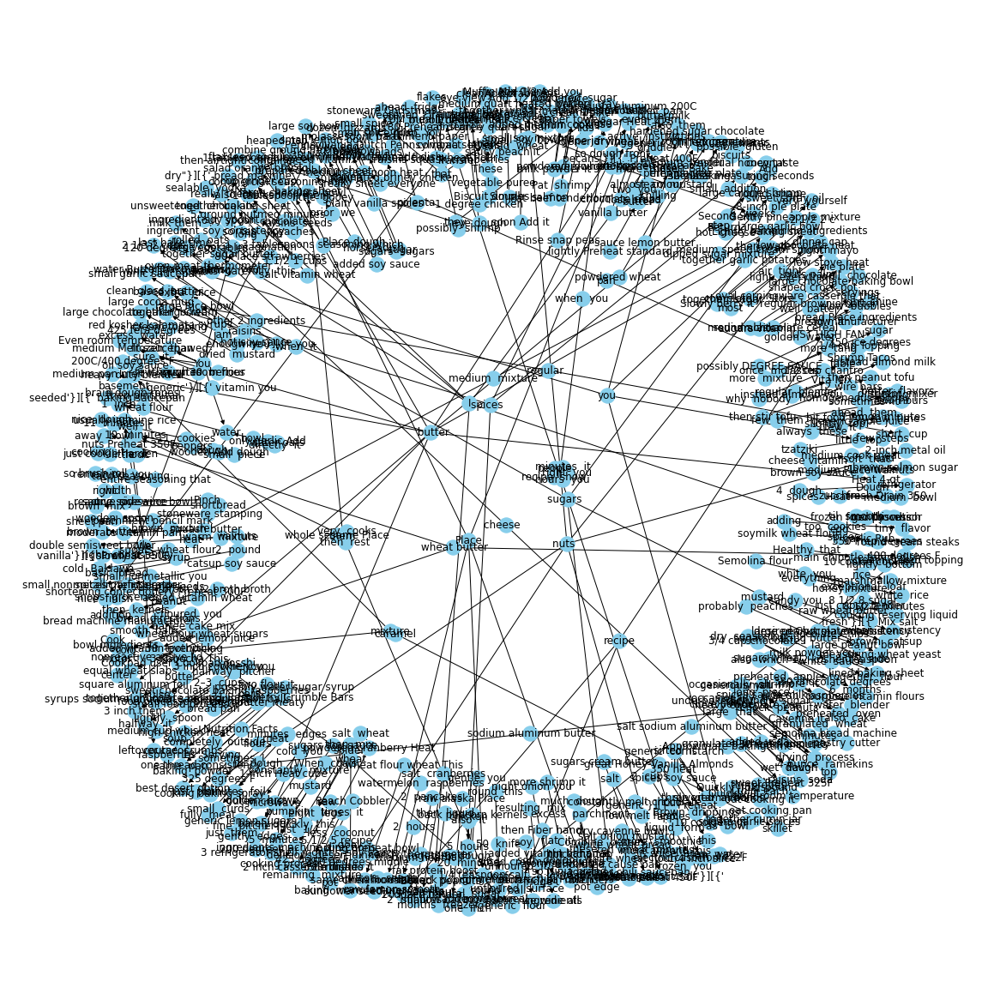

In [56]:
plt.figure(figsize=(16,16))
pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

### Plot Graph - Nodes and Edges

<Figure size 864x864 with 0 Axes>

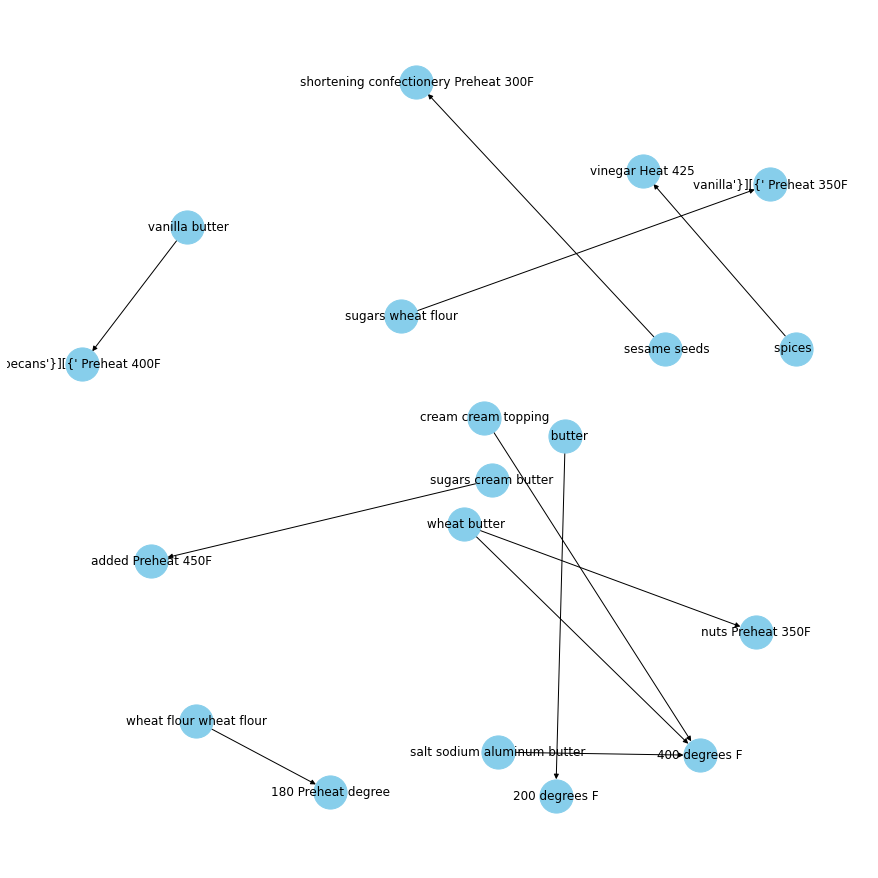

In [73]:
G=nx.from_pandas_edgelist(kg_df_1[kg_df_1['edge']=="oven to"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.9) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1100, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

<Figure size 1152x864 with 0 Axes>

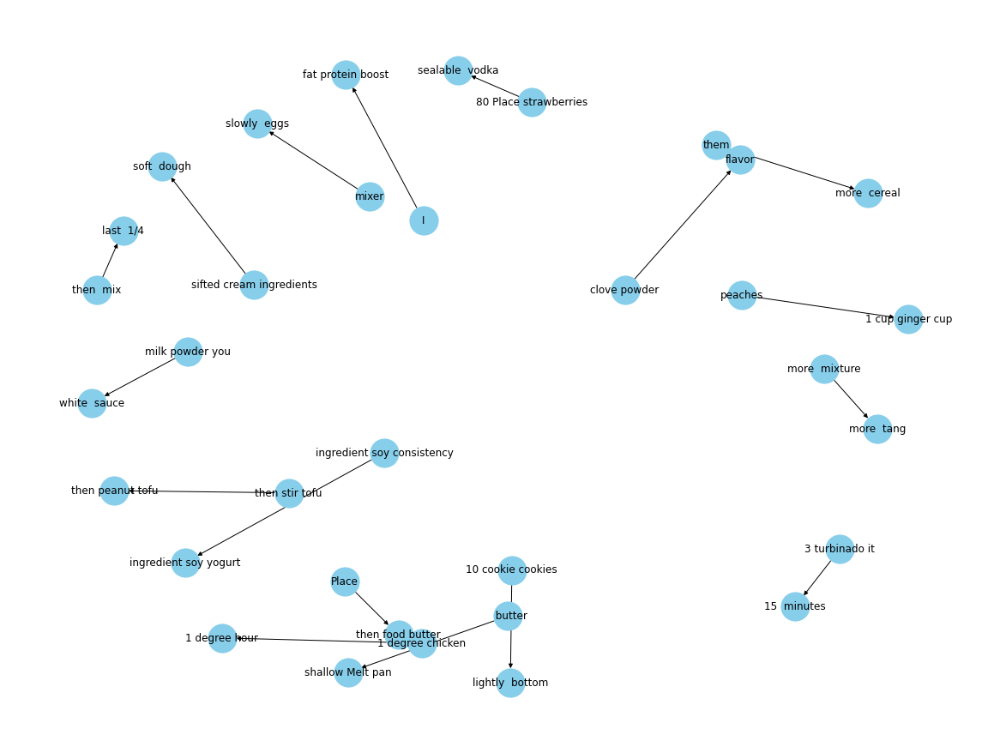

In [58]:
G=nx.from_pandas_edgelist(kg_df_1[kg_df_1['edge'].str.contains('add', regex=False, na=True)], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(16,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1100, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

<Figure size 1152x864 with 0 Axes>

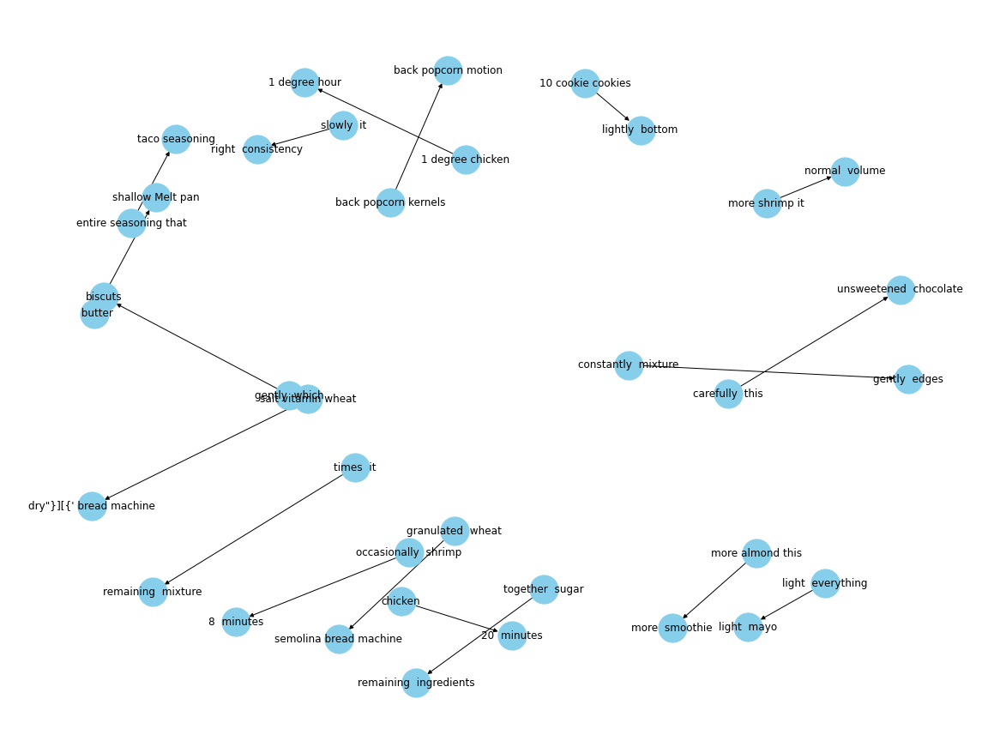

In [59]:
G=nx.from_pandas_edgelist(kg_df_1[kg_df_1['edge'].str.contains('Add', regex=False, na=True)], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(16,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1100, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()